<a href="https://colab.research.google.com/github/rakibulhaque9954/SRGAN-from-scratch/blob/main/SRGAN_from_scratch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Model Overview

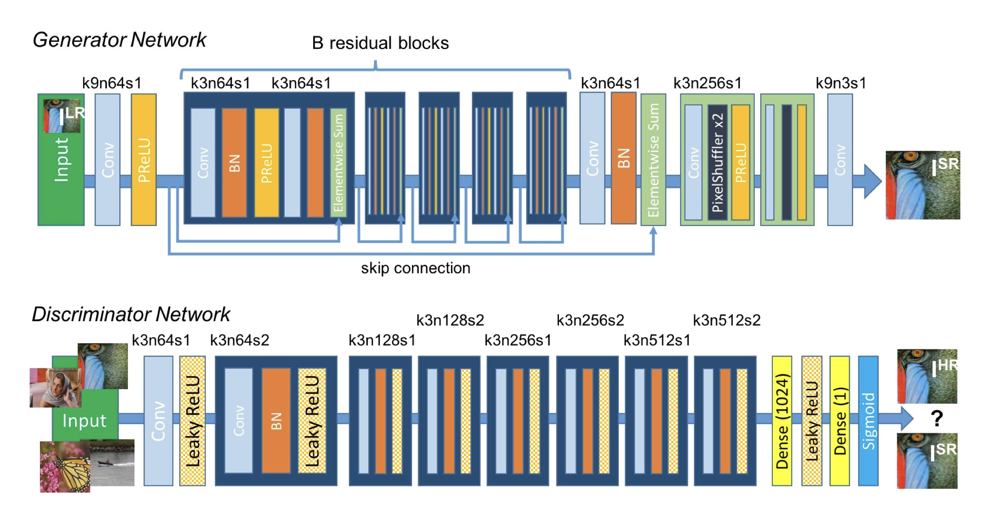

Paper link: https://arxiv.org/pdf/1609.04802.pdf

# Dataset Download

In [2]:
!pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json
!kaggle datasets download -d paulrohan2020/mirflickr25k
!unzip '/content/mirflickr25k.zip' -d '/content/dataset'

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5533.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5534.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5535.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5536.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5537.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5538.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5539.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags554.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5540.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5541.txt  
  inflating: /content/dataset/mirflickr25k/mirflickr/meta/tags_raw/tags5542.txt  
  inflating: /content/dataset/mirflickr25k/mirfl

In [3]:
import cv2
import os
import random

main_dir = '/content/dataset/mirflickr25k/mirflickr'  # Adjust this path as needed

train_dir = "data/train"  # Directory for training images
test_dir = "data/test"    # Directory for test images

# Create the train and test directories if they don't exist
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Create hr_images and lr_images directories within train and test directories
os.makedirs(os.path.join(train_dir, "hr_images"), exist_ok=True)
os.makedirs(os.path.join(train_dir, "lr_images"), exist_ok=True)
os.makedirs(os.path.join(test_dir, "hr_images"), exist_ok=True)
os.makedirs(os.path.join(test_dir, "lr_images"), exist_ok=True)

# List all the .jpg images in the main directory
image_files = [f for f in os.listdir(main_dir) if f.endswith(".jpg")]

# Randomly shuffle the list of image files
random.shuffle(image_files)

# Calculate the number of images for training and testing
num_images = len(image_files)
num_train_images = int(0.95 * num_images)
num_test_images = num_images - num_train_images

# Split the image files into training and test sets
train_image_files = image_files[:num_train_images]
test_image_files = image_files[num_train_images:]

# Process and resize images to 256x256 pixels and save them in the appropriate directories
for img in train_image_files:
    try:
        img_array = cv2.imread(os.path.join(main_dir, img))
        if img_array is not None:
            img_array = cv2.resize(img_array, (256, 256))
            lr_img_array = cv2.resize(img_array, (64, 64))  # Low-resolution images

            cv2.imwrite(os.path.join(train_dir, "hr_images", img), img_array)
            cv2.imwrite(os.path.join(train_dir, "lr_images", img), lr_img_array)
        else:
            print(f"Skipping {img} due to loading error.")
    except Exception as e:
        print(f"Error processing {img}: {str(e)}")

for img in test_image_files:
    try:
        img_array = cv2.imread(os.path.join(main_dir, img))
        if img_array is not None:
            img_array = cv2.resize(img_array, (256, 256))
            lr_img_array = cv2.resize(img_array, (64, 64))  # Low-resolution images

            cv2.imwrite(os.path.join(test_dir, "hr_images", img), img_array)
            cv2.imwrite(os.path.join(test_dir, "lr_images", img), lr_img_array)
        else:
            print(f"Skipping {img} due to loading error.")
    except Exception as e:
        print(f"Error processing {img}: {str(e)}")

# Count the number of images in the train and test directories
train_hr_images = os.listdir(os.path.join(train_dir, "hr_images"))
train_lr_images = os.listdir(os.path.join(train_dir, "lr_images"))
test_hr_images = os.listdir(os.path.join(test_dir, "hr_images"))
test_lr_images = os.listdir(os.path.join(test_dir, "lr_images"))

# Print the counts
print(f"Train HR Images Count: {len(train_hr_images)}")
print(f"Train LR Images Count: {len(train_lr_images)}")
print(f"Test HR Images Count: {len(test_hr_images)}")
print(f"Test LR Images Count: {len(test_lr_images)}")


Train HR Images Count: 23750
Train LR Images Count: 23750
Test HR Images Count: 1250
Test LR Images Count: 1250


In [4]:
path = '/content/data/train/hr_images'
print(len(os.listdir(path)))

23750


# Imports

In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras import layers, Model
from sklearn.model_selection import train_test_split

import numpy as np
from keras import Model
from keras.layers import Conv2D, PReLU,BatchNormalization, Flatten
from keras.layers import UpSampling2D, LeakyReLU, Dense, Input, add
from tqdm import tqdm


# Modeling

## Generator

In [ ]:
def res_block(ip):

    res_model = Conv2D(64, (3,3), padding = "same")(ip)
    res_model = BatchNormalization(momentum = 0.5)(res_model)
    res_model = PReLU(shared_axes = [1,2])(res_model)

    res_model = Conv2D(64, (3,3), padding = "same")(res_model)
    res_model = BatchNormalization(momentum = 0.5)(res_model)

    return add([ip,res_model])

def upscale_block(ip):

    up_model = Conv2D(256, (3,3), padding="same")(ip)
    up_model = UpSampling2D( size = 2 )(up_model)
    up_model = PReLU(shared_axes=[1,2])(up_model)

    return up_model

# Generator model
def create_gen(gen_ip, num_res_block):
    layers = Conv2D(64, (9,9), padding="same")(gen_ip)
    layers = PReLU(shared_axes=[1,2])(layers)

    temp = layers

    for i in range(num_res_block):
        layers = res_block(layers)

    layers = Conv2D(64, (3,3), padding="same")(layers)
    layers = BatchNormalization(momentum=0.5)(layers)
    layers = add([layers,temp])

    layers = upscale_block(layers)
    layers = upscale_block(layers)

    op = Conv2D(3, (9,9), padding="same")(layers)

    return Model(inputs=gen_ip, outputs=op, name='generator')

## Discriminator

In [ ]:
def discriminator_block(ip, filters, strides=1, bn=True):

    disc_model = Conv2D(filters, (3,3), strides = strides, padding="same")(ip)

    if bn:
        disc_model = BatchNormalization( momentum=0.8 )(disc_model)

    disc_model = LeakyReLU( alpha=0.2 )(disc_model)

    return disc_model

# Discriminator, as described in the original paper
def create_discriminator(disc_ip):

    df = 64

    d1 = discriminator_block(disc_ip, df, bn=False)
    d2 = discriminator_block(d1, df, strides=2)
    d3 = discriminator_block(d2, df*2)
    d4 = discriminator_block(d3, df*2, strides=2)
    d5 = discriminator_block(d4, df*4)
    d6 = discriminator_block(d5, df*4, strides=2)
    d7 = discriminator_block(d6, df*8)
    d8 = discriminator_block(d7, df*8, strides=2)

    d8_5 = Flatten()(d8)
    d9 = Dense(df*16)(d8_5)
    d10 = LeakyReLU(alpha=0.2)(d9)
    validity = Dense(1, activation='sigmoid')(d10)
    return Model(inputs=disc_ip, outputs=validity, name='discriminator')



## VGG19 Model

In [ ]:
from keras.applications import VGG19

def build_vgg(hr_shape):

    vgg = VGG19(weights="imagenet",include_top=False, input_shape=hr_shape)

    return Model(inputs=vgg.inputs, outputs=vgg.layers[10].output, name = 'Vgg')



## GAN Model Combined

In [ ]:
# Combined model
def create_comb(gen_model, disc_model, vgg, lr_ip, hr_ip):
    gen_img = gen_model(lr_ip)

    gen_features = vgg(gen_img)

    disc_model.trainable = False
    validity = disc_model(gen_img)

    return Model(inputs=[lr_ip, hr_ip], outputs=[validity, gen_features],  name = 'SRGAN')

# Image Load

In [ ]:
lr_list = os.listdir("/content/data/train/lr_images")[:12500]

lr_images = []
for img in lr_list:
    img_lr = cv2.imread("/content/data/train/lr_images/" + img)
    img_lr = cv2.cvtColor(img_lr, cv2.COLOR_BGR2RGB)
    lr_images.append(img_lr)


hr_list = os.listdir("/content/data/train/hr_images")[:12500]

hr_images = []
for img in hr_list:
    img_hr = cv2.imread("/content/data/train/hr_images/" + img)
    img_hr = cv2.cvtColor(img_hr, cv2.COLOR_BGR2RGB)
    hr_images.append(img_hr)

lr_images = np.array(lr_images)
hr_images = np.array(hr_images)


## Visualizing Images

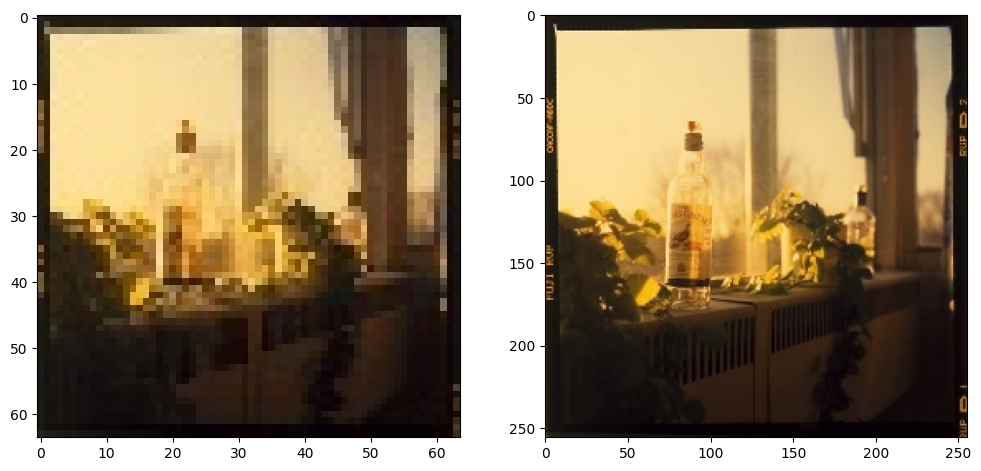

In [ ]:
import random
import numpy as np
image_number = random.randint(0, len(lr_images)-1)
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(np.reshape(lr_images[image_number], (64, 64, 3)))
plt.subplot(122)
plt.imshow(np.reshape(hr_images[image_number], (256, 256, 3)))
plt.show()

In [ ]:
lr_images = lr_images / 255.
hr_images = hr_images / 255.

In [ ]:
hr_images.shape

(12500, 256, 256, 3)

In [ ]:
lr_images.shape

(12500, 64, 64, 3)

In [ ]:
hr_shape = (hr_images.shape[1], hr_images.shape[2], hr_images.shape[3])
lr_shape = (lr_images.shape[1], lr_images.shape[2], lr_images.shape[3])

lr_ip = Input(shape=lr_shape)
hr_ip = Input(shape=hr_shape)


In [ ]:
generator = create_gen(lr_ip, num_res_block = 16)
generator.summary()

discriminator = create_discriminator(hr_ip)
discriminator.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])
discriminator.summary()

vgg = build_vgg((256, 256,3))
print(vgg.summary())
vgg.trainable = False

gan_model = create_comb(generator, discriminator, vgg, lr_ip, hr_ip)

Model: "generator"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 conv2d_90 (Conv2D)          (None, 64, 64, 64)           15616     ['input_7[0][0]']             
                                                                                                  
 p_re_lu_38 (PReLU)          (None, 64, 64, 64)           64        ['conv2d_90[0][0]']           
                                                                                                  
 conv2d_91 (Conv2D)          (None, 64, 64, 64)           36928     ['p_re_lu_38[0][0]']          
                                                                                          

In [ ]:
gan_model.compile(loss=["binary_crossentropy", "mse"], loss_weights=[1e-3, 1], optimizer="adam")
gan_model.summary()

Model: "SRGAN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 generator (Functional)      (None, 256, 256, 3)          2044291   ['input_7[0][0]']             
                                                                                                  
 input_8 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 discriminator (Functional)  (None, 1)                    1389125   ['generator[0][0]']           
                                                          77                                  

In [ ]:
batch_size = 1
train_lr_batches = []
train_hr_batches = []
for it in range(int(hr_images.shape[0] / batch_size)):
    start_idx = it * batch_size
    end_idx = start_idx + batch_size
    train_hr_batches.append(hr_images[start_idx:end_idx])
    train_lr_batches.append(lr_images[start_idx:end_idx])


In [ ]:
epochs = 10
#Enumerate training over epochs
for e in range(epochs):

    fake_label = np.zeros((batch_size, 1)) # Assign a label of 0 to all fake (generated images)
    real_label = np.ones((batch_size,1)) # Assign a label of 1 to all real images.

    #Create empty lists to populate gen and disc losses.
    g_losses = []
    d_losses = []

    #Enumerate training over batches.
    for b in tqdm(range(len(train_hr_batches))):
        lr_imgs = train_lr_batches[b] #Fetch a batch of LR images for training
        hr_imgs = train_hr_batches[b] #Fetch a batch of HR images for training

        fake_imgs = generator.predict_on_batch(lr_imgs) #Fake images

        #First, train the discriminator on fake and real HR images.
        discriminator.trainable = True
        d_loss_gen = discriminator.train_on_batch(fake_imgs, fake_label)
        d_loss_real = discriminator.train_on_batch(hr_imgs, real_label)

        #Now, train the generator by fixing discriminator as non-trainable
        discriminator.trainable = False

        #Average the discriminator loss, just for reporting purposes.
        d_loss = 0.5 * np.add(d_loss_gen, d_loss_real)

        #Extract VGG features, to be used towards calculating loss
        image_features = vgg.predict(hr_imgs)

        #Train the generator via GAN.
        #Remember that we have 2 losses, adversarial loss and content (VGG) loss
        g_loss, _, _ = gan_model.train_on_batch([lr_imgs, hr_imgs], [real_label, image_features])

        #Save losses to a list so we can average and report.
        d_losses.append(d_loss)
        g_losses.append(g_loss)

    #Convert the list of losses to an array to make it easy to average
    g_losses = np.array(g_losses)
    d_losses = np.array(d_losses)

    #Calculate the average losses for generator and discriminator
    g_loss = np.sum(g_losses, axis=0) / len(g_losses)
    d_loss = np.sum(d_losses, axis=0) / len(d_losses)

    #Report the progress during training.
    print("epoch:", e + 1 ,"g_loss:", g_loss, "d_loss:", d_loss)

    if (e+1) % 3 == 0: #Change the frequency for model saving, if needed
        #Save the generator after every n epochs (Usually 10 epochs)
        generator.save("/content/drive/MyDrive/Colab Notebooks/SRGAN generator/gen_e_"+ str(e+1) +".h5")

  0%|          | 0/12500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 89ms/step


  0%|          | 1/12500 [00:33<115:14:29, 33.19s/it]

1/1 [==============================] - 0s 20ms/step


  0%|          | 2/12500 [00:33<47:47:01, 13.76s/it] 

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/12500 [00:33<26:13:23,  7.55s/it]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/12500 [00:33<16:05:36,  4.64s/it]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/12500 [00:33<10:29:29,  3.02s/it]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/12500 [00:34<7:06:54,  2.05s/it] 

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/12500 [00:34<4:58:40,  1.43s/it]

1/1 [==============================] - 0s 20ms/step


  0%|          | 8/12500 [00:34<3:34:19,  1.03s/it]

1/1 [==============================] - 0s 20ms/step


  0%|          | 9/12500 [00:34<2:38:03,  1.32it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 10/12500 [00:34<1:59:25,  1.74it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/12500 [00:34<1:33:11,  2.23it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/12500 [00:34<1:15:04,  2.77it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 13/12500 [00:35<1:02:40,  3.32it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/12500 [00:35<54:11,  3.84it/s]  

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/12500 [00:35<48:08,  4.32it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/12500 [00:35<43:40,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 17/12500 [00:35<41:03,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 18/12500 [00:35<38:57,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 19/12500 [00:36<38:10,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 20/12500 [00:36<36:51,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 21/12500 [00:36<36:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 22/12500 [00:36<35:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 23/12500 [00:36<34:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 24/12500 [00:36<34:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 25/12500 [00:37<35:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 26/12500 [00:37<35:06,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 27/12500 [00:37<34:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 28/12500 [00:37<34:40,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 29/12500 [00:37<34:34,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 30/12500 [00:37<35:27,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 31/12500 [00:38<35:25,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 32/12500 [00:38<35:34,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 33/12500 [00:38<36:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 34/12500 [00:38<35:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 35/12500 [00:38<34:48,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 36/12500 [00:38<34:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 37/12500 [00:39<34:40,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 38/12500 [00:39<34:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 39/12500 [00:39<34:31,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 40/12500 [00:39<34:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 41/12500 [00:39<34:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 42/12500 [00:39<34:28,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 43/12500 [00:40<34:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 44/12500 [00:40<34:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 45/12500 [00:40<34:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 46/12500 [00:40<34:33,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 47/12500 [00:40<34:17,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 48/12500 [00:40<34:04,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 49/12500 [00:41<35:03,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 50/12500 [00:41<34:54,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 51/12500 [00:41<35:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 52/12500 [00:41<34:57,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 53/12500 [00:41<34:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 54/12500 [00:41<34:08,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 55/12500 [00:42<34:04,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 56/12500 [00:42<34:00,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 57/12500 [00:42<34:11,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 58/12500 [00:42<33:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 59/12500 [00:42<33:53,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 60/12500 [00:42<33:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 61/12500 [00:43<33:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 62/12500 [00:43<33:29,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 63/12500 [00:43<33:44,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 64/12500 [00:43<33:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 65/12500 [00:43<34:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 66/12500 [00:43<33:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 67/12500 [00:44<33:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 68/12500 [00:44<33:50,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 69/12500 [00:44<33:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 70/12500 [00:44<33:49,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 71/12500 [00:44<33:47,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 72/12500 [00:44<33:41,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 73/12500 [00:45<33:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 74/12500 [00:45<33:38,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 75/12500 [00:45<33:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 76/12500 [00:45<33:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 77/12500 [00:45<33:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 78/12500 [00:45<33:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 79/12500 [00:46<33:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 80/12500 [00:46<33:29,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 81/12500 [00:46<33:52,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 82/12500 [00:46<33:46,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 83/12500 [00:46<33:42,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 84/12500 [00:46<33:43,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 85/12500 [00:47<33:27,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 86/12500 [00:47<33:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 87/12500 [00:47<33:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 88/12500 [00:47<33:27,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 89/12500 [00:47<33:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 90/12500 [00:47<33:53,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 91/12500 [00:48<33:43,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 92/12500 [00:48<33:46,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 93/12500 [00:48<33:50,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 94/12500 [00:48<34:20,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 95/12500 [00:48<34:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 96/12500 [00:48<34:16,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 97/12500 [00:49<35:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 98/12500 [00:49<34:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 99/12500 [00:49<35:21,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 100/12500 [00:49<34:52,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 101/12500 [00:49<34:35,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 102/12500 [00:49<34:26,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 103/12500 [00:50<34:21,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 104/12500 [00:50<34:21,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 105/12500 [00:50<34:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 106/12500 [00:50<34:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 107/12500 [00:50<34:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 108/12500 [00:50<34:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 109/12500 [00:51<35:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 110/12500 [00:51<34:56,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 111/12500 [00:51<34:58,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 112/12500 [00:51<34:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 113/12500 [00:51<34:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 114/12500 [00:51<34:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 115/12500 [00:52<34:19,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 116/12500 [00:52<34:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 117/12500 [00:52<34:15,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 118/12500 [00:52<33:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 119/12500 [00:52<33:36,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 120/12500 [00:52<33:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 121/12500 [00:53<33:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 122/12500 [00:53<34:02,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 123/12500 [00:53<33:59,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 124/12500 [00:53<33:45,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 125/12500 [00:53<33:37,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 126/12500 [00:53<33:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 127/12500 [00:53<33:23,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 128/12500 [00:54<33:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 129/12500 [00:54<33:52,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 130/12500 [00:54<33:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 131/12500 [00:54<33:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 132/12500 [00:54<33:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 133/12500 [00:54<33:44,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 134/12500 [00:55<33:42,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 135/12500 [00:55<34:10,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 136/12500 [00:55<34:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 137/12500 [00:55<34:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 138/12500 [00:55<33:53,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 139/12500 [00:55<33:51,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 140/12500 [00:56<34:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 141/12500 [00:56<34:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 142/12500 [00:56<35:09,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 143/12500 [00:56<34:33,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 144/12500 [00:56<34:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 145/12500 [00:56<34:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 146/12500 [00:57<33:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 147/12500 [00:57<33:47,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 148/12500 [00:57<34:51,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 149/12500 [00:57<34:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 150/12500 [00:57<33:50,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 151/12500 [00:57<33:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 152/12500 [00:58<33:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 153/12500 [00:58<33:55,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 154/12500 [00:58<33:45,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 155/12500 [00:58<33:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 156/12500 [00:58<33:19,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 157/12500 [00:58<33:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 158/12500 [00:59<33:03,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 159/12500 [00:59<33:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 160/12500 [00:59<32:59,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 161/12500 [00:59<33:12,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 162/12500 [00:59<33:10,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 163/12500 [00:59<33:05,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 164/12500 [01:00<32:48,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 165/12500 [01:00<33:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 166/12500 [01:00<33:18,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 167/12500 [01:00<33:25,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 168/12500 [01:00<33:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 169/12500 [01:00<33:32,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 170/12500 [01:01<33:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 171/12500 [01:01<33:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 172/12500 [01:01<33:22,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 173/12500 [01:01<33:48,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 174/12500 [01:01<33:53,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 175/12500 [01:01<33:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 176/12500 [01:02<33:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 177/12500 [01:02<33:56,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 178/12500 [01:02<34:04,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 179/12500 [01:02<33:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 180/12500 [01:02<33:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 181/12500 [01:02<33:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 182/12500 [01:03<33:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 183/12500 [01:03<33:33,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 184/12500 [01:03<34:04,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 185/12500 [01:03<34:15,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 186/12500 [01:03<34:19,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 187/12500 [01:03<34:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 188/12500 [01:04<34:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 189/12500 [01:04<33:47,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 190/12500 [01:04<33:33,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 191/12500 [01:04<33:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 192/12500 [01:04<33:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 193/12500 [01:04<33:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 194/12500 [01:04<33:31,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 195/12500 [01:05<33:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 196/12500 [01:05<33:04,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 197/12500 [01:05<33:01,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 198/12500 [01:05<33:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 199/12500 [01:05<33:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 200/12500 [01:05<33:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 201/12500 [01:06<33:20,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 202/12500 [01:06<33:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 203/12500 [01:06<33:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 204/12500 [01:06<33:05,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 205/12500 [01:06<33:19,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 206/12500 [01:06<33:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 207/12500 [01:07<33:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 208/12500 [01:07<33:43,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 209/12500 [01:07<33:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 210/12500 [01:07<33:08,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 211/12500 [01:07<33:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 212/12500 [01:07<33:26,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 213/12500 [01:08<33:25,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 214/12500 [01:08<33:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 215/12500 [01:08<33:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 216/12500 [01:08<33:51,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 217/12500 [01:08<33:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 218/12500 [01:08<33:51,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 219/12500 [01:09<33:47,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 220/12500 [01:09<34:00,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 221/12500 [01:09<33:49,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 222/12500 [01:09<33:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 223/12500 [01:09<33:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 224/12500 [01:09<34:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 225/12500 [01:10<34:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 226/12500 [01:10<34:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 227/12500 [01:10<33:57,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 228/12500 [01:10<33:39,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 229/12500 [01:10<33:31,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 230/12500 [01:10<33:46,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 231/12500 [01:11<33:26,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 232/12500 [01:11<33:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 233/12500 [01:11<33:53,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 234/12500 [01:11<34:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 235/12500 [01:11<33:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 236/12500 [01:11<34:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 237/12500 [01:12<33:53,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 238/12500 [01:12<33:57,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 239/12500 [01:12<34:02,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 240/12500 [01:12<34:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 241/12500 [01:12<33:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 242/12500 [01:12<34:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 243/12500 [01:13<34:28,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 244/12500 [01:13<34:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 245/12500 [01:13<34:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 246/12500 [01:13<34:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 247/12500 [01:13<33:57,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 248/12500 [01:13<34:12,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 249/12500 [01:14<34:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 250/12500 [01:14<34:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 251/12500 [01:14<34:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 252/12500 [01:14<35:07,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 253/12500 [01:14<34:49,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 254/12500 [01:14<34:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 255/12500 [01:15<34:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 256/12500 [01:15<35:15,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 257/12500 [01:15<34:54,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 258/12500 [01:15<34:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 259/12500 [01:15<34:28,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 260/12500 [01:15<34:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 261/12500 [01:16<34:11,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 262/12500 [01:16<34:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 263/12500 [01:16<34:17,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 264/12500 [01:16<34:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 265/12500 [01:16<34:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 266/12500 [01:16<33:56,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 267/12500 [01:17<33:56,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 268/12500 [01:17<33:55,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 269/12500 [01:17<33:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 270/12500 [01:17<33:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 271/12500 [01:17<32:59,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 272/12500 [01:17<33:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 273/12500 [01:18<33:09,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 274/12500 [01:18<33:11,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 275/12500 [01:18<33:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 276/12500 [01:18<33:18,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 277/12500 [01:18<33:16,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 278/12500 [01:18<33:19,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 279/12500 [01:19<33:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 280/12500 [01:19<33:30,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 281/12500 [01:19<33:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 282/12500 [01:19<33:10,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 283/12500 [01:19<33:03,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 284/12500 [01:19<32:55,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 285/12500 [01:20<32:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 286/12500 [01:20<32:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 287/12500 [01:20<32:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 288/12500 [01:20<33:28,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 289/12500 [01:20<33:22,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 290/12500 [01:20<33:16,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 291/12500 [01:21<32:56,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 292/12500 [01:21<32:52,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 293/12500 [01:21<33:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 294/12500 [01:21<33:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 295/12500 [01:21<33:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 296/12500 [01:21<33:34,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 297/12500 [01:21<33:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 298/12500 [01:22<33:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 299/12500 [01:22<33:03,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 300/12500 [01:22<33:06,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 301/12500 [01:22<32:51,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 302/12500 [01:22<32:50,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 303/12500 [01:22<32:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 304/12500 [01:23<32:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 305/12500 [01:23<32:50,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 306/12500 [01:23<32:49,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 307/12500 [01:23<32:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 308/12500 [01:23<33:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 309/12500 [01:23<33:06,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 310/12500 [01:24<33:16,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 311/12500 [01:24<33:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 312/12500 [01:24<33:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 313/12500 [01:24<33:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 314/12500 [01:24<33:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 315/12500 [01:24<33:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 316/12500 [01:25<32:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 317/12500 [01:25<32:56,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 318/12500 [01:25<32:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 319/12500 [01:25<32:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 320/12500 [01:25<33:14,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 321/12500 [01:25<33:18,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 322/12500 [01:26<33:20,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 323/12500 [01:26<33:23,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 324/12500 [01:26<33:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 325/12500 [01:26<33:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 326/12500 [01:26<33:10,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 327/12500 [01:26<33:02,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 328/12500 [01:27<33:46,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 329/12500 [01:27<33:48,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 330/12500 [01:27<33:52,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 331/12500 [01:27<33:40,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 332/12500 [01:27<34:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 333/12500 [01:27<34:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 334/12500 [01:28<34:17,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 335/12500 [01:28<33:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 336/12500 [01:28<34:06,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 337/12500 [01:28<34:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 338/12500 [01:28<33:51,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 339/12500 [01:28<33:39,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 340/12500 [01:29<33:43,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 341/12500 [01:29<33:45,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 342/12500 [01:29<33:48,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 343/12500 [01:29<33:54,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 344/12500 [01:29<34:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 345/12500 [01:29<34:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 346/12500 [01:30<33:54,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 347/12500 [01:30<33:40,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 348/12500 [01:30<33:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 349/12500 [01:30<33:35,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 350/12500 [01:30<33:22,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 351/12500 [01:30<33:22,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 352/12500 [01:31<33:39,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 353/12500 [01:31<33:52,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 354/12500 [01:31<33:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 355/12500 [01:31<33:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 356/12500 [01:31<33:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 357/12500 [01:31<33:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 358/12500 [01:32<33:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 359/12500 [01:32<33:17,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 360/12500 [01:32<33:57,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 361/12500 [01:32<33:42,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 362/12500 [01:32<33:31,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 363/12500 [01:32<33:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 364/12500 [01:33<33:22,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 365/12500 [01:33<33:19,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 366/12500 [01:33<33:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 367/12500 [01:33<33:18,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 368/12500 [01:33<33:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 369/12500 [01:33<33:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 370/12500 [01:34<33:17,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 371/12500 [01:34<33:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 372/12500 [01:34<33:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 373/12500 [01:34<33:34,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 374/12500 [01:34<33:25,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 375/12500 [01:34<33:16,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 376/12500 [01:35<33:21,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 377/12500 [01:35<33:23,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 378/12500 [01:35<33:25,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 379/12500 [01:35<33:19,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 380/12500 [01:35<33:17,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 381/12500 [01:35<32:51,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 382/12500 [01:36<32:29,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 383/12500 [01:36<32:20,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 384/12500 [01:36<33:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 385/12500 [01:36<34:11,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 386/12500 [01:36<33:38,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 387/12500 [01:36<33:20,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 388/12500 [01:37<33:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 389/12500 [01:37<32:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 390/12500 [01:37<32:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 391/12500 [01:37<32:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 392/12500 [01:37<33:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 393/12500 [01:37<33:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 394/12500 [01:37<33:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 395/12500 [01:38<32:51,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 396/12500 [01:38<33:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 397/12500 [01:38<32:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 398/12500 [01:38<32:47,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 399/12500 [01:38<32:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 400/12500 [01:38<33:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 401/12500 [01:39<33:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 402/12500 [01:39<33:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 403/12500 [01:39<33:17,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 404/12500 [01:39<33:16,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 405/12500 [01:39<33:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 406/12500 [01:39<33:27,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 407/12500 [01:40<34:12,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 408/12500 [01:40<34:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 409/12500 [01:40<34:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 410/12500 [01:40<33:51,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 411/12500 [01:40<33:47,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 412/12500 [01:40<33:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 413/12500 [01:41<34:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 414/12500 [01:41<34:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 415/12500 [01:41<33:59,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 416/12500 [01:41<34:22,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 417/12500 [01:41<34:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 418/12500 [01:41<34:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 419/12500 [01:42<33:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 420/12500 [01:42<33:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 421/12500 [01:42<33:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 422/12500 [01:42<33:18,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 423/12500 [01:42<33:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 424/12500 [01:42<33:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 425/12500 [01:43<33:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 426/12500 [01:43<33:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 427/12500 [01:43<33:35,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 428/12500 [01:43<34:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 429/12500 [01:43<33:58,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 430/12500 [01:44<33:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 431/12500 [01:44<33:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 432/12500 [01:44<33:54,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 433/12500 [01:44<33:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 434/12500 [01:44<34:30,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 435/12500 [01:44<34:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 436/12500 [01:45<33:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 437/12500 [01:45<33:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 438/12500 [01:45<33:52,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 439/12500 [01:45<33:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 440/12500 [01:45<33:41,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 441/12500 [01:45<33:51,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 442/12500 [01:46<33:45,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 443/12500 [01:46<33:35,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 444/12500 [01:46<33:37,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 445/12500 [01:46<33:22,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 446/12500 [01:46<33:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 447/12500 [01:46<32:54,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 448/12500 [01:47<32:58,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 449/12500 [01:47<32:56,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 450/12500 [01:47<32:48,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 451/12500 [01:47<32:28,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 452/12500 [01:47<32:17,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 453/12500 [01:47<32:09,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 454/12500 [01:47<31:52,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 455/12500 [01:48<31:36,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 456/12500 [01:48<31:59,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 457/12500 [01:48<32:05,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 458/12500 [01:48<32:08,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 459/12500 [01:48<32:13,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 460/12500 [01:48<32:06,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 461/12500 [01:49<31:56,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 462/12500 [01:49<31:53,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 463/12500 [01:49<31:47,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 464/12500 [01:49<32:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 465/12500 [01:49<31:59,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 466/12500 [01:49<31:53,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 467/12500 [01:50<31:44,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 468/12500 [01:50<32:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 469/12500 [01:50<32:07,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 470/12500 [01:50<32:05,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 471/12500 [01:50<31:56,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 472/12500 [01:50<32:18,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 473/12500 [01:51<32:14,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 474/12500 [01:51<32:13,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 475/12500 [01:51<32:02,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 476/12500 [01:51<31:55,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 477/12500 [01:51<31:52,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 478/12500 [01:51<31:57,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 479/12500 [01:51<32:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 480/12500 [01:52<32:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 481/12500 [01:52<32:20,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 482/12500 [01:52<32:15,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 483/12500 [01:52<32:12,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 484/12500 [01:52<32:00,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 485/12500 [01:52<32:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 486/12500 [01:53<32:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 487/12500 [01:53<32:32,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 488/12500 [01:53<32:45,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 489/12500 [01:53<32:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 490/12500 [01:53<32:28,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 491/12500 [01:53<32:26,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 492/12500 [01:54<32:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 493/12500 [01:54<32:12,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 494/12500 [01:54<32:23,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 495/12500 [01:54<32:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 496/12500 [01:54<32:27,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 497/12500 [01:54<32:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 498/12500 [01:55<32:33,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 499/12500 [01:55<32:27,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 500/12500 [01:55<32:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 501/12500 [01:55<32:30,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 502/12500 [01:55<32:22,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 503/12500 [01:55<32:08,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 504/12500 [01:56<32:10,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 505/12500 [01:56<32:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 506/12500 [01:56<31:57,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 507/12500 [01:56<31:41,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 508/12500 [01:56<31:35,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 509/12500 [01:56<31:44,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 510/12500 [01:56<31:49,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 511/12500 [01:57<31:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 512/12500 [01:57<32:10,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 513/12500 [01:57<32:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 514/12500 [01:57<32:06,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 515/12500 [01:57<32:04,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 516/12500 [01:57<32:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 517/12500 [01:58<31:57,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 518/12500 [01:58<32:02,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 519/12500 [01:58<32:11,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 520/12500 [01:58<32:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 521/12500 [01:58<32:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 522/12500 [01:58<32:48,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 523/12500 [01:59<32:42,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 524/12500 [01:59<32:32,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 525/12500 [01:59<32:26,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 526/12500 [01:59<32:43,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 527/12500 [01:59<32:22,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 528/12500 [01:59<32:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 529/12500 [02:00<32:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 530/12500 [02:00<32:46,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 531/12500 [02:00<32:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 532/12500 [02:00<32:38,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 533/12500 [02:00<32:22,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 534/12500 [02:00<32:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 535/12500 [02:01<32:08,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 536/12500 [02:01<32:24,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 537/12500 [02:01<32:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 538/12500 [02:01<32:33,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 539/12500 [02:01<32:34,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 540/12500 [02:01<32:29,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 541/12500 [02:02<32:31,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 542/12500 [02:02<32:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 543/12500 [02:02<32:16,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 544/12500 [02:02<32:42,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 545/12500 [02:02<32:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 546/12500 [02:02<32:19,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 547/12500 [02:02<32:27,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 548/12500 [02:03<32:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 549/12500 [02:03<32:20,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 550/12500 [02:03<32:02,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 551/12500 [02:03<31:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 552/12500 [02:03<32:09,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 553/12500 [02:03<32:11,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 554/12500 [02:04<32:16,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 555/12500 [02:04<32:30,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 556/12500 [02:04<32:19,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 557/12500 [02:04<31:55,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 558/12500 [02:04<31:44,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 559/12500 [02:04<31:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 560/12500 [02:05<31:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 561/12500 [02:05<32:07,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 562/12500 [02:05<32:04,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 563/12500 [02:05<32:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 564/12500 [02:05<32:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 565/12500 [02:05<32:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 566/12500 [02:06<31:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 567/12500 [02:06<31:56,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 568/12500 [02:06<32:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 569/12500 [02:06<32:10,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 570/12500 [02:06<32:13,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 571/12500 [02:06<32:20,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 572/12500 [02:07<32:00,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 573/12500 [02:07<31:55,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 574/12500 [02:07<31:44,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 575/12500 [02:07<31:40,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 576/12500 [02:07<32:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 577/12500 [02:07<32:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 578/12500 [02:07<32:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 579/12500 [02:08<32:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 580/12500 [02:08<32:56,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 581/12500 [02:08<33:42,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 582/12500 [02:08<33:03,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 583/12500 [02:08<32:36,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 584/12500 [02:08<32:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 585/12500 [02:09<32:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 586/12500 [02:09<32:08,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 587/12500 [02:09<31:57,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 588/12500 [02:09<32:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 589/12500 [02:09<32:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 590/12500 [02:09<32:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 591/12500 [02:10<32:08,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 592/12500 [02:10<32:19,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 593/12500 [02:10<32:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 594/12500 [02:10<32:14,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 595/12500 [02:10<32:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 596/12500 [02:10<32:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 597/12500 [02:11<32:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 598/12500 [02:11<32:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 599/12500 [02:11<32:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 600/12500 [02:11<33:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 601/12500 [02:11<32:51,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 602/12500 [02:11<32:28,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 603/12500 [02:12<32:02,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 604/12500 [02:12<31:46,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 605/12500 [02:12<31:46,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 606/12500 [02:12<31:31,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 607/12500 [02:12<31:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 608/12500 [02:12<31:47,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 609/12500 [02:13<32:03,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 610/12500 [02:13<31:51,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 611/12500 [02:13<31:53,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 612/12500 [02:13<31:57,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 613/12500 [02:13<31:42,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 614/12500 [02:13<31:37,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 615/12500 [02:13<31:36,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 616/12500 [02:14<32:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 617/12500 [02:14<32:09,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 618/12500 [02:14<31:51,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 619/12500 [02:14<31:37,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 620/12500 [02:14<31:47,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 621/12500 [02:14<31:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 622/12500 [02:15<31:46,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 623/12500 [02:15<32:07,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 624/12500 [02:15<32:32,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 625/12500 [02:15<32:29,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 626/12500 [02:15<32:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 627/12500 [02:15<32:16,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 628/12500 [02:16<32:02,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 629/12500 [02:16<31:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 630/12500 [02:16<32:05,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 631/12500 [02:16<31:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 632/12500 [02:16<32:24,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 633/12500 [02:16<32:02,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 634/12500 [02:17<32:01,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 635/12500 [02:17<31:58,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 636/12500 [02:17<31:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 637/12500 [02:17<32:11,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 638/12500 [02:17<32:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 639/12500 [02:17<32:00,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 640/12500 [02:18<32:10,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 641/12500 [02:18<32:02,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 642/12500 [02:18<32:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 643/12500 [02:18<32:06,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 644/12500 [02:18<32:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 645/12500 [02:18<32:36,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 646/12500 [02:19<32:17,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 647/12500 [02:19<32:01,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 648/12500 [02:19<32:06,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 649/12500 [02:19<32:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 650/12500 [02:19<32:22,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 651/12500 [02:19<32:37,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 652/12500 [02:20<32:25,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 653/12500 [02:20<32:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 654/12500 [02:20<32:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 655/12500 [02:20<32:11,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 656/12500 [02:20<32:24,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 657/12500 [02:20<32:16,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 658/12500 [02:20<32:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 659/12500 [02:21<32:23,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 660/12500 [02:21<32:19,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 661/12500 [02:21<32:01,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 662/12500 [02:21<31:34,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 663/12500 [02:21<31:30,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 664/12500 [02:21<31:39,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 665/12500 [02:22<31:41,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 666/12500 [02:22<31:36,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 667/12500 [02:22<32:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 668/12500 [02:22<32:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 669/12500 [02:22<32:08,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 670/12500 [02:22<31:54,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 671/12500 [02:23<31:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 672/12500 [02:23<32:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 673/12500 [02:23<31:55,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 674/12500 [02:23<31:51,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 675/12500 [02:23<31:40,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 676/12500 [02:23<31:31,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 677/12500 [02:24<31:21,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 678/12500 [02:24<31:25,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 679/12500 [02:24<31:29,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 680/12500 [02:24<31:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 681/12500 [02:24<31:18,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 682/12500 [02:24<31:24,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 683/12500 [02:25<31:24,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 684/12500 [02:25<31:25,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 685/12500 [02:25<31:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 686/12500 [02:25<31:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 687/12500 [02:25<31:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 688/12500 [02:25<31:56,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 689/12500 [02:25<31:48,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 690/12500 [02:26<31:36,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 691/12500 [02:26<31:32,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 692/12500 [02:26<31:43,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 693/12500 [02:26<31:28,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 694/12500 [02:26<31:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 695/12500 [02:26<31:11,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 696/12500 [02:27<31:27,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 697/12500 [02:27<31:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 698/12500 [02:27<31:34,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 699/12500 [02:27<31:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 700/12500 [02:27<31:05,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 701/12500 [02:27<31:09,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 702/12500 [02:28<30:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 703/12500 [02:28<30:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 704/12500 [02:28<31:36,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 705/12500 [02:28<31:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 706/12500 [02:28<31:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 707/12500 [02:28<31:36,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 708/12500 [02:29<31:33,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 709/12500 [02:29<31:34,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 710/12500 [02:29<31:46,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 711/12500 [02:29<31:43,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 712/12500 [02:29<31:45,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 713/12500 [02:29<31:40,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 714/12500 [02:29<31:37,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 715/12500 [02:30<31:30,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 716/12500 [02:30<31:39,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 717/12500 [02:30<31:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 718/12500 [02:30<32:31,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 719/12500 [02:30<32:01,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 720/12500 [02:30<32:07,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 721/12500 [02:31<31:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 722/12500 [02:31<31:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 723/12500 [02:31<32:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 724/12500 [02:31<32:18,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 725/12500 [02:31<33:13,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 726/12500 [02:31<32:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 727/12500 [02:32<32:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 728/12500 [02:32<33:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 729/12500 [02:32<33:30,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 730/12500 [02:32<33:25,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 731/12500 [02:32<33:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 732/12500 [02:32<33:02,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 733/12500 [02:33<32:39,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 734/12500 [02:33<32:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 735/12500 [02:33<32:31,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 736/12500 [02:33<33:09,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 737/12500 [02:33<33:28,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 738/12500 [02:33<33:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 739/12500 [02:34<33:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 740/12500 [02:34<33:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 741/12500 [02:34<32:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 742/12500 [02:34<32:30,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 743/12500 [02:34<32:39,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 744/12500 [02:34<32:32,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 745/12500 [02:35<32:05,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 746/12500 [02:35<31:59,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 747/12500 [02:35<31:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 748/12500 [02:35<31:46,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 749/12500 [02:35<31:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 750/12500 [02:35<31:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 751/12500 [02:36<31:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 752/12500 [02:36<32:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 753/12500 [02:36<32:24,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 754/12500 [02:36<32:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 755/12500 [02:36<32:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 756/12500 [02:36<32:34,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 757/12500 [02:37<32:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 758/12500 [02:37<31:53,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 759/12500 [02:37<32:29,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 760/12500 [02:37<32:38,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 761/12500 [02:37<32:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 762/12500 [02:37<32:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 763/12500 [02:38<32:15,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 764/12500 [02:38<32:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 765/12500 [02:38<32:05,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 766/12500 [02:38<32:10,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 767/12500 [02:38<32:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 768/12500 [02:38<32:18,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 769/12500 [02:39<31:52,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 770/12500 [02:39<31:45,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 771/12500 [02:39<31:42,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 772/12500 [02:39<31:57,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 773/12500 [02:39<32:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 774/12500 [02:39<32:12,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 775/12500 [02:40<32:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 776/12500 [02:40<32:35,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 777/12500 [02:40<32:30,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 778/12500 [02:40<32:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 779/12500 [02:40<32:46,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 780/12500 [02:40<32:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 781/12500 [02:41<32:42,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 782/12500 [02:41<32:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 783/12500 [02:41<32:27,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 784/12500 [02:41<32:44,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 785/12500 [02:41<32:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 786/12500 [02:41<32:36,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 787/12500 [02:42<32:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 788/12500 [02:42<32:31,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 789/12500 [02:42<32:19,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 790/12500 [02:42<32:13,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 791/12500 [02:42<32:53,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 792/12500 [02:42<33:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 793/12500 [02:43<33:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 794/12500 [02:43<33:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 795/12500 [02:43<32:44,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 796/12500 [02:43<32:10,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 797/12500 [02:43<32:07,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 798/12500 [02:43<31:53,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 799/12500 [02:44<32:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 800/12500 [02:44<32:02,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 801/12500 [02:44<33:40,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 802/12500 [02:44<32:56,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 803/12500 [02:44<32:36,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 804/12500 [02:44<32:48,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 805/12500 [02:45<32:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 806/12500 [02:45<33:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 807/12500 [02:45<33:07,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 808/12500 [02:45<33:05,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 809/12500 [02:45<33:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 810/12500 [02:45<33:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 811/12500 [02:46<33:19,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 812/12500 [02:46<33:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 813/12500 [02:46<33:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 814/12500 [02:46<33:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 815/12500 [02:46<33:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 816/12500 [02:46<33:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 817/12500 [02:47<32:52,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 818/12500 [02:47<32:41,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 819/12500 [02:47<32:35,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 820/12500 [02:47<32:24,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 821/12500 [02:47<32:16,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 822/12500 [02:47<31:55,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 823/12500 [02:48<32:20,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 824/12500 [02:48<32:34,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 825/12500 [02:48<32:34,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 826/12500 [02:48<32:25,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 827/12500 [02:48<32:26,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 828/12500 [02:48<32:00,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 829/12500 [02:49<31:57,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 830/12500 [02:49<31:54,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 831/12500 [02:49<32:52,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 832/12500 [02:49<32:38,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 833/12500 [02:49<32:18,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 834/12500 [02:49<31:59,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 835/12500 [02:50<32:12,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 836/12500 [02:50<32:19,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 837/12500 [02:50<32:10,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 838/12500 [02:50<32:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 839/12500 [02:50<32:37,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 840/12500 [02:50<32:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 841/12500 [02:51<32:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 842/12500 [02:51<32:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 843/12500 [02:51<32:38,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 844/12500 [02:51<32:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 845/12500 [02:51<32:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 846/12500 [02:51<31:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 847/12500 [02:52<32:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 848/12500 [02:52<32:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 849/12500 [02:52<32:05,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 850/12500 [02:52<31:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 851/12500 [02:52<31:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 852/12500 [02:52<31:39,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 853/12500 [02:53<31:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 854/12500 [02:53<31:37,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 855/12500 [02:53<32:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 856/12500 [02:53<32:11,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 857/12500 [02:53<32:26,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 858/12500 [02:53<32:22,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 859/12500 [02:54<32:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 860/12500 [02:54<31:43,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 861/12500 [02:54<31:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 862/12500 [02:54<31:42,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 863/12500 [02:54<31:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 864/12500 [02:54<31:49,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 865/12500 [02:55<31:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 866/12500 [02:55<31:38,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 867/12500 [02:55<31:24,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 868/12500 [02:55<31:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 869/12500 [02:55<31:14,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 870/12500 [02:55<31:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 871/12500 [02:56<31:33,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 872/12500 [02:56<31:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 873/12500 [02:56<31:35,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 874/12500 [02:56<31:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 875/12500 [02:56<31:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 876/12500 [02:56<31:14,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 877/12500 [02:57<31:06,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 878/12500 [02:57<31:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 879/12500 [02:57<32:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 880/12500 [02:57<32:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 881/12500 [02:57<31:39,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 882/12500 [02:57<31:48,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 883/12500 [02:58<31:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 884/12500 [02:58<31:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 885/12500 [02:58<32:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 886/12500 [02:58<31:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 887/12500 [02:58<31:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 888/12500 [02:58<31:45,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 889/12500 [02:58<31:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 890/12500 [02:59<31:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 891/12500 [02:59<31:59,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 892/12500 [02:59<31:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 893/12500 [02:59<31:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 894/12500 [02:59<31:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 895/12500 [02:59<32:49,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 896/12500 [03:00<32:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 897/12500 [03:00<32:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 898/12500 [03:00<32:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 899/12500 [03:00<31:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 900/12500 [03:00<31:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 901/12500 [03:00<31:28,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 902/12500 [03:01<31:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 903/12500 [03:01<31:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 904/12500 [03:01<31:39,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 905/12500 [03:01<31:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 906/12500 [03:01<31:42,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 907/12500 [03:01<31:31,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 908/12500 [03:02<31:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 909/12500 [03:02<31:33,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 910/12500 [03:02<31:40,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 911/12500 [03:02<31:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 912/12500 [03:02<31:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 913/12500 [03:02<31:17,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 914/12500 [03:03<31:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 915/12500 [03:03<31:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 916/12500 [03:03<31:42,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 917/12500 [03:03<31:46,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 918/12500 [03:03<31:47,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 919/12500 [03:03<31:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 920/12500 [03:04<31:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 921/12500 [03:04<31:44,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 922/12500 [03:04<32:00,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 923/12500 [03:04<32:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 924/12500 [03:04<31:46,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 925/12500 [03:04<31:40,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 926/12500 [03:05<31:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 927/12500 [03:05<31:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 928/12500 [03:05<32:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 929/12500 [03:05<31:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 930/12500 [03:05<32:00,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 931/12500 [03:05<31:57,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 932/12500 [03:06<31:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 933/12500 [03:06<31:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 934/12500 [03:06<31:44,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 935/12500 [03:06<32:14,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 936/12500 [03:06<32:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 937/12500 [03:06<32:10,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 938/12500 [03:07<31:51,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 939/12500 [03:07<31:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 940/12500 [03:07<31:36,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 941/12500 [03:07<31:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 942/12500 [03:07<31:27,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 943/12500 [03:07<31:20,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 944/12500 [03:08<31:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 945/12500 [03:08<31:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 946/12500 [03:08<31:02,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 947/12500 [03:08<30:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 948/12500 [03:08<31:01,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 949/12500 [03:08<31:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 950/12500 [03:09<31:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 951/12500 [03:09<31:29,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 952/12500 [03:09<31:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 953/12500 [03:09<32:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 954/12500 [03:09<32:25,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 955/12500 [03:09<32:03,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 956/12500 [03:10<31:42,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 957/12500 [03:10<31:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 958/12500 [03:10<31:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 959/12500 [03:10<31:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 960/12500 [03:10<31:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 961/12500 [03:10<31:51,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 962/12500 [03:11<31:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 963/12500 [03:11<31:54,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 964/12500 [03:11<31:51,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 965/12500 [03:11<31:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 966/12500 [03:11<31:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 967/12500 [03:11<31:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 968/12500 [03:12<32:07,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 969/12500 [03:12<32:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 970/12500 [03:12<32:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 971/12500 [03:12<31:48,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 972/12500 [03:12<31:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 973/12500 [03:12<31:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 974/12500 [03:12<31:37,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 975/12500 [03:13<31:13,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 976/12500 [03:13<31:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 977/12500 [03:13<31:35,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 978/12500 [03:13<31:29,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 979/12500 [03:13<31:14,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 980/12500 [03:13<31:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 981/12500 [03:14<31:23,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 982/12500 [03:14<31:21,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 983/12500 [03:14<31:23,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 984/12500 [03:14<31:28,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 985/12500 [03:14<31:33,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 986/12500 [03:14<31:14,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 987/12500 [03:15<31:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 988/12500 [03:15<31:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 989/12500 [03:15<31:11,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 990/12500 [03:15<31:05,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 991/12500 [03:15<30:56,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 992/12500 [03:16<55:07,  3.48it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 993/12500 [03:16<48:33,  3.95it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 994/12500 [03:16<43:53,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 995/12500 [03:16<41:51,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 996/12500 [03:17<39:44,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 997/12500 [03:17<37:52,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 998/12500 [03:17<36:39,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 999/12500 [03:17<35:50,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1000/12500 [03:17<37:04,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1001/12500 [03:17<36:06,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1002/12500 [03:18<35:17,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1003/12500 [03:18<34:44,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1004/12500 [03:18<34:34,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1005/12500 [03:18<34:23,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1006/12500 [03:18<34:20,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1007/12500 [03:19<34:02,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1008/12500 [03:19<34:33,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1009/12500 [03:19<34:17,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1010/12500 [03:19<34:17,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1011/12500 [03:19<34:05,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1012/12500 [03:19<34:12,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1013/12500 [03:20<33:52,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1014/12500 [03:20<33:56,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1015/12500 [03:20<34:23,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1016/12500 [03:20<34:42,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1017/12500 [03:20<34:43,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1018/12500 [03:21<34:19,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1019/12500 [03:21<33:56,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1020/12500 [03:21<34:01,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1021/12500 [03:21<34:00,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1022/12500 [03:21<33:59,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1023/12500 [03:21<33:45,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1024/12500 [03:22<34:02,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1025/12500 [03:22<33:47,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1026/12500 [03:22<33:45,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1027/12500 [03:22<33:45,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1028/12500 [03:22<33:39,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1029/12500 [03:22<33:42,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 1030/12500 [03:23<33:26,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1031/12500 [03:23<33:17,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 1032/12500 [03:23<33:31,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1033/12500 [03:23<33:23,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1034/12500 [03:23<33:34,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1035/12500 [03:23<33:22,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1036/12500 [03:24<33:08,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 1037/12500 [03:24<33:51,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1038/12500 [03:24<34:12,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 1039/12500 [03:24<34:24,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 1040/12500 [03:24<34:14,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1041/12500 [03:25<34:05,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1042/12500 [03:25<33:46,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1043/12500 [03:25<33:33,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1044/12500 [03:25<33:03,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1045/12500 [03:25<32:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1046/12500 [03:25<32:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1047/12500 [03:26<32:38,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1048/12500 [03:26<32:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1049/12500 [03:26<32:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1050/12500 [03:26<32:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1051/12500 [03:26<32:13,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1052/12500 [03:26<31:50,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1053/12500 [03:27<31:37,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1054/12500 [03:27<31:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1055/12500 [03:27<31:43,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1056/12500 [03:27<31:54,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1057/12500 [03:27<31:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1058/12500 [03:27<31:50,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1059/12500 [03:28<31:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1060/12500 [03:28<32:06,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1061/12500 [03:28<32:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1062/12500 [03:28<31:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1063/12500 [03:28<31:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1064/12500 [03:28<32:16,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1065/12500 [03:29<32:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1066/12500 [03:29<32:14,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1067/12500 [03:29<31:56,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1068/12500 [03:29<31:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1069/12500 [03:29<31:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1070/12500 [03:29<31:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1071/12500 [03:30<31:41,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 1072/12500 [03:30<32:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1073/12500 [03:30<32:21,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1074/12500 [03:30<32:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1075/12500 [03:30<31:39,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1076/12500 [03:30<31:34,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1077/12500 [03:31<31:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1078/12500 [03:31<31:44,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1079/12500 [03:31<31:43,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1080/12500 [03:31<31:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1081/12500 [03:31<31:39,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1082/12500 [03:31<31:42,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1083/12500 [03:32<31:51,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 1084/12500 [03:32<32:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1085/12500 [03:32<32:08,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1086/12500 [03:32<31:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1087/12500 [03:32<31:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1088/12500 [03:32<31:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1089/12500 [03:33<32:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1090/12500 [03:33<32:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1091/12500 [03:33<32:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1092/12500 [03:33<32:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1093/12500 [03:33<32:22,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1094/12500 [03:33<32:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1095/12500 [03:34<32:42,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1096/12500 [03:34<32:56,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1097/12500 [03:34<32:55,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1098/12500 [03:34<33:49,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1099/12500 [03:34<33:34,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1100/12500 [03:35<33:28,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 1101/12500 [03:35<33:37,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1102/12500 [03:35<34:04,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1103/12500 [03:35<33:43,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 1104/12500 [03:35<34:09,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1105/12500 [03:35<34:51,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1106/12500 [03:36<34:25,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1107/12500 [03:36<34:36,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1108/12500 [03:36<35:18,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1109/12500 [03:36<34:54,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1110/12500 [03:36<34:35,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1111/12500 [03:37<35:10,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1112/12500 [03:37<35:06,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1113/12500 [03:37<34:46,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1114/12500 [03:37<34:16,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1115/12500 [03:37<33:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1116/12500 [03:37<33:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1117/12500 [03:38<33:50,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1118/12500 [03:38<33:24,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1119/12500 [03:38<33:35,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1120/12500 [03:38<34:13,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1121/12500 [03:38<33:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1122/12500 [03:39<33:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1123/12500 [03:39<33:01,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1124/12500 [03:39<32:33,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1125/12500 [03:39<32:21,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1126/12500 [03:39<32:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1127/12500 [03:39<32:08,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1128/12500 [03:40<32:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1129/12500 [03:40<32:27,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1130/12500 [03:40<32:13,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1131/12500 [03:40<31:55,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1132/12500 [03:40<31:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1133/12500 [03:40<31:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1134/12500 [03:41<31:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1135/12500 [03:41<31:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1136/12500 [03:41<32:08,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1137/12500 [03:41<32:23,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1138/12500 [03:41<32:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1139/12500 [03:41<31:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1140/12500 [03:42<31:55,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1141/12500 [03:42<31:58,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1142/12500 [03:42<31:53,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1143/12500 [03:42<32:01,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1144/12500 [03:42<32:40,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1145/12500 [03:42<32:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1146/12500 [03:43<32:35,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1147/12500 [03:43<32:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1148/12500 [03:43<32:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1149/12500 [03:43<32:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1150/12500 [03:43<32:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1151/12500 [03:43<32:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1152/12500 [03:44<32:20,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1153/12500 [03:44<31:57,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1154/12500 [03:44<31:39,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1155/12500 [03:44<31:46,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1156/12500 [03:44<31:39,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1157/12500 [03:44<31:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1158/12500 [03:45<31:19,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1159/12500 [03:45<31:13,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1160/12500 [03:45<31:49,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1161/12500 [03:45<31:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1162/12500 [03:45<31:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1163/12500 [03:45<31:45,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1164/12500 [03:46<31:36,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1165/12500 [03:46<31:27,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1166/12500 [03:46<31:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1167/12500 [03:46<31:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1168/12500 [03:46<31:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1169/12500 [03:46<31:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1170/12500 [03:47<31:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1171/12500 [03:47<31:15,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1172/12500 [03:47<31:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1173/12500 [03:47<31:09,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1174/12500 [03:47<31:14,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1175/12500 [03:47<31:05,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1176/12500 [03:48<31:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1177/12500 [03:48<31:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1178/12500 [03:48<32:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1179/12500 [03:48<32:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1180/12500 [03:48<32:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1181/12500 [03:48<32:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1182/12500 [03:49<32:05,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1183/12500 [03:49<33:03,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1184/12500 [03:49<34:01,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1185/12500 [03:49<33:33,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1186/12500 [03:49<33:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1187/12500 [03:50<32:56,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1188/12500 [03:50<33:02,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1189/12500 [03:50<32:44,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1190/12500 [03:50<32:26,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1191/12500 [03:50<32:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1192/12500 [03:50<32:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1193/12500 [03:51<33:05,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1194/12500 [03:51<32:48,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1195/12500 [03:51<32:51,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1196/12500 [03:51<32:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1197/12500 [03:51<32:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1198/12500 [03:51<32:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1199/12500 [03:52<32:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1200/12500 [03:52<32:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1201/12500 [03:52<31:47,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1202/12500 [03:52<31:33,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1203/12500 [03:52<31:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1204/12500 [03:52<31:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1205/12500 [03:53<31:03,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1206/12500 [03:53<31:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1207/12500 [03:53<31:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1208/12500 [03:53<31:28,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1209/12500 [03:53<31:55,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1210/12500 [03:53<32:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1211/12500 [03:54<32:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1212/12500 [03:54<31:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1213/12500 [03:54<31:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1214/12500 [03:54<31:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1215/12500 [03:54<31:46,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1216/12500 [03:54<32:01,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1217/12500 [03:55<31:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1218/12500 [03:55<31:42,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1219/12500 [03:55<31:23,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1220/12500 [03:55<31:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1221/12500 [03:55<31:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1222/12500 [03:55<32:06,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1223/12500 [03:56<31:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1224/12500 [03:56<31:26,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1225/12500 [03:56<31:44,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1226/12500 [03:56<31:27,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1227/12500 [03:56<31:21,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1228/12500 [03:56<31:44,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1229/12500 [03:57<31:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1230/12500 [03:57<31:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1231/12500 [03:57<31:05,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1232/12500 [03:57<31:14,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1233/12500 [03:57<31:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1234/12500 [03:57<31:40,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1235/12500 [03:58<31:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1236/12500 [03:58<30:56,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1237/12500 [03:58<30:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1238/12500 [03:58<30:39,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1239/12500 [03:58<30:44,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1240/12500 [03:58<31:31,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1241/12500 [03:59<31:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1242/12500 [03:59<31:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1243/12500 [03:59<31:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1244/12500 [03:59<31:01,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1245/12500 [03:59<30:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1246/12500 [03:59<30:46,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1247/12500 [04:00<30:46,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1248/12500 [04:00<31:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1249/12500 [04:00<30:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1250/12500 [04:00<30:40,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1251/12500 [04:00<30:46,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1252/12500 [04:00<30:41,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1253/12500 [04:01<30:30,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1254/12500 [04:01<30:21,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1255/12500 [04:01<30:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1256/12500 [04:01<30:33,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1257/12500 [04:01<30:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1258/12500 [04:01<31:05,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1259/12500 [04:02<31:02,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1260/12500 [04:02<30:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1261/12500 [04:02<30:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1262/12500 [04:02<31:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1263/12500 [04:02<31:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1264/12500 [04:02<31:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1265/12500 [04:03<31:45,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1266/12500 [04:03<32:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1267/12500 [04:03<32:09,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1268/12500 [04:03<31:35,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1269/12500 [04:03<31:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1270/12500 [04:03<31:12,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1271/12500 [04:04<31:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1272/12500 [04:04<31:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1273/12500 [04:04<31:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1274/12500 [04:04<31:14,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1275/12500 [04:04<31:03,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1276/12500 [04:04<31:37,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1277/12500 [04:05<31:15,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1278/12500 [04:05<30:37,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1279/12500 [04:05<30:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1280/12500 [04:05<30:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1281/12500 [04:05<30:25,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 1282/12500 [04:05<31:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1283/12500 [04:06<30:53,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1284/12500 [04:06<30:23,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1285/12500 [04:06<30:28,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1286/12500 [04:06<30:16,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1287/12500 [04:06<30:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1288/12500 [04:06<30:33,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1289/12500 [04:07<30:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1290/12500 [04:07<30:10,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1291/12500 [04:07<30:04,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1292/12500 [04:07<29:54,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1293/12500 [04:07<30:02,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1294/12500 [04:07<30:00,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1295/12500 [04:08<29:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1296/12500 [04:08<30:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1297/12500 [04:08<30:42,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1298/12500 [04:08<30:24,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1299/12500 [04:08<30:10,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1300/12500 [04:08<30:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1301/12500 [04:09<30:20,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1302/12500 [04:09<30:04,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1303/12500 [04:09<29:57,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1304/12500 [04:09<30:15,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1305/12500 [04:09<30:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1306/12500 [04:09<30:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1307/12500 [04:09<30:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1308/12500 [04:10<30:18,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1309/12500 [04:10<30:08,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1310/12500 [04:10<29:56,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1311/12500 [04:10<29:50,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1312/12500 [04:10<30:12,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1313/12500 [04:10<30:05,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1314/12500 [04:11<29:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1315/12500 [04:11<29:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1316/12500 [04:11<29:51,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1317/12500 [04:11<29:47,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1318/12500 [04:11<29:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1319/12500 [04:11<29:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1320/12500 [04:12<30:15,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1321/12500 [04:12<30:15,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1322/12500 [04:12<30:25,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1323/12500 [04:12<30:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1324/12500 [04:12<30:09,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1325/12500 [04:12<29:59,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1326/12500 [04:13<29:53,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1327/12500 [04:13<30:09,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1328/12500 [04:13<30:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1329/12500 [04:13<30:09,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1330/12500 [04:13<30:18,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1331/12500 [04:13<30:08,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1332/12500 [04:14<30:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1333/12500 [04:14<30:04,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1334/12500 [04:14<30:13,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1335/12500 [04:14<30:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1336/12500 [04:14<30:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1337/12500 [04:14<30:29,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1338/12500 [04:14<30:27,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1339/12500 [04:15<30:49,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1340/12500 [04:15<30:41,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1341/12500 [04:15<30:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1342/12500 [04:15<30:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1343/12500 [04:15<30:16,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1344/12500 [04:15<30:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1345/12500 [04:16<30:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1346/12500 [04:16<30:42,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1347/12500 [04:16<30:40,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1348/12500 [04:16<30:57,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1349/12500 [04:16<31:02,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1350/12500 [04:16<30:57,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1351/12500 [04:17<30:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1352/12500 [04:17<31:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1353/12500 [04:17<31:22,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1354/12500 [04:17<30:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1355/12500 [04:17<30:38,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1356/12500 [04:17<30:12,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1357/12500 [04:18<29:51,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1358/12500 [04:18<30:01,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1359/12500 [04:18<29:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1360/12500 [04:18<30:06,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1361/12500 [04:18<30:10,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1362/12500 [04:18<30:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1363/12500 [04:19<30:41,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1364/12500 [04:19<30:50,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1365/12500 [04:19<30:28,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1366/12500 [04:19<30:15,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1367/12500 [04:19<30:18,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1368/12500 [04:19<30:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1369/12500 [04:20<30:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1370/12500 [04:20<30:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1371/12500 [04:20<30:40,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1372/12500 [04:20<30:27,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1373/12500 [04:20<30:06,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1374/12500 [04:20<30:18,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1375/12500 [04:21<30:17,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1376/12500 [04:21<30:31,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1377/12500 [04:21<30:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1378/12500 [04:21<30:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1379/12500 [04:21<29:54,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1380/12500 [04:21<30:06,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1381/12500 [04:22<29:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1382/12500 [04:22<29:51,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1383/12500 [04:22<29:56,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1384/12500 [04:22<30:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1385/12500 [04:22<30:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1386/12500 [04:22<29:55,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1387/12500 [04:23<29:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1388/12500 [04:23<29:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1389/12500 [04:23<30:05,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1390/12500 [04:23<29:52,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1391/12500 [04:23<29:41,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1392/12500 [04:23<30:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1393/12500 [04:23<29:55,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1394/12500 [04:24<29:47,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1395/12500 [04:24<29:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1396/12500 [04:24<30:01,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1397/12500 [04:24<29:45,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1398/12500 [04:24<29:37,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1399/12500 [04:24<29:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1400/12500 [04:25<29:50,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1401/12500 [04:25<29:53,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1402/12500 [04:25<29:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1403/12500 [04:25<29:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1404/12500 [04:25<29:46,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1405/12500 [04:25<29:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1406/12500 [04:26<29:41,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1407/12500 [04:26<29:41,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1408/12500 [04:26<30:01,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1409/12500 [04:26<30:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1410/12500 [04:26<30:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1411/12500 [04:26<29:59,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1412/12500 [04:27<29:56,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1413/12500 [04:27<30:06,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1414/12500 [04:27<30:13,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1415/12500 [04:27<29:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1416/12500 [04:27<30:22,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1417/12500 [04:27<30:32,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1418/12500 [04:28<30:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1419/12500 [04:28<31:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1420/12500 [04:28<31:39,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1421/12500 [04:28<31:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1422/12500 [04:28<31:28,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1423/12500 [04:28<31:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1424/12500 [04:29<30:59,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1425/12500 [04:29<30:51,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1426/12500 [04:29<31:13,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1427/12500 [04:29<30:52,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1428/12500 [04:29<30:40,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1429/12500 [04:29<30:26,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1430/12500 [04:30<30:07,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1431/12500 [04:30<30:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1432/12500 [04:30<30:51,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1433/12500 [04:30<30:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1434/12500 [04:30<30:21,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1435/12500 [04:30<30:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1436/12500 [04:31<29:52,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1437/12500 [04:31<29:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1438/12500 [04:31<29:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1439/12500 [04:31<29:37,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1440/12500 [04:31<29:48,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1441/12500 [04:31<29:51,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1442/12500 [04:32<30:02,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1443/12500 [04:32<29:57,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1444/12500 [04:32<30:08,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1445/12500 [04:32<29:59,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1446/12500 [04:32<29:49,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1447/12500 [04:32<29:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1448/12500 [04:32<29:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1449/12500 [04:33<29:37,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1450/12500 [04:33<29:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1451/12500 [04:33<29:47,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1452/12500 [04:33<29:56,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1453/12500 [04:33<29:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1454/12500 [04:33<29:41,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1455/12500 [04:34<29:44,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1456/12500 [04:34<29:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1457/12500 [04:34<30:01,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1458/12500 [04:34<29:52,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1459/12500 [04:34<29:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1460/12500 [04:34<29:31,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1461/12500 [04:35<29:25,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1462/12500 [04:35<29:26,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1463/12500 [04:35<29:32,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1464/12500 [04:35<30:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1465/12500 [04:35<30:09,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1466/12500 [04:35<29:55,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1467/12500 [04:36<29:31,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1468/12500 [04:36<29:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1469/12500 [04:36<29:34,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1470/12500 [04:36<29:28,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1471/12500 [04:36<29:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1472/12500 [04:36<29:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1473/12500 [04:37<29:43,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1474/12500 [04:37<29:49,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1475/12500 [04:37<29:35,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1476/12500 [04:37<29:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1477/12500 [04:37<29:24,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1478/12500 [04:37<29:31,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1479/12500 [04:37<29:16,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1480/12500 [04:38<29:37,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1481/12500 [04:38<29:33,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1482/12500 [04:38<29:35,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1483/12500 [04:38<29:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1484/12500 [04:38<29:41,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1485/12500 [04:38<29:17,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1486/12500 [04:39<29:16,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1487/12500 [04:39<29:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1488/12500 [04:39<29:46,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1489/12500 [04:39<29:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1490/12500 [04:39<29:42,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1491/12500 [04:39<29:23,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1492/12500 [04:40<29:18,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1493/12500 [04:40<29:15,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1494/12500 [04:40<29:23,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1495/12500 [04:40<29:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1496/12500 [04:40<30:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1497/12500 [04:40<30:09,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1498/12500 [04:41<30:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1499/12500 [04:41<30:08,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1500/12500 [04:41<29:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1501/12500 [04:41<29:52,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1502/12500 [04:41<29:44,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1503/12500 [04:41<29:51,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1504/12500 [04:42<30:13,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1505/12500 [04:42<30:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1506/12500 [04:42<30:18,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1507/12500 [04:42<30:10,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1508/12500 [04:42<30:56,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1509/12500 [04:42<31:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1510/12500 [04:43<30:46,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1511/12500 [04:43<30:25,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1512/12500 [04:43<30:49,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1513/12500 [04:43<30:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1514/12500 [04:43<30:25,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1515/12500 [04:43<30:20,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1516/12500 [04:44<30:18,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1517/12500 [04:44<30:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1518/12500 [04:44<30:02,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1519/12500 [04:44<29:55,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1520/12500 [04:44<30:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1521/12500 [04:44<30:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1522/12500 [04:45<30:11,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1523/12500 [04:45<30:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1524/12500 [04:45<30:13,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1525/12500 [04:45<29:54,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1526/12500 [04:45<29:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1527/12500 [04:45<30:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1528/12500 [04:46<31:01,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1529/12500 [04:46<30:59,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1530/12500 [04:46<31:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1531/12500 [04:46<31:01,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1532/12500 [04:46<30:25,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1533/12500 [04:46<30:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1534/12500 [04:47<29:42,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1535/12500 [04:47<29:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1536/12500 [04:47<29:42,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1537/12500 [04:47<29:39,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1538/12500 [04:47<29:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1539/12500 [04:47<29:38,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1540/12500 [04:47<29:23,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1541/12500 [04:48<29:07,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1542/12500 [04:48<29:16,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1543/12500 [04:48<29:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1544/12500 [04:48<29:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1545/12500 [04:48<29:44,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1546/12500 [04:48<29:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1547/12500 [04:49<29:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1548/12500 [04:49<29:22,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1549/12500 [04:49<29:09,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1550/12500 [04:49<29:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1551/12500 [04:49<29:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1552/12500 [04:49<29:58,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1553/12500 [04:50<29:47,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1554/12500 [04:50<29:55,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1555/12500 [04:50<29:38,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1556/12500 [04:50<29:25,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1557/12500 [04:50<29:21,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1558/12500 [04:50<29:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1559/12500 [04:51<29:03,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1560/12500 [04:51<29:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1561/12500 [04:51<29:13,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1562/12500 [04:51<29:07,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1563/12500 [04:51<29:03,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1564/12500 [04:51<29:03,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1565/12500 [04:52<29:00,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1566/12500 [04:52<29:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1567/12500 [04:52<29:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1568/12500 [04:52<29:28,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1569/12500 [04:52<29:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1570/12500 [04:52<29:36,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1571/12500 [04:52<30:11,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1572/12500 [04:53<29:54,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1573/12500 [04:53<29:43,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1574/12500 [04:53<30:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1575/12500 [04:53<29:59,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1576/12500 [04:53<30:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1577/12500 [04:54<30:54,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1578/12500 [04:54<30:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1579/12500 [04:54<30:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1580/12500 [04:54<30:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1581/12500 [04:54<30:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1582/12500 [04:54<30:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1583/12500 [04:54<30:03,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1584/12500 [04:55<30:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1585/12500 [04:55<30:07,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1586/12500 [04:55<30:10,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1587/12500 [04:55<30:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1588/12500 [04:55<29:51,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1589/12500 [04:55<29:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1590/12500 [04:56<29:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1591/12500 [04:56<30:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1592/12500 [04:56<30:08,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1593/12500 [04:56<29:58,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1594/12500 [04:56<29:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1595/12500 [04:56<29:36,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1596/12500 [04:57<29:38,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1597/12500 [04:57<29:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1598/12500 [04:57<29:44,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1599/12500 [04:57<29:32,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1600/12500 [04:57<29:54,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1601/12500 [04:57<29:57,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1602/12500 [04:58<29:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1603/12500 [04:58<29:27,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1604/12500 [04:58<29:36,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1605/12500 [04:58<29:25,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1606/12500 [04:58<29:11,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1607/12500 [04:58<29:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1608/12500 [04:59<29:45,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1609/12500 [04:59<29:39,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1610/12500 [04:59<29:47,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1611/12500 [04:59<29:39,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1612/12500 [04:59<29:36,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1613/12500 [04:59<30:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1614/12500 [05:00<30:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1615/12500 [05:00<30:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1616/12500 [05:00<30:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1617/12500 [05:00<30:31,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1618/12500 [05:00<30:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1619/12500 [05:00<29:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1620/12500 [05:01<29:43,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1621/12500 [05:01<29:35,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1622/12500 [05:01<29:49,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1623/12500 [05:01<29:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1624/12500 [05:01<30:04,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1625/12500 [05:01<29:43,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1626/12500 [05:02<29:29,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1627/12500 [05:02<29:28,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1628/12500 [05:02<29:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1629/12500 [05:02<29:10,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1630/12500 [05:02<28:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1631/12500 [05:02<28:48,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1632/12500 [05:03<29:21,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1633/12500 [05:03<29:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1634/12500 [05:03<29:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1635/12500 [05:03<28:51,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1636/12500 [05:03<28:47,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1637/12500 [05:03<28:45,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1638/12500 [05:03<28:39,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1639/12500 [05:04<28:54,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1640/12500 [05:04<29:13,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1641/12500 [05:04<29:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1642/12500 [05:04<29:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1643/12500 [05:04<28:47,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1644/12500 [05:04<28:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1645/12500 [05:05<28:56,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1646/12500 [05:05<29:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1647/12500 [05:05<29:25,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1648/12500 [05:05<29:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1649/12500 [05:05<29:20,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1650/12500 [05:05<29:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1651/12500 [05:06<29:28,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1652/12500 [05:06<29:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1653/12500 [05:06<29:32,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1654/12500 [05:06<29:24,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1655/12500 [05:06<29:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1656/12500 [05:06<29:44,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1657/12500 [05:07<29:30,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1658/12500 [05:07<29:32,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1659/12500 [05:07<30:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1660/12500 [05:07<29:39,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1661/12500 [05:07<29:22,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1662/12500 [05:07<29:37,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1663/12500 [05:08<29:22,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1664/12500 [05:08<29:55,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 1665/12500 [05:08<30:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1666/12500 [05:08<30:09,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 1667/12500 [05:08<30:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1668/12500 [05:08<29:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1669/12500 [05:09<29:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1670/12500 [05:09<29:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1671/12500 [05:09<29:28,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1672/12500 [05:09<29:32,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1673/12500 [05:09<29:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1674/12500 [05:09<29:02,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1675/12500 [05:10<28:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1676/12500 [05:10<29:13,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1677/12500 [05:10<29:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1678/12500 [05:10<29:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1679/12500 [05:10<29:17,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1680/12500 [05:10<29:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1681/12500 [05:10<29:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1682/12500 [05:11<29:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1683/12500 [05:11<29:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1684/12500 [05:11<29:47,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1685/12500 [05:11<29:44,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1686/12500 [05:11<29:26,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1687/12500 [05:11<29:15,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1688/12500 [05:12<29:30,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1689/12500 [05:12<29:37,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1690/12500 [05:12<29:26,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1691/12500 [05:12<29:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1692/12500 [05:12<29:25,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1693/12500 [05:12<29:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1694/12500 [05:13<29:17,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1695/12500 [05:13<29:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1696/12500 [05:13<29:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1697/12500 [05:13<29:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1698/12500 [05:13<29:57,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1699/12500 [05:13<29:47,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1700/12500 [05:14<29:45,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1701/12500 [05:14<29:37,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1702/12500 [05:14<29:29,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1703/12500 [05:14<29:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1704/12500 [05:14<30:04,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1705/12500 [05:14<29:49,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1706/12500 [05:15<29:47,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1707/12500 [05:15<29:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1708/12500 [05:15<29:42,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1709/12500 [05:15<29:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1710/12500 [05:15<29:51,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1711/12500 [05:15<29:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1712/12500 [05:16<29:59,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1713/12500 [05:16<30:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1714/12500 [05:16<30:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1715/12500 [05:16<30:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1716/12500 [05:16<30:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1717/12500 [05:16<29:56,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1718/12500 [05:17<29:51,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1719/12500 [05:17<29:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1720/12500 [05:17<30:11,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1721/12500 [05:17<30:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1722/12500 [05:17<30:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1723/12500 [05:17<30:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1724/12500 [05:18<29:53,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1725/12500 [05:18<30:00,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1726/12500 [05:18<29:44,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1727/12500 [05:18<29:30,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1728/12500 [05:18<30:01,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1729/12500 [05:18<29:46,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1730/12500 [05:19<29:31,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1731/12500 [05:19<29:57,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1732/12500 [05:19<29:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1733/12500 [05:19<30:12,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1734/12500 [05:19<30:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1735/12500 [05:19<30:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1736/12500 [05:20<31:00,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1737/12500 [05:20<31:04,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1738/12500 [05:20<30:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1739/12500 [05:20<30:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1740/12500 [05:20<30:37,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1741/12500 [05:20<30:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1742/12500 [05:21<30:02,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1743/12500 [05:21<30:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1744/12500 [05:21<30:26,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1745/12500 [05:21<30:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1746/12500 [05:21<30:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1747/12500 [05:21<30:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1748/12500 [05:22<30:10,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1749/12500 [05:22<29:44,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1750/12500 [05:22<29:24,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1751/12500 [05:22<28:57,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1752/12500 [05:22<29:33,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1753/12500 [05:22<29:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1754/12500 [05:23<29:26,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1755/12500 [05:23<29:20,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1756/12500 [05:23<29:23,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1757/12500 [05:23<29:12,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1758/12500 [05:23<29:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1759/12500 [05:23<28:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1760/12500 [05:24<29:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1761/12500 [05:24<29:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1762/12500 [05:24<29:10,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1763/12500 [05:24<29:03,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1764/12500 [05:24<29:04,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1765/12500 [05:24<29:17,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1766/12500 [05:25<29:09,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1767/12500 [05:25<29:25,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1768/12500 [05:25<29:55,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1769/12500 [05:25<29:52,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1770/12500 [05:25<29:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1771/12500 [05:25<29:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1772/12500 [05:26<29:18,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1773/12500 [05:26<29:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1774/12500 [05:26<29:25,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1775/12500 [05:26<29:17,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1776/12500 [05:26<29:25,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1777/12500 [05:26<29:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1778/12500 [05:27<29:16,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1779/12500 [05:27<29:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1780/12500 [05:27<29:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1781/12500 [05:27<29:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1782/12500 [05:27<28:56,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1783/12500 [05:27<28:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1784/12500 [05:28<29:30,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1785/12500 [05:28<29:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1786/12500 [05:28<29:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1787/12500 [05:28<29:28,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1788/12500 [05:28<29:35,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1789/12500 [05:28<29:24,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1790/12500 [05:29<29:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1791/12500 [05:29<29:29,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1792/12500 [05:29<29:47,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1793/12500 [05:29<29:40,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1794/12500 [05:29<29:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1795/12500 [05:29<29:20,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1796/12500 [05:30<29:11,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1797/12500 [05:30<29:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1798/12500 [05:30<29:35,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1799/12500 [05:30<29:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1800/12500 [05:30<29:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1801/12500 [05:30<29:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1802/12500 [05:31<29:09,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1803/12500 [05:31<29:04,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1804/12500 [05:31<29:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1805/12500 [05:31<29:29,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1806/12500 [05:31<29:55,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1807/12500 [05:31<30:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1808/12500 [05:32<29:50,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1809/12500 [05:32<30:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1810/12500 [05:32<30:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1811/12500 [05:32<30:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1812/12500 [05:32<30:10,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1813/12500 [05:32<29:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1814/12500 [05:33<30:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1815/12500 [05:33<30:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1816/12500 [05:33<30:10,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1817/12500 [05:33<30:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1818/12500 [05:33<30:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1819/12500 [05:33<30:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1820/12500 [05:34<30:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1821/12500 [05:34<29:39,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1822/12500 [05:34<29:37,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1823/12500 [05:34<29:36,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1824/12500 [05:34<29:49,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1825/12500 [05:34<30:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1826/12500 [05:35<30:04,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 1827/12500 [05:35<29:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1828/12500 [05:35<29:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1829/12500 [05:35<29:32,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1830/12500 [05:35<29:21,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1831/12500 [05:35<29:10,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1832/12500 [05:36<29:18,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1833/12500 [05:36<29:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1834/12500 [05:36<29:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1835/12500 [05:36<29:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1836/12500 [05:36<29:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1837/12500 [05:36<29:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1838/12500 [05:37<28:55,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 1839/12500 [05:37<28:43,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1840/12500 [05:37<28:59,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1841/12500 [05:37<29:20,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1842/12500 [05:37<29:05,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1843/12500 [05:37<29:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1844/12500 [05:38<29:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1845/12500 [05:38<29:09,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1846/12500 [05:38<29:01,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1847/12500 [05:38<28:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1848/12500 [05:38<29:27,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1849/12500 [05:38<29:22,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1850/12500 [05:38<29:05,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 1851/12500 [05:39<29:18,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1852/12500 [05:39<28:58,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1853/12500 [05:39<28:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1854/12500 [05:39<28:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1855/12500 [05:39<28:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1856/12500 [05:39<29:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1857/12500 [05:40<30:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1858/12500 [05:40<29:31,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1859/12500 [05:40<29:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1860/12500 [05:40<28:51,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1861/12500 [05:40<28:55,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1862/12500 [05:40<28:41,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1863/12500 [05:41<29:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1864/12500 [05:41<30:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1865/12500 [05:41<29:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1866/12500 [05:41<29:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1867/12500 [05:41<29:41,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1868/12500 [05:41<29:24,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1869/12500 [05:42<29:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1870/12500 [05:42<29:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1871/12500 [05:42<29:05,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1872/12500 [05:42<29:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1873/12500 [05:42<28:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1874/12500 [05:42<29:12,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1875/12500 [05:43<29:12,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1876/12500 [05:43<29:13,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1877/12500 [05:43<29:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1878/12500 [05:43<29:08,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1879/12500 [05:43<29:10,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1880/12500 [05:43<29:17,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1881/12500 [05:44<29:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1882/12500 [05:44<29:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1883/12500 [05:44<29:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1884/12500 [05:44<29:00,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1885/12500 [05:44<28:57,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1886/12500 [05:44<28:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1887/12500 [05:45<29:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1888/12500 [05:45<29:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1889/12500 [05:45<29:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1890/12500 [05:45<29:35,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1891/12500 [05:45<29:24,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1892/12500 [05:45<29:45,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1893/12500 [05:46<29:49,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1894/12500 [05:46<30:02,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1895/12500 [05:46<29:55,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1896/12500 [05:46<30:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1897/12500 [05:46<29:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1898/12500 [05:46<29:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1899/12500 [05:47<29:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1900/12500 [05:47<29:50,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1901/12500 [05:47<30:35,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1902/12500 [05:47<30:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1903/12500 [05:47<30:23,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1904/12500 [05:47<30:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1905/12500 [05:48<30:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1906/12500 [05:48<29:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1907/12500 [05:48<29:29,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1908/12500 [05:48<29:13,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1909/12500 [05:48<29:16,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1910/12500 [05:48<29:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1911/12500 [05:49<29:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1912/12500 [05:49<29:27,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1913/12500 [05:49<29:22,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1914/12500 [05:49<29:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1915/12500 [05:49<29:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1916/12500 [05:49<29:12,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1917/12500 [05:50<29:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1918/12500 [05:50<29:06,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1919/12500 [05:50<29:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1920/12500 [05:50<29:16,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1921/12500 [05:50<29:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1922/12500 [05:50<29:22,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1923/12500 [05:51<28:49,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1924/12500 [05:51<28:54,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1925/12500 [05:51<28:49,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1926/12500 [05:51<29:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1927/12500 [05:51<29:30,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1928/12500 [05:51<29:34,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1929/12500 [05:52<29:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1930/12500 [05:52<29:10,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1931/12500 [05:52<29:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1932/12500 [05:52<28:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1933/12500 [05:52<28:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1934/12500 [05:52<28:33,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1935/12500 [05:53<28:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1936/12500 [05:53<28:35,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1937/12500 [05:53<28:30,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1938/12500 [05:53<28:59,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1939/12500 [05:53<28:57,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1940/12500 [05:53<28:51,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1941/12500 [05:54<28:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1942/12500 [05:54<28:39,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1943/12500 [05:54<28:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1944/12500 [05:54<29:19,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1945/12500 [05:54<29:02,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1946/12500 [05:54<29:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1947/12500 [05:55<29:00,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1948/12500 [05:55<28:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1949/12500 [05:55<28:32,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1950/12500 [05:55<28:35,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1951/12500 [05:55<28:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1952/12500 [05:55<28:59,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1953/12500 [05:56<28:57,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1954/12500 [05:56<28:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1955/12500 [05:56<28:52,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1956/12500 [05:56<28:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1957/12500 [05:56<28:33,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1958/12500 [05:56<28:48,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1959/12500 [05:57<28:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1960/12500 [05:57<29:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1961/12500 [05:57<28:51,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1962/12500 [05:57<28:55,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1963/12500 [05:57<28:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1964/12500 [05:57<28:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1965/12500 [05:58<29:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1966/12500 [05:58<29:15,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1967/12500 [05:58<29:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1968/12500 [05:58<29:41,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1969/12500 [05:58<29:27,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1970/12500 [05:58<29:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1971/12500 [05:59<29:21,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1972/12500 [05:59<29:18,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1973/12500 [05:59<29:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1974/12500 [05:59<29:17,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1975/12500 [05:59<28:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1976/12500 [05:59<29:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1977/12500 [06:00<29:06,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1978/12500 [06:00<29:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1979/12500 [06:00<29:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1980/12500 [06:00<29:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1981/12500 [06:00<29:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1982/12500 [06:00<29:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1983/12500 [06:01<29:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1984/12500 [06:01<29:09,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1985/12500 [06:01<29:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1986/12500 [06:01<28:47,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1987/12500 [06:01<28:38,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1988/12500 [06:01<28:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1989/12500 [06:02<28:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1990/12500 [06:02<28:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1991/12500 [06:02<28:43,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1992/12500 [06:02<29:03,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1993/12500 [06:02<28:41,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1994/12500 [06:02<28:39,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1995/12500 [06:03<28:31,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1996/12500 [06:03<28:54,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1997/12500 [06:03<29:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1998/12500 [06:03<28:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1999/12500 [06:03<28:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2000/12500 [06:03<29:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2001/12500 [06:04<28:57,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2002/12500 [06:04<29:09,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2003/12500 [06:04<29:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2004/12500 [06:04<29:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2005/12500 [06:04<28:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2006/12500 [06:04<28:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2007/12500 [06:05<28:35,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2008/12500 [06:05<29:13,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2009/12500 [06:05<29:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2010/12500 [06:05<29:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2011/12500 [06:05<29:15,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2012/12500 [06:05<29:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2013/12500 [06:06<29:06,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2014/12500 [06:06<28:46,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2015/12500 [06:06<28:39,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2016/12500 [06:06<28:59,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 2017/12500 [06:06<28:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2018/12500 [06:06<28:30,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 2019/12500 [06:06<28:08,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 2020/12500 [06:07<28:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2021/12500 [06:07<28:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2022/12500 [06:07<28:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2023/12500 [06:07<28:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2024/12500 [06:07<28:40,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2025/12500 [06:07<28:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2026/12500 [06:08<28:39,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2027/12500 [06:08<28:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2028/12500 [06:08<28:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2029/12500 [06:08<29:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2030/12500 [06:08<29:12,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2031/12500 [06:08<28:51,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2032/12500 [06:09<29:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2033/12500 [06:09<28:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2034/12500 [06:09<29:02,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2035/12500 [06:09<29:00,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2036/12500 [06:09<29:33,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2037/12500 [06:09<29:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2038/12500 [06:10<29:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2039/12500 [06:10<28:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2040/12500 [06:10<28:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2041/12500 [06:10<28:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2042/12500 [06:10<28:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2043/12500 [06:10<29:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2044/12500 [06:11<29:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2045/12500 [06:11<29:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2046/12500 [06:11<29:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2047/12500 [06:11<28:59,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2048/12500 [06:11<29:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2049/12500 [06:11<29:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2050/12500 [06:12<28:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2051/12500 [06:12<28:45,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2052/12500 [06:12<28:45,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2053/12500 [06:12<28:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2054/12500 [06:12<28:50,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2055/12500 [06:12<28:45,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2056/12500 [06:13<29:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2057/12500 [06:13<29:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2058/12500 [06:13<28:53,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2059/12500 [06:13<28:47,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2060/12500 [06:13<28:44,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2061/12500 [06:13<28:47,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2062/12500 [06:14<28:32,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2063/12500 [06:14<28:35,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2064/12500 [06:14<50:06,  3.47it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2065/12500 [06:15<44:11,  3.94it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2066/12500 [06:15<40:16,  4.32it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2067/12500 [06:15<37:21,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2068/12500 [06:15<35:11,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2069/12500 [06:15<33:47,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2070/12500 [06:15<32:48,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 2071/12500 [06:16<32:10,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2072/12500 [06:16<32:08,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2073/12500 [06:16<31:46,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2074/12500 [06:16<31:17,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2075/12500 [06:16<31:17,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2076/12500 [06:16<31:21,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2077/12500 [06:17<31:17,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2078/12500 [06:17<31:29,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2079/12500 [06:17<31:14,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2080/12500 [06:17<31:10,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2081/12500 [06:17<30:55,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2082/12500 [06:18<30:53,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2083/12500 [06:18<30:39,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 2084/12500 [06:18<31:12,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 2085/12500 [06:18<30:56,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2086/12500 [06:18<31:35,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2087/12500 [06:18<31:18,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2088/12500 [06:19<32:08,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2089/12500 [06:19<31:38,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2090/12500 [06:19<31:25,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2091/12500 [06:19<31:37,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2092/12500 [06:19<31:16,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2093/12500 [06:20<31:11,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 2094/12500 [06:20<31:16,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2095/12500 [06:20<31:31,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2096/12500 [06:20<31:45,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2097/12500 [06:20<31:36,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2098/12500 [06:20<31:25,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2099/12500 [06:21<31:03,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2100/12500 [06:21<31:02,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2101/12500 [06:21<31:00,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2102/12500 [06:21<30:48,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2103/12500 [06:21<30:27,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2104/12500 [06:22<30:40,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2105/12500 [06:22<30:21,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2106/12500 [06:22<30:34,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2107/12500 [06:22<30:28,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2108/12500 [06:22<30:21,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2109/12500 [06:22<30:16,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2110/12500 [06:23<29:55,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2111/12500 [06:23<29:47,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2112/12500 [06:23<30:03,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2113/12500 [06:23<30:03,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2114/12500 [06:23<30:07,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2115/12500 [06:23<30:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2116/12500 [06:24<29:35,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2117/12500 [06:24<29:42,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2118/12500 [06:24<29:38,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2119/12500 [06:24<29:37,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2120/12500 [06:24<29:59,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2121/12500 [06:24<30:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2122/12500 [06:25<30:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2123/12500 [06:25<29:22,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2124/12500 [06:25<29:29,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2125/12500 [06:25<29:41,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2126/12500 [06:25<29:30,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2127/12500 [06:25<29:14,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2128/12500 [06:26<29:58,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2129/12500 [06:26<29:53,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2130/12500 [06:26<29:41,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2131/12500 [06:26<29:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2132/12500 [06:26<29:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2133/12500 [06:27<29:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2134/12500 [06:27<29:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2135/12500 [06:27<29:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2136/12500 [06:27<29:41,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2137/12500 [06:27<29:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2138/12500 [06:27<29:13,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2139/12500 [06:28<29:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2140/12500 [06:28<29:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2141/12500 [06:28<29:28,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2142/12500 [06:28<29:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2143/12500 [06:28<28:56,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2144/12500 [06:28<29:35,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2145/12500 [06:29<29:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2146/12500 [06:29<29:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2147/12500 [06:29<29:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2148/12500 [06:29<29:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2149/12500 [06:29<28:32,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2150/12500 [06:29<28:33,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2151/12500 [06:30<28:19,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2152/12500 [06:30<29:05,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2153/12500 [06:30<29:17,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2154/12500 [06:30<29:01,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2155/12500 [06:30<28:35,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2156/12500 [06:30<29:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2157/12500 [06:31<28:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2158/12500 [06:31<28:40,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2159/12500 [06:31<28:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2160/12500 [06:31<28:45,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2161/12500 [06:31<29:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2162/12500 [06:31<28:50,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2163/12500 [06:32<28:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2164/12500 [06:32<28:28,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2165/12500 [06:32<28:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2166/12500 [06:32<28:32,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2167/12500 [06:32<28:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2168/12500 [06:32<28:33,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2169/12500 [06:33<28:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2170/12500 [06:33<28:30,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2171/12500 [06:33<28:42,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2172/12500 [06:33<29:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2173/12500 [06:33<28:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2174/12500 [06:33<28:46,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2175/12500 [06:34<28:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2176/12500 [06:34<29:10,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2177/12500 [06:34<29:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2178/12500 [06:34<29:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2179/12500 [06:34<29:00,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2180/12500 [06:34<28:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2181/12500 [06:35<28:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2182/12500 [06:35<28:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2183/12500 [06:35<28:40,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2184/12500 [06:35<29:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2185/12500 [06:35<29:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2186/12500 [06:35<28:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2187/12500 [06:36<28:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2188/12500 [06:36<28:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2189/12500 [06:36<28:30,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2190/12500 [06:36<28:28,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2191/12500 [06:36<28:51,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2192/12500 [06:36<29:10,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2193/12500 [06:37<29:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2194/12500 [06:37<28:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2195/12500 [06:37<29:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2196/12500 [06:37<28:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2197/12500 [06:37<28:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2198/12500 [06:37<28:48,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2199/12500 [06:38<28:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2200/12500 [06:38<28:52,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2201/12500 [06:38<28:58,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2202/12500 [06:38<28:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2203/12500 [06:38<28:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2204/12500 [06:38<29:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2205/12500 [06:39<28:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2206/12500 [06:39<28:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2207/12500 [06:39<28:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2208/12500 [06:39<29:41,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2209/12500 [06:39<29:24,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2210/12500 [06:39<29:22,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2211/12500 [06:40<28:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2212/12500 [06:40<28:42,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2213/12500 [06:40<28:17,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2214/12500 [06:40<28:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2215/12500 [06:40<28:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2216/12500 [06:40<28:22,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2217/12500 [06:41<28:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2218/12500 [06:41<28:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2219/12500 [06:41<28:01,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2220/12500 [06:41<28:21,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2221/12500 [06:41<28:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2222/12500 [06:41<28:11,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2223/12500 [06:42<28:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2224/12500 [06:42<28:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2225/12500 [06:42<28:19,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2226/12500 [06:42<28:35,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2227/12500 [06:42<28:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2228/12500 [06:42<28:39,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2229/12500 [06:43<28:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2230/12500 [06:43<27:58,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2231/12500 [06:43<27:51,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2232/12500 [06:43<28:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2233/12500 [06:43<28:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2234/12500 [06:43<28:12,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2235/12500 [06:44<27:59,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2236/12500 [06:44<27:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2237/12500 [06:44<28:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2238/12500 [06:44<27:57,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2239/12500 [06:44<27:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2240/12500 [06:44<28:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2241/12500 [06:45<28:21,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2242/12500 [06:45<28:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2243/12500 [06:45<28:22,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2244/12500 [06:45<28:16,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2245/12500 [06:45<27:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2246/12500 [06:45<28:28,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2247/12500 [06:46<28:14,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2248/12500 [06:46<28:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2249/12500 [06:46<28:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2250/12500 [06:46<28:40,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2251/12500 [06:46<28:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2252/12500 [06:46<28:16,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2253/12500 [06:47<28:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2254/12500 [06:47<28:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2255/12500 [06:47<27:56,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2256/12500 [06:47<28:15,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 2257/12500 [06:47<28:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2258/12500 [06:47<27:55,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2259/12500 [06:48<27:56,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2260/12500 [06:48<28:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2261/12500 [06:48<28:18,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2262/12500 [06:48<28:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2263/12500 [06:48<28:14,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2264/12500 [06:48<28:44,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2265/12500 [06:49<28:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2266/12500 [06:49<28:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2267/12500 [06:49<28:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2268/12500 [06:49<28:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2269/12500 [06:49<28:10,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2270/12500 [06:49<28:01,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2271/12500 [06:50<28:17,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2272/12500 [06:50<28:16,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2273/12500 [06:50<28:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2274/12500 [06:50<28:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2275/12500 [06:50<28:36,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2276/12500 [06:50<28:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2277/12500 [06:51<28:49,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2278/12500 [06:51<28:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2279/12500 [06:51<29:03,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2280/12500 [06:51<29:10,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2281/12500 [06:51<29:10,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2282/12500 [06:51<29:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2283/12500 [06:52<29:02,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2284/12500 [06:52<29:25,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2285/12500 [06:52<30:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2286/12500 [06:52<29:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2287/12500 [06:52<28:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2288/12500 [06:52<29:06,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2289/12500 [06:53<28:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2290/12500 [06:53<28:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2291/12500 [06:53<28:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2292/12500 [06:53<28:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2293/12500 [06:53<28:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2294/12500 [06:53<28:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2295/12500 [06:54<28:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2296/12500 [06:54<28:47,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2297/12500 [06:54<28:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2298/12500 [06:54<28:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2299/12500 [06:54<28:58,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2300/12500 [06:54<28:22,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2301/12500 [06:55<28:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2302/12500 [06:55<27:59,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2303/12500 [06:55<28:02,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2304/12500 [06:55<28:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2305/12500 [06:55<28:27,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2306/12500 [06:55<28:01,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2307/12500 [06:56<27:59,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2308/12500 [06:56<27:56,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2309/12500 [06:56<28:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2310/12500 [06:56<28:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2311/12500 [06:56<28:36,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2312/12500 [06:56<28:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2313/12500 [06:57<28:31,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2314/12500 [06:57<28:11,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 2315/12500 [06:57<28:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2316/12500 [06:57<28:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2317/12500 [06:57<28:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2318/12500 [06:57<27:59,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2319/12500 [06:58<27:50,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2320/12500 [06:58<28:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2321/12500 [06:58<28:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2322/12500 [06:58<28:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2323/12500 [06:58<28:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2324/12500 [06:58<28:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2325/12500 [06:59<28:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2326/12500 [06:59<28:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2327/12500 [06:59<28:28,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2328/12500 [06:59<28:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2329/12500 [06:59<29:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2330/12500 [06:59<28:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2331/12500 [07:00<28:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2332/12500 [07:00<28:24,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2333/12500 [07:00<28:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2334/12500 [07:00<28:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2335/12500 [07:00<28:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2336/12500 [07:00<28:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2337/12500 [07:01<28:24,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2338/12500 [07:01<28:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2339/12500 [07:01<28:16,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2340/12500 [07:01<28:32,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2341/12500 [07:01<28:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2342/12500 [07:01<28:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2343/12500 [07:02<28:30,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2344/12500 [07:02<28:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2345/12500 [07:02<28:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2346/12500 [07:02<28:36,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2347/12500 [07:02<28:29,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2348/12500 [07:03<28:27,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2349/12500 [07:03<28:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2350/12500 [07:03<28:31,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2351/12500 [07:03<28:16,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2352/12500 [07:03<28:23,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2353/12500 [07:03<28:17,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2354/12500 [07:04<28:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2355/12500 [07:04<28:25,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2356/12500 [07:04<28:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2357/12500 [07:04<28:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2358/12500 [07:04<28:40,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2359/12500 [07:04<28:51,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2360/12500 [07:05<29:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2361/12500 [07:05<29:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2362/12500 [07:05<29:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2363/12500 [07:05<28:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2364/12500 [07:05<28:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2365/12500 [07:05<27:57,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2366/12500 [07:06<27:55,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2367/12500 [07:06<28:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2368/12500 [07:06<28:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2369/12500 [07:06<28:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2370/12500 [07:06<28:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2371/12500 [07:06<28:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2372/12500 [07:07<28:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2373/12500 [07:07<28:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2374/12500 [07:07<28:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2375/12500 [07:07<28:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2376/12500 [07:07<28:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2377/12500 [07:07<28:18,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2378/12500 [07:08<27:57,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2379/12500 [07:08<28:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2380/12500 [07:08<28:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2381/12500 [07:08<28:03,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2382/12500 [07:08<28:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2383/12500 [07:08<27:54,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2384/12500 [07:09<28:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2385/12500 [07:09<28:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2386/12500 [07:09<28:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2387/12500 [07:09<28:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2388/12500 [07:09<27:55,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2389/12500 [07:09<27:46,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2390/12500 [07:10<27:52,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2391/12500 [07:10<27:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2392/12500 [07:10<28:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2393/12500 [07:10<28:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2394/12500 [07:10<28:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2395/12500 [07:10<27:57,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2396/12500 [07:11<27:46,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2397/12500 [07:11<27:53,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2398/12500 [07:11<28:00,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2399/12500 [07:11<28:03,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2400/12500 [07:11<28:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2401/12500 [07:11<28:26,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2402/12500 [07:12<28:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2403/12500 [07:12<28:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2404/12500 [07:12<28:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2405/12500 [07:12<28:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2406/12500 [07:12<28:15,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2407/12500 [07:12<27:55,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2408/12500 [07:13<28:23,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2409/12500 [07:13<28:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2410/12500 [07:13<28:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2411/12500 [07:13<28:37,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2412/12500 [07:13<28:16,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2413/12500 [07:13<28:10,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2414/12500 [07:14<27:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2415/12500 [07:14<27:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2416/12500 [07:14<28:30,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2417/12500 [07:14<28:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2418/12500 [07:14<28:03,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2419/12500 [07:14<27:45,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2420/12500 [07:15<27:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2421/12500 [07:15<27:18,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2422/12500 [07:15<27:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2423/12500 [07:15<27:30,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2424/12500 [07:15<27:44,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2425/12500 [07:15<27:27,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2426/12500 [07:16<27:42,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2427/12500 [07:16<27:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2428/12500 [07:16<28:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2429/12500 [07:16<28:01,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2430/12500 [07:16<27:52,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2431/12500 [07:16<27:56,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2432/12500 [07:17<27:57,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2433/12500 [07:17<27:43,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2434/12500 [07:17<27:48,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2435/12500 [07:17<27:42,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2436/12500 [07:17<27:25,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2437/12500 [07:17<27:45,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2438/12500 [07:18<27:50,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2439/12500 [07:18<28:24,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2440/12500 [07:18<28:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2441/12500 [07:18<28:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2442/12500 [07:18<27:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2443/12500 [07:18<27:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2444/12500 [07:19<27:26,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2445/12500 [07:19<27:28,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2446/12500 [07:19<27:15,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2447/12500 [07:19<27:07,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2448/12500 [07:19<27:12,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2449/12500 [07:19<27:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2450/12500 [07:20<27:30,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2451/12500 [07:20<27:16,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2452/12500 [07:20<27:16,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2453/12500 [07:20<27:42,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2454/12500 [07:20<27:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2455/12500 [07:20<27:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2456/12500 [07:20<27:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2457/12500 [07:21<27:15,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2458/12500 [07:21<27:15,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2459/12500 [07:21<27:08,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2460/12500 [07:21<27:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2461/12500 [07:21<27:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2462/12500 [07:21<27:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2463/12500 [07:22<27:13,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2464/12500 [07:22<27:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2465/12500 [07:22<27:46,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2466/12500 [07:22<27:44,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2467/12500 [07:22<27:36,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2468/12500 [07:22<27:45,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2469/12500 [07:23<27:40,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2470/12500 [07:23<27:28,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2471/12500 [07:23<27:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2472/12500 [07:23<27:42,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2473/12500 [07:23<28:21,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2474/12500 [07:23<28:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2475/12500 [07:24<28:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2476/12500 [07:24<28:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2477/12500 [07:24<27:56,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2478/12500 [07:24<28:15,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2479/12500 [07:24<28:00,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2480/12500 [07:24<28:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2481/12500 [07:25<28:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2482/12500 [07:25<27:47,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2483/12500 [07:25<27:50,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2484/12500 [07:25<27:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2485/12500 [07:25<27:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2486/12500 [07:25<27:10,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2487/12500 [07:26<27:13,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2488/12500 [07:26<27:19,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2489/12500 [07:26<27:50,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2490/12500 [07:26<27:32,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2491/12500 [07:26<27:32,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2492/12500 [07:26<27:30,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2493/12500 [07:27<27:16,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2494/12500 [07:27<27:00,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2495/12500 [07:27<27:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2496/12500 [07:27<27:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2497/12500 [07:27<27:15,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2498/12500 [07:27<27:05,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2499/12500 [07:28<27:16,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2500/12500 [07:28<27:16,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2501/12500 [07:28<27:21,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2502/12500 [07:28<27:16,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2503/12500 [07:28<27:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2504/12500 [07:28<27:50,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2505/12500 [07:29<27:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2506/12500 [07:29<27:31,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2507/12500 [07:29<27:21,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2508/12500 [07:29<27:13,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2509/12500 [07:29<27:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2510/12500 [07:29<27:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2511/12500 [07:30<27:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2512/12500 [07:30<27:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2513/12500 [07:30<27:40,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2514/12500 [07:30<27:31,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2515/12500 [07:30<27:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2516/12500 [07:30<27:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2517/12500 [07:31<27:07,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2518/12500 [07:31<27:15,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2519/12500 [07:31<27:08,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2520/12500 [07:31<27:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2521/12500 [07:31<27:09,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2522/12500 [07:31<27:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2523/12500 [07:32<27:09,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2524/12500 [07:32<26:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2525/12500 [07:32<26:54,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2526/12500 [07:32<26:44,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2527/12500 [07:32<26:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2528/12500 [07:32<27:29,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2529/12500 [07:33<27:09,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2530/12500 [07:33<26:50,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2531/12500 [07:33<26:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2532/12500 [07:33<26:49,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2533/12500 [07:33<27:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2534/12500 [07:33<27:05,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2535/12500 [07:33<26:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2536/12500 [07:34<27:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2537/12500 [07:34<26:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2538/12500 [07:34<26:58,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2539/12500 [07:34<27:04,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2540/12500 [07:34<27:08,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2541/12500 [07:34<27:02,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2542/12500 [07:35<27:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2543/12500 [07:35<27:16,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2544/12500 [07:35<27:36,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2545/12500 [07:35<27:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2546/12500 [07:35<27:13,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2547/12500 [07:35<27:03,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2548/12500 [07:36<27:06,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2549/12500 [07:36<26:56,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2550/12500 [07:36<27:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2551/12500 [07:36<27:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2552/12500 [07:36<28:04,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2553/12500 [07:36<27:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2554/12500 [07:37<27:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2555/12500 [07:37<27:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2556/12500 [07:37<27:51,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 2557/12500 [07:37<27:28,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2558/12500 [07:37<27:11,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2559/12500 [07:37<27:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2560/12500 [07:38<27:26,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2561/12500 [07:38<27:19,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2562/12500 [07:38<27:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2563/12500 [07:38<27:16,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2564/12500 [07:38<27:12,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2565/12500 [07:38<27:05,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2566/12500 [07:39<26:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2567/12500 [07:39<26:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2568/12500 [07:39<27:08,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2569/12500 [07:39<27:13,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2570/12500 [07:39<27:04,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2571/12500 [07:39<27:02,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2572/12500 [07:40<26:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2573/12500 [07:40<27:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2574/12500 [07:40<27:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2575/12500 [07:40<26:52,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2576/12500 [07:40<27:08,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2577/12500 [07:40<27:25,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2578/12500 [07:41<27:31,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2579/12500 [07:41<27:44,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2580/12500 [07:41<27:38,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2581/12500 [07:41<27:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2582/12500 [07:41<27:39,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2583/12500 [07:41<27:36,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2584/12500 [07:42<27:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2585/12500 [07:42<27:38,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2586/12500 [07:42<27:43,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2587/12500 [07:42<27:20,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2588/12500 [07:42<27:13,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2589/12500 [07:42<27:30,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2590/12500 [07:43<27:27,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2591/12500 [07:43<27:20,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2592/12500 [07:43<27:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2593/12500 [07:43<27:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2594/12500 [07:43<27:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2595/12500 [07:43<27:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2596/12500 [07:44<27:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2597/12500 [07:44<27:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2598/12500 [07:44<27:12,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2599/12500 [07:44<26:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2600/12500 [07:44<27:03,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2601/12500 [07:44<27:04,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2602/12500 [07:45<26:54,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2603/12500 [07:45<26:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2604/12500 [07:45<27:13,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2605/12500 [07:45<26:55,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2606/12500 [07:45<26:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2607/12500 [07:45<27:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2608/12500 [07:46<27:27,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2609/12500 [07:46<27:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2610/12500 [07:46<27:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2611/12500 [07:46<27:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2612/12500 [07:46<27:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2613/12500 [07:46<27:17,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2614/12500 [07:47<27:01,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2615/12500 [07:47<27:18,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2616/12500 [07:47<27:28,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2617/12500 [07:47<27:27,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2618/12500 [07:47<27:16,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2619/12500 [07:47<26:58,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2620/12500 [07:48<26:51,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2621/12500 [07:48<26:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2622/12500 [07:48<26:58,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2623/12500 [07:48<26:48,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2624/12500 [07:48<27:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2625/12500 [07:48<27:01,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2626/12500 [07:48<27:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2627/12500 [07:49<26:53,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2628/12500 [07:49<26:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2629/12500 [07:49<26:47,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2630/12500 [07:49<26:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2631/12500 [07:49<26:33,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2632/12500 [07:49<27:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2633/12500 [07:50<27:03,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2634/12500 [07:50<26:56,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2635/12500 [07:50<27:08,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2636/12500 [07:50<26:52,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2637/12500 [07:50<26:52,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2638/12500 [07:50<26:45,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2639/12500 [07:51<26:49,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2640/12500 [07:51<26:58,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2641/12500 [07:51<27:14,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2642/12500 [07:51<26:58,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2643/12500 [07:51<26:46,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2644/12500 [07:51<26:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2645/12500 [07:52<26:57,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2646/12500 [07:52<26:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2647/12500 [07:52<27:00,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2648/12500 [07:52<27:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2649/12500 [07:52<27:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2650/12500 [07:52<27:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2651/12500 [07:53<27:04,  6.06it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 2652/12500 [07:53<27:43,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2653/12500 [07:53<27:37,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2654/12500 [07:53<27:39,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2655/12500 [07:53<27:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2656/12500 [07:53<27:10,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2657/12500 [07:54<27:26,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2658/12500 [07:54<27:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2659/12500 [07:54<27:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2660/12500 [07:54<27:26,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2661/12500 [07:54<27:48,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2662/12500 [07:54<28:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2663/12500 [07:55<28:30,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 2664/12500 [07:55<29:56,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2665/12500 [07:55<29:26,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2666/12500 [07:55<29:10,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2667/12500 [07:55<28:42,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2668/12500 [07:56<28:35,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 2669/12500 [07:56<28:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2670/12500 [07:56<29:03,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2671/12500 [07:56<28:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2672/12500 [07:56<28:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2673/12500 [07:56<28:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2674/12500 [07:57<28:06,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2675/12500 [07:57<27:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2676/12500 [07:57<27:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2677/12500 [07:57<27:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2678/12500 [07:57<27:02,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2679/12500 [07:57<26:51,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2680/12500 [07:58<27:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2681/12500 [07:58<27:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2682/12500 [07:58<27:18,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2683/12500 [07:58<27:02,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2684/12500 [07:58<27:05,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2685/12500 [07:58<26:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2686/12500 [07:59<26:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2687/12500 [07:59<27:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2688/12500 [07:59<27:05,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2689/12500 [07:59<27:02,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2690/12500 [07:59<27:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2691/12500 [07:59<27:44,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2692/12500 [08:00<27:17,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2693/12500 [08:00<27:17,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2694/12500 [08:00<27:38,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2695/12500 [08:00<27:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2696/12500 [08:00<27:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2697/12500 [08:00<27:08,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2698/12500 [08:01<27:09,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2699/12500 [08:01<27:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2700/12500 [08:01<27:45,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2701/12500 [08:01<27:20,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2702/12500 [08:01<27:12,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2703/12500 [08:01<27:11,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2704/12500 [08:02<27:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2705/12500 [08:02<26:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2706/12500 [08:02<27:02,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2707/12500 [08:02<27:25,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2708/12500 [08:02<27:13,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2709/12500 [08:02<27:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2710/12500 [08:03<26:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2711/12500 [08:03<26:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2712/12500 [08:03<27:25,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2713/12500 [08:03<27:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2714/12500 [08:03<27:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2715/12500 [08:03<27:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2716/12500 [08:04<27:16,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2717/12500 [08:04<27:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2718/12500 [08:04<27:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2719/12500 [08:04<27:31,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2720/12500 [08:04<27:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2721/12500 [08:04<27:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2722/12500 [08:05<27:15,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2723/12500 [08:05<26:57,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2724/12500 [08:05<26:39,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2725/12500 [08:05<26:36,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2726/12500 [08:05<26:42,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2727/12500 [08:05<26:52,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2728/12500 [08:06<27:03,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2729/12500 [08:06<27:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2730/12500 [08:06<27:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2731/12500 [08:06<26:51,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2732/12500 [08:06<26:57,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2733/12500 [08:06<27:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2734/12500 [08:07<27:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2735/12500 [08:07<27:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2736/12500 [08:07<27:55,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2737/12500 [08:07<27:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2738/12500 [08:07<27:31,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2739/12500 [08:07<27:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2740/12500 [08:08<27:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2741/12500 [08:08<27:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2742/12500 [08:08<26:51,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2743/12500 [08:08<26:54,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2744/12500 [08:08<26:52,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2745/12500 [08:08<26:53,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2746/12500 [08:09<26:55,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2747/12500 [08:09<26:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2748/12500 [08:09<26:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2749/12500 [08:09<27:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2750/12500 [08:09<27:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2751/12500 [08:09<26:52,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2752/12500 [08:10<26:50,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2753/12500 [08:10<26:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2754/12500 [08:10<26:32,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2755/12500 [08:10<26:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2756/12500 [08:10<26:31,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2757/12500 [08:10<26:26,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2758/12500 [08:11<26:33,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2759/12500 [08:11<26:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2760/12500 [08:11<27:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2761/12500 [08:11<26:50,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2762/12500 [08:11<26:57,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2763/12500 [08:11<26:47,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2764/12500 [08:12<26:44,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2765/12500 [08:12<26:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2766/12500 [08:12<26:29,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2767/12500 [08:12<26:24,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2768/12500 [08:12<26:48,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2769/12500 [08:12<27:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2770/12500 [08:13<26:52,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2771/12500 [08:13<27:07,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2772/12500 [08:13<26:51,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2773/12500 [08:13<26:36,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2774/12500 [08:13<26:40,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2775/12500 [08:13<26:42,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2776/12500 [08:14<27:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2777/12500 [08:14<27:00,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2778/12500 [08:14<26:43,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2779/12500 [08:14<26:51,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2780/12500 [08:14<26:47,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2781/12500 [08:14<27:01,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2782/12500 [08:15<26:39,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2783/12500 [08:15<26:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2784/12500 [08:15<26:41,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2785/12500 [08:15<26:45,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2786/12500 [08:15<26:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2787/12500 [08:15<27:23,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2788/12500 [08:16<27:12,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2789/12500 [08:16<27:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2790/12500 [08:16<26:49,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2791/12500 [08:16<26:31,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2792/12500 [08:16<26:32,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2793/12500 [08:16<26:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2794/12500 [08:16<26:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2795/12500 [08:17<26:14,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2796/12500 [08:17<26:03,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2797/12500 [08:17<26:08,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2798/12500 [08:17<26:01,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2799/12500 [08:17<25:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2800/12500 [08:17<26:16,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2801/12500 [08:18<26:07,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2802/12500 [08:18<26:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2803/12500 [08:18<26:28,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2804/12500 [08:18<26:15,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2805/12500 [08:18<26:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2806/12500 [08:18<26:12,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2807/12500 [08:19<26:40,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2808/12500 [08:19<26:38,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2809/12500 [08:19<26:45,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2810/12500 [08:19<26:47,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2811/12500 [08:19<26:26,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2812/12500 [08:19<26:26,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2813/12500 [08:20<26:29,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2814/12500 [08:20<26:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2815/12500 [08:20<26:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2816/12500 [08:20<27:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2817/12500 [08:20<27:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2818/12500 [08:20<27:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2819/12500 [08:21<27:28,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2820/12500 [08:21<27:07,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2821/12500 [08:21<27:07,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2822/12500 [08:21<26:48,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2823/12500 [08:21<26:38,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2824/12500 [08:21<26:45,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2825/12500 [08:22<26:46,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2826/12500 [08:22<26:54,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2827/12500 [08:22<26:45,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2828/12500 [08:22<27:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2829/12500 [08:22<26:43,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2830/12500 [08:22<26:21,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2831/12500 [08:23<26:15,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2832/12500 [08:23<26:37,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2833/12500 [08:23<26:45,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2834/12500 [08:23<26:31,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2835/12500 [08:23<26:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2836/12500 [08:23<26:26,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2837/12500 [08:24<26:17,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2838/12500 [08:24<26:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2839/12500 [08:24<26:33,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2840/12500 [08:24<26:34,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2841/12500 [08:24<26:19,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2842/12500 [08:24<26:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2843/12500 [08:25<26:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2844/12500 [08:25<26:18,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2845/12500 [08:25<26:24,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2846/12500 [08:25<26:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2847/12500 [08:25<26:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2848/12500 [08:25<26:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2849/12500 [08:26<26:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2850/12500 [08:26<26:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2851/12500 [08:26<26:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2852/12500 [08:26<26:23,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2853/12500 [08:26<26:19,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2854/12500 [08:26<26:33,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2855/12500 [08:27<26:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2856/12500 [08:27<26:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2857/12500 [08:27<27:26,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2858/12500 [08:27<27:39,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2859/12500 [08:27<27:47,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2860/12500 [08:27<27:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2861/12500 [08:28<27:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2862/12500 [08:28<27:24,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2863/12500 [08:28<27:30,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2864/12500 [08:28<27:37,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2865/12500 [08:28<27:32,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2866/12500 [08:28<27:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2867/12500 [08:29<27:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2868/12500 [08:29<27:13,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2869/12500 [08:29<27:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2870/12500 [08:29<27:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2871/12500 [08:29<27:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2872/12500 [08:29<27:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2873/12500 [08:30<27:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2874/12500 [08:30<27:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2875/12500 [08:30<27:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2876/12500 [08:30<27:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2877/12500 [08:30<27:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2878/12500 [08:30<26:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2879/12500 [08:31<26:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2880/12500 [08:31<27:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2881/12500 [08:31<27:03,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2882/12500 [08:31<26:53,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2883/12500 [08:31<27:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2884/12500 [08:31<26:51,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2885/12500 [08:32<26:53,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2886/12500 [08:32<26:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2887/12500 [08:32<26:55,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2888/12500 [08:32<27:05,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2889/12500 [08:32<27:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2890/12500 [08:33<27:21,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2891/12500 [08:33<27:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2892/12500 [08:33<27:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2893/12500 [08:33<27:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2894/12500 [08:33<27:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2895/12500 [08:33<27:39,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2896/12500 [08:34<27:57,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2897/12500 [08:34<28:17,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2898/12500 [08:34<28:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2899/12500 [08:34<28:05,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2900/12500 [08:34<28:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2901/12500 [08:34<27:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2902/12500 [08:35<27:32,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2903/12500 [08:35<27:33,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2904/12500 [08:35<27:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2905/12500 [08:35<27:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2906/12500 [08:35<27:22,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2907/12500 [08:35<27:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2908/12500 [08:36<26:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2909/12500 [08:36<26:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2910/12500 [08:36<27:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2911/12500 [08:36<26:56,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2912/12500 [08:36<27:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2913/12500 [08:36<27:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2914/12500 [08:37<27:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2915/12500 [08:37<27:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2916/12500 [08:37<26:59,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2917/12500 [08:37<26:41,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2918/12500 [08:37<26:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2919/12500 [08:37<26:44,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2920/12500 [08:38<27:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2921/12500 [08:38<26:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2922/12500 [08:38<26:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2923/12500 [08:38<26:48,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2924/12500 [08:38<27:00,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2925/12500 [08:38<26:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2926/12500 [08:39<26:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2927/12500 [08:39<26:38,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2928/12500 [08:39<26:59,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2929/12500 [08:39<26:45,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2930/12500 [08:39<26:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2931/12500 [08:39<26:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2932/12500 [08:40<27:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2933/12500 [08:40<27:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2934/12500 [08:40<27:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2935/12500 [08:40<26:57,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2936/12500 [08:40<27:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2937/12500 [08:41<27:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2938/12500 [08:41<27:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2939/12500 [08:41<27:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2940/12500 [08:41<27:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2941/12500 [08:41<26:53,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2942/12500 [08:41<26:41,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2943/12500 [08:42<26:25,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2944/12500 [08:42<27:16,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2945/12500 [08:42<27:18,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2946/12500 [08:42<27:58,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2947/12500 [08:42<27:55,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2948/12500 [08:42<27:49,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2949/12500 [08:43<27:50,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2950/12500 [08:43<28:05,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2951/12500 [08:43<27:37,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2952/12500 [08:43<27:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2953/12500 [08:43<27:01,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2954/12500 [08:43<27:19,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2955/12500 [08:44<26:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2956/12500 [08:44<27:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2957/12500 [08:44<27:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2958/12500 [08:44<26:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2959/12500 [08:44<26:51,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2960/12500 [08:44<27:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2961/12500 [08:45<27:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2962/12500 [08:45<27:05,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 2963/12500 [08:45<27:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2964/12500 [08:45<27:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2965/12500 [08:45<27:15,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2966/12500 [08:45<27:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2967/12500 [08:46<27:05,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2968/12500 [08:46<27:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2969/12500 [08:46<27:24,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2970/12500 [08:46<27:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2971/12500 [08:46<27:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2972/12500 [08:47<26:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2973/12500 [08:47<26:54,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2974/12500 [08:47<27:03,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 2975/12500 [08:47<27:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2976/12500 [08:47<27:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2977/12500 [08:47<27:30,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2978/12500 [08:48<27:56,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2979/12500 [08:48<27:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2980/12500 [08:48<27:37,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2981/12500 [08:48<28:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2982/12500 [08:48<27:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2983/12500 [08:48<27:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2984/12500 [08:49<27:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2985/12500 [08:49<26:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2986/12500 [08:49<26:17,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 2987/12500 [08:49<26:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2988/12500 [08:49<26:13,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2989/12500 [08:49<26:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2990/12500 [08:50<26:05,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2991/12500 [08:50<26:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2992/12500 [08:50<26:22,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2993/12500 [08:50<26:47,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2994/12500 [08:50<26:42,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2995/12500 [08:50<26:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2996/12500 [08:51<26:05,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2997/12500 [08:51<26:25,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2998/12500 [08:51<26:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2999/12500 [08:51<26:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3000/12500 [08:51<26:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3001/12500 [08:51<26:56,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3002/12500 [08:52<26:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3003/12500 [08:52<26:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3004/12500 [08:52<26:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3005/12500 [08:52<26:08,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3006/12500 [08:52<25:50,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3007/12500 [08:52<25:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3008/12500 [08:53<25:55,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3009/12500 [08:53<26:10,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3010/12500 [08:53<26:03,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3011/12500 [08:53<26:01,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3012/12500 [08:53<26:20,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3013/12500 [08:53<26:25,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3014/12500 [08:54<26:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3015/12500 [08:54<26:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3016/12500 [08:54<27:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3017/12500 [08:54<27:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3018/12500 [08:54<26:54,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3019/12500 [08:54<26:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3020/12500 [08:55<26:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3021/12500 [08:55<26:37,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3022/12500 [08:55<26:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3023/12500 [08:55<26:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3024/12500 [08:55<26:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3025/12500 [08:55<26:22,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3026/12500 [08:56<26:09,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3027/12500 [08:56<26:21,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3028/12500 [08:56<26:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3029/12500 [08:56<26:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3030/12500 [08:56<26:44,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3031/12500 [08:56<26:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3032/12500 [08:57<26:44,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3033/12500 [08:57<26:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3034/12500 [08:57<26:36,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3035/12500 [08:57<26:07,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3036/12500 [08:57<25:53,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3037/12500 [08:57<25:57,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3038/12500 [08:58<25:53,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3039/12500 [08:58<25:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3040/12500 [08:58<26:17,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 3041/12500 [08:58<26:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3042/12500 [08:58<26:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3043/12500 [08:58<26:49,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3044/12500 [08:59<26:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3045/12500 [08:59<26:19,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3046/12500 [08:59<26:07,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3047/12500 [08:59<26:33,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3048/12500 [08:59<27:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3049/12500 [08:59<27:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3050/12500 [09:00<26:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3051/12500 [09:00<27:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3052/12500 [09:00<27:09,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3053/12500 [09:00<27:30,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3054/12500 [09:00<27:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3055/12500 [09:01<27:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3056/12500 [09:01<27:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3057/12500 [09:01<27:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3058/12500 [09:01<26:48,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3059/12500 [09:01<26:56,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3060/12500 [09:01<27:03,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3061/12500 [09:02<26:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3062/12500 [09:02<26:24,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3063/12500 [09:02<26:06,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3064/12500 [09:02<26:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3065/12500 [09:02<26:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3066/12500 [09:02<26:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3067/12500 [09:03<26:21,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3068/12500 [09:03<25:56,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3069/12500 [09:03<26:02,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3070/12500 [09:03<26:16,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3071/12500 [09:03<26:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3072/12500 [09:03<26:52,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3073/12500 [09:04<26:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3074/12500 [09:04<26:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3075/12500 [09:04<26:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3076/12500 [09:04<26:12,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3077/12500 [09:04<26:21,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3078/12500 [09:04<26:02,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3079/12500 [09:05<25:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3080/12500 [09:05<25:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3081/12500 [09:05<25:52,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3082/12500 [09:05<26:39,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3083/12500 [09:05<26:29,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3084/12500 [09:05<26:08,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3085/12500 [09:06<25:56,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3086/12500 [09:06<25:48,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3087/12500 [09:06<25:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3088/12500 [09:06<26:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3089/12500 [09:06<26:35,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3090/12500 [09:06<26:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3091/12500 [09:07<26:16,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3092/12500 [09:07<25:52,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3093/12500 [09:07<25:49,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3094/12500 [09:07<25:45,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3095/12500 [09:07<25:41,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3096/12500 [09:07<26:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 3097/12500 [09:08<26:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3098/12500 [09:08<26:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3099/12500 [09:08<26:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3100/12500 [09:08<26:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3101/12500 [09:08<26:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3102/12500 [09:08<26:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3103/12500 [09:09<26:18,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 3104/12500 [09:09<26:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3105/12500 [09:09<26:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3106/12500 [09:09<26:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3107/12500 [09:09<26:20,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3108/12500 [09:09<26:26,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3109/12500 [09:10<26:31,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3110/12500 [09:10<26:13,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3111/12500 [09:10<26:12,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3112/12500 [09:10<26:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3113/12500 [09:10<26:13,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3114/12500 [09:10<26:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3115/12500 [09:11<26:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3116/12500 [09:11<26:13,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3117/12500 [09:11<26:06,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3118/12500 [09:11<26:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3119/12500 [09:11<26:05,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 3120/12500 [09:11<26:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3121/12500 [09:12<27:07,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3122/12500 [09:12<26:57,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3123/12500 [09:12<26:42,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3124/12500 [09:12<27:01,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3125/12500 [09:12<26:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3126/12500 [09:12<26:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3127/12500 [09:13<26:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3128/12500 [09:13<26:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3129/12500 [09:13<26:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3130/12500 [09:13<26:24,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3131/12500 [09:13<26:25,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3132/12500 [09:13<26:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3133/12500 [09:14<26:45,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3134/12500 [09:14<26:54,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3135/12500 [09:14<27:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3136/12500 [09:14<27:10,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3137/12500 [09:15<47:30,  3.29it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3138/12500 [09:15<42:12,  3.70it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3139/12500 [09:15<38:02,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 3140/12500 [09:15<35:12,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3141/12500 [09:16<33:26,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3142/12500 [09:16<31:44,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3143/12500 [09:16<30:59,  5.03it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3144/12500 [09:16<30:20,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3145/12500 [09:16<30:24,  5.13it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3146/12500 [09:16<30:01,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3147/12500 [09:17<29:43,  5.24it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3148/12500 [09:17<29:56,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3149/12500 [09:17<29:25,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 3150/12500 [09:17<29:17,  5.32it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3151/12500 [09:17<29:19,  5.31it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3152/12500 [09:18<29:26,  5.29it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3153/12500 [09:18<29:50,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3154/12500 [09:18<29:53,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3155/12500 [09:18<29:41,  5.25it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3156/12500 [09:18<29:47,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3157/12500 [09:19<30:13,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3158/12500 [09:19<29:57,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3159/12500 [09:19<29:47,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3160/12500 [09:19<29:49,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3161/12500 [09:19<29:59,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3162/12500 [09:20<29:47,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3163/12500 [09:20<29:34,  5.26it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3164/12500 [09:20<29:27,  5.28it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3165/12500 [09:20<29:25,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 3166/12500 [09:20<29:33,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 3167/12500 [09:20<29:42,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3168/12500 [09:21<29:48,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3169/12500 [09:21<29:36,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3170/12500 [09:21<29:07,  5.34it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 3171/12500 [09:21<29:19,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3172/12500 [09:21<29:33,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3173/12500 [09:22<29:32,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3174/12500 [09:22<29:21,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3175/12500 [09:22<28:46,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3176/12500 [09:22<28:44,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3177/12500 [09:22<29:08,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3178/12500 [09:23<29:32,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3179/12500 [09:23<29:18,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3180/12500 [09:23<29:02,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3181/12500 [09:23<29:07,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3182/12500 [09:23<29:06,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3183/12500 [09:23<28:37,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3184/12500 [09:24<28:24,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3185/12500 [09:24<28:43,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3186/12500 [09:24<28:41,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3187/12500 [09:24<28:48,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3188/12500 [09:24<28:29,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3189/12500 [09:25<28:01,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3190/12500 [09:25<28:02,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3191/12500 [09:25<27:51,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3192/12500 [09:25<27:44,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3193/12500 [09:25<28:48,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3194/12500 [09:25<28:28,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3195/12500 [09:26<28:23,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3196/12500 [09:26<28:12,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3197/12500 [09:26<27:55,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3198/12500 [09:26<27:51,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3199/12500 [09:26<27:39,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3200/12500 [09:27<27:39,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3201/12500 [09:27<28:13,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3202/12500 [09:27<28:09,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3203/12500 [09:27<27:42,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3204/12500 [09:27<27:38,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3205/12500 [09:27<27:07,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3206/12500 [09:28<26:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3207/12500 [09:28<26:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3208/12500 [09:28<27:15,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3209/12500 [09:28<27:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3210/12500 [09:28<26:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3211/12500 [09:28<26:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3212/12500 [09:29<26:09,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3213/12500 [09:29<26:17,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3214/12500 [09:29<26:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3215/12500 [09:29<26:07,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3216/12500 [09:29<26:13,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3217/12500 [09:29<26:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3218/12500 [09:30<26:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3219/12500 [09:30<25:52,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3220/12500 [09:30<26:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3221/12500 [09:30<26:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3222/12500 [09:30<26:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3223/12500 [09:30<26:14,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3224/12500 [09:31<26:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3225/12500 [09:31<26:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3226/12500 [09:31<26:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3227/12500 [09:31<26:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3228/12500 [09:31<26:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3229/12500 [09:32<26:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3230/12500 [09:32<26:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3231/12500 [09:32<26:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3232/12500 [09:32<26:30,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3233/12500 [09:32<26:44,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3234/12500 [09:32<26:38,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3235/12500 [09:33<27:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3236/12500 [09:33<26:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3237/12500 [09:33<26:43,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3238/12500 [09:33<26:49,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3239/12500 [09:33<26:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3240/12500 [09:33<26:35,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3241/12500 [09:34<27:06,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3242/12500 [09:34<27:00,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3243/12500 [09:34<26:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3244/12500 [09:34<26:42,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3245/12500 [09:34<26:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3246/12500 [09:34<26:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3247/12500 [09:35<27:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3248/12500 [09:35<26:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3249/12500 [09:35<26:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3250/12500 [09:35<26:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3251/12500 [09:35<26:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3252/12500 [09:36<26:08,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3253/12500 [09:36<25:53,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3254/12500 [09:36<25:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3255/12500 [09:36<25:33,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▌       | 3256/12500 [09:36<26:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3257/12500 [09:36<26:29,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3258/12500 [09:37<26:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3259/12500 [09:37<25:55,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3260/12500 [09:37<25:50,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3261/12500 [09:37<25:50,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3262/12500 [09:37<25:41,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3263/12500 [09:37<25:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3264/12500 [09:38<25:16,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3265/12500 [09:38<25:36,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3266/12500 [09:38<25:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3267/12500 [09:38<25:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3268/12500 [09:38<25:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3269/12500 [09:38<26:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3270/12500 [09:39<26:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3271/12500 [09:39<26:37,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3272/12500 [09:39<26:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3273/12500 [09:39<26:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3274/12500 [09:39<26:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3275/12500 [09:39<26:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3276/12500 [09:40<25:59,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3277/12500 [09:40<25:51,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3278/12500 [09:40<26:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3279/12500 [09:40<26:02,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3280/12500 [09:40<26:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3281/12500 [09:40<26:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3282/12500 [09:41<26:02,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3283/12500 [09:41<26:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3284/12500 [09:41<26:05,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3285/12500 [09:41<26:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3286/12500 [09:41<26:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3287/12500 [09:41<25:56,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3288/12500 [09:42<26:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3289/12500 [09:42<26:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3290/12500 [09:42<25:44,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 3291/12500 [09:42<25:17,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3292/12500 [09:42<25:20,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3293/12500 [09:42<25:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3294/12500 [09:43<25:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3295/12500 [09:43<25:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3296/12500 [09:43<25:37,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3297/12500 [09:43<25:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3298/12500 [09:43<25:37,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3299/12500 [09:43<25:16,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3300/12500 [09:44<25:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3301/12500 [09:44<25:02,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3302/12500 [09:44<25:03,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3303/12500 [09:44<25:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3304/12500 [09:44<25:43,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3305/12500 [09:44<25:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3306/12500 [09:45<25:24,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3307/12500 [09:45<25:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3308/12500 [09:45<25:14,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3309/12500 [09:45<24:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3310/12500 [09:45<24:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3311/12500 [09:45<25:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3312/12500 [09:46<25:59,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3313/12500 [09:46<26:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3314/12500 [09:46<26:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3315/12500 [09:46<26:06,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3316/12500 [09:46<25:48,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3317/12500 [09:46<25:51,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3318/12500 [09:47<25:35,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3319/12500 [09:47<25:28,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3320/12500 [09:47<25:38,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3321/12500 [09:47<25:29,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3322/12500 [09:47<25:26,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3323/12500 [09:47<25:05,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3324/12500 [09:48<25:09,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3325/12500 [09:48<24:59,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3326/12500 [09:48<24:59,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3327/12500 [09:48<25:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3328/12500 [09:48<25:19,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3329/12500 [09:48<25:15,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3330/12500 [09:49<25:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3331/12500 [09:49<25:00,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3332/12500 [09:49<25:25,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3333/12500 [09:49<25:34,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3334/12500 [09:49<25:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3335/12500 [09:49<25:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3336/12500 [09:50<25:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3337/12500 [09:50<25:36,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3338/12500 [09:50<25:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3339/12500 [09:50<25:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3340/12500 [09:50<26:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3341/12500 [09:50<26:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3342/12500 [09:51<26:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3343/12500 [09:51<26:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3344/12500 [09:51<26:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3345/12500 [09:51<26:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3346/12500 [09:51<26:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3347/12500 [09:51<26:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3348/12500 [09:52<26:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3349/12500 [09:52<26:21,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3350/12500 [09:52<26:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3351/12500 [09:52<26:19,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3352/12500 [09:52<26:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3353/12500 [09:52<25:52,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3354/12500 [09:53<26:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3355/12500 [09:53<26:10,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3356/12500 [09:53<25:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3357/12500 [09:53<25:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3358/12500 [09:53<25:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3359/12500 [09:54<25:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3360/12500 [09:54<25:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3361/12500 [09:54<25:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3362/12500 [09:54<25:05,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3363/12500 [09:54<24:47,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3364/12500 [09:54<24:54,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3365/12500 [09:54<24:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3366/12500 [09:55<24:42,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3367/12500 [09:55<24:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3368/12500 [09:55<25:10,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3369/12500 [09:55<24:56,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3370/12500 [09:55<24:43,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3371/12500 [09:55<25:13,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3372/12500 [09:56<25:04,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3373/12500 [09:56<24:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3374/12500 [09:56<24:54,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3375/12500 [09:56<25:03,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3376/12500 [09:56<25:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3377/12500 [09:56<25:11,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3378/12500 [09:57<25:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3379/12500 [09:57<24:57,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3380/12500 [09:57<25:19,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3381/12500 [09:57<24:58,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3382/12500 [09:57<25:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3383/12500 [09:57<24:57,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3384/12500 [09:58<25:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3385/12500 [09:58<25:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3386/12500 [09:58<25:20,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3387/12500 [09:58<25:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3388/12500 [09:58<25:32,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3389/12500 [09:58<25:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3390/12500 [09:59<25:03,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3391/12500 [09:59<24:44,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3392/12500 [09:59<24:55,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3393/12500 [09:59<25:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3394/12500 [09:59<25:08,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3395/12500 [09:59<24:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3396/12500 [10:00<24:44,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3397/12500 [10:00<25:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3398/12500 [10:00<25:02,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3399/12500 [10:00<25:23,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3400/12500 [10:00<25:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3401/12500 [10:00<25:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3402/12500 [10:01<24:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3403/12500 [10:01<24:46,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3404/12500 [10:01<24:39,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3405/12500 [10:01<24:38,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3406/12500 [10:01<24:36,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3407/12500 [10:01<24:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3408/12500 [10:02<24:56,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3409/12500 [10:02<25:01,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3410/12500 [10:02<25:29,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3411/12500 [10:02<25:04,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3412/12500 [10:02<24:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3413/12500 [10:02<25:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3414/12500 [10:03<25:17,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3415/12500 [10:03<25:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3416/12500 [10:03<25:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3417/12500 [10:03<26:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3418/12500 [10:03<26:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3419/12500 [10:03<25:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3420/12500 [10:04<25:53,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3421/12500 [10:04<26:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3422/12500 [10:04<25:55,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3423/12500 [10:04<25:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3424/12500 [10:04<26:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3425/12500 [10:04<26:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3426/12500 [10:05<25:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3427/12500 [10:05<25:56,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3428/12500 [10:05<25:56,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3429/12500 [10:05<25:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3430/12500 [10:05<25:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3431/12500 [10:05<25:27,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3432/12500 [10:06<25:49,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3433/12500 [10:06<25:49,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3434/12500 [10:06<25:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3435/12500 [10:06<25:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3436/12500 [10:06<25:21,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3437/12500 [10:06<25:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3438/12500 [10:07<25:06,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3439/12500 [10:07<25:04,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3440/12500 [10:07<25:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3441/12500 [10:07<25:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3442/12500 [10:07<25:06,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3443/12500 [10:07<25:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3444/12500 [10:08<25:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3445/12500 [10:08<25:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3446/12500 [10:08<26:01,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3447/12500 [10:08<25:34,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3448/12500 [10:08<25:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3449/12500 [10:09<25:22,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3450/12500 [10:09<25:16,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3451/12500 [10:09<24:56,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3452/12500 [10:09<25:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3453/12500 [10:09<24:52,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3454/12500 [10:09<24:51,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3455/12500 [10:10<24:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3456/12500 [10:10<25:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3457/12500 [10:10<25:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3458/12500 [10:10<25:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3459/12500 [10:10<24:47,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3460/12500 [10:10<24:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3461/12500 [10:11<24:41,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3462/12500 [10:11<24:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3463/12500 [10:11<24:22,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3464/12500 [10:11<24:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3465/12500 [10:11<24:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3466/12500 [10:11<24:31,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3467/12500 [10:11<24:24,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3468/12500 [10:12<24:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3469/12500 [10:12<24:28,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3470/12500 [10:12<24:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3471/12500 [10:12<24:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3472/12500 [10:12<24:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3473/12500 [10:12<24:41,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3474/12500 [10:13<24:40,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3475/12500 [10:13<24:38,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3476/12500 [10:13<24:37,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3477/12500 [10:13<24:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3478/12500 [10:13<25:08,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3479/12500 [10:13<24:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3480/12500 [10:14<25:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3481/12500 [10:14<24:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3482/12500 [10:14<24:44,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3483/12500 [10:14<25:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3484/12500 [10:14<25:10,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3485/12500 [10:14<25:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3486/12500 [10:15<25:24,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3487/12500 [10:15<25:17,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3488/12500 [10:15<25:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3489/12500 [10:15<25:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3490/12500 [10:15<25:04,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3491/12500 [10:15<24:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3492/12500 [10:16<24:42,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3493/12500 [10:16<24:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3494/12500 [10:16<24:45,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3495/12500 [10:16<24:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3496/12500 [10:16<24:44,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3497/12500 [10:16<24:45,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3498/12500 [10:17<24:41,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3499/12500 [10:17<25:02,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3500/12500 [10:17<24:54,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3501/12500 [10:17<24:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3502/12500 [10:17<24:41,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3503/12500 [10:17<24:49,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3504/12500 [10:18<24:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3505/12500 [10:18<24:50,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3506/12500 [10:18<25:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3507/12500 [10:18<25:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3508/12500 [10:18<25:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3509/12500 [10:18<25:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3510/12500 [10:19<25:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3511/12500 [10:19<25:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3512/12500 [10:19<25:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3513/12500 [10:19<25:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3514/12500 [10:19<25:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3515/12500 [10:19<24:49,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3516/12500 [10:20<24:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3517/12500 [10:20<24:24,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3518/12500 [10:20<24:20,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3519/12500 [10:20<24:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3520/12500 [10:20<24:41,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3521/12500 [10:20<24:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3522/12500 [10:21<24:46,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3523/12500 [10:21<24:43,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3524/12500 [10:21<24:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3525/12500 [10:21<24:29,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3526/12500 [10:21<25:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3527/12500 [10:21<25:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3528/12500 [10:22<25:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3529/12500 [10:22<25:16,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3530/12500 [10:22<25:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3531/12500 [10:22<24:52,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3532/12500 [10:22<25:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3533/12500 [10:22<25:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3534/12500 [10:23<24:50,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3535/12500 [10:23<24:34,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3536/12500 [10:23<24:45,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3537/12500 [10:23<24:44,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3538/12500 [10:23<24:43,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3539/12500 [10:23<24:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3540/12500 [10:24<24:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3541/12500 [10:24<24:42,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3542/12500 [10:24<24:42,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3543/12500 [10:24<24:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3544/12500 [10:24<24:50,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3545/12500 [10:24<24:42,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3546/12500 [10:25<24:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3547/12500 [10:25<24:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3548/12500 [10:25<24:42,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3549/12500 [10:25<24:33,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3550/12500 [10:25<24:28,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3551/12500 [10:25<24:17,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3552/12500 [10:26<24:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3553/12500 [10:26<24:26,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3554/12500 [10:26<24:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3555/12500 [10:26<24:45,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3556/12500 [10:26<24:38,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3557/12500 [10:26<24:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3558/12500 [10:27<24:31,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3559/12500 [10:27<24:30,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3560/12500 [10:27<24:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3561/12500 [10:27<24:42,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3562/12500 [10:27<24:41,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3563/12500 [10:27<24:32,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3564/12500 [10:28<24:35,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3565/12500 [10:28<24:40,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3566/12500 [10:28<24:41,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3567/12500 [10:28<24:53,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3568/12500 [10:28<25:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3569/12500 [10:28<25:18,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3570/12500 [10:29<25:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3571/12500 [10:29<24:56,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3572/12500 [10:29<24:45,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3573/12500 [10:29<24:26,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3574/12500 [10:29<24:19,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3575/12500 [10:29<24:30,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3576/12500 [10:30<24:54,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3577/12500 [10:30<24:50,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3578/12500 [10:30<25:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3579/12500 [10:30<24:52,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3580/12500 [10:30<25:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3581/12500 [10:30<24:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3582/12500 [10:31<24:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3583/12500 [10:31<24:53,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3584/12500 [10:31<25:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3585/12500 [10:31<25:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3586/12500 [10:31<25:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3587/12500 [10:31<25:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3588/12500 [10:32<24:58,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3589/12500 [10:32<24:35,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3590/12500 [10:32<24:22,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3591/12500 [10:32<24:12,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3592/12500 [10:32<24:17,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3593/12500 [10:32<24:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3594/12500 [10:33<24:20,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3595/12500 [10:33<24:18,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3596/12500 [10:33<24:33,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3597/12500 [10:33<24:28,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3598/12500 [10:33<24:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3599/12500 [10:33<24:30,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3600/12500 [10:34<24:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3601/12500 [10:34<24:39,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3602/12500 [10:34<24:30,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3603/12500 [10:34<24:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3604/12500 [10:34<24:43,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3605/12500 [10:34<24:36,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3606/12500 [10:35<24:35,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3607/12500 [10:35<24:26,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3608/12500 [10:35<24:26,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3609/12500 [10:35<24:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3610/12500 [10:35<24:46,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3611/12500 [10:35<24:39,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3612/12500 [10:36<24:20,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3613/12500 [10:36<24:35,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3614/12500 [10:36<24:28,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3615/12500 [10:36<24:12,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3616/12500 [10:36<24:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3617/12500 [10:36<24:46,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3618/12500 [10:37<24:52,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3619/12500 [10:37<24:32,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3620/12500 [10:37<24:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3621/12500 [10:37<24:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3622/12500 [10:37<24:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3623/12500 [10:37<24:29,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3624/12500 [10:38<25:07,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3625/12500 [10:38<25:14,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3626/12500 [10:38<25:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3627/12500 [10:38<24:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3628/12500 [10:38<24:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3629/12500 [10:38<24:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3630/12500 [10:39<24:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3631/12500 [10:39<24:54,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3632/12500 [10:39<25:04,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3633/12500 [10:39<24:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3634/12500 [10:39<24:36,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3635/12500 [10:39<24:36,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3636/12500 [10:40<24:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3637/12500 [10:40<24:32,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3638/12500 [10:40<24:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3639/12500 [10:40<24:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3640/12500 [10:40<24:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3641/12500 [10:40<24:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3642/12500 [10:41<24:33,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3643/12500 [10:41<24:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3644/12500 [10:41<24:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3645/12500 [10:41<24:14,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3646/12500 [10:41<24:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3647/12500 [10:41<24:52,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3648/12500 [10:42<25:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3649/12500 [10:42<25:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3650/12500 [10:42<24:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3651/12500 [10:42<24:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3652/12500 [10:42<24:13,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3653/12500 [10:42<24:05,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3654/12500 [10:43<23:56,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3655/12500 [10:43<24:26,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3656/12500 [10:43<24:31,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3657/12500 [10:43<24:20,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3658/12500 [10:43<24:30,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3659/12500 [10:43<24:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3660/12500 [10:44<24:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3661/12500 [10:44<24:28,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3662/12500 [10:44<24:48,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3663/12500 [10:44<24:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3664/12500 [10:44<24:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3665/12500 [10:44<25:02,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3666/12500 [10:45<24:49,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3667/12500 [10:45<24:30,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3668/12500 [10:45<24:18,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3669/12500 [10:45<23:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3670/12500 [10:45<23:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3671/12500 [10:45<24:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3672/12500 [10:46<24:22,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3673/12500 [10:46<24:20,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3674/12500 [10:46<24:22,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3675/12500 [10:46<24:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3676/12500 [10:46<24:02,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3677/12500 [10:46<23:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3678/12500 [10:47<24:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3679/12500 [10:47<24:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3680/12500 [10:47<24:37,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3681/12500 [10:47<24:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3682/12500 [10:47<24:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3683/12500 [10:47<24:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3684/12500 [10:48<24:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3685/12500 [10:48<24:48,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3686/12500 [10:48<24:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3687/12500 [10:48<24:31,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3688/12500 [10:48<24:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3689/12500 [10:48<24:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3690/12500 [10:49<24:10,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3691/12500 [10:49<24:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3692/12500 [10:49<23:57,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3693/12500 [10:49<24:00,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3694/12500 [10:49<23:53,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3695/12500 [10:49<23:44,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3696/12500 [10:50<23:58,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3697/12500 [10:50<24:11,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3698/12500 [10:50<24:18,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3699/12500 [10:50<24:26,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3700/12500 [10:50<24:25,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3701/12500 [10:50<24:13,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3702/12500 [10:51<24:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3703/12500 [10:51<23:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3704/12500 [10:51<24:37,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3705/12500 [10:51<24:22,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3706/12500 [10:51<24:19,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3707/12500 [10:51<24:06,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3708/12500 [10:52<24:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3709/12500 [10:52<24:40,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3710/12500 [10:52<24:19,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3711/12500 [10:52<24:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3712/12500 [10:52<24:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3713/12500 [10:52<24:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3714/12500 [10:53<24:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3715/12500 [10:53<24:30,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3716/12500 [10:53<24:19,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3717/12500 [10:53<24:09,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3718/12500 [10:53<23:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3719/12500 [10:53<23:49,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3720/12500 [10:54<24:08,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3721/12500 [10:54<24:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3722/12500 [10:54<24:10,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3723/12500 [10:54<24:32,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3724/12500 [10:54<24:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3725/12500 [10:54<24:13,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3726/12500 [10:55<24:11,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3727/12500 [10:55<24:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3728/12500 [10:55<24:21,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3729/12500 [10:55<24:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3730/12500 [10:55<24:37,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3731/12500 [10:55<24:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3732/12500 [10:56<24:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3733/12500 [10:56<24:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3734/12500 [10:56<24:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3735/12500 [10:56<24:36,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3736/12500 [10:56<24:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3737/12500 [10:56<24:40,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3738/12500 [10:57<25:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3739/12500 [10:57<25:06,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3740/12500 [10:57<24:46,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3741/12500 [10:57<24:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3742/12500 [10:57<24:18,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3743/12500 [10:57<24:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3744/12500 [10:58<24:31,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3745/12500 [10:58<24:20,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3746/12500 [10:58<24:13,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3747/12500 [10:58<24:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3748/12500 [10:58<24:05,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3749/12500 [10:58<24:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3750/12500 [10:59<24:27,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3751/12500 [10:59<24:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3752/12500 [10:59<24:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3753/12500 [10:59<24:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3754/12500 [10:59<24:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3755/12500 [10:59<24:13,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3756/12500 [11:00<24:11,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3757/12500 [11:00<24:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3758/12500 [11:00<24:24,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3759/12500 [11:00<24:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3760/12500 [11:00<24:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3761/12500 [11:00<24:20,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3762/12500 [11:01<24:21,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3763/12500 [11:01<24:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3764/12500 [11:01<24:36,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3765/12500 [11:01<24:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3766/12500 [11:01<25:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3767/12500 [11:01<24:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3768/12500 [11:02<24:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3769/12500 [11:02<24:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3770/12500 [11:02<24:26,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3771/12500 [11:02<24:03,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3772/12500 [11:02<24:32,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3773/12500 [11:02<24:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3774/12500 [11:03<24:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3775/12500 [11:03<24:17,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3776/12500 [11:03<24:18,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3777/12500 [11:03<24:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3778/12500 [11:03<23:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3779/12500 [11:03<23:43,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3780/12500 [11:04<23:42,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3781/12500 [11:04<23:45,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3782/12500 [11:04<23:52,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3783/12500 [11:04<24:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3784/12500 [11:04<24:22,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3785/12500 [11:04<24:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3786/12500 [11:05<24:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3787/12500 [11:05<24:25,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3788/12500 [11:05<24:07,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3789/12500 [11:05<24:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3790/12500 [11:05<23:56,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3791/12500 [11:05<23:47,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3792/12500 [11:06<24:10,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3793/12500 [11:06<24:02,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3794/12500 [11:06<24:28,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3795/12500 [11:06<24:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3796/12500 [11:06<25:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3797/12500 [11:06<24:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3798/12500 [11:07<24:19,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3799/12500 [11:07<24:00,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3800/12500 [11:07<24:21,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3801/12500 [11:07<24:12,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3802/12500 [11:07<23:59,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3803/12500 [11:07<23:53,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3804/12500 [11:08<23:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3805/12500 [11:08<23:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3806/12500 [11:08<24:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3807/12500 [11:08<24:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3808/12500 [11:08<24:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3809/12500 [11:08<25:23,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3810/12500 [11:09<25:04,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3811/12500 [11:09<24:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3812/12500 [11:09<24:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3813/12500 [11:09<24:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3814/12500 [11:09<24:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3815/12500 [11:09<25:26,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3816/12500 [11:10<25:36,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3817/12500 [11:10<25:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3818/12500 [11:10<25:04,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3819/12500 [11:10<25:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3820/12500 [11:10<25:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3821/12500 [11:10<24:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3822/12500 [11:11<24:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3823/12500 [11:11<24:13,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3824/12500 [11:11<24:20,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3825/12500 [11:11<24:06,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3826/12500 [11:11<24:01,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3827/12500 [11:11<23:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3828/12500 [11:12<23:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3829/12500 [11:12<23:53,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3830/12500 [11:12<23:43,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3831/12500 [11:12<23:41,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3832/12500 [11:12<24:01,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3833/12500 [11:12<24:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3834/12500 [11:13<23:46,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3835/12500 [11:13<23:59,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3836/12500 [11:13<24:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3837/12500 [11:13<24:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3838/12500 [11:13<23:47,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3839/12500 [11:13<23:52,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3840/12500 [11:14<24:19,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3841/12500 [11:14<24:01,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3842/12500 [11:14<23:44,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3843/12500 [11:14<23:34,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3844/12500 [11:14<23:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3845/12500 [11:14<23:25,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3846/12500 [11:15<23:26,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3847/12500 [11:15<23:21,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3848/12500 [11:15<23:39,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3849/12500 [11:15<23:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3850/12500 [11:15<23:37,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3851/12500 [11:15<23:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3852/12500 [11:16<23:53,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3853/12500 [11:16<24:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3854/12500 [11:16<23:56,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3855/12500 [11:16<23:39,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3856/12500 [11:16<23:51,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3857/12500 [11:16<23:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3858/12500 [11:17<23:42,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3859/12500 [11:17<23:53,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3860/12500 [11:17<23:48,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3861/12500 [11:17<23:36,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3862/12500 [11:17<23:40,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3863/12500 [11:17<23:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3864/12500 [11:18<23:57,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3865/12500 [11:18<23:44,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3866/12500 [11:18<23:41,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3867/12500 [11:18<23:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3868/12500 [11:18<23:33,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3869/12500 [11:18<23:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3870/12500 [11:19<23:41,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3871/12500 [11:19<23:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3872/12500 [11:19<23:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3873/12500 [11:19<23:26,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3874/12500 [11:19<23:17,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3875/12500 [11:19<23:17,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3876/12500 [11:20<23:23,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3877/12500 [11:20<24:14,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3878/12500 [11:20<23:51,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3879/12500 [11:20<23:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3880/12500 [11:20<23:48,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3881/12500 [11:20<23:40,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3882/12500 [11:21<23:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3883/12500 [11:21<24:03,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3884/12500 [11:21<24:22,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3885/12500 [11:21<24:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3886/12500 [11:21<23:58,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3887/12500 [11:21<23:54,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3888/12500 [11:22<24:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3889/12500 [11:22<24:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3890/12500 [11:22<24:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3891/12500 [11:22<24:00,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3892/12500 [11:22<24:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3893/12500 [11:22<24:01,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3894/12500 [11:23<24:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3895/12500 [11:23<24:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3896/12500 [11:23<24:33,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3897/12500 [11:23<24:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3898/12500 [11:23<24:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3899/12500 [11:23<24:28,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3900/12500 [11:24<24:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3901/12500 [11:24<24:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3902/12500 [11:24<24:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3903/12500 [11:24<24:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3904/12500 [11:24<23:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3905/12500 [11:24<23:40,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3906/12500 [11:25<23:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3907/12500 [11:25<23:26,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3908/12500 [11:25<23:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3909/12500 [11:25<23:18,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3910/12500 [11:25<23:16,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3911/12500 [11:25<23:25,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3912/12500 [11:26<23:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3913/12500 [11:26<23:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3914/12500 [11:26<23:32,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3915/12500 [11:26<23:23,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3916/12500 [11:26<23:22,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3917/12500 [11:26<23:53,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3918/12500 [11:27<24:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3919/12500 [11:27<24:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3920/12500 [11:27<24:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3921/12500 [11:27<23:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3922/12500 [11:27<23:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3923/12500 [11:27<23:35,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3924/12500 [11:28<23:42,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3925/12500 [11:28<23:28,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3926/12500 [11:28<23:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3927/12500 [11:28<23:26,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3928/12500 [11:28<24:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3929/12500 [11:28<24:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3930/12500 [11:29<24:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3931/12500 [11:29<24:18,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3932/12500 [11:29<24:22,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3933/12500 [11:29<24:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3934/12500 [11:29<24:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3935/12500 [11:29<24:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3936/12500 [11:30<24:46,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 3937/12500 [11:30<24:38,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3938/12500 [11:30<24:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3939/12500 [11:30<24:10,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3940/12500 [11:30<23:49,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3941/12500 [11:30<23:42,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3942/12500 [11:31<23:34,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3943/12500 [11:31<23:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3944/12500 [11:31<23:47,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3945/12500 [11:31<23:37,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3946/12500 [11:31<23:32,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3947/12500 [11:31<23:22,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3948/12500 [11:32<23:36,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3949/12500 [11:32<23:33,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3950/12500 [11:32<23:28,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3951/12500 [11:32<23:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3952/12500 [11:32<23:47,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3953/12500 [11:32<23:45,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3954/12500 [11:33<24:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3955/12500 [11:33<24:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3956/12500 [11:33<23:33,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3957/12500 [11:33<23:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3958/12500 [11:33<23:25,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3959/12500 [11:33<23:25,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3960/12500 [11:34<23:36,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3961/12500 [11:34<23:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3962/12500 [11:34<24:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3963/12500 [11:34<24:11,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3964/12500 [11:34<24:04,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3965/12500 [11:34<24:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3966/12500 [11:35<23:51,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3967/12500 [11:35<24:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3968/12500 [11:35<24:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3969/12500 [11:35<24:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3970/12500 [11:35<23:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3971/12500 [11:35<23:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3972/12500 [11:36<23:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3973/12500 [11:36<23:51,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3974/12500 [11:36<23:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3975/12500 [11:36<23:47,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3976/12500 [11:36<24:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3977/12500 [11:36<24:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3978/12500 [11:37<24:03,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3979/12500 [11:37<24:14,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3980/12500 [11:37<23:52,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3981/12500 [11:37<23:27,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3982/12500 [11:37<23:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3983/12500 [11:37<23:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3984/12500 [11:38<23:27,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3985/12500 [11:38<23:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3986/12500 [11:38<23:48,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3987/12500 [11:38<23:35,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3988/12500 [11:38<23:27,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3989/12500 [11:38<23:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3990/12500 [11:39<23:09,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3991/12500 [11:39<23:35,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3992/12500 [11:39<23:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3993/12500 [11:39<23:44,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 3994/12500 [11:39<23:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3995/12500 [11:39<23:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3996/12500 [11:40<23:36,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3997/12500 [11:40<23:31,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 3998/12500 [11:40<23:43,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3999/12500 [11:40<23:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4000/12500 [11:40<23:39,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4001/12500 [11:40<23:25,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4002/12500 [11:41<23:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4003/12500 [11:41<23:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4004/12500 [11:41<23:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4005/12500 [11:41<23:14,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4006/12500 [11:41<23:06,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4007/12500 [11:41<23:03,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4008/12500 [11:42<23:28,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4009/12500 [11:42<23:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4010/12500 [11:42<23:46,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4011/12500 [11:42<23:27,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4012/12500 [11:42<23:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4013/12500 [11:42<23:18,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4014/12500 [11:43<23:08,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4015/12500 [11:43<23:11,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4016/12500 [11:43<23:28,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4017/12500 [11:43<23:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4018/12500 [11:43<23:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4019/12500 [11:43<23:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4020/12500 [11:44<23:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4021/12500 [11:44<23:37,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4022/12500 [11:44<23:50,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4023/12500 [11:44<23:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4024/12500 [11:44<23:47,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4025/12500 [11:44<23:27,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4026/12500 [11:45<23:23,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4027/12500 [11:45<23:27,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4028/12500 [11:45<23:20,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4029/12500 [11:45<23:20,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4030/12500 [11:45<23:27,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4031/12500 [11:45<23:53,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4032/12500 [11:46<23:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4033/12500 [11:46<24:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4034/12500 [11:46<24:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4035/12500 [11:46<23:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4036/12500 [11:46<24:05,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4037/12500 [11:46<23:48,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4038/12500 [11:47<23:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4039/12500 [11:47<23:38,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4040/12500 [11:47<23:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4041/12500 [11:47<23:18,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4042/12500 [11:47<23:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4043/12500 [11:47<23:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4044/12500 [11:48<23:34,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4045/12500 [11:48<23:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4046/12500 [11:48<23:14,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4047/12500 [11:48<23:14,  6.06it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 4048/12500 [11:48<24:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4049/12500 [11:48<23:55,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4050/12500 [11:49<23:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4051/12500 [11:49<23:45,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4052/12500 [11:49<23:38,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4053/12500 [11:49<23:31,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4054/12500 [11:49<23:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4055/12500 [11:49<23:13,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4056/12500 [11:50<23:13,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4057/12500 [11:50<23:02,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4058/12500 [11:50<23:09,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4059/12500 [11:50<23:20,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4060/12500 [11:50<23:00,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4061/12500 [11:50<22:48,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4062/12500 [11:51<22:55,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4063/12500 [11:51<23:12,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4064/12500 [11:51<23:31,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4065/12500 [11:51<23:22,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4066/12500 [11:51<23:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4067/12500 [11:51<23:11,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4068/12500 [11:52<23:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4069/12500 [11:52<23:11,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4070/12500 [11:52<23:35,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4071/12500 [11:52<23:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4072/12500 [11:52<23:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4073/12500 [11:52<23:31,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4074/12500 [11:53<23:25,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4075/12500 [11:53<23:09,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4076/12500 [11:53<22:57,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4077/12500 [11:53<22:49,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4078/12500 [11:53<22:47,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4079/12500 [11:53<22:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4080/12500 [11:54<23:04,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4081/12500 [11:54<23:36,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4082/12500 [11:54<23:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4083/12500 [11:54<23:29,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4084/12500 [11:54<23:23,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4085/12500 [11:54<23:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4086/12500 [11:55<23:03,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4087/12500 [11:55<23:21,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4088/12500 [11:55<23:15,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4089/12500 [11:55<23:06,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4090/12500 [11:55<22:52,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4091/12500 [11:55<23:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4092/12500 [11:56<23:22,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4093/12500 [11:56<23:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4094/12500 [11:56<23:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4095/12500 [11:56<23:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4096/12500 [11:56<23:40,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4097/12500 [11:56<24:08,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4098/12500 [11:57<23:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4099/12500 [11:57<23:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4100/12500 [11:57<23:18,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4101/12500 [11:57<23:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4102/12500 [11:57<22:58,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4103/12500 [11:57<23:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4104/12500 [11:58<22:59,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4105/12500 [11:58<22:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4106/12500 [11:58<23:05,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4107/12500 [11:58<23:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4108/12500 [11:58<23:22,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4109/12500 [11:58<23:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4110/12500 [11:59<23:30,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4111/12500 [11:59<23:48,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4112/12500 [11:59<23:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4113/12500 [11:59<23:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4114/12500 [11:59<23:56,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4115/12500 [11:59<23:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4116/12500 [12:00<23:24,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4117/12500 [12:00<23:17,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4118/12500 [12:00<24:10,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4119/12500 [12:00<24:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4120/12500 [12:00<24:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4121/12500 [12:00<24:29,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4122/12500 [12:01<24:35,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4123/12500 [12:01<24:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4124/12500 [12:01<23:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4125/12500 [12:01<23:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4126/12500 [12:01<23:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4127/12500 [12:02<24:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4128/12500 [12:02<24:15,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4129/12500 [12:02<24:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4130/12500 [12:02<23:55,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4131/12500 [12:02<23:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4132/12500 [12:02<23:34,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4133/12500 [12:03<23:19,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4134/12500 [12:03<23:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4135/12500 [12:03<23:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4136/12500 [12:03<23:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4137/12500 [12:03<23:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4138/12500 [12:03<22:57,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4139/12500 [12:04<22:48,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4140/12500 [12:04<22:38,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4141/12500 [12:04<22:43,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4142/12500 [12:04<22:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4143/12500 [12:04<23:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4144/12500 [12:04<23:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4145/12500 [12:04<22:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4146/12500 [12:05<22:50,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4147/12500 [12:05<22:50,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4148/12500 [12:05<22:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4149/12500 [12:05<22:42,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4150/12500 [12:05<23:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4151/12500 [12:05<23:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4152/12500 [12:06<23:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4153/12500 [12:06<22:53,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4154/12500 [12:06<22:49,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4155/12500 [12:06<23:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4156/12500 [12:06<22:49,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4157/12500 [12:06<22:43,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4158/12500 [12:07<22:39,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4159/12500 [12:07<22:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4160/12500 [12:07<22:45,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4161/12500 [12:07<22:48,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4162/12500 [12:07<22:42,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4163/12500 [12:07<22:43,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4164/12500 [12:08<23:01,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4165/12500 [12:08<22:51,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4166/12500 [12:08<22:45,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4167/12500 [12:08<22:53,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4168/12500 [12:08<22:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4169/12500 [12:08<23:03,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4170/12500 [12:09<22:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4171/12500 [12:09<22:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4172/12500 [12:09<22:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4173/12500 [12:09<23:11,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4174/12500 [12:09<23:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4175/12500 [12:09<23:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4176/12500 [12:10<23:11,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4177/12500 [12:10<23:01,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4178/12500 [12:10<22:48,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4179/12500 [12:10<23:01,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4180/12500 [12:10<22:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4181/12500 [12:10<22:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4182/12500 [12:11<22:46,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4183/12500 [12:11<23:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4184/12500 [12:11<23:13,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4185/12500 [12:11<23:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4186/12500 [12:11<22:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4187/12500 [12:11<22:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4188/12500 [12:12<22:38,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4189/12500 [12:12<22:32,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4190/12500 [12:12<22:40,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4191/12500 [12:12<23:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4192/12500 [12:12<23:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4193/12500 [12:12<22:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4194/12500 [12:13<23:03,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4195/12500 [12:13<22:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4196/12500 [12:13<22:59,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 4197/12500 [12:13<22:48,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4198/12500 [12:13<23:17,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 4199/12500 [12:13<23:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4200/12500 [12:14<24:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4201/12500 [12:14<24:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4202/12500 [12:14<24:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4203/12500 [12:14<23:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4204/12500 [12:14<23:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4205/12500 [12:14<23:18,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4206/12500 [12:15<23:12,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4207/12500 [12:15<23:35,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4208/12500 [12:15<40:58,  3.37it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4209/12500 [12:16<36:26,  3.79it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4210/12500 [12:16<33:32,  4.12it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4211/12500 [12:16<30:51,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4212/12500 [12:16<29:01,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4213/12500 [12:16<27:32,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4214/12500 [12:16<26:38,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4215/12500 [12:17<26:01,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4216/12500 [12:17<26:04,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4217/12500 [12:17<25:35,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4218/12500 [12:17<25:28,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4219/12500 [12:17<25:21,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4220/12500 [12:18<25:08,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4221/12500 [12:18<24:56,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4222/12500 [12:18<25:08,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4223/12500 [12:18<24:53,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4224/12500 [12:18<25:09,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4225/12500 [12:18<25:06,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4226/12500 [12:19<24:48,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4227/12500 [12:19<24:26,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4228/12500 [12:19<24:26,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4229/12500 [12:19<24:35,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4230/12500 [12:19<24:34,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4231/12500 [12:20<24:31,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4232/12500 [12:20<24:48,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4233/12500 [12:20<24:45,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4234/12500 [12:20<24:23,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4235/12500 [12:20<24:19,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4236/12500 [12:20<24:40,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4237/12500 [12:21<24:30,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4238/12500 [12:21<24:17,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4239/12500 [12:21<24:01,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4240/12500 [12:21<24:10,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4241/12500 [12:21<24:05,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4242/12500 [12:21<24:00,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4243/12500 [12:22<24:01,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4244/12500 [12:22<24:32,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4245/12500 [12:22<24:17,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4246/12500 [12:22<24:02,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4247/12500 [12:22<23:57,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4248/12500 [12:23<24:07,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4249/12500 [12:23<24:11,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4250/12500 [12:23<24:11,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4251/12500 [12:23<24:02,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4252/12500 [12:23<23:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4253/12500 [12:23<23:36,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4254/12500 [12:24<23:23,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4255/12500 [12:24<23:20,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4256/12500 [12:24<23:37,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4257/12500 [12:24<23:35,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4258/12500 [12:24<23:52,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4259/12500 [12:24<23:41,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4260/12500 [12:25<23:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4261/12500 [12:25<23:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4262/12500 [12:25<23:07,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4263/12500 [12:25<23:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4264/12500 [12:25<23:40,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4265/12500 [12:25<23:19,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4266/12500 [12:26<23:43,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4267/12500 [12:26<23:37,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4268/12500 [12:26<23:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4269/12500 [12:26<23:27,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4270/12500 [12:26<23:16,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4271/12500 [12:26<23:06,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4272/12500 [12:27<23:26,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4273/12500 [12:27<23:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4274/12500 [12:27<23:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4275/12500 [12:27<23:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4276/12500 [12:27<23:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4277/12500 [12:28<23:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4278/12500 [12:28<23:02,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4279/12500 [12:28<23:29,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4280/12500 [12:28<23:28,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4281/12500 [12:28<23:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4282/12500 [12:28<23:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4283/12500 [12:29<23:30,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4284/12500 [12:29<23:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4285/12500 [12:29<23:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4286/12500 [12:29<23:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4287/12500 [12:29<23:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4288/12500 [12:29<23:16,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4289/12500 [12:30<23:08,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4290/12500 [12:30<23:08,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4291/12500 [12:30<23:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4292/12500 [12:30<22:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4293/12500 [12:30<22:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4294/12500 [12:30<22:42,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4295/12500 [12:31<22:48,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4296/12500 [12:31<23:24,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4297/12500 [12:31<23:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4298/12500 [12:31<22:55,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4299/12500 [12:31<22:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4300/12500 [12:31<22:46,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4301/12500 [12:32<22:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4302/12500 [12:32<22:44,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4303/12500 [12:32<22:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4304/12500 [12:32<22:38,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4305/12500 [12:32<22:31,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4306/12500 [12:32<22:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4307/12500 [12:33<22:28,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4308/12500 [12:33<22:45,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4309/12500 [12:33<22:57,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4310/12500 [12:33<22:48,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4311/12500 [12:33<22:37,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4312/12500 [12:33<22:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4313/12500 [12:34<22:42,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4314/12500 [12:34<22:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4315/12500 [12:34<22:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4316/12500 [12:34<22:52,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4317/12500 [12:34<23:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4318/12500 [12:34<23:06,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4319/12500 [12:35<23:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4320/12500 [12:35<23:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4321/12500 [12:35<23:50,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4322/12500 [12:35<23:21,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4323/12500 [12:35<23:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4324/12500 [12:35<23:15,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4325/12500 [12:36<22:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4326/12500 [12:36<22:46,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4327/12500 [12:36<22:54,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4328/12500 [12:36<22:31,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4329/12500 [12:36<22:25,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4330/12500 [12:36<22:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4331/12500 [12:37<22:40,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4332/12500 [12:37<22:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4333/12500 [12:37<23:14,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4334/12500 [12:37<23:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4335/12500 [12:37<23:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4336/12500 [12:37<22:44,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4337/12500 [12:38<22:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4338/12500 [12:38<22:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4339/12500 [12:38<22:46,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4340/12500 [12:38<22:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4341/12500 [12:38<22:37,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4342/12500 [12:38<22:29,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4343/12500 [12:39<22:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4344/12500 [12:39<22:31,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4345/12500 [12:39<23:01,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4346/12500 [12:39<23:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4347/12500 [12:39<22:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4348/12500 [12:39<22:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4349/12500 [12:40<22:43,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4350/12500 [12:40<22:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4351/12500 [12:40<23:00,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4352/12500 [12:40<23:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4353/12500 [12:40<23:18,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4354/12500 [12:40<23:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4355/12500 [12:41<23:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4356/12500 [12:41<23:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4357/12500 [12:41<22:45,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4358/12500 [12:41<22:32,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4359/12500 [12:41<23:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4360/12500 [12:41<22:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4361/12500 [12:42<22:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4362/12500 [12:42<22:38,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4363/12500 [12:42<22:39,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4364/12500 [12:42<22:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4365/12500 [12:42<22:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4366/12500 [12:42<22:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4367/12500 [12:43<23:55,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4368/12500 [12:43<23:43,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4369/12500 [12:43<23:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4370/12500 [12:43<23:05,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4371/12500 [12:43<22:51,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4372/12500 [12:44<23:14,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4373/12500 [12:44<22:58,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4374/12500 [12:44<22:54,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4375/12500 [12:44<22:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4376/12500 [12:44<22:48,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4377/12500 [12:44<22:51,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4378/12500 [12:45<22:26,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4379/12500 [12:45<22:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4380/12500 [12:45<22:38,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4381/12500 [12:45<22:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4382/12500 [12:45<22:20,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 4383/12500 [12:45<22:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4384/12500 [12:46<22:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4385/12500 [12:46<23:04,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4386/12500 [12:46<22:53,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4387/12500 [12:46<22:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4388/12500 [12:46<22:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4389/12500 [12:46<22:24,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4390/12500 [12:47<22:06,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4391/12500 [12:47<22:37,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4392/12500 [12:47<22:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4393/12500 [12:47<22:42,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4394/12500 [12:47<22:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4395/12500 [12:47<22:38,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4396/12500 [12:48<22:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4397/12500 [12:48<22:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4398/12500 [12:48<23:04,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4399/12500 [12:48<23:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4400/12500 [12:48<22:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4401/12500 [12:48<22:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4402/12500 [12:49<22:35,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4403/12500 [12:49<22:34,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4404/12500 [12:49<22:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4405/12500 [12:49<22:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4406/12500 [12:49<22:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4407/12500 [12:49<22:20,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4408/12500 [12:50<22:23,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4409/12500 [12:50<22:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4410/12500 [12:50<22:31,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4411/12500 [12:50<22:20,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4412/12500 [12:50<22:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4413/12500 [12:50<22:20,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4414/12500 [12:51<22:29,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4415/12500 [12:51<22:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4416/12500 [12:51<23:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4417/12500 [12:51<23:09,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4418/12500 [12:51<22:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4419/12500 [12:51<22:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4420/12500 [12:52<22:25,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4421/12500 [12:52<22:21,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4422/12500 [12:52<22:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4423/12500 [12:52<23:05,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4424/12500 [12:52<22:43,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4425/12500 [12:52<22:50,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4426/12500 [12:53<22:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4427/12500 [12:53<22:38,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4428/12500 [12:53<22:39,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4429/12500 [12:53<22:35,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4430/12500 [12:53<22:42,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4431/12500 [12:53<22:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4432/12500 [12:54<22:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4433/12500 [12:54<22:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4434/12500 [12:54<22:33,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4435/12500 [12:54<22:15,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4436/12500 [12:54<21:57,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4437/12500 [12:54<22:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4438/12500 [12:55<22:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4439/12500 [12:55<22:15,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4440/12500 [12:55<22:16,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4441/12500 [12:55<22:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4442/12500 [12:55<22:07,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4443/12500 [12:55<22:08,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4444/12500 [12:56<22:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4445/12500 [12:56<23:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4446/12500 [12:56<22:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4447/12500 [12:56<22:29,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4448/12500 [12:56<22:18,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4449/12500 [12:56<22:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4450/12500 [12:57<22:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4451/12500 [12:57<22:51,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4452/12500 [12:57<23:22,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4453/12500 [12:57<23:15,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4454/12500 [12:57<23:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4455/12500 [12:57<23:01,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4456/12500 [12:58<22:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4457/12500 [12:58<22:32,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4458/12500 [12:58<22:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4459/12500 [12:58<22:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4460/12500 [12:58<22:21,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4461/12500 [12:58<22:14,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4462/12500 [12:59<22:09,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4463/12500 [12:59<22:26,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4464/12500 [12:59<22:21,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4465/12500 [12:59<22:16,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4466/12500 [12:59<22:14,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4467/12500 [12:59<22:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4468/12500 [13:00<21:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4469/12500 [13:00<21:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4470/12500 [13:00<22:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4471/12500 [13:00<22:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4472/12500 [13:00<22:13,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4473/12500 [13:00<22:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4474/12500 [13:01<22:26,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4475/12500 [13:01<22:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4476/12500 [13:01<22:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4477/12500 [13:01<22:30,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4478/12500 [13:01<22:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4479/12500 [13:01<22:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4480/12500 [13:02<22:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4481/12500 [13:02<22:18,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4482/12500 [13:02<22:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4483/12500 [13:02<22:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4484/12500 [13:02<22:05,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4485/12500 [13:02<22:01,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4486/12500 [13:03<21:49,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4487/12500 [13:03<22:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4488/12500 [13:03<22:18,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4489/12500 [13:03<22:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4490/12500 [13:03<22:18,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4491/12500 [13:03<22:19,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4492/12500 [13:04<22:20,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4493/12500 [13:04<22:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4494/12500 [13:04<22:56,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4495/12500 [13:04<23:16,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4496/12500 [13:04<23:25,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4497/12500 [13:04<23:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4498/12500 [13:05<22:58,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4499/12500 [13:05<22:36,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4500/12500 [13:05<22:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4501/12500 [13:05<22:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4502/12500 [13:05<22:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4503/12500 [13:06<22:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4504/12500 [13:06<22:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4505/12500 [13:06<22:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4506/12500 [13:06<22:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4507/12500 [13:06<22:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4508/12500 [13:06<22:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4509/12500 [13:07<22:49,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4510/12500 [13:07<22:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4511/12500 [13:07<22:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4512/12500 [13:07<23:11,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4513/12500 [13:07<23:02,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4514/12500 [13:07<22:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4515/12500 [13:08<22:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4516/12500 [13:08<22:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4517/12500 [13:08<22:28,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4518/12500 [13:08<22:12,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4519/12500 [13:08<22:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4520/12500 [13:08<22:15,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4521/12500 [13:09<22:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4522/12500 [13:09<22:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4523/12500 [13:09<22:00,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4524/12500 [13:09<21:44,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4525/12500 [13:09<21:44,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4526/12500 [13:09<21:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4527/12500 [13:10<21:49,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4528/12500 [13:10<21:47,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4529/12500 [13:10<21:44,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4530/12500 [13:10<21:34,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4531/12500 [13:10<21:29,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4532/12500 [13:10<21:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4533/12500 [13:11<21:42,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4534/12500 [13:11<21:53,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4535/12500 [13:11<22:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4536/12500 [13:11<21:47,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4537/12500 [13:11<22:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4538/12500 [13:11<21:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4539/12500 [13:12<22:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4540/12500 [13:12<22:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4541/12500 [13:12<22:10,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4542/12500 [13:12<22:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4543/12500 [13:12<22:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4544/12500 [13:12<22:11,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4545/12500 [13:13<21:55,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4546/12500 [13:13<21:41,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4547/12500 [13:13<21:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4548/12500 [13:13<21:41,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4549/12500 [13:13<21:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4550/12500 [13:13<21:55,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4551/12500 [13:14<21:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4552/12500 [13:14<22:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4553/12500 [13:14<22:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4554/12500 [13:14<22:10,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4555/12500 [13:14<22:02,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4556/12500 [13:14<21:56,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4557/12500 [13:14<21:50,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4558/12500 [13:15<21:37,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4559/12500 [13:15<21:51,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4560/12500 [13:15<22:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4561/12500 [13:15<21:59,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4562/12500 [13:15<21:48,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4563/12500 [13:15<21:40,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4564/12500 [13:16<21:36,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4565/12500 [13:16<22:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4566/12500 [13:16<22:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4567/12500 [13:16<22:08,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4568/12500 [13:16<21:59,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4569/12500 [13:16<21:56,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4570/12500 [13:17<22:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4571/12500 [13:17<22:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4572/12500 [13:17<21:51,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4573/12500 [13:17<22:02,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4574/12500 [13:17<22:20,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4575/12500 [13:18<22:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4576/12500 [13:18<22:31,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4577/12500 [13:18<22:47,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4578/12500 [13:18<23:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4579/12500 [13:18<23:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4580/12500 [13:18<23:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4581/12500 [13:19<23:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4582/12500 [13:19<23:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4583/12500 [13:19<22:52,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4584/12500 [13:19<22:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4585/12500 [13:19<23:03,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4586/12500 [13:19<23:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4587/12500 [13:20<23:05,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4588/12500 [13:20<22:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4589/12500 [13:20<22:22,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4590/12500 [13:20<22:06,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4591/12500 [13:20<22:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4592/12500 [13:20<22:05,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4593/12500 [13:21<21:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4594/12500 [13:21<21:52,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4595/12500 [13:21<21:48,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4596/12500 [13:21<21:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4597/12500 [13:21<21:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4598/12500 [13:21<22:14,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4599/12500 [13:22<22:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4600/12500 [13:22<22:19,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4601/12500 [13:22<22:04,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4602/12500 [13:22<21:52,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4603/12500 [13:22<21:40,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4604/12500 [13:22<21:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4605/12500 [13:23<21:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4606/12500 [13:23<21:24,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4607/12500 [13:23<21:52,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4608/12500 [13:23<21:41,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4609/12500 [13:23<21:42,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4610/12500 [13:23<21:35,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4611/12500 [13:24<21:58,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4612/12500 [13:24<22:09,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4613/12500 [13:24<21:56,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4614/12500 [13:24<21:39,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4615/12500 [13:24<21:57,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4616/12500 [13:24<21:50,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4617/12500 [13:25<21:55,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4618/12500 [13:25<21:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4619/12500 [13:25<21:56,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4620/12500 [13:25<21:38,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4621/12500 [13:25<21:33,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4622/12500 [13:25<21:45,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4623/12500 [13:26<21:47,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4624/12500 [13:26<21:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4625/12500 [13:26<21:48,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4626/12500 [13:26<21:30,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4627/12500 [13:26<21:40,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4628/12500 [13:26<21:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4629/12500 [13:27<21:51,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4630/12500 [13:27<21:53,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4631/12500 [13:27<21:45,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4632/12500 [13:27<21:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4633/12500 [13:27<21:31,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4634/12500 [13:27<21:22,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4635/12500 [13:28<21:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4636/12500 [13:28<21:21,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4637/12500 [13:28<21:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4638/12500 [13:28<21:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4639/12500 [13:28<21:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4640/12500 [13:28<21:32,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4641/12500 [13:29<21:27,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4642/12500 [13:29<21:20,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4643/12500 [13:29<21:18,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4644/12500 [13:29<21:14,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4645/12500 [13:29<21:18,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4646/12500 [13:29<21:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4647/12500 [13:30<21:42,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4648/12500 [13:30<22:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4649/12500 [13:30<22:15,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4650/12500 [13:30<22:01,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4651/12500 [13:30<21:52,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4652/12500 [13:30<21:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4653/12500 [13:31<21:34,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4654/12500 [13:31<22:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4655/12500 [13:31<22:09,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4656/12500 [13:31<21:54,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4657/12500 [13:31<22:13,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4658/12500 [13:31<22:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4659/12500 [13:32<21:58,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4660/12500 [13:32<22:08,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4661/12500 [13:32<22:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4662/12500 [13:32<21:56,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4663/12500 [13:32<21:57,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4664/12500 [13:32<21:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4665/12500 [13:33<22:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4666/12500 [13:33<22:07,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4667/12500 [13:33<21:43,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4668/12500 [13:33<21:31,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4669/12500 [13:33<21:30,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4670/12500 [13:33<21:36,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4671/12500 [13:34<21:51,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4672/12500 [13:34<21:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4673/12500 [13:34<21:48,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4674/12500 [13:34<21:32,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4675/12500 [13:34<21:24,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4676/12500 [13:34<21:25,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4677/12500 [13:35<21:18,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4678/12500 [13:35<21:14,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4679/12500 [13:35<21:26,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4680/12500 [13:35<21:30,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4681/12500 [13:35<21:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4682/12500 [13:35<21:44,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4683/12500 [13:36<21:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4684/12500 [13:36<21:33,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4685/12500 [13:36<21:29,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4686/12500 [13:36<21:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4687/12500 [13:36<21:44,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4688/12500 [13:36<21:27,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4689/12500 [13:37<21:23,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4690/12500 [13:37<21:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4691/12500 [13:37<21:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4692/12500 [13:37<21:26,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4693/12500 [13:37<21:19,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4694/12500 [13:37<21:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4695/12500 [13:38<21:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4696/12500 [13:38<21:35,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4697/12500 [13:38<21:37,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4698/12500 [13:38<21:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4699/12500 [13:38<21:40,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4700/12500 [13:38<21:35,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4701/12500 [13:39<21:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4702/12500 [13:39<21:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4703/12500 [13:39<21:33,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4704/12500 [13:39<21:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4705/12500 [13:39<21:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4706/12500 [13:39<21:12,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4707/12500 [13:39<21:09,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4708/12500 [13:40<21:10,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4709/12500 [13:40<21:08,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4710/12500 [13:40<21:08,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4711/12500 [13:40<21:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4712/12500 [13:40<21:32,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4713/12500 [13:40<21:19,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4714/12500 [13:41<21:22,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4715/12500 [13:41<21:17,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4716/12500 [13:41<21:10,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4717/12500 [13:41<21:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4718/12500 [13:41<20:57,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4719/12500 [13:41<21:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4720/12500 [13:42<21:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4721/12500 [13:42<21:21,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4722/12500 [13:42<21:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4723/12500 [13:42<21:20,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4724/12500 [13:42<21:10,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4725/12500 [13:42<21:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4726/12500 [13:43<21:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4727/12500 [13:43<21:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4728/12500 [13:43<21:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4729/12500 [13:43<21:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4730/12500 [13:43<21:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4731/12500 [13:43<21:36,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4732/12500 [13:44<21:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4733/12500 [13:44<21:48,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4734/12500 [13:44<21:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4735/12500 [13:44<21:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4736/12500 [13:44<21:37,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4737/12500 [13:44<21:35,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4738/12500 [13:45<21:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4739/12500 [13:45<21:24,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4740/12500 [13:45<21:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4741/12500 [13:45<21:39,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4742/12500 [13:45<21:38,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4743/12500 [13:45<21:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4744/12500 [13:46<21:48,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4745/12500 [13:46<21:34,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4746/12500 [13:46<21:23,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4747/12500 [13:46<21:14,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4748/12500 [13:46<21:09,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4749/12500 [13:46<21:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4750/12500 [13:47<21:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4751/12500 [13:47<21:02,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4752/12500 [13:47<21:18,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4753/12500 [13:47<21:27,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4754/12500 [13:47<21:15,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4755/12500 [13:47<21:06,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4756/12500 [13:48<20:58,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4757/12500 [13:48<21:16,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4758/12500 [13:48<21:19,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4759/12500 [13:48<21:14,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4760/12500 [13:48<21:25,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4761/12500 [13:48<21:19,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4762/12500 [13:49<21:17,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4763/12500 [13:49<21:25,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4764/12500 [13:49<21:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4765/12500 [13:49<21:09,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4766/12500 [13:49<20:59,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4767/12500 [13:49<21:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4768/12500 [13:50<21:10,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4769/12500 [13:50<21:02,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4770/12500 [13:50<21:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4771/12500 [13:50<21:12,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4772/12500 [13:50<21:19,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4773/12500 [13:50<21:13,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4774/12500 [13:51<20:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4775/12500 [13:51<20:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4776/12500 [13:51<21:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4777/12500 [13:51<21:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4778/12500 [13:51<21:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4779/12500 [13:51<20:58,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4780/12500 [13:52<20:52,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4781/12500 [13:52<20:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4782/12500 [13:52<20:54,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4783/12500 [13:52<20:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4784/12500 [13:52<21:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4785/12500 [13:52<21:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4786/12500 [13:53<21:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4787/12500 [13:53<20:56,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4788/12500 [13:53<20:57,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4789/12500 [13:53<21:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4790/12500 [13:53<21:16,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4791/12500 [13:53<21:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4792/12500 [13:54<21:23,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4793/12500 [13:54<21:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4794/12500 [13:54<21:36,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4795/12500 [13:54<21:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4796/12500 [13:54<21:20,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4797/12500 [13:54<21:20,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4798/12500 [13:55<21:26,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4799/12500 [13:55<21:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4800/12500 [13:55<21:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4801/12500 [13:55<21:21,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4802/12500 [13:55<21:43,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4803/12500 [13:55<21:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4804/12500 [13:56<21:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4805/12500 [13:56<21:58,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4806/12500 [13:56<22:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4807/12500 [13:56<22:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4808/12500 [13:56<22:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4809/12500 [13:56<21:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4810/12500 [13:57<21:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4811/12500 [13:57<21:23,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4812/12500 [13:57<21:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4813/12500 [13:57<21:12,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4814/12500 [13:57<21:37,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4815/12500 [13:57<21:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4816/12500 [13:58<21:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4817/12500 [13:58<22:03,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4818/12500 [13:58<22:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4819/12500 [13:58<22:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4820/12500 [13:58<22:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4821/12500 [13:58<21:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4822/12500 [13:59<21:31,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4823/12500 [13:59<21:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4824/12500 [13:59<21:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4825/12500 [13:59<21:47,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4826/12500 [13:59<21:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4827/12500 [13:59<21:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4828/12500 [14:00<21:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4829/12500 [14:00<21:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4830/12500 [14:00<22:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4831/12500 [14:00<21:50,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4832/12500 [14:00<21:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4833/12500 [14:00<21:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4834/12500 [14:01<22:00,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 4835/12500 [14:01<21:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4836/12500 [14:01<21:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4837/12500 [14:01<21:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4838/12500 [14:01<21:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4839/12500 [14:01<21:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4840/12500 [14:02<21:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4841/12500 [14:02<21:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4842/12500 [14:02<21:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4843/12500 [14:02<21:15,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4844/12500 [14:02<21:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4845/12500 [14:02<20:57,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4846/12500 [14:03<20:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4847/12500 [14:03<20:58,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4848/12500 [14:03<21:19,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4849/12500 [14:03<21:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4850/12500 [14:03<21:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4851/12500 [14:03<21:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4852/12500 [14:04<21:07,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4853/12500 [14:04<21:08,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4854/12500 [14:04<21:11,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4855/12500 [14:04<20:57,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4856/12500 [14:04<21:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4857/12500 [14:04<20:57,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4858/12500 [14:05<20:46,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4859/12500 [14:05<20:49,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4860/12500 [14:05<20:52,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4861/12500 [14:05<20:43,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4862/12500 [14:05<20:34,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4863/12500 [14:05<20:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4864/12500 [14:06<20:58,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4865/12500 [14:06<21:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4866/12500 [14:06<21:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4867/12500 [14:06<21:13,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4868/12500 [14:06<21:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4869/12500 [14:06<21:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4870/12500 [14:07<21:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4871/12500 [14:07<20:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4872/12500 [14:07<21:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4873/12500 [14:07<20:51,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4874/12500 [14:07<21:03,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4875/12500 [14:07<21:05,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4876/12500 [14:08<20:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4877/12500 [14:08<20:49,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4878/12500 [14:08<20:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4879/12500 [14:08<21:01,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4880/12500 [14:08<21:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4881/12500 [14:08<21:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4882/12500 [14:09<22:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4883/12500 [14:09<21:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4884/12500 [14:09<21:58,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4885/12500 [14:09<21:47,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4886/12500 [14:09<21:54,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4887/12500 [14:09<21:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4888/12500 [14:10<22:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4889/12500 [14:10<21:38,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4890/12500 [14:10<21:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4891/12500 [14:10<21:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4892/12500 [14:10<21:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4893/12500 [14:10<21:18,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4894/12500 [14:11<21:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4895/12500 [14:11<20:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4896/12500 [14:11<21:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4897/12500 [14:11<21:13,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4898/12500 [14:11<21:06,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4899/12500 [14:11<21:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4900/12500 [14:12<21:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4901/12500 [14:12<21:16,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4902/12500 [14:12<21:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4903/12500 [14:12<21:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4904/12500 [14:12<21:09,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4905/12500 [14:12<20:51,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4906/12500 [14:13<20:57,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4907/12500 [14:13<20:44,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4908/12500 [14:13<20:37,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4909/12500 [14:13<20:45,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4910/12500 [14:13<20:56,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4911/12500 [14:13<20:50,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4912/12500 [14:14<20:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4913/12500 [14:14<21:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4914/12500 [14:14<21:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4915/12500 [14:14<20:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4916/12500 [14:14<20:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4917/12500 [14:14<20:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4918/12500 [14:15<20:56,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4919/12500 [14:15<20:40,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4920/12500 [14:15<20:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4921/12500 [14:15<20:42,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4922/12500 [14:15<20:41,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4923/12500 [14:15<20:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4924/12500 [14:16<20:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4925/12500 [14:16<21:24,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4926/12500 [14:16<21:11,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4927/12500 [14:16<20:55,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4928/12500 [14:16<21:17,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4929/12500 [14:16<21:03,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4930/12500 [14:17<20:56,  6.03it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 4931/12500 [14:17<21:13,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4932/12500 [14:17<20:49,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4933/12500 [14:17<20:49,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4934/12500 [14:17<21:12,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4935/12500 [14:17<21:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4936/12500 [14:18<20:58,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4937/12500 [14:18<21:14,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4938/12500 [14:18<20:58,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4939/12500 [14:18<20:42,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4940/12500 [14:18<20:36,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4941/12500 [14:18<20:31,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4942/12500 [14:19<20:30,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4943/12500 [14:19<20:31,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4944/12500 [14:19<21:00,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4945/12500 [14:19<20:57,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4946/12500 [14:19<20:39,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4947/12500 [14:19<20:29,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4948/12500 [14:20<20:23,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4949/12500 [14:20<20:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4950/12500 [14:20<20:34,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4951/12500 [14:20<20:37,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4952/12500 [14:20<20:40,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4953/12500 [14:20<20:36,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4954/12500 [14:21<20:47,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4955/12500 [14:21<20:46,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4956/12500 [14:21<20:52,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4957/12500 [14:21<20:39,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4958/12500 [14:21<20:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4959/12500 [14:21<20:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4960/12500 [14:22<20:59,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4961/12500 [14:22<20:54,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4962/12500 [14:22<20:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4963/12500 [14:22<20:43,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4964/12500 [14:22<20:43,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4965/12500 [14:22<20:41,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4966/12500 [14:23<20:58,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4967/12500 [14:23<20:51,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4968/12500 [14:23<21:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4969/12500 [14:23<21:27,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4970/12500 [14:23<21:09,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4971/12500 [14:23<21:15,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4972/12500 [14:24<21:17,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4973/12500 [14:24<21:15,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4974/12500 [14:24<21:15,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4975/12500 [14:24<21:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4976/12500 [14:24<21:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4977/12500 [14:24<21:13,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4978/12500 [14:25<21:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4979/12500 [14:25<20:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4980/12500 [14:25<20:53,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4981/12500 [14:25<21:17,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4982/12500 [14:25<20:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4983/12500 [14:25<20:45,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4984/12500 [14:26<20:47,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4985/12500 [14:26<20:48,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4986/12500 [14:26<20:52,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4987/12500 [14:26<21:03,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4988/12500 [14:26<21:01,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4989/12500 [14:26<20:50,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4990/12500 [14:27<20:41,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4991/12500 [14:27<20:54,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4992/12500 [14:27<21:02,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4993/12500 [14:27<20:55,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4994/12500 [14:27<20:39,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4995/12500 [14:27<20:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4996/12500 [14:28<20:40,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4997/12500 [14:28<20:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4998/12500 [14:28<20:30,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4999/12500 [14:28<20:34,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5000/12500 [14:28<20:42,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5001/12500 [14:28<20:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5002/12500 [14:29<20:33,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5003/12500 [14:29<20:41,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5004/12500 [14:29<20:31,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5005/12500 [14:29<20:21,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5006/12500 [14:29<20:17,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5007/12500 [14:29<20:12,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5008/12500 [14:30<20:41,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5009/12500 [14:30<20:32,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5010/12500 [14:30<20:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5011/12500 [14:30<20:27,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5012/12500 [14:30<20:19,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5013/12500 [14:30<20:15,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5014/12500 [14:31<20:13,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5015/12500 [14:31<20:22,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5016/12500 [14:31<20:40,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5017/12500 [14:31<20:35,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5018/12500 [14:31<20:38,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5019/12500 [14:31<20:26,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5020/12500 [14:32<20:16,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5021/12500 [14:32<20:29,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5022/12500 [14:32<20:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5023/12500 [14:32<20:14,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5024/12500 [14:32<20:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5025/12500 [14:32<20:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5026/12500 [14:32<20:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5027/12500 [14:33<20:46,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5028/12500 [14:33<20:38,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5029/12500 [14:33<20:38,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5030/12500 [14:33<20:34,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5031/12500 [14:33<20:54,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5032/12500 [14:33<20:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5033/12500 [14:34<21:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5034/12500 [14:34<20:49,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5035/12500 [14:34<20:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5036/12500 [14:34<21:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5037/12500 [14:34<21:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5038/12500 [14:35<21:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5039/12500 [14:35<20:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5040/12500 [14:35<21:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5041/12500 [14:35<21:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5042/12500 [14:35<21:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5043/12500 [14:35<21:01,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5044/12500 [14:36<20:48,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5045/12500 [14:36<20:44,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5046/12500 [14:36<20:38,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5047/12500 [14:36<20:25,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5048/12500 [14:36<20:39,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5049/12500 [14:36<20:31,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5050/12500 [14:37<20:27,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5051/12500 [14:37<20:27,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5052/12500 [14:37<20:36,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5053/12500 [14:37<20:50,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5054/12500 [14:37<21:05,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5055/12500 [14:37<20:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5056/12500 [14:38<20:40,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5057/12500 [14:38<20:27,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5058/12500 [14:38<20:28,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5059/12500 [14:38<21:26,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5060/12500 [14:38<21:08,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5061/12500 [14:38<20:49,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5062/12500 [14:39<20:41,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5063/12500 [14:39<20:35,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5064/12500 [14:39<20:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5065/12500 [14:39<20:58,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5066/12500 [14:39<20:39,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5067/12500 [14:39<20:46,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5068/12500 [14:40<20:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5069/12500 [14:40<20:24,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5070/12500 [14:40<20:27,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5071/12500 [14:40<20:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5072/12500 [14:40<20:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5073/12500 [14:40<20:17,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5074/12500 [14:41<20:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5075/12500 [14:41<20:28,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5076/12500 [14:41<20:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5077/12500 [14:41<20:10,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5078/12500 [14:41<20:07,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5079/12500 [14:41<20:00,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5080/12500 [14:41<20:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5081/12500 [14:42<20:05,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5082/12500 [14:42<20:16,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5083/12500 [14:42<20:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5084/12500 [14:42<20:28,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5085/12500 [14:42<20:32,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5086/12500 [14:42<20:21,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5087/12500 [14:43<20:20,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5088/12500 [14:43<20:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5089/12500 [14:43<20:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5090/12500 [14:43<20:23,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5091/12500 [14:43<20:28,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5092/12500 [14:43<20:18,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5093/12500 [14:44<20:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5094/12500 [14:44<20:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5095/12500 [14:44<20:21,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5096/12500 [14:44<20:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5097/12500 [14:44<20:23,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5098/12500 [14:44<20:05,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5099/12500 [14:45<19:56,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5100/12500 [14:45<20:11,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5101/12500 [14:45<20:27,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5102/12500 [14:45<20:17,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5103/12500 [14:45<20:10,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5104/12500 [14:45<20:52,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5105/12500 [14:46<21:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5106/12500 [14:46<20:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5107/12500 [14:46<20:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5108/12500 [14:46<20:38,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5109/12500 [14:46<20:43,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5110/12500 [14:46<20:18,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5111/12500 [14:47<20:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5112/12500 [14:47<20:14,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5113/12500 [14:47<20:12,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5114/12500 [14:47<20:13,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5115/12500 [14:47<20:14,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5116/12500 [14:47<20:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5117/12500 [14:48<20:32,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5118/12500 [14:48<21:06,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5119/12500 [14:48<21:16,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5120/12500 [14:48<21:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5121/12500 [14:48<20:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5122/12500 [14:48<20:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5123/12500 [14:49<20:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5124/12500 [14:49<20:41,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5125/12500 [14:49<20:27,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5126/12500 [14:49<20:11,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5127/12500 [14:49<20:24,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5128/12500 [14:49<20:51,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5129/12500 [14:50<20:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5130/12500 [14:50<21:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5131/12500 [14:50<21:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5132/12500 [14:50<21:02,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5133/12500 [14:50<20:39,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5134/12500 [14:51<20:20,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5135/12500 [14:51<20:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5136/12500 [14:51<20:18,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5137/12500 [14:51<20:13,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5138/12500 [14:51<19:55,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5139/12500 [14:51<19:49,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5140/12500 [14:51<19:42,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5141/12500 [14:52<19:45,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5142/12500 [14:52<19:47,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5143/12500 [14:52<20:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5144/12500 [14:52<20:04,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5145/12500 [14:52<20:16,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5146/12500 [14:52<20:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5147/12500 [14:53<20:05,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5148/12500 [14:53<20:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5149/12500 [14:53<20:12,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5150/12500 [14:53<20:06,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5151/12500 [14:53<19:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5152/12500 [14:53<20:02,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5153/12500 [14:54<19:51,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5154/12500 [14:54<19:44,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5155/12500 [14:54<19:50,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5156/12500 [14:54<19:55,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5157/12500 [14:54<20:07,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5158/12500 [14:54<19:59,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5159/12500 [14:55<19:58,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5160/12500 [14:55<20:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5161/12500 [14:55<20:07,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5162/12500 [14:55<20:06,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 5163/12500 [14:55<19:55,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5164/12500 [14:55<19:50,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5165/12500 [14:56<20:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5166/12500 [14:56<20:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5167/12500 [14:56<20:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5168/12500 [14:56<20:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5169/12500 [14:56<20:37,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5170/12500 [14:56<20:35,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5171/12500 [14:57<20:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5172/12500 [14:57<20:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5173/12500 [14:57<20:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5174/12500 [14:57<20:15,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5175/12500 [14:57<20:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5176/12500 [14:57<20:29,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5177/12500 [14:58<20:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5178/12500 [14:58<20:24,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5179/12500 [14:58<20:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5180/12500 [14:58<20:22,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5181/12500 [14:58<20:12,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5182/12500 [14:58<20:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5183/12500 [14:59<20:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5184/12500 [14:59<20:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5185/12500 [14:59<20:23,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5186/12500 [14:59<20:11,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 5187/12500 [14:59<20:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5188/12500 [14:59<20:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5189/12500 [15:00<20:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5190/12500 [15:00<20:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5191/12500 [15:00<20:09,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5192/12500 [15:00<20:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5193/12500 [15:00<20:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5194/12500 [15:00<20:29,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5195/12500 [15:01<20:16,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5196/12500 [15:01<20:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5197/12500 [15:01<20:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5198/12500 [15:01<20:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5199/12500 [15:01<20:10,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5200/12500 [15:01<20:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5201/12500 [15:02<20:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5202/12500 [15:02<20:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5203/12500 [15:02<20:16,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5204/12500 [15:02<20:25,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5205/12500 [15:02<20:53,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5206/12500 [15:02<21:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5207/12500 [15:03<20:59,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5208/12500 [15:03<21:23,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5209/12500 [15:03<20:54,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5210/12500 [15:03<20:50,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5211/12500 [15:03<20:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5212/12500 [15:03<20:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5213/12500 [15:04<20:20,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5214/12500 [15:04<20:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5215/12500 [15:04<20:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5216/12500 [15:04<20:38,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5217/12500 [15:04<20:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5218/12500 [15:04<20:09,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5219/12500 [15:05<20:00,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5220/12500 [15:05<19:49,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5221/12500 [15:05<19:40,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5222/12500 [15:05<19:49,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5223/12500 [15:05<19:40,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5224/12500 [15:05<19:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5225/12500 [15:06<19:56,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5226/12500 [15:06<19:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5227/12500 [15:06<19:57,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5228/12500 [15:06<19:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5229/12500 [15:06<19:45,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5230/12500 [15:06<19:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5231/12500 [15:07<19:48,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5232/12500 [15:07<19:43,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5233/12500 [15:07<19:39,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5234/12500 [15:07<19:31,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5235/12500 [15:07<19:29,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5236/12500 [15:07<19:28,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5237/12500 [15:08<19:28,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5238/12500 [15:08<19:28,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5239/12500 [15:08<19:45,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5240/12500 [15:08<19:53,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5241/12500 [15:08<19:46,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5242/12500 [15:08<19:52,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5243/12500 [15:09<19:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5244/12500 [15:09<19:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5245/12500 [15:09<19:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5246/12500 [15:09<19:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5247/12500 [15:09<19:49,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5248/12500 [15:09<19:47,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5249/12500 [15:10<20:06,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5250/12500 [15:10<20:20,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5251/12500 [15:10<20:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5252/12500 [15:10<20:26,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5253/12500 [15:10<20:21,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5254/12500 [15:10<20:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5255/12500 [15:11<20:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5256/12500 [15:11<20:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5257/12500 [15:11<20:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5258/12500 [15:11<20:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5259/12500 [15:11<19:52,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5260/12500 [15:11<19:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5261/12500 [15:12<19:39,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5262/12500 [15:12<19:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5263/12500 [15:12<20:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5264/12500 [15:12<20:05,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5265/12500 [15:12<20:03,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5266/12500 [15:12<20:08,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5267/12500 [15:13<20:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5268/12500 [15:13<20:00,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5269/12500 [15:13<20:13,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5270/12500 [15:13<20:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5271/12500 [15:13<20:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5272/12500 [15:13<20:16,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5273/12500 [15:14<20:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5274/12500 [15:14<20:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5275/12500 [15:14<20:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5276/12500 [15:14<20:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5277/12500 [15:14<20:23,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5278/12500 [15:14<20:15,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5279/12500 [15:15<20:36,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5280/12500 [15:15<20:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5281/12500 [15:15<20:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5282/12500 [15:15<20:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5283/12500 [15:15<20:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5284/12500 [15:15<20:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5285/12500 [15:16<20:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5286/12500 [15:16<20:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5287/12500 [15:16<20:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5288/12500 [15:16<20:13,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5289/12500 [15:16<20:03,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5290/12500 [15:16<20:06,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5291/12500 [15:17<19:49,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5292/12500 [15:17<19:38,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5293/12500 [15:17<19:33,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5294/12500 [15:17<19:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5295/12500 [15:17<19:58,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5296/12500 [15:18<34:36,  3.47it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5297/12500 [15:18<30:37,  3.92it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 5298/12500 [15:18<27:43,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5299/12500 [15:18<25:38,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5300/12500 [15:19<24:13,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5301/12500 [15:19<23:21,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5302/12500 [15:19<22:35,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5303/12500 [15:19<22:00,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5304/12500 [15:19<21:50,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5305/12500 [15:19<21:27,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5306/12500 [15:20<21:10,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5307/12500 [15:20<21:14,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5308/12500 [15:20<21:19,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5309/12500 [15:20<21:39,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5310/12500 [15:20<21:30,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5311/12500 [15:20<21:17,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5312/12500 [15:21<21:19,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5313/12500 [15:21<21:06,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5314/12500 [15:21<21:03,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5315/12500 [15:21<20:55,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5316/12500 [15:21<21:05,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5317/12500 [15:22<21:05,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5318/12500 [15:22<21:06,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 5319/12500 [15:22<21:11,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5320/12500 [15:22<21:21,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5321/12500 [15:22<21:14,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5322/12500 [15:22<21:13,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5323/12500 [15:23<21:10,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5324/12500 [15:23<21:23,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5325/12500 [15:23<21:08,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5326/12500 [15:23<21:06,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5327/12500 [15:23<21:19,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5328/12500 [15:23<21:29,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5329/12500 [15:24<21:18,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 5330/12500 [15:24<21:16,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5331/12500 [15:24<21:09,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5332/12500 [15:24<21:06,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5333/12500 [15:24<21:01,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 5334/12500 [15:25<21:02,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5335/12500 [15:25<21:11,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5336/12500 [15:25<21:14,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5337/12500 [15:25<21:04,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5338/12500 [15:25<20:57,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5339/12500 [15:25<20:49,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5340/12500 [15:26<21:02,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5341/12500 [15:26<20:55,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 5342/12500 [15:26<20:54,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5343/12500 [15:26<21:00,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5344/12500 [15:26<21:07,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5345/12500 [15:26<21:03,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5346/12500 [15:27<21:04,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5347/12500 [15:27<20:57,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5348/12500 [15:27<21:00,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5349/12500 [15:27<20:50,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5350/12500 [15:27<21:03,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5351/12500 [15:28<20:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5352/12500 [15:28<20:51,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5353/12500 [15:28<21:05,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5354/12500 [15:28<20:59,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5355/12500 [15:28<21:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5356/12500 [15:28<21:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5357/12500 [15:29<20:42,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5358/12500 [15:29<20:38,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5359/12500 [15:29<20:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5360/12500 [15:29<20:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5361/12500 [15:29<20:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5362/12500 [15:29<20:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5363/12500 [15:30<20:26,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5364/12500 [15:30<20:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5365/12500 [15:30<20:12,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5366/12500 [15:30<20:05,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5367/12500 [15:30<20:09,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5368/12500 [15:30<20:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5369/12500 [15:31<20:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5370/12500 [15:31<19:54,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5371/12500 [15:31<19:52,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5372/12500 [15:31<19:41,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5373/12500 [15:31<19:36,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5374/12500 [15:31<19:55,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5375/12500 [15:32<20:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5376/12500 [15:32<20:05,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5377/12500 [15:32<19:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5378/12500 [15:32<20:14,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5379/12500 [15:32<20:33,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5380/12500 [15:32<20:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5381/12500 [15:33<20:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5382/12500 [15:33<19:52,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5383/12500 [15:33<20:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5384/12500 [15:33<19:56,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5385/12500 [15:33<20:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5386/12500 [15:33<20:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5387/12500 [15:34<19:59,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5388/12500 [15:34<20:04,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5389/12500 [15:34<20:14,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5390/12500 [15:34<20:03,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5391/12500 [15:34<20:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5392/12500 [15:34<19:51,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5393/12500 [15:35<19:51,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5394/12500 [15:35<20:00,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5395/12500 [15:35<19:45,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5396/12500 [15:35<19:32,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5397/12500 [15:35<19:44,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5398/12500 [15:35<19:40,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5399/12500 [15:36<20:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5400/12500 [15:36<20:09,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5401/12500 [15:36<19:49,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5402/12500 [15:36<19:36,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5403/12500 [15:36<19:36,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5404/12500 [15:37<19:47,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5405/12500 [15:37<19:48,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5406/12500 [15:37<19:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5407/12500 [15:37<20:00,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5408/12500 [15:37<20:13,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5409/12500 [15:37<19:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5410/12500 [15:38<19:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5411/12500 [15:38<19:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5412/12500 [15:38<19:32,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5413/12500 [15:38<19:31,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5414/12500 [15:38<19:47,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5415/12500 [15:38<19:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5416/12500 [15:39<20:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5417/12500 [15:39<19:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5418/12500 [15:39<20:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5419/12500 [15:39<20:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5420/12500 [15:39<20:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5421/12500 [15:39<20:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5422/12500 [15:40<19:44,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5423/12500 [15:40<19:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5424/12500 [15:40<19:51,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5425/12500 [15:40<19:37,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5426/12500 [15:40<19:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5427/12500 [15:40<19:37,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5428/12500 [15:41<19:26,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5429/12500 [15:41<19:40,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5430/12500 [15:41<19:53,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5431/12500 [15:41<19:57,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5432/12500 [15:41<19:50,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5433/12500 [15:41<20:00,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5434/12500 [15:42<20:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5435/12500 [15:42<20:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5436/12500 [15:42<19:46,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5437/12500 [15:42<19:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5438/12500 [15:42<19:43,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5439/12500 [15:42<19:50,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5440/12500 [15:43<19:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5441/12500 [15:43<19:50,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5442/12500 [15:43<19:46,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5443/12500 [15:43<19:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5444/12500 [15:43<19:41,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5445/12500 [15:43<19:42,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5446/12500 [15:44<19:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5447/12500 [15:44<19:34,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5448/12500 [15:44<19:44,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5449/12500 [15:44<19:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5450/12500 [15:44<19:41,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5451/12500 [15:44<19:39,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5452/12500 [15:45<19:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5453/12500 [15:45<19:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5454/12500 [15:45<19:31,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5455/12500 [15:45<19:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5456/12500 [15:45<19:56,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5457/12500 [15:45<20:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5458/12500 [15:46<20:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5459/12500 [15:46<20:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5460/12500 [15:46<20:19,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5461/12500 [15:46<20:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5462/12500 [15:46<19:50,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5463/12500 [15:46<19:55,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5464/12500 [15:47<19:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5465/12500 [15:47<19:48,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5466/12500 [15:47<19:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5467/12500 [15:47<19:42,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5468/12500 [15:47<19:36,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5469/12500 [15:47<19:17,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5470/12500 [15:48<19:21,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5471/12500 [15:48<19:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5472/12500 [15:48<19:31,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5473/12500 [15:48<19:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5474/12500 [15:48<19:31,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5475/12500 [15:48<19:33,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5476/12500 [15:49<19:33,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5477/12500 [15:49<19:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5478/12500 [15:49<19:33,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5479/12500 [15:49<19:40,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5480/12500 [15:49<19:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5481/12500 [15:49<19:31,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5482/12500 [15:50<19:24,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5483/12500 [15:50<19:13,  6.08it/s]

1/1 [==============================] - 0s 39ms/step


 44%|████▍     | 5484/12500 [15:50<19:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5485/12500 [15:50<19:33,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5486/12500 [15:50<19:13,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5487/12500 [15:50<19:32,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5488/12500 [15:51<19:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5489/12500 [15:51<19:40,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5490/12500 [15:51<20:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5491/12500 [15:51<19:35,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5492/12500 [15:51<19:20,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5493/12500 [15:51<19:14,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5494/12500 [15:52<19:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5495/12500 [15:52<20:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5496/12500 [15:52<19:49,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5497/12500 [15:52<19:43,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5498/12500 [15:52<19:21,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5499/12500 [15:52<19:18,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5500/12500 [15:53<19:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5501/12500 [15:53<19:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5502/12500 [15:53<19:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5503/12500 [15:53<19:39,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5504/12500 [15:53<19:37,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5505/12500 [15:53<19:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5506/12500 [15:54<19:45,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5507/12500 [15:54<19:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5508/12500 [15:54<19:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5509/12500 [15:54<19:35,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5510/12500 [15:54<19:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5511/12500 [15:54<19:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5512/12500 [15:55<19:33,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5513/12500 [15:55<19:20,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5514/12500 [15:55<19:10,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5515/12500 [15:55<19:17,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5516/12500 [15:55<19:11,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5517/12500 [15:55<19:15,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5518/12500 [15:56<19:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5519/12500 [15:56<19:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5520/12500 [15:56<19:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5521/12500 [15:56<19:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5522/12500 [15:56<18:55,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5523/12500 [15:56<18:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5524/12500 [15:57<18:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5525/12500 [15:57<18:55,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5526/12500 [15:57<19:01,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5527/12500 [15:57<19:08,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5528/12500 [15:57<19:01,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5529/12500 [15:57<19:04,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5530/12500 [15:58<19:07,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5531/12500 [15:58<19:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5532/12500 [15:58<19:06,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5533/12500 [15:58<19:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5534/12500 [15:58<19:08,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5535/12500 [15:58<19:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5536/12500 [15:59<19:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5537/12500 [15:59<19:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5538/12500 [15:59<18:58,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5539/12500 [15:59<18:59,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5540/12500 [15:59<18:55,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5541/12500 [15:59<18:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5542/12500 [16:00<18:57,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5543/12500 [16:00<19:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5544/12500 [16:00<19:09,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5545/12500 [16:00<18:56,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5546/12500 [16:00<18:54,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5547/12500 [16:00<18:51,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5548/12500 [16:01<18:52,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5549/12500 [16:01<18:47,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5550/12500 [16:01<18:54,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5551/12500 [16:01<19:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5552/12500 [16:01<19:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5553/12500 [16:01<19:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5554/12500 [16:02<19:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5555/12500 [16:02<18:59,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5556/12500 [16:02<18:53,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5557/12500 [16:02<18:43,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 5558/12500 [16:02<19:01,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5559/12500 [16:02<19:25,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5560/12500 [16:03<19:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5561/12500 [16:03<19:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5562/12500 [16:03<19:18,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5563/12500 [16:03<19:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5564/12500 [16:03<19:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5565/12500 [16:03<19:08,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5566/12500 [16:04<19:01,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5567/12500 [16:04<19:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5568/12500 [16:04<19:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5569/12500 [16:04<19:05,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5570/12500 [16:04<19:17,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5571/12500 [16:04<19:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5572/12500 [16:05<19:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5573/12500 [16:05<19:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5574/12500 [16:05<19:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5575/12500 [16:05<19:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5576/12500 [16:05<19:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5577/12500 [16:05<19:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5578/12500 [16:06<19:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5579/12500 [16:06<19:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5580/12500 [16:06<19:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5581/12500 [16:06<19:31,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5582/12500 [16:06<19:21,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5583/12500 [16:06<19:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5584/12500 [16:07<19:11,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5585/12500 [16:07<19:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5586/12500 [16:07<19:12,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5587/12500 [16:07<19:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5588/12500 [16:07<19:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5589/12500 [16:07<19:23,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5590/12500 [16:08<19:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5591/12500 [16:08<19:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5592/12500 [16:08<19:05,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5593/12500 [16:08<19:41,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5594/12500 [16:08<19:43,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5595/12500 [16:08<19:22,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5596/12500 [16:09<19:10,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5597/12500 [16:09<18:53,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5598/12500 [16:09<18:52,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5599/12500 [16:09<19:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5600/12500 [16:09<19:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5601/12500 [16:09<19:28,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5602/12500 [16:10<19:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5603/12500 [16:10<19:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5604/12500 [16:10<19:03,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5605/12500 [16:10<19:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5606/12500 [16:10<19:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5607/12500 [16:10<19:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5608/12500 [16:11<19:13,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5609/12500 [16:11<19:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5610/12500 [16:11<19:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5611/12500 [16:11<19:08,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5612/12500 [16:11<18:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5613/12500 [16:11<18:59,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5614/12500 [16:12<19:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5615/12500 [16:12<19:24,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5616/12500 [16:12<19:36,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5617/12500 [16:12<19:21,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5618/12500 [16:12<19:36,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5619/12500 [16:12<19:23,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5620/12500 [16:13<19:12,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5621/12500 [16:13<19:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5622/12500 [16:13<19:02,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5623/12500 [16:13<19:08,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5624/12500 [16:13<18:52,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5625/12500 [16:13<18:46,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5626/12500 [16:14<18:38,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5627/12500 [16:14<18:46,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5628/12500 [16:14<18:57,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5629/12500 [16:14<19:01,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5630/12500 [16:14<19:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5631/12500 [16:14<18:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5632/12500 [16:15<18:47,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5633/12500 [16:15<18:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5634/12500 [16:15<18:56,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5635/12500 [16:15<18:50,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5636/12500 [16:15<19:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5637/12500 [16:15<18:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5638/12500 [16:16<19:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5639/12500 [16:16<18:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5640/12500 [16:16<19:10,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5641/12500 [16:16<18:57,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5642/12500 [16:16<18:49,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5643/12500 [16:16<18:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5644/12500 [16:17<19:02,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5645/12500 [16:17<18:55,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5646/12500 [16:17<18:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5647/12500 [16:17<18:48,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5648/12500 [16:17<18:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5649/12500 [16:17<18:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5650/12500 [16:18<19:01,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5651/12500 [16:18<19:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5652/12500 [16:18<19:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5653/12500 [16:18<19:00,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5654/12500 [16:18<19:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5655/12500 [16:18<20:05,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 5656/12500 [16:19<19:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5657/12500 [16:19<20:06,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5658/12500 [16:19<19:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5659/12500 [16:19<19:28,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5660/12500 [16:19<19:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5661/12500 [16:19<19:12,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5662/12500 [16:20<19:30,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5663/12500 [16:20<19:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5664/12500 [16:20<19:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5665/12500 [16:20<19:55,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 5666/12500 [16:20<19:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5667/12500 [16:20<19:42,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5668/12500 [16:21<19:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5669/12500 [16:21<19:10,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5670/12500 [16:21<19:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5671/12500 [16:21<18:59,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5672/12500 [16:21<18:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5673/12500 [16:21<18:51,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5674/12500 [16:22<18:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5675/12500 [16:22<19:02,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5676/12500 [16:22<18:58,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5677/12500 [16:22<18:43,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5678/12500 [16:22<18:52,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5679/12500 [16:22<18:53,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5680/12500 [16:23<18:55,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5681/12500 [16:23<18:47,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5682/12500 [16:23<18:38,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5683/12500 [16:23<18:43,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5684/12500 [16:23<19:04,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5685/12500 [16:23<19:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5686/12500 [16:24<19:12,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5687/12500 [16:24<19:03,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5688/12500 [16:24<19:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5689/12500 [16:24<18:44,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5690/12500 [16:24<18:38,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5691/12500 [16:24<18:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5692/12500 [16:25<18:33,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5693/12500 [16:25<18:26,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5694/12500 [16:25<18:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5695/12500 [16:25<18:41,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5696/12500 [16:25<18:29,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5697/12500 [16:25<18:31,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5698/12500 [16:26<18:34,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5699/12500 [16:26<18:39,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5700/12500 [16:26<18:32,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5701/12500 [16:26<18:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5702/12500 [16:26<18:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5703/12500 [16:26<18:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5704/12500 [16:27<18:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5705/12500 [16:27<18:32,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5706/12500 [16:27<18:23,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5707/12500 [16:27<18:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5708/12500 [16:27<18:10,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5709/12500 [16:27<18:28,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5710/12500 [16:28<18:42,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5711/12500 [16:28<18:29,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5712/12500 [16:28<18:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5713/12500 [16:28<18:38,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5714/12500 [16:28<18:27,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5715/12500 [16:28<18:28,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5716/12500 [16:29<18:28,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5717/12500 [16:29<18:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5718/12500 [16:29<18:38,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5719/12500 [16:29<18:34,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5720/12500 [16:29<18:30,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5721/12500 [16:29<18:30,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5722/12500 [16:30<18:40,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5723/12500 [16:30<18:47,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5724/12500 [16:30<19:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5725/12500 [16:30<18:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5726/12500 [16:30<18:58,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5727/12500 [16:30<18:48,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5728/12500 [16:31<18:55,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5729/12500 [16:31<18:56,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5730/12500 [16:31<18:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5731/12500 [16:31<18:27,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5732/12500 [16:31<18:28,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5733/12500 [16:31<18:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5734/12500 [16:32<18:42,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5735/12500 [16:32<18:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5736/12500 [16:32<18:49,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5737/12500 [16:32<18:48,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5738/12500 [16:32<18:39,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5739/12500 [16:32<18:28,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5740/12500 [16:33<18:21,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5741/12500 [16:33<18:39,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5742/12500 [16:33<19:06,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5743/12500 [16:33<19:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5744/12500 [16:33<18:59,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5745/12500 [16:33<18:55,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5746/12500 [16:34<18:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5747/12500 [16:34<18:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5748/12500 [16:34<18:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5749/12500 [16:34<18:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5750/12500 [16:34<18:54,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5751/12500 [16:34<18:43,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5752/12500 [16:35<18:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5753/12500 [16:35<18:32,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5754/12500 [16:35<18:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5755/12500 [16:35<18:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5756/12500 [16:35<18:14,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5757/12500 [16:35<18:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5758/12500 [16:36<18:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5759/12500 [16:36<19:11,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5760/12500 [16:36<19:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5761/12500 [16:36<18:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5762/12500 [16:36<18:51,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5763/12500 [16:36<18:58,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5764/12500 [16:37<18:54,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5765/12500 [16:37<18:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5766/12500 [16:37<18:42,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5767/12500 [16:37<19:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5768/12500 [16:37<19:02,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5769/12500 [16:37<18:49,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5770/12500 [16:38<18:38,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5771/12500 [16:38<18:29,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5772/12500 [16:38<18:50,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 5773/12500 [16:38<19:31,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5774/12500 [16:38<19:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5775/12500 [16:38<18:54,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5776/12500 [16:39<19:06,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5777/12500 [16:39<18:50,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5778/12500 [16:39<18:33,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5779/12500 [16:39<18:40,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5780/12500 [16:39<18:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5781/12500 [16:39<18:22,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5782/12500 [16:40<18:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5783/12500 [16:40<18:37,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5784/12500 [16:40<18:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5785/12500 [16:40<18:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5786/12500 [16:40<18:53,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5787/12500 [16:40<18:44,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 5788/12500 [16:41<18:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5789/12500 [16:41<18:34,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5790/12500 [16:41<18:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5791/12500 [16:41<18:37,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5792/12500 [16:41<18:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5793/12500 [16:41<18:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5794/12500 [16:42<18:22,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5795/12500 [16:42<18:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5796/12500 [16:42<18:23,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5797/12500 [16:42<18:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5798/12500 [16:42<18:37,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5799/12500 [16:42<18:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5800/12500 [16:43<18:25,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5801/12500 [16:43<18:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5802/12500 [16:43<18:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5803/12500 [16:43<18:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5804/12500 [16:43<17:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5805/12500 [16:43<18:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5806/12500 [16:44<18:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5807/12500 [16:44<18:17,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5808/12500 [16:44<18:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5809/12500 [16:44<18:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5810/12500 [16:44<18:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5811/12500 [16:44<18:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5812/12500 [16:45<18:43,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5813/12500 [16:45<18:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5814/12500 [16:45<18:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5815/12500 [16:45<18:21,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5816/12500 [16:45<18:30,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5817/12500 [16:45<19:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5818/12500 [16:46<18:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5819/12500 [16:46<18:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5820/12500 [16:46<18:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5821/12500 [16:46<18:51,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5822/12500 [16:46<19:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5823/12500 [16:46<18:51,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5824/12500 [16:47<18:32,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5825/12500 [16:47<18:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5826/12500 [16:47<18:08,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5827/12500 [16:47<18:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5828/12500 [16:47<18:08,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5829/12500 [16:47<18:14,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5830/12500 [16:48<18:26,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5831/12500 [16:48<18:33,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5832/12500 [16:48<18:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5833/12500 [16:48<18:40,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5834/12500 [16:48<18:29,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5835/12500 [16:48<18:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5836/12500 [16:49<18:19,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5837/12500 [16:49<18:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5838/12500 [16:49<18:19,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5839/12500 [16:49<18:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5840/12500 [16:49<18:09,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5841/12500 [16:49<18:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5842/12500 [16:50<18:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5843/12500 [16:50<18:08,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5844/12500 [16:50<18:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5845/12500 [16:50<18:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5846/12500 [16:50<18:43,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5847/12500 [16:50<18:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5848/12500 [16:51<18:25,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5849/12500 [16:51<18:19,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5850/12500 [16:51<18:11,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5851/12500 [16:51<18:05,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5852/12500 [16:51<18:02,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5853/12500 [16:51<18:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5854/12500 [16:52<18:38,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5855/12500 [16:52<18:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5856/12500 [16:52<18:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5857/12500 [16:52<18:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5858/12500 [16:52<18:19,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5859/12500 [16:52<18:22,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5860/12500 [16:53<18:12,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5861/12500 [16:53<18:14,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5862/12500 [16:53<18:34,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5863/12500 [16:53<18:24,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5864/12500 [16:53<18:19,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5865/12500 [16:53<18:23,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5866/12500 [16:54<18:14,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5867/12500 [16:54<18:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5868/12500 [16:54<18:38,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5869/12500 [16:54<18:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5870/12500 [16:54<18:51,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5871/12500 [16:54<18:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5872/12500 [16:55<18:18,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5873/12500 [16:55<18:09,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5874/12500 [16:55<17:59,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5875/12500 [16:55<18:05,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5876/12500 [16:55<18:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5877/12500 [16:55<18:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5878/12500 [16:56<18:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5879/12500 [16:56<18:25,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5880/12500 [16:56<18:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5881/12500 [16:56<18:33,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5882/12500 [16:56<18:23,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5883/12500 [16:56<18:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5884/12500 [16:57<18:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5885/12500 [16:57<18:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5886/12500 [16:57<18:32,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5887/12500 [16:57<18:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5888/12500 [16:57<18:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5889/12500 [16:57<18:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5890/12500 [16:58<18:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5891/12500 [16:58<18:21,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5892/12500 [16:58<18:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5893/12500 [16:58<18:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5894/12500 [16:58<18:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5895/12500 [16:58<18:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5896/12500 [16:59<18:24,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5897/12500 [16:59<18:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5898/12500 [16:59<18:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5899/12500 [16:59<19:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5900/12500 [16:59<18:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5901/12500 [16:59<18:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5902/12500 [17:00<18:49,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5903/12500 [17:00<18:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5904/12500 [17:00<18:42,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5905/12500 [17:00<18:19,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5906/12500 [17:00<18:15,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5907/12500 [17:00<18:17,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5908/12500 [17:01<18:04,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5909/12500 [17:01<17:57,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5910/12500 [17:01<18:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5911/12500 [17:01<18:24,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5912/12500 [17:01<18:24,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5913/12500 [17:01<18:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5914/12500 [17:02<18:19,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5915/12500 [17:02<18:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5916/12500 [17:02<18:35,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5917/12500 [17:02<18:20,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5918/12500 [17:02<18:17,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5919/12500 [17:02<18:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5920/12500 [17:03<18:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5921/12500 [17:03<18:13,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5922/12500 [17:03<18:19,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5923/12500 [17:03<18:22,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5924/12500 [17:03<18:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5925/12500 [17:03<18:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5926/12500 [17:04<19:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5927/12500 [17:04<18:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5928/12500 [17:04<18:25,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5929/12500 [17:04<18:10,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5930/12500 [17:04<18:10,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5931/12500 [17:04<18:05,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5932/12500 [17:05<17:51,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5933/12500 [17:05<17:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5934/12500 [17:05<17:55,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5935/12500 [17:05<18:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5936/12500 [17:05<18:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5937/12500 [17:05<18:17,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5938/12500 [17:06<18:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5939/12500 [17:06<18:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5940/12500 [17:06<18:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5941/12500 [17:06<18:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5942/12500 [17:06<18:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5943/12500 [17:06<18:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5944/12500 [17:07<18:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5945/12500 [17:07<18:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5946/12500 [17:07<18:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5947/12500 [17:07<18:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5948/12500 [17:07<18:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5949/12500 [17:07<18:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5950/12500 [17:08<18:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5951/12500 [17:08<19:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5952/12500 [17:08<19:03,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5953/12500 [17:08<18:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5954/12500 [17:08<18:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5955/12500 [17:08<18:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5956/12500 [17:09<18:06,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5957/12500 [17:09<18:00,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5958/12500 [17:09<18:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5959/12500 [17:09<18:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5960/12500 [17:09<18:24,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5961/12500 [17:09<18:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5962/12500 [17:10<18:31,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5963/12500 [17:10<18:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5964/12500 [17:10<18:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5965/12500 [17:10<18:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5966/12500 [17:10<18:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5967/12500 [17:10<18:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5968/12500 [17:11<18:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5969/12500 [17:11<18:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5970/12500 [17:11<18:14,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5971/12500 [17:11<18:00,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5972/12500 [17:11<18:04,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5973/12500 [17:11<18:27,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5974/12500 [17:12<18:39,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5975/12500 [17:12<18:44,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5976/12500 [17:12<18:49,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5977/12500 [17:12<18:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5978/12500 [17:12<18:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5979/12500 [17:13<18:40,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5980/12500 [17:13<18:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5981/12500 [17:13<18:29,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 5982/12500 [17:13<18:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5983/12500 [17:13<18:59,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5984/12500 [17:13<18:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5985/12500 [17:14<18:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5986/12500 [17:14<18:32,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5987/12500 [17:14<18:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5988/12500 [17:14<18:19,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5989/12500 [17:14<17:59,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5990/12500 [17:14<18:18,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5991/12500 [17:15<18:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5992/12500 [17:15<18:10,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5993/12500 [17:15<17:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5994/12500 [17:15<18:15,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5995/12500 [17:15<18:10,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5996/12500 [17:15<18:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5997/12500 [17:16<18:00,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5998/12500 [17:16<18:06,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5999/12500 [17:16<18:34,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6000/12500 [17:16<18:20,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6001/12500 [17:16<18:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6002/12500 [17:16<18:12,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6003/12500 [17:17<17:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6004/12500 [17:17<18:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6005/12500 [17:17<17:53,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6006/12500 [17:17<18:05,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6007/12500 [17:17<18:00,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6008/12500 [17:17<18:06,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6009/12500 [17:18<17:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6010/12500 [17:18<17:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6011/12500 [17:18<17:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6012/12500 [17:18<18:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6013/12500 [17:18<17:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6014/12500 [17:18<17:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6015/12500 [17:19<17:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6016/12500 [17:19<18:00,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6017/12500 [17:19<18:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6018/12500 [17:19<17:54,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6019/12500 [17:19<17:57,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6020/12500 [17:19<17:49,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6021/12500 [17:20<18:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6022/12500 [17:20<18:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6023/12500 [17:20<18:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6024/12500 [17:20<18:18,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6025/12500 [17:20<18:21,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6026/12500 [17:20<18:49,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6027/12500 [17:21<18:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6028/12500 [17:21<18:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6029/12500 [17:21<18:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6030/12500 [17:21<18:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6031/12500 [17:21<18:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6032/12500 [17:21<18:19,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6033/12500 [17:22<17:58,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6034/12500 [17:22<17:45,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6035/12500 [17:22<17:46,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6036/12500 [17:22<17:45,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6037/12500 [17:22<18:02,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6038/12500 [17:22<18:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6039/12500 [17:23<18:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6040/12500 [17:23<18:16,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6041/12500 [17:23<18:06,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 6042/12500 [17:23<18:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6043/12500 [17:23<18:33,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6044/12500 [17:23<18:13,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6045/12500 [17:24<18:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6046/12500 [17:24<18:11,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6047/12500 [17:24<18:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6048/12500 [17:24<17:56,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6049/12500 [17:24<18:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6050/12500 [17:24<18:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6051/12500 [17:25<18:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6052/12500 [17:25<18:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6053/12500 [17:25<18:32,  5.80it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 6054/12500 [17:25<19:12,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6055/12500 [17:25<18:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6056/12500 [17:26<18:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6057/12500 [17:26<18:08,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6058/12500 [17:26<17:55,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6059/12500 [17:26<17:41,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6060/12500 [17:26<17:56,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6061/12500 [17:26<17:48,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6062/12500 [17:27<17:46,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6063/12500 [17:27<17:49,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6064/12500 [17:27<17:46,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6065/12500 [17:27<17:44,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6066/12500 [17:27<17:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6067/12500 [17:27<17:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6068/12500 [17:28<17:46,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6069/12500 [17:28<17:46,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6070/12500 [17:28<18:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6071/12500 [17:28<18:06,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6072/12500 [17:28<17:54,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6073/12500 [17:28<17:44,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6074/12500 [17:29<17:38,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6075/12500 [17:29<17:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6076/12500 [17:29<17:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6077/12500 [17:29<17:39,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6078/12500 [17:29<18:06,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6079/12500 [17:29<18:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6080/12500 [17:30<17:51,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6081/12500 [17:30<17:42,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6082/12500 [17:30<17:41,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 6083/12500 [17:30<17:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6084/12500 [17:30<17:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6085/12500 [17:30<17:37,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6086/12500 [17:30<17:37,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6087/12500 [17:31<17:38,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 6088/12500 [17:31<17:44,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6089/12500 [17:31<18:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6090/12500 [17:31<17:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6091/12500 [17:31<17:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6092/12500 [17:31<17:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6093/12500 [17:32<17:39,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6094/12500 [17:32<17:45,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6095/12500 [17:32<17:42,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6096/12500 [17:32<18:02,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6097/12500 [17:32<17:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6098/12500 [17:32<17:45,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6099/12500 [17:33<17:48,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6100/12500 [17:33<17:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6101/12500 [17:33<17:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6102/12500 [17:33<17:53,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6103/12500 [17:33<17:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6104/12500 [17:33<17:39,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6105/12500 [17:34<17:34,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6106/12500 [17:34<17:48,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6107/12500 [17:34<17:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6108/12500 [17:34<17:51,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6109/12500 [17:34<17:41,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6110/12500 [17:34<17:41,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6111/12500 [17:35<17:48,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6112/12500 [17:35<17:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6113/12500 [17:35<17:48,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6114/12500 [17:35<17:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6115/12500 [17:35<17:53,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6116/12500 [17:36<17:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6117/12500 [17:36<18:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6118/12500 [17:36<18:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6119/12500 [17:36<18:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6120/12500 [17:36<18:09,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6121/12500 [17:36<17:59,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6122/12500 [17:37<17:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6123/12500 [17:37<17:46,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6124/12500 [17:37<17:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6125/12500 [17:37<18:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6126/12500 [17:37<18:56,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6127/12500 [17:37<18:52,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6128/12500 [17:38<18:46,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6129/12500 [17:38<18:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6130/12500 [17:38<18:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6131/12500 [17:38<18:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6132/12500 [17:38<18:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6133/12500 [17:38<18:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6134/12500 [17:39<18:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6135/12500 [17:39<18:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6136/12500 [17:39<17:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6137/12500 [17:39<17:46,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6138/12500 [17:39<18:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6139/12500 [17:39<18:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6140/12500 [17:40<17:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6141/12500 [17:40<17:57,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6142/12500 [17:40<18:18,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6143/12500 [17:40<18:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6144/12500 [17:40<18:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6145/12500 [17:40<18:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6146/12500 [17:41<17:59,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6147/12500 [17:41<17:58,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6148/12500 [17:41<17:55,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6149/12500 [17:41<17:48,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6150/12500 [17:41<18:21,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6151/12500 [17:42<18:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6152/12500 [17:42<18:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6153/12500 [17:42<17:55,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6154/12500 [17:42<17:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6155/12500 [17:42<17:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6156/12500 [17:42<17:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6157/12500 [17:43<17:42,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6158/12500 [17:43<17:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6159/12500 [17:43<18:00,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6160/12500 [17:43<17:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6161/12500 [17:43<17:41,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6162/12500 [17:43<17:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6163/12500 [17:44<17:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6164/12500 [17:44<17:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6165/12500 [17:44<17:30,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6166/12500 [17:44<17:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6167/12500 [17:44<17:54,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6168/12500 [17:44<17:38,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6169/12500 [17:45<17:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6170/12500 [17:45<17:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6171/12500 [17:45<17:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6172/12500 [17:45<17:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6173/12500 [17:45<17:35,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6174/12500 [17:45<18:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6175/12500 [17:46<18:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6176/12500 [17:46<18:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6177/12500 [17:46<17:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6178/12500 [17:46<17:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6179/12500 [17:46<17:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6180/12500 [17:46<17:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6181/12500 [17:47<17:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6182/12500 [17:47<17:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6183/12500 [17:47<17:16,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6184/12500 [17:47<17:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6185/12500 [17:47<17:20,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6186/12500 [17:47<17:21,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6187/12500 [17:48<17:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6188/12500 [17:48<17:20,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6189/12500 [17:48<17:25,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6190/12500 [17:48<17:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6191/12500 [17:48<17:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6192/12500 [17:48<17:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6193/12500 [17:49<17:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6194/12500 [17:49<17:34,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6195/12500 [17:49<17:33,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6196/12500 [17:49<17:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6197/12500 [17:49<17:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6198/12500 [17:49<17:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6199/12500 [17:50<17:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6200/12500 [17:50<17:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6201/12500 [17:50<17:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6202/12500 [17:50<17:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6203/12500 [17:50<17:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6204/12500 [17:50<17:53,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6205/12500 [17:51<17:40,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6206/12500 [17:51<17:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6207/12500 [17:51<17:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6208/12500 [17:51<17:48,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6209/12500 [17:51<17:33,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6210/12500 [17:51<17:20,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6211/12500 [17:52<17:12,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6212/12500 [17:52<17:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6213/12500 [17:52<17:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6214/12500 [17:52<17:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6215/12500 [17:52<17:44,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6216/12500 [17:52<17:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6217/12500 [17:53<17:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6218/12500 [17:53<17:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6219/12500 [17:53<17:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6220/12500 [17:53<17:27,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6221/12500 [17:53<17:27,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6222/12500 [17:53<17:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6223/12500 [17:54<17:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6224/12500 [17:54<17:28,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6225/12500 [17:54<17:33,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6226/12500 [17:54<17:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6227/12500 [17:54<17:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6228/12500 [17:54<17:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6229/12500 [17:55<17:27,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6230/12500 [17:55<17:22,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6231/12500 [17:55<17:27,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6232/12500 [17:55<17:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6233/12500 [17:55<17:18,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6234/12500 [17:55<17:36,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6235/12500 [17:56<17:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6236/12500 [17:56<17:14,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6237/12500 [17:56<17:09,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6238/12500 [17:56<17:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6239/12500 [17:56<17:51,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6240/12500 [17:56<17:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6241/12500 [17:57<17:58,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6242/12500 [17:57<17:55,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6243/12500 [17:57<17:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6244/12500 [17:57<17:42,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6245/12500 [17:57<17:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6246/12500 [17:57<17:53,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6247/12500 [17:58<17:57,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6248/12500 [17:58<17:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6249/12500 [17:58<17:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6250/12500 [17:58<17:54,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6251/12500 [17:58<17:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6252/12500 [17:59<17:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6253/12500 [17:59<17:32,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6254/12500 [17:59<17:41,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6255/12500 [17:59<17:40,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 6256/12500 [17:59<17:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6257/12500 [17:59<17:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6258/12500 [18:00<17:19,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6259/12500 [18:00<17:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6260/12500 [18:00<17:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6261/12500 [18:00<17:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6262/12500 [18:00<17:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6263/12500 [18:00<17:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6264/12500 [18:01<17:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6265/12500 [18:01<17:13,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6266/12500 [18:01<17:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6267/12500 [18:01<17:29,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6268/12500 [18:01<17:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6269/12500 [18:01<17:42,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6270/12500 [18:02<17:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6271/12500 [18:02<18:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6272/12500 [18:02<17:52,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6273/12500 [18:02<17:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6274/12500 [18:02<17:26,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6275/12500 [18:02<17:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6276/12500 [18:03<17:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6277/12500 [18:03<17:34,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6278/12500 [18:03<17:40,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6279/12500 [18:03<18:07,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6280/12500 [18:03<18:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6281/12500 [18:03<17:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6282/12500 [18:04<17:57,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6283/12500 [18:04<17:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6284/12500 [18:04<17:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6285/12500 [18:04<17:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6286/12500 [18:04<17:46,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6287/12500 [18:04<17:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6288/12500 [18:05<17:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6289/12500 [18:05<17:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6290/12500 [18:05<17:20,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6291/12500 [18:05<17:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6292/12500 [18:05<17:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6293/12500 [18:05<17:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6294/12500 [18:06<17:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6295/12500 [18:06<17:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6296/12500 [18:06<17:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6297/12500 [18:06<17:31,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6298/12500 [18:06<17:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6299/12500 [18:06<17:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6300/12500 [18:07<17:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6301/12500 [18:07<17:29,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6302/12500 [18:07<17:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6303/12500 [18:07<18:13,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6304/12500 [18:07<18:03,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6305/12500 [18:08<17:57,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6306/12500 [18:08<17:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6307/12500 [18:08<17:37,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6308/12500 [18:08<17:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6309/12500 [18:08<17:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6310/12500 [18:08<17:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6311/12500 [18:09<17:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6312/12500 [18:09<17:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6313/12500 [18:09<17:10,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6314/12500 [18:09<17:07,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6315/12500 [18:09<17:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6316/12500 [18:09<17:13,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6317/12500 [18:10<17:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6318/12500 [18:10<17:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6319/12500 [18:10<17:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6320/12500 [18:10<17:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6321/12500 [18:10<17:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6322/12500 [18:10<17:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6323/12500 [18:11<17:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6324/12500 [18:11<17:08,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6325/12500 [18:11<17:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6326/12500 [18:11<17:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6327/12500 [18:11<17:55,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6328/12500 [18:11<17:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6329/12500 [18:12<17:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6330/12500 [18:12<17:54,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6331/12500 [18:12<17:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6332/12500 [18:12<17:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6333/12500 [18:12<17:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6334/12500 [18:12<17:40,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6335/12500 [18:13<17:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6336/12500 [18:13<17:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6337/12500 [18:13<17:21,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6338/12500 [18:13<17:13,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6339/12500 [18:13<17:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6340/12500 [18:13<17:17,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6341/12500 [18:14<17:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6342/12500 [18:14<17:38,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6343/12500 [18:14<17:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6344/12500 [18:14<17:29,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6345/12500 [18:14<17:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6346/12500 [18:14<17:33,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6347/12500 [18:15<17:34,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6348/12500 [18:15<17:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6349/12500 [18:15<17:21,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6350/12500 [18:15<17:25,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6351/12500 [18:15<17:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6352/12500 [18:16<17:29,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6353/12500 [18:16<17:36,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6354/12500 [18:16<17:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6355/12500 [18:16<17:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6356/12500 [18:16<17:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6357/12500 [18:16<18:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6358/12500 [18:17<17:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6359/12500 [18:17<17:43,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6360/12500 [18:17<17:25,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6361/12500 [18:17<17:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6362/12500 [18:17<17:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6363/12500 [18:17<17:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6364/12500 [18:18<17:18,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6365/12500 [18:18<17:11,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6366/12500 [18:18<17:19,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6367/12500 [18:18<17:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6368/12500 [18:18<17:06,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6369/12500 [18:18<17:09,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6370/12500 [18:19<17:18,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6371/12500 [18:19<17:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6372/12500 [18:19<17:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6373/12500 [18:19<17:32,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6374/12500 [18:20<32:18,  3.16it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6375/12500 [18:20<28:06,  3.63it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6376/12500 [18:20<25:02,  4.08it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6377/12500 [18:20<22:52,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6378/12500 [18:20<21:18,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6379/12500 [18:21<20:21,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6380/12500 [18:21<19:34,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6381/12500 [18:21<19:07,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6382/12500 [18:21<18:54,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6383/12500 [18:21<18:44,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6384/12500 [18:22<18:57,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6385/12500 [18:22<18:44,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6386/12500 [18:22<18:32,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6387/12500 [18:22<18:27,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6388/12500 [18:22<18:13,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6389/12500 [18:22<18:11,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6390/12500 [18:23<18:17,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6391/12500 [18:23<18:09,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6392/12500 [18:23<18:02,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6393/12500 [18:23<18:25,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6394/12500 [18:23<18:18,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6395/12500 [18:24<18:22,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6396/12500 [18:24<18:19,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6397/12500 [18:24<18:07,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6398/12500 [18:24<18:14,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6399/12500 [18:24<18:04,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6400/12500 [18:24<17:59,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6401/12500 [18:25<17:59,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6402/12500 [18:25<18:13,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6403/12500 [18:25<18:13,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6404/12500 [18:25<18:00,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6405/12500 [18:25<18:05,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6406/12500 [18:25<18:57,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6407/12500 [18:26<18:43,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6408/12500 [18:26<18:31,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6409/12500 [18:26<18:24,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6410/12500 [18:26<18:14,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 6411/12500 [18:26<18:07,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 6412/12500 [18:27<18:20,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 6413/12500 [18:27<18:28,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 6414/12500 [18:27<18:43,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6415/12500 [18:27<18:47,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 6416/12500 [18:27<18:51,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 6417/12500 [18:27<18:44,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 6418/12500 [18:28<18:38,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 6419/12500 [18:28<18:35,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 6420/12500 [18:28<18:33,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6421/12500 [18:28<18:26,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6422/12500 [18:28<18:26,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6423/12500 [18:29<18:17,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6424/12500 [18:29<18:37,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 6425/12500 [18:29<18:34,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6426/12500 [18:29<18:33,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6427/12500 [18:29<18:39,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6428/12500 [18:30<18:30,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6429/12500 [18:30<18:20,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 6430/12500 [18:30<18:26,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 6431/12500 [18:30<18:15,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6432/12500 [18:30<18:04,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6433/12500 [18:30<17:53,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6434/12500 [18:31<17:44,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6435/12500 [18:31<18:08,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6436/12500 [18:31<17:50,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6437/12500 [18:31<18:04,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6438/12500 [18:31<18:00,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6439/12500 [18:31<18:20,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6440/12500 [18:32<18:01,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6441/12500 [18:32<17:59,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6442/12500 [18:32<17:57,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6443/12500 [18:32<17:37,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6444/12500 [18:32<17:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6445/12500 [18:33<17:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6446/12500 [18:33<17:16,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6447/12500 [18:33<17:28,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6448/12500 [18:33<17:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6449/12500 [18:33<17:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6450/12500 [18:33<17:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6451/12500 [18:34<16:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6452/12500 [18:34<16:50,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6453/12500 [18:34<17:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6454/12500 [18:34<17:09,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6455/12500 [18:34<17:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6456/12500 [18:34<17:19,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6457/12500 [18:35<17:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6458/12500 [18:35<17:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6459/12500 [18:35<17:01,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6460/12500 [18:35<16:57,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6461/12500 [18:35<16:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6462/12500 [18:35<17:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6463/12500 [18:36<17:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6464/12500 [18:36<17:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6465/12500 [18:36<17:49,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6466/12500 [18:36<17:29,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6467/12500 [18:36<17:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6468/12500 [18:36<17:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6469/12500 [18:37<17:06,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6470/12500 [18:37<17:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6471/12500 [18:37<17:17,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6472/12500 [18:37<17:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6473/12500 [18:37<16:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6474/12500 [18:37<16:54,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6475/12500 [18:38<16:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6476/12500 [18:38<16:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6477/12500 [18:38<16:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6478/12500 [18:38<16:53,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6479/12500 [18:38<16:50,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6480/12500 [18:38<16:48,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6481/12500 [18:39<16:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6482/12500 [18:39<16:43,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6483/12500 [18:39<16:44,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6484/12500 [18:39<16:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6485/12500 [18:39<16:55,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6486/12500 [18:39<16:56,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6487/12500 [18:40<17:07,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6488/12500 [18:40<17:04,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6489/12500 [18:40<17:30,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6490/12500 [18:40<17:21,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6491/12500 [18:40<17:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6492/12500 [18:41<17:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6493/12500 [18:41<16:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6494/12500 [18:41<17:03,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6495/12500 [18:41<16:54,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6496/12500 [18:41<16:56,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6497/12500 [18:41<16:56,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6498/12500 [18:42<17:19,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6499/12500 [18:42<17:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6500/12500 [18:42<17:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6501/12500 [18:42<17:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6502/12500 [18:42<17:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6503/12500 [18:42<17:49,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6504/12500 [18:43<17:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6505/12500 [18:43<17:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6506/12500 [18:43<16:55,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6507/12500 [18:43<16:44,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6508/12500 [18:43<16:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6509/12500 [18:43<16:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6510/12500 [18:44<16:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6511/12500 [18:44<16:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6512/12500 [18:44<17:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6513/12500 [18:44<16:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6514/12500 [18:44<16:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6515/12500 [18:44<16:44,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6516/12500 [18:45<16:45,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6517/12500 [18:45<16:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6518/12500 [18:45<16:53,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6519/12500 [18:45<17:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6520/12500 [18:45<17:14,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6521/12500 [18:45<17:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6522/12500 [18:46<17:19,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6523/12500 [18:46<17:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6524/12500 [18:46<16:57,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6525/12500 [18:46<17:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6526/12500 [18:46<17:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6527/12500 [18:46<16:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6528/12500 [18:47<17:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6529/12500 [18:47<16:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6530/12500 [18:47<16:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6531/12500 [18:47<16:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6532/12500 [18:47<16:51,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6533/12500 [18:48<16:43,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6534/12500 [18:48<16:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6535/12500 [18:48<17:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6536/12500 [18:48<17:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6537/12500 [18:48<16:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6538/12500 [18:48<17:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6539/12500 [18:49<16:54,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6540/12500 [18:49<17:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6541/12500 [18:49<16:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6542/12500 [18:49<16:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6543/12500 [18:49<16:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6544/12500 [18:49<16:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6545/12500 [18:50<16:42,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6546/12500 [18:50<16:43,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6547/12500 [18:50<16:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6548/12500 [18:50<16:46,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6549/12500 [18:50<17:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6550/12500 [18:50<17:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6551/12500 [18:51<16:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6552/12500 [18:51<16:57,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6553/12500 [18:51<17:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6554/12500 [18:51<17:27,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6555/12500 [18:51<17:22,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6556/12500 [18:51<17:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6557/12500 [18:52<17:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6558/12500 [18:52<17:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6559/12500 [18:52<16:58,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6560/12500 [18:52<16:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6561/12500 [18:52<16:46,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6562/12500 [18:52<16:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6563/12500 [18:53<16:46,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6564/12500 [18:53<16:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6565/12500 [18:53<16:39,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6566/12500 [18:53<16:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6567/12500 [18:53<16:41,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6568/12500 [18:53<16:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6569/12500 [18:54<16:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6570/12500 [18:54<16:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6571/12500 [18:54<16:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6572/12500 [18:54<16:22,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6573/12500 [18:54<16:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6574/12500 [18:54<16:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6575/12500 [18:55<16:55,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6576/12500 [18:55<16:44,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6577/12500 [18:55<16:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6578/12500 [18:55<16:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6579/12500 [18:55<17:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6580/12500 [18:56<17:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6581/12500 [18:56<17:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6582/12500 [18:56<17:23,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6583/12500 [18:56<17:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6584/12500 [18:56<16:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6585/12500 [18:56<16:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6586/12500 [18:57<16:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6587/12500 [18:57<16:36,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6588/12500 [18:57<16:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6589/12500 [18:57<16:21,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6590/12500 [18:57<16:45,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6591/12500 [18:57<17:05,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6592/12500 [18:58<16:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6593/12500 [18:58<16:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6594/12500 [18:58<16:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6595/12500 [18:58<16:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6596/12500 [18:58<16:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6597/12500 [18:58<17:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6598/12500 [18:59<17:10,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6599/12500 [18:59<17:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6600/12500 [18:59<16:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6601/12500 [18:59<16:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6602/12500 [18:59<16:49,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6603/12500 [18:59<16:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6604/12500 [19:00<16:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6605/12500 [19:00<16:37,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6606/12500 [19:00<16:50,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6607/12500 [19:00<17:11,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6608/12500 [19:00<17:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6609/12500 [19:00<17:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6610/12500 [19:01<16:48,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6611/12500 [19:01<16:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6612/12500 [19:01<16:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6613/12500 [19:01<16:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6614/12500 [19:01<16:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6615/12500 [19:02<16:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6616/12500 [19:02<16:44,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6617/12500 [19:02<16:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6618/12500 [19:02<17:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6619/12500 [19:02<17:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6620/12500 [19:02<17:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6621/12500 [19:03<16:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6622/12500 [19:03<16:50,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6623/12500 [19:03<16:48,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6624/12500 [19:03<16:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6625/12500 [19:03<16:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6626/12500 [19:03<16:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6627/12500 [19:04<16:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6628/12500 [19:04<16:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6629/12500 [19:04<16:18,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6630/12500 [19:04<16:31,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6631/12500 [19:04<16:46,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6632/12500 [19:04<16:50,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6633/12500 [19:05<16:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6634/12500 [19:05<16:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6635/12500 [19:05<16:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6636/12500 [19:05<16:23,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6637/12500 [19:05<16:49,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6638/12500 [19:05<16:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6639/12500 [19:06<17:10,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6640/12500 [19:06<16:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6641/12500 [19:06<16:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6642/12500 [19:06<17:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6643/12500 [19:06<16:54,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6644/12500 [19:07<16:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6645/12500 [19:07<16:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6646/12500 [19:07<16:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6647/12500 [19:07<16:28,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6648/12500 [19:07<16:31,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6649/12500 [19:07<16:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6650/12500 [19:08<16:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6651/12500 [19:08<16:52,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6652/12500 [19:08<16:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6653/12500 [19:08<17:05,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6654/12500 [19:08<17:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6655/12500 [19:08<17:07,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6656/12500 [19:09<16:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6657/12500 [19:09<16:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6658/12500 [19:09<16:50,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6659/12500 [19:09<16:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6660/12500 [19:09<16:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6661/12500 [19:09<16:22,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6662/12500 [19:10<17:05,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6663/12500 [19:10<16:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6664/12500 [19:10<16:39,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6665/12500 [19:10<16:32,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6666/12500 [19:10<16:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6667/12500 [19:10<16:35,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6668/12500 [19:11<16:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6669/12500 [19:11<16:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6670/12500 [19:11<16:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6671/12500 [19:11<16:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6672/12500 [19:11<16:23,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6673/12500 [19:11<16:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6674/12500 [19:12<16:42,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6675/12500 [19:12<17:15,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6676/12500 [19:12<16:55,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6677/12500 [19:12<16:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6678/12500 [19:12<16:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6679/12500 [19:13<17:20,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6680/12500 [19:13<17:01,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6681/12500 [19:13<16:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6682/12500 [19:13<16:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6683/12500 [19:13<16:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6684/12500 [19:13<16:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6685/12500 [19:14<16:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6686/12500 [19:14<16:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6687/12500 [19:14<16:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6688/12500 [19:14<16:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6689/12500 [19:14<16:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6690/12500 [19:14<16:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6691/12500 [19:15<16:48,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6692/12500 [19:15<16:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6693/12500 [19:15<16:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6694/12500 [19:15<16:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6695/12500 [19:15<16:23,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6696/12500 [19:15<16:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6697/12500 [19:16<16:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6698/12500 [19:16<16:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6699/12500 [19:16<16:50,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6700/12500 [19:16<16:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6701/12500 [19:16<16:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6702/12500 [19:16<16:35,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 6703/12500 [19:17<16:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6704/12500 [19:17<16:19,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6705/12500 [19:17<16:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6706/12500 [19:17<16:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6707/12500 [19:17<16:14,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6708/12500 [19:17<16:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6709/12500 [19:18<16:31,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6710/12500 [19:18<16:36,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6711/12500 [19:18<16:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6712/12500 [19:18<16:25,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6713/12500 [19:18<16:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6714/12500 [19:19<16:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6715/12500 [19:19<16:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6716/12500 [19:19<16:50,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6717/12500 [19:19<16:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6718/12500 [19:19<16:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6719/12500 [19:19<16:52,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6720/12500 [19:20<16:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6721/12500 [19:20<16:34,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6722/12500 [19:20<16:50,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6723/12500 [19:20<17:04,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6724/12500 [19:20<16:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6725/12500 [19:20<16:50,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6726/12500 [19:21<16:56,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6727/12500 [19:21<17:18,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6728/12500 [19:21<16:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6729/12500 [19:21<16:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6730/12500 [19:21<16:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6731/12500 [19:21<16:37,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6732/12500 [19:22<16:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6733/12500 [19:22<17:25,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6734/12500 [19:22<17:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6735/12500 [19:22<16:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6736/12500 [19:22<16:27,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6737/12500 [19:23<16:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6738/12500 [19:23<16:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6739/12500 [19:23<16:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6740/12500 [19:23<16:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6741/12500 [19:23<16:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6742/12500 [19:23<16:12,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6743/12500 [19:24<16:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6744/12500 [19:24<16:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6745/12500 [19:24<16:06,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6746/12500 [19:24<16:16,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6747/12500 [19:24<16:25,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6748/12500 [19:24<16:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6749/12500 [19:25<16:05,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6750/12500 [19:25<16:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6751/12500 [19:25<16:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6752/12500 [19:25<16:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6753/12500 [19:25<16:12,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6754/12500 [19:25<16:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6755/12500 [19:26<16:08,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6756/12500 [19:26<16:05,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6757/12500 [19:26<16:04,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6758/12500 [19:26<16:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6759/12500 [19:26<16:09,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6760/12500 [19:26<16:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6761/12500 [19:27<15:49,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6762/12500 [19:27<16:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6763/12500 [19:27<16:06,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6764/12500 [19:27<15:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6765/12500 [19:27<15:51,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6766/12500 [19:27<16:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6767/12500 [19:28<16:16,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6768/12500 [19:28<16:10,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6769/12500 [19:28<16:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6770/12500 [19:28<16:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6771/12500 [19:28<16:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6772/12500 [19:28<16:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6773/12500 [19:29<16:10,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6774/12500 [19:29<16:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6775/12500 [19:29<16:17,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6776/12500 [19:29<16:12,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6777/12500 [19:29<16:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6778/12500 [19:29<16:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6779/12500 [19:30<16:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6780/12500 [19:30<16:27,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6781/12500 [19:30<16:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6782/12500 [19:30<16:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6783/12500 [19:30<16:13,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6784/12500 [19:30<16:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6785/12500 [19:31<16:08,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6786/12500 [19:31<16:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6787/12500 [19:31<16:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6788/12500 [19:31<15:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6789/12500 [19:31<15:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6790/12500 [19:31<16:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6791/12500 [19:32<16:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6792/12500 [19:32<16:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6793/12500 [19:32<16:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6794/12500 [19:32<16:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6795/12500 [19:32<16:05,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6796/12500 [19:33<16:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6797/12500 [19:33<16:00,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6798/12500 [19:33<16:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6799/12500 [19:33<16:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6800/12500 [19:33<16:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6801/12500 [19:33<16:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6802/12500 [19:34<16:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6803/12500 [19:34<16:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6804/12500 [19:34<16:59,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6805/12500 [19:34<16:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6806/12500 [19:34<16:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6807/12500 [19:34<16:27,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6808/12500 [19:35<16:06,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6809/12500 [19:35<16:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6810/12500 [19:35<15:55,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6811/12500 [19:35<15:44,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6812/12500 [19:35<16:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6813/12500 [19:35<15:58,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6814/12500 [19:36<16:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6815/12500 [19:36<16:04,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6816/12500 [19:36<15:56,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6817/12500 [19:36<15:48,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6818/12500 [19:36<15:37,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6819/12500 [19:36<15:38,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6820/12500 [19:37<15:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6821/12500 [19:37<15:47,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6822/12500 [19:37<15:45,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6823/12500 [19:37<15:51,  5.97it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 6824/12500 [19:37<16:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6825/12500 [19:37<16:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6826/12500 [19:38<16:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6827/12500 [19:38<16:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6828/12500 [19:38<16:31,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6829/12500 [19:38<16:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6830/12500 [19:38<16:16,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6831/12500 [19:38<16:09,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6832/12500 [19:39<15:59,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6833/12500 [19:39<16:05,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6834/12500 [19:39<15:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6835/12500 [19:39<15:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6836/12500 [19:39<15:54,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6837/12500 [19:39<15:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6838/12500 [19:40<15:54,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6839/12500 [19:40<15:54,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6840/12500 [19:40<15:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6841/12500 [19:40<15:36,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6842/12500 [19:40<15:36,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6843/12500 [19:40<15:30,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6844/12500 [19:41<15:31,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6845/12500 [19:41<15:30,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6846/12500 [19:41<15:42,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6847/12500 [19:41<15:44,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6848/12500 [19:41<15:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6849/12500 [19:42<16:04,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6850/12500 [19:42<15:56,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6851/12500 [19:42<16:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6852/12500 [19:42<16:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6853/12500 [19:42<15:58,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6854/12500 [19:42<16:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6855/12500 [19:43<16:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6856/12500 [19:43<15:57,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6857/12500 [19:43<15:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6858/12500 [19:43<15:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6859/12500 [19:43<15:34,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6860/12500 [19:43<15:35,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6861/12500 [19:44<15:32,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6862/12500 [19:44<15:38,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6863/12500 [19:44<15:30,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6864/12500 [19:44<15:35,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6865/12500 [19:44<15:30,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6866/12500 [19:44<15:36,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6867/12500 [19:45<15:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6868/12500 [19:45<15:50,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6869/12500 [19:45<15:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6870/12500 [19:45<16:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6871/12500 [19:45<16:05,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6872/12500 [19:45<16:02,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6873/12500 [19:46<16:42,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6874/12500 [19:46<16:38,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6875/12500 [19:46<16:38,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6876/12500 [19:46<16:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6877/12500 [19:46<16:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6878/12500 [19:46<16:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6879/12500 [19:47<16:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6880/12500 [19:47<16:19,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6881/12500 [19:47<16:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6882/12500 [19:47<16:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6883/12500 [19:47<16:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6884/12500 [19:47<15:59,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6885/12500 [19:48<15:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6886/12500 [19:48<15:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6887/12500 [19:48<15:48,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6888/12500 [19:48<15:41,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6889/12500 [19:48<15:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6890/12500 [19:48<15:57,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6891/12500 [19:49<15:43,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6892/12500 [19:49<15:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6893/12500 [19:49<15:41,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6894/12500 [19:49<16:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6895/12500 [19:49<15:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6896/12500 [19:49<15:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6897/12500 [19:50<15:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6898/12500 [19:50<15:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6899/12500 [19:50<15:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6900/12500 [19:50<15:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6901/12500 [19:50<16:13,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6902/12500 [19:51<16:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6903/12500 [19:51<16:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6904/12500 [19:51<15:58,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6905/12500 [19:51<16:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6906/12500 [19:51<16:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6907/12500 [19:51<15:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6908/12500 [19:52<15:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6909/12500 [19:52<15:42,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6910/12500 [19:52<16:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6911/12500 [19:52<16:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6912/12500 [19:52<16:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6913/12500 [19:52<16:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6914/12500 [19:53<15:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6915/12500 [19:53<15:40,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6916/12500 [19:53<15:38,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6917/12500 [19:53<15:35,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6918/12500 [19:53<15:46,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6919/12500 [19:53<15:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6920/12500 [19:54<15:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6921/12500 [19:54<15:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6922/12500 [19:54<15:42,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6923/12500 [19:54<15:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6924/12500 [19:54<15:46,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6925/12500 [19:54<15:42,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6926/12500 [19:55<15:37,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6927/12500 [19:55<15:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6928/12500 [19:55<15:22,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6929/12500 [19:55<15:15,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6930/12500 [19:55<15:22,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6931/12500 [19:55<15:14,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6932/12500 [19:56<15:16,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6933/12500 [19:56<15:35,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6934/12500 [19:56<15:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6935/12500 [19:56<15:25,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6936/12500 [19:56<15:35,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6937/12500 [19:56<15:20,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6938/12500 [19:57<15:13,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6939/12500 [19:57<15:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6940/12500 [19:57<15:10,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6941/12500 [19:57<15:17,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6942/12500 [19:57<15:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6943/12500 [19:57<15:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6944/12500 [19:58<15:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6945/12500 [19:58<15:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6946/12500 [19:58<16:03,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 6947/12500 [19:58<15:45,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6948/12500 [19:58<15:33,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6949/12500 [19:58<15:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6950/12500 [19:59<15:25,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6951/12500 [19:59<15:24,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6952/12500 [19:59<15:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6953/12500 [19:59<15:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6954/12500 [19:59<15:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6955/12500 [19:59<15:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6956/12500 [20:00<16:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6957/12500 [20:00<16:10,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6958/12500 [20:00<16:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6959/12500 [20:00<16:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6960/12500 [20:00<15:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6961/12500 [20:01<15:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6962/12500 [20:01<15:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6963/12500 [20:01<16:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6964/12500 [20:01<15:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6965/12500 [20:01<15:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6966/12500 [20:01<16:03,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6967/12500 [20:02<15:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6968/12500 [20:02<15:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6969/12500 [20:02<15:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6970/12500 [20:02<15:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6971/12500 [20:02<15:36,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6972/12500 [20:02<15:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6973/12500 [20:03<15:36,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6974/12500 [20:03<15:37,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6975/12500 [20:03<15:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6976/12500 [20:03<15:22,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6977/12500 [20:03<15:21,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 6978/12500 [20:03<15:24,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6979/12500 [20:04<15:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6980/12500 [20:04<15:08,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6981/12500 [20:04<15:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6982/12500 [20:04<15:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6983/12500 [20:04<15:13,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6984/12500 [20:04<15:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6985/12500 [20:05<15:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6986/12500 [20:05<15:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6987/12500 [20:05<15:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6988/12500 [20:05<15:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6989/12500 [20:05<15:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6990/12500 [20:05<15:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6991/12500 [20:06<15:25,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 6992/12500 [20:06<15:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6993/12500 [20:06<15:11,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6994/12500 [20:06<15:11,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6995/12500 [20:06<15:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6996/12500 [20:06<15:15,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6997/12500 [20:07<15:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6998/12500 [20:07<15:34,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6999/12500 [20:07<15:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7000/12500 [20:07<15:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7001/12500 [20:07<15:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7002/12500 [20:07<15:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7003/12500 [20:08<15:08,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7004/12500 [20:08<15:06,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7005/12500 [20:08<15:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7006/12500 [20:08<15:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7007/12500 [20:08<15:28,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7008/12500 [20:08<15:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7009/12500 [20:09<15:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7010/12500 [20:09<15:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7011/12500 [20:09<15:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7012/12500 [20:09<15:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7013/12500 [20:09<15:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7014/12500 [20:09<15:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7015/12500 [20:10<15:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7016/12500 [20:10<15:01,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7017/12500 [20:10<15:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7018/12500 [20:10<14:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7019/12500 [20:10<15:01,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7020/12500 [20:10<14:59,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7021/12500 [20:11<15:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7022/12500 [20:11<16:01,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7023/12500 [20:11<15:59,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7024/12500 [20:11<15:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7025/12500 [20:11<15:42,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 7026/12500 [20:11<15:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7027/12500 [20:12<15:33,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7028/12500 [20:12<15:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7029/12500 [20:12<16:13,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7030/12500 [20:12<15:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7031/12500 [20:12<16:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7032/12500 [20:13<15:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7033/12500 [20:13<15:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7034/12500 [20:13<15:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7035/12500 [20:13<15:40,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7036/12500 [20:13<15:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7037/12500 [20:13<15:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7038/12500 [20:14<15:28,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7039/12500 [20:14<15:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7040/12500 [20:14<15:18,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7041/12500 [20:14<15:15,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7042/12500 [20:14<15:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7043/12500 [20:14<15:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7044/12500 [20:15<15:02,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7045/12500 [20:15<15:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7046/12500 [20:15<15:18,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7047/12500 [20:15<15:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7048/12500 [20:15<15:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7049/12500 [20:15<15:21,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7050/12500 [20:16<15:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7051/12500 [20:16<15:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7052/12500 [20:16<15:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7053/12500 [20:16<15:17,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7054/12500 [20:16<15:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7055/12500 [20:16<15:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7056/12500 [20:17<15:31,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7057/12500 [20:17<15:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7058/12500 [20:17<15:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7059/12500 [20:17<15:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7060/12500 [20:17<15:16,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7061/12500 [20:17<15:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7062/12500 [20:18<15:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7063/12500 [20:18<15:28,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7064/12500 [20:18<15:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7065/12500 [20:18<15:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7066/12500 [20:18<15:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7067/12500 [20:18<15:11,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7068/12500 [20:19<15:05,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7069/12500 [20:19<15:01,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7070/12500 [20:19<15:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7071/12500 [20:19<15:07,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7072/12500 [20:19<15:02,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7073/12500 [20:19<14:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7074/12500 [20:20<14:51,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7075/12500 [20:20<14:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7076/12500 [20:20<14:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7077/12500 [20:20<14:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7078/12500 [20:20<15:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7079/12500 [20:20<15:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7080/12500 [20:21<14:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7081/12500 [20:21<15:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7082/12500 [20:21<14:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7083/12500 [20:21<14:58,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7084/12500 [20:21<15:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7085/12500 [20:21<15:14,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7086/12500 [20:22<15:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7087/12500 [20:22<15:46,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7088/12500 [20:22<15:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7089/12500 [20:22<15:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7090/12500 [20:22<15:15,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7091/12500 [20:22<15:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7092/12500 [20:23<15:15,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7093/12500 [20:23<15:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7094/12500 [20:23<15:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7095/12500 [20:23<15:28,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7096/12500 [20:23<15:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7097/12500 [20:24<15:38,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 7098/12500 [20:24<15:49,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7099/12500 [20:24<15:38,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7100/12500 [20:24<15:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7101/12500 [20:24<15:38,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7102/12500 [20:24<15:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7103/12500 [20:25<15:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7104/12500 [20:25<15:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7105/12500 [20:25<15:06,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7106/12500 [20:25<14:58,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7107/12500 [20:25<15:04,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 7108/12500 [20:25<15:09,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7109/12500 [20:26<15:10,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7110/12500 [20:26<15:20,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7111/12500 [20:26<15:24,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7112/12500 [20:26<15:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7113/12500 [20:26<15:10,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7114/12500 [20:26<15:46,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7115/12500 [20:27<15:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7116/12500 [20:27<15:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7117/12500 [20:27<15:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7118/12500 [20:27<15:15,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7119/12500 [20:27<15:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7120/12500 [20:27<15:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7121/12500 [20:28<15:06,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7122/12500 [20:28<15:04,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7123/12500 [20:28<15:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7124/12500 [20:28<15:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7125/12500 [20:28<14:55,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7126/12500 [20:28<14:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7127/12500 [20:29<14:57,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7128/12500 [20:29<14:55,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7129/12500 [20:29<14:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7130/12500 [20:29<14:49,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7131/12500 [20:29<14:53,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7132/12500 [20:29<14:53,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7133/12500 [20:30<14:53,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7134/12500 [20:30<15:15,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7135/12500 [20:30<15:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7136/12500 [20:30<15:04,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7137/12500 [20:30<15:03,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7138/12500 [20:30<15:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7139/12500 [20:31<15:12,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7140/12500 [20:31<15:02,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7141/12500 [20:31<15:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7142/12500 [20:31<15:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7143/12500 [20:31<15:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7144/12500 [20:31<15:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7145/12500 [20:32<15:25,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7146/12500 [20:32<15:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7147/12500 [20:32<15:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7148/12500 [20:32<15:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7149/12500 [20:32<15:12,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7150/12500 [20:33<15:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7151/12500 [20:33<15:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7152/12500 [20:33<15:09,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7153/12500 [20:33<15:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7154/12500 [20:33<14:59,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7155/12500 [20:33<14:49,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7156/12500 [20:34<14:58,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7157/12500 [20:34<15:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7158/12500 [20:34<15:17,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7159/12500 [20:34<15:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7160/12500 [20:34<15:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7161/12500 [20:34<14:51,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7162/12500 [20:35<14:42,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7163/12500 [20:35<14:43,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7164/12500 [20:35<14:36,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7165/12500 [20:35<14:41,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7166/12500 [20:35<14:59,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7167/12500 [20:35<15:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7168/12500 [20:36<15:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7169/12500 [20:36<15:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7170/12500 [20:36<15:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7171/12500 [20:36<15:17,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 7172/12500 [20:36<15:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7173/12500 [20:36<15:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7174/12500 [20:37<15:14,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 7175/12500 [20:37<15:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7176/12500 [20:37<15:06,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7177/12500 [20:37<15:24,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7178/12500 [20:37<15:49,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7179/12500 [20:37<15:25,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7180/12500 [20:38<15:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7181/12500 [20:38<15:04,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7182/12500 [20:38<15:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7183/12500 [20:38<15:04,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7184/12500 [20:38<15:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7185/12500 [20:38<15:06,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7186/12500 [20:39<15:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7187/12500 [20:39<14:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7188/12500 [20:39<14:57,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7189/12500 [20:39<14:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7190/12500 [20:39<15:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7191/12500 [20:39<14:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7192/12500 [20:40<15:28,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7193/12500 [20:40<15:20,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7194/12500 [20:40<15:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7195/12500 [20:40<14:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7196/12500 [20:40<14:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7197/12500 [20:41<14:57,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7198/12500 [20:41<15:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7199/12500 [20:41<15:28,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7200/12500 [20:41<15:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7201/12500 [20:41<15:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7202/12500 [20:41<14:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7203/12500 [20:42<15:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7204/12500 [20:42<14:54,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7205/12500 [20:42<14:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7206/12500 [20:42<14:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7207/12500 [20:42<15:02,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7208/12500 [20:42<14:58,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 7209/12500 [20:43<15:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7210/12500 [20:43<15:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7211/12500 [20:43<15:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7212/12500 [20:43<14:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7213/12500 [20:43<14:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7214/12500 [20:43<14:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7215/12500 [20:44<14:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7216/12500 [20:44<14:51,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7217/12500 [20:44<15:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7218/12500 [20:44<14:54,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7219/12500 [20:44<14:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7220/12500 [20:44<14:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7221/12500 [20:45<14:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7222/12500 [20:45<14:52,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7223/12500 [20:45<14:57,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7224/12500 [20:45<15:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7225/12500 [20:45<14:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7226/12500 [20:45<15:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7227/12500 [20:46<14:59,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7228/12500 [20:46<14:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7229/12500 [20:46<15:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7230/12500 [20:46<15:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7231/12500 [20:46<15:01,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7232/12500 [20:47<15:31,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7233/12500 [20:47<15:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7234/12500 [20:47<15:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7235/12500 [20:47<15:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7236/12500 [20:47<15:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7237/12500 [20:47<15:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7238/12500 [20:48<15:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7239/12500 [20:48<14:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7240/12500 [20:48<14:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7241/12500 [20:48<14:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7242/12500 [20:48<14:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7243/12500 [20:48<14:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7244/12500 [20:49<14:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7245/12500 [20:49<14:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7246/12500 [20:49<15:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7247/12500 [20:49<14:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7248/12500 [20:49<14:46,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 7249/12500 [20:49<15:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7250/12500 [20:50<14:55,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7251/12500 [20:50<15:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7252/12500 [20:50<14:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7253/12500 [20:50<15:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7254/12500 [20:50<14:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7255/12500 [20:50<15:07,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7256/12500 [20:51<14:59,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7257/12500 [20:51<14:51,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7258/12500 [20:51<14:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7259/12500 [20:51<15:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7260/12500 [20:51<15:18,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7261/12500 [20:51<15:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7262/12500 [20:52<15:11,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7263/12500 [20:52<15:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7264/12500 [20:52<15:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7265/12500 [20:52<14:56,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7266/12500 [20:52<14:42,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7267/12500 [20:52<14:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7268/12500 [20:53<14:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7269/12500 [20:53<15:07,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7270/12500 [20:53<15:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7271/12500 [20:53<15:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7272/12500 [20:53<14:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7273/12500 [20:54<14:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7274/12500 [20:54<14:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7275/12500 [20:54<14:43,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7276/12500 [20:54<14:37,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7277/12500 [20:54<14:41,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7278/12500 [20:54<14:38,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7279/12500 [20:55<14:31,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7280/12500 [20:55<14:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7281/12500 [20:55<14:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7282/12500 [20:55<14:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7283/12500 [20:55<14:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7284/12500 [20:55<14:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7285/12500 [20:56<14:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7286/12500 [20:56<14:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7287/12500 [20:56<15:01,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7288/12500 [20:56<14:51,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7289/12500 [20:56<14:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7290/12500 [20:56<14:47,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7291/12500 [20:57<14:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7292/12500 [20:57<14:44,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7293/12500 [20:57<14:50,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7294/12500 [20:57<14:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7295/12500 [20:57<14:39,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7296/12500 [20:57<14:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7297/12500 [20:58<14:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7298/12500 [20:58<14:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7299/12500 [20:58<14:20,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7300/12500 [20:58<14:21,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7301/12500 [20:58<14:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7302/12500 [20:58<14:27,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7303/12500 [20:59<14:23,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7304/12500 [20:59<14:17,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7305/12500 [20:59<14:14,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7306/12500 [20:59<14:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7307/12500 [20:59<14:09,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7308/12500 [20:59<14:07,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7309/12500 [21:00<14:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7310/12500 [21:00<14:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7311/12500 [21:00<14:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7312/12500 [21:00<14:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7313/12500 [21:00<14:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7314/12500 [21:00<14:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7315/12500 [21:01<14:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7316/12500 [21:01<14:31,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7317/12500 [21:01<14:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7318/12500 [21:01<15:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7319/12500 [21:01<14:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7320/12500 [21:01<14:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7321/12500 [21:02<14:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7322/12500 [21:02<14:21,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7323/12500 [21:02<14:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7324/12500 [21:02<14:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7325/12500 [21:02<14:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7326/12500 [21:02<14:58,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7327/12500 [21:03<14:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7328/12500 [21:03<14:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7329/12500 [21:03<14:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7330/12500 [21:03<14:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7331/12500 [21:03<15:15,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7332/12500 [21:04<15:07,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7333/12500 [21:04<15:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7334/12500 [21:04<14:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7335/12500 [21:04<14:36,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7336/12500 [21:04<14:28,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7337/12500 [21:04<14:28,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7338/12500 [21:05<14:31,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7339/12500 [21:05<14:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7340/12500 [21:05<14:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7341/12500 [21:05<14:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7342/12500 [21:05<14:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7343/12500 [21:05<14:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7344/12500 [21:06<14:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7345/12500 [21:06<14:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7346/12500 [21:06<14:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7347/12500 [21:06<14:16,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7348/12500 [21:06<14:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7349/12500 [21:06<14:23,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7350/12500 [21:07<14:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7351/12500 [21:07<14:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7352/12500 [21:07<14:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7353/12500 [21:07<14:29,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7354/12500 [21:07<14:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7355/12500 [21:07<14:18,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7356/12500 [21:08<14:16,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7357/12500 [21:08<14:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7358/12500 [21:08<14:19,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7359/12500 [21:08<14:19,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7360/12500 [21:08<14:25,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7361/12500 [21:08<14:32,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7362/12500 [21:09<14:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7363/12500 [21:09<14:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7364/12500 [21:09<14:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7365/12500 [21:09<14:26,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7366/12500 [21:09<14:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7367/12500 [21:09<14:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7368/12500 [21:10<14:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7369/12500 [21:10<14:38,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7370/12500 [21:10<14:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7371/12500 [21:10<14:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7372/12500 [21:10<14:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7373/12500 [21:10<14:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7374/12500 [21:11<14:47,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7375/12500 [21:11<14:38,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7376/12500 [21:11<14:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7377/12500 [21:11<14:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7378/12500 [21:11<14:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7379/12500 [21:11<14:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7380/12500 [21:12<14:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7381/12500 [21:12<14:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7382/12500 [21:12<14:47,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7383/12500 [21:12<14:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7384/12500 [21:12<14:57,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7385/12500 [21:12<14:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7386/12500 [21:13<15:07,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7387/12500 [21:13<15:01,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7388/12500 [21:13<14:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7389/12500 [21:13<14:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7390/12500 [21:13<14:28,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7391/12500 [21:14<14:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7392/12500 [21:14<14:10,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7393/12500 [21:14<14:08,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7394/12500 [21:14<14:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7395/12500 [21:14<14:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7396/12500 [21:14<14:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7397/12500 [21:15<14:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7398/12500 [21:15<14:25,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7399/12500 [21:15<14:35,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7400/12500 [21:15<14:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7401/12500 [21:15<14:47,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7402/12500 [21:15<14:53,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7403/12500 [21:16<14:59,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7404/12500 [21:16<14:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7405/12500 [21:16<14:39,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7406/12500 [21:16<14:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7407/12500 [21:16<14:28,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7408/12500 [21:16<14:20,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7409/12500 [21:17<14:17,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7410/12500 [21:17<14:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7411/12500 [21:17<14:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7412/12500 [21:17<14:34,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 7413/12500 [21:17<14:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7414/12500 [21:17<14:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7415/12500 [21:18<15:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7416/12500 [21:18<15:05,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7417/12500 [21:18<15:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7418/12500 [21:18<14:38,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7419/12500 [21:18<14:23,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7420/12500 [21:19<14:20,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7421/12500 [21:19<14:57,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7422/12500 [21:19<14:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7423/12500 [21:19<14:20,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7424/12500 [21:19<14:17,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7425/12500 [21:19<14:17,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7426/12500 [21:20<14:12,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7427/12500 [21:20<14:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7428/12500 [21:20<14:01,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7429/12500 [21:20<14:13,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7430/12500 [21:20<14:12,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 7431/12500 [21:20<14:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7432/12500 [21:21<14:14,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7433/12500 [21:21<14:42,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7434/12500 [21:21<14:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7435/12500 [21:21<14:31,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7436/12500 [21:21<14:17,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7437/12500 [21:21<14:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7438/12500 [21:22<14:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7439/12500 [21:22<14:22,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7440/12500 [21:22<14:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7441/12500 [21:22<14:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7442/12500 [21:22<14:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7443/12500 [21:22<14:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7444/12500 [21:23<14:08,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7445/12500 [21:23<14:50,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 7446/12500 [21:23<14:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7447/12500 [21:23<14:50,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7448/12500 [21:23<14:33,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7449/12500 [21:23<14:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7450/12500 [21:24<14:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7451/12500 [21:24<14:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7452/12500 [21:24<14:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7453/12500 [21:24<14:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7454/12500 [21:24<14:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7455/12500 [21:24<14:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7456/12500 [21:25<14:01,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7457/12500 [21:25<13:59,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7458/12500 [21:25<13:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7459/12500 [21:25<13:59,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7460/12500 [21:25<13:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7461/12500 [21:25<14:10,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7462/12500 [21:26<25:37,  3.28it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7463/12500 [21:26<22:21,  3.75it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7464/12500 [21:26<20:06,  4.17it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7465/12500 [21:27<18:27,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7466/12500 [21:27<17:42,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7467/12500 [21:27<16:50,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7468/12500 [21:27<16:27,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7469/12500 [21:27<15:55,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7470/12500 [21:28<15:49,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7471/12500 [21:28<15:37,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7472/12500 [21:28<15:37,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7473/12500 [21:28<15:35,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7474/12500 [21:28<15:36,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7475/12500 [21:28<15:40,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7476/12500 [21:29<15:24,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7477/12500 [21:29<15:19,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7478/12500 [21:29<15:25,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7479/12500 [21:29<15:16,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7480/12500 [21:29<15:18,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7481/12500 [21:30<15:13,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7482/12500 [21:30<15:07,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 7483/12500 [21:30<15:21,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7484/12500 [21:30<15:33,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7485/12500 [21:30<15:25,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7486/12500 [21:30<15:30,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7487/12500 [21:31<15:18,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7488/12500 [21:31<15:26,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7489/12500 [21:31<15:33,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7490/12500 [21:31<15:20,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7491/12500 [21:31<15:15,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7492/12500 [21:32<15:01,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7493/12500 [21:32<15:07,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 7494/12500 [21:32<15:19,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7495/12500 [21:32<15:32,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7496/12500 [21:32<15:19,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7497/12500 [21:32<15:08,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7498/12500 [21:33<14:54,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7499/12500 [21:33<14:51,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7500/12500 [21:33<14:53,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7501/12500 [21:33<15:10,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7502/12500 [21:33<15:08,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7503/12500 [21:34<15:04,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7504/12500 [21:34<14:56,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7505/12500 [21:34<15:03,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7506/12500 [21:34<15:07,  5.50it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7507/12500 [21:34<15:15,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 7508/12500 [21:34<15:00,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7509/12500 [21:35<14:58,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 7510/12500 [21:35<15:18,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7511/12500 [21:35<15:13,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 7512/12500 [21:35<15:08,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7513/12500 [21:35<15:17,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7514/12500 [21:36<15:07,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7515/12500 [21:36<15:01,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7516/12500 [21:36<15:07,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7517/12500 [21:36<14:52,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7518/12500 [21:36<15:04,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7519/12500 [21:36<14:49,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7520/12500 [21:37<15:03,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7521/12500 [21:37<14:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7522/12500 [21:37<14:40,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7523/12500 [21:37<14:42,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7524/12500 [21:37<14:31,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7525/12500 [21:38<14:23,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7526/12500 [21:38<14:39,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7527/12500 [21:38<14:40,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7528/12500 [21:38<14:32,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7529/12500 [21:38<14:24,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7530/12500 [21:38<14:18,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7531/12500 [21:39<14:29,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7532/12500 [21:39<14:22,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7533/12500 [21:39<14:25,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7534/12500 [21:39<14:42,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7535/12500 [21:39<14:37,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7536/12500 [21:39<14:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7537/12500 [21:40<14:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7538/12500 [21:40<14:27,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7539/12500 [21:40<14:22,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7540/12500 [21:40<14:25,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7541/12500 [21:40<14:19,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7542/12500 [21:40<14:23,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7543/12500 [21:41<14:28,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7544/12500 [21:41<14:28,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7545/12500 [21:41<14:24,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7546/12500 [21:41<14:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7547/12500 [21:41<14:27,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7548/12500 [21:42<14:29,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 7549/12500 [21:42<14:22,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7550/12500 [21:42<14:34,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7551/12500 [21:42<14:29,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7552/12500 [21:42<14:27,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7553/12500 [21:42<14:24,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7554/12500 [21:43<14:23,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7555/12500 [21:43<14:19,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7556/12500 [21:43<14:11,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 7557/12500 [21:43<14:07,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7558/12500 [21:43<14:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7559/12500 [21:43<14:25,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7560/12500 [21:44<14:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7561/12500 [21:44<14:25,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7562/12500 [21:44<14:42,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7563/12500 [21:44<14:41,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7564/12500 [21:44<14:27,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7565/12500 [21:45<14:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7566/12500 [21:45<14:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7567/12500 [21:45<14:23,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7568/12500 [21:45<14:23,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7569/12500 [21:45<14:30,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7570/12500 [21:45<14:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7571/12500 [21:46<14:18,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7572/12500 [21:46<14:18,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7573/12500 [21:46<14:10,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7574/12500 [21:46<14:20,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7575/12500 [21:46<14:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7576/12500 [21:46<14:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7577/12500 [21:47<13:53,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7578/12500 [21:47<13:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7579/12500 [21:47<13:39,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7580/12500 [21:47<13:42,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7581/12500 [21:47<13:54,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7582/12500 [21:47<13:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7583/12500 [21:48<13:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7584/12500 [21:48<13:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7585/12500 [21:48<13:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7586/12500 [21:48<13:40,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7587/12500 [21:48<13:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7588/12500 [21:48<13:45,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7589/12500 [21:49<13:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7590/12500 [21:49<14:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7591/12500 [21:49<14:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7592/12500 [21:49<13:59,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7593/12500 [21:49<13:52,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7594/12500 [21:49<13:42,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7595/12500 [21:50<13:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7596/12500 [21:50<13:49,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7597/12500 [21:50<13:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7598/12500 [21:50<14:10,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 7599/12500 [21:50<14:26,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7600/12500 [21:51<14:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7601/12500 [21:51<14:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7602/12500 [21:51<13:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7603/12500 [21:51<13:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7604/12500 [21:51<13:39,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7605/12500 [21:51<13:33,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7606/12500 [21:52<13:54,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7607/12500 [21:52<14:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7608/12500 [21:52<14:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7609/12500 [21:52<13:59,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7610/12500 [21:52<13:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7611/12500 [21:52<13:51,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7612/12500 [21:53<13:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7613/12500 [21:53<13:38,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7614/12500 [21:53<13:39,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7615/12500 [21:53<13:35,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7616/12500 [21:53<13:38,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7617/12500 [21:53<13:36,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7618/12500 [21:54<13:43,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7619/12500 [21:54<13:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7620/12500 [21:54<14:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7621/12500 [21:54<13:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7622/12500 [21:54<14:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7623/12500 [21:54<14:25,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7624/12500 [21:55<14:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7625/12500 [21:55<14:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7626/12500 [21:55<14:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7627/12500 [21:55<14:00,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7628/12500 [21:55<14:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7629/12500 [21:55<14:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7630/12500 [21:56<14:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7631/12500 [21:56<14:07,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7632/12500 [21:56<14:05,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7633/12500 [21:56<14:01,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7634/12500 [21:56<13:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7635/12500 [21:57<13:54,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7636/12500 [21:57<13:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7637/12500 [21:57<13:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7638/12500 [21:57<13:46,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7639/12500 [21:57<13:48,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7640/12500 [21:57<13:45,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7641/12500 [21:58<14:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7642/12500 [21:58<13:59,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 7643/12500 [21:58<14:08,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7644/12500 [21:58<13:54,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7645/12500 [21:58<13:48,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7646/12500 [21:58<14:12,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7647/12500 [21:59<14:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7648/12500 [21:59<14:01,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7649/12500 [21:59<14:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7650/12500 [21:59<13:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7651/12500 [21:59<13:52,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7652/12500 [21:59<13:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7653/12500 [22:00<13:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7654/12500 [22:00<13:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7655/12500 [22:00<13:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7656/12500 [22:00<13:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7657/12500 [22:00<13:40,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7658/12500 [22:00<13:41,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 7659/12500 [22:01<13:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7660/12500 [22:01<13:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7661/12500 [22:01<13:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7662/12500 [22:01<13:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7663/12500 [22:01<13:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7664/12500 [22:01<13:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7665/12500 [22:02<13:32,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7666/12500 [22:02<13:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7667/12500 [22:02<13:54,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7668/12500 [22:02<13:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7669/12500 [22:02<14:05,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7670/12500 [22:03<14:04,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7671/12500 [22:03<13:57,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7672/12500 [22:03<13:43,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7673/12500 [22:03<13:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7674/12500 [22:03<13:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7675/12500 [22:03<13:27,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7676/12500 [22:04<13:25,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7677/12500 [22:04<13:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7678/12500 [22:04<13:41,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7679/12500 [22:04<13:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7680/12500 [22:04<13:27,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7681/12500 [22:04<13:27,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7682/12500 [22:05<13:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7683/12500 [22:05<14:01,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7684/12500 [22:05<13:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7685/12500 [22:05<13:40,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7686/12500 [22:05<13:36,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 7687/12500 [22:05<13:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7688/12500 [22:06<13:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7689/12500 [22:06<13:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7690/12500 [22:06<14:04,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7691/12500 [22:06<13:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7692/12500 [22:06<13:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7693/12500 [22:06<13:27,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7694/12500 [22:07<13:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7695/12500 [22:07<13:45,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7696/12500 [22:07<13:48,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7697/12500 [22:07<13:48,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 7698/12500 [22:07<14:08,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7699/12500 [22:07<13:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7700/12500 [22:08<14:02,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7701/12500 [22:08<14:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7702/12500 [22:08<14:05,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7703/12500 [22:08<14:01,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7704/12500 [22:08<13:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7705/12500 [22:09<13:37,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7706/12500 [22:09<13:30,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7707/12500 [22:09<13:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7708/12500 [22:09<13:39,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 7709/12500 [22:09<13:57,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7710/12500 [22:09<14:02,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7711/12500 [22:10<13:45,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7712/12500 [22:10<13:26,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7713/12500 [22:10<13:19,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7714/12500 [22:10<13:13,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7715/12500 [22:10<13:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7716/12500 [22:10<13:17,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7717/12500 [22:11<13:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7718/12500 [22:11<13:18,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7719/12500 [22:11<13:17,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7720/12500 [22:11<13:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7721/12500 [22:11<13:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7722/12500 [22:11<12:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7723/12500 [22:12<13:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7724/12500 [22:12<13:16,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7725/12500 [22:12<13:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7726/12500 [22:12<13:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7727/12500 [22:12<13:18,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7728/12500 [22:12<13:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7729/12500 [22:13<13:16,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7730/12500 [22:13<13:27,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7731/12500 [22:13<13:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7732/12500 [22:13<13:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7733/12500 [22:13<13:28,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7734/12500 [22:13<13:29,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7735/12500 [22:14<13:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7736/12500 [22:14<13:11,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7737/12500 [22:14<13:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7738/12500 [22:14<13:14,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7739/12500 [22:14<13:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7740/12500 [22:14<13:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7741/12500 [22:15<13:26,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7742/12500 [22:15<13:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7743/12500 [22:15<13:49,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7744/12500 [22:15<13:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7745/12500 [22:15<13:23,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7746/12500 [22:15<13:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7747/12500 [22:16<13:12,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7748/12500 [22:16<13:12,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7749/12500 [22:16<13:44,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7750/12500 [22:16<13:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7751/12500 [22:16<13:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7752/12500 [22:16<13:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7753/12500 [22:17<13:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7754/12500 [22:17<13:21,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7755/12500 [22:17<13:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7756/12500 [22:17<13:35,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7757/12500 [22:17<13:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7758/12500 [22:17<13:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7759/12500 [22:18<13:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7760/12500 [22:18<13:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7761/12500 [22:18<13:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7762/12500 [22:18<13:12,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7763/12500 [22:18<13:06,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7764/12500 [22:18<13:19,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7765/12500 [22:19<13:25,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7766/12500 [22:19<13:21,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7767/12500 [22:19<13:12,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7768/12500 [22:19<13:04,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7769/12500 [22:19<13:16,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7770/12500 [22:19<13:06,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7771/12500 [22:20<13:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7772/12500 [22:20<13:11,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7773/12500 [22:20<13:22,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7774/12500 [22:20<13:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7775/12500 [22:20<13:34,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 7776/12500 [22:21<14:02,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7777/12500 [22:21<13:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7778/12500 [22:21<13:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7779/12500 [22:21<13:31,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7780/12500 [22:21<13:28,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7781/12500 [22:21<13:32,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7782/12500 [22:22<13:20,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7783/12500 [22:22<13:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7784/12500 [22:22<13:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7785/12500 [22:22<13:16,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 7786/12500 [22:22<13:24,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7787/12500 [22:22<13:44,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7788/12500 [22:23<13:44,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7789/12500 [22:23<13:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7790/12500 [22:23<13:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7791/12500 [22:23<13:30,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7792/12500 [22:23<13:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7793/12500 [22:23<13:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7794/12500 [22:24<13:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7795/12500 [22:24<13:09,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7796/12500 [22:24<13:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7797/12500 [22:24<13:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7798/12500 [22:24<13:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7799/12500 [22:24<12:58,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7800/12500 [22:25<12:58,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7801/12500 [22:25<12:58,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7802/12500 [22:25<12:56,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 7803/12500 [22:25<13:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7804/12500 [22:25<13:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7805/12500 [22:25<13:17,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7806/12500 [22:26<13:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7807/12500 [22:26<13:01,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7808/12500 [22:26<12:57,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7809/12500 [22:26<12:54,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7810/12500 [22:26<13:04,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7811/12500 [22:26<13:02,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7812/12500 [22:27<13:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7813/12500 [22:27<13:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7814/12500 [22:27<13:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7815/12500 [22:27<13:04,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7816/12500 [22:27<12:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7817/12500 [22:27<12:54,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7818/12500 [22:28<12:50,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7819/12500 [22:28<12:53,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7820/12500 [22:28<13:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7821/12500 [22:28<13:09,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7822/12500 [22:28<13:03,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7823/12500 [22:28<13:01,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7824/12500 [22:29<12:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7825/12500 [22:29<12:59,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7826/12500 [22:29<12:55,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7827/12500 [22:29<12:50,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7828/12500 [22:29<12:43,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7829/12500 [22:29<13:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7830/12500 [22:30<13:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7831/12500 [22:30<12:56,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7832/12500 [22:30<13:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7833/12500 [22:30<13:14,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7834/12500 [22:30<13:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7835/12500 [22:30<13:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7836/12500 [22:31<13:10,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7837/12500 [22:31<13:17,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7838/12500 [22:31<13:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7839/12500 [22:31<13:10,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7840/12500 [22:31<13:09,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7841/12500 [22:31<13:09,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7842/12500 [22:32<13:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7843/12500 [22:32<12:57,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7844/12500 [22:32<12:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7845/12500 [22:32<13:05,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7846/12500 [22:32<13:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7847/12500 [22:32<13:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7848/12500 [22:33<13:20,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 7849/12500 [22:33<13:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7850/12500 [22:33<13:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7851/12500 [22:33<13:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7852/12500 [22:33<13:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7853/12500 [22:34<13:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7854/12500 [22:34<13:21,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 7855/12500 [22:34<13:31,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7856/12500 [22:34<13:31,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7857/12500 [22:34<13:57,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 7858/12500 [22:34<13:56,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7859/12500 [22:35<13:42,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7860/12500 [22:35<13:42,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7861/12500 [22:35<13:43,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7862/12500 [22:35<13:39,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7863/12500 [22:35<13:43,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7864/12500 [22:35<13:36,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7865/12500 [22:36<13:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7866/12500 [22:36<13:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7867/12500 [22:36<13:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7868/12500 [22:36<12:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7869/12500 [22:36<13:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7870/12500 [22:36<12:54,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7871/12500 [22:37<12:46,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7872/12500 [22:37<12:51,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7873/12500 [22:37<12:44,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7874/12500 [22:37<12:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7875/12500 [22:37<12:55,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7876/12500 [22:37<12:52,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7877/12500 [22:38<12:51,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7878/12500 [22:38<12:50,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7879/12500 [22:38<12:48,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7880/12500 [22:38<13:01,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7881/12500 [22:38<13:02,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7882/12500 [22:38<13:01,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7883/12500 [22:39<12:56,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7884/12500 [22:39<12:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7885/12500 [22:39<13:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7886/12500 [22:39<13:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7887/12500 [22:39<12:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7888/12500 [22:39<12:45,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7889/12500 [22:40<12:43,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7890/12500 [22:40<12:37,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7891/12500 [22:40<12:53,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7892/12500 [22:40<12:46,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7893/12500 [22:40<12:52,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7894/12500 [22:40<12:50,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7895/12500 [22:41<12:52,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7896/12500 [22:41<12:45,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7897/12500 [22:41<12:50,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7898/12500 [22:41<12:45,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7899/12500 [22:41<12:51,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7900/12500 [22:42<13:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7901/12500 [22:42<13:12,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7902/12500 [22:42<13:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7903/12500 [22:42<12:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7904/12500 [22:42<12:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7905/12500 [22:42<12:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7906/12500 [22:43<12:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7907/12500 [22:43<12:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7908/12500 [22:43<12:45,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7909/12500 [22:43<12:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7910/12500 [22:43<12:46,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7911/12500 [22:43<12:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7912/12500 [22:44<12:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7913/12500 [22:44<12:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7914/12500 [22:44<12:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7915/12500 [22:44<12:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7916/12500 [22:44<12:37,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7917/12500 [22:44<12:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7918/12500 [22:45<12:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7919/12500 [22:45<13:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7920/12500 [22:45<13:02,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7921/12500 [22:45<12:57,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7922/12500 [22:45<12:55,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 7923/12500 [22:45<13:07,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7924/12500 [22:46<13:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7925/12500 [22:46<13:00,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7926/12500 [22:46<13:00,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7927/12500 [22:46<13:00,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7928/12500 [22:46<12:53,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7929/12500 [22:46<13:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7930/12500 [22:47<13:00,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7931/12500 [22:47<13:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7932/12500 [22:47<13:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7933/12500 [22:47<13:06,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7934/12500 [22:47<13:07,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7935/12500 [22:47<13:05,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7936/12500 [22:48<13:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7937/12500 [22:48<12:57,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 7938/12500 [22:48<12:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7939/12500 [22:48<13:15,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7940/12500 [22:48<13:13,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7941/12500 [22:48<13:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7942/12500 [22:49<13:05,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7943/12500 [22:49<13:04,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7944/12500 [22:49<12:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7945/12500 [22:49<12:44,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7946/12500 [22:49<12:49,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7947/12500 [22:49<12:47,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7948/12500 [22:50<12:45,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 7949/12500 [22:50<12:55,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7950/12500 [22:50<12:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7951/12500 [22:50<12:46,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7952/12500 [22:50<12:45,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7953/12500 [22:51<12:46,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7954/12500 [22:51<12:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7955/12500 [22:51<12:42,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 7956/12500 [22:51<12:40,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 7957/12500 [22:51<13:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7958/12500 [22:51<13:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7959/12500 [22:52<13:28,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7960/12500 [22:52<13:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7961/12500 [22:52<13:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7962/12500 [22:52<12:56,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7963/12500 [22:52<13:02,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7964/12500 [22:52<12:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7965/12500 [22:53<12:53,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7966/12500 [22:53<12:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7967/12500 [22:53<13:05,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7968/12500 [22:53<12:49,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7969/12500 [22:53<12:55,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7970/12500 [22:53<12:47,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7971/12500 [22:54<12:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 7972/12500 [22:54<12:33,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7973/12500 [22:54<12:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7974/12500 [22:54<12:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7975/12500 [22:54<13:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7976/12500 [22:54<12:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7977/12500 [22:55<12:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7978/12500 [22:55<12:43,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7979/12500 [22:55<12:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7980/12500 [22:55<12:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7981/12500 [22:55<12:53,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 7982/12500 [22:55<12:39,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7983/12500 [22:56<12:28,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7984/12500 [22:56<12:43,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 7985/12500 [22:56<12:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7986/12500 [22:56<12:32,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7987/12500 [22:56<12:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7988/12500 [22:56<12:21,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 7989/12500 [22:57<12:31,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7990/12500 [22:57<12:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7991/12500 [22:57<12:34,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 7992/12500 [22:57<12:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7993/12500 [22:57<12:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7994/12500 [22:57<12:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7995/12500 [22:58<13:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7996/12500 [22:58<12:48,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7997/12500 [22:58<12:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7998/12500 [22:58<12:41,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7999/12500 [22:58<12:37,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8000/12500 [22:58<12:34,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8001/12500 [22:59<12:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8002/12500 [22:59<12:41,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8003/12500 [22:59<12:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8004/12500 [22:59<12:37,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8005/12500 [22:59<12:53,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8006/12500 [23:00<12:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8007/12500 [23:00<12:42,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8008/12500 [23:00<12:51,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8009/12500 [23:00<12:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8010/12500 [23:00<12:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8011/12500 [23:00<12:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8012/12500 [23:01<12:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8013/12500 [23:01<13:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8014/12500 [23:01<13:06,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8015/12500 [23:01<12:55,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8016/12500 [23:01<12:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8017/12500 [23:01<12:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8018/12500 [23:02<12:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8019/12500 [23:02<12:31,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8020/12500 [23:02<12:35,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8021/12500 [23:02<12:27,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8022/12500 [23:02<12:33,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8023/12500 [23:02<12:34,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8024/12500 [23:03<12:36,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8025/12500 [23:03<12:40,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8026/12500 [23:03<12:44,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8027/12500 [23:03<12:44,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8028/12500 [23:03<12:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8029/12500 [23:03<12:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8030/12500 [23:04<12:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8031/12500 [23:04<12:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8032/12500 [23:04<12:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8033/12500 [23:04<12:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8034/12500 [23:04<12:52,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8035/12500 [23:04<12:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8036/12500 [23:05<12:52,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8037/12500 [23:05<12:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8038/12500 [23:05<12:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8039/12500 [23:05<12:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8040/12500 [23:05<12:36,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8041/12500 [23:05<12:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8042/12500 [23:06<12:34,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8043/12500 [23:06<12:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8044/12500 [23:06<12:33,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 8045/12500 [23:06<12:41,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8046/12500 [23:06<12:36,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8047/12500 [23:06<12:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8048/12500 [23:07<12:26,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8049/12500 [23:07<12:22,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8050/12500 [23:07<12:22,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8051/12500 [23:07<12:42,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8052/12500 [23:07<13:04,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8053/12500 [23:08<12:52,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 8054/12500 [23:08<12:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8055/12500 [23:08<12:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8056/12500 [23:08<12:26,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8057/12500 [23:08<12:24,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8058/12500 [23:08<12:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8059/12500 [23:09<12:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8060/12500 [23:09<12:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8061/12500 [23:09<12:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8062/12500 [23:09<12:27,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 8063/12500 [23:09<12:27,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8064/12500 [23:09<12:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8065/12500 [23:10<12:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8066/12500 [23:10<12:16,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8067/12500 [23:10<12:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8068/12500 [23:10<12:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8069/12500 [23:10<12:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8070/12500 [23:10<12:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8071/12500 [23:11<12:21,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8072/12500 [23:11<12:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8073/12500 [23:11<12:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8074/12500 [23:11<12:19,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8075/12500 [23:11<12:28,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8076/12500 [23:11<12:44,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8077/12500 [23:12<12:47,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 8078/12500 [23:12<12:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8079/12500 [23:12<12:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8080/12500 [23:12<12:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8081/12500 [23:12<12:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8082/12500 [23:12<12:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8083/12500 [23:13<12:22,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 8084/12500 [23:13<12:16,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8085/12500 [23:13<12:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8086/12500 [23:13<12:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8087/12500 [23:13<12:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8088/12500 [23:13<12:21,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8089/12500 [23:14<12:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8090/12500 [23:14<12:21,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8091/12500 [23:14<12:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8092/12500 [23:14<12:20,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8093/12500 [23:14<12:26,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 8094/12500 [23:14<12:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8095/12500 [23:15<12:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8096/12500 [23:15<12:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8097/12500 [23:15<12:42,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8098/12500 [23:15<12:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8099/12500 [23:15<12:39,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8100/12500 [23:15<12:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8101/12500 [23:16<12:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8102/12500 [23:16<12:26,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 8103/12500 [23:16<12:30,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8104/12500 [23:16<12:29,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8105/12500 [23:16<12:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8106/12500 [23:16<12:24,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8107/12500 [23:17<12:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8108/12500 [23:17<12:14,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8109/12500 [23:17<12:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8110/12500 [23:17<12:20,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8111/12500 [23:17<12:15,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8112/12500 [23:17<12:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8113/12500 [23:18<12:08,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8114/12500 [23:18<12:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8115/12500 [23:18<12:05,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8116/12500 [23:18<12:05,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8117/12500 [23:18<12:25,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8118/12500 [23:19<12:20,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8119/12500 [23:19<12:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8120/12500 [23:19<12:19,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8121/12500 [23:19<12:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8122/12500 [23:19<12:12,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8123/12500 [23:19<12:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8124/12500 [23:20<12:14,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8125/12500 [23:20<12:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8126/12500 [23:20<12:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8127/12500 [23:20<12:42,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 8128/12500 [23:20<12:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8129/12500 [23:20<12:22,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8130/12500 [23:21<12:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8131/12500 [23:21<12:16,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8132/12500 [23:21<12:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8133/12500 [23:21<12:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8134/12500 [23:21<12:27,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 8135/12500 [23:21<12:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8136/12500 [23:22<12:15,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8137/12500 [23:22<12:13,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 8138/12500 [23:22<12:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8139/12500 [23:22<12:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8140/12500 [23:22<12:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8141/12500 [23:22<12:26,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8142/12500 [23:23<12:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8143/12500 [23:23<12:25,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8144/12500 [23:23<12:22,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 8145/12500 [23:23<12:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8146/12500 [23:23<12:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8147/12500 [23:23<12:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8148/12500 [23:24<12:26,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8149/12500 [23:24<12:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8150/12500 [23:24<12:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8151/12500 [23:24<12:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8152/12500 [23:24<12:38,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8153/12500 [23:24<12:28,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8154/12500 [23:25<12:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8155/12500 [23:25<12:25,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 8156/12500 [23:25<12:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8157/12500 [23:25<12:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8158/12500 [23:25<12:31,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8159/12500 [23:26<12:44,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 8160/12500 [23:26<12:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8161/12500 [23:26<12:40,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8162/12500 [23:26<12:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8163/12500 [23:26<12:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8164/12500 [23:26<12:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8165/12500 [23:27<12:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8166/12500 [23:27<12:40,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8167/12500 [23:27<12:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8168/12500 [23:27<12:36,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 8169/12500 [23:27<12:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8170/12500 [23:27<12:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8171/12500 [23:28<12:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8172/12500 [23:28<12:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8173/12500 [23:28<12:21,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8174/12500 [23:28<12:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8175/12500 [23:28<12:08,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8176/12500 [23:28<12:05,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8177/12500 [23:29<12:01,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8178/12500 [23:29<12:06,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8179/12500 [23:29<12:30,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 8180/12500 [23:29<12:41,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8181/12500 [23:29<12:37,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8182/12500 [23:30<12:30,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8183/12500 [23:30<12:33,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8184/12500 [23:30<12:46,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8185/12500 [23:30<12:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8186/12500 [23:30<12:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8187/12500 [23:30<12:18,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8188/12500 [23:31<12:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8189/12500 [23:31<12:18,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8190/12500 [23:31<12:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8191/12500 [23:31<12:00,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8192/12500 [23:31<12:01,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8193/12500 [23:31<12:01,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8194/12500 [23:32<11:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8195/12500 [23:32<12:20,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8196/12500 [23:32<12:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8197/12500 [23:32<12:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8198/12500 [23:32<12:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8199/12500 [23:32<12:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8200/12500 [23:33<12:01,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8201/12500 [23:33<12:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8202/12500 [23:33<12:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8203/12500 [23:33<12:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8204/12500 [23:33<12:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8205/12500 [23:33<12:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8206/12500 [23:34<12:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8207/12500 [23:34<12:03,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 8208/12500 [23:34<12:00,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8209/12500 [23:34<12:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8210/12500 [23:34<12:02,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8211/12500 [23:34<12:06,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8212/12500 [23:35<12:00,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8213/12500 [23:35<11:55,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8214/12500 [23:35<12:00,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8215/12500 [23:35<11:51,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8216/12500 [23:35<12:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8217/12500 [23:35<11:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8218/12500 [23:36<11:54,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8219/12500 [23:36<11:51,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8220/12500 [23:36<12:09,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 8221/12500 [23:36<12:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8222/12500 [23:36<12:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8223/12500 [23:36<12:06,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 8224/12500 [23:37<12:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8225/12500 [23:37<11:56,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8226/12500 [23:37<12:03,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8227/12500 [23:37<12:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8228/12500 [23:37<12:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8229/12500 [23:37<12:30,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8230/12500 [23:38<12:20,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8231/12500 [23:38<12:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8232/12500 [23:38<12:14,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 8233/12500 [23:38<12:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8234/12500 [23:38<12:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8235/12500 [23:39<12:37,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 8236/12500 [23:39<12:47,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8237/12500 [23:39<13:02,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8238/12500 [23:39<12:47,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 8239/12500 [23:39<12:35,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8240/12500 [23:39<12:41,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8241/12500 [23:40<12:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8242/12500 [23:40<12:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8243/12500 [23:40<12:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8244/12500 [23:40<12:35,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8245/12500 [23:40<12:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8246/12500 [23:40<12:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8247/12500 [23:41<11:59,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8248/12500 [23:41<11:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8249/12500 [23:41<11:57,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8250/12500 [23:41<11:47,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8251/12500 [23:41<11:45,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 8252/12500 [23:41<11:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8253/12500 [23:42<11:41,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8254/12500 [23:42<11:43,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8255/12500 [23:42<11:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8256/12500 [23:42<11:45,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8257/12500 [23:42<11:45,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8258/12500 [23:42<11:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8259/12500 [23:43<11:37,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8260/12500 [23:43<11:40,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8261/12500 [23:43<11:41,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8262/12500 [23:43<11:41,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8263/12500 [23:43<11:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8264/12500 [23:43<11:38,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8265/12500 [23:44<11:38,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8266/12500 [23:44<11:40,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8267/12500 [23:44<11:42,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8268/12500 [23:44<11:45,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8269/12500 [23:44<11:39,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8270/12500 [23:44<11:39,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8271/12500 [23:45<11:39,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8272/12500 [23:45<11:50,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8273/12500 [23:45<11:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8274/12500 [23:45<11:41,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8275/12500 [23:45<11:39,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8276/12500 [23:45<11:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8277/12500 [23:46<11:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8278/12500 [23:46<11:58,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8279/12500 [23:46<11:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8280/12500 [23:46<11:45,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8281/12500 [23:46<11:45,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8282/12500 [23:46<11:41,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8283/12500 [23:47<11:44,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 8284/12500 [23:47<11:40,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8285/12500 [23:47<11:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8286/12500 [23:47<11:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8287/12500 [23:47<11:33,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8288/12500 [23:47<11:36,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 8289/12500 [23:48<11:32,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8290/12500 [23:48<11:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8291/12500 [23:48<11:45,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 8292/12500 [23:48<11:38,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8293/12500 [23:48<11:46,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8294/12500 [23:48<11:45,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8295/12500 [23:49<11:38,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8296/12500 [23:49<11:38,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 8297/12500 [23:49<11:34,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8298/12500 [23:49<11:33,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8299/12500 [23:49<11:35,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 8300/12500 [23:49<11:42,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8301/12500 [23:50<11:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8302/12500 [23:50<11:39,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 8303/12500 [23:50<12:01,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8304/12500 [23:50<12:21,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8305/12500 [23:50<12:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8306/12500 [23:50<11:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8307/12500 [23:51<11:49,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8308/12500 [23:51<11:46,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8309/12500 [23:51<11:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8310/12500 [23:51<11:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8311/12500 [23:51<11:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8312/12500 [23:51<11:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8313/12500 [23:52<11:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8314/12500 [23:52<11:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8315/12500 [23:52<11:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8316/12500 [23:52<11:44,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8317/12500 [23:52<11:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8318/12500 [23:53<12:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8319/12500 [23:53<12:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8320/12500 [23:53<12:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8321/12500 [23:53<11:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8322/12500 [23:53<11:55,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8323/12500 [23:53<11:50,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8324/12500 [23:54<11:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8325/12500 [23:54<11:49,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8326/12500 [23:54<11:40,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8327/12500 [23:54<11:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8328/12500 [23:54<11:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8329/12500 [23:54<11:40,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 8330/12500 [23:55<11:38,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8331/12500 [23:55<11:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8332/12500 [23:55<11:42,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8333/12500 [23:55<12:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8334/12500 [23:55<11:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8335/12500 [23:55<11:42,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8336/12500 [23:56<11:43,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8337/12500 [23:56<11:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8338/12500 [23:56<11:48,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8339/12500 [23:56<11:38,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8340/12500 [23:56<11:35,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8341/12500 [23:56<11:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8342/12500 [23:57<11:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8343/12500 [23:57<11:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8344/12500 [23:57<11:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8345/12500 [23:57<11:30,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8346/12500 [23:57<11:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8347/12500 [23:57<11:29,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8348/12500 [23:58<11:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8349/12500 [23:58<11:40,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 8350/12500 [23:58<11:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8351/12500 [23:58<11:35,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8352/12500 [23:58<11:25,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8353/12500 [23:58<11:22,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8354/12500 [23:59<11:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8355/12500 [23:59<11:33,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8356/12500 [23:59<11:33,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8357/12500 [23:59<11:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8358/12500 [23:59<11:38,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8359/12500 [23:59<11:35,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8360/12500 [24:00<11:28,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8361/12500 [24:00<11:19,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8362/12500 [24:00<11:20,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8363/12500 [24:00<11:18,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 8364/12500 [24:00<11:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8365/12500 [24:00<11:31,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8366/12500 [24:01<11:37,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8367/12500 [24:01<11:37,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8368/12500 [24:01<11:36,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8369/12500 [24:01<11:37,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8370/12500 [24:01<11:48,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8371/12500 [24:01<11:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8372/12500 [24:02<11:46,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 8373/12500 [24:02<11:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8374/12500 [24:02<11:35,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8375/12500 [24:02<11:27,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8376/12500 [24:02<11:23,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 8377/12500 [24:02<11:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8378/12500 [24:03<11:25,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8379/12500 [24:03<11:15,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8380/12500 [24:03<11:41,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8381/12500 [24:03<11:34,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8382/12500 [24:03<11:28,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8383/12500 [24:03<11:31,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8384/12500 [24:04<11:32,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8385/12500 [24:04<11:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8386/12500 [24:04<11:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8387/12500 [24:04<11:32,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8388/12500 [24:04<11:51,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8389/12500 [24:04<11:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8390/12500 [24:05<11:44,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 8391/12500 [24:05<11:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8392/12500 [24:05<11:34,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8393/12500 [24:05<11:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8394/12500 [24:05<11:54,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8395/12500 [24:06<11:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8396/12500 [24:06<11:42,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8397/12500 [24:06<11:50,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8398/12500 [24:06<11:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8399/12500 [24:06<11:29,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8400/12500 [24:06<11:26,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8401/12500 [24:07<11:18,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8402/12500 [24:07<11:16,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8403/12500 [24:07<11:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8404/12500 [24:07<11:26,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8405/12500 [24:07<11:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8406/12500 [24:07<11:32,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8407/12500 [24:08<11:34,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8408/12500 [24:08<11:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8409/12500 [24:08<11:25,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8410/12500 [24:08<11:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8411/12500 [24:08<11:21,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8412/12500 [24:08<11:23,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8413/12500 [24:09<11:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8414/12500 [24:09<11:23,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8415/12500 [24:09<11:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8416/12500 [24:09<11:17,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8417/12500 [24:09<11:15,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8418/12500 [24:09<11:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8419/12500 [24:10<11:17,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8420/12500 [24:10<11:30,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8421/12500 [24:10<11:26,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8422/12500 [24:10<11:33,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8423/12500 [24:10<11:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8424/12500 [24:10<11:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8425/12500 [24:11<11:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8426/12500 [24:11<11:34,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8427/12500 [24:11<11:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8428/12500 [24:11<11:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8429/12500 [24:11<11:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8430/12500 [24:11<11:19,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8431/12500 [24:12<11:12,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8432/12500 [24:12<11:11,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8433/12500 [24:12<11:11,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8434/12500 [24:12<11:04,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8435/12500 [24:12<11:02,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 8436/12500 [24:12<11:11,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8437/12500 [24:13<11:08,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8438/12500 [24:13<11:12,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8439/12500 [24:13<11:13,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8440/12500 [24:13<11:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8441/12500 [24:13<11:24,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8442/12500 [24:13<11:19,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8443/12500 [24:14<11:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8444/12500 [24:14<11:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8445/12500 [24:14<11:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8446/12500 [24:14<11:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8447/12500 [24:14<11:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8448/12500 [24:14<11:48,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8449/12500 [24:15<11:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8450/12500 [24:15<11:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8451/12500 [24:15<11:28,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8452/12500 [24:15<11:31,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8453/12500 [24:15<11:27,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8454/12500 [24:15<11:30,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 8455/12500 [24:16<11:33,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8456/12500 [24:16<11:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8457/12500 [24:16<11:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8458/12500 [24:16<11:31,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8459/12500 [24:16<11:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8460/12500 [24:16<11:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8461/12500 [24:17<11:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8462/12500 [24:17<11:39,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8463/12500 [24:17<11:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8464/12500 [24:17<11:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8465/12500 [24:17<11:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8466/12500 [24:17<11:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8467/12500 [24:18<11:35,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8468/12500 [24:18<11:35,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8469/12500 [24:18<11:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8470/12500 [24:18<11:36,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8471/12500 [24:18<11:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8472/12500 [24:19<12:12,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8473/12500 [24:19<12:12,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8474/12500 [24:19<12:18,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8475/12500 [24:19<11:58,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8476/12500 [24:19<11:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8477/12500 [24:19<11:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8478/12500 [24:20<11:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8479/12500 [24:20<11:18,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8480/12500 [24:20<11:15,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8481/12500 [24:20<11:28,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8482/12500 [24:20<11:28,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8483/12500 [24:20<11:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8484/12500 [24:21<11:21,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8485/12500 [24:21<11:25,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8486/12500 [24:21<11:32,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8487/12500 [24:21<11:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8488/12500 [24:21<11:27,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8489/12500 [24:21<11:27,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8490/12500 [24:22<11:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8491/12500 [24:22<11:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8492/12500 [24:22<11:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8493/12500 [24:22<11:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8494/12500 [24:22<11:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8495/12500 [24:23<11:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8496/12500 [24:23<11:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8497/12500 [24:23<11:09,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8498/12500 [24:23<11:06,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8499/12500 [24:23<11:22,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8500/12500 [24:23<11:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8501/12500 [24:24<11:34,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8502/12500 [24:24<11:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8503/12500 [24:24<11:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8504/12500 [24:24<11:27,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8505/12500 [24:24<11:33,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8506/12500 [24:24<11:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8507/12500 [24:25<11:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8508/12500 [24:25<11:34,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8509/12500 [24:25<11:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8510/12500 [24:25<11:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8511/12500 [24:25<11:29,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8512/12500 [24:25<11:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8513/12500 [24:26<11:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8514/12500 [24:26<11:27,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8515/12500 [24:26<11:25,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8516/12500 [24:26<11:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8517/12500 [24:26<11:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8518/12500 [24:26<11:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8519/12500 [24:27<11:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8520/12500 [24:27<11:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8521/12500 [24:27<11:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8522/12500 [24:27<11:30,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8523/12500 [24:27<11:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8524/12500 [24:28<11:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8525/12500 [24:28<11:24,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8526/12500 [24:28<11:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8527/12500 [24:28<11:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8528/12500 [24:28<11:36,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8529/12500 [24:28<11:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8530/12500 [24:29<11:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8531/12500 [24:29<11:14,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8532/12500 [24:29<11:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8533/12500 [24:29<11:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8534/12500 [24:29<11:18,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8535/12500 [24:29<11:16,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8536/12500 [24:30<11:14,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8537/12500 [24:30<11:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8538/12500 [24:30<11:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8539/12500 [24:30<11:12,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8540/12500 [24:30<11:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8541/12500 [24:30<11:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8542/12500 [24:31<11:18,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8543/12500 [24:31<11:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8544/12500 [24:31<11:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8545/12500 [24:31<11:13,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8546/12500 [24:31<11:22,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8547/12500 [24:31<11:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8548/12500 [24:32<11:30,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8549/12500 [24:32<20:10,  3.26it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8550/12500 [24:32<17:48,  3.70it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8551/12500 [24:33<16:07,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8552/12500 [24:33<14:49,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8553/12500 [24:33<14:03,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8554/12500 [24:33<13:18,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8555/12500 [24:33<12:50,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8556/12500 [24:34<12:38,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8557/12500 [24:34<12:28,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8558/12500 [24:34<12:16,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8559/12500 [24:34<12:06,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8560/12500 [24:34<12:00,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8561/12500 [24:34<12:14,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8562/12500 [24:35<12:03,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8563/12500 [24:35<12:17,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8564/12500 [24:35<12:10,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8565/12500 [24:35<12:07,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8566/12500 [24:35<12:00,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8567/12500 [24:36<11:57,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 8568/12500 [24:36<11:58,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8569/12500 [24:36<12:05,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8570/12500 [24:36<12:00,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8571/12500 [24:36<11:53,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8572/12500 [24:36<12:01,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▊   | 8573/12500 [24:37<11:58,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 8574/12500 [24:37<11:55,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 8575/12500 [24:37<11:56,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8576/12500 [24:37<11:56,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8577/12500 [24:37<12:02,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8578/12500 [24:38<12:01,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8579/12500 [24:38<11:59,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 8580/12500 [24:38<12:00,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8581/12500 [24:38<11:54,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8582/12500 [24:38<11:53,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8583/12500 [24:38<11:48,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▊   | 8584/12500 [24:39<11:49,  5.52it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▊   | 8585/12500 [24:39<12:02,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8586/12500 [24:39<11:54,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8587/12500 [24:39<11:56,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 8588/12500 [24:39<11:54,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8589/12500 [24:40<12:01,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▊   | 8590/12500 [24:40<12:06,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 8591/12500 [24:40<12:12,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8592/12500 [24:40<12:04,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8593/12500 [24:40<11:57,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8594/12500 [24:41<11:54,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8595/12500 [24:41<11:46,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8596/12500 [24:41<11:50,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8597/12500 [24:41<11:46,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8598/12500 [24:41<11:41,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 8599/12500 [24:41<11:40,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8600/12500 [24:42<11:54,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 8601/12500 [24:42<12:06,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8602/12500 [24:42<11:59,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8603/12500 [24:42<11:51,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 8604/12500 [24:42<12:05,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8605/12500 [24:43<12:14,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8606/12500 [24:43<12:21,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8607/12500 [24:43<12:08,  5.35it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 8608/12500 [24:43<12:00,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8609/12500 [24:43<11:47,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8610/12500 [24:43<11:33,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8611/12500 [24:44<11:22,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8612/12500 [24:44<11:34,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8613/12500 [24:44<11:34,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8614/12500 [24:44<11:27,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8615/12500 [24:44<11:36,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8616/12500 [24:44<11:31,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 8617/12500 [24:45<11:25,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8618/12500 [24:45<11:20,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8619/12500 [24:45<11:25,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8620/12500 [24:45<11:25,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8621/12500 [24:45<11:30,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8622/12500 [24:46<11:33,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8623/12500 [24:46<11:30,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8624/12500 [24:46<11:29,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8625/12500 [24:46<11:24,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8626/12500 [24:46<11:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8627/12500 [24:46<11:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8628/12500 [24:47<11:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8629/12500 [24:47<11:13,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8630/12500 [24:47<11:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8631/12500 [24:47<11:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8632/12500 [24:47<11:12,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8633/12500 [24:47<11:06,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8634/12500 [24:48<10:56,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8635/12500 [24:48<11:06,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8636/12500 [24:48<11:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8637/12500 [24:48<11:09,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8638/12500 [24:48<11:03,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8639/12500 [24:48<11:01,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8640/12500 [24:49<10:57,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8641/12500 [24:49<10:58,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8642/12500 [24:49<10:55,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8643/12500 [24:49<11:11,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8644/12500 [24:49<11:14,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8645/12500 [24:50<11:14,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8646/12500 [24:50<11:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8647/12500 [24:50<11:04,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8648/12500 [24:50<10:57,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8649/12500 [24:50<11:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8650/12500 [24:50<11:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8651/12500 [24:51<11:04,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8652/12500 [24:51<11:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8653/12500 [24:51<11:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8654/12500 [24:51<11:09,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8655/12500 [24:51<11:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8656/12500 [24:51<10:51,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8657/12500 [24:52<10:47,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8658/12500 [24:52<11:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8659/12500 [24:52<11:17,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8660/12500 [24:52<11:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8661/12500 [24:52<11:14,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8662/12500 [24:52<11:06,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8663/12500 [24:53<11:08,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8664/12500 [24:53<11:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8665/12500 [24:53<10:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8666/12500 [24:53<10:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8667/12500 [24:53<11:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8668/12500 [24:54<11:04,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8669/12500 [24:54<10:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8670/12500 [24:54<11:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8671/12500 [24:54<10:57,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8672/12500 [24:54<10:58,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8673/12500 [24:54<10:56,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8674/12500 [24:55<10:53,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8675/12500 [24:55<10:57,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8676/12500 [24:55<11:17,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8677/12500 [24:55<11:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8678/12500 [24:55<11:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8679/12500 [24:55<11:16,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8680/12500 [24:56<11:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8681/12500 [24:56<11:01,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8682/12500 [24:56<11:05,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8683/12500 [24:56<11:05,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8684/12500 [24:56<11:18,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8685/12500 [24:56<11:18,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8686/12500 [24:57<11:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8687/12500 [24:57<11:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8688/12500 [24:57<11:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8689/12500 [24:57<11:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8690/12500 [24:57<11:09,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8691/12500 [24:58<11:15,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8692/12500 [24:58<11:23,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 8693/12500 [24:58<11:15,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8694/12500 [24:58<11:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8695/12500 [24:58<11:03,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 8696/12500 [24:58<10:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8697/12500 [24:59<10:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8698/12500 [24:59<10:57,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 8699/12500 [24:59<10:55,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8700/12500 [24:59<11:23,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 8701/12500 [24:59<11:18,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8702/12500 [24:59<11:06,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8703/12500 [25:00<11:11,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8704/12500 [25:00<11:19,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 8705/12500 [25:00<11:17,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8706/12500 [25:00<11:06,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8707/12500 [25:00<11:12,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8708/12500 [25:01<11:30,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 8709/12500 [25:01<11:23,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8710/12500 [25:01<11:18,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8711/12500 [25:01<11:11,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8712/12500 [25:01<11:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8713/12500 [25:01<11:02,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8714/12500 [25:02<11:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8715/12500 [25:02<10:59,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 8716/12500 [25:02<10:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8717/12500 [25:02<11:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8718/12500 [25:02<11:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8719/12500 [25:02<11:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8720/12500 [25:03<11:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8721/12500 [25:03<11:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8722/12500 [25:03<10:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8723/12500 [25:03<11:02,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 8724/12500 [25:03<11:12,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8725/12500 [25:04<11:15,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8726/12500 [25:04<11:09,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 8727/12500 [25:04<11:08,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8728/12500 [25:04<11:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8729/12500 [25:04<11:04,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 8730/12500 [25:04<11:00,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8731/12500 [25:05<11:04,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8732/12500 [25:05<11:14,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 8733/12500 [25:05<11:12,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8734/12500 [25:05<11:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8735/12500 [25:05<10:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8736/12500 [25:05<10:50,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8737/12500 [25:06<10:50,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8738/12500 [25:06<11:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8739/12500 [25:06<11:12,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8740/12500 [25:06<11:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8741/12500 [25:06<11:10,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8742/12500 [25:07<10:57,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8743/12500 [25:07<11:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8744/12500 [25:07<11:20,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8745/12500 [25:07<11:03,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8746/12500 [25:07<11:02,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8747/12500 [25:07<10:48,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 8748/12500 [25:08<10:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8749/12500 [25:08<10:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8750/12500 [25:08<10:57,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8751/12500 [25:08<10:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8752/12500 [25:08<10:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8753/12500 [25:08<10:41,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8754/12500 [25:09<10:46,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8755/12500 [25:09<10:58,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8756/12500 [25:09<11:05,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 8757/12500 [25:09<10:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8758/12500 [25:09<11:00,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8759/12500 [25:10<10:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8760/12500 [25:10<10:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8761/12500 [25:10<10:43,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8762/12500 [25:10<10:41,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8763/12500 [25:10<10:57,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8764/12500 [25:10<11:01,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8765/12500 [25:11<10:53,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8766/12500 [25:11<10:44,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8767/12500 [25:11<10:37,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8768/12500 [25:11<10:38,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8769/12500 [25:11<10:33,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8770/12500 [25:11<10:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8771/12500 [25:12<10:26,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8772/12500 [25:12<10:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8773/12500 [25:12<10:43,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8774/12500 [25:12<10:57,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8775/12500 [25:12<10:54,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8776/12500 [25:12<10:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8777/12500 [25:13<10:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8778/12500 [25:13<10:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8779/12500 [25:13<10:33,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 70%|███████   | 8780/12500 [25:13<10:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8781/12500 [25:13<10:53,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8782/12500 [25:13<10:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8783/12500 [25:14<10:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8784/12500 [25:14<10:32,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8785/12500 [25:14<10:33,  5.86it/s]

1/1 [==============================] - 0s 37ms/step


 70%|███████   | 8786/12500 [25:14<10:47,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8787/12500 [25:14<10:59,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8788/12500 [25:15<10:52,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8789/12500 [25:15<10:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8790/12500 [25:15<10:36,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8791/12500 [25:15<10:31,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8792/12500 [25:15<10:30,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8793/12500 [25:15<10:29,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8794/12500 [25:16<10:27,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8795/12500 [25:16<10:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8796/12500 [25:16<10:34,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8797/12500 [25:16<10:31,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8798/12500 [25:16<10:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8799/12500 [25:16<10:46,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8800/12500 [25:17<10:36,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 8801/12500 [25:17<10:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8802/12500 [25:17<10:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8803/12500 [25:17<10:28,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8804/12500 [25:17<10:33,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8805/12500 [25:17<10:36,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8806/12500 [25:18<10:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8807/12500 [25:18<10:37,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8808/12500 [25:18<10:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8809/12500 [25:18<10:25,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8810/12500 [25:18<10:28,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8811/12500 [25:18<10:26,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8812/12500 [25:19<10:24,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8813/12500 [25:19<10:27,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8814/12500 [25:19<10:21,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8815/12500 [25:19<10:18,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8816/12500 [25:19<10:17,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 8817/12500 [25:19<10:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8818/12500 [25:20<10:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8819/12500 [25:20<10:15,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 8820/12500 [25:20<10:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8821/12500 [25:20<10:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8822/12500 [25:20<10:36,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8823/12500 [25:20<10:26,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8824/12500 [25:21<10:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8825/12500 [25:21<10:47,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 8826/12500 [25:21<10:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8827/12500 [25:21<10:35,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8828/12500 [25:21<10:41,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8829/12500 [25:22<10:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8830/12500 [25:22<10:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8831/12500 [25:22<10:30,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 8832/12500 [25:22<10:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8833/12500 [25:22<10:27,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8834/12500 [25:22<10:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8835/12500 [25:23<10:20,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8836/12500 [25:23<10:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8837/12500 [25:23<10:41,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 8838/12500 [25:23<10:35,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8839/12500 [25:23<10:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8840/12500 [25:23<10:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8841/12500 [25:24<10:35,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8842/12500 [25:24<10:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8843/12500 [25:24<10:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8844/12500 [25:24<10:31,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8845/12500 [25:24<10:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8846/12500 [25:24<10:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8847/12500 [25:25<10:13,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8848/12500 [25:25<10:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8849/12500 [25:25<10:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8850/12500 [25:25<10:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8851/12500 [25:25<10:00,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8852/12500 [25:25<10:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8853/12500 [25:26<10:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8854/12500 [25:26<10:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8855/12500 [25:26<10:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8856/12500 [25:26<10:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8857/12500 [25:26<10:10,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8858/12500 [25:26<10:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8859/12500 [25:27<10:07,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8860/12500 [25:27<10:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8861/12500 [25:27<10:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8862/12500 [25:27<10:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8863/12500 [25:27<10:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8864/12500 [25:27<10:17,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8865/12500 [25:28<10:14,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8866/12500 [25:28<10:20,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8867/12500 [25:28<10:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8868/12500 [25:28<10:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8869/12500 [25:28<10:22,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8870/12500 [25:29<10:40,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8871/12500 [25:29<10:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8872/12500 [25:29<10:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8873/12500 [25:29<10:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8874/12500 [25:29<10:21,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8875/12500 [25:29<10:24,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8876/12500 [25:30<10:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8877/12500 [25:30<10:27,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 8878/12500 [25:30<10:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8879/12500 [25:30<10:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8880/12500 [25:30<10:29,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8881/12500 [25:30<10:23,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 8882/12500 [25:31<10:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8883/12500 [25:31<10:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8884/12500 [25:31<10:28,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8885/12500 [25:31<10:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8886/12500 [25:31<10:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8887/12500 [25:31<10:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8888/12500 [25:32<10:25,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8889/12500 [25:32<10:23,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8890/12500 [25:32<10:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8891/12500 [25:32<10:24,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 8892/12500 [25:32<10:30,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8893/12500 [25:32<10:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8894/12500 [25:33<10:11,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8895/12500 [25:33<10:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8896/12500 [25:33<10:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8897/12500 [25:33<10:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8898/12500 [25:33<10:06,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 8899/12500 [25:34<10:04,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8900/12500 [25:34<10:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8901/12500 [25:34<10:13,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8902/12500 [25:34<10:12,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8903/12500 [25:34<10:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8904/12500 [25:34<10:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8905/12500 [25:35<10:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8906/12500 [25:35<10:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8907/12500 [25:35<10:17,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8908/12500 [25:35<10:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8909/12500 [25:35<10:20,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 8910/12500 [25:35<10:39,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 8911/12500 [25:36<10:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8912/12500 [25:36<10:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8913/12500 [25:36<10:42,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 8914/12500 [25:36<10:36,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8915/12500 [25:36<10:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8916/12500 [25:36<10:35,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 8917/12500 [25:37<10:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8918/12500 [25:37<10:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8919/12500 [25:37<10:10,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8920/12500 [25:37<10:14,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8921/12500 [25:37<10:10,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 8922/12500 [25:37<10:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8923/12500 [25:38<09:59,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 8924/12500 [25:38<10:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8925/12500 [25:38<10:14,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8926/12500 [25:38<10:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8927/12500 [25:38<10:07,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8928/12500 [25:39<10:00,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 8929/12500 [25:39<09:56,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8930/12500 [25:39<09:56,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8931/12500 [25:39<09:55,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8932/12500 [25:39<10:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8933/12500 [25:39<10:17,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8934/12500 [25:40<10:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8935/12500 [25:40<10:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8936/12500 [25:40<10:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8937/12500 [25:40<10:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8938/12500 [25:40<10:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8939/12500 [25:40<10:00,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8940/12500 [25:41<10:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8941/12500 [25:41<10:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8942/12500 [25:41<09:57,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8943/12500 [25:41<10:00,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8944/12500 [25:41<09:56,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8945/12500 [25:41<10:02,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8946/12500 [25:42<09:57,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8947/12500 [25:42<09:53,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8948/12500 [25:42<09:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8949/12500 [25:42<09:55,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 8950/12500 [25:42<10:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8951/12500 [25:42<10:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8952/12500 [25:43<10:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8953/12500 [25:43<10:22,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8954/12500 [25:43<10:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8955/12500 [25:43<10:14,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8956/12500 [25:43<10:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8957/12500 [25:43<10:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8958/12500 [25:44<10:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8959/12500 [25:44<10:06,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 8960/12500 [25:44<10:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8961/12500 [25:44<10:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8962/12500 [25:44<10:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8963/12500 [25:44<10:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8964/12500 [25:45<10:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8965/12500 [25:45<10:07,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8966/12500 [25:45<09:59,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 8967/12500 [25:45<10:08,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8968/12500 [25:45<10:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8969/12500 [25:46<10:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8970/12500 [25:46<10:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8971/12500 [25:46<10:22,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8972/12500 [25:46<10:29,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8973/12500 [25:46<10:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8974/12500 [25:46<10:21,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8975/12500 [25:47<10:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8976/12500 [25:47<10:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8977/12500 [25:47<10:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8978/12500 [25:47<10:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8979/12500 [25:47<10:00,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8980/12500 [25:47<10:13,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8981/12500 [25:48<10:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8982/12500 [25:48<10:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8983/12500 [25:48<10:24,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 8984/12500 [25:48<10:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8985/12500 [25:48<10:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8986/12500 [25:48<10:04,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8987/12500 [25:49<10:06,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8988/12500 [25:49<10:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8989/12500 [25:49<10:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8990/12500 [25:49<10:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8991/12500 [25:49<10:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8992/12500 [25:50<10:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8993/12500 [25:50<09:57,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8994/12500 [25:50<10:12,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8995/12500 [25:50<10:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8996/12500 [25:50<10:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8997/12500 [25:50<10:09,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 8998/12500 [25:51<10:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8999/12500 [25:51<09:56,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9000/12500 [25:51<09:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9001/12500 [25:51<09:49,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9002/12500 [25:51<09:41,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9003/12500 [25:51<09:43,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9004/12500 [25:52<09:51,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9005/12500 [25:52<09:51,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9006/12500 [25:52<09:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9007/12500 [25:52<09:54,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9008/12500 [25:52<09:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9009/12500 [25:52<09:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9010/12500 [25:53<09:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9011/12500 [25:53<09:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9012/12500 [25:53<09:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9013/12500 [25:53<10:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9014/12500 [25:53<10:01,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9015/12500 [25:53<09:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9016/12500 [25:54<09:56,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9017/12500 [25:54<09:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9018/12500 [25:54<09:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9019/12500 [25:54<09:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9020/12500 [25:54<09:58,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9021/12500 [25:54<09:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9022/12500 [25:55<09:55,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9023/12500 [25:55<09:59,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 9024/12500 [25:55<09:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9025/12500 [25:55<09:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9026/12500 [25:55<10:02,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9027/12500 [25:56<09:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9028/12500 [25:56<09:54,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9029/12500 [25:56<10:03,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9030/12500 [25:56<09:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9031/12500 [25:56<09:54,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 9032/12500 [25:56<09:49,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 9033/12500 [25:57<09:49,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 9034/12500 [25:57<09:50,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9035/12500 [25:57<09:55,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9036/12500 [25:57<10:04,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9037/12500 [25:57<09:56,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9038/12500 [25:57<09:52,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9039/12500 [25:58<09:55,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9040/12500 [25:58<09:58,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 9041/12500 [25:58<09:55,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9042/12500 [25:58<09:48,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 9043/12500 [25:58<09:48,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9044/12500 [25:58<09:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9045/12500 [25:59<09:43,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9046/12500 [25:59<09:39,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9047/12500 [25:59<09:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9048/12500 [25:59<09:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9049/12500 [25:59<09:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9050/12500 [25:59<09:42,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9051/12500 [26:00<09:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9052/12500 [26:00<09:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9053/12500 [26:00<09:56,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9054/12500 [26:00<09:54,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9055/12500 [26:00<10:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9056/12500 [26:00<10:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9057/12500 [26:01<09:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9058/12500 [26:01<09:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9059/12500 [26:01<09:44,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9060/12500 [26:01<09:47,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9061/12500 [26:01<10:07,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9062/12500 [26:02<10:05,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9063/12500 [26:02<09:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9064/12500 [26:02<09:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9065/12500 [26:02<09:51,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9066/12500 [26:02<09:48,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9067/12500 [26:02<09:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9068/12500 [26:03<09:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9069/12500 [26:03<09:50,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9070/12500 [26:03<09:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9071/12500 [26:03<09:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9072/12500 [26:03<09:57,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9073/12500 [26:03<09:52,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9074/12500 [26:04<09:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9075/12500 [26:04<09:41,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9076/12500 [26:04<09:58,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9077/12500 [26:04<09:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9078/12500 [26:04<09:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9079/12500 [26:04<09:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9080/12500 [26:05<09:43,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9081/12500 [26:05<09:43,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9082/12500 [26:05<09:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9083/12500 [26:05<09:44,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9084/12500 [26:05<09:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9085/12500 [26:05<09:40,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9086/12500 [26:06<09:52,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9087/12500 [26:06<09:57,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9088/12500 [26:06<09:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9089/12500 [26:06<09:38,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9090/12500 [26:06<09:36,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9091/12500 [26:06<09:32,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9092/12500 [26:07<10:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9093/12500 [26:07<09:49,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9094/12500 [26:07<09:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9095/12500 [26:07<09:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9096/12500 [26:07<09:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9097/12500 [26:08<09:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9098/12500 [26:08<09:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9099/12500 [26:08<09:33,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9100/12500 [26:08<09:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9101/12500 [26:08<09:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9102/12500 [26:08<09:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9103/12500 [26:09<09:39,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9104/12500 [26:09<09:44,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9105/12500 [26:09<09:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9106/12500 [26:09<09:31,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9107/12500 [26:09<09:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9108/12500 [26:09<09:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9109/12500 [26:10<09:44,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9110/12500 [26:10<09:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9111/12500 [26:10<09:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9112/12500 [26:10<09:34,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9113/12500 [26:10<09:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9114/12500 [26:10<09:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9115/12500 [26:11<09:33,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9116/12500 [26:11<09:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9117/12500 [26:11<09:40,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9118/12500 [26:11<09:44,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9119/12500 [26:11<09:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9120/12500 [26:11<09:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9121/12500 [26:12<09:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9122/12500 [26:12<09:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9123/12500 [26:12<09:27,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9124/12500 [26:12<09:27,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9125/12500 [26:12<09:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9126/12500 [26:12<09:41,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9127/12500 [26:13<09:36,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9128/12500 [26:13<09:30,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9129/12500 [26:13<09:38,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9130/12500 [26:13<09:36,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9131/12500 [26:13<09:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9132/12500 [26:14<09:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9133/12500 [26:14<09:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9134/12500 [26:14<09:54,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9135/12500 [26:14<09:48,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9136/12500 [26:14<09:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9137/12500 [26:14<09:39,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9138/12500 [26:15<09:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9139/12500 [26:15<09:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9140/12500 [26:15<09:53,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9141/12500 [26:15<10:01,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9142/12500 [26:15<09:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9143/12500 [26:15<09:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9144/12500 [26:16<09:48,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9145/12500 [26:16<09:42,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9146/12500 [26:16<09:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9147/12500 [26:16<09:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9148/12500 [26:16<09:38,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9149/12500 [26:16<09:35,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9150/12500 [26:17<09:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9151/12500 [26:17<09:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9152/12500 [26:17<09:33,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9153/12500 [26:17<09:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9154/12500 [26:17<09:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9155/12500 [26:17<09:29,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9156/12500 [26:18<09:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9157/12500 [26:18<09:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9158/12500 [26:18<09:43,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9159/12500 [26:18<09:47,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9160/12500 [26:18<09:42,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9161/12500 [26:19<09:33,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9162/12500 [26:19<09:31,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9163/12500 [26:19<09:33,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9164/12500 [26:19<09:38,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9165/12500 [26:19<09:36,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9166/12500 [26:19<09:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9167/12500 [26:20<09:35,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9168/12500 [26:20<09:33,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9169/12500 [26:20<09:30,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9170/12500 [26:20<09:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9171/12500 [26:20<09:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9172/12500 [26:20<09:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9173/12500 [26:21<09:27,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9174/12500 [26:21<09:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9175/12500 [26:21<09:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9176/12500 [26:21<09:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9177/12500 [26:21<09:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9178/12500 [26:21<09:14,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9179/12500 [26:22<09:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9180/12500 [26:22<09:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9181/12500 [26:22<09:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9182/12500 [26:22<09:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9183/12500 [26:22<09:21,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9184/12500 [26:22<09:23,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9185/12500 [26:23<09:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9186/12500 [26:23<09:17,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9187/12500 [26:23<09:26,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9188/12500 [26:23<09:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9189/12500 [26:23<09:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9190/12500 [26:23<09:33,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 9191/12500 [26:24<09:29,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9192/12500 [26:24<09:35,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9193/12500 [26:24<09:31,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9194/12500 [26:24<09:38,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9195/12500 [26:24<09:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9196/12500 [26:25<09:32,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9197/12500 [26:25<09:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9198/12500 [26:25<09:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9199/12500 [26:25<09:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 9200/12500 [26:25<09:25,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9201/12500 [26:25<09:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9202/12500 [26:26<09:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9203/12500 [26:26<09:33,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9204/12500 [26:26<09:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9205/12500 [26:26<09:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9206/12500 [26:26<09:32,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 9207/12500 [26:26<09:25,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9208/12500 [26:27<09:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9209/12500 [26:27<09:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9210/12500 [26:27<09:26,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 9211/12500 [26:27<09:33,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 9212/12500 [26:27<09:38,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9213/12500 [26:27<09:40,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9214/12500 [26:28<09:31,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 9215/12500 [26:28<09:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9216/12500 [26:28<09:34,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9217/12500 [26:28<09:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9218/12500 [26:28<09:28,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 9219/12500 [26:29<09:31,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9220/12500 [26:29<09:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9221/12500 [26:29<09:21,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9222/12500 [26:29<09:20,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9223/12500 [26:29<09:16,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9224/12500 [26:29<09:12,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9225/12500 [26:30<09:13,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9226/12500 [26:30<09:12,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9227/12500 [26:30<09:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9228/12500 [26:30<09:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9229/12500 [26:30<09:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9230/12500 [26:30<09:12,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9231/12500 [26:31<09:11,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9232/12500 [26:31<09:08,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9233/12500 [26:31<09:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9234/12500 [26:31<09:03,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9235/12500 [26:31<09:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9236/12500 [26:31<09:06,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9237/12500 [26:32<09:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9238/12500 [26:32<09:04,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9239/12500 [26:32<09:05,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9240/12500 [26:32<09:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9241/12500 [26:32<08:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9242/12500 [26:32<09:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9243/12500 [26:33<09:10,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9244/12500 [26:33<09:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9245/12500 [26:33<09:19,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9246/12500 [26:33<09:14,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9247/12500 [26:33<09:06,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9248/12500 [26:33<09:06,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9249/12500 [26:34<09:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9250/12500 [26:34<09:13,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9251/12500 [26:34<09:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9252/12500 [26:34<09:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9253/12500 [26:34<09:15,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 9254/12500 [26:34<09:14,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9255/12500 [26:35<09:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9256/12500 [26:35<09:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9257/12500 [26:35<09:12,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9258/12500 [26:35<09:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9259/12500 [26:35<09:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9260/12500 [26:35<09:16,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9261/12500 [26:36<09:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9262/12500 [26:36<09:11,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9263/12500 [26:36<09:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9264/12500 [26:36<09:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9265/12500 [26:36<09:18,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 9266/12500 [26:36<09:13,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9267/12500 [26:37<09:16,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9268/12500 [26:37<09:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9269/12500 [26:37<09:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9270/12500 [26:37<09:09,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9271/12500 [26:37<09:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9272/12500 [26:38<09:04,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9273/12500 [26:38<09:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9274/12500 [26:38<09:08,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9275/12500 [26:38<09:12,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9276/12500 [26:38<09:13,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 9277/12500 [26:38<09:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9278/12500 [26:39<09:17,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9279/12500 [26:39<09:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9280/12500 [26:39<09:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9281/12500 [26:39<09:11,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9282/12500 [26:39<09:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9283/12500 [26:39<09:08,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9284/12500 [26:40<09:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9285/12500 [26:40<09:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9286/12500 [26:40<09:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9287/12500 [26:40<09:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9288/12500 [26:40<09:13,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9289/12500 [26:40<09:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9290/12500 [26:41<09:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9291/12500 [26:41<09:19,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9292/12500 [26:41<09:21,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9293/12500 [26:41<09:24,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9294/12500 [26:41<09:17,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9295/12500 [26:41<09:14,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9296/12500 [26:42<09:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9297/12500 [26:42<09:14,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9298/12500 [26:42<09:07,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9299/12500 [26:42<09:13,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9300/12500 [26:42<09:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9301/12500 [26:42<08:59,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9302/12500 [26:43<09:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9303/12500 [26:43<08:56,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9304/12500 [26:43<09:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9305/12500 [26:43<08:58,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9306/12500 [26:43<09:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9307/12500 [26:44<09:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9308/12500 [26:44<09:00,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9309/12500 [26:44<09:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9310/12500 [26:44<09:00,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 9311/12500 [26:44<09:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9312/12500 [26:44<08:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9313/12500 [26:45<09:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9314/12500 [26:45<09:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9315/12500 [26:45<09:02,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9316/12500 [26:45<08:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9317/12500 [26:45<08:57,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9318/12500 [26:45<09:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9319/12500 [26:46<08:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9320/12500 [26:46<08:55,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 9321/12500 [26:46<09:01,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9322/12500 [26:46<09:01,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9323/12500 [26:46<09:00,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9324/12500 [26:46<09:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9325/12500 [26:47<09:00,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9326/12500 [26:47<08:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9327/12500 [26:47<08:53,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9328/12500 [26:47<08:53,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 9329/12500 [26:47<08:58,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9330/12500 [26:47<09:13,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9331/12500 [26:48<09:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9332/12500 [26:48<09:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9333/12500 [26:48<09:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9334/12500 [26:48<08:57,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9335/12500 [26:48<08:57,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 9336/12500 [26:48<09:19,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9337/12500 [26:49<09:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9338/12500 [26:49<08:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9339/12500 [26:49<09:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9340/12500 [26:49<09:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9341/12500 [26:49<09:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9342/12500 [26:49<09:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9343/12500 [26:50<09:01,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9344/12500 [26:50<08:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9345/12500 [26:50<08:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9346/12500 [26:50<08:57,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9347/12500 [26:50<09:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9348/12500 [26:51<09:01,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9349/12500 [26:51<08:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9350/12500 [26:51<08:51,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9351/12500 [26:51<08:49,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9352/12500 [26:51<08:52,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9353/12500 [26:51<08:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9354/12500 [26:52<09:00,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 9355/12500 [26:52<09:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9356/12500 [26:52<08:59,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9357/12500 [26:52<09:04,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9358/12500 [26:52<09:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9359/12500 [26:52<09:09,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9360/12500 [26:53<09:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9361/12500 [26:53<09:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9362/12500 [26:53<08:59,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9363/12500 [26:53<09:09,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9364/12500 [26:53<09:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9365/12500 [26:53<09:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9366/12500 [26:54<09:17,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9367/12500 [26:54<09:06,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9368/12500 [26:54<08:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9369/12500 [26:54<08:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9370/12500 [26:54<08:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9371/12500 [26:54<08:53,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9372/12500 [26:55<08:50,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9373/12500 [26:55<09:01,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9374/12500 [26:55<08:56,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9375/12500 [26:55<08:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9376/12500 [26:55<08:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9377/12500 [26:55<08:43,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 9378/12500 [26:56<08:42,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9379/12500 [26:56<08:46,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9380/12500 [26:56<08:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9381/12500 [26:56<08:42,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 9382/12500 [26:56<08:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9383/12500 [26:57<08:47,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9384/12500 [26:57<08:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9385/12500 [26:57<08:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9386/12500 [26:57<08:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9387/12500 [26:57<08:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9388/12500 [26:57<08:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9389/12500 [26:58<08:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9390/12500 [26:58<08:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9391/12500 [26:58<08:56,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9392/12500 [26:58<08:55,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9393/12500 [26:58<08:51,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 9394/12500 [26:58<08:48,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9395/12500 [26:59<08:50,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9396/12500 [26:59<08:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9397/12500 [26:59<08:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9398/12500 [26:59<08:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9399/12500 [26:59<08:44,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9400/12500 [26:59<08:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9401/12500 [27:00<08:37,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 9402/12500 [27:00<08:47,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9403/12500 [27:00<08:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9404/12500 [27:00<08:52,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9405/12500 [27:00<08:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9406/12500 [27:00<08:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9407/12500 [27:01<08:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9408/12500 [27:01<08:54,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9409/12500 [27:01<08:46,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9410/12500 [27:01<08:41,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9411/12500 [27:01<08:42,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9412/12500 [27:01<08:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9413/12500 [27:02<08:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9414/12500 [27:02<08:38,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9415/12500 [27:02<08:37,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9416/12500 [27:02<08:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9417/12500 [27:02<08:37,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9418/12500 [27:02<08:32,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9419/12500 [27:03<08:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9420/12500 [27:03<08:38,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9421/12500 [27:03<08:46,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 9422/12500 [27:03<08:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9423/12500 [27:03<08:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9424/12500 [27:03<08:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9425/12500 [27:04<08:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9426/12500 [27:04<08:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9427/12500 [27:04<08:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9428/12500 [27:04<08:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9429/12500 [27:04<08:58,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9430/12500 [27:05<08:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9431/12500 [27:05<08:59,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9432/12500 [27:05<08:54,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 9433/12500 [27:05<08:47,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9434/12500 [27:05<08:46,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 9435/12500 [27:05<08:51,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9436/12500 [27:06<08:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9437/12500 [27:06<09:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9438/12500 [27:06<08:54,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9439/12500 [27:06<08:49,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9440/12500 [27:06<08:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9441/12500 [27:06<08:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9442/12500 [27:07<08:52,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9443/12500 [27:07<09:03,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9444/12500 [27:07<08:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9445/12500 [27:07<08:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9446/12500 [27:07<08:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9447/12500 [27:07<08:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9448/12500 [27:08<08:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9449/12500 [27:08<08:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9450/12500 [27:08<08:42,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9451/12500 [27:08<08:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9452/12500 [27:08<08:51,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9453/12500 [27:08<08:47,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9454/12500 [27:09<08:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9455/12500 [27:09<08:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9456/12500 [27:09<08:34,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9457/12500 [27:09<08:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9458/12500 [27:09<08:32,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9459/12500 [27:10<08:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9460/12500 [27:10<08:31,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9461/12500 [27:10<08:31,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9462/12500 [27:10<08:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9463/12500 [27:10<08:24,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9464/12500 [27:10<08:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9465/12500 [27:11<08:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9466/12500 [27:11<08:36,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9467/12500 [27:11<08:34,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 9468/12500 [27:11<08:32,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9469/12500 [27:11<08:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9470/12500 [27:11<08:26,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9471/12500 [27:12<08:33,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9472/12500 [27:12<08:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9473/12500 [27:12<08:32,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9474/12500 [27:12<08:27,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9475/12500 [27:12<08:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9476/12500 [27:12<08:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9477/12500 [27:13<08:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9478/12500 [27:13<08:25,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9479/12500 [27:13<08:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9480/12500 [27:13<08:22,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9481/12500 [27:13<08:19,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9482/12500 [27:13<08:32,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9483/12500 [27:14<08:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9484/12500 [27:14<08:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9485/12500 [27:14<08:32,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9486/12500 [27:14<08:32,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9487/12500 [27:14<08:28,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9488/12500 [27:14<08:24,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9489/12500 [27:15<08:21,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9490/12500 [27:15<08:21,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9491/12500 [27:15<08:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9492/12500 [27:15<08:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9493/12500 [27:15<08:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9494/12500 [27:15<08:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9495/12500 [27:16<08:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9496/12500 [27:16<08:20,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9497/12500 [27:16<08:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9498/12500 [27:16<08:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9499/12500 [27:16<08:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9500/12500 [27:16<08:33,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9501/12500 [27:17<08:27,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 9502/12500 [27:17<08:24,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9503/12500 [27:17<08:27,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9504/12500 [27:17<08:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9505/12500 [27:17<08:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9506/12500 [27:17<08:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9507/12500 [27:18<08:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9508/12500 [27:18<08:53,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9509/12500 [27:18<08:45,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9510/12500 [27:18<08:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9511/12500 [27:18<08:51,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9512/12500 [27:19<09:00,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9513/12500 [27:19<08:55,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 9514/12500 [27:19<08:52,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9515/12500 [27:19<08:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9516/12500 [27:19<08:47,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9517/12500 [27:19<08:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9518/12500 [27:20<08:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9519/12500 [27:20<08:43,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9520/12500 [27:20<08:45,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9521/12500 [27:20<08:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9522/12500 [27:20<08:38,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9523/12500 [27:20<08:46,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9524/12500 [27:21<08:39,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9525/12500 [27:21<08:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9526/12500 [27:21<08:44,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9527/12500 [27:21<08:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9528/12500 [27:21<08:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9529/12500 [27:21<08:23,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9530/12500 [27:22<08:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9531/12500 [27:22<08:28,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 9532/12500 [27:22<08:26,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 9533/12500 [27:22<08:29,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 9534/12500 [27:22<08:38,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 9535/12500 [27:23<08:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9536/12500 [27:23<08:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9537/12500 [27:23<08:22,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9538/12500 [27:23<08:22,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 9539/12500 [27:23<08:28,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9540/12500 [27:23<08:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9541/12500 [27:24<08:29,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 9542/12500 [27:24<08:25,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 9543/12500 [27:24<08:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9544/12500 [27:24<08:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9545/12500 [27:24<08:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9546/12500 [27:24<08:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9547/12500 [27:25<08:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9548/12500 [27:25<08:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9549/12500 [27:25<08:16,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9550/12500 [27:25<08:12,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 9551/12500 [27:25<08:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9552/12500 [27:25<08:21,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9553/12500 [27:26<08:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9554/12500 [27:26<08:22,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 9555/12500 [27:26<08:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9556/12500 [27:26<08:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9557/12500 [27:26<08:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9558/12500 [27:26<08:37,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9559/12500 [27:27<08:34,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 9560/12500 [27:27<08:32,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9561/12500 [27:27<08:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9562/12500 [27:27<08:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9563/12500 [27:27<08:36,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9564/12500 [27:28<08:30,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9565/12500 [27:28<08:29,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9566/12500 [27:28<08:29,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9567/12500 [27:28<08:29,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9568/12500 [27:28<08:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9569/12500 [27:28<08:24,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9570/12500 [27:29<08:25,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9571/12500 [27:29<08:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9572/12500 [27:29<08:26,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9573/12500 [27:29<08:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9574/12500 [27:29<08:17,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9575/12500 [27:29<08:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9576/12500 [27:30<08:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9577/12500 [27:30<08:17,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9578/12500 [27:30<08:21,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9579/12500 [27:30<08:30,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9580/12500 [27:30<08:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9581/12500 [27:30<08:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9582/12500 [27:31<08:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9583/12500 [27:31<08:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9584/12500 [27:31<08:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9585/12500 [27:31<08:33,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9586/12500 [27:31<08:35,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9587/12500 [27:32<08:40,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9588/12500 [27:32<08:36,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9589/12500 [27:32<08:42,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9590/12500 [27:32<08:33,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9591/12500 [27:32<08:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9592/12500 [27:32<08:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9593/12500 [27:33<08:23,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9594/12500 [27:33<08:26,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9595/12500 [27:33<08:29,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9596/12500 [27:33<08:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9597/12500 [27:33<08:09,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9598/12500 [27:33<08:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9599/12500 [27:34<07:56,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9600/12500 [27:34<07:59,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9601/12500 [27:34<08:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9602/12500 [27:34<08:06,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9603/12500 [27:34<08:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9604/12500 [27:34<08:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9605/12500 [27:35<08:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9606/12500 [27:35<08:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9607/12500 [27:35<08:06,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9608/12500 [27:35<08:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9609/12500 [27:35<08:01,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9610/12500 [27:35<08:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9611/12500 [27:36<08:18,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9612/12500 [27:36<08:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9613/12500 [27:36<08:11,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9614/12500 [27:36<08:04,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9615/12500 [27:36<07:59,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9616/12500 [27:36<07:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9617/12500 [27:37<07:53,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9618/12500 [27:37<07:57,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9619/12500 [27:37<08:05,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9620/12500 [27:38<14:23,  3.34it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 9621/12500 [27:38<12:38,  3.80it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9622/12500 [27:38<11:26,  4.19it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9623/12500 [27:38<10:37,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9624/12500 [27:38<10:02,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 9625/12500 [27:38<09:35,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 9626/12500 [27:39<09:21,  5.12it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 9627/12500 [27:39<09:09,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9628/12500 [27:39<09:03,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9629/12500 [27:39<08:49,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9630/12500 [27:39<08:47,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9631/12500 [27:40<08:41,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9632/12500 [27:40<08:39,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9633/12500 [27:40<08:37,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9634/12500 [27:40<08:32,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9635/12500 [27:40<08:30,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9636/12500 [27:40<08:31,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9637/12500 [27:41<08:31,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 9638/12500 [27:41<08:30,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9639/12500 [27:41<08:27,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9640/12500 [27:41<08:26,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9641/12500 [27:41<08:23,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9642/12500 [27:41<08:21,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9643/12500 [27:42<08:35,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9644/12500 [27:42<08:37,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9645/12500 [27:42<08:32,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9646/12500 [27:42<08:32,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9647/12500 [27:42<08:34,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9648/12500 [27:43<08:27,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9649/12500 [27:43<08:28,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9650/12500 [27:43<08:31,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9651/12500 [27:43<08:29,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9652/12500 [27:43<08:32,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9653/12500 [27:43<08:31,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9654/12500 [27:44<08:35,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9655/12500 [27:44<08:32,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9656/12500 [27:44<08:35,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9657/12500 [27:44<08:30,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 9658/12500 [27:44<08:34,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9659/12500 [27:45<08:33,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9660/12500 [27:45<08:32,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9661/12500 [27:45<08:40,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9662/12500 [27:45<08:35,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9663/12500 [27:45<08:35,  5.50it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9664/12500 [27:45<08:41,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9665/12500 [27:46<08:36,  5.49it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 9666/12500 [27:46<08:38,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9667/12500 [27:46<08:36,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9668/12500 [27:46<08:31,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9669/12500 [27:46<08:28,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9670/12500 [27:47<08:19,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9671/12500 [27:47<08:19,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9672/12500 [27:47<08:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9673/12500 [27:47<08:15,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9674/12500 [27:47<08:11,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9675/12500 [27:47<08:23,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9676/12500 [27:48<08:15,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9677/12500 [27:48<08:10,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9678/12500 [27:48<08:08,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9679/12500 [27:48<08:14,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9680/12500 [27:48<08:12,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9681/12500 [27:48<08:12,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9682/12500 [27:49<08:05,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9683/12500 [27:49<08:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9684/12500 [27:49<08:08,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9685/12500 [27:49<08:14,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9686/12500 [27:49<08:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9687/12500 [27:49<08:12,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 9688/12500 [27:50<08:09,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9689/12500 [27:50<08:10,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9690/12500 [27:50<08:03,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9691/12500 [27:50<08:14,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9692/12500 [27:50<08:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9693/12500 [27:51<08:07,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9694/12500 [27:51<08:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9695/12500 [27:51<07:59,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9696/12500 [27:51<07:55,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9697/12500 [27:51<07:53,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9698/12500 [27:51<07:51,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9699/12500 [27:52<07:59,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9700/12500 [27:52<08:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9701/12500 [27:52<08:10,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 9702/12500 [27:52<08:04,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9703/12500 [27:52<08:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9704/12500 [27:52<07:57,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9705/12500 [27:53<07:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9706/12500 [27:53<07:47,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9707/12500 [27:53<07:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9708/12500 [27:53<07:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9709/12500 [27:53<07:51,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9710/12500 [27:53<07:48,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9711/12500 [27:54<07:49,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9712/12500 [27:54<07:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9713/12500 [27:54<08:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9714/12500 [27:54<07:53,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 9715/12500 [27:54<08:06,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9716/12500 [27:54<08:01,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9717/12500 [27:55<07:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9718/12500 [27:55<07:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9719/12500 [27:55<07:48,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9720/12500 [27:55<07:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9721/12500 [27:55<07:44,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9722/12500 [27:55<07:42,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9723/12500 [27:56<07:45,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9724/12500 [27:56<07:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9725/12500 [27:56<07:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9726/12500 [27:56<07:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9727/12500 [27:56<07:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9728/12500 [27:56<07:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9729/12500 [27:57<07:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9730/12500 [27:57<07:57,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 9731/12500 [27:57<08:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9732/12500 [27:57<07:54,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9733/12500 [27:57<07:50,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9734/12500 [27:58<07:49,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9735/12500 [27:58<07:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9736/12500 [27:58<07:45,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9737/12500 [27:58<07:54,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9738/12500 [27:58<07:55,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 9739/12500 [27:58<08:07,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9740/12500 [27:59<08:11,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9741/12500 [27:59<08:12,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9742/12500 [27:59<08:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9743/12500 [27:59<08:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9744/12500 [27:59<07:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9745/12500 [27:59<07:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9746/12500 [28:00<07:42,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9747/12500 [28:00<07:46,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9748/12500 [28:00<07:45,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9749/12500 [28:00<07:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9750/12500 [28:00<07:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9751/12500 [28:00<07:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9752/12500 [28:01<07:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9753/12500 [28:01<07:49,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9754/12500 [28:01<07:45,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9755/12500 [28:01<07:48,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9756/12500 [28:01<07:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9757/12500 [28:01<07:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9758/12500 [28:02<07:38,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9759/12500 [28:02<07:41,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9760/12500 [28:02<07:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9761/12500 [28:02<07:41,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9762/12500 [28:02<07:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9763/12500 [28:02<07:43,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9764/12500 [28:03<07:40,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9765/12500 [28:03<07:38,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9766/12500 [28:03<07:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9767/12500 [28:03<07:34,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9768/12500 [28:03<07:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9769/12500 [28:03<07:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9770/12500 [28:04<07:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9771/12500 [28:04<07:38,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9772/12500 [28:04<07:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9773/12500 [28:04<07:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9774/12500 [28:04<07:34,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9775/12500 [28:04<07:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9776/12500 [28:05<07:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9777/12500 [28:05<07:40,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9778/12500 [28:05<07:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9779/12500 [28:05<07:43,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9780/12500 [28:05<07:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9781/12500 [28:05<07:37,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9782/12500 [28:06<07:40,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9783/12500 [28:06<07:42,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9784/12500 [28:06<07:39,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9785/12500 [28:06<07:47,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9786/12500 [28:06<07:46,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9787/12500 [28:07<07:48,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9788/12500 [28:07<07:41,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9789/12500 [28:07<07:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9790/12500 [28:07<07:37,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9791/12500 [28:07<07:34,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9792/12500 [28:07<07:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9793/12500 [28:08<07:26,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9794/12500 [28:08<07:25,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9795/12500 [28:08<07:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9796/12500 [28:08<07:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9797/12500 [28:08<07:33,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9798/12500 [28:08<07:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9799/12500 [28:09<07:27,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9800/12500 [28:09<07:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9801/12500 [28:09<07:31,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9802/12500 [28:09<07:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9803/12500 [28:09<07:31,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 9804/12500 [28:09<07:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9805/12500 [28:10<07:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9806/12500 [28:10<07:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9807/12500 [28:10<07:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9808/12500 [28:10<07:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9809/12500 [28:10<07:43,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9810/12500 [28:10<07:41,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 9811/12500 [28:11<07:44,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 9812/12500 [28:11<07:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9813/12500 [28:11<07:38,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9814/12500 [28:11<07:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9815/12500 [28:11<07:35,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 9816/12500 [28:11<07:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9817/12500 [28:12<07:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9818/12500 [28:12<07:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9819/12500 [28:12<07:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9820/12500 [28:12<07:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9821/12500 [28:12<07:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9822/12500 [28:12<07:31,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9823/12500 [28:13<07:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9824/12500 [28:13<07:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9825/12500 [28:13<07:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9826/12500 [28:13<07:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9827/12500 [28:13<07:44,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 9828/12500 [28:13<07:36,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 9829/12500 [28:14<07:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9830/12500 [28:14<07:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9831/12500 [28:14<07:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9832/12500 [28:14<07:29,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9833/12500 [28:14<07:49,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 9834/12500 [28:15<07:37,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9835/12500 [28:15<07:39,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9836/12500 [28:15<07:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9837/12500 [28:15<07:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9838/12500 [28:15<07:32,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 9839/12500 [28:15<07:28,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9840/12500 [28:16<07:23,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9841/12500 [28:16<07:21,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9842/12500 [28:16<07:19,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 9843/12500 [28:16<07:26,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9844/12500 [28:16<07:28,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9845/12500 [28:16<07:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9846/12500 [28:17<07:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9847/12500 [28:17<07:15,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9848/12500 [28:17<07:21,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9849/12500 [28:17<07:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9850/12500 [28:17<07:18,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9851/12500 [28:17<07:18,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9852/12500 [28:18<07:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9853/12500 [28:18<07:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9854/12500 [28:18<07:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9855/12500 [28:18<07:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9856/12500 [28:18<07:28,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9857/12500 [28:18<07:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9858/12500 [28:19<07:18,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9859/12500 [28:19<07:18,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9860/12500 [28:19<07:17,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9861/12500 [28:19<07:17,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9862/12500 [28:19<07:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9863/12500 [28:19<07:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9864/12500 [28:20<07:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9865/12500 [28:20<07:18,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9866/12500 [28:20<07:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9867/12500 [28:20<07:22,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9868/12500 [28:20<07:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9869/12500 [28:20<07:19,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9870/12500 [28:21<07:28,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9871/12500 [28:21<07:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9872/12500 [28:21<07:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9873/12500 [28:21<07:19,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9874/12500 [28:21<07:16,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9875/12500 [28:21<07:25,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9876/12500 [28:22<07:31,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9877/12500 [28:22<07:36,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9878/12500 [28:22<07:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9879/12500 [28:22<07:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9880/12500 [28:22<07:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9881/12500 [28:22<07:29,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9882/12500 [28:23<07:29,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9883/12500 [28:23<07:37,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9884/12500 [28:23<07:30,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9885/12500 [28:23<07:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9886/12500 [28:23<07:27,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9887/12500 [28:23<07:35,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 9888/12500 [28:24<07:39,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9889/12500 [28:24<07:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9890/12500 [28:24<07:33,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9891/12500 [28:24<07:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9892/12500 [28:24<07:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9893/12500 [28:24<07:26,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9894/12500 [28:25<07:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9895/12500 [28:25<07:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9896/12500 [28:25<07:24,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9897/12500 [28:25<07:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9898/12500 [28:25<07:19,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9899/12500 [28:26<07:18,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9900/12500 [28:26<07:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9901/12500 [28:26<07:18,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9902/12500 [28:26<07:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9903/12500 [28:26<07:26,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9904/12500 [28:26<07:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9905/12500 [28:27<07:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9906/12500 [28:27<07:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9907/12500 [28:27<07:30,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9908/12500 [28:27<07:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9909/12500 [28:27<07:26,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9910/12500 [28:27<07:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9911/12500 [28:28<07:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9912/12500 [28:28<07:23,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9913/12500 [28:28<07:24,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9914/12500 [28:28<07:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9915/12500 [28:28<07:27,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9916/12500 [28:28<07:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9917/12500 [28:29<07:18,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9918/12500 [28:29<07:15,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9919/12500 [28:29<07:14,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9920/12500 [28:29<07:14,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9921/12500 [28:29<07:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9922/12500 [28:29<07:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9923/12500 [28:30<07:19,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9924/12500 [28:30<07:25,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9925/12500 [28:30<07:26,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9926/12500 [28:30<07:26,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9927/12500 [28:30<07:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9928/12500 [28:30<07:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9929/12500 [28:31<07:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9930/12500 [28:31<07:15,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9931/12500 [28:31<07:34,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9932/12500 [28:31<07:39,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 9933/12500 [28:31<07:41,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9934/12500 [28:32<07:41,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9935/12500 [28:32<07:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9936/12500 [28:32<07:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9937/12500 [28:32<07:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9938/12500 [28:32<07:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9939/12500 [28:32<07:16,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9940/12500 [28:33<07:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9941/12500 [28:33<07:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9942/12500 [28:33<07:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9943/12500 [28:33<07:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9944/12500 [28:33<07:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9945/12500 [28:33<07:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9946/12500 [28:34<07:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9947/12500 [28:34<07:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9948/12500 [28:34<07:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9949/12500 [28:34<07:11,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 9950/12500 [28:34<07:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9951/12500 [28:34<07:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9952/12500 [28:35<07:22,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9953/12500 [28:35<07:18,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 9954/12500 [28:35<07:12,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9955/12500 [28:35<07:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9956/12500 [28:35<07:13,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 9957/12500 [28:35<07:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9958/12500 [28:36<07:14,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9959/12500 [28:36<07:25,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9960/12500 [28:36<07:23,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9961/12500 [28:36<07:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9962/12500 [28:36<07:28,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9963/12500 [28:37<07:31,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 9964/12500 [28:37<07:34,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 9965/12500 [28:37<07:31,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9966/12500 [28:37<07:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9967/12500 [28:37<07:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9968/12500 [28:37<07:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9969/12500 [28:38<07:34,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9970/12500 [28:38<07:26,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9971/12500 [28:38<07:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9972/12500 [28:38<07:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9973/12500 [28:38<07:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9974/12500 [28:38<07:16,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9975/12500 [28:39<07:09,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9976/12500 [28:39<07:11,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 9977/12500 [28:39<07:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9978/12500 [28:39<07:06,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9979/12500 [28:39<07:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9980/12500 [28:39<07:14,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9981/12500 [28:40<07:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9982/12500 [28:40<07:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9983/12500 [28:40<07:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9984/12500 [28:40<07:20,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9985/12500 [28:40<07:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9986/12500 [28:41<07:08,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9987/12500 [28:41<07:14,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9988/12500 [28:41<07:10,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 9989/12500 [28:41<07:06,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 9990/12500 [28:41<07:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9991/12500 [28:41<07:05,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 9992/12500 [28:42<07:01,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 9993/12500 [28:42<07:04,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9994/12500 [28:42<07:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9995/12500 [28:42<07:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9996/12500 [28:42<07:05,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9997/12500 [28:42<07:06,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9998/12500 [28:43<07:09,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 9999/12500 [28:43<07:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10000/12500 [28:43<07:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10001/12500 [28:43<07:20,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 10002/12500 [28:43<07:16,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10003/12500 [28:43<07:14,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10004/12500 [28:44<07:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10005/12500 [28:44<07:07,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10006/12500 [28:44<07:05,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 10007/12500 [28:44<07:11,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10008/12500 [28:44<07:11,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10009/12500 [28:44<07:05,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10010/12500 [28:45<07:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10011/12500 [28:45<07:10,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10012/12500 [28:45<07:07,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10013/12500 [28:45<07:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10014/12500 [28:45<07:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10015/12500 [28:46<07:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10016/12500 [28:46<07:02,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10017/12500 [28:46<07:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10018/12500 [28:46<07:08,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10019/12500 [28:46<07:12,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 10020/12500 [28:46<07:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10021/12500 [28:47<07:02,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 10022/12500 [28:47<06:56,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10023/12500 [28:47<06:58,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 10024/12500 [28:47<07:06,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 10025/12500 [28:47<07:18,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10026/12500 [28:47<07:12,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10027/12500 [28:48<07:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10028/12500 [28:48<07:04,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10029/12500 [28:48<07:18,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10030/12500 [28:48<07:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10031/12500 [28:48<07:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10032/12500 [28:48<07:07,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 10033/12500 [28:49<07:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10034/12500 [28:49<07:06,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 10035/12500 [28:49<07:14,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 10036/12500 [28:49<07:23,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 10037/12500 [28:49<07:14,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 10038/12500 [28:50<07:12,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 10039/12500 [28:50<07:08,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10040/12500 [28:50<07:18,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 10041/12500 [28:50<07:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10042/12500 [28:50<07:12,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 10043/12500 [28:50<07:11,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10044/12500 [28:51<07:04,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 10045/12500 [28:51<07:02,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10046/12500 [28:51<06:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10047/12500 [28:51<06:58,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10048/12500 [28:51<06:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10049/12500 [28:51<06:59,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10050/12500 [28:52<07:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10051/12500 [28:52<07:00,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10052/12500 [28:52<07:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10053/12500 [28:52<07:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10054/12500 [28:52<06:59,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10055/12500 [28:52<06:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10056/12500 [28:53<07:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10057/12500 [28:53<06:52,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10058/12500 [28:53<06:50,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10059/12500 [28:53<06:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10060/12500 [28:53<06:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10061/12500 [28:53<06:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10062/12500 [28:54<06:49,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10063/12500 [28:54<06:48,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10064/12500 [28:54<06:48,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 10065/12500 [28:54<06:53,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10066/12500 [28:54<06:54,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10067/12500 [28:54<07:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10068/12500 [28:55<06:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10069/12500 [28:55<06:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10070/12500 [28:55<06:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10071/12500 [28:55<06:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10072/12500 [28:55<06:51,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10073/12500 [28:55<06:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10074/12500 [28:56<06:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10075/12500 [28:56<06:54,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10076/12500 [28:56<06:50,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10077/12500 [28:56<06:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10078/12500 [28:56<06:52,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10079/12500 [28:57<06:54,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10080/12500 [28:57<06:56,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10081/12500 [28:57<07:01,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10082/12500 [28:57<06:55,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10083/12500 [28:57<06:54,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10084/12500 [28:57<06:54,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10085/12500 [28:58<06:52,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10086/12500 [28:58<06:50,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10087/12500 [28:58<06:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10088/12500 [28:58<06:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10089/12500 [28:58<06:45,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10090/12500 [28:58<06:51,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10091/12500 [28:59<06:53,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10092/12500 [28:59<06:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10093/12500 [28:59<06:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10094/12500 [28:59<06:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10095/12500 [28:59<06:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10096/12500 [28:59<06:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10097/12500 [29:00<06:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10098/12500 [29:00<06:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10099/12500 [29:00<06:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10100/12500 [29:00<06:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10101/12500 [29:00<06:49,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 10102/12500 [29:00<07:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10103/12500 [29:01<06:58,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10104/12500 [29:01<07:03,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10105/12500 [29:01<07:02,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10106/12500 [29:01<07:06,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10107/12500 [29:01<07:07,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10108/12500 [29:02<07:05,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 10109/12500 [29:02<07:02,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10110/12500 [29:02<06:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10111/12500 [29:02<06:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10112/12500 [29:02<06:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10113/12500 [29:02<06:57,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10114/12500 [29:03<06:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10115/12500 [29:03<06:55,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10116/12500 [29:03<06:55,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10117/12500 [29:03<06:58,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10118/12500 [29:03<06:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10119/12500 [29:03<07:05,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10120/12500 [29:04<07:00,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10121/12500 [29:04<06:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10122/12500 [29:04<06:55,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10123/12500 [29:04<07:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10124/12500 [29:04<06:58,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10125/12500 [29:05<06:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10126/12500 [29:05<06:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10127/12500 [29:05<06:42,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10128/12500 [29:05<06:45,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10129/12500 [29:05<06:41,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10130/12500 [29:05<06:36,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10131/12500 [29:06<06:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10132/12500 [29:06<06:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10133/12500 [29:06<06:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10134/12500 [29:06<06:36,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10135/12500 [29:06<06:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10136/12500 [29:06<06:44,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10137/12500 [29:07<06:37,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10138/12500 [29:07<06:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10139/12500 [29:07<06:47,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 10140/12500 [29:07<06:42,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10141/12500 [29:07<06:43,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10142/12500 [29:07<06:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10143/12500 [29:08<06:34,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 10144/12500 [29:08<06:48,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 10145/12500 [29:08<06:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10146/12500 [29:08<06:59,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 10147/12500 [29:08<06:59,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10148/12500 [29:08<06:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10149/12500 [29:09<06:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10150/12500 [29:09<06:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10151/12500 [29:09<06:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10152/12500 [29:09<06:40,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10153/12500 [29:09<06:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10154/12500 [29:09<06:33,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10155/12500 [29:10<06:33,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10156/12500 [29:10<06:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10157/12500 [29:10<06:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10158/12500 [29:10<06:35,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 10159/12500 [29:10<06:33,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 10160/12500 [29:10<06:32,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10161/12500 [29:11<06:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10162/12500 [29:11<06:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10163/12500 [29:11<06:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10164/12500 [29:11<06:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10165/12500 [29:11<06:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10166/12500 [29:11<06:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10167/12500 [29:12<06:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10168/12500 [29:12<06:31,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10169/12500 [29:12<06:32,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10170/12500 [29:12<06:35,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 10171/12500 [29:12<06:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10172/12500 [29:12<06:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10173/12500 [29:13<06:35,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10174/12500 [29:13<06:33,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10175/12500 [29:13<06:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10176/12500 [29:13<06:30,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10177/12500 [29:13<06:33,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10178/12500 [29:14<06:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10179/12500 [29:14<06:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10180/12500 [29:14<06:34,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10181/12500 [29:14<06:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10182/12500 [29:14<06:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10183/12500 [29:14<06:38,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10184/12500 [29:15<06:38,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10185/12500 [29:15<06:47,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10186/12500 [29:15<06:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10187/12500 [29:15<06:42,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10188/12500 [29:15<06:47,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10189/12500 [29:15<06:44,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10190/12500 [29:16<06:48,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10191/12500 [29:16<06:56,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10192/12500 [29:16<06:47,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10193/12500 [29:16<06:41,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 10194/12500 [29:16<06:59,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10195/12500 [29:17<06:56,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10196/12500 [29:17<06:49,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10197/12500 [29:17<06:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10198/12500 [29:17<06:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10199/12500 [29:17<06:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10200/12500 [29:17<06:30,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10201/12500 [29:18<06:26,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10202/12500 [29:18<06:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10203/12500 [29:18<06:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10204/12500 [29:18<06:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10205/12500 [29:18<06:28,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10206/12500 [29:18<06:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10207/12500 [29:19<06:35,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10208/12500 [29:19<06:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10209/12500 [29:19<06:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10210/12500 [29:19<06:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10211/12500 [29:19<06:31,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10212/12500 [29:19<06:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10213/12500 [29:20<06:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10214/12500 [29:20<06:34,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10215/12500 [29:20<06:36,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10216/12500 [29:20<06:31,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10217/12500 [29:20<06:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10218/12500 [29:20<06:23,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10219/12500 [29:21<06:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10220/12500 [29:21<06:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10221/12500 [29:21<06:27,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10222/12500 [29:21<06:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10223/12500 [29:21<06:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10224/12500 [29:21<06:23,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10225/12500 [29:22<06:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10226/12500 [29:22<06:32,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10227/12500 [29:22<06:38,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10228/12500 [29:22<06:32,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10229/12500 [29:22<06:32,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10230/12500 [29:22<06:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10231/12500 [29:23<06:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10232/12500 [29:23<06:24,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10233/12500 [29:23<06:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10234/12500 [29:23<06:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10235/12500 [29:23<06:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10236/12500 [29:23<06:23,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10237/12500 [29:24<06:24,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10238/12500 [29:24<06:27,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10239/12500 [29:24<06:25,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 10240/12500 [29:24<06:32,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10241/12500 [29:24<06:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10242/12500 [29:25<06:24,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10243/12500 [29:25<06:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10244/12500 [29:25<06:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10245/12500 [29:25<06:25,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10246/12500 [29:25<06:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10247/12500 [29:25<06:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10248/12500 [29:26<06:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10249/12500 [29:26<06:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10250/12500 [29:26<06:16,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10251/12500 [29:26<06:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10252/12500 [29:26<06:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10253/12500 [29:26<06:22,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10254/12500 [29:27<06:23,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10255/12500 [29:27<06:21,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10256/12500 [29:27<06:25,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10257/12500 [29:27<06:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10258/12500 [29:27<06:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10259/12500 [29:27<06:30,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10260/12500 [29:28<06:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10261/12500 [29:28<06:35,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10262/12500 [29:28<06:43,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10263/12500 [29:28<06:45,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10264/12500 [29:28<06:44,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10265/12500 [29:29<06:38,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10266/12500 [29:29<06:30,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10267/12500 [29:29<06:28,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10268/12500 [29:29<06:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10269/12500 [29:29<06:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10270/12500 [29:29<06:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10271/12500 [29:30<06:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10272/12500 [29:30<06:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10273/12500 [29:30<06:22,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10274/12500 [29:30<06:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10275/12500 [29:30<06:19,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10276/12500 [29:30<06:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10277/12500 [29:31<06:21,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10278/12500 [29:31<06:16,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10279/12500 [29:31<06:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10280/12500 [29:31<06:14,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10281/12500 [29:31<06:16,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10282/12500 [29:31<06:16,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10283/12500 [29:32<06:19,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10284/12500 [29:32<06:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10285/12500 [29:32<06:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10286/12500 [29:32<06:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10287/12500 [29:32<06:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10288/12500 [29:32<06:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10289/12500 [29:33<06:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10290/12500 [29:33<06:16,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10291/12500 [29:33<06:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10292/12500 [29:33<06:18,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10293/12500 [29:33<06:22,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10294/12500 [29:33<06:26,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10295/12500 [29:34<06:37,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10296/12500 [29:34<06:30,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10297/12500 [29:34<06:21,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10298/12500 [29:34<06:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10299/12500 [29:34<06:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10300/12500 [29:35<06:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10301/12500 [29:35<06:15,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10302/12500 [29:35<06:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10303/12500 [29:35<06:11,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10304/12500 [29:35<06:08,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10305/12500 [29:35<06:06,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10306/12500 [29:36<06:06,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10307/12500 [29:36<06:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10308/12500 [29:36<06:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10309/12500 [29:36<06:03,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10310/12500 [29:36<06:05,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10311/12500 [29:36<06:03,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10312/12500 [29:37<06:00,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10313/12500 [29:37<06:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10314/12500 [29:37<06:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10315/12500 [29:37<06:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10316/12500 [29:37<06:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10317/12500 [29:37<06:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10318/12500 [29:38<06:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10319/12500 [29:38<06:02,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10320/12500 [29:38<05:58,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10321/12500 [29:38<05:59,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10322/12500 [29:38<06:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10323/12500 [29:38<06:05,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10324/12500 [29:39<05:59,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10325/12500 [29:39<06:01,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10326/12500 [29:39<06:02,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10327/12500 [29:39<06:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10328/12500 [29:39<06:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10329/12500 [29:39<05:59,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10330/12500 [29:40<06:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10331/12500 [29:40<06:09,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10332/12500 [29:40<06:08,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10333/12500 [29:40<06:04,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10334/12500 [29:40<06:04,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10335/12500 [29:40<06:02,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10336/12500 [29:41<06:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10337/12500 [29:41<05:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10338/12500 [29:41<06:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10339/12500 [29:41<06:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10340/12500 [29:41<05:59,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10341/12500 [29:41<05:59,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10342/12500 [29:42<05:56,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10343/12500 [29:42<05:58,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10344/12500 [29:42<06:01,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10345/12500 [29:42<06:00,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10346/12500 [29:42<06:03,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10347/12500 [29:42<06:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10348/12500 [29:43<05:56,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10349/12500 [29:43<05:56,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10350/12500 [29:43<05:59,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10351/12500 [29:43<06:04,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10352/12500 [29:43<06:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10353/12500 [29:43<05:58,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10354/12500 [29:44<05:58,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10355/12500 [29:44<05:56,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10356/12500 [29:44<05:58,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10357/12500 [29:44<06:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10358/12500 [29:44<06:10,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10359/12500 [29:44<06:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10360/12500 [29:45<05:58,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10361/12500 [29:45<05:55,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10362/12500 [29:45<05:59,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10363/12500 [29:45<06:00,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10364/12500 [29:45<05:58,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10365/12500 [29:45<06:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10366/12500 [29:46<06:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10367/12500 [29:46<06:07,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10368/12500 [29:46<06:10,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10369/12500 [29:46<06:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10370/12500 [29:46<06:04,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10371/12500 [29:46<06:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10372/12500 [29:47<05:54,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10373/12500 [29:47<05:50,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10374/12500 [29:47<05:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10375/12500 [29:47<05:54,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10376/12500 [29:47<05:56,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10377/12500 [29:47<05:56,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10378/12500 [29:48<06:15,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10379/12500 [29:48<06:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10380/12500 [29:48<06:02,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10381/12500 [29:48<05:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10382/12500 [29:48<06:00,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10383/12500 [29:48<06:02,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10384/12500 [29:49<06:01,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10385/12500 [29:49<05:59,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10386/12500 [29:49<05:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10387/12500 [29:49<06:01,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10388/12500 [29:49<05:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10389/12500 [29:49<05:55,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10390/12500 [29:50<06:01,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10391/12500 [29:50<05:58,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10392/12500 [29:50<05:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10393/12500 [29:50<05:50,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10394/12500 [29:50<05:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10395/12500 [29:50<05:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10396/12500 [29:51<05:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10397/12500 [29:51<05:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10398/12500 [29:51<05:56,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10399/12500 [29:51<05:55,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10400/12500 [29:51<05:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10401/12500 [29:52<05:50,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 10402/12500 [29:52<05:52,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10403/12500 [29:52<05:54,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10404/12500 [29:52<05:55,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10405/12500 [29:52<05:49,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10406/12500 [29:52<05:57,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10407/12500 [29:53<05:58,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10408/12500 [29:53<05:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10409/12500 [29:53<05:52,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10410/12500 [29:53<05:54,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10411/12500 [29:53<05:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10412/12500 [29:53<05:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10413/12500 [29:54<05:53,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10414/12500 [29:54<05:49,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10415/12500 [29:54<05:50,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10416/12500 [29:54<05:45,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10417/12500 [29:54<05:42,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10418/12500 [29:54<05:48,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10419/12500 [29:55<05:56,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 10420/12500 [29:55<06:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10421/12500 [29:55<05:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10422/12500 [29:55<05:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10423/12500 [29:55<05:52,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10424/12500 [29:55<05:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10425/12500 [29:56<05:50,  5.92it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 10426/12500 [29:56<05:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10427/12500 [29:56<05:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10428/12500 [29:56<05:47,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10429/12500 [29:56<05:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10430/12500 [29:56<05:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10431/12500 [29:57<05:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10432/12500 [29:57<05:42,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10433/12500 [29:57<05:41,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10434/12500 [29:57<05:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10435/12500 [29:57<05:39,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10436/12500 [29:57<05:37,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10437/12500 [29:58<05:37,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10438/12500 [29:58<05:37,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10439/12500 [29:58<05:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10440/12500 [29:58<05:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10441/12500 [29:58<05:48,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 10442/12500 [29:58<05:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10443/12500 [29:59<05:49,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 10444/12500 [29:59<05:47,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10445/12500 [29:59<05:46,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10446/12500 [29:59<05:44,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 10447/12500 [29:59<05:39,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10448/12500 [29:59<05:37,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 10449/12500 [30:00<05:36,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 10450/12500 [30:00<05:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10451/12500 [30:00<05:38,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10452/12500 [30:00<05:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10453/12500 [30:00<05:38,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 10454/12500 [30:00<05:38,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10455/12500 [30:01<05:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10456/12500 [30:01<05:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10457/12500 [30:01<05:36,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10458/12500 [30:01<05:46,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10459/12500 [30:01<05:43,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10460/12500 [30:01<05:40,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10461/12500 [30:02<05:38,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10462/12500 [30:02<05:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10463/12500 [30:02<05:41,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10464/12500 [30:02<05:37,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10465/12500 [30:02<05:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10466/12500 [30:02<05:37,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10467/12500 [30:03<05:36,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10468/12500 [30:03<05:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10469/12500 [30:03<05:37,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10470/12500 [30:03<05:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10471/12500 [30:03<05:40,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10472/12500 [30:03<05:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10473/12500 [30:04<05:40,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10474/12500 [30:04<05:42,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 10475/12500 [30:04<05:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10476/12500 [30:04<05:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10477/12500 [30:04<05:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10478/12500 [30:04<05:53,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10479/12500 [30:05<05:49,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10480/12500 [30:05<05:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10481/12500 [30:05<05:52,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10482/12500 [30:05<05:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10483/12500 [30:05<05:54,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10484/12500 [30:06<05:55,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10485/12500 [30:06<06:09,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 10486/12500 [30:06<06:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10487/12500 [30:06<05:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10488/12500 [30:06<05:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10489/12500 [30:06<05:46,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10490/12500 [30:07<05:49,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10491/12500 [30:07<05:49,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10492/12500 [30:07<05:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10493/12500 [30:07<05:44,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10494/12500 [30:07<05:39,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10495/12500 [30:07<05:36,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 10496/12500 [30:08<05:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10497/12500 [30:08<05:41,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10498/12500 [30:08<05:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10499/12500 [30:08<05:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10500/12500 [30:08<05:42,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 10501/12500 [30:08<05:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10502/12500 [30:09<05:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10503/12500 [30:09<05:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10504/12500 [30:09<05:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10505/12500 [30:09<05:30,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10506/12500 [30:09<05:32,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10507/12500 [30:09<05:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10508/12500 [30:10<05:29,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10509/12500 [30:10<05:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10510/12500 [30:10<05:29,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10511/12500 [30:10<05:33,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10512/12500 [30:10<05:29,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10513/12500 [30:10<05:26,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10514/12500 [30:11<05:30,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10515/12500 [30:11<05:35,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 10516/12500 [30:11<05:35,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 10517/12500 [30:11<05:33,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10518/12500 [30:11<05:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10519/12500 [30:11<05:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10520/12500 [30:12<05:27,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10521/12500 [30:12<05:27,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10522/12500 [30:12<05:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10523/12500 [30:12<05:32,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 10524/12500 [30:12<05:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10525/12500 [30:12<05:28,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 10526/12500 [30:13<05:25,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10527/12500 [30:13<05:22,  6.12it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 10528/12500 [30:13<05:28,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10529/12500 [30:13<05:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10530/12500 [30:13<05:28,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10531/12500 [30:13<05:25,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10532/12500 [30:14<05:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10533/12500 [30:14<05:23,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10534/12500 [30:14<05:25,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10535/12500 [30:14<05:31,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10536/12500 [30:14<05:26,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 10537/12500 [30:14<05:25,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10538/12500 [30:15<05:28,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10539/12500 [30:15<05:26,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10540/12500 [30:15<05:26,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10541/12500 [30:15<05:22,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10542/12500 [30:15<05:28,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10543/12500 [30:15<05:26,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10544/12500 [30:16<05:25,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10545/12500 [30:16<05:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10546/12500 [30:16<05:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10547/12500 [30:16<05:22,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10548/12500 [30:16<05:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10549/12500 [30:16<05:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10550/12500 [30:17<05:24,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10551/12500 [30:17<05:21,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10552/12500 [30:17<05:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10553/12500 [30:17<05:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10554/12500 [30:17<05:25,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10555/12500 [30:17<05:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10556/12500 [30:18<05:25,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10557/12500 [30:18<05:24,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10558/12500 [30:18<05:28,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10559/12500 [30:18<05:28,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10560/12500 [30:18<05:28,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10561/12500 [30:18<05:25,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10562/12500 [30:19<05:31,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10563/12500 [30:19<05:33,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10564/12500 [30:19<05:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10565/12500 [30:19<05:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10566/12500 [30:19<05:31,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10567/12500 [30:19<05:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10568/12500 [30:20<05:27,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 10569/12500 [30:20<05:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10570/12500 [30:20<05:29,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10571/12500 [30:20<05:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10572/12500 [30:20<05:29,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10573/12500 [30:20<05:39,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10574/12500 [30:21<05:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10575/12500 [30:21<05:31,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10576/12500 [30:21<05:37,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10577/12500 [30:21<05:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10578/12500 [30:21<05:30,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10579/12500 [30:22<05:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10580/12500 [30:22<05:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10581/12500 [30:22<05:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10582/12500 [30:22<05:22,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10583/12500 [30:22<05:22,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10584/12500 [30:22<05:19,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 10585/12500 [30:23<05:22,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 10586/12500 [30:23<05:27,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 10587/12500 [30:23<05:29,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10588/12500 [30:23<05:29,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10589/12500 [30:23<05:25,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10590/12500 [30:23<05:20,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10591/12500 [30:24<05:19,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10592/12500 [30:24<05:17,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10593/12500 [30:24<05:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10594/12500 [30:24<05:21,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10595/12500 [30:24<05:17,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10596/12500 [30:24<05:18,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10597/12500 [30:25<05:18,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10598/12500 [30:25<05:18,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10599/12500 [30:25<05:15,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10600/12500 [30:25<05:13,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10601/12500 [30:25<05:12,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10602/12500 [30:25<05:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10603/12500 [30:26<05:12,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10604/12500 [30:26<05:12,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10605/12500 [30:26<05:13,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 10606/12500 [30:26<05:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10607/12500 [30:26<05:16,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10608/12500 [30:26<05:13,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 10609/12500 [30:27<05:13,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10610/12500 [30:27<05:19,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 10611/12500 [30:27<05:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10612/12500 [30:27<05:21,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10613/12500 [30:27<05:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10614/12500 [30:27<05:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10615/12500 [30:28<05:12,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10616/12500 [30:28<05:15,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10617/12500 [30:28<05:16,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10618/12500 [30:28<05:25,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10619/12500 [30:28<05:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10620/12500 [30:28<05:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10621/12500 [30:29<05:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10622/12500 [30:29<05:17,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10623/12500 [30:29<05:12,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10624/12500 [30:29<05:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10625/12500 [30:29<05:13,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10626/12500 [30:29<05:15,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10627/12500 [30:30<05:12,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10628/12500 [30:30<05:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10629/12500 [30:30<05:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10630/12500 [30:30<05:11,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10631/12500 [30:30<05:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10632/12500 [30:30<05:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10633/12500 [30:31<05:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10634/12500 [30:31<05:10,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10635/12500 [30:31<05:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10636/12500 [30:31<05:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10637/12500 [30:31<05:13,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10638/12500 [30:31<05:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10639/12500 [30:32<05:09,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10640/12500 [30:32<05:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10641/12500 [30:32<05:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10642/12500 [30:32<05:12,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10643/12500 [30:32<05:08,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10644/12500 [30:32<05:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10645/12500 [30:33<05:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10646/12500 [30:33<05:24,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10647/12500 [30:33<05:20,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10648/12500 [30:33<05:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10649/12500 [30:33<05:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10650/12500 [30:33<05:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10651/12500 [30:34<05:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10652/12500 [30:34<05:27,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10653/12500 [30:34<05:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10654/12500 [30:34<05:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10655/12500 [30:34<05:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10656/12500 [30:34<05:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10657/12500 [30:35<05:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10658/12500 [30:35<05:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10659/12500 [30:35<05:11,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10660/12500 [30:35<05:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10661/12500 [30:35<05:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10662/12500 [30:35<05:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10663/12500 [30:36<05:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10664/12500 [30:36<05:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10665/12500 [30:36<05:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10666/12500 [30:36<05:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10667/12500 [30:36<05:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10668/12500 [30:37<05:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10669/12500 [30:37<05:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10670/12500 [30:37<05:18,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10671/12500 [30:37<05:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10672/12500 [30:37<05:13,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10673/12500 [30:37<05:10,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10674/12500 [30:38<05:15,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 10675/12500 [30:38<05:16,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 10676/12500 [30:38<05:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10677/12500 [30:38<05:08,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 10678/12500 [30:38<05:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10679/12500 [30:38<05:06,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 10680/12500 [30:39<05:03,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 10681/12500 [30:39<05:04,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 10682/12500 [30:39<05:09,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 10683/12500 [30:39<05:07,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 10684/12500 [30:39<05:06,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10685/12500 [30:39<05:02,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10686/12500 [30:40<04:59,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10687/12500 [30:40<04:59,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10688/12500 [30:40<05:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10689/12500 [30:40<05:02,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10690/12500 [30:40<05:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10691/12500 [30:40<05:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10692/12500 [30:41<05:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10693/12500 [30:41<05:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10694/12500 [30:41<05:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10695/12500 [30:41<05:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10696/12500 [30:41<05:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10697/12500 [30:41<05:04,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10698/12500 [30:42<05:00,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10699/12500 [30:42<09:00,  3.33it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10700/12500 [30:42<07:50,  3.83it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10701/12500 [30:43<07:00,  4.28it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10702/12500 [30:43<06:26,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10703/12500 [30:43<06:15,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10704/12500 [30:43<05:54,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10705/12500 [30:43<05:44,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10706/12500 [30:43<05:33,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10707/12500 [30:44<05:31,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 10708/12500 [30:44<05:27,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10709/12500 [30:44<05:25,  5.50it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 10710/12500 [30:44<05:25,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10711/12500 [30:44<05:21,  5.56it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 10712/12500 [30:45<05:18,  5.61it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 10713/12500 [30:45<05:17,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10714/12500 [30:45<05:22,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10715/12500 [30:45<05:30,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10716/12500 [30:45<05:36,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 10717/12500 [30:45<05:42,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10718/12500 [30:46<05:41,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10719/12500 [30:46<05:34,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10720/12500 [30:46<05:31,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10721/12500 [30:46<05:33,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10722/12500 [30:46<05:43,  5.17it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 10723/12500 [30:47<05:49,  5.09it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 10724/12500 [30:47<05:47,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10725/12500 [30:47<05:42,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10726/12500 [30:47<05:34,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10727/12500 [30:47<05:34,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10728/12500 [30:48<05:29,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10729/12500 [30:48<05:24,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10730/12500 [30:48<05:24,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10731/12500 [30:48<05:22,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10732/12500 [30:48<05:19,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10733/12500 [30:48<05:16,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 10734/12500 [30:49<05:16,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10735/12500 [30:49<05:17,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10736/12500 [30:49<05:18,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10737/12500 [30:49<05:22,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10738/12500 [30:49<05:20,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10739/12500 [30:50<05:26,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 10740/12500 [30:50<05:28,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10741/12500 [30:50<05:23,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10742/12500 [30:50<05:19,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10743/12500 [30:50<05:18,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10744/12500 [30:50<05:13,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10745/12500 [30:51<05:09,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10746/12500 [30:51<05:08,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10747/12500 [30:51<05:12,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10748/12500 [30:51<05:07,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10749/12500 [30:51<05:05,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10750/12500 [30:51<05:06,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10751/12500 [30:52<05:07,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10752/12500 [30:52<05:09,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10753/12500 [30:52<05:20,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10754/12500 [30:52<05:13,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10755/12500 [30:52<05:14,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10756/12500 [30:53<05:14,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10757/12500 [30:53<05:18,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 10758/12500 [30:53<05:16,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10759/12500 [30:53<05:14,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10760/12500 [30:53<05:12,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10761/12500 [30:53<05:09,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10762/12500 [30:54<05:07,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10763/12500 [30:54<05:18,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10764/12500 [30:54<05:17,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10765/12500 [30:54<05:10,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 10766/12500 [30:54<05:12,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10767/12500 [30:55<05:10,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10768/12500 [30:55<05:08,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10769/12500 [30:55<05:07,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10770/12500 [30:55<05:05,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10771/12500 [30:55<05:07,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10772/12500 [30:55<05:06,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10773/12500 [30:56<05:02,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10774/12500 [30:56<05:04,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10775/12500 [30:56<05:02,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10776/12500 [30:56<05:03,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10777/12500 [30:56<04:59,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10778/12500 [30:56<04:57,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10779/12500 [30:57<05:00,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10780/12500 [30:57<04:59,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10781/12500 [30:57<05:04,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10782/12500 [30:57<05:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10783/12500 [30:57<05:07,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10784/12500 [30:58<05:02,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10785/12500 [30:58<04:58,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 10786/12500 [30:58<05:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10787/12500 [30:58<05:04,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10788/12500 [30:58<05:01,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10789/12500 [30:58<04:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10790/12500 [30:59<05:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10791/12500 [30:59<05:05,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10792/12500 [30:59<05:05,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10793/12500 [30:59<05:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10794/12500 [30:59<04:58,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 10795/12500 [30:59<04:59,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 10796/12500 [31:00<04:57,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10797/12500 [31:00<04:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10798/12500 [31:00<04:52,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 10799/12500 [31:00<04:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10800/12500 [31:00<04:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10801/12500 [31:01<04:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10802/12500 [31:01<04:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10803/12500 [31:01<04:49,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10804/12500 [31:01<04:49,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10805/12500 [31:01<04:47,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 10806/12500 [31:01<04:48,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 10807/12500 [31:02<04:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10808/12500 [31:02<04:47,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10809/12500 [31:02<04:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10810/12500 [31:02<04:42,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10811/12500 [31:02<04:51,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10812/12500 [31:02<04:51,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 10813/12500 [31:03<04:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10814/12500 [31:03<04:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10815/12500 [31:03<04:55,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10816/12500 [31:03<04:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10817/12500 [31:03<04:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10818/12500 [31:03<04:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10819/12500 [31:04<04:48,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 10820/12500 [31:04<04:49,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10821/12500 [31:04<04:46,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10822/12500 [31:04<04:45,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10823/12500 [31:04<04:44,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 10824/12500 [31:04<04:46,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10825/12500 [31:05<04:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10826/12500 [31:05<04:44,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 10827/12500 [31:05<04:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10828/12500 [31:05<04:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10829/12500 [31:05<04:45,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10830/12500 [31:05<04:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10831/12500 [31:06<04:42,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10832/12500 [31:06<04:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10833/12500 [31:06<04:42,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10834/12500 [31:06<04:38,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10835/12500 [31:06<04:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10836/12500 [31:06<04:43,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10837/12500 [31:07<04:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10838/12500 [31:07<04:42,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10839/12500 [31:07<04:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10840/12500 [31:07<04:41,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10841/12500 [31:07<04:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10842/12500 [31:08<04:47,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10843/12500 [31:08<04:50,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10844/12500 [31:08<04:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10845/12500 [31:08<04:51,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10846/12500 [31:08<04:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10847/12500 [31:08<04:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10848/12500 [31:09<04:53,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10849/12500 [31:09<04:58,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10850/12500 [31:09<04:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10851/12500 [31:09<04:55,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10852/12500 [31:09<04:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10853/12500 [31:09<04:53,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10854/12500 [31:10<04:48,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10855/12500 [31:10<04:43,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10856/12500 [31:10<04:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10857/12500 [31:10<04:41,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10858/12500 [31:10<04:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10859/12500 [31:11<04:44,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10860/12500 [31:11<04:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10861/12500 [31:11<04:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10862/12500 [31:11<04:40,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10863/12500 [31:11<04:38,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10864/12500 [31:11<04:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10865/12500 [31:12<04:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10866/12500 [31:12<04:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10867/12500 [31:12<04:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10868/12500 [31:12<04:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10869/12500 [31:12<04:38,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10870/12500 [31:12<04:37,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10871/12500 [31:13<04:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10872/12500 [31:13<04:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10873/12500 [31:13<04:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10874/12500 [31:13<04:32,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10875/12500 [31:13<04:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10876/12500 [31:13<04:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10877/12500 [31:14<04:32,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10878/12500 [31:14<04:35,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10879/12500 [31:14<04:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10880/12500 [31:14<04:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10881/12500 [31:14<04:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10882/12500 [31:14<04:26,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10883/12500 [31:15<04:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10884/12500 [31:15<04:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10885/12500 [31:15<04:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10886/12500 [31:15<04:29,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10887/12500 [31:15<04:28,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10888/12500 [31:15<04:31,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10889/12500 [31:16<04:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10890/12500 [31:16<04:27,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10891/12500 [31:16<04:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10892/12500 [31:16<04:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10893/12500 [31:16<04:25,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10894/12500 [31:16<04:24,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10895/12500 [31:17<04:24,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10896/12500 [31:17<04:26,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10897/12500 [31:17<04:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10898/12500 [31:17<04:26,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10899/12500 [31:17<04:27,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10900/12500 [31:17<04:25,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10901/12500 [31:18<04:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10902/12500 [31:18<04:31,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10903/12500 [31:18<04:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10904/12500 [31:18<04:25,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10905/12500 [31:18<04:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10906/12500 [31:18<04:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10907/12500 [31:19<04:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10908/12500 [31:19<04:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10909/12500 [31:19<04:24,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10910/12500 [31:19<04:21,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10911/12500 [31:19<04:22,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10912/12500 [31:19<04:24,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10913/12500 [31:20<04:22,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10914/12500 [31:20<04:22,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10915/12500 [31:20<04:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10916/12500 [31:20<04:20,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10917/12500 [31:20<04:19,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10918/12500 [31:20<04:20,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10919/12500 [31:21<04:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10920/12500 [31:21<04:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10921/12500 [31:21<04:22,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10922/12500 [31:21<04:21,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10923/12500 [31:21<04:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10924/12500 [31:21<04:27,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 10925/12500 [31:22<04:36,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10926/12500 [31:22<04:32,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10927/12500 [31:22<04:30,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10928/12500 [31:22<04:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10929/12500 [31:22<04:19,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10930/12500 [31:22<04:19,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10931/12500 [31:23<04:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10932/12500 [31:23<04:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10933/12500 [31:23<04:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10934/12500 [31:23<04:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10935/12500 [31:23<04:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10936/12500 [31:23<04:21,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10937/12500 [31:24<04:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10938/12500 [31:24<04:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10939/12500 [31:24<04:25,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10940/12500 [31:24<04:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10941/12500 [31:24<04:20,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10942/12500 [31:24<04:18,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10943/12500 [31:25<04:18,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10944/12500 [31:25<04:20,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 10945/12500 [31:25<04:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10946/12500 [31:25<04:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10947/12500 [31:25<04:24,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10948/12500 [31:25<04:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10949/12500 [31:26<04:25,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10950/12500 [31:26<04:32,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10951/12500 [31:26<04:25,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10952/12500 [31:26<04:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10953/12500 [31:26<04:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10954/12500 [31:26<04:16,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10955/12500 [31:27<04:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10956/12500 [31:27<04:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10957/12500 [31:27<04:24,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10958/12500 [31:27<04:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10959/12500 [31:27<04:18,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10960/12500 [31:27<04:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10961/12500 [31:28<04:17,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10962/12500 [31:28<04:18,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10963/12500 [31:28<04:18,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10964/12500 [31:28<04:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10965/12500 [31:28<04:15,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10966/12500 [31:29<04:16,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10967/12500 [31:29<04:13,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10968/12500 [31:29<04:15,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10969/12500 [31:29<04:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10970/12500 [31:29<04:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10971/12500 [31:29<04:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10972/12500 [31:30<04:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10973/12500 [31:30<04:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10974/12500 [31:30<04:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10975/12500 [31:30<04:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10976/12500 [31:30<04:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10977/12500 [31:30<04:19,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10978/12500 [31:31<04:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10979/12500 [31:31<04:20,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10980/12500 [31:31<04:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10981/12500 [31:31<04:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10982/12500 [31:31<04:22,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10983/12500 [31:31<04:22,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10984/12500 [31:32<04:17,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10985/12500 [31:32<04:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10986/12500 [31:32<04:17,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10987/12500 [31:32<04:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10988/12500 [31:32<04:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10989/12500 [31:32<04:14,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10990/12500 [31:33<04:10,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10991/12500 [31:33<04:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10992/12500 [31:33<04:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10993/12500 [31:33<04:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10994/12500 [31:33<04:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10995/12500 [31:33<04:13,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10996/12500 [31:34<04:10,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 10997/12500 [31:34<04:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10998/12500 [31:34<04:12,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10999/12500 [31:34<04:10,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11000/12500 [31:34<04:07,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 11001/12500 [31:34<04:15,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 11002/12500 [31:35<04:19,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 11003/12500 [31:35<04:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11004/12500 [31:35<04:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11005/12500 [31:35<04:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11006/12500 [31:35<04:15,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11007/12500 [31:35<04:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11008/12500 [31:36<04:14,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 11009/12500 [31:36<04:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11010/12500 [31:36<04:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11011/12500 [31:36<04:25,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11012/12500 [31:36<04:18,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11013/12500 [31:37<04:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11014/12500 [31:37<04:19,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11015/12500 [31:37<04:14,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11016/12500 [31:37<04:10,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11017/12500 [31:37<04:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11018/12500 [31:37<04:04,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11019/12500 [31:38<04:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11020/12500 [31:38<04:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11021/12500 [31:38<04:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11022/12500 [31:38<04:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11023/12500 [31:38<04:09,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11024/12500 [31:38<04:11,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11025/12500 [31:39<04:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11026/12500 [31:39<04:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11027/12500 [31:39<04:13,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11028/12500 [31:39<04:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11029/12500 [31:39<04:09,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11030/12500 [31:39<04:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11031/12500 [31:40<04:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11032/12500 [31:40<04:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11033/12500 [31:40<04:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11034/12500 [31:40<04:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11035/12500 [31:40<04:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11036/12500 [31:40<04:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11037/12500 [31:41<04:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11038/12500 [31:41<04:06,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11039/12500 [31:41<04:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11040/12500 [31:41<04:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11041/12500 [31:41<04:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11042/12500 [31:41<04:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11043/12500 [31:42<04:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11044/12500 [31:42<04:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11045/12500 [31:42<04:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11046/12500 [31:42<04:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11047/12500 [31:42<04:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11048/12500 [31:42<04:03,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 11049/12500 [31:43<04:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11050/12500 [31:43<04:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11051/12500 [31:43<04:06,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11052/12500 [31:43<04:03,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 11053/12500 [31:43<04:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11054/12500 [31:43<03:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11055/12500 [31:44<03:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11056/12500 [31:44<04:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11057/12500 [31:44<04:00,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11058/12500 [31:44<03:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11059/12500 [31:44<04:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11060/12500 [31:44<04:01,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11061/12500 [31:45<03:59,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11062/12500 [31:45<04:00,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11063/12500 [31:45<03:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11064/12500 [31:45<03:58,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11065/12500 [31:45<04:01,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11066/12500 [31:45<04:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11067/12500 [31:46<04:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11068/12500 [31:46<04:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11069/12500 [31:46<04:05,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11070/12500 [31:46<04:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11071/12500 [31:46<04:06,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 11072/12500 [31:46<04:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11073/12500 [31:47<04:00,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11074/12500 [31:47<04:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11075/12500 [31:47<04:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11076/12500 [31:47<04:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11077/12500 [31:47<04:03,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11078/12500 [31:48<04:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11079/12500 [31:48<04:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11080/12500 [31:48<04:00,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11081/12500 [31:48<04:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11082/12500 [31:48<04:04,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11083/12500 [31:48<04:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11084/12500 [31:49<04:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11085/12500 [31:49<04:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11086/12500 [31:49<04:00,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11087/12500 [31:49<03:59,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11088/12500 [31:49<03:58,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11089/12500 [31:49<03:56,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11090/12500 [31:50<04:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11091/12500 [31:50<03:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11092/12500 [31:50<03:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11093/12500 [31:50<03:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11094/12500 [31:50<03:56,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11095/12500 [31:50<03:58,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11096/12500 [31:51<04:00,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11097/12500 [31:51<03:58,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11098/12500 [31:51<04:00,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11099/12500 [31:51<04:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11100/12500 [31:51<03:58,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11101/12500 [31:51<03:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11102/12500 [31:52<04:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11103/12500 [31:52<04:05,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11104/12500 [31:52<04:01,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11105/12500 [31:52<03:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11106/12500 [31:52<03:57,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 11107/12500 [31:52<03:57,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11108/12500 [31:53<03:55,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 11109/12500 [31:53<03:55,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 11110/12500 [31:53<03:54,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 11111/12500 [31:53<03:53,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11112/12500 [31:53<03:51,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 11113/12500 [31:53<03:52,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 11114/12500 [31:54<03:54,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 11115/12500 [31:54<03:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11116/12500 [31:54<03:52,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11117/12500 [31:54<03:49,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11118/12500 [31:54<03:50,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 11119/12500 [31:54<03:51,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11120/12500 [31:55<03:50,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11121/12500 [31:55<03:50,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11122/12500 [31:55<03:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11123/12500 [31:55<03:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11124/12500 [31:55<03:54,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 11125/12500 [31:55<03:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11126/12500 [31:56<03:51,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11127/12500 [31:56<03:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11128/12500 [31:56<03:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11129/12500 [31:56<03:50,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11130/12500 [31:56<03:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11131/12500 [31:57<03:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11132/12500 [31:57<03:56,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11133/12500 [31:57<03:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11134/12500 [31:57<03:52,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11135/12500 [31:57<03:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11136/12500 [31:57<03:48,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11137/12500 [31:58<03:47,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11138/12500 [31:58<03:53,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11139/12500 [31:58<03:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11140/12500 [31:58<03:52,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11141/12500 [31:58<03:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11142/12500 [31:58<03:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11143/12500 [31:59<03:56,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 11144/12500 [31:59<03:53,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 11145/12500 [31:59<03:52,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 11146/12500 [31:59<03:50,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 11147/12500 [31:59<03:48,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11148/12500 [31:59<03:46,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11149/12500 [32:00<03:44,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11150/12500 [32:00<03:48,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11151/12500 [32:00<03:46,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11152/12500 [32:00<03:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11153/12500 [32:00<03:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11154/12500 [32:00<03:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11155/12500 [32:01<03:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11156/12500 [32:01<03:48,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11157/12500 [32:01<03:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11158/12500 [32:01<03:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11159/12500 [32:01<03:50,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11160/12500 [32:01<03:50,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11161/12500 [32:02<03:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11162/12500 [32:02<03:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11163/12500 [32:02<03:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11164/12500 [32:02<03:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11165/12500 [32:02<03:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11166/12500 [32:02<03:50,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11167/12500 [32:03<03:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11168/12500 [32:03<03:42,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11169/12500 [32:03<03:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11170/12500 [32:03<03:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11171/12500 [32:03<03:49,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11172/12500 [32:04<03:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11173/12500 [32:04<03:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11174/12500 [32:04<03:48,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11175/12500 [32:04<03:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11176/12500 [32:04<03:43,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11177/12500 [32:04<03:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11178/12500 [32:05<03:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11179/12500 [32:05<03:46,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11180/12500 [32:05<03:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11181/12500 [32:05<03:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11182/12500 [32:05<03:40,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11183/12500 [32:05<03:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11184/12500 [32:06<03:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11185/12500 [32:06<03:43,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11186/12500 [32:06<03:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11187/12500 [32:06<03:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11188/12500 [32:06<03:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11189/12500 [32:06<03:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11190/12500 [32:07<03:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11191/12500 [32:07<03:41,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11192/12500 [32:07<03:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11193/12500 [32:07<03:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11194/12500 [32:07<03:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11195/12500 [32:07<03:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11196/12500 [32:08<03:44,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11197/12500 [32:08<03:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11198/12500 [32:08<03:48,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11199/12500 [32:08<03:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11200/12500 [32:08<03:41,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 11201/12500 [32:08<03:38,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11202/12500 [32:09<03:38,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11203/12500 [32:09<03:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11204/12500 [32:09<03:40,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 11205/12500 [32:09<03:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11206/12500 [32:09<03:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11207/12500 [32:10<03:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11208/12500 [32:10<03:41,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 11209/12500 [32:10<03:40,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11210/12500 [32:10<03:41,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 11211/12500 [32:10<03:39,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11212/12500 [32:10<03:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11213/12500 [32:11<03:37,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11214/12500 [32:11<03:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11215/12500 [32:11<03:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11216/12500 [32:11<03:34,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 11217/12500 [32:11<03:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11218/12500 [32:11<03:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11219/12500 [32:12<03:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11220/12500 [32:12<03:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11221/12500 [32:12<03:39,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11222/12500 [32:12<03:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11223/12500 [32:12<03:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11224/12500 [32:12<03:36,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11225/12500 [32:13<03:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11226/12500 [32:13<03:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11227/12500 [32:13<03:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11228/12500 [32:13<03:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11229/12500 [32:13<03:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11230/12500 [32:13<03:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11231/12500 [32:14<03:34,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11232/12500 [32:14<03:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11233/12500 [32:14<03:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11234/12500 [32:14<03:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11235/12500 [32:14<03:38,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11236/12500 [32:14<03:36,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11237/12500 [32:15<03:36,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 11238/12500 [32:15<03:34,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 11239/12500 [32:15<03:42,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 11240/12500 [32:15<03:41,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 11241/12500 [32:15<03:39,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11242/12500 [32:16<03:39,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 11243/12500 [32:16<03:40,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11244/12500 [32:16<03:38,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11245/12500 [32:16<03:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11246/12500 [32:16<03:45,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 11247/12500 [32:16<03:41,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11248/12500 [32:17<03:39,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 11249/12500 [32:17<03:40,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11250/12500 [32:17<03:39,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11251/12500 [32:17<03:39,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11252/12500 [32:17<03:43,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11253/12500 [32:17<03:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11254/12500 [32:18<03:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11255/12500 [32:18<03:32,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11256/12500 [32:18<03:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11257/12500 [32:18<03:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11258/12500 [32:18<03:30,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11259/12500 [32:18<03:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11260/12500 [32:19<03:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11261/12500 [32:19<03:28,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11262/12500 [32:19<03:32,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11263/12500 [32:19<03:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11264/12500 [32:19<03:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11265/12500 [32:19<03:29,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11266/12500 [32:20<03:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11267/12500 [32:20<03:30,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11268/12500 [32:20<03:30,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11269/12500 [32:20<03:29,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11270/12500 [32:20<03:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11271/12500 [32:21<03:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11272/12500 [32:21<03:27,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 11273/12500 [32:21<03:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11274/12500 [32:21<03:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11275/12500 [32:21<03:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11276/12500 [32:21<03:23,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11277/12500 [32:22<03:27,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11278/12500 [32:22<03:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11279/12500 [32:22<03:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11280/12500 [32:22<03:25,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11281/12500 [32:22<03:23,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11282/12500 [32:22<03:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11283/12500 [32:23<03:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11284/12500 [32:23<03:27,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11285/12500 [32:23<03:27,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11286/12500 [32:23<03:26,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11287/12500 [32:23<03:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11288/12500 [32:23<03:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11289/12500 [32:24<03:25,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11290/12500 [32:24<03:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11291/12500 [32:24<03:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11292/12500 [32:24<03:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11293/12500 [32:24<03:25,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11294/12500 [32:24<03:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11295/12500 [32:25<03:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11296/12500 [32:25<03:23,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11297/12500 [32:25<03:23,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11298/12500 [32:25<03:25,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11299/12500 [32:25<03:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11300/12500 [32:25<03:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11301/12500 [32:26<03:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11302/12500 [32:26<03:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11303/12500 [32:26<03:25,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11304/12500 [32:26<03:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11305/12500 [32:26<03:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11306/12500 [32:26<03:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11307/12500 [32:27<03:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11308/12500 [32:27<03:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11309/12500 [32:27<03:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11310/12500 [32:27<03:19,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11311/12500 [32:27<03:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11312/12500 [32:27<03:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11313/12500 [32:28<03:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11314/12500 [32:28<03:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11315/12500 [32:28<03:28,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11316/12500 [32:28<03:30,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11317/12500 [32:28<03:29,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11318/12500 [32:29<03:26,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11319/12500 [32:29<03:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11320/12500 [32:29<03:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11321/12500 [32:29<03:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11322/12500 [32:29<03:26,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11323/12500 [32:29<03:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11324/12500 [32:30<03:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11325/12500 [32:30<03:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11326/12500 [32:30<03:24,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11327/12500 [32:30<03:22,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11328/12500 [32:30<03:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11329/12500 [32:30<03:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11330/12500 [32:31<03:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11331/12500 [32:31<03:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11332/12500 [32:31<03:20,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11333/12500 [32:31<03:17,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11334/12500 [32:31<03:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11335/12500 [32:31<03:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11336/12500 [32:32<03:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11337/12500 [32:32<03:18,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11338/12500 [32:32<03:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11339/12500 [32:32<03:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11340/12500 [32:32<03:24,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11341/12500 [32:33<03:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11342/12500 [32:33<03:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11343/12500 [32:33<03:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11344/12500 [32:33<03:15,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11345/12500 [32:33<03:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11346/12500 [32:33<03:17,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11347/12500 [32:34<03:18,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11348/12500 [32:34<03:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11349/12500 [32:34<03:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11350/12500 [32:34<03:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11351/12500 [32:34<03:17,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11352/12500 [32:34<03:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11353/12500 [32:35<03:13,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11354/12500 [32:35<03:17,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11355/12500 [32:35<03:16,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11356/12500 [32:35<03:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11357/12500 [32:35<03:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11358/12500 [32:35<03:13,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11359/12500 [32:36<03:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11360/12500 [32:36<03:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11361/12500 [32:36<03:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11362/12500 [32:36<03:12,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11363/12500 [32:36<03:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11364/12500 [32:36<03:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11365/12500 [32:37<03:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11366/12500 [32:37<03:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11367/12500 [32:37<03:09,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11368/12500 [32:37<03:08,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11369/12500 [32:37<03:07,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 11370/12500 [32:37<03:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11371/12500 [32:38<03:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11372/12500 [32:38<03:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11373/12500 [32:38<03:13,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11374/12500 [32:38<03:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11375/12500 [32:38<03:09,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 11376/12500 [32:38<03:11,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11377/12500 [32:39<03:11,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 11378/12500 [32:39<03:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11379/12500 [32:39<03:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11380/12500 [32:39<03:09,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11381/12500 [32:39<03:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11382/12500 [32:39<03:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11383/12500 [32:40<03:08,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11384/12500 [32:40<03:06,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11385/12500 [32:40<03:06,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11386/12500 [32:40<03:08,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11387/12500 [32:40<03:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11388/12500 [32:41<03:11,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 11389/12500 [32:41<03:12,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11390/12500 [32:41<03:10,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11391/12500 [32:41<03:08,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11392/12500 [32:41<03:07,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 11393/12500 [32:41<03:11,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 11394/12500 [32:42<03:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11395/12500 [32:42<03:17,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11396/12500 [32:42<03:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11397/12500 [32:42<03:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11398/12500 [32:42<03:06,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11399/12500 [32:42<03:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11400/12500 [32:43<03:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11401/12500 [32:43<03:09,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11402/12500 [32:43<03:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11403/12500 [32:43<03:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11404/12500 [32:43<03:09,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11405/12500 [32:43<03:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11406/12500 [32:44<03:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11407/12500 [32:44<03:08,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11408/12500 [32:44<03:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11409/12500 [32:44<03:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11410/12500 [32:44<03:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11411/12500 [32:44<03:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11412/12500 [32:45<03:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11413/12500 [32:45<03:06,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11414/12500 [32:45<03:04,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11415/12500 [32:45<03:08,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 11416/12500 [32:45<03:11,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11417/12500 [32:46<03:11,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11418/12500 [32:46<03:14,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11419/12500 [32:46<03:13,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11420/12500 [32:46<03:12,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11421/12500 [32:46<03:13,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11422/12500 [32:46<03:11,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11423/12500 [32:47<03:11,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11424/12500 [32:47<03:13,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11425/12500 [32:47<03:12,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11426/12500 [32:47<03:14,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 11427/12500 [32:47<03:19,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11428/12500 [32:48<03:18,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 11429/12500 [32:48<03:17,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 11430/12500 [32:48<03:16,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 11431/12500 [32:48<03:18,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 11432/12500 [32:48<03:16,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11433/12500 [32:48<03:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11434/12500 [32:49<03:10,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11435/12500 [32:49<03:09,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11436/12500 [32:49<03:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11437/12500 [32:49<03:06,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11438/12500 [32:49<03:05,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11439/12500 [32:49<03:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11440/12500 [32:50<03:01,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 11441/12500 [32:50<03:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11442/12500 [32:50<03:02,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 11443/12500 [32:50<03:02,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 11444/12500 [32:50<03:02,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11445/12500 [32:51<03:01,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11446/12500 [32:51<03:01,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11447/12500 [32:51<03:03,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11448/12500 [32:51<03:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11449/12500 [32:51<03:04,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 11450/12500 [32:51<03:09,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11451/12500 [32:52<03:06,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11452/12500 [32:52<03:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11453/12500 [32:52<03:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11454/12500 [32:52<03:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11455/12500 [32:52<03:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11456/12500 [32:52<03:03,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11457/12500 [32:53<02:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11458/12500 [32:53<02:59,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11459/12500 [32:53<02:58,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11460/12500 [32:53<02:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11461/12500 [32:53<03:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11462/12500 [32:53<03:02,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11463/12500 [32:54<03:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11464/12500 [32:54<02:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11465/12500 [32:54<03:03,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11466/12500 [32:54<03:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11467/12500 [32:54<03:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11468/12500 [32:55<02:58,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11469/12500 [32:55<02:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11470/12500 [32:55<03:07,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11471/12500 [32:55<03:05,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11472/12500 [32:55<03:08,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11473/12500 [32:55<03:08,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11474/12500 [32:56<03:06,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11475/12500 [32:56<03:03,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11476/12500 [32:56<03:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11477/12500 [32:56<02:58,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11478/12500 [32:56<02:57,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11479/12500 [32:56<02:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11480/12500 [32:57<02:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11481/12500 [32:57<02:51,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11482/12500 [32:57<02:52,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11483/12500 [32:57<02:51,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11484/12500 [32:57<02:51,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11485/12500 [32:57<02:51,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11486/12500 [32:58<02:56,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11487/12500 [32:58<02:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11488/12500 [32:58<02:52,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11489/12500 [32:58<02:52,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11490/12500 [32:58<03:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11491/12500 [32:59<02:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11492/12500 [32:59<02:57,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11493/12500 [32:59<02:54,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11494/12500 [32:59<02:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11495/12500 [32:59<02:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11496/12500 [32:59<02:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11497/12500 [33:00<02:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11498/12500 [33:00<02:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11499/12500 [33:00<02:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11500/12500 [33:00<02:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11501/12500 [33:00<02:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11502/12500 [33:00<02:50,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11503/12500 [33:01<02:49,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11504/12500 [33:01<02:48,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11505/12500 [33:01<02:47,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11506/12500 [33:01<02:47,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11507/12500 [33:01<02:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11508/12500 [33:01<02:48,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11509/12500 [33:02<02:49,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 11510/12500 [33:02<02:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11511/12500 [33:02<02:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11512/12500 [33:02<02:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11513/12500 [33:02<02:50,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11514/12500 [33:03<02:50,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11515/12500 [33:03<02:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11516/12500 [33:03<02:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11517/12500 [33:03<02:48,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11518/12500 [33:03<02:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11519/12500 [33:03<02:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11520/12500 [33:04<02:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11521/12500 [33:04<02:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11522/12500 [33:04<02:48,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11523/12500 [33:04<02:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11524/12500 [33:04<02:51,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11525/12500 [33:04<02:51,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11526/12500 [33:05<02:50,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11527/12500 [33:05<02:48,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11528/12500 [33:05<02:46,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11529/12500 [33:05<02:43,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11530/12500 [33:05<02:44,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11531/12500 [33:05<02:49,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 11532/12500 [33:06<02:49,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 11533/12500 [33:06<02:52,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11534/12500 [33:06<02:50,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11535/12500 [33:06<02:48,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 11536/12500 [33:06<02:48,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11537/12500 [33:06<02:45,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11538/12500 [33:07<02:47,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11539/12500 [33:07<02:47,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 11540/12500 [33:07<02:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11541/12500 [33:07<02:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11542/12500 [33:07<02:44,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11543/12500 [33:08<02:43,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11544/12500 [33:08<02:43,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11545/12500 [33:08<02:43,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11546/12500 [33:08<02:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11547/12500 [33:08<02:42,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11548/12500 [33:08<02:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11549/12500 [33:09<02:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11550/12500 [33:09<02:42,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11551/12500 [33:09<02:42,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11552/12500 [33:09<02:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11553/12500 [33:09<02:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11554/12500 [33:09<02:44,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11555/12500 [33:10<02:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11556/12500 [33:10<02:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11557/12500 [33:10<02:41,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11558/12500 [33:10<02:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11559/12500 [33:10<02:41,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11560/12500 [33:10<02:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11561/12500 [33:11<02:40,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11562/12500 [33:11<02:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11563/12500 [33:11<02:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11564/12500 [33:11<02:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11565/12500 [33:11<02:40,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 11566/12500 [33:11<02:41,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 11567/12500 [33:12<02:43,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 11568/12500 [33:12<02:42,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11569/12500 [33:12<02:41,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11570/12500 [33:12<02:40,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 11571/12500 [33:12<02:41,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11572/12500 [33:13<02:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11573/12500 [33:13<02:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11574/12500 [33:13<02:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11575/12500 [33:13<02:39,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11576/12500 [33:13<02:36,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11577/12500 [33:13<02:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11578/12500 [33:14<02:41,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11579/12500 [33:14<02:42,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11580/12500 [33:14<02:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11581/12500 [33:14<02:38,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11582/12500 [33:14<02:38,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11583/12500 [33:14<02:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11584/12500 [33:15<02:35,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 11585/12500 [33:15<02:34,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 11586/12500 [33:15<02:34,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11587/12500 [33:15<02:34,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11588/12500 [33:15<02:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11589/12500 [33:15<02:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11590/12500 [33:16<02:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11591/12500 [33:16<02:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11592/12500 [33:16<02:31,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11593/12500 [33:16<02:31,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11594/12500 [33:16<02:35,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11595/12500 [33:16<02:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11596/12500 [33:17<02:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11597/12500 [33:17<02:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11598/12500 [33:17<02:35,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 11599/12500 [33:17<02:37,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11600/12500 [33:17<02:39,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11601/12500 [33:18<02:38,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11602/12500 [33:18<02:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11603/12500 [33:18<02:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11604/12500 [33:18<02:33,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11605/12500 [33:18<02:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11606/12500 [33:18<02:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11607/12500 [33:19<02:35,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11608/12500 [33:19<02:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11609/12500 [33:19<02:35,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11610/12500 [33:19<02:35,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11611/12500 [33:19<02:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11612/12500 [33:19<02:34,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11613/12500 [33:20<02:34,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11614/12500 [33:20<02:32,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11615/12500 [33:20<02:35,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11616/12500 [33:20<02:35,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 11617/12500 [33:20<02:36,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11618/12500 [33:20<02:37,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11619/12500 [33:21<02:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11620/12500 [33:21<02:40,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 11621/12500 [33:21<02:38,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11622/12500 [33:21<02:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11623/12500 [33:21<02:34,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11624/12500 [33:22<02:33,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11625/12500 [33:22<02:33,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11626/12500 [33:22<02:33,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11627/12500 [33:22<02:32,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11628/12500 [33:22<02:32,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11629/12500 [33:22<02:36,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11630/12500 [33:23<02:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11631/12500 [33:23<02:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11632/12500 [33:23<02:32,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11633/12500 [33:23<02:27,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11634/12500 [33:23<02:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11635/12500 [33:23<02:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11636/12500 [33:24<02:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11637/12500 [33:24<02:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11638/12500 [33:24<02:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11639/12500 [33:24<02:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11640/12500 [33:24<02:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11641/12500 [33:24<02:24,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11642/12500 [33:25<02:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11643/12500 [33:25<02:27,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11644/12500 [33:25<02:26,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11645/12500 [33:25<02:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11646/12500 [33:25<02:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11647/12500 [33:26<02:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11648/12500 [33:26<02:22,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11649/12500 [33:26<02:24,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11650/12500 [33:26<02:23,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11651/12500 [33:26<02:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11652/12500 [33:26<02:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11653/12500 [33:27<02:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11654/12500 [33:27<02:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11655/12500 [33:27<02:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11656/12500 [33:27<02:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11657/12500 [33:27<02:22,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11658/12500 [33:27<02:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11659/12500 [33:28<02:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11660/12500 [33:28<02:20,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 11661/12500 [33:28<02:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11662/12500 [33:28<02:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11663/12500 [33:28<02:20,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11664/12500 [33:28<02:19,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11665/12500 [33:29<02:18,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11666/12500 [33:29<02:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11667/12500 [33:29<02:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11668/12500 [33:29<02:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11669/12500 [33:29<02:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11670/12500 [33:29<02:17,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11671/12500 [33:30<02:16,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11672/12500 [33:30<02:17,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11673/12500 [33:30<02:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11674/12500 [33:30<02:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11675/12500 [33:30<02:18,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11676/12500 [33:30<02:18,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11677/12500 [33:31<02:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11678/12500 [33:31<02:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11679/12500 [33:31<02:18,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11680/12500 [33:31<02:16,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11681/12500 [33:31<02:15,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 11682/12500 [33:31<02:16,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11683/12500 [33:32<02:14,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 11684/12500 [33:32<02:18,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11685/12500 [33:32<02:18,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11686/12500 [33:32<02:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11687/12500 [33:32<02:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11688/12500 [33:32<02:16,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11689/12500 [33:33<02:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11690/12500 [33:33<02:23,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 11691/12500 [33:33<02:23,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 11692/12500 [33:33<02:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11693/12500 [33:33<02:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11694/12500 [33:33<02:20,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11695/12500 [33:34<02:18,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11696/12500 [33:34<02:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11697/12500 [33:34<02:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11698/12500 [33:34<02:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11699/12500 [33:34<02:17,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11700/12500 [33:34<02:18,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 11701/12500 [33:35<02:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11702/12500 [33:35<02:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11703/12500 [33:35<02:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11704/12500 [33:35<02:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11705/12500 [33:35<02:14,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11706/12500 [33:36<02:14,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 11707/12500 [33:36<02:12,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11708/12500 [33:36<02:13,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 11709/12500 [33:36<02:16,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 11710/12500 [33:36<02:14,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 11711/12500 [33:36<02:15,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 11712/12500 [33:37<02:13,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 11713/12500 [33:37<02:13,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 11714/12500 [33:37<02:14,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 11715/12500 [33:37<02:13,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 11716/12500 [33:37<02:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11717/12500 [33:37<02:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11718/12500 [33:38<02:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11719/12500 [33:38<02:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11720/12500 [33:38<02:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11721/12500 [33:38<02:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11722/12500 [33:38<02:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11723/12500 [33:38<02:12,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11724/12500 [33:39<02:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11725/12500 [33:39<02:11,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11726/12500 [33:39<02:09,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11727/12500 [33:39<02:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11728/12500 [33:39<02:11,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11729/12500 [33:39<02:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11730/12500 [33:40<02:09,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11731/12500 [33:40<02:09,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11732/12500 [33:40<02:09,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11733/12500 [33:40<02:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11734/12500 [33:40<02:09,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11735/12500 [33:40<02:08,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11736/12500 [33:41<02:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11737/12500 [33:41<02:08,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11738/12500 [33:41<02:09,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11739/12500 [33:41<02:08,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11740/12500 [33:41<02:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11741/12500 [33:41<02:05,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11742/12500 [33:42<02:05,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11743/12500 [33:42<02:05,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 11744/12500 [33:42<02:05,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 11745/12500 [33:42<02:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11746/12500 [33:42<02:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11747/12500 [33:42<02:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11748/12500 [33:43<02:09,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11749/12500 [33:43<02:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11750/12500 [33:43<02:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11751/12500 [33:43<02:10,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 11752/12500 [33:43<02:08,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11753/12500 [33:43<02:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11754/12500 [33:44<02:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11755/12500 [33:44<02:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11756/12500 [33:44<02:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11757/12500 [33:44<02:04,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11758/12500 [33:44<02:05,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11759/12500 [33:44<02:04,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11760/12500 [33:45<02:05,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11761/12500 [33:45<02:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11762/12500 [33:45<02:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11763/12500 [33:45<02:05,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 11764/12500 [33:45<02:06,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11765/12500 [33:45<02:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11766/12500 [33:46<02:05,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11767/12500 [33:46<02:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11768/12500 [33:46<02:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11769/12500 [33:46<02:07,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11770/12500 [33:46<02:06,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11771/12500 [33:47<02:04,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11772/12500 [33:47<02:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11773/12500 [33:47<02:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11774/12500 [33:47<02:04,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11775/12500 [33:47<02:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11776/12500 [33:47<02:05,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11777/12500 [33:48<02:04,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11778/12500 [33:48<02:04,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11779/12500 [33:48<02:09,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11780/12500 [33:48<02:07,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11781/12500 [33:48<02:05,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11782/12500 [33:48<02:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11783/12500 [33:49<02:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11784/12500 [33:49<02:01,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11785/12500 [33:49<02:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11786/12500 [33:49<02:01,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11787/12500 [33:49<02:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11788/12500 [33:49<02:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11789/12500 [33:50<02:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11790/12500 [33:50<02:01,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11791/12500 [33:50<02:00,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11792/12500 [33:50<01:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11793/12500 [33:50<02:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11794/12500 [33:50<02:01,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11795/12500 [33:51<03:41,  3.19it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11796/12500 [33:51<03:14,  3.63it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11797/12500 [33:52<02:53,  4.05it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11798/12500 [33:52<02:39,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11799/12500 [33:52<02:29,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11800/12500 [33:52<02:22,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11801/12500 [33:52<02:17,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11802/12500 [33:52<02:13,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11803/12500 [33:53<02:11,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11804/12500 [33:53<02:11,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11805/12500 [33:53<02:07,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11806/12500 [33:53<02:05,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11807/12500 [33:53<02:08,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11808/12500 [33:54<02:07,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11809/12500 [33:54<02:08,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11810/12500 [33:54<02:07,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11811/12500 [33:54<02:07,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11812/12500 [33:54<02:06,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11813/12500 [33:54<02:04,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11814/12500 [33:55<02:03,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11815/12500 [33:55<02:02,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11816/12500 [33:55<02:02,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11817/12500 [33:55<02:03,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11818/12500 [33:55<02:01,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11819/12500 [33:55<02:02,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11820/12500 [33:56<02:01,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11821/12500 [33:56<02:00,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11822/12500 [33:56<01:59,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11823/12500 [33:56<01:59,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11824/12500 [33:56<01:59,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11825/12500 [33:57<01:59,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11826/12500 [33:57<01:59,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11827/12500 [33:57<02:00,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11828/12500 [33:57<02:00,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11829/12500 [33:57<02:00,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11830/12500 [33:57<02:00,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11831/12500 [33:58<02:01,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11832/12500 [33:58<02:00,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11833/12500 [33:58<01:59,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11834/12500 [33:58<01:58,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 11835/12500 [33:58<02:02,  5.45it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 11836/12500 [33:59<02:02,  5.40it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 11837/12500 [33:59<02:03,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11838/12500 [33:59<02:03,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11839/12500 [33:59<02:01,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 11840/12500 [33:59<02:04,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11841/12500 [33:59<02:03,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11842/12500 [34:00<02:03,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11843/12500 [34:00<02:03,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11844/12500 [34:00<02:02,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11845/12500 [34:00<02:04,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11846/12500 [34:00<02:03,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11847/12500 [34:01<02:02,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11848/12500 [34:01<02:01,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11849/12500 [34:01<02:01,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11850/12500 [34:01<01:58,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11851/12500 [34:01<01:58,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 11852/12500 [34:02<01:57,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11853/12500 [34:02<01:55,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11854/12500 [34:02<01:53,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11855/12500 [34:02<01:52,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11856/12500 [34:02<01:53,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11857/12500 [34:02<01:53,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11858/12500 [34:03<01:52,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11859/12500 [34:03<01:55,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11860/12500 [34:03<01:54,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 11861/12500 [34:03<01:53,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 11862/12500 [34:03<01:52,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11863/12500 [34:03<01:50,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11864/12500 [34:04<01:50,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11865/12500 [34:04<01:49,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11866/12500 [34:04<01:49,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11867/12500 [34:04<01:50,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11868/12500 [34:04<01:52,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11869/12500 [34:04<01:49,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11870/12500 [34:05<01:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11871/12500 [34:05<01:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11872/12500 [34:05<01:47,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11873/12500 [34:05<01:46,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11874/12500 [34:05<01:47,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11875/12500 [34:06<01:48,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11876/12500 [34:06<01:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11877/12500 [34:06<01:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11878/12500 [34:06<01:48,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11879/12500 [34:06<01:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11880/12500 [34:06<01:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11881/12500 [34:07<01:50,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 11882/12500 [34:07<01:48,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 11883/12500 [34:07<01:49,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 11884/12500 [34:07<01:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11885/12500 [34:07<01:46,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11886/12500 [34:07<01:45,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11887/12500 [34:08<01:45,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11888/12500 [34:08<01:45,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11889/12500 [34:08<01:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11890/12500 [34:08<01:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11891/12500 [34:08<01:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11892/12500 [34:08<01:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11893/12500 [34:09<01:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11894/12500 [34:09<01:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11895/12500 [34:09<01:44,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11896/12500 [34:09<01:43,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11897/12500 [34:09<01:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11898/12500 [34:10<01:43,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11899/12500 [34:10<01:42,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11900/12500 [34:10<01:44,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 11901/12500 [34:10<01:44,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 11902/12500 [34:10<01:44,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 11903/12500 [34:10<01:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11904/12500 [34:11<01:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11905/12500 [34:11<01:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11906/12500 [34:11<01:42,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11907/12500 [34:11<01:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11908/12500 [34:11<01:40,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11909/12500 [34:11<01:40,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11910/12500 [34:12<01:41,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11911/12500 [34:12<01:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11912/12500 [34:12<01:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11913/12500 [34:12<01:43,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11914/12500 [34:12<01:46,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11915/12500 [34:12<01:45,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11916/12500 [34:13<01:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11917/12500 [34:13<01:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11918/12500 [34:13<01:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11919/12500 [34:13<01:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11920/12500 [34:13<01:43,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11921/12500 [34:14<01:41,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11922/12500 [34:14<01:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11923/12500 [34:14<01:42,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11924/12500 [34:14<01:42,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11925/12500 [34:14<01:40,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11926/12500 [34:14<01:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11927/12500 [34:15<01:37,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11928/12500 [34:15<01:36,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11929/12500 [34:15<01:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11930/12500 [34:15<01:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11931/12500 [34:15<01:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11932/12500 [34:15<01:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11933/12500 [34:16<01:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11934/12500 [34:16<01:36,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11935/12500 [34:16<01:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11936/12500 [34:16<01:38,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11937/12500 [34:16<01:37,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11938/12500 [34:16<01:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11939/12500 [34:17<01:35,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 11940/12500 [34:17<01:35,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 11941/12500 [34:17<01:35,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 11942/12500 [34:17<01:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11943/12500 [34:17<01:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11944/12500 [34:17<01:33,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 11945/12500 [34:18<01:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11946/12500 [34:18<01:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11947/12500 [34:18<01:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11948/12500 [34:18<01:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11949/12500 [34:18<01:32,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11950/12500 [34:18<01:32,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11951/12500 [34:19<01:32,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11952/12500 [34:19<01:32,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11953/12500 [34:19<01:32,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 11954/12500 [34:19<01:32,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 11955/12500 [34:19<01:31,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11956/12500 [34:20<01:31,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11957/12500 [34:20<01:30,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11958/12500 [34:20<01:30,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11959/12500 [34:20<01:32,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 11960/12500 [34:20<01:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11961/12500 [34:20<01:30,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11962/12500 [34:21<01:30,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11963/12500 [34:21<01:29,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11964/12500 [34:21<01:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11965/12500 [34:21<01:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11966/12500 [34:21<01:32,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11967/12500 [34:21<01:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11968/12500 [34:22<01:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11969/12500 [34:22<01:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11970/12500 [34:22<01:30,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11971/12500 [34:22<01:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11972/12500 [34:22<01:30,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 11973/12500 [34:22<01:30,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 11974/12500 [34:23<01:32,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11975/12500 [34:23<01:30,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 11976/12500 [34:23<01:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11977/12500 [34:23<01:30,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 11978/12500 [34:23<01:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11979/12500 [34:23<01:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11980/12500 [34:24<01:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11981/12500 [34:24<01:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11982/12500 [34:24<01:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11983/12500 [34:24<01:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11984/12500 [34:24<01:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11985/12500 [34:24<01:30,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11986/12500 [34:25<01:32,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11987/12500 [34:25<01:31,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11988/12500 [34:25<01:30,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11989/12500 [34:25<01:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11990/12500 [34:25<01:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11991/12500 [34:26<01:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11992/12500 [34:26<01:26,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11993/12500 [34:26<01:26,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11994/12500 [34:26<01:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11995/12500 [34:26<01:26,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11996/12500 [34:26<01:26,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 11997/12500 [34:27<01:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11998/12500 [34:27<01:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11999/12500 [34:27<01:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12000/12500 [34:27<01:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12001/12500 [34:27<01:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12002/12500 [34:27<01:24,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12003/12500 [34:28<01:24,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12004/12500 [34:28<01:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12005/12500 [34:28<01:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12006/12500 [34:28<01:25,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 12007/12500 [34:28<01:24,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 12008/12500 [34:28<01:24,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 12009/12500 [34:29<01:23,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 12010/12500 [34:29<01:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12011/12500 [34:29<01:23,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 12012/12500 [34:29<01:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12013/12500 [34:29<01:21,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 12014/12500 [34:29<01:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12015/12500 [34:30<01:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12016/12500 [34:30<01:21,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12017/12500 [34:30<01:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12018/12500 [34:30<01:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12019/12500 [34:30<01:23,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12020/12500 [34:30<01:21,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 12021/12500 [34:31<01:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12022/12500 [34:31<01:20,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12023/12500 [34:31<01:21,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 12024/12500 [34:31<01:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12025/12500 [34:31<01:20,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12026/12500 [34:31<01:20,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12027/12500 [34:32<01:19,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12028/12500 [34:32<01:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12029/12500 [34:32<01:18,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12030/12500 [34:32<01:19,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12031/12500 [34:32<01:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12032/12500 [34:32<01:18,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 12033/12500 [34:33<01:17,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 12034/12500 [34:33<01:21,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 12035/12500 [34:33<01:20,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 12036/12500 [34:33<01:19,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 12037/12500 [34:33<01:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12038/12500 [34:34<01:19,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 12039/12500 [34:34<01:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12040/12500 [34:34<01:18,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12041/12500 [34:34<01:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12042/12500 [34:34<01:18,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 12043/12500 [34:34<01:17,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12044/12500 [34:35<01:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12045/12500 [34:35<01:18,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 12046/12500 [34:35<01:16,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12047/12500 [34:35<01:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12048/12500 [34:35<01:16,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12049/12500 [34:35<01:15,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12050/12500 [34:36<01:15,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12051/12500 [34:36<01:15,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 12052/12500 [34:36<01:14,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12053/12500 [34:36<01:14,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12054/12500 [34:36<01:14,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 12055/12500 [34:36<01:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12056/12500 [34:37<01:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12057/12500 [34:37<01:13,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12058/12500 [34:37<01:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12059/12500 [34:37<01:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12060/12500 [34:37<01:16,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12061/12500 [34:37<01:19,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 12062/12500 [34:38<01:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12063/12500 [34:38<01:15,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12064/12500 [34:38<01:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12065/12500 [34:38<01:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12066/12500 [34:38<01:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12067/12500 [34:38<01:16,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12068/12500 [34:39<01:16,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12069/12500 [34:39<01:15,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12070/12500 [34:39<01:14,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12071/12500 [34:39<01:14,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12072/12500 [34:39<01:13,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12073/12500 [34:40<01:14,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 12074/12500 [34:40<01:17,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12075/12500 [34:40<01:16,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12076/12500 [34:40<01:15,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12077/12500 [34:40<01:14,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 12078/12500 [34:40<01:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12079/12500 [34:41<01:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12080/12500 [34:41<01:12,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12081/12500 [34:41<01:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12082/12500 [34:41<01:12,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12083/12500 [34:41<01:11,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12084/12500 [34:41<01:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12085/12500 [34:42<01:10,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12086/12500 [34:42<01:12,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12087/12500 [34:42<01:11,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12088/12500 [34:42<01:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12089/12500 [34:42<01:09,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12090/12500 [34:42<01:09,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 12091/12500 [34:43<01:08,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12092/12500 [34:43<01:09,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12093/12500 [34:43<01:08,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12094/12500 [34:43<01:09,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12095/12500 [34:43<01:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12096/12500 [34:43<01:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12097/12500 [34:44<01:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12098/12500 [34:44<01:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12099/12500 [34:44<01:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12100/12500 [34:44<01:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12101/12500 [34:44<01:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12102/12500 [34:44<01:07,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12103/12500 [34:45<01:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12104/12500 [34:45<01:06,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12105/12500 [34:45<01:06,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12106/12500 [34:45<01:06,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12107/12500 [34:45<01:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12108/12500 [34:45<01:06,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12109/12500 [34:46<01:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12110/12500 [34:46<01:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12111/12500 [34:46<01:07,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12112/12500 [34:46<01:05,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12113/12500 [34:46<01:05,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12114/12500 [34:47<01:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12115/12500 [34:47<01:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12116/12500 [34:47<01:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12117/12500 [34:47<01:04,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12118/12500 [34:47<01:03,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12119/12500 [34:47<01:03,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12120/12500 [34:48<01:03,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12121/12500 [34:48<01:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12122/12500 [34:48<01:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12123/12500 [34:48<01:03,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 12124/12500 [34:48<01:03,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 12125/12500 [34:48<01:03,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12126/12500 [34:49<01:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12127/12500 [34:49<01:03,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12128/12500 [34:49<01:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12129/12500 [34:49<01:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12130/12500 [34:49<01:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12131/12500 [34:49<01:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12132/12500 [34:50<01:01,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12133/12500 [34:50<01:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12134/12500 [34:50<01:03,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12135/12500 [34:50<01:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12136/12500 [34:50<01:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12137/12500 [34:50<01:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12138/12500 [34:51<01:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12139/12500 [34:51<01:03,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12140/12500 [34:51<01:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12141/12500 [34:51<01:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12142/12500 [34:51<01:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12143/12500 [34:51<01:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12144/12500 [34:52<01:01,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12145/12500 [34:52<01:03,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 12146/12500 [34:52<01:03,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12147/12500 [34:52<01:03,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12148/12500 [34:52<01:04,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12149/12500 [34:53<01:04,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12150/12500 [34:53<01:03,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12151/12500 [34:53<01:02,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12152/12500 [34:53<01:01,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12153/12500 [34:53<01:01,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12154/12500 [34:53<01:01,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 12155/12500 [34:54<01:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12156/12500 [34:54<01:01,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12157/12500 [34:54<01:00,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12158/12500 [34:54<01:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12159/12500 [34:54<00:59,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12160/12500 [34:54<00:59,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12161/12500 [34:55<00:59,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12162/12500 [34:55<00:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12163/12500 [34:55<00:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12164/12500 [34:55<00:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12165/12500 [34:55<00:57,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12166/12500 [34:56<00:57,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12167/12500 [34:56<00:57,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12168/12500 [34:56<00:57,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12169/12500 [34:56<00:58,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12170/12500 [34:56<00:59,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12171/12500 [34:56<00:59,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12172/12500 [34:57<00:59,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12173/12500 [34:57<00:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12174/12500 [34:57<00:57,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12175/12500 [34:57<00:56,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12176/12500 [34:57<00:56,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12177/12500 [34:57<00:57,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12178/12500 [34:58<00:58,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12179/12500 [34:58<00:57,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12180/12500 [34:58<00:57,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12181/12500 [34:58<00:56,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12182/12500 [34:58<00:55,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12183/12500 [34:59<00:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12184/12500 [34:59<00:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12185/12500 [34:59<00:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12186/12500 [34:59<00:53,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12187/12500 [34:59<00:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12188/12500 [34:59<00:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12189/12500 [35:00<00:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12190/12500 [35:00<00:52,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12191/12500 [35:00<00:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12192/12500 [35:00<00:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12193/12500 [35:00<00:52,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12194/12500 [35:00<00:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12195/12500 [35:01<00:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12196/12500 [35:01<00:51,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12197/12500 [35:01<00:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12198/12500 [35:01<00:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12199/12500 [35:01<00:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12200/12500 [35:01<00:51,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 12201/12500 [35:02<00:52,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 12202/12500 [35:02<00:52,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12203/12500 [35:02<00:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12204/12500 [35:02<00:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12205/12500 [35:02<00:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12206/12500 [35:02<00:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12207/12500 [35:03<00:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12208/12500 [35:03<00:50,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12209/12500 [35:03<00:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12210/12500 [35:03<00:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12211/12500 [35:03<00:49,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12212/12500 [35:04<00:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12213/12500 [35:04<00:49,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 12214/12500 [35:04<00:50,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 12215/12500 [35:04<00:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12216/12500 [35:04<00:50,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12217/12500 [35:04<00:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12218/12500 [35:05<00:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12219/12500 [35:05<00:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12220/12500 [35:05<00:48,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12221/12500 [35:05<00:48,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12222/12500 [35:05<00:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12223/12500 [35:05<00:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12224/12500 [35:06<00:47,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12225/12500 [35:06<00:48,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12226/12500 [35:06<00:48,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 12227/12500 [35:06<00:48,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 12228/12500 [35:06<00:47,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12229/12500 [35:06<00:46,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12230/12500 [35:07<00:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12231/12500 [35:07<00:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12232/12500 [35:07<00:45,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12233/12500 [35:07<00:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12234/12500 [35:07<00:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12235/12500 [35:08<00:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12236/12500 [35:08<00:44,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12237/12500 [35:08<00:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12238/12500 [35:08<00:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12239/12500 [35:08<00:45,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12240/12500 [35:08<00:45,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12241/12500 [35:09<00:44,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12242/12500 [35:09<00:45,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12243/12500 [35:09<00:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12244/12500 [35:09<00:44,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12245/12500 [35:09<00:44,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12246/12500 [35:09<00:43,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12247/12500 [35:10<00:43,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12248/12500 [35:10<00:42,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12249/12500 [35:10<00:43,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12250/12500 [35:10<00:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12251/12500 [35:10<00:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12252/12500 [35:10<00:42,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12253/12500 [35:11<00:43,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12254/12500 [35:11<00:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12255/12500 [35:11<00:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12256/12500 [35:11<00:41,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12257/12500 [35:11<00:41,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12258/12500 [35:11<00:41,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12259/12500 [35:12<00:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12260/12500 [35:12<00:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12261/12500 [35:12<00:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12262/12500 [35:12<00:40,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12263/12500 [35:12<00:40,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12264/12500 [35:13<00:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12265/12500 [35:13<00:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12266/12500 [35:13<00:40,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12267/12500 [35:13<00:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12268/12500 [35:13<00:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12269/12500 [35:13<00:39,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12270/12500 [35:14<00:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12271/12500 [35:14<00:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12272/12500 [35:14<00:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12273/12500 [35:14<00:39,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12274/12500 [35:14<00:40,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12275/12500 [35:14<00:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12276/12500 [35:15<00:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12277/12500 [35:15<00:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12278/12500 [35:15<00:38,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12279/12500 [35:15<00:37,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12280/12500 [35:15<00:38,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12281/12500 [35:15<00:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12282/12500 [35:16<00:37,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12283/12500 [35:16<00:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12284/12500 [35:16<00:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12285/12500 [35:16<00:37,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12286/12500 [35:16<00:37,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12287/12500 [35:17<00:37,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12288/12500 [35:17<00:36,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12289/12500 [35:17<00:37,  5.69it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 12290/12500 [35:17<00:37,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 12291/12500 [35:17<00:37,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12292/12500 [35:17<00:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12293/12500 [35:18<00:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12294/12500 [35:18<00:36,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12295/12500 [35:18<00:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12296/12500 [35:18<00:36,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12297/12500 [35:18<00:37,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12298/12500 [35:18<00:36,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 12299/12500 [35:19<00:36,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12300/12500 [35:19<00:35,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12301/12500 [35:19<00:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12302/12500 [35:19<00:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12303/12500 [35:19<00:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12304/12500 [35:20<00:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12305/12500 [35:20<00:33,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12306/12500 [35:20<00:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12307/12500 [35:20<00:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12308/12500 [35:20<00:32,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 12309/12500 [35:20<00:32,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12310/12500 [35:21<00:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12311/12500 [35:21<00:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12312/12500 [35:21<00:32,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12313/12500 [35:21<00:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12314/12500 [35:21<00:31,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12315/12500 [35:21<00:31,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12316/12500 [35:22<00:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12317/12500 [35:22<00:31,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12318/12500 [35:22<00:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12319/12500 [35:22<00:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12320/12500 [35:22<00:32,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12321/12500 [35:22<00:31,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12322/12500 [35:23<00:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12323/12500 [35:23<00:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12324/12500 [35:23<00:30,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 12325/12500 [35:23<00:30,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12326/12500 [35:23<00:30,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12327/12500 [35:23<00:30,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12328/12500 [35:24<00:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12329/12500 [35:24<00:30,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12330/12500 [35:24<00:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12331/12500 [35:24<00:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12332/12500 [35:24<00:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12333/12500 [35:25<00:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12334/12500 [35:25<00:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12335/12500 [35:25<00:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12336/12500 [35:25<00:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12337/12500 [35:25<00:28,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12338/12500 [35:25<00:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12339/12500 [35:26<00:28,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12340/12500 [35:26<00:27,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12341/12500 [35:26<00:27,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 12342/12500 [35:26<00:27,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 12343/12500 [35:26<00:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12344/12500 [35:26<00:26,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 12345/12500 [35:27<00:27,  5.71it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 12346/12500 [35:27<00:27,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12347/12500 [35:27<00:26,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12348/12500 [35:27<00:26,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12349/12500 [35:27<00:26,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12350/12500 [35:27<00:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12351/12500 [35:28<00:26,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12352/12500 [35:28<00:25,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12353/12500 [35:28<00:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12354/12500 [35:28<00:26,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12355/12500 [35:28<00:25,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12356/12500 [35:29<00:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12357/12500 [35:29<00:24,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 12358/12500 [35:29<00:25,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 12359/12500 [35:29<00:24,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12360/12500 [35:29<00:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12361/12500 [35:29<00:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12362/12500 [35:30<00:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12363/12500 [35:30<00:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12364/12500 [35:30<00:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12365/12500 [35:30<00:23,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12366/12500 [35:30<00:23,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12367/12500 [35:30<00:23,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12368/12500 [35:31<00:23,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12369/12500 [35:31<00:23,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 12370/12500 [35:31<00:23,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 12371/12500 [35:31<00:23,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12372/12500 [35:31<00:23,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12373/12500 [35:32<00:23,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12374/12500 [35:32<00:22,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12375/12500 [35:32<00:22,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12376/12500 [35:32<00:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12377/12500 [35:32<00:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12378/12500 [35:32<00:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12379/12500 [35:33<00:20,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12380/12500 [35:33<00:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12381/12500 [35:33<00:20,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12382/12500 [35:33<00:20,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12383/12500 [35:33<00:19,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 12384/12500 [35:33<00:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12385/12500 [35:34<00:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12386/12500 [35:34<00:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12387/12500 [35:34<00:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12388/12500 [35:34<00:19,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12389/12500 [35:34<00:18,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12390/12500 [35:34<00:18,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12391/12500 [35:35<00:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12392/12500 [35:35<00:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12393/12500 [35:35<00:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12394/12500 [35:35<00:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12395/12500 [35:35<00:18,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 12396/12500 [35:35<00:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12397/12500 [35:36<00:17,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12398/12500 [35:36<00:17,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12399/12500 [35:36<00:17,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12400/12500 [35:36<00:16,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12401/12500 [35:36<00:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12402/12500 [35:37<00:16,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12403/12500 [35:37<00:16,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12404/12500 [35:37<00:16,  5.88it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 12405/12500 [35:37<00:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12406/12500 [35:37<00:16,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12407/12500 [35:37<00:15,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12408/12500 [35:38<00:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12409/12500 [35:38<00:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12410/12500 [35:38<00:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12411/12500 [35:38<00:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12412/12500 [35:38<00:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12413/12500 [35:38<00:15,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12414/12500 [35:39<00:14,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12415/12500 [35:39<00:14,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12416/12500 [35:39<00:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12417/12500 [35:39<00:14,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12418/12500 [35:39<00:14,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 12419/12500 [35:39<00:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12420/12500 [35:40<00:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12421/12500 [35:40<00:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12422/12500 [35:40<00:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12423/12500 [35:40<00:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12424/12500 [35:40<00:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12425/12500 [35:40<00:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12426/12500 [35:41<00:12,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12427/12500 [35:41<00:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12428/12500 [35:41<00:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12429/12500 [35:41<00:12,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12430/12500 [35:41<00:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12431/12500 [35:42<00:12,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12432/12500 [35:42<00:11,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12433/12500 [35:42<00:11,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12434/12500 [35:42<00:11,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12435/12500 [35:42<00:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12436/12500 [35:42<00:11,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12437/12500 [35:43<00:10,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 12438/12500 [35:43<00:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12439/12500 [35:43<00:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12440/12500 [35:43<00:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12441/12500 [35:43<00:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12442/12500 [35:43<00:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12443/12500 [35:44<00:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12444/12500 [35:44<00:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12445/12500 [35:44<00:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12446/12500 [35:44<00:09,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12447/12500 [35:44<00:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12448/12500 [35:45<00:09,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12449/12500 [35:45<00:09,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12450/12500 [35:45<00:08,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12451/12500 [35:45<00:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12452/12500 [35:45<00:08,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 12453/12500 [35:45<00:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12454/12500 [35:46<00:08,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 12455/12500 [35:46<00:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12456/12500 [35:46<00:07,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 12457/12500 [35:46<00:07,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 12458/12500 [35:46<00:07,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12459/12500 [35:46<00:07,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12460/12500 [35:47<00:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12461/12500 [35:47<00:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12462/12500 [35:47<00:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12463/12500 [35:47<00:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12464/12500 [35:47<00:06,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 12465/12500 [35:47<00:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12466/12500 [35:48<00:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12467/12500 [35:48<00:05,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 12468/12500 [35:48<00:05,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12469/12500 [35:48<00:05,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12470/12500 [35:48<00:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12471/12500 [35:48<00:05,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 12472/12500 [35:49<00:04,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12473/12500 [35:49<00:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12474/12500 [35:49<00:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12475/12500 [35:49<00:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12476/12500 [35:49<00:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12477/12500 [35:50<00:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12478/12500 [35:50<00:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12479/12500 [35:50<00:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12480/12500 [35:50<00:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12481/12500 [35:50<00:03,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12482/12500 [35:50<00:03,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 12483/12500 [35:51<00:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12484/12500 [35:51<00:02,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12485/12500 [35:51<00:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12486/12500 [35:51<00:02,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12487/12500 [35:51<00:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12488/12500 [35:51<00:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12489/12500 [35:52<00:01,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12490/12500 [35:52<00:01,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12491/12500 [35:52<00:01,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 12492/12500 [35:52<00:01,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 12493/12500 [35:52<00:01,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 12494/12500 [35:52<00:01,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 12495/12500 [35:53<00:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12496/12500 [35:53<00:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12497/12500 [35:53<00:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12498/12500 [35:53<00:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12499/12500 [35:53<00:00,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|██████████| 12500/12500 [35:53<00:00,  5.80it/s]


epoch: 1 g_loss: 109.1835230436325 d_loss: [1.13391227 0.90024   ]


  0%|          | 0/12500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 1/12500 [00:00<35:51,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 2/12500 [00:00<36:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 3/12500 [00:00<36:22,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 4/12500 [00:00<36:38,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/12500 [00:00<36:52,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/12500 [00:01<36:18,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 7/12500 [00:01<37:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/12500 [00:01<37:29,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/12500 [00:01<37:05,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 10/12500 [00:01<36:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/12500 [00:01<36:32,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 12/12500 [00:02<37:03,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 13/12500 [00:02<37:11,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 14/12500 [00:02<36:55,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 15/12500 [00:02<36:17,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 16/12500 [00:02<36:24,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/12500 [00:02<35:57,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 18/12500 [00:03<36:12,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 19/12500 [00:03<36:28,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 20/12500 [00:03<36:40,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 21/12500 [00:03<36:31,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 22/12500 [00:03<36:17,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 23/12500 [00:04<37:19,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 24/12500 [00:04<37:26,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 25/12500 [00:04<36:58,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 26/12500 [00:04<36:42,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 27/12500 [00:04<36:28,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 28/12500 [00:04<37:07,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 29/12500 [00:05<36:30,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 30/12500 [00:05<36:27,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 31/12500 [00:05<35:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 32/12500 [00:05<35:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 33/12500 [00:05<35:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 34/12500 [00:05<36:20,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 35/12500 [00:06<36:28,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 36/12500 [00:06<36:37,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 37/12500 [00:06<36:29,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 38/12500 [00:06<36:00,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 39/12500 [00:06<36:02,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 40/12500 [00:07<35:51,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 41/12500 [00:07<36:38,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 42/12500 [00:07<36:01,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 43/12500 [00:07<36:04,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 44/12500 [00:07<36:25,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 45/12500 [00:07<36:26,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 46/12500 [00:08<36:15,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 47/12500 [00:08<36:31,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 48/12500 [00:08<37:15,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 49/12500 [00:08<36:24,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 50/12500 [00:08<36:30,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 51/12500 [00:08<36:31,  5.68it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 52/12500 [00:09<37:41,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 53/12500 [00:09<36:53,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 54/12500 [00:09<35:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 55/12500 [00:09<36:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 56/12500 [00:09<36:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 57/12500 [00:10<36:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 58/12500 [00:10<35:25,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 59/12500 [00:10<35:29,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 60/12500 [00:10<36:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 61/12500 [00:10<35:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 62/12500 [00:10<35:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 63/12500 [00:11<34:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 64/12500 [00:11<35:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 65/12500 [00:11<34:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 66/12500 [00:11<35:09,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 67/12500 [00:11<34:59,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 68/12500 [00:11<35:10,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 69/12500 [00:12<35:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 70/12500 [00:12<35:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 71/12500 [00:12<34:38,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 72/12500 [00:12<34:29,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 73/12500 [00:12<34:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 74/12500 [00:12<35:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 75/12500 [00:13<34:50,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 76/12500 [00:13<35:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 77/12500 [00:13<35:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 78/12500 [00:13<35:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 79/12500 [00:13<34:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 80/12500 [00:13<34:32,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 81/12500 [00:14<34:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 82/12500 [00:14<35:07,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 83/12500 [00:14<35:52,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 84/12500 [00:14<36:09,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 85/12500 [00:14<36:11,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 86/12500 [00:14<35:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 87/12500 [00:15<35:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 88/12500 [00:15<35:50,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 89/12500 [00:15<35:17,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 90/12500 [00:15<35:02,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 91/12500 [00:15<35:38,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 92/12500 [00:15<35:57,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 93/12500 [00:16<36:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 94/12500 [00:16<36:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 95/12500 [00:16<35:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 96/12500 [00:16<36:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 97/12500 [00:16<36:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 98/12500 [00:17<36:15,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 99/12500 [00:17<35:40,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 100/12500 [00:17<36:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 101/12500 [00:17<36:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 102/12500 [00:17<35:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 103/12500 [00:17<35:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 104/12500 [00:18<34:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 105/12500 [00:18<35:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 106/12500 [00:18<35:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 107/12500 [00:18<35:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 108/12500 [00:18<36:43,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 109/12500 [00:18<36:06,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 110/12500 [00:19<35:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 111/12500 [00:19<35:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 112/12500 [00:19<34:54,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 113/12500 [00:19<35:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 114/12500 [00:19<35:03,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 115/12500 [00:19<35:09,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 116/12500 [00:20<36:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 117/12500 [00:20<36:15,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 118/12500 [00:20<35:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 119/12500 [00:20<35:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 120/12500 [00:20<35:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 121/12500 [00:20<35:10,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 122/12500 [00:21<36:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 123/12500 [00:21<35:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 124/12500 [00:21<36:11,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 125/12500 [00:21<35:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 126/12500 [00:21<35:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 127/12500 [00:22<34:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 128/12500 [00:22<35:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 129/12500 [00:22<35:27,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 130/12500 [00:22<35:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 131/12500 [00:22<36:22,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 132/12500 [00:22<35:51,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 133/12500 [00:23<35:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 134/12500 [00:23<35:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 135/12500 [00:23<34:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 136/12500 [00:23<35:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 137/12500 [00:23<34:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 138/12500 [00:23<35:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 139/12500 [00:24<34:34,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 140/12500 [00:24<35:41,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 141/12500 [00:24<35:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 142/12500 [00:24<34:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 143/12500 [00:24<35:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 144/12500 [00:24<34:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 145/12500 [00:25<35:39,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 146/12500 [00:25<35:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 147/12500 [00:25<35:06,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 148/12500 [00:25<35:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 149/12500 [00:25<35:06,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 150/12500 [00:25<34:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 151/12500 [00:26<34:14,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 152/12500 [00:26<34:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 153/12500 [00:26<34:25,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 154/12500 [00:26<34:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 155/12500 [00:26<34:36,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 156/12500 [00:26<35:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 157/12500 [00:27<35:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 158/12500 [00:27<35:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 159/12500 [00:27<35:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 160/12500 [00:27<35:18,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 161/12500 [00:27<35:08,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 162/12500 [00:28<35:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 163/12500 [00:28<34:49,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 164/12500 [00:28<35:16,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 165/12500 [00:28<34:49,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 166/12500 [00:28<35:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 167/12500 [00:28<35:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 168/12500 [00:29<34:53,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


  1%|▏         | 169/12500 [00:29<34:59,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 170/12500 [00:29<34:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 171/12500 [00:29<35:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 172/12500 [00:29<35:11,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 173/12500 [00:29<35:27,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 174/12500 [00:30<35:28,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 175/12500 [00:30<35:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 176/12500 [00:30<35:24,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 177/12500 [00:30<35:09,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 178/12500 [00:30<34:51,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


  1%|▏         | 179/12500 [00:30<34:51,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 180/12500 [00:31<34:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 181/12500 [00:31<34:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 182/12500 [00:31<35:22,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 183/12500 [00:31<34:49,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 184/12500 [00:31<35:21,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 185/12500 [00:31<35:09,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 186/12500 [00:32<34:50,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 187/12500 [00:32<35:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 188/12500 [00:32<35:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 189/12500 [00:32<35:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 190/12500 [00:32<34:51,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 191/12500 [00:32<34:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 192/12500 [00:33<34:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 193/12500 [00:33<35:03,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 194/12500 [00:33<36:04,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 195/12500 [00:33<35:21,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 196/12500 [00:33<35:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 197/12500 [00:33<34:31,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 198/12500 [00:34<35:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 199/12500 [00:34<34:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 200/12500 [00:34<34:43,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 201/12500 [00:34<34:30,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 202/12500 [00:34<34:22,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 203/12500 [00:34<34:10,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 204/12500 [00:35<34:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 205/12500 [00:35<34:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 206/12500 [00:35<35:00,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 207/12500 [00:35<34:56,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 208/12500 [00:35<35:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 209/12500 [00:36<34:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 210/12500 [00:36<34:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 211/12500 [00:36<34:30,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 212/12500 [00:36<35:08,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 213/12500 [00:36<35:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 214/12500 [00:36<35:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 215/12500 [00:37<34:23,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 216/12500 [00:37<34:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 217/12500 [00:37<34:38,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 218/12500 [00:37<34:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 219/12500 [00:37<33:49,  6.05it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 220/12500 [00:37<34:34,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 221/12500 [00:38<34:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 222/12500 [00:38<34:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 223/12500 [00:38<34:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 224/12500 [00:38<34:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 225/12500 [00:38<34:20,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 226/12500 [00:38<34:28,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 227/12500 [00:39<34:31,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 228/12500 [00:39<35:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 229/12500 [00:39<35:04,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 230/12500 [00:39<34:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 231/12500 [00:39<35:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 232/12500 [00:39<35:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 233/12500 [00:40<35:14,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 234/12500 [00:40<34:55,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 235/12500 [00:40<35:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 236/12500 [00:40<35:32,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 237/12500 [00:40<36:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 238/12500 [00:40<36:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 239/12500 [00:41<35:22,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 240/12500 [00:41<34:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 241/12500 [00:41<35:06,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 242/12500 [00:41<34:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 243/12500 [00:41<34:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 244/12500 [00:41<34:36,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 245/12500 [00:42<35:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 246/12500 [00:42<34:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 247/12500 [00:42<34:46,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 248/12500 [00:42<34:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 249/12500 [00:42<34:35,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 250/12500 [00:43<33:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 251/12500 [00:43<34:46,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 252/12500 [00:43<35:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 253/12500 [00:43<34:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 254/12500 [00:43<34:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 255/12500 [00:43<34:19,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 256/12500 [00:44<34:27,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 257/12500 [00:44<34:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 258/12500 [00:44<35:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 259/12500 [00:44<35:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 260/12500 [00:44<35:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 261/12500 [00:44<35:20,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 262/12500 [00:45<34:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 263/12500 [00:45<34:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 264/12500 [00:45<35:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 265/12500 [00:45<35:32,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 266/12500 [00:45<34:57,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 267/12500 [00:45<35:13,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 268/12500 [00:46<36:13,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 269/12500 [00:46<36:30,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 270/12500 [00:46<36:43,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 271/12500 [00:46<35:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 272/12500 [00:46<34:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 273/12500 [00:46<34:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 274/12500 [00:47<35:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 275/12500 [00:47<35:36,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 276/12500 [00:47<35:52,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 277/12500 [00:47<35:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 278/12500 [00:47<34:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 279/12500 [00:48<34:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 280/12500 [00:48<34:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 281/12500 [00:48<34:10,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 282/12500 [00:48<34:14,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 283/12500 [00:48<33:53,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 284/12500 [00:48<35:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 285/12500 [00:49<34:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 286/12500 [00:49<34:27,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 287/12500 [00:49<35:27,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 288/12500 [00:49<34:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 289/12500 [00:49<35:22,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 290/12500 [00:49<35:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 291/12500 [00:50<34:25,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 292/12500 [00:50<35:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 293/12500 [00:50<35:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 294/12500 [00:50<34:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 295/12500 [00:50<34:13,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 296/12500 [00:50<35:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 297/12500 [00:51<34:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 298/12500 [00:51<34:02,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 299/12500 [00:51<34:03,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 300/12500 [00:51<34:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 301/12500 [00:51<34:27,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 302/12500 [00:51<34:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 303/12500 [00:52<34:18,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 304/12500 [00:52<34:25,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 305/12500 [00:52<34:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 306/12500 [00:52<34:36,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 307/12500 [00:52<34:23,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 308/12500 [00:52<35:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 309/12500 [00:53<34:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 310/12500 [00:53<35:08,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 311/12500 [00:53<34:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 312/12500 [00:53<34:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 313/12500 [00:53<34:42,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 314/12500 [00:53<34:43,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 315/12500 [00:54<34:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 316/12500 [00:54<35:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 317/12500 [00:54<34:43,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 318/12500 [00:54<34:30,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 319/12500 [00:54<35:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 320/12500 [00:55<35:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 321/12500 [00:55<34:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 322/12500 [00:55<34:50,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 323/12500 [00:55<35:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 324/12500 [00:55<35:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 325/12500 [00:55<34:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 326/12500 [00:56<34:32,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 327/12500 [00:56<34:24,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 328/12500 [00:56<34:32,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 329/12500 [00:56<34:19,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 330/12500 [00:56<34:41,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 331/12500 [00:56<34:49,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 332/12500 [00:57<35:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 333/12500 [00:57<35:19,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 334/12500 [00:57<34:55,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 335/12500 [00:57<34:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 336/12500 [00:57<34:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 337/12500 [00:57<34:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 338/12500 [00:58<34:43,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 339/12500 [00:58<34:32,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 340/12500 [00:58<34:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 341/12500 [00:58<34:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 342/12500 [00:58<34:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 343/12500 [00:58<34:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 344/12500 [00:59<34:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 345/12500 [00:59<34:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 346/12500 [00:59<33:54,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 347/12500 [00:59<33:29,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 348/12500 [00:59<33:43,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 349/12500 [00:59<34:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 350/12500 [01:00<34:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 351/12500 [01:00<34:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 352/12500 [01:00<33:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 353/12500 [01:00<34:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 354/12500 [01:00<34:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 355/12500 [01:00<34:10,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 356/12500 [01:01<34:52,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 357/12500 [01:01<34:43,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 358/12500 [01:01<34:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 359/12500 [01:01<34:06,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 360/12500 [01:01<34:37,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 361/12500 [01:02<34:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 362/12500 [01:02<34:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 363/12500 [01:02<34:58,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 364/12500 [01:02<35:29,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 365/12500 [01:02<34:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 366/12500 [01:02<34:53,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 367/12500 [01:03<35:07,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 368/12500 [01:03<34:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 369/12500 [01:03<34:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 370/12500 [01:03<34:24,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 371/12500 [01:03<34:51,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 372/12500 [01:03<35:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 373/12500 [01:04<35:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 374/12500 [01:04<34:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 375/12500 [01:04<34:29,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 376/12500 [01:04<34:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 377/12500 [01:04<34:11,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 378/12500 [01:04<34:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 379/12500 [01:05<35:08,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 380/12500 [01:05<1:02:31,  3.23it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 381/12500 [01:05<55:03,  3.67it/s]  

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 382/12500 [01:06<50:05,  4.03it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 383/12500 [01:06<46:08,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 384/12500 [01:06<43:19,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 385/12500 [01:06<41:27,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 386/12500 [01:06<40:25,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 387/12500 [01:07<39:23,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 388/12500 [01:07<38:45,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 389/12500 [01:07<38:13,  5.28it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 390/12500 [01:07<37:45,  5.35it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 391/12500 [01:07<37:25,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 392/12500 [01:07<37:10,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 393/12500 [01:08<38:03,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 394/12500 [01:08<39:51,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 395/12500 [01:08<39:12,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 396/12500 [01:08<39:23,  5.12it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 397/12500 [01:08<38:42,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 398/12500 [01:09<38:09,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 399/12500 [01:09<38:35,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 400/12500 [01:09<37:46,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 401/12500 [01:09<38:00,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 402/12500 [01:09<37:16,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 403/12500 [01:10<37:20,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 404/12500 [01:10<38:10,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 405/12500 [01:10<37:44,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 406/12500 [01:10<37:42,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 407/12500 [01:10<37:52,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 408/12500 [01:10<37:22,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 409/12500 [01:11<36:58,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 410/12500 [01:11<37:13,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 411/12500 [01:11<36:57,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 412/12500 [01:11<37:11,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 413/12500 [01:11<36:56,  5.45it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 414/12500 [01:12<36:39,  5.49it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 415/12500 [01:12<37:42,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 416/12500 [01:12<37:36,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 417/12500 [01:12<37:30,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 418/12500 [01:12<37:37,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 419/12500 [01:13<37:33,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 420/12500 [01:13<37:32,  5.36it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 421/12500 [01:13<37:51,  5.32it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 422/12500 [01:13<37:34,  5.36it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 423/12500 [01:13<38:29,  5.23it/s]

1/1 [==============================] - 0s 36ms/step


  3%|▎         | 424/12500 [01:13<38:16,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 425/12500 [01:14<37:32,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 426/12500 [01:14<37:13,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 427/12500 [01:14<37:55,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 428/12500 [01:14<37:49,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 429/12500 [01:14<37:19,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 430/12500 [01:15<36:33,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 431/12500 [01:15<36:52,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 432/12500 [01:15<36:56,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 433/12500 [01:15<36:29,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 434/12500 [01:15<36:14,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 435/12500 [01:15<35:41,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 436/12500 [01:16<35:54,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 437/12500 [01:16<36:08,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 438/12500 [01:16<35:51,  5.61it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▎         | 439/12500 [01:16<36:10,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 440/12500 [01:16<36:00,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 441/12500 [01:17<36:42,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 442/12500 [01:17<36:15,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 443/12500 [01:17<36:00,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 444/12500 [01:17<36:47,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▎         | 445/12500 [01:17<36:55,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 446/12500 [01:17<36:41,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 447/12500 [01:18<36:15,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 448/12500 [01:18<36:18,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 449/12500 [01:18<35:40,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 450/12500 [01:18<35:24,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 451/12500 [01:18<36:15,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 452/12500 [01:19<36:39,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 453/12500 [01:19<36:13,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 454/12500 [01:19<36:07,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 455/12500 [01:19<36:11,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 456/12500 [01:19<35:37,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 457/12500 [01:19<35:32,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 458/12500 [01:20<35:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 459/12500 [01:20<34:42,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 460/12500 [01:20<35:24,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 461/12500 [01:20<35:23,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▎         | 462/12500 [01:20<35:18,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 463/12500 [01:20<35:55,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 464/12500 [01:21<36:10,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 465/12500 [01:21<36:00,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 466/12500 [01:21<35:40,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 467/12500 [01:21<35:43,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 468/12500 [01:21<36:08,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 469/12500 [01:22<35:37,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 470/12500 [01:22<35:24,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 471/12500 [01:22<35:31,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 472/12500 [01:22<35:59,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 473/12500 [01:22<35:24,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 474/12500 [01:22<35:57,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 475/12500 [01:23<36:29,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 476/12500 [01:23<36:49,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 477/12500 [01:23<36:06,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 478/12500 [01:23<35:49,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 479/12500 [01:23<35:31,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 480/12500 [01:24<35:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 481/12500 [01:24<36:03,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 482/12500 [01:24<35:35,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 483/12500 [01:24<35:49,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 484/12500 [01:24<35:44,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 485/12500 [01:24<35:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 486/12500 [01:25<35:36,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 487/12500 [01:25<35:36,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 488/12500 [01:25<35:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 489/12500 [01:25<35:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 490/12500 [01:25<34:46,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 491/12500 [01:25<34:59,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 492/12500 [01:26<35:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 493/12500 [01:26<35:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 494/12500 [01:26<34:35,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 495/12500 [01:26<34:57,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 496/12500 [01:26<34:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 497/12500 [01:27<34:26,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 498/12500 [01:27<34:14,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 499/12500 [01:27<34:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 500/12500 [01:27<34:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 501/12500 [01:27<34:24,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 502/12500 [01:27<34:41,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 503/12500 [01:28<35:05,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 504/12500 [01:28<35:28,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 505/12500 [01:28<35:42,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 506/12500 [01:28<35:10,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 507/12500 [01:28<35:42,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 508/12500 [01:28<35:36,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 509/12500 [01:29<35:07,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 510/12500 [01:29<34:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 511/12500 [01:29<35:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 512/12500 [01:29<34:25,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 513/12500 [01:29<34:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 514/12500 [01:29<35:05,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 515/12500 [01:30<35:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 516/12500 [01:30<36:42,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 517/12500 [01:30<36:09,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 518/12500 [01:30<35:24,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 519/12500 [01:30<35:28,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 520/12500 [01:31<35:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 521/12500 [01:31<35:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 522/12500 [01:31<35:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 523/12500 [01:31<35:30,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 524/12500 [01:31<35:27,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 525/12500 [01:31<35:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 526/12500 [01:32<35:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 527/12500 [01:32<35:12,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 528/12500 [01:32<34:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 529/12500 [01:32<34:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 530/12500 [01:32<34:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 531/12500 [01:33<34:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 532/12500 [01:33<34:58,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 533/12500 [01:33<34:42,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 534/12500 [01:33<35:08,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 535/12500 [01:33<34:52,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 536/12500 [01:33<34:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 537/12500 [01:34<34:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 538/12500 [01:34<34:39,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 539/12500 [01:34<35:31,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 540/12500 [01:34<34:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 541/12500 [01:34<34:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 542/12500 [01:34<34:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 543/12500 [01:35<34:30,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 544/12500 [01:35<34:04,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 545/12500 [01:35<34:03,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 546/12500 [01:35<34:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 547/12500 [01:35<34:16,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 548/12500 [01:35<33:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 549/12500 [01:36<33:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 550/12500 [01:36<33:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 551/12500 [01:36<34:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 552/12500 [01:36<33:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 553/12500 [01:36<33:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 554/12500 [01:36<34:19,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 555/12500 [01:37<35:01,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 556/12500 [01:37<35:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 557/12500 [01:37<34:44,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 558/12500 [01:37<34:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 559/12500 [01:37<34:46,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 560/12500 [01:38<34:24,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 561/12500 [01:38<34:13,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 562/12500 [01:38<34:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 563/12500 [01:38<34:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 564/12500 [01:38<34:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 565/12500 [01:38<34:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 566/12500 [01:39<34:56,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 567/12500 [01:39<34:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 568/12500 [01:39<34:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 569/12500 [01:39<34:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 570/12500 [01:39<34:43,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 571/12500 [01:39<34:55,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 572/12500 [01:40<34:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 573/12500 [01:40<34:33,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 574/12500 [01:40<34:19,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 575/12500 [01:40<34:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 576/12500 [01:40<34:13,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 577/12500 [01:40<35:00,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 578/12500 [01:41<35:16,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 579/12500 [01:41<35:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 580/12500 [01:41<34:51,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 581/12500 [01:41<35:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 582/12500 [01:41<35:05,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 583/12500 [01:42<34:32,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 584/12500 [01:42<34:19,  5.79it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 585/12500 [01:42<35:18,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 586/12500 [01:42<35:16,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 587/12500 [01:42<35:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 588/12500 [01:42<34:37,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 589/12500 [01:43<34:19,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 590/12500 [01:43<34:29,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 591/12500 [01:43<34:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 592/12500 [01:43<34:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 593/12500 [01:43<33:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 594/12500 [01:43<33:45,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 595/12500 [01:44<33:56,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 596/12500 [01:44<34:15,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 597/12500 [01:44<34:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 598/12500 [01:44<34:12,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 599/12500 [01:44<34:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 600/12500 [01:44<34:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 601/12500 [01:45<34:15,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 602/12500 [01:45<34:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 603/12500 [01:45<35:02,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 604/12500 [01:45<35:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 605/12500 [01:45<34:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 606/12500 [01:46<34:53,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 607/12500 [01:46<34:30,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 608/12500 [01:46<34:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 609/12500 [01:46<34:55,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 610/12500 [01:46<34:57,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 611/12500 [01:46<35:07,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 612/12500 [01:47<35:00,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 613/12500 [01:47<34:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 614/12500 [01:47<34:27,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 615/12500 [01:47<34:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 616/12500 [01:47<34:32,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 617/12500 [01:47<34:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 618/12500 [01:48<34:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 619/12500 [01:48<34:51,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 620/12500 [01:48<34:35,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 621/12500 [01:48<34:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 622/12500 [01:48<34:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 623/12500 [01:48<33:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 624/12500 [01:49<34:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 625/12500 [01:49<34:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 626/12500 [01:49<33:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 627/12500 [01:49<34:10,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 628/12500 [01:49<34:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 629/12500 [01:50<34:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 630/12500 [01:50<34:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 631/12500 [01:50<33:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 632/12500 [01:50<33:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 633/12500 [01:50<33:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 634/12500 [01:50<33:34,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 635/12500 [01:51<33:49,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 636/12500 [01:51<33:51,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 637/12500 [01:51<33:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 638/12500 [01:51<34:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 639/12500 [01:51<34:08,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 640/12500 [01:51<34:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 641/12500 [01:52<33:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 642/12500 [01:52<34:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 643/12500 [01:52<34:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 644/12500 [01:52<34:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 645/12500 [01:52<33:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 646/12500 [01:52<33:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 647/12500 [01:53<33:26,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 648/12500 [01:53<33:40,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 649/12500 [01:53<33:16,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 650/12500 [01:53<33:29,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 651/12500 [01:53<34:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 652/12500 [01:53<34:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 653/12500 [01:54<33:57,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 654/12500 [01:54<34:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 655/12500 [01:54<34:18,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 656/12500 [01:54<34:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 657/12500 [01:54<34:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 658/12500 [01:55<33:31,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 659/12500 [01:55<34:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 660/12500 [01:55<34:22,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 661/12500 [01:55<34:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 662/12500 [01:55<34:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 663/12500 [01:55<34:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 664/12500 [01:56<34:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 665/12500 [01:56<33:36,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 666/12500 [01:56<34:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 667/12500 [01:56<34:59,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 668/12500 [01:56<34:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 669/12500 [01:56<34:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 670/12500 [01:57<34:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 671/12500 [01:57<33:58,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 672/12500 [01:57<34:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 673/12500 [01:57<34:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 674/12500 [01:57<34:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 675/12500 [01:57<34:27,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 676/12500 [01:58<34:23,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 677/12500 [01:58<34:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 678/12500 [01:58<34:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 679/12500 [01:58<34:09,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 680/12500 [01:58<34:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 681/12500 [01:59<33:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 682/12500 [01:59<34:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 683/12500 [01:59<34:52,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 684/12500 [01:59<34:49,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 685/12500 [01:59<34:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 686/12500 [01:59<35:16,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 687/12500 [02:00<35:00,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 688/12500 [02:00<36:00,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 689/12500 [02:00<35:54,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 690/12500 [02:00<35:25,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 691/12500 [02:00<35:05,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 692/12500 [02:00<35:00,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 693/12500 [02:01<34:55,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 694/12500 [02:01<34:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 695/12500 [02:01<34:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 696/12500 [02:01<34:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 697/12500 [02:01<34:14,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 698/12500 [02:02<34:33,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 699/12500 [02:02<34:54,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 700/12500 [02:02<35:07,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 701/12500 [02:02<34:47,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 702/12500 [02:02<34:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 703/12500 [02:02<34:52,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 704/12500 [02:03<34:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 705/12500 [02:03<34:38,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 706/12500 [02:03<34:55,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 707/12500 [02:03<34:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 708/12500 [02:03<34:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 709/12500 [02:03<33:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 710/12500 [02:04<33:50,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 711/12500 [02:04<34:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 712/12500 [02:04<33:53,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 713/12500 [02:04<34:07,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 714/12500 [02:04<33:39,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 715/12500 [02:05<34:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 716/12500 [02:05<35:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 717/12500 [02:05<35:34,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 718/12500 [02:05<34:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 719/12500 [02:05<34:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 720/12500 [02:05<34:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 721/12500 [02:06<35:17,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 722/12500 [02:06<34:46,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 723/12500 [02:06<35:21,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 724/12500 [02:06<35:41,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 725/12500 [02:06<35:25,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 726/12500 [02:06<34:39,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 727/12500 [02:07<35:26,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 728/12500 [02:07<34:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 729/12500 [02:07<34:32,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 730/12500 [02:07<34:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 731/12500 [02:07<34:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 732/12500 [02:08<34:09,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 733/12500 [02:08<34:09,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 734/12500 [02:08<34:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 735/12500 [02:08<33:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 736/12500 [02:08<33:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 737/12500 [02:08<33:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 738/12500 [02:09<33:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 739/12500 [02:09<33:32,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 740/12500 [02:09<33:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 741/12500 [02:09<33:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 742/12500 [02:09<33:35,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 743/12500 [02:09<33:40,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 744/12500 [02:10<33:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 745/12500 [02:10<33:36,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 746/12500 [02:10<33:38,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 747/12500 [02:10<34:19,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 748/12500 [02:10<35:01,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 749/12500 [02:10<34:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 750/12500 [02:11<34:12,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 751/12500 [02:11<35:09,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 752/12500 [02:11<34:45,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 753/12500 [02:11<35:21,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 754/12500 [02:11<35:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 755/12500 [02:12<34:59,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 756/12500 [02:12<34:23,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 757/12500 [02:12<34:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 758/12500 [02:12<34:27,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 759/12500 [02:12<34:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 760/12500 [02:12<34:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 761/12500 [02:13<34:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 762/12500 [02:13<34:43,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 763/12500 [02:13<34:27,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 764/12500 [02:13<34:35,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 765/12500 [02:13<34:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 766/12500 [02:13<34:01,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 767/12500 [02:14<34:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 768/12500 [02:14<34:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 769/12500 [02:14<33:49,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 770/12500 [02:14<34:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 771/12500 [02:14<34:49,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 772/12500 [02:15<34:43,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 773/12500 [02:15<34:16,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 774/12500 [02:15<33:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 775/12500 [02:15<33:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 776/12500 [02:15<33:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 777/12500 [02:15<34:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 778/12500 [02:16<34:36,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 779/12500 [02:16<34:59,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 780/12500 [02:16<34:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 781/12500 [02:16<35:08,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 782/12500 [02:16<35:21,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 783/12500 [02:16<34:23,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 784/12500 [02:17<34:15,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 785/12500 [02:17<34:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 786/12500 [02:17<34:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 787/12500 [02:17<34:35,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 788/12500 [02:17<34:41,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 789/12500 [02:18<34:34,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 790/12500 [02:18<34:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 791/12500 [02:18<34:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 792/12500 [02:18<34:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 793/12500 [02:18<34:01,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▋         | 794/12500 [02:18<34:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 795/12500 [02:19<34:49,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 796/12500 [02:19<33:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 797/12500 [02:19<34:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 798/12500 [02:19<33:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 799/12500 [02:19<34:23,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 800/12500 [02:19<34:09,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 801/12500 [02:20<33:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 802/12500 [02:20<33:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 803/12500 [02:20<33:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 804/12500 [02:20<33:23,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 805/12500 [02:20<33:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 806/12500 [02:21<34:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 807/12500 [02:21<33:28,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 808/12500 [02:21<33:42,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 809/12500 [02:21<33:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 810/12500 [02:21<33:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 811/12500 [02:21<33:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 812/12500 [02:22<33:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 813/12500 [02:22<33:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 814/12500 [02:22<33:22,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 815/12500 [02:22<33:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 816/12500 [02:22<33:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 817/12500 [02:22<34:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 818/12500 [02:23<34:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 819/12500 [02:23<34:20,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 820/12500 [02:23<34:27,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 821/12500 [02:23<33:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 822/12500 [02:23<34:44,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 823/12500 [02:23<34:56,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 824/12500 [02:24<34:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 825/12500 [02:24<33:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 826/12500 [02:24<33:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 827/12500 [02:24<34:01,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 828/12500 [02:24<34:15,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 829/12500 [02:25<33:50,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 830/12500 [02:25<33:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 831/12500 [02:25<33:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 832/12500 [02:25<32:57,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 833/12500 [02:25<33:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 834/12500 [02:25<33:42,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 835/12500 [02:26<34:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 836/12500 [02:26<33:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 837/12500 [02:26<33:59,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 838/12500 [02:26<33:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 839/12500 [02:26<33:50,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 840/12500 [02:26<33:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 841/12500 [02:27<32:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 842/12500 [02:27<33:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 843/12500 [02:27<33:23,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 844/12500 [02:27<33:10,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 845/12500 [02:27<33:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 846/12500 [02:27<32:56,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 847/12500 [02:28<33:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 848/12500 [02:28<33:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 849/12500 [02:28<33:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 850/12500 [02:28<33:24,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 851/12500 [02:28<33:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 852/12500 [02:28<33:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 853/12500 [02:29<33:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 854/12500 [02:29<33:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 855/12500 [02:29<33:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 856/12500 [02:29<33:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 857/12500 [02:29<33:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 858/12500 [02:30<33:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 859/12500 [02:30<34:10,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 860/12500 [02:30<33:47,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 861/12500 [02:30<33:35,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 862/12500 [02:30<33:41,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 863/12500 [02:30<33:16,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 864/12500 [02:31<32:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 865/12500 [02:31<33:51,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 866/12500 [02:31<33:22,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 867/12500 [02:31<33:44,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 868/12500 [02:31<33:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 869/12500 [02:31<33:08,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 870/12500 [02:32<32:49,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 871/12500 [02:32<33:15,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 872/12500 [02:32<33:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 873/12500 [02:32<33:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 874/12500 [02:32<33:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 875/12500 [02:32<33:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 876/12500 [02:33<33:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 877/12500 [02:33<33:30,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 878/12500 [02:33<33:17,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 879/12500 [02:33<33:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 880/12500 [02:33<33:02,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 881/12500 [02:33<32:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 882/12500 [02:34<32:34,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 883/12500 [02:34<33:25,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 884/12500 [02:34<33:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 885/12500 [02:34<33:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 886/12500 [02:34<33:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 887/12500 [02:35<33:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 888/12500 [02:35<33:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 889/12500 [02:35<34:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 890/12500 [02:35<34:13,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 891/12500 [02:35<34:40,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 892/12500 [02:35<34:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 893/12500 [02:36<33:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 894/12500 [02:36<33:56,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 895/12500 [02:36<33:30,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 896/12500 [02:36<33:31,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 897/12500 [02:36<33:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 898/12500 [02:36<33:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 899/12500 [02:37<33:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 900/12500 [02:37<33:03,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 901/12500 [02:37<33:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 902/12500 [02:37<33:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 903/12500 [02:37<33:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 904/12500 [02:37<33:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 905/12500 [02:38<32:48,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 906/12500 [02:38<33:33,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 907/12500 [02:38<34:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 908/12500 [02:38<33:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 909/12500 [02:38<33:14,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 910/12500 [02:39<33:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 911/12500 [02:39<33:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 912/12500 [02:39<33:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 913/12500 [02:39<33:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 914/12500 [02:39<33:33,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 915/12500 [02:39<34:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 916/12500 [02:40<34:16,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 917/12500 [02:40<33:45,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 918/12500 [02:40<33:56,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 919/12500 [02:40<34:08,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 920/12500 [02:40<33:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 921/12500 [02:40<33:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 922/12500 [02:41<33:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 923/12500 [02:41<33:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 924/12500 [02:41<33:15,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 925/12500 [02:41<33:57,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 926/12500 [02:41<33:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 927/12500 [02:41<32:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 928/12500 [02:42<32:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 929/12500 [02:42<32:17,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 930/12500 [02:42<32:27,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 931/12500 [02:42<33:44,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 932/12500 [02:42<33:42,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 933/12500 [02:43<33:32,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 934/12500 [02:43<33:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 935/12500 [02:43<33:05,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 936/12500 [02:43<33:15,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 937/12500 [02:43<32:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 938/12500 [02:43<33:14,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 939/12500 [02:44<33:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 940/12500 [02:44<33:23,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 941/12500 [02:44<33:15,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 942/12500 [02:44<34:47,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 943/12500 [02:44<34:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 944/12500 [02:44<34:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 945/12500 [02:45<33:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 946/12500 [02:45<32:58,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 947/12500 [02:45<34:29,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 948/12500 [02:45<34:02,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 949/12500 [02:45<33:15,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 950/12500 [02:45<33:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 951/12500 [02:46<33:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 952/12500 [02:46<33:17,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 953/12500 [02:46<33:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 954/12500 [02:46<32:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 955/12500 [02:46<33:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 956/12500 [02:47<33:01,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 957/12500 [02:47<33:05,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 958/12500 [02:47<33:05,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 959/12500 [02:47<32:51,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 960/12500 [02:47<32:43,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 961/12500 [02:47<33:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 962/12500 [02:48<32:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 963/12500 [02:48<33:25,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 964/12500 [02:48<33:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 965/12500 [02:48<34:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 966/12500 [02:48<34:45,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 967/12500 [02:48<34:16,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 968/12500 [02:49<33:55,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 969/12500 [02:49<33:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 970/12500 [02:49<34:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 971/12500 [02:49<35:00,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 972/12500 [02:49<34:36,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 973/12500 [02:50<34:36,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 974/12500 [02:50<34:17,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 975/12500 [02:50<33:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 976/12500 [02:50<33:19,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 977/12500 [02:50<33:08,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 978/12500 [02:50<33:26,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 979/12500 [02:51<33:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 980/12500 [02:51<32:49,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 981/12500 [02:51<33:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 982/12500 [02:51<33:10,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 983/12500 [02:51<33:10,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 984/12500 [02:51<34:28,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 985/12500 [02:52<34:55,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 986/12500 [02:52<34:42,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 987/12500 [02:52<34:31,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 988/12500 [02:52<34:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 989/12500 [02:52<33:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 990/12500 [02:53<34:20,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 991/12500 [02:53<34:04,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 992/12500 [02:53<33:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 993/12500 [02:53<33:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 994/12500 [02:53<33:14,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 995/12500 [02:53<33:59,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 996/12500 [02:54<33:36,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 997/12500 [02:54<33:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 998/12500 [02:54<33:03,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 999/12500 [02:54<33:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1000/12500 [02:54<33:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1001/12500 [02:54<32:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1002/12500 [02:55<33:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1003/12500 [02:55<33:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1004/12500 [02:55<33:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1005/12500 [02:55<33:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1006/12500 [02:55<33:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1007/12500 [02:55<32:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1008/12500 [02:56<32:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1009/12500 [02:56<33:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1010/12500 [02:56<33:08,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 1011/12500 [02:56<33:32,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1012/12500 [02:56<33:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1013/12500 [02:56<33:00,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1014/12500 [02:57<33:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1015/12500 [02:57<33:13,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1016/12500 [02:57<33:20,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 1017/12500 [02:57<33:17,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1018/12500 [02:57<33:19,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1019/12500 [02:58<33:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1020/12500 [02:58<32:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1021/12500 [02:58<32:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1022/12500 [02:58<33:12,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1023/12500 [02:58<32:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1024/12500 [02:58<32:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1025/12500 [02:59<32:24,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1026/12500 [02:59<32:35,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1027/12500 [02:59<32:30,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1028/12500 [02:59<32:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1029/12500 [02:59<32:20,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1030/12500 [02:59<32:15,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1031/12500 [03:00<32:06,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1032/12500 [03:00<32:17,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1033/12500 [03:00<31:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1034/12500 [03:00<32:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1035/12500 [03:00<33:04,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 1036/12500 [03:00<33:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1037/12500 [03:01<33:29,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1038/12500 [03:01<32:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1039/12500 [03:01<32:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1040/12500 [03:01<32:34,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1041/12500 [03:01<32:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1042/12500 [03:01<33:00,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1043/12500 [03:02<32:52,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1044/12500 [03:02<33:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1045/12500 [03:02<34:34,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1046/12500 [03:02<34:05,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1047/12500 [03:02<33:47,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1048/12500 [03:03<33:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1049/12500 [03:03<33:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1050/12500 [03:03<33:49,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1051/12500 [03:03<34:14,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1052/12500 [03:03<34:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1053/12500 [03:03<33:54,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1054/12500 [03:04<33:42,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1055/12500 [03:04<33:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1056/12500 [03:04<32:50,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1057/12500 [03:04<32:58,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 1058/12500 [03:04<34:06,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 1059/12500 [03:04<34:22,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1060/12500 [03:05<34:36,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1061/12500 [03:05<34:11,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1062/12500 [03:05<33:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1063/12500 [03:05<33:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1064/12500 [03:05<34:16,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 1065/12500 [03:06<33:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1066/12500 [03:06<34:09,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1067/12500 [03:06<33:32,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1068/12500 [03:06<34:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1069/12500 [03:06<34:09,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 1070/12500 [03:06<34:37,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 1071/12500 [03:07<34:16,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1072/12500 [03:07<33:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1073/12500 [03:07<33:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1074/12500 [03:07<32:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1075/12500 [03:07<32:44,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 1076/12500 [03:07<32:27,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 1077/12500 [03:08<32:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1078/12500 [03:08<32:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1079/12500 [03:08<32:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1080/12500 [03:08<32:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1081/12500 [03:08<32:43,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 1082/12500 [03:09<32:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1083/12500 [03:09<33:13,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1084/12500 [03:09<32:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1085/12500 [03:09<32:50,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1086/12500 [03:09<32:29,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1087/12500 [03:09<32:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1088/12500 [03:10<32:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1089/12500 [03:10<33:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1090/12500 [03:10<33:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1091/12500 [03:10<33:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1092/12500 [03:10<32:36,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1093/12500 [03:10<32:48,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1094/12500 [03:11<32:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1095/12500 [03:11<32:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1096/12500 [03:11<32:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1097/12500 [03:11<32:37,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 1098/12500 [03:11<33:05,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 1099/12500 [03:11<33:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1100/12500 [03:12<33:45,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1101/12500 [03:12<33:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1102/12500 [03:12<33:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1103/12500 [03:12<32:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1104/12500 [03:12<32:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1105/12500 [03:12<32:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1106/12500 [03:13<32:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1107/12500 [03:13<32:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1108/12500 [03:13<32:19,  5.87it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 1109/12500 [03:13<32:21,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1110/12500 [03:13<32:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1111/12500 [03:14<32:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1112/12500 [03:14<32:34,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1113/12500 [03:14<32:51,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1114/12500 [03:14<32:39,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 1115/12500 [03:14<32:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1116/12500 [03:14<32:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1117/12500 [03:15<32:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1118/12500 [03:15<32:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1119/12500 [03:15<32:56,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1120/12500 [03:15<32:43,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1121/12500 [03:15<32:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1122/12500 [03:15<33:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1123/12500 [03:16<33:22,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1124/12500 [03:16<33:33,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1125/12500 [03:16<33:20,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1126/12500 [03:16<32:50,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1127/12500 [03:16<32:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1128/12500 [03:16<33:01,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1129/12500 [03:17<32:54,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1130/12500 [03:17<32:52,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 1131/12500 [03:17<33:41,  5.62it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 1132/12500 [03:17<34:03,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1133/12500 [03:17<34:54,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1134/12500 [03:18<33:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1135/12500 [03:18<33:40,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1136/12500 [03:18<33:57,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 1137/12500 [03:18<33:52,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1138/12500 [03:18<33:55,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1139/12500 [03:18<33:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1140/12500 [03:19<32:34,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1141/12500 [03:19<32:41,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1142/12500 [03:19<32:35,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 1143/12500 [03:19<32:23,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1144/12500 [03:19<32:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1145/12500 [03:19<31:44,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1146/12500 [03:20<32:31,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1147/12500 [03:20<33:08,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 1148/12500 [03:20<33:52,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1149/12500 [03:20<33:15,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1150/12500 [03:20<32:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1151/12500 [03:20<32:12,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1152/12500 [03:21<33:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1153/12500 [03:21<33:16,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 1154/12500 [03:21<34:38,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1155/12500 [03:21<34:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1156/12500 [03:21<33:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1157/12500 [03:22<33:03,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1158/12500 [03:22<33:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1159/12500 [03:22<32:59,  5.73it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 1160/12500 [03:22<33:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1161/12500 [03:22<33:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1162/12500 [03:22<33:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1163/12500 [03:23<33:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1164/12500 [03:23<33:45,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1165/12500 [03:23<34:24,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 1166/12500 [03:23<34:01,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1167/12500 [03:23<33:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1168/12500 [03:24<33:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1169/12500 [03:24<32:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1170/12500 [03:24<32:59,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 1171/12500 [03:24<33:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1172/12500 [03:24<32:47,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1173/12500 [03:24<32:21,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1174/12500 [03:25<31:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1175/12500 [03:25<32:07,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1176/12500 [03:25<31:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1177/12500 [03:25<32:00,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1178/12500 [03:25<32:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1179/12500 [03:25<31:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1180/12500 [03:26<31:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1181/12500 [03:26<31:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1182/12500 [03:26<32:00,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1183/12500 [03:26<31:46,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1184/12500 [03:26<31:27,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1185/12500 [03:26<31:49,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 1186/12500 [03:27<32:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1187/12500 [03:27<31:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1188/12500 [03:27<31:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1189/12500 [03:27<32:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1190/12500 [03:27<32:47,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1191/12500 [03:27<32:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1192/12500 [03:28<32:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1193/12500 [03:28<31:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1194/12500 [03:28<32:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1195/12500 [03:28<32:42,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1196/12500 [03:28<33:17,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 1197/12500 [03:28<32:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1198/12500 [03:29<32:43,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1199/12500 [03:29<32:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1200/12500 [03:29<32:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1201/12500 [03:29<32:13,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1202/12500 [03:29<32:59,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 1203/12500 [03:30<33:10,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1204/12500 [03:30<33:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1205/12500 [03:30<32:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1206/12500 [03:30<32:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1207/12500 [03:30<33:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1208/12500 [03:30<33:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1209/12500 [03:31<33:36,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1210/12500 [03:31<33:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1211/12500 [03:31<33:00,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 10%|▉         | 1212/12500 [03:31<33:36,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1213/12500 [03:31<33:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1214/12500 [03:31<32:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1215/12500 [03:32<33:34,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 1216/12500 [03:32<33:19,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1217/12500 [03:32<33:48,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1218/12500 [03:32<33:56,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1219/12500 [03:32<33:24,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1220/12500 [03:33<32:51,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1221/12500 [03:33<32:40,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1222/12500 [03:33<31:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1223/12500 [03:33<32:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1224/12500 [03:33<34:06,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1225/12500 [03:33<32:54,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1226/12500 [03:34<32:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1227/12500 [03:34<32:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1228/12500 [03:34<32:05,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 1229/12500 [03:34<31:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1230/12500 [03:34<31:54,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1231/12500 [03:34<31:16,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1232/12500 [03:35<31:26,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1233/12500 [03:35<31:40,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1234/12500 [03:35<31:49,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 1235/12500 [03:35<31:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1236/12500 [03:35<31:12,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1237/12500 [03:35<30:47,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1238/12500 [03:36<31:03,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1239/12500 [03:36<31:22,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 1240/12500 [03:36<31:22,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1241/12500 [03:36<31:30,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1242/12500 [03:36<31:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1243/12500 [03:36<32:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1244/12500 [03:37<32:40,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1245/12500 [03:37<34:07,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1246/12500 [03:37<33:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1247/12500 [03:37<32:42,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1248/12500 [03:37<32:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1249/12500 [03:37<31:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1250/12500 [03:38<32:03,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 1251/12500 [03:38<32:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1252/12500 [03:38<32:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1253/12500 [03:38<32:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1254/12500 [03:38<32:07,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1255/12500 [03:38<31:47,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 1256/12500 [03:39<31:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1257/12500 [03:39<31:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1258/12500 [03:39<31:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1259/12500 [03:39<31:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1260/12500 [03:39<32:45,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 1261/12500 [03:40<32:33,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 1262/12500 [03:40<32:53,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 1263/12500 [03:40<32:41,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1264/12500 [03:40<32:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1265/12500 [03:40<33:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1266/12500 [03:40<33:03,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 1267/12500 [03:41<32:50,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 1268/12500 [03:41<32:24,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1269/12500 [03:41<33:00,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1270/12500 [03:41<32:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1271/12500 [03:41<32:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1272/12500 [03:41<32:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1273/12500 [03:42<31:51,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 1274/12500 [03:42<32:44,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1275/12500 [03:42<33:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1276/12500 [03:42<32:17,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1277/12500 [03:42<32:28,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1278/12500 [03:42<31:53,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 1279/12500 [03:43<31:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1280/12500 [03:43<32:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1281/12500 [03:43<32:05,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1282/12500 [03:43<31:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1283/12500 [03:43<32:37,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 1284/12500 [03:44<32:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1285/12500 [03:44<32:19,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1286/12500 [03:44<31:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1287/12500 [03:44<31:52,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1288/12500 [03:44<31:42,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1289/12500 [03:44<31:21,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1290/12500 [03:45<31:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1291/12500 [03:45<31:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1292/12500 [03:45<31:14,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1293/12500 [03:45<31:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1294/12500 [03:45<30:36,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1295/12500 [03:45<30:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1296/12500 [03:46<31:02,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1297/12500 [03:46<31:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1298/12500 [03:46<31:45,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1299/12500 [03:46<31:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1300/12500 [03:46<31:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1301/12500 [03:46<31:20,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 1302/12500 [03:47<31:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1303/12500 [03:47<31:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1304/12500 [03:47<31:12,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1305/12500 [03:47<31:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1306/12500 [03:47<31:14,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1307/12500 [03:47<31:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1308/12500 [03:48<31:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1309/12500 [03:48<31:26,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1310/12500 [03:48<31:47,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1311/12500 [03:48<31:53,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1312/12500 [03:48<31:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1313/12500 [03:48<31:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1314/12500 [03:49<31:38,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 1315/12500 [03:49<31:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1316/12500 [03:49<30:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1317/12500 [03:49<31:18,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1318/12500 [03:49<31:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1319/12500 [03:49<31:06,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 1320/12500 [03:50<31:07,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1321/12500 [03:50<31:20,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1322/12500 [03:50<31:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1323/12500 [03:50<31:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1324/12500 [03:50<31:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1325/12500 [03:50<31:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1326/12500 [03:51<31:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1327/12500 [03:51<31:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1328/12500 [03:51<31:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1329/12500 [03:51<31:21,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1330/12500 [03:51<31:29,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1331/12500 [03:51<32:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1332/12500 [03:52<32:37,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1333/12500 [03:52<32:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1334/12500 [03:52<32:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1335/12500 [03:52<32:42,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 1336/12500 [03:52<32:26,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1337/12500 [03:52<31:56,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1338/12500 [03:53<31:37,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1339/12500 [03:53<32:39,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1340/12500 [03:53<33:08,  5.61it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 1341/12500 [03:53<33:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1342/12500 [03:53<32:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1343/12500 [03:54<31:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1344/12500 [03:54<32:31,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1345/12500 [03:54<32:31,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 1346/12500 [03:54<32:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1347/12500 [03:54<32:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1348/12500 [03:54<32:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1349/12500 [03:55<32:05,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1350/12500 [03:55<32:23,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 1351/12500 [03:55<32:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1352/12500 [03:55<32:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1353/12500 [03:55<32:54,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1354/12500 [03:55<32:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1355/12500 [03:56<31:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1356/12500 [03:56<32:17,  5.75it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 1357/12500 [03:56<32:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1358/12500 [03:56<32:13,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1359/12500 [03:56<31:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1360/12500 [03:56<31:45,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 1361/12500 [03:57<31:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1362/12500 [03:57<31:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1363/12500 [03:57<30:56,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1364/12500 [03:57<30:42,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 1365/12500 [03:57<31:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1366/12500 [03:57<31:01,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1367/12500 [03:58<30:37,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1368/12500 [03:58<30:58,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1369/12500 [03:58<31:06,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 1370/12500 [03:58<31:31,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1371/12500 [03:58<31:39,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1372/12500 [03:59<31:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1373/12500 [03:59<31:48,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1374/12500 [03:59<32:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1375/12500 [03:59<32:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1376/12500 [03:59<32:18,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1377/12500 [03:59<32:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1378/12500 [04:00<32:06,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1379/12500 [04:00<31:37,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1380/12500 [04:00<31:45,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1381/12500 [04:00<31:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1382/12500 [04:00<32:35,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1383/12500 [04:00<32:17,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1384/12500 [04:01<31:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1385/12500 [04:01<31:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1386/12500 [04:01<31:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1387/12500 [04:01<31:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1388/12500 [04:01<30:45,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1389/12500 [04:01<31:06,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1390/12500 [04:02<30:50,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 1391/12500 [04:02<31:04,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1392/12500 [04:02<30:57,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1393/12500 [04:02<30:40,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1394/12500 [04:02<31:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1395/12500 [04:02<31:31,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1396/12500 [04:03<31:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1397/12500 [04:03<31:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1398/12500 [04:03<31:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1399/12500 [04:03<31:37,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1400/12500 [04:03<32:21,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1401/12500 [04:03<31:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1402/12500 [04:04<31:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1403/12500 [04:04<31:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1404/12500 [04:04<31:29,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1405/12500 [04:04<31:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1406/12500 [04:04<31:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1407/12500 [04:04<31:33,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1408/12500 [04:05<31:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1409/12500 [04:05<31:17,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 1410/12500 [04:05<31:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1411/12500 [04:05<31:44,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 1412/12500 [04:05<31:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1413/12500 [04:06<31:24,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 1414/12500 [04:06<31:10,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1415/12500 [04:06<32:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1416/12500 [04:06<32:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1417/12500 [04:06<31:35,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1418/12500 [04:06<32:07,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1419/12500 [04:07<32:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1420/12500 [04:07<31:55,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1421/12500 [04:07<31:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1422/12500 [04:07<32:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1423/12500 [04:07<31:33,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 1424/12500 [04:07<31:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1425/12500 [04:08<32:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1426/12500 [04:08<32:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1427/12500 [04:08<32:27,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1428/12500 [04:08<32:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1429/12500 [04:08<32:29,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 1430/12500 [04:08<32:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1431/12500 [04:09<32:11,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1432/12500 [04:09<31:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1433/12500 [04:09<31:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1434/12500 [04:09<31:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1435/12500 [04:09<31:46,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1436/12500 [04:10<31:55,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1437/12500 [04:10<31:25,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1438/12500 [04:10<32:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1439/12500 [04:10<32:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1440/12500 [04:10<31:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1441/12500 [04:10<31:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1442/12500 [04:11<31:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1443/12500 [04:11<31:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1444/12500 [04:11<31:30,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 1445/12500 [04:11<32:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1446/12500 [04:11<31:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1447/12500 [04:11<31:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1448/12500 [04:12<31:30,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1449/12500 [04:12<31:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1450/12500 [04:12<31:51,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1451/12500 [04:12<32:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1452/12500 [04:12<31:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1453/12500 [04:12<31:29,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1454/12500 [04:13<31:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1455/12500 [04:13<30:55,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1456/12500 [04:13<31:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1457/12500 [04:13<30:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1458/12500 [04:13<31:15,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1459/12500 [04:14<53:26,  3.44it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1460/12500 [04:14<47:18,  3.89it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1461/12500 [04:14<42:58,  4.28it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1462/12500 [04:14<39:37,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1463/12500 [04:15<37:29,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1464/12500 [04:15<36:25,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1465/12500 [04:15<35:40,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1466/12500 [04:15<34:43,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1467/12500 [04:15<34:26,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1468/12500 [04:15<33:40,  5.46it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 1469/12500 [04:16<33:17,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1470/12500 [04:16<34:09,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1471/12500 [04:16<33:44,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1472/12500 [04:16<33:15,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1473/12500 [04:16<33:08,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 1474/12500 [04:17<33:18,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 1475/12500 [04:17<33:53,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1476/12500 [04:17<34:27,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1477/12500 [04:17<34:34,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1478/12500 [04:17<34:20,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1479/12500 [04:17<33:57,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1480/12500 [04:18<33:16,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 1481/12500 [04:18<33:13,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1482/12500 [04:18<33:22,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1483/12500 [04:18<33:35,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1484/12500 [04:18<33:07,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1485/12500 [04:19<33:15,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1486/12500 [04:19<32:55,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1487/12500 [04:19<32:46,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1488/12500 [04:19<32:42,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1489/12500 [04:19<33:46,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1490/12500 [04:19<33:40,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1491/12500 [04:20<33:29,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1492/12500 [04:20<33:56,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1493/12500 [04:20<33:59,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 1494/12500 [04:20<35:07,  5.22it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 1495/12500 [04:20<34:59,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1496/12500 [04:21<34:29,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1497/12500 [04:21<33:47,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1498/12500 [04:21<33:47,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1499/12500 [04:21<33:09,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1500/12500 [04:21<33:53,  5.41it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 1501/12500 [04:22<34:00,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1502/12500 [04:22<34:55,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1503/12500 [04:22<34:00,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1504/12500 [04:22<34:03,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1505/12500 [04:22<34:24,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1506/12500 [04:22<34:04,  5.38it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 1507/12500 [04:23<34:23,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1508/12500 [04:23<33:52,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1509/12500 [04:23<33:25,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1510/12500 [04:23<32:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1511/12500 [04:23<32:31,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1512/12500 [04:24<32:05,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 1513/12500 [04:24<32:04,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1514/12500 [04:24<32:48,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1515/12500 [04:24<32:49,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1516/12500 [04:24<32:10,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1517/12500 [04:24<32:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1518/12500 [04:25<32:18,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1519/12500 [04:25<31:50,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1520/12500 [04:25<31:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1521/12500 [04:25<31:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1522/12500 [04:25<31:14,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1523/12500 [04:25<31:54,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1524/12500 [04:26<32:43,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1525/12500 [04:26<32:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1526/12500 [04:26<33:24,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1527/12500 [04:26<33:01,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1528/12500 [04:26<32:18,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1529/12500 [04:27<31:57,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1530/12500 [04:27<31:59,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1531/12500 [04:27<32:59,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1532/12500 [04:27<32:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1533/12500 [04:27<32:18,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1534/12500 [04:27<32:03,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1535/12500 [04:28<32:09,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1536/12500 [04:28<31:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1537/12500 [04:28<31:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1538/12500 [04:28<31:39,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1539/12500 [04:28<32:08,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1540/12500 [04:28<31:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1541/12500 [04:29<31:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1542/12500 [04:29<31:17,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1543/12500 [04:29<31:33,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1544/12500 [04:29<31:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1545/12500 [04:29<31:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1546/12500 [04:29<31:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1547/12500 [04:30<32:19,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1548/12500 [04:30<32:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1549/12500 [04:30<32:06,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1550/12500 [04:30<32:07,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1551/12500 [04:30<33:05,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1552/12500 [04:31<33:15,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1553/12500 [04:31<32:49,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1554/12500 [04:31<32:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1555/12500 [04:31<32:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1556/12500 [04:31<31:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1557/12500 [04:31<31:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1558/12500 [04:32<32:07,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 1559/12500 [04:32<32:00,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1560/12500 [04:32<31:26,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1561/12500 [04:32<31:07,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1562/12500 [04:32<31:28,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1563/12500 [04:32<32:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1564/12500 [04:33<32:37,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 1565/12500 [04:33<32:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1566/12500 [04:33<32:59,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1567/12500 [04:33<32:22,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1568/12500 [04:33<31:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1569/12500 [04:34<31:44,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 1570/12500 [04:34<31:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1571/12500 [04:34<31:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1572/12500 [04:34<31:05,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1573/12500 [04:34<31:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1574/12500 [04:34<31:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1575/12500 [04:35<31:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1576/12500 [04:35<31:48,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1577/12500 [04:35<31:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1578/12500 [04:35<32:12,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1579/12500 [04:35<32:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1580/12500 [04:35<32:13,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 1581/12500 [04:36<32:39,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1582/12500 [04:36<32:18,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1583/12500 [04:36<31:54,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1584/12500 [04:36<31:24,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1585/12500 [04:36<30:57,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 1586/12500 [04:36<31:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1587/12500 [04:37<31:35,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1588/12500 [04:37<31:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1589/12500 [04:37<31:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1590/12500 [04:37<31:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1591/12500 [04:37<31:08,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1592/12500 [04:38<30:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1593/12500 [04:38<30:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1594/12500 [04:38<30:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1595/12500 [04:38<30:49,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1596/12500 [04:38<30:52,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1597/12500 [04:38<30:46,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1598/12500 [04:39<30:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1599/12500 [04:39<30:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1600/12500 [04:39<30:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1601/12500 [04:39<31:02,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1602/12500 [04:39<30:58,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1603/12500 [04:39<31:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1604/12500 [04:40<30:51,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1605/12500 [04:40<31:15,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1606/12500 [04:40<31:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1607/12500 [04:40<31:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1608/12500 [04:40<31:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1609/12500 [04:40<31:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1610/12500 [04:41<31:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1611/12500 [04:41<31:24,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1612/12500 [04:41<31:33,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1613/12500 [04:41<31:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1614/12500 [04:41<31:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1615/12500 [04:41<31:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1616/12500 [04:42<30:57,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1617/12500 [04:42<30:44,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1618/12500 [04:42<31:14,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1619/12500 [04:42<32:03,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1620/12500 [04:42<32:08,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1621/12500 [04:43<32:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1622/12500 [04:43<31:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1623/12500 [04:43<31:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1624/12500 [04:43<31:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1625/12500 [04:43<32:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1626/12500 [04:43<32:37,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1627/12500 [04:44<31:56,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1628/12500 [04:44<32:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1629/12500 [04:44<31:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1630/12500 [04:44<31:36,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 1631/12500 [04:44<32:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1632/12500 [04:44<32:27,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1633/12500 [04:45<32:07,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1634/12500 [04:45<31:32,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1635/12500 [04:45<31:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1636/12500 [04:45<31:41,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1637/12500 [04:45<31:31,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1638/12500 [04:45<31:55,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1639/12500 [04:46<31:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1640/12500 [04:46<33:06,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1641/12500 [04:46<32:16,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 1642/12500 [04:46<32:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1643/12500 [04:46<32:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1644/12500 [04:47<32:12,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1645/12500 [04:47<32:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1646/12500 [04:47<31:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1647/12500 [04:47<31:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1648/12500 [04:47<31:02,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1649/12500 [04:47<30:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1650/12500 [04:48<31:52,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1651/12500 [04:48<31:44,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 1652/12500 [04:48<31:54,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1653/12500 [04:48<31:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1654/12500 [04:48<31:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1655/12500 [04:48<31:03,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1656/12500 [04:49<31:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1657/12500 [04:49<31:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1658/12500 [04:49<31:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1659/12500 [04:49<30:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1660/12500 [04:49<30:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1661/12500 [04:49<30:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1662/12500 [04:50<30:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1663/12500 [04:50<30:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1664/12500 [04:50<30:47,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1665/12500 [04:50<31:05,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1666/12500 [04:50<31:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1667/12500 [04:51<30:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1668/12500 [04:51<30:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1669/12500 [04:51<30:48,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1670/12500 [04:51<30:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1671/12500 [04:51<30:09,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1672/12500 [04:51<31:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1673/12500 [04:52<31:28,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 1674/12500 [04:52<31:45,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1675/12500 [04:52<31:43,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 1676/12500 [04:52<31:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1677/12500 [04:52<31:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1678/12500 [04:52<30:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1679/12500 [04:53<30:50,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1680/12500 [04:53<31:05,  5.80it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 1681/12500 [04:53<31:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1682/12500 [04:53<31:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1683/12500 [04:53<32:03,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1684/12500 [04:53<31:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1685/12500 [04:54<31:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1686/12500 [04:54<31:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1687/12500 [04:54<31:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1688/12500 [04:54<31:02,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1689/12500 [04:54<31:12,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 1690/12500 [04:55<31:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1691/12500 [04:55<30:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1692/12500 [04:55<30:32,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1693/12500 [04:55<30:49,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1694/12500 [04:55<30:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1695/12500 [04:55<30:59,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▎        | 1696/12500 [04:56<31:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1697/12500 [04:56<31:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1698/12500 [04:56<31:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1699/12500 [04:56<30:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1700/12500 [04:56<31:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1701/12500 [04:56<31:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1702/12500 [04:57<31:16,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1703/12500 [04:57<31:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1704/12500 [04:57<30:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1705/12500 [04:57<30:58,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 1706/12500 [04:57<31:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1707/12500 [04:57<31:17,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1708/12500 [04:58<31:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1709/12500 [04:58<30:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1710/12500 [04:58<30:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1711/12500 [04:58<30:30,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▎        | 1712/12500 [04:58<30:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1713/12500 [04:58<30:46,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1714/12500 [04:59<31:35,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1715/12500 [04:59<32:06,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1716/12500 [04:59<32:07,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▎        | 1717/12500 [04:59<32:49,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1718/12500 [04:59<33:21,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1719/12500 [05:00<32:30,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1720/12500 [05:00<31:48,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1721/12500 [05:00<32:14,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1722/12500 [05:00<32:15,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1723/12500 [05:00<32:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1724/12500 [05:00<31:53,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1725/12500 [05:01<31:23,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1726/12500 [05:01<31:29,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1727/12500 [05:01<31:44,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 1728/12500 [05:01<31:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1729/12500 [05:01<31:28,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1730/12500 [05:02<31:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1731/12500 [05:02<31:46,  5.65it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 1732/12500 [05:02<31:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1733/12500 [05:02<31:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1734/12500 [05:02<31:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1735/12500 [05:02<30:54,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 1736/12500 [05:03<31:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1737/12500 [05:03<31:04,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 1738/12500 [05:03<31:57,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1739/12500 [05:03<31:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1740/12500 [05:03<31:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1741/12500 [05:03<31:17,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 1742/12500 [05:04<30:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1743/12500 [05:04<31:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1744/12500 [05:04<30:58,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1745/12500 [05:04<31:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1746/12500 [05:04<31:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1747/12500 [05:04<31:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1748/12500 [05:05<30:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1749/12500 [05:05<31:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1750/12500 [05:05<31:55,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 1751/12500 [05:05<31:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1752/12500 [05:05<31:51,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1753/12500 [05:06<31:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1754/12500 [05:06<32:02,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1755/12500 [05:06<31:30,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1756/12500 [05:06<31:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1757/12500 [05:06<30:57,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1758/12500 [05:06<31:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1759/12500 [05:07<31:15,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 1760/12500 [05:07<31:21,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1761/12500 [05:07<31:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1762/12500 [05:07<31:48,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1763/12500 [05:07<32:39,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1764/12500 [05:07<32:13,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 1765/12500 [05:08<31:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1766/12500 [05:08<31:35,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1767/12500 [05:08<31:38,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1768/12500 [05:08<31:33,  5.67it/s]

1/1 [==============================] - 0s 37ms/step


 14%|█▍        | 1769/12500 [05:08<32:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1770/12500 [05:09<32:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1771/12500 [05:09<32:31,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1772/12500 [05:09<32:17,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1773/12500 [05:09<32:12,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1774/12500 [05:09<31:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1775/12500 [05:09<32:02,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1776/12500 [05:10<31:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1777/12500 [05:10<31:35,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1778/12500 [05:10<31:44,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1779/12500 [05:10<31:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1780/12500 [05:10<31:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1781/12500 [05:11<31:50,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1782/12500 [05:11<31:23,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 1783/12500 [05:11<31:23,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1784/12500 [05:11<30:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1785/12500 [05:11<31:00,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1786/12500 [05:11<31:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1787/12500 [05:12<32:34,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1788/12500 [05:12<32:01,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1789/12500 [05:12<31:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1790/12500 [05:12<32:08,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1791/12500 [05:12<32:03,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1792/12500 [05:12<31:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1793/12500 [05:13<31:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1794/12500 [05:13<31:10,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 1795/12500 [05:13<31:05,  5.74it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 1796/12500 [05:13<31:46,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1797/12500 [05:13<31:59,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1798/12500 [05:14<31:42,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1799/12500 [05:14<31:47,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1800/12500 [05:14<32:16,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1801/12500 [05:14<31:40,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1802/12500 [05:14<32:30,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1803/12500 [05:14<31:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1804/12500 [05:15<30:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1805/12500 [05:15<31:02,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1806/12500 [05:15<30:52,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1807/12500 [05:15<30:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1808/12500 [05:15<30:52,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1809/12500 [05:15<31:45,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1810/12500 [05:16<32:24,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1811/12500 [05:16<32:17,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1812/12500 [05:16<32:15,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1813/12500 [05:16<31:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1814/12500 [05:16<31:46,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 1815/12500 [05:17<31:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1816/12500 [05:17<31:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1817/12500 [05:17<30:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1818/12500 [05:17<30:49,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1819/12500 [05:17<31:13,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 1820/12500 [05:17<31:01,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1821/12500 [05:18<31:03,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1822/12500 [05:18<30:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1823/12500 [05:18<30:40,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 1824/12500 [05:18<30:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1825/12500 [05:18<30:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1826/12500 [05:18<29:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1827/12500 [05:19<30:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1828/12500 [05:19<30:17,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 1829/12500 [05:19<30:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1830/12500 [05:19<30:37,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1831/12500 [05:19<30:15,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 1832/12500 [05:19<30:38,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 1833/12500 [05:20<30:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1834/12500 [05:20<30:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1835/12500 [05:20<30:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1836/12500 [05:20<30:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1837/12500 [05:20<30:25,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 1838/12500 [05:20<30:34,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1839/12500 [05:21<30:13,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1840/12500 [05:21<29:43,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1841/12500 [05:21<30:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1842/12500 [05:21<30:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1843/12500 [05:21<30:16,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1844/12500 [05:22<30:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1845/12500 [05:22<29:52,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1846/12500 [05:22<30:32,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 1847/12500 [05:22<30:18,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 1848/12500 [05:22<30:19,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1849/12500 [05:22<30:31,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1850/12500 [05:23<30:06,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 1851/12500 [05:23<30:32,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 1852/12500 [05:23<30:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1853/12500 [05:23<29:48,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1854/12500 [05:23<29:25,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1855/12500 [05:23<29:38,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1856/12500 [05:24<29:26,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1857/12500 [05:24<29:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1858/12500 [05:24<29:56,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1859/12500 [05:24<29:43,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1860/12500 [05:24<30:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1861/12500 [05:24<30:00,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 1862/12500 [05:25<30:28,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 1863/12500 [05:25<30:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1864/12500 [05:25<31:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1865/12500 [05:25<30:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1866/12500 [05:25<30:43,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1867/12500 [05:25<30:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1868/12500 [05:26<30:25,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 1869/12500 [05:26<30:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1870/12500 [05:26<30:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1871/12500 [05:26<29:49,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1872/12500 [05:26<30:38,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 1873/12500 [05:26<31:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1874/12500 [05:27<31:49,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1875/12500 [05:27<31:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1876/12500 [05:27<31:06,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1877/12500 [05:27<31:01,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 1878/12500 [05:27<30:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1879/12500 [05:27<29:53,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1880/12500 [05:28<29:49,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1881/12500 [05:28<29:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1882/12500 [05:28<30:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1883/12500 [05:28<30:02,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1884/12500 [05:28<29:55,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1885/12500 [05:29<29:59,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 1886/12500 [05:29<29:42,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1887/12500 [05:29<29:49,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1888/12500 [05:29<29:41,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1889/12500 [05:29<29:09,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 1890/12500 [05:29<29:42,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 1891/12500 [05:30<30:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1892/12500 [05:30<30:01,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1893/12500 [05:30<29:45,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1894/12500 [05:30<30:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1895/12500 [05:30<29:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1896/12500 [05:30<30:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1897/12500 [05:31<30:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1898/12500 [05:31<30:22,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1899/12500 [05:31<30:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1900/12500 [05:31<30:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1901/12500 [05:31<30:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1902/12500 [05:31<29:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1903/12500 [05:32<29:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1904/12500 [05:32<29:45,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1905/12500 [05:32<29:50,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1906/12500 [05:32<30:05,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1907/12500 [05:32<30:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1908/12500 [05:32<30:41,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1909/12500 [05:33<30:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1910/12500 [05:33<29:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1911/12500 [05:33<29:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1912/12500 [05:33<29:33,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1913/12500 [05:33<29:34,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1914/12500 [05:33<30:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1915/12500 [05:34<29:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1916/12500 [05:34<29:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1917/12500 [05:34<29:38,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 1918/12500 [05:34<29:34,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1919/12500 [05:34<29:22,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1920/12500 [05:34<29:05,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1921/12500 [05:35<29:25,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1922/12500 [05:35<30:24,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1923/12500 [05:35<30:27,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1924/12500 [05:35<30:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1925/12500 [05:35<29:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1926/12500 [05:35<29:29,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1927/12500 [05:36<29:47,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1928/12500 [05:36<30:14,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 1929/12500 [05:36<30:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1930/12500 [05:36<30:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1931/12500 [05:36<30:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1932/12500 [05:37<29:59,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1933/12500 [05:37<29:46,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1934/12500 [05:37<29:54,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1935/12500 [05:37<29:48,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1936/12500 [05:37<30:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1937/12500 [05:37<31:38,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1938/12500 [05:38<31:37,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1939/12500 [05:38<31:31,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1940/12500 [05:38<31:12,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1941/12500 [05:38<30:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1942/12500 [05:38<30:36,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1943/12500 [05:38<30:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1944/12500 [05:39<30:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1945/12500 [05:39<29:41,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1946/12500 [05:39<29:52,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 1947/12500 [05:39<29:41,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1948/12500 [05:39<30:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1949/12500 [05:39<30:13,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1950/12500 [05:40<30:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1951/12500 [05:40<30:12,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1952/12500 [05:40<30:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1953/12500 [05:40<30:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1954/12500 [05:40<29:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1955/12500 [05:40<29:44,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1956/12500 [05:41<30:03,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1957/12500 [05:41<30:33,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1958/12500 [05:41<30:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1959/12500 [05:41<29:32,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1960/12500 [05:41<29:49,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 1961/12500 [05:41<29:44,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1962/12500 [05:42<30:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1963/12500 [05:42<29:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1964/12500 [05:42<29:51,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 1965/12500 [05:42<29:54,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1966/12500 [05:42<29:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1967/12500 [05:43<29:17,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1968/12500 [05:43<30:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1969/12500 [05:43<29:51,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 1970/12500 [05:43<30:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1971/12500 [05:43<29:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1972/12500 [05:43<29:39,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 1973/12500 [05:44<29:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1974/12500 [05:44<29:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1975/12500 [05:44<29:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1976/12500 [05:44<29:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1977/12500 [05:44<29:26,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 1978/12500 [05:44<30:05,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1979/12500 [05:45<29:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1980/12500 [05:45<29:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1981/12500 [05:45<29:49,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1982/12500 [05:45<29:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1983/12500 [05:45<29:56,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1984/12500 [05:45<29:47,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1985/12500 [05:46<29:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1986/12500 [05:46<30:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1987/12500 [05:46<29:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1988/12500 [05:46<29:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1989/12500 [05:46<29:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1990/12500 [05:46<29:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1991/12500 [05:47<29:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1992/12500 [05:47<29:24,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1993/12500 [05:47<29:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1994/12500 [05:47<29:42,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1995/12500 [05:47<30:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1996/12500 [05:47<30:00,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1997/12500 [05:48<29:25,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1998/12500 [05:48<29:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1999/12500 [05:48<30:09,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2000/12500 [05:48<30:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2001/12500 [05:48<29:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2002/12500 [05:48<29:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2003/12500 [05:49<30:09,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2004/12500 [05:49<30:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2005/12500 [05:49<30:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2006/12500 [05:49<29:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2007/12500 [05:49<30:04,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2008/12500 [05:50<30:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2009/12500 [05:50<29:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2010/12500 [05:50<29:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2011/12500 [05:50<29:40,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2012/12500 [05:50<30:05,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2013/12500 [05:50<30:19,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2014/12500 [05:51<30:19,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2015/12500 [05:51<30:05,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2016/12500 [05:51<29:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2017/12500 [05:51<30:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2018/12500 [05:51<30:25,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 2019/12500 [05:51<30:48,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2020/12500 [05:52<30:15,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2021/12500 [05:52<29:58,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2022/12500 [05:52<30:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2023/12500 [05:52<30:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2024/12500 [05:52<29:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2025/12500 [05:52<30:06,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2026/12500 [05:53<30:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2027/12500 [05:53<31:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2028/12500 [05:53<31:23,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2029/12500 [05:53<30:59,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2030/12500 [05:53<30:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2031/12500 [05:53<30:11,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2032/12500 [05:54<30:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2033/12500 [05:54<29:39,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2034/12500 [05:54<29:53,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▋        | 2035/12500 [05:54<30:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2036/12500 [05:54<30:10,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2037/12500 [05:55<29:42,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2038/12500 [05:55<30:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2039/12500 [05:55<29:53,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 2040/12500 [05:55<29:57,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2041/12500 [05:55<29:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2042/12500 [05:55<29:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2043/12500 [05:56<30:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2044/12500 [05:56<30:22,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2045/12500 [05:56<30:15,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2046/12500 [05:56<30:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2047/12500 [05:56<30:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2048/12500 [05:56<29:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2049/12500 [05:57<30:00,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2050/12500 [05:57<29:45,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2051/12500 [05:57<29:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2052/12500 [05:57<29:19,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2053/12500 [05:57<29:15,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2054/12500 [05:57<29:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2055/12500 [05:58<28:42,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2056/12500 [05:58<29:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2057/12500 [05:58<29:42,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 2058/12500 [05:58<30:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2059/12500 [05:58<30:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2060/12500 [05:58<30:04,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2061/12500 [05:59<29:38,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 2062/12500 [05:59<30:04,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2063/12500 [05:59<29:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2064/12500 [05:59<29:10,  5.96it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 2065/12500 [05:59<29:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2066/12500 [05:59<30:16,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2067/12500 [06:00<29:42,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2068/12500 [06:00<29:33,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2069/12500 [06:00<29:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2070/12500 [06:00<29:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2071/12500 [06:00<29:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2072/12500 [06:00<29:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2073/12500 [06:01<29:32,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2074/12500 [06:01<30:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2075/12500 [06:01<29:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2076/12500 [06:01<29:35,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2077/12500 [06:01<29:14,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2078/12500 [06:02<29:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2079/12500 [06:02<28:53,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2080/12500 [06:02<29:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2081/12500 [06:02<28:59,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2082/12500 [06:02<29:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2083/12500 [06:02<29:30,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2084/12500 [06:03<29:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2085/12500 [06:03<29:58,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2086/12500 [06:03<29:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2087/12500 [06:03<29:32,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2088/12500 [06:03<29:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2089/12500 [06:03<29:45,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2090/12500 [06:04<30:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2091/12500 [06:04<30:32,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2092/12500 [06:04<30:39,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2093/12500 [06:04<30:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2094/12500 [06:04<30:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2095/12500 [06:04<29:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2096/12500 [06:05<29:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2097/12500 [06:05<29:56,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2098/12500 [06:05<29:38,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2099/12500 [06:05<29:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2100/12500 [06:05<29:45,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2101/12500 [06:05<30:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2102/12500 [06:06<30:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2103/12500 [06:06<29:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2104/12500 [06:06<29:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2105/12500 [06:06<29:46,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2106/12500 [06:06<29:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2107/12500 [06:07<29:53,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2108/12500 [06:07<29:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2109/12500 [06:07<29:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2110/12500 [06:07<29:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2111/12500 [06:07<28:57,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2112/12500 [06:07<28:40,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2113/12500 [06:08<28:53,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2114/12500 [06:08<29:06,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2115/12500 [06:08<29:08,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2116/12500 [06:08<28:52,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2117/12500 [06:08<28:53,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2118/12500 [06:08<29:07,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2119/12500 [06:09<29:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2120/12500 [06:09<29:09,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2121/12500 [06:09<29:09,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2122/12500 [06:09<29:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2123/12500 [06:09<30:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2124/12500 [06:09<30:36,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2125/12500 [06:10<30:15,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2126/12500 [06:10<30:01,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2127/12500 [06:10<29:22,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2128/12500 [06:10<29:32,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2129/12500 [06:10<29:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2130/12500 [06:10<29:20,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2131/12500 [06:11<28:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2132/12500 [06:11<28:55,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2133/12500 [06:11<29:55,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2134/12500 [06:11<29:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2135/12500 [06:11<29:06,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2136/12500 [06:11<29:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2137/12500 [06:12<29:04,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2138/12500 [06:12<29:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2139/12500 [06:12<28:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2140/12500 [06:12<28:52,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2141/12500 [06:12<29:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2142/12500 [06:12<29:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2143/12500 [06:13<29:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2144/12500 [06:13<29:47,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2145/12500 [06:13<29:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2146/12500 [06:13<29:41,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2147/12500 [06:13<29:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2148/12500 [06:13<29:24,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 2149/12500 [06:14<29:34,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2150/12500 [06:14<29:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2151/12500 [06:14<29:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2152/12500 [06:14<30:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2153/12500 [06:14<29:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2154/12500 [06:15<30:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2155/12500 [06:15<29:29,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2156/12500 [06:15<29:22,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2157/12500 [06:15<30:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2158/12500 [06:15<30:35,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2159/12500 [06:15<29:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2160/12500 [06:16<29:51,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2161/12500 [06:16<29:32,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2162/12500 [06:16<29:43,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2163/12500 [06:16<30:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2164/12500 [06:16<29:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2165/12500 [06:16<29:36,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2166/12500 [06:17<29:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2167/12500 [06:17<29:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2168/12500 [06:17<29:38,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2169/12500 [06:17<29:47,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2170/12500 [06:17<29:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2171/12500 [06:17<30:16,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2172/12500 [06:18<30:41,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2173/12500 [06:18<30:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2174/12500 [06:18<30:20,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 2175/12500 [06:18<30:46,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2176/12500 [06:18<30:24,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2177/12500 [06:19<30:35,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2178/12500 [06:19<30:40,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2179/12500 [06:19<30:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2180/12500 [06:19<30:38,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2181/12500 [06:19<30:37,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2182/12500 [06:19<30:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2183/12500 [06:20<30:17,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2184/12500 [06:20<30:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2185/12500 [06:20<30:15,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2186/12500 [06:20<30:32,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2187/12500 [06:20<29:58,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 2188/12500 [06:20<29:48,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 2189/12500 [06:21<30:24,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2190/12500 [06:21<29:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2191/12500 [06:21<29:45,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 2192/12500 [06:21<29:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2193/12500 [06:21<29:23,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2194/12500 [06:21<29:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2195/12500 [06:22<30:23,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2196/12500 [06:22<30:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2197/12500 [06:22<29:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2198/12500 [06:22<29:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2199/12500 [06:22<30:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2200/12500 [06:23<29:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2201/12500 [06:23<29:48,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2202/12500 [06:23<30:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2203/12500 [06:23<29:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2204/12500 [06:23<29:17,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 2205/12500 [06:23<29:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2206/12500 [06:24<29:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2207/12500 [06:24<29:25,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2208/12500 [06:24<29:39,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 2209/12500 [06:24<29:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2210/12500 [06:24<29:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2211/12500 [06:24<29:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2212/12500 [06:25<30:08,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 2213/12500 [06:25<29:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2214/12500 [06:25<29:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2215/12500 [06:25<29:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2216/12500 [06:25<29:15,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2217/12500 [06:25<29:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2218/12500 [06:26<29:39,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2219/12500 [06:26<29:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2220/12500 [06:26<29:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2221/12500 [06:26<29:07,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2222/12500 [06:26<28:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2223/12500 [06:26<29:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2224/12500 [06:27<29:22,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2225/12500 [06:27<29:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2226/12500 [06:27<29:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2227/12500 [06:27<28:51,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2228/12500 [06:27<28:48,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2229/12500 [06:28<29:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2230/12500 [06:28<29:09,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2231/12500 [06:28<29:33,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2232/12500 [06:28<29:44,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2233/12500 [06:28<29:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2234/12500 [06:28<30:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2235/12500 [06:29<29:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2236/12500 [06:29<29:53,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 2237/12500 [06:29<30:09,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2238/12500 [06:29<30:32,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2239/12500 [06:29<29:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2240/12500 [06:29<29:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2241/12500 [06:30<29:31,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2242/12500 [06:30<29:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2243/12500 [06:30<30:09,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2244/12500 [06:30<30:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2245/12500 [06:30<29:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2246/12500 [06:30<29:10,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2247/12500 [06:31<29:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2248/12500 [06:31<29:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2249/12500 [06:31<30:03,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2250/12500 [06:31<30:06,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2251/12500 [06:31<29:46,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 2252/12500 [06:32<29:31,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2253/12500 [06:32<30:23,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2254/12500 [06:32<29:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2255/12500 [06:32<29:56,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 2256/12500 [06:32<29:43,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2257/12500 [06:32<29:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2258/12500 [06:33<29:45,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2259/12500 [06:33<29:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2260/12500 [06:33<29:45,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2261/12500 [06:33<29:31,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 2262/12500 [06:33<29:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2263/12500 [06:33<29:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2264/12500 [06:34<28:59,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2265/12500 [06:34<29:24,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2266/12500 [06:34<29:31,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2267/12500 [06:34<29:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2268/12500 [06:34<29:09,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2269/12500 [06:34<28:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2270/12500 [06:35<29:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2271/12500 [06:35<28:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2272/12500 [06:35<28:54,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2273/12500 [06:35<28:37,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2274/12500 [06:35<29:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2275/12500 [06:36<30:19,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2276/12500 [06:36<30:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2277/12500 [06:36<30:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2278/12500 [06:36<30:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2279/12500 [06:36<30:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2280/12500 [06:36<30:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2281/12500 [06:37<29:32,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2282/12500 [06:37<30:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2283/12500 [06:37<30:05,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2284/12500 [06:37<30:15,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2285/12500 [06:37<30:15,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2286/12500 [06:37<29:44,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2287/12500 [06:38<29:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2288/12500 [06:38<29:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2289/12500 [06:38<29:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2290/12500 [06:38<29:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2291/12500 [06:38<29:08,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2292/12500 [06:38<29:10,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2293/12500 [06:39<28:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2294/12500 [06:39<28:41,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 2295/12500 [06:39<29:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2296/12500 [06:39<29:03,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2297/12500 [06:39<29:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2298/12500 [06:39<29:16,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 2299/12500 [06:40<29:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2300/12500 [06:40<29:22,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2301/12500 [06:40<28:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2302/12500 [06:40<29:14,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2303/12500 [06:40<29:33,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 2304/12500 [06:41<29:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2305/12500 [06:41<30:10,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2306/12500 [06:41<29:28,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2307/12500 [06:41<30:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2308/12500 [06:41<29:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2309/12500 [06:41<29:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2310/12500 [06:42<29:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2311/12500 [06:42<28:56,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 2312/12500 [06:42<29:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2313/12500 [06:42<29:45,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2314/12500 [06:42<29:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2315/12500 [06:42<29:22,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 2316/12500 [06:43<29:19,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 2317/12500 [06:43<29:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2318/12500 [06:43<28:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2319/12500 [06:43<28:30,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2320/12500 [06:43<28:51,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2321/12500 [06:43<29:16,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2322/12500 [06:44<30:17,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2323/12500 [06:44<30:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2324/12500 [06:44<29:37,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 2325/12500 [06:44<29:17,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2326/12500 [06:44<29:27,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2327/12500 [06:45<29:32,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2328/12500 [06:45<30:37,  5.54it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 2329/12500 [06:45<30:55,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2330/12500 [06:45<29:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2331/12500 [06:45<29:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2332/12500 [06:45<29:22,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 2333/12500 [06:46<29:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2334/12500 [06:46<28:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2335/12500 [06:46<29:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2336/12500 [06:46<29:15,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 2337/12500 [06:46<29:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2338/12500 [06:46<29:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2339/12500 [06:47<30:00,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 2340/12500 [06:47<29:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2341/12500 [06:47<28:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2342/12500 [06:47<29:24,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2343/12500 [06:47<29:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2344/12500 [06:48<29:42,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2345/12500 [06:48<29:44,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 2346/12500 [06:48<30:05,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2347/12500 [06:48<30:00,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2348/12500 [06:48<29:56,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2349/12500 [06:48<31:12,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2350/12500 [06:49<30:24,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2351/12500 [06:49<30:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2352/12500 [06:49<29:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2353/12500 [06:49<29:41,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 2354/12500 [06:49<29:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2355/12500 [06:49<29:47,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2356/12500 [06:50<29:07,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2357/12500 [06:50<29:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2358/12500 [06:50<29:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2359/12500 [06:50<29:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2360/12500 [06:50<29:11,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2361/12500 [06:50<29:08,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2362/12500 [06:51<29:25,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 2363/12500 [06:51<29:43,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2364/12500 [06:51<29:46,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2365/12500 [06:51<29:08,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2366/12500 [06:51<30:20,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 2367/12500 [06:52<30:22,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2368/12500 [06:52<30:04,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2369/12500 [06:52<29:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2370/12500 [06:52<29:47,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2371/12500 [06:52<29:34,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2372/12500 [06:52<29:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2373/12500 [06:53<28:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2374/12500 [06:53<29:00,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 2375/12500 [06:53<29:42,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2376/12500 [06:53<29:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2377/12500 [06:53<28:57,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2378/12500 [06:53<29:28,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 2379/12500 [06:54<29:23,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2380/12500 [06:54<29:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2381/12500 [06:54<29:18,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2382/12500 [06:54<29:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2383/12500 [06:54<29:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2384/12500 [06:55<29:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2385/12500 [06:55<28:58,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 2386/12500 [06:55<29:42,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2387/12500 [06:55<29:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2388/12500 [06:55<29:23,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2389/12500 [06:55<29:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2390/12500 [06:56<28:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2391/12500 [06:56<29:33,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 2392/12500 [06:56<29:55,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2393/12500 [06:56<29:41,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2394/12500 [06:56<29:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2395/12500 [06:56<29:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2396/12500 [06:57<29:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2397/12500 [06:57<29:26,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2398/12500 [06:57<29:47,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2399/12500 [06:57<29:42,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2400/12500 [06:57<29:45,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2401/12500 [06:58<29:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2402/12500 [06:58<29:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2403/12500 [06:58<29:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2404/12500 [06:58<30:18,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 2405/12500 [06:58<29:52,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2406/12500 [06:58<29:28,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2407/12500 [06:59<28:40,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2408/12500 [06:59<29:20,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2409/12500 [06:59<30:12,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 2410/12500 [06:59<29:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2411/12500 [06:59<30:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2412/12500 [06:59<29:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2413/12500 [07:00<29:37,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2414/12500 [07:00<29:12,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2415/12500 [07:00<29:08,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2416/12500 [07:00<28:47,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2417/12500 [07:00<29:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2418/12500 [07:00<29:02,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 2419/12500 [07:01<29:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2420/12500 [07:01<28:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2421/12500 [07:01<29:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2422/12500 [07:01<29:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2423/12500 [07:01<29:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2424/12500 [07:02<28:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2425/12500 [07:02<29:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2426/12500 [07:02<29:14,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2427/12500 [07:02<29:19,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2428/12500 [07:02<29:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2429/12500 [07:02<28:42,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2430/12500 [07:03<28:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2431/12500 [07:03<28:39,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2432/12500 [07:03<28:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2433/12500 [07:03<29:20,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2434/12500 [07:03<28:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2435/12500 [07:03<28:53,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2436/12500 [07:04<28:32,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 2437/12500 [07:04<28:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2438/12500 [07:04<28:19,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2439/12500 [07:04<28:53,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2440/12500 [07:04<29:01,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2441/12500 [07:04<29:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2442/12500 [07:05<28:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2443/12500 [07:05<28:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2444/12500 [07:05<28:33,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2445/12500 [07:05<28:52,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2446/12500 [07:05<29:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2447/12500 [07:05<28:33,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2448/12500 [07:06<29:00,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 2449/12500 [07:06<29:22,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2450/12500 [07:06<29:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2451/12500 [07:06<29:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2452/12500 [07:06<29:40,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 20%|█▉        | 2453/12500 [07:07<29:35,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2454/12500 [07:07<29:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2455/12500 [07:07<28:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2456/12500 [07:07<28:47,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 2457/12500 [07:07<29:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2458/12500 [07:07<29:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2459/12500 [07:08<28:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2460/12500 [07:08<29:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2461/12500 [07:08<29:03,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2462/12500 [07:08<29:10,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2463/12500 [07:08<29:36,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2464/12500 [07:08<29:48,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 2465/12500 [07:09<29:37,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2466/12500 [07:09<29:50,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2467/12500 [07:09<29:57,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2468/12500 [07:09<30:00,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2469/12500 [07:09<29:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2470/12500 [07:10<29:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2471/12500 [07:10<29:26,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2472/12500 [07:10<29:41,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 2473/12500 [07:10<29:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2474/12500 [07:10<29:46,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2475/12500 [07:10<29:30,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2476/12500 [07:11<29:23,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 2477/12500 [07:11<29:33,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2478/12500 [07:11<29:23,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2479/12500 [07:11<29:18,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2480/12500 [07:11<28:51,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2481/12500 [07:11<29:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2482/12500 [07:12<28:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2483/12500 [07:12<28:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2484/12500 [07:12<29:17,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2485/12500 [07:12<29:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2486/12500 [07:12<29:23,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2487/12500 [07:13<29:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2488/12500 [07:13<29:16,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2489/12500 [07:13<29:08,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2490/12500 [07:13<29:03,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2491/12500 [07:13<29:46,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 2492/12500 [07:13<29:45,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2493/12500 [07:14<30:05,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2494/12500 [07:14<30:29,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2495/12500 [07:14<29:58,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2496/12500 [07:14<29:46,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2497/12500 [07:14<29:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2498/12500 [07:14<29:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2499/12500 [07:15<29:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2500/12500 [07:15<28:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2501/12500 [07:15<28:33,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2502/12500 [07:15<29:19,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2503/12500 [07:15<29:14,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2504/12500 [07:16<29:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2505/12500 [07:16<28:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2506/12500 [07:16<28:36,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2507/12500 [07:16<28:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2508/12500 [07:16<28:04,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2509/12500 [07:16<28:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2510/12500 [07:17<28:01,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


 20%|██        | 2511/12500 [07:17<28:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2512/12500 [07:17<28:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2513/12500 [07:17<28:27,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2514/12500 [07:17<29:10,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 2515/12500 [07:17<28:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2516/12500 [07:18<28:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2517/12500 [07:18<29:56,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2518/12500 [07:18<30:00,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2519/12500 [07:18<29:46,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2520/12500 [07:18<29:48,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2521/12500 [07:18<29:44,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2522/12500 [07:19<29:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2523/12500 [07:19<30:09,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2524/12500 [07:19<29:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2525/12500 [07:19<29:15,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2526/12500 [07:19<28:35,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2527/12500 [07:20<28:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2528/12500 [07:20<28:50,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 2529/12500 [07:20<29:20,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2530/12500 [07:20<28:59,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2531/12500 [07:20<29:35,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2532/12500 [07:20<29:16,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2533/12500 [07:21<29:10,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2534/12500 [07:21<28:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2535/12500 [07:21<28:56,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2536/12500 [07:21<29:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2537/12500 [07:21<29:24,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2538/12500 [07:21<29:24,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2539/12500 [07:22<29:44,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2540/12500 [07:22<29:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2541/12500 [07:22<30:10,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2542/12500 [07:22<30:33,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2543/12500 [07:22<30:19,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 2544/12500 [07:23<30:52,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2545/12500 [07:23<30:55,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2546/12500 [07:23<53:51,  3.08it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2547/12500 [07:24<46:55,  3.53it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2548/12500 [07:24<42:21,  3.92it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2549/12500 [07:24<38:26,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 2550/12500 [07:24<36:02,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2551/12500 [07:24<33:47,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2552/12500 [07:25<32:44,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2553/12500 [07:25<32:07,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2554/12500 [07:25<31:55,  5.19it/s]

1/1 [==============================] - 0s 42ms/step


 20%|██        | 2555/12500 [07:25<31:51,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2556/12500 [07:25<31:25,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2557/12500 [07:25<30:32,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2558/12500 [07:26<30:57,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2559/12500 [07:26<31:12,  5.31it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 2560/12500 [07:26<31:10,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2561/12500 [07:26<31:13,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2562/12500 [07:26<31:27,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2563/12500 [07:27<31:17,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2564/12500 [07:27<31:12,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2565/12500 [07:27<31:18,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2566/12500 [07:27<30:55,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2567/12500 [07:27<30:41,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2568/12500 [07:27<30:19,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2569/12500 [07:28<30:22,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2570/12500 [07:28<30:34,  5.41it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 2571/12500 [07:28<30:16,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2572/12500 [07:28<29:51,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2573/12500 [07:28<30:11,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2574/12500 [07:29<30:23,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2575/12500 [07:29<30:55,  5.35it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██        | 2576/12500 [07:29<31:04,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2577/12500 [07:29<30:49,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2578/12500 [07:29<31:19,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2579/12500 [07:30<31:15,  5.29it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██        | 2580/12500 [07:30<31:38,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 2581/12500 [07:30<31:33,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2582/12500 [07:30<31:24,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2583/12500 [07:30<30:42,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2584/12500 [07:30<30:23,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 2585/12500 [07:31<31:05,  5.31it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 2586/12500 [07:31<31:01,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 2587/12500 [07:31<30:30,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2588/12500 [07:31<30:34,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2589/12500 [07:31<30:24,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2590/12500 [07:32<29:52,  5.53it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██        | 2591/12500 [07:32<29:58,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2592/12500 [07:32<29:30,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2593/12500 [07:32<28:51,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2594/12500 [07:32<29:13,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2595/12500 [07:32<29:26,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2596/12500 [07:33<29:33,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2597/12500 [07:33<29:43,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2598/12500 [07:33<29:25,  5.61it/s]

1/1 [==============================] - 0s 37ms/step


 21%|██        | 2599/12500 [07:33<29:27,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 2600/12500 [07:33<29:35,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2601/12500 [07:34<29:11,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2602/12500 [07:34<29:34,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2603/12500 [07:34<30:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2604/12500 [07:34<29:30,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2605/12500 [07:34<28:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2606/12500 [07:34<28:38,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 2607/12500 [07:35<28:37,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2608/12500 [07:35<29:49,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2609/12500 [07:35<29:55,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2610/12500 [07:35<30:27,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2611/12500 [07:35<29:56,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 2612/12500 [07:36<29:32,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2613/12500 [07:36<29:35,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2614/12500 [07:36<29:32,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2615/12500 [07:36<29:38,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2616/12500 [07:36<28:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2617/12500 [07:36<28:45,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2618/12500 [07:37<29:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2619/12500 [07:37<29:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2620/12500 [07:37<28:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2621/12500 [07:37<28:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2622/12500 [07:37<28:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2623/12500 [07:37<28:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2624/12500 [07:38<28:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2625/12500 [07:38<27:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2626/12500 [07:38<28:13,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 2627/12500 [07:38<28:06,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2628/12500 [07:38<27:43,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2629/12500 [07:38<28:06,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2630/12500 [07:39<28:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2631/12500 [07:39<27:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2632/12500 [07:39<27:56,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2633/12500 [07:39<28:33,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2634/12500 [07:39<28:47,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2635/12500 [07:39<28:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2636/12500 [07:40<28:01,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 2637/12500 [07:40<28:27,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2638/12500 [07:40<27:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2639/12500 [07:40<28:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2640/12500 [07:40<28:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2641/12500 [07:40<28:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2642/12500 [07:41<27:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2643/12500 [07:41<28:06,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2644/12500 [07:41<28:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2645/12500 [07:41<28:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2646/12500 [07:41<27:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2647/12500 [07:42<27:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2648/12500 [07:42<27:20,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2649/12500 [07:42<27:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2650/12500 [07:42<28:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2651/12500 [07:42<28:36,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2652/12500 [07:42<28:36,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2653/12500 [07:43<27:56,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2654/12500 [07:43<27:49,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2655/12500 [07:43<27:59,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 2656/12500 [07:43<28:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2657/12500 [07:43<28:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2658/12500 [07:43<28:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2659/12500 [07:44<28:04,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 2660/12500 [07:44<28:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2661/12500 [07:44<28:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2662/12500 [07:44<28:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2663/12500 [07:44<28:41,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2664/12500 [07:44<28:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2665/12500 [07:45<28:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2666/12500 [07:45<28:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2667/12500 [07:45<28:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2668/12500 [07:45<28:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2669/12500 [07:45<27:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2670/12500 [07:45<27:22,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2671/12500 [07:46<27:09,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2672/12500 [07:46<26:49,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2673/12500 [07:46<27:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2674/12500 [07:46<28:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2675/12500 [07:46<28:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2676/12500 [07:46<27:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2677/12500 [07:47<27:26,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2678/12500 [07:47<27:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2679/12500 [07:47<28:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2680/12500 [07:47<28:28,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2681/12500 [07:47<29:01,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2682/12500 [07:48<28:31,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2683/12500 [07:48<28:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2684/12500 [07:48<28:02,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 2685/12500 [07:48<28:46,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██▏       | 2686/12500 [07:48<28:38,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2687/12500 [07:48<28:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2688/12500 [07:49<28:12,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2689/12500 [07:49<28:45,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 2690/12500 [07:49<28:48,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2691/12500 [07:49<28:19,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2692/12500 [07:49<28:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2693/12500 [07:49<28:07,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 2694/12500 [07:50<28:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2695/12500 [07:50<27:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2696/12500 [07:50<27:26,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2697/12500 [07:50<27:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2698/12500 [07:50<27:52,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2699/12500 [07:50<27:24,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2700/12500 [07:51<27:28,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2701/12500 [07:51<27:26,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2702/12500 [07:51<27:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2703/12500 [07:51<27:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2704/12500 [07:51<28:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2705/12500 [07:51<28:39,  5.69it/s]

1/1 [==============================] - 0s 36ms/step


 22%|██▏       | 2706/12500 [07:52<28:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2707/12500 [07:52<28:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2708/12500 [07:52<27:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2709/12500 [07:52<27:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2710/12500 [07:52<27:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2711/12500 [07:52<27:29,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2712/12500 [07:53<27:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2713/12500 [07:53<28:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2714/12500 [07:53<28:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2715/12500 [07:53<28:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2716/12500 [07:53<28:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2717/12500 [07:54<28:32,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2718/12500 [07:54<28:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2719/12500 [07:54<28:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2720/12500 [07:54<28:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2721/12500 [07:54<28:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2722/12500 [07:54<29:25,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2723/12500 [07:55<28:55,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2724/12500 [07:55<28:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2725/12500 [07:55<28:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2726/12500 [07:55<28:21,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 2727/12500 [07:55<28:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2728/12500 [07:55<27:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2729/12500 [07:56<27:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2730/12500 [07:56<28:15,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 2731/12500 [07:56<28:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2732/12500 [07:56<29:06,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2733/12500 [07:56<28:51,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2734/12500 [07:57<28:32,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2735/12500 [07:57<28:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2736/12500 [07:57<27:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2737/12500 [07:57<28:10,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2738/12500 [07:57<28:04,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2739/12500 [07:57<27:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2740/12500 [07:58<27:30,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2741/12500 [07:58<28:07,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 2742/12500 [07:58<28:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2743/12500 [07:58<28:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2744/12500 [07:58<27:36,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2745/12500 [07:58<28:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2746/12500 [07:59<28:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2747/12500 [07:59<28:03,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2748/12500 [07:59<27:46,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 2749/12500 [07:59<27:59,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2750/12500 [07:59<27:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2751/12500 [07:59<27:20,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2752/12500 [08:00<27:41,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2753/12500 [08:00<27:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2754/12500 [08:00<28:34,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2755/12500 [08:00<28:10,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 2756/12500 [08:00<28:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2757/12500 [08:00<27:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2758/12500 [08:01<27:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2759/12500 [08:01<27:53,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 2760/12500 [08:01<27:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2761/12500 [08:01<27:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2762/12500 [08:01<27:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2763/12500 [08:01<27:24,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2764/12500 [08:02<27:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2765/12500 [08:02<27:11,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2766/12500 [08:02<27:29,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2767/12500 [08:02<27:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2768/12500 [08:02<28:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2769/12500 [08:03<28:27,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2770/12500 [08:03<28:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2771/12500 [08:03<28:36,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 2772/12500 [08:03<28:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2773/12500 [08:03<27:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2774/12500 [08:03<27:21,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2775/12500 [08:04<27:33,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 2776/12500 [08:04<27:19,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 2777/12500 [08:04<27:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2778/12500 [08:04<27:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2779/12500 [08:04<27:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2780/12500 [08:04<28:06,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 2781/12500 [08:05<28:11,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2782/12500 [08:05<27:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2783/12500 [08:05<27:52,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 2784/12500 [08:05<28:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2785/12500 [08:05<28:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2786/12500 [08:05<27:47,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2787/12500 [08:06<27:46,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2788/12500 [08:06<27:36,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2789/12500 [08:06<27:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2790/12500 [08:06<27:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2791/12500 [08:06<28:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2792/12500 [08:06<28:07,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2793/12500 [08:07<27:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2794/12500 [08:07<28:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2795/12500 [08:07<28:11,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2796/12500 [08:07<28:06,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2797/12500 [08:07<28:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2798/12500 [08:08<28:09,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2799/12500 [08:08<27:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2800/12500 [08:08<27:46,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 2801/12500 [08:08<28:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2802/12500 [08:08<28:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2803/12500 [08:08<28:18,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 2804/12500 [08:09<28:27,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2805/12500 [08:09<28:25,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2806/12500 [08:09<27:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2807/12500 [08:09<28:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2808/12500 [08:09<28:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2809/12500 [08:09<28:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2810/12500 [08:10<28:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2811/12500 [08:10<28:39,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 2812/12500 [08:10<28:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2813/12500 [08:10<28:33,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2814/12500 [08:10<28:40,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2815/12500 [08:11<28:36,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 2816/12500 [08:11<28:47,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2817/12500 [08:11<29:02,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2818/12500 [08:11<28:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2819/12500 [08:11<28:37,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2820/12500 [08:11<28:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2821/12500 [08:12<29:12,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2822/12500 [08:12<28:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2823/12500 [08:12<28:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2824/12500 [08:12<28:47,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 2825/12500 [08:12<29:22,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2826/12500 [08:12<28:56,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2827/12500 [08:13<29:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2828/12500 [08:13<28:51,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2829/12500 [08:13<29:08,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2830/12500 [08:13<29:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2831/12500 [08:13<29:30,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2832/12500 [08:14<29:11,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2833/12500 [08:14<29:35,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2834/12500 [08:14<29:34,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 2835/12500 [08:14<29:20,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2836/12500 [08:14<28:38,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2837/12500 [08:14<28:31,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 2838/12500 [08:15<28:57,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2839/12500 [08:15<28:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2840/12500 [08:15<28:19,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2841/12500 [08:15<30:03,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2842/12500 [08:15<30:13,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2843/12500 [08:16<29:57,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2844/12500 [08:16<29:42,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2845/12500 [08:16<29:01,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2846/12500 [08:16<28:49,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2847/12500 [08:16<28:33,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2848/12500 [08:16<28:35,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2849/12500 [08:17<28:38,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2850/12500 [08:17<28:50,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2851/12500 [08:17<28:29,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2852/12500 [08:17<28:36,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2853/12500 [08:17<28:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2854/12500 [08:18<28:14,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2855/12500 [08:18<27:48,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2856/12500 [08:18<27:35,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2857/12500 [08:18<28:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2858/12500 [08:18<29:48,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2859/12500 [08:18<29:44,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2860/12500 [08:19<29:19,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2861/12500 [08:19<29:25,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2862/12500 [08:19<28:37,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 2863/12500 [08:19<28:13,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 2864/12500 [08:19<28:18,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 2865/12500 [08:20<28:41,  5.60it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 2866/12500 [08:20<28:55,  5.55it/s]

1/1 [==============================] - 0s 37ms/step


 23%|██▎       | 2867/12500 [08:20<30:09,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2868/12500 [08:20<29:07,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2869/12500 [08:20<28:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2870/12500 [08:20<28:12,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2871/12500 [08:21<27:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2872/12500 [08:21<27:27,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2873/12500 [08:21<27:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2874/12500 [08:21<27:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2875/12500 [08:21<27:27,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2876/12500 [08:21<27:45,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2877/12500 [08:22<27:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2878/12500 [08:22<28:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2879/12500 [08:22<27:36,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2880/12500 [08:22<27:34,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 2881/12500 [08:22<28:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2882/12500 [08:22<28:30,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2883/12500 [08:23<27:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2884/12500 [08:23<27:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2885/12500 [08:23<28:18,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2886/12500 [08:23<28:11,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2887/12500 [08:23<28:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2888/12500 [08:24<27:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2889/12500 [08:24<28:00,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2890/12500 [08:24<27:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2891/12500 [08:24<28:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2892/12500 [08:24<27:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2893/12500 [08:24<28:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2894/12500 [08:25<28:24,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2895/12500 [08:25<27:43,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2896/12500 [08:25<28:00,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 2897/12500 [08:25<28:33,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2898/12500 [08:25<28:56,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2899/12500 [08:25<28:31,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2900/12500 [08:26<28:02,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2901/12500 [08:26<28:06,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 2902/12500 [08:26<28:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2903/12500 [08:26<28:18,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2904/12500 [08:26<27:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2905/12500 [08:27<28:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2906/12500 [08:27<28:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2907/12500 [08:27<27:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2908/12500 [08:27<27:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2909/12500 [08:27<27:49,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2910/12500 [08:27<27:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2911/12500 [08:28<27:30,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 2912/12500 [08:28<27:59,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2913/12500 [08:28<28:38,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2914/12500 [08:28<28:23,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2915/12500 [08:28<28:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2916/12500 [08:28<28:10,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 2917/12500 [08:29<27:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2918/12500 [08:29<27:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2919/12500 [08:29<27:13,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2920/12500 [08:29<27:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2921/12500 [08:29<27:41,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2922/12500 [08:29<27:31,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2923/12500 [08:30<28:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2924/12500 [08:30<28:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2925/12500 [08:30<28:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2926/12500 [08:30<27:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2927/12500 [08:30<27:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2928/12500 [08:31<27:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2929/12500 [08:31<27:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2930/12500 [08:31<28:00,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2931/12500 [08:31<28:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2932/12500 [08:31<27:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2933/12500 [08:31<27:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2934/12500 [08:32<27:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2935/12500 [08:32<27:39,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2936/12500 [08:32<27:57,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2937/12500 [08:32<27:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2938/12500 [08:32<28:03,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 2939/12500 [08:32<27:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2940/12500 [08:33<28:14,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2941/12500 [08:33<28:06,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 2942/12500 [08:33<27:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2943/12500 [08:33<28:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2944/12500 [08:33<27:32,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2945/12500 [08:34<28:00,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2946/12500 [08:34<27:46,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2947/12500 [08:34<28:03,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2948/12500 [08:34<27:35,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2949/12500 [08:34<28:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2950/12500 [08:34<27:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2951/12500 [08:35<27:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2952/12500 [08:35<28:12,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2953/12500 [08:35<29:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2954/12500 [08:35<29:13,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2955/12500 [08:35<29:15,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2956/12500 [08:35<28:40,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 2957/12500 [08:36<28:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2958/12500 [08:36<28:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2959/12500 [08:36<27:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2960/12500 [08:36<27:32,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▎       | 2961/12500 [08:36<28:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2962/12500 [08:37<27:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2963/12500 [08:37<27:22,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 2964/12500 [08:37<27:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2965/12500 [08:37<27:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2966/12500 [08:37<27:05,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 2967/12500 [08:37<27:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2968/12500 [08:38<27:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2969/12500 [08:38<27:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2970/12500 [08:38<28:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2971/12500 [08:38<28:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2972/12500 [08:38<28:22,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2973/12500 [08:38<27:42,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2974/12500 [08:39<28:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2975/12500 [08:39<28:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2976/12500 [08:39<27:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2977/12500 [08:39<27:49,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2978/12500 [08:39<28:16,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 2979/12500 [08:40<28:05,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2980/12500 [08:40<28:03,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2981/12500 [08:40<27:59,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2982/12500 [08:40<28:11,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2983/12500 [08:40<28:35,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2984/12500 [08:40<28:31,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2985/12500 [08:41<28:15,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 2986/12500 [08:41<28:53,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 2987/12500 [08:41<28:34,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2988/12500 [08:41<28:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2989/12500 [08:41<28:00,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 2990/12500 [08:41<28:13,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 2991/12500 [08:42<27:52,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2992/12500 [08:42<28:27,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2993/12500 [08:42<28:51,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2994/12500 [08:42<28:37,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2995/12500 [08:42<28:57,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2996/12500 [08:43<28:54,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2997/12500 [08:43<28:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2998/12500 [08:43<27:57,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2999/12500 [08:43<28:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3000/12500 [08:43<28:06,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3001/12500 [08:43<28:26,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3002/12500 [08:44<28:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3003/12500 [08:44<28:06,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3004/12500 [08:44<27:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3005/12500 [08:44<28:24,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3006/12500 [08:44<28:13,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 3007/12500 [08:45<28:19,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3008/12500 [08:45<28:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3009/12500 [08:45<27:56,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3010/12500 [08:45<28:33,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 3011/12500 [08:45<28:26,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3012/12500 [08:45<27:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3013/12500 [08:46<28:06,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3014/12500 [08:46<27:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3015/12500 [08:46<27:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3016/12500 [08:46<27:07,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3017/12500 [08:46<27:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3018/12500 [08:46<27:40,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 3019/12500 [08:47<27:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3020/12500 [08:47<27:19,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3021/12500 [08:47<26:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3022/12500 [08:47<27:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3023/12500 [08:47<27:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3024/12500 [08:47<27:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3025/12500 [08:48<26:55,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3026/12500 [08:48<27:11,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 3027/12500 [08:48<27:36,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3028/12500 [08:48<26:52,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3029/12500 [08:48<27:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3030/12500 [08:49<27:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3031/12500 [08:49<27:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3032/12500 [08:49<27:15,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3033/12500 [08:49<27:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3034/12500 [08:49<26:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3035/12500 [08:49<26:52,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 3036/12500 [08:50<27:04,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3037/12500 [08:50<27:17,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3038/12500 [08:50<27:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3039/12500 [08:50<26:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3040/12500 [08:50<26:57,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 3041/12500 [08:50<27:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3042/12500 [08:51<26:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3043/12500 [08:51<26:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3044/12500 [08:51<26:50,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 3045/12500 [08:51<26:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3046/12500 [08:51<26:36,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3047/12500 [08:51<26:36,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3048/12500 [08:52<27:21,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3049/12500 [08:52<28:24,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3050/12500 [08:52<28:30,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3051/12500 [08:52<28:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3052/12500 [08:52<28:21,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3053/12500 [08:52<27:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3054/12500 [08:53<28:00,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 3055/12500 [08:53<27:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3056/12500 [08:53<27:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3057/12500 [08:53<27:27,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3058/12500 [08:53<28:03,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3059/12500 [08:54<28:16,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3060/12500 [08:54<27:52,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3061/12500 [08:54<27:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3062/12500 [08:54<27:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3063/12500 [08:54<26:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3064/12500 [08:54<26:56,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3065/12500 [08:55<27:12,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 3066/12500 [08:55<27:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3067/12500 [08:55<26:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3068/12500 [08:55<26:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3069/12500 [08:55<26:35,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3070/12500 [08:55<26:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3071/12500 [08:56<26:06,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 3072/12500 [08:56<26:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3073/12500 [08:56<27:37,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3074/12500 [08:56<26:54,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3075/12500 [08:56<26:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3076/12500 [08:56<26:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3077/12500 [08:57<26:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3078/12500 [08:57<26:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3079/12500 [08:57<26:27,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3080/12500 [08:57<26:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3081/12500 [08:57<26:47,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 3082/12500 [08:57<26:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3083/12500 [08:58<26:11,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3084/12500 [08:58<26:25,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3085/12500 [08:58<26:15,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3086/12500 [08:58<26:14,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3087/12500 [08:58<26:02,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3088/12500 [08:58<25:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3089/12500 [08:59<26:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3090/12500 [08:59<27:15,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3091/12500 [08:59<27:41,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▍       | 3092/12500 [08:59<27:41,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3093/12500 [08:59<26:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3094/12500 [08:59<26:38,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 3095/12500 [09:00<26:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3096/12500 [09:00<26:48,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3097/12500 [09:00<26:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3098/12500 [09:00<26:52,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 3099/12500 [09:00<26:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3100/12500 [09:01<26:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3101/12500 [09:01<27:14,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3102/12500 [09:01<27:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3103/12500 [09:01<26:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3104/12500 [09:01<26:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3105/12500 [09:01<27:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3106/12500 [09:02<27:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3107/12500 [09:02<26:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3108/12500 [09:02<27:10,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 3109/12500 [09:02<27:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3110/12500 [09:02<26:28,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3111/12500 [09:02<26:47,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 3112/12500 [09:03<27:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3113/12500 [09:03<27:32,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3114/12500 [09:03<27:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3115/12500 [09:03<27:49,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3116/12500 [09:03<27:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3117/12500 [09:03<26:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3118/12500 [09:04<26:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3119/12500 [09:04<26:56,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3120/12500 [09:04<26:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3121/12500 [09:04<26:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3122/12500 [09:04<27:08,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 3123/12500 [09:05<27:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3124/12500 [09:05<27:20,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3125/12500 [09:05<26:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3126/12500 [09:05<26:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3127/12500 [09:05<26:27,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3128/12500 [09:05<26:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3129/12500 [09:06<26:55,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 3130/12500 [09:06<26:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3131/12500 [09:06<26:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3132/12500 [09:06<26:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3133/12500 [09:06<26:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3134/12500 [09:06<26:37,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3135/12500 [09:07<26:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3136/12500 [09:07<26:31,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3137/12500 [09:07<26:31,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3138/12500 [09:07<27:45,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3139/12500 [09:07<27:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3140/12500 [09:07<27:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3141/12500 [09:08<27:31,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3142/12500 [09:08<27:11,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3143/12500 [09:08<27:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3144/12500 [09:08<27:13,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 3145/12500 [09:08<27:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3146/12500 [09:08<27:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3147/12500 [09:09<26:44,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3148/12500 [09:09<26:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3149/12500 [09:09<26:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3150/12500 [09:09<26:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3151/12500 [09:09<26:16,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 3152/12500 [09:09<26:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3153/12500 [09:10<26:45,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3154/12500 [09:10<26:19,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3155/12500 [09:10<26:36,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 3156/12500 [09:10<26:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3157/12500 [09:10<26:19,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3158/12500 [09:10<26:01,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3159/12500 [09:11<26:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3160/12500 [09:11<26:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3161/12500 [09:11<26:05,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3162/12500 [09:11<26:20,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3163/12500 [09:11<26:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3164/12500 [09:12<26:20,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3165/12500 [09:12<26:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3166/12500 [09:12<26:47,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3167/12500 [09:12<27:18,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3168/12500 [09:12<26:58,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3169/12500 [09:12<28:14,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3170/12500 [09:13<27:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3171/12500 [09:13<27:24,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3172/12500 [09:13<26:44,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3173/12500 [09:13<26:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3174/12500 [09:13<26:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3175/12500 [09:13<26:21,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3176/12500 [09:14<25:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3177/12500 [09:14<26:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3178/12500 [09:14<26:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3179/12500 [09:14<26:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3180/12500 [09:14<26:13,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3181/12500 [09:14<26:23,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3182/12500 [09:15<26:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3183/12500 [09:15<27:03,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3184/12500 [09:15<27:18,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3185/12500 [09:15<27:16,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3186/12500 [09:15<26:55,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3187/12500 [09:16<26:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3188/12500 [09:16<26:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3189/12500 [09:16<26:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3190/12500 [09:16<26:12,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3191/12500 [09:16<25:56,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3192/12500 [09:16<26:19,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 3193/12500 [09:17<26:30,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3194/12500 [09:17<27:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3195/12500 [09:17<26:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3196/12500 [09:17<26:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3197/12500 [09:17<26:32,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3198/12500 [09:17<26:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3199/12500 [09:18<26:13,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3200/12500 [09:18<26:20,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3201/12500 [09:18<27:31,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3202/12500 [09:18<27:17,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3203/12500 [09:18<27:50,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3204/12500 [09:18<28:14,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3205/12500 [09:19<27:40,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3206/12500 [09:19<27:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3207/12500 [09:19<27:15,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3208/12500 [09:19<27:27,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3209/12500 [09:19<27:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3210/12500 [09:19<27:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3211/12500 [09:20<27:00,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3212/12500 [09:20<26:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3213/12500 [09:20<26:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3214/12500 [09:20<27:04,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 3215/12500 [09:20<27:18,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3216/12500 [09:21<27:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3217/12500 [09:21<26:49,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3218/12500 [09:21<26:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3219/12500 [09:21<26:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3220/12500 [09:21<25:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3221/12500 [09:21<26:07,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3222/12500 [09:22<25:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3223/12500 [09:22<25:55,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3224/12500 [09:22<26:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3225/12500 [09:22<26:52,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3226/12500 [09:22<27:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3227/12500 [09:22<26:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3228/12500 [09:23<26:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3229/12500 [09:23<26:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3230/12500 [09:23<26:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3231/12500 [09:23<26:12,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3232/12500 [09:23<26:19,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 26%|██▌       | 3233/12500 [09:23<26:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3234/12500 [09:24<27:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3235/12500 [09:24<26:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3236/12500 [09:24<26:46,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3237/12500 [09:24<26:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3238/12500 [09:24<26:14,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3239/12500 [09:24<25:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3240/12500 [09:25<26:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3241/12500 [09:25<26:47,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3242/12500 [09:25<26:21,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3243/12500 [09:25<26:12,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 3244/12500 [09:25<26:24,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3245/12500 [09:25<26:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3246/12500 [09:26<25:38,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3247/12500 [09:26<25:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3248/12500 [09:26<26:14,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3249/12500 [09:26<25:44,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3250/12500 [09:26<25:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3251/12500 [09:26<25:37,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3252/12500 [09:27<25:51,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3253/12500 [09:27<26:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3254/12500 [09:27<25:47,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3255/12500 [09:27<26:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3256/12500 [09:27<26:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3257/12500 [09:28<26:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3258/12500 [09:28<26:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3259/12500 [09:28<25:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3260/12500 [09:28<25:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3261/12500 [09:28<25:39,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3262/12500 [09:28<25:27,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3263/12500 [09:29<25:43,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3264/12500 [09:29<25:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3265/12500 [09:29<26:08,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3266/12500 [09:29<25:55,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3267/12500 [09:29<25:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3268/12500 [09:29<25:47,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3269/12500 [09:30<26:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3270/12500 [09:30<26:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3271/12500 [09:30<25:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3272/12500 [09:30<26:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3273/12500 [09:30<25:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3274/12500 [09:30<26:18,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 3275/12500 [09:31<26:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3276/12500 [09:31<26:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3277/12500 [09:31<26:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3278/12500 [09:31<26:23,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 3279/12500 [09:31<26:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3280/12500 [09:31<26:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3281/12500 [09:32<26:32,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3282/12500 [09:32<26:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3283/12500 [09:32<27:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3284/12500 [09:32<26:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3285/12500 [09:32<26:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3286/12500 [09:32<26:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3287/12500 [09:33<26:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3288/12500 [09:33<27:04,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3289/12500 [09:33<27:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3290/12500 [09:33<26:55,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3291/12500 [09:33<26:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3292/12500 [09:33<26:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3293/12500 [09:34<26:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3294/12500 [09:34<25:51,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3295/12500 [09:34<26:35,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3296/12500 [09:34<26:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3297/12500 [09:34<26:54,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3298/12500 [09:35<26:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3299/12500 [09:35<26:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3300/12500 [09:35<27:35,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3301/12500 [09:35<27:34,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3302/12500 [09:35<27:04,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 3303/12500 [09:35<26:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3304/12500 [09:36<27:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3305/12500 [09:36<26:38,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3306/12500 [09:36<26:45,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 3307/12500 [09:36<26:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3308/12500 [09:36<25:58,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3309/12500 [09:36<25:58,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3310/12500 [09:37<25:45,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3311/12500 [09:37<25:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3312/12500 [09:37<25:43,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3313/12500 [09:37<25:49,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3314/12500 [09:37<25:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3315/12500 [09:37<25:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3316/12500 [09:38<25:33,  5.99it/s]

1/1 [==============================] - 0s 36ms/step


 27%|██▋       | 3317/12500 [09:38<26:07,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3318/12500 [09:38<25:46,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3319/12500 [09:38<25:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3320/12500 [09:38<25:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3321/12500 [09:38<25:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3322/12500 [09:39<26:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3323/12500 [09:39<25:50,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3324/12500 [09:39<25:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3325/12500 [09:39<25:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3326/12500 [09:39<25:22,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3327/12500 [09:39<25:13,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3328/12500 [09:40<25:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3329/12500 [09:40<26:08,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3330/12500 [09:40<26:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3331/12500 [09:40<26:01,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3332/12500 [09:40<25:35,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3333/12500 [09:40<25:57,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3334/12500 [09:41<25:50,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3335/12500 [09:41<25:29,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3336/12500 [09:41<26:03,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 3337/12500 [09:41<25:53,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3338/12500 [09:41<25:52,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3339/12500 [09:42<25:24,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3340/12500 [09:42<26:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3341/12500 [09:42<26:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3342/12500 [09:42<25:40,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3343/12500 [09:42<26:18,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 3344/12500 [09:42<26:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3345/12500 [09:43<26:01,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3346/12500 [09:43<26:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3347/12500 [09:43<26:05,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3348/12500 [09:43<26:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3349/12500 [09:43<25:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3350/12500 [09:43<26:25,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3351/12500 [09:44<26:11,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3352/12500 [09:44<26:07,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3353/12500 [09:44<26:28,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3354/12500 [09:44<26:42,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3355/12500 [09:44<27:40,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3356/12500 [09:44<27:23,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3357/12500 [09:45<27:12,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3358/12500 [09:45<27:07,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3359/12500 [09:45<26:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3360/12500 [09:45<26:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3361/12500 [09:45<26:54,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3362/12500 [09:46<26:39,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3363/12500 [09:46<27:04,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3364/12500 [09:46<26:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3365/12500 [09:46<26:24,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3366/12500 [09:46<26:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3367/12500 [09:46<25:59,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3368/12500 [09:47<25:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3369/12500 [09:47<26:10,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3370/12500 [09:47<26:37,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3371/12500 [09:47<26:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3372/12500 [09:47<26:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3373/12500 [09:47<26:10,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 3374/12500 [09:48<26:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3375/12500 [09:48<25:49,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3376/12500 [09:48<26:30,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3377/12500 [09:48<27:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3378/12500 [09:48<27:16,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3379/12500 [09:48<27:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3380/12500 [09:49<26:24,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3381/12500 [09:49<26:13,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3382/12500 [09:49<26:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3383/12500 [09:49<26:01,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3384/12500 [09:49<26:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3385/12500 [09:50<26:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3386/12500 [09:50<26:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3387/12500 [09:50<25:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3388/12500 [09:50<26:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3389/12500 [09:50<26:57,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3390/12500 [09:50<26:41,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3391/12500 [09:51<26:48,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3392/12500 [09:51<26:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3393/12500 [09:51<26:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3394/12500 [09:51<25:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3395/12500 [09:51<25:49,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3396/12500 [09:51<26:50,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3397/12500 [09:52<26:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3398/12500 [09:52<25:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3399/12500 [09:52<26:02,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3400/12500 [09:52<26:11,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3401/12500 [09:52<26:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3402/12500 [09:52<25:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3403/12500 [09:53<26:14,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 3404/12500 [09:53<26:37,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3405/12500 [09:53<25:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3406/12500 [09:53<25:53,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 3407/12500 [09:53<25:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3408/12500 [09:53<26:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3409/12500 [09:54<25:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3410/12500 [09:54<26:12,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3411/12500 [09:54<26:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3412/12500 [09:54<25:52,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3413/12500 [09:54<25:37,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3414/12500 [09:54<25:52,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 3415/12500 [09:55<26:15,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3416/12500 [09:55<26:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3417/12500 [09:55<25:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3418/12500 [09:55<26:57,  5.61it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 3419/12500 [09:55<26:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3420/12500 [09:56<26:43,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3421/12500 [09:56<25:57,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3422/12500 [09:56<26:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3423/12500 [09:56<27:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3424/12500 [09:56<27:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3425/12500 [09:56<26:58,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3426/12500 [09:57<26:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3427/12500 [09:57<26:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3428/12500 [09:57<25:39,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3429/12500 [09:57<25:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3430/12500 [09:57<25:43,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3431/12500 [09:57<25:36,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3432/12500 [09:58<26:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3433/12500 [09:58<26:03,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3434/12500 [09:58<26:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3435/12500 [09:58<25:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3436/12500 [09:58<26:15,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 3437/12500 [09:59<26:21,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3438/12500 [09:59<26:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3439/12500 [09:59<26:50,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3440/12500 [09:59<27:07,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3441/12500 [09:59<26:49,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3442/12500 [09:59<26:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3443/12500 [10:00<26:27,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3444/12500 [10:00<26:25,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 3445/12500 [10:00<26:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3446/12500 [10:00<25:58,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3447/12500 [10:00<26:14,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3448/12500 [10:00<26:22,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 3449/12500 [10:01<26:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3450/12500 [10:01<26:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3451/12500 [10:01<25:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3452/12500 [10:01<25:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3453/12500 [10:01<25:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3454/12500 [10:01<25:43,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3455/12500 [10:02<25:29,  5.91it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 3456/12500 [10:02<26:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3457/12500 [10:02<25:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3458/12500 [10:02<25:28,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 3459/12500 [10:02<25:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3460/12500 [10:02<25:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3461/12500 [10:03<25:15,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3462/12500 [10:03<25:26,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3463/12500 [10:03<25:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3464/12500 [10:03<25:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3465/12500 [10:03<25:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3466/12500 [10:03<25:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3467/12500 [10:04<25:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3468/12500 [10:04<25:15,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3469/12500 [10:04<25:24,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 3470/12500 [10:04<25:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3471/12500 [10:04<25:31,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3472/12500 [10:04<25:23,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 3473/12500 [10:05<25:33,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3474/12500 [10:05<25:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3475/12500 [10:05<25:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3476/12500 [10:05<25:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3477/12500 [10:05<25:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3478/12500 [10:06<25:12,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3479/12500 [10:06<25:41,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 3480/12500 [10:06<25:57,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3481/12500 [10:06<25:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3482/12500 [10:06<25:22,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3483/12500 [10:06<25:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3484/12500 [10:07<25:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3485/12500 [10:07<25:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3486/12500 [10:07<25:52,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 3487/12500 [10:07<25:36,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3488/12500 [10:07<25:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3489/12500 [10:07<25:34,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 3490/12500 [10:08<25:53,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3491/12500 [10:08<25:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3492/12500 [10:08<25:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3493/12500 [10:08<25:53,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 3494/12500 [10:08<25:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3495/12500 [10:08<25:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3496/12500 [10:09<25:28,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3497/12500 [10:09<25:45,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3498/12500 [10:09<26:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3499/12500 [10:09<25:43,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3500/12500 [10:09<25:45,  5.82it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 3501/12500 [10:09<26:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3502/12500 [10:10<26:21,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3503/12500 [10:10<25:43,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3504/12500 [10:10<25:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3505/12500 [10:10<25:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3506/12500 [10:10<25:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3507/12500 [10:11<26:25,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3508/12500 [10:11<26:20,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3509/12500 [10:11<26:11,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3510/12500 [10:11<26:06,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3511/12500 [10:11<26:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3512/12500 [10:11<26:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3513/12500 [10:12<26:31,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 3514/12500 [10:12<26:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3515/12500 [10:12<26:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3516/12500 [10:12<26:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3517/12500 [10:12<26:31,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3518/12500 [10:12<26:27,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3519/12500 [10:13<25:52,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3520/12500 [10:13<26:12,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3521/12500 [10:13<26:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3522/12500 [10:13<26:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3523/12500 [10:13<25:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3524/12500 [10:13<25:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3525/12500 [10:14<25:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3526/12500 [10:14<25:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3527/12500 [10:14<25:47,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3528/12500 [10:14<25:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3529/12500 [10:14<25:35,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3530/12500 [10:15<25:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3531/12500 [10:15<26:03,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 3532/12500 [10:15<25:58,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3533/12500 [10:15<25:58,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3534/12500 [10:15<26:17,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 3535/12500 [10:15<26:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3536/12500 [10:16<26:55,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3537/12500 [10:16<26:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3538/12500 [10:16<26:21,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 3539/12500 [10:16<26:00,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3540/12500 [10:16<25:55,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3541/12500 [10:16<26:16,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3542/12500 [10:17<25:50,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3543/12500 [10:17<26:08,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3544/12500 [10:17<25:37,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 3545/12500 [10:17<25:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3546/12500 [10:17<25:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3547/12500 [10:17<25:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3548/12500 [10:18<25:55,  5.75it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 3549/12500 [10:18<26:21,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3550/12500 [10:18<26:38,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3551/12500 [10:18<26:45,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3552/12500 [10:18<26:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3553/12500 [10:19<26:08,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3554/12500 [10:19<26:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3555/12500 [10:19<26:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3556/12500 [10:19<26:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3557/12500 [10:19<25:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3558/12500 [10:19<25:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3559/12500 [10:20<25:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3560/12500 [10:20<25:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3561/12500 [10:20<25:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3562/12500 [10:20<25:41,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 3563/12500 [10:20<25:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3564/12500 [10:20<25:31,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3565/12500 [10:21<25:12,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3566/12500 [10:21<25:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3567/12500 [10:21<25:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3568/12500 [10:21<25:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3569/12500 [10:21<25:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3570/12500 [10:21<26:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3571/12500 [10:22<26:14,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3572/12500 [10:22<26:03,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3573/12500 [10:22<26:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3574/12500 [10:22<26:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3575/12500 [10:22<26:42,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3576/12500 [10:23<26:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3577/12500 [10:23<26:34,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 3578/12500 [10:23<26:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3579/12500 [10:23<26:38,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3580/12500 [10:23<26:05,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3581/12500 [10:23<25:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3582/12500 [10:24<25:46,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3583/12500 [10:24<25:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3584/12500 [10:24<26:10,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3585/12500 [10:24<26:44,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3586/12500 [10:24<26:26,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 3587/12500 [10:24<26:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3588/12500 [10:25<26:09,  5.68it/s]

1/1 [==============================] - 0s 38ms/step


 29%|██▊       | 3589/12500 [10:25<26:32,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3590/12500 [10:25<26:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3591/12500 [10:25<26:02,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3592/12500 [10:25<25:47,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3593/12500 [10:26<26:34,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3594/12500 [10:26<25:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3595/12500 [10:26<25:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3596/12500 [10:26<25:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3597/12500 [10:26<24:58,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3598/12500 [10:26<25:52,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 3599/12500 [10:27<26:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3600/12500 [10:27<26:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3601/12500 [10:27<26:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3602/12500 [10:27<26:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3603/12500 [10:27<26:02,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3604/12500 [10:27<25:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3605/12500 [10:28<25:15,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3606/12500 [10:28<25:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3607/12500 [10:28<25:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3608/12500 [10:28<25:54,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3609/12500 [10:28<25:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3610/12500 [10:28<24:58,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3611/12500 [10:29<25:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3612/12500 [10:29<25:45,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3613/12500 [10:29<25:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3614/12500 [10:29<25:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3615/12500 [10:29<25:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3616/12500 [10:30<25:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3617/12500 [10:30<26:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3618/12500 [10:30<25:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3619/12500 [10:30<25:44,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3620/12500 [10:30<25:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3621/12500 [10:30<25:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3622/12500 [10:31<25:40,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3623/12500 [10:31<26:35,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3624/12500 [10:31<26:15,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3625/12500 [10:31<26:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3626/12500 [10:31<26:30,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3627/12500 [10:31<26:07,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 3628/12500 [10:32<26:21,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3629/12500 [10:32<25:52,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3630/12500 [10:32<26:13,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3631/12500 [10:32<26:16,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3632/12500 [10:33<46:06,  3.21it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3633/12500 [10:33<40:25,  3.66it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 3634/12500 [10:33<36:11,  4.08it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3635/12500 [10:33<33:17,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3636/12500 [10:34<30:58,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3637/12500 [10:34<29:58,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3638/12500 [10:34<29:26,  5.02it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 3639/12500 [10:34<29:00,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3640/12500 [10:34<28:22,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3641/12500 [10:34<27:31,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3642/12500 [10:35<27:32,  5.36it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 3643/12500 [10:35<27:28,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3644/12500 [10:35<27:18,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3645/12500 [10:35<27:12,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3646/12500 [10:35<27:39,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3647/12500 [10:36<28:07,  5.25it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▉       | 3648/12500 [10:36<28:07,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3649/12500 [10:36<28:20,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3650/12500 [10:36<28:16,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3651/12500 [10:36<28:47,  5.12it/s]

1/1 [==============================] - 0s 43ms/step


 29%|██▉       | 3652/12500 [10:37<29:08,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3653/12500 [10:37<28:38,  5.15it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3654/12500 [10:37<29:33,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3655/12500 [10:37<29:05,  5.07it/s]

1/1 [==============================] - 0s 42ms/step


 29%|██▉       | 3656/12500 [10:37<29:37,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3657/12500 [10:38<29:13,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3658/12500 [10:38<28:46,  5.12it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 3659/12500 [10:38<28:41,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3660/12500 [10:38<28:19,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3661/12500 [10:38<27:45,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3662/12500 [10:38<27:30,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3663/12500 [10:39<27:30,  5.35it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 3664/12500 [10:39<27:52,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3665/12500 [10:39<27:37,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3666/12500 [10:39<27:23,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3667/12500 [10:39<28:24,  5.18it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 3668/12500 [10:40<28:15,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3669/12500 [10:40<28:17,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3670/12500 [10:40<27:32,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3671/12500 [10:40<27:39,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3672/12500 [10:40<27:24,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3673/12500 [10:41<26:51,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3674/12500 [10:41<27:17,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3675/12500 [10:41<26:50,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 3676/12500 [10:41<27:05,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3677/12500 [10:41<26:42,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3678/12500 [10:41<26:46,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3679/12500 [10:42<27:15,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 3680/12500 [10:42<26:55,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3681/12500 [10:42<27:07,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3682/12500 [10:42<26:44,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3683/12500 [10:42<26:42,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3684/12500 [10:43<26:47,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3685/12500 [10:43<26:54,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3686/12500 [10:43<26:35,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3687/12500 [10:43<27:12,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 3688/12500 [10:43<26:38,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3689/12500 [10:43<27:12,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3690/12500 [10:44<26:34,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3691/12500 [10:44<26:28,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3692/12500 [10:44<26:05,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3693/12500 [10:44<26:13,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3694/12500 [10:44<26:37,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3695/12500 [10:45<26:39,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3696/12500 [10:45<26:32,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3697/12500 [10:45<26:31,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 3698/12500 [10:45<26:21,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3699/12500 [10:45<26:54,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3700/12500 [10:45<26:09,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3701/12500 [10:46<26:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3702/12500 [10:46<26:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3703/12500 [10:46<25:37,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 3704/12500 [10:46<25:53,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3705/12500 [10:46<25:29,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3706/12500 [10:46<25:44,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3707/12500 [10:47<25:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3708/12500 [10:47<25:48,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 3709/12500 [10:47<25:42,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3710/12500 [10:47<25:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3711/12500 [10:47<25:43,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3712/12500 [10:48<25:48,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 3713/12500 [10:48<25:42,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3714/12500 [10:48<25:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3715/12500 [10:48<25:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3716/12500 [10:48<26:33,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3717/12500 [10:48<26:05,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3718/12500 [10:49<26:15,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3719/12500 [10:49<26:05,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3720/12500 [10:49<26:07,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3721/12500 [10:49<26:34,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3722/12500 [10:49<26:15,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 3723/12500 [10:50<26:02,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3724/12500 [10:50<25:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3725/12500 [10:50<25:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3726/12500 [10:50<25:37,  5.71it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 3727/12500 [10:50<26:14,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 3728/12500 [10:50<26:59,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3729/12500 [10:51<26:32,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 3730/12500 [10:51<26:49,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3731/12500 [10:51<26:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3732/12500 [10:51<25:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3733/12500 [10:51<25:19,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3734/12500 [10:51<25:22,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3735/12500 [10:52<25:09,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 3736/12500 [10:52<25:34,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3737/12500 [10:52<25:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3738/12500 [10:52<24:52,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 3739/12500 [10:52<25:49,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 3740/12500 [10:53<25:42,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3741/12500 [10:53<25:06,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3742/12500 [10:53<25:07,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3743/12500 [10:53<25:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3744/12500 [10:53<25:17,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3745/12500 [10:53<25:20,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 3746/12500 [10:54<25:30,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3747/12500 [10:54<25:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3748/12500 [10:54<25:00,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3749/12500 [10:54<25:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3750/12500 [10:54<25:05,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3751/12500 [10:54<24:58,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3752/12500 [10:55<25:12,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 3753/12500 [10:55<25:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3754/12500 [10:55<25:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3755/12500 [10:55<24:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3756/12500 [10:55<24:52,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 3757/12500 [10:55<25:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3758/12500 [10:56<25:11,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3759/12500 [10:56<25:18,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 3760/12500 [10:56<25:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3761/12500 [10:56<25:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3762/12500 [10:56<24:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3763/12500 [10:56<25:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3764/12500 [10:57<25:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3765/12500 [10:57<25:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3766/12500 [10:57<25:51,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 3767/12500 [10:57<25:54,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3768/12500 [10:57<25:39,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3769/12500 [10:58<25:15,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 3770/12500 [10:58<25:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3771/12500 [10:58<24:33,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3772/12500 [10:58<24:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3773/12500 [10:58<24:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3774/12500 [10:58<24:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3775/12500 [10:59<24:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3776/12500 [10:59<25:03,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 3777/12500 [10:59<25:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3778/12500 [10:59<25:23,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3779/12500 [10:59<24:54,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3780/12500 [10:59<24:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3781/12500 [11:00<24:56,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3782/12500 [11:00<24:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3783/12500 [11:00<25:00,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3784/12500 [11:00<24:49,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3785/12500 [11:00<24:22,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3786/12500 [11:00<24:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3787/12500 [11:01<24:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3788/12500 [11:01<24:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3789/12500 [11:01<24:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3790/12500 [11:01<25:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3791/12500 [11:01<25:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3792/12500 [11:01<25:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3793/12500 [11:02<24:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3794/12500 [11:02<25:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3795/12500 [11:02<24:55,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3796/12500 [11:02<25:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3797/12500 [11:02<24:59,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 3798/12500 [11:02<24:56,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3799/12500 [11:03<25:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3800/12500 [11:03<25:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3801/12500 [11:03<25:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3802/12500 [11:03<25:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3803/12500 [11:03<25:14,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3804/12500 [11:04<25:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3805/12500 [11:04<25:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3806/12500 [11:04<25:13,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3807/12500 [11:04<24:55,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3808/12500 [11:04<25:01,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 3809/12500 [11:04<25:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3810/12500 [11:05<24:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3811/12500 [11:05<24:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3812/12500 [11:05<24:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3813/12500 [11:05<24:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3814/12500 [11:05<24:23,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 3815/12500 [11:05<24:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3816/12500 [11:06<24:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3817/12500 [11:06<24:35,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3818/12500 [11:06<24:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3819/12500 [11:06<24:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3820/12500 [11:06<24:02,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3821/12500 [11:06<24:28,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 3822/12500 [11:07<24:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3823/12500 [11:07<24:47,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3824/12500 [11:07<24:59,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3825/12500 [11:07<24:52,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3826/12500 [11:07<24:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3827/12500 [11:07<25:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3828/12500 [11:08<24:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3829/12500 [11:08<24:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3830/12500 [11:08<24:18,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3831/12500 [11:08<24:47,  5.83it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 3832/12500 [11:08<25:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3833/12500 [11:09<24:56,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3834/12500 [11:09<25:52,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 3835/12500 [11:09<25:48,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3836/12500 [11:09<25:30,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3837/12500 [11:09<24:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3838/12500 [11:09<24:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3839/12500 [11:10<24:42,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3840/12500 [11:10<24:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3841/12500 [11:10<24:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3842/12500 [11:10<24:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3843/12500 [11:10<24:30,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3844/12500 [11:10<25:06,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 3845/12500 [11:11<25:11,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3846/12500 [11:11<25:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3847/12500 [11:11<24:49,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 3848/12500 [11:11<25:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3849/12500 [11:11<25:28,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3850/12500 [11:11<24:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3851/12500 [11:12<25:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3852/12500 [11:12<24:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3853/12500 [11:12<24:36,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3854/12500 [11:12<25:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3855/12500 [11:12<25:30,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3856/12500 [11:13<25:48,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3857/12500 [11:13<25:42,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3858/12500 [11:13<25:23,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 3859/12500 [11:13<25:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3860/12500 [11:13<24:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3861/12500 [11:13<24:26,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3862/12500 [11:14<25:02,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 3863/12500 [11:14<25:34,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 3864/12500 [11:14<26:18,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 3865/12500 [11:14<25:53,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3866/12500 [11:14<26:09,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3867/12500 [11:14<26:08,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3868/12500 [11:15<25:19,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3869/12500 [11:15<25:12,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 3870/12500 [11:15<25:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3871/12500 [11:15<25:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3872/12500 [11:15<25:24,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 3873/12500 [11:16<25:25,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3874/12500 [11:16<25:06,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3875/12500 [11:16<24:42,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3876/12500 [11:16<24:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3877/12500 [11:16<24:42,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3878/12500 [11:16<24:20,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3879/12500 [11:17<24:48,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 3880/12500 [11:17<24:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3881/12500 [11:17<24:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3882/12500 [11:17<24:22,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 3883/12500 [11:17<24:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3884/12500 [11:17<24:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3885/12500 [11:18<24:08,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3886/12500 [11:18<24:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3887/12500 [11:18<24:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3888/12500 [11:18<24:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3889/12500 [11:18<25:17,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 3890/12500 [11:18<25:27,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3891/12500 [11:19<24:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3892/12500 [11:19<25:28,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3893/12500 [11:19<25:06,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3894/12500 [11:19<24:35,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 3895/12500 [11:19<25:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3896/12500 [11:19<24:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3897/12500 [11:20<24:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3898/12500 [11:20<24:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3899/12500 [11:20<24:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3900/12500 [11:20<24:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3901/12500 [11:20<23:58,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3902/12500 [11:21<25:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3903/12500 [11:21<25:03,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3904/12500 [11:21<24:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3905/12500 [11:21<24:55,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 3906/12500 [11:21<24:55,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3907/12500 [11:21<24:13,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3908/12500 [11:22<24:24,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███▏      | 3909/12500 [11:22<24:21,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3910/12500 [11:22<24:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3911/12500 [11:22<24:50,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 3912/12500 [11:22<24:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3913/12500 [11:22<24:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3914/12500 [11:23<24:42,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 3915/12500 [11:23<25:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3916/12500 [11:23<24:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3917/12500 [11:23<24:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3918/12500 [11:23<25:01,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3919/12500 [11:23<25:16,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 3920/12500 [11:24<24:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3921/12500 [11:24<24:56,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 3922/12500 [11:24<24:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3923/12500 [11:24<25:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3924/12500 [11:24<24:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3925/12500 [11:24<24:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3926/12500 [11:25<24:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3927/12500 [11:25<25:17,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3928/12500 [11:25<24:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3929/12500 [11:25<25:02,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3930/12500 [11:25<24:53,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3931/12500 [11:26<24:26,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3932/12500 [11:26<24:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3933/12500 [11:26<24:11,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3934/12500 [11:26<23:51,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3935/12500 [11:26<24:41,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 3936/12500 [11:26<24:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3937/12500 [11:27<24:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3938/12500 [11:27<24:47,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3939/12500 [11:27<24:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3940/12500 [11:27<24:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3941/12500 [11:27<24:21,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3942/12500 [11:27<24:34,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3943/12500 [11:28<24:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3944/12500 [11:28<24:36,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3945/12500 [11:28<24:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3946/12500 [11:28<24:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3947/12500 [11:28<24:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3948/12500 [11:28<24:57,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3949/12500 [11:29<25:11,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 3950/12500 [11:29<24:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3951/12500 [11:29<25:16,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3952/12500 [11:29<25:45,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3953/12500 [11:29<25:26,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3954/12500 [11:30<24:54,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3955/12500 [11:30<25:20,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 3956/12500 [11:30<24:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3957/12500 [11:30<24:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3958/12500 [11:30<25:06,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3959/12500 [11:30<25:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3960/12500 [11:31<24:24,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3961/12500 [11:31<24:32,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3962/12500 [11:31<24:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3963/12500 [11:31<24:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3964/12500 [11:31<24:17,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3965/12500 [11:31<24:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3966/12500 [11:32<24:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3967/12500 [11:32<24:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3968/12500 [11:32<24:19,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 3969/12500 [11:32<24:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3970/12500 [11:32<24:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3971/12500 [11:32<24:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3972/12500 [11:33<25:04,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3973/12500 [11:33<24:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3974/12500 [11:33<24:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3975/12500 [11:33<24:12,  5.87it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 3976/12500 [11:33<24:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3977/12500 [11:33<23:53,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3978/12500 [11:34<24:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3979/12500 [11:34<24:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3980/12500 [11:34<24:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3981/12500 [11:34<24:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3982/12500 [11:34<24:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3983/12500 [11:35<25:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3984/12500 [11:35<24:39,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3985/12500 [11:35<24:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3986/12500 [11:35<23:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3987/12500 [11:35<24:03,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 3988/12500 [11:35<24:15,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3989/12500 [11:36<24:10,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3990/12500 [11:36<23:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3991/12500 [11:36<24:16,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3992/12500 [11:36<23:48,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3993/12500 [11:36<23:58,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3994/12500 [11:36<23:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3995/12500 [11:37<23:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3996/12500 [11:37<23:27,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3997/12500 [11:37<23:28,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3998/12500 [11:37<23:54,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3999/12500 [11:37<23:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4000/12500 [11:37<24:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4001/12500 [11:38<24:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4002/12500 [11:38<24:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4003/12500 [11:38<24:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4004/12500 [11:38<23:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4005/12500 [11:38<24:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4006/12500 [11:38<24:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4007/12500 [11:39<25:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4008/12500 [11:39<24:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4009/12500 [11:39<25:07,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 4010/12500 [11:39<25:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4011/12500 [11:39<24:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4012/12500 [11:39<24:27,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 4013/12500 [11:40<24:31,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4014/12500 [11:40<24:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4015/12500 [11:40<24:56,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4016/12500 [11:40<24:51,  5.69it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 4017/12500 [11:40<25:25,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4018/12500 [11:41<24:55,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4019/12500 [11:41<25:26,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4020/12500 [11:41<25:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4021/12500 [11:41<25:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4022/12500 [11:41<25:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4023/12500 [11:41<25:15,  5.59it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 4024/12500 [11:42<25:16,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4025/12500 [11:42<25:18,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4026/12500 [11:42<24:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4027/12500 [11:42<24:39,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 4028/12500 [11:42<24:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4029/12500 [11:42<24:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4030/12500 [11:43<24:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4031/12500 [11:43<24:36,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4032/12500 [11:43<24:37,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4033/12500 [11:43<24:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4034/12500 [11:43<24:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4035/12500 [11:44<24:32,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4036/12500 [11:44<24:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4037/12500 [11:44<24:25,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 4038/12500 [11:44<24:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4039/12500 [11:44<24:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4040/12500 [11:44<24:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4041/12500 [11:45<24:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4042/12500 [11:45<24:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4043/12500 [11:45<24:24,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4044/12500 [11:45<24:36,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 4045/12500 [11:45<24:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4046/12500 [11:45<24:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4047/12500 [11:46<25:20,  5.56it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 4048/12500 [11:46<25:11,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4049/12500 [11:46<24:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4050/12500 [11:46<24:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4051/12500 [11:46<24:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4052/12500 [11:46<24:19,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4053/12500 [11:47<23:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4054/12500 [11:47<24:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4055/12500 [11:47<24:23,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4056/12500 [11:47<25:04,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4057/12500 [11:47<24:56,  5.64it/s]

1/1 [==============================] - 0s 35ms/step


 32%|███▏      | 4058/12500 [11:48<24:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4059/12500 [11:48<24:32,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4060/12500 [11:48<24:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4061/12500 [11:48<24:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4062/12500 [11:48<24:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4063/12500 [11:48<24:43,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 4064/12500 [11:49<24:34,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4065/12500 [11:49<25:07,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4066/12500 [11:49<24:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4067/12500 [11:49<24:53,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 4068/12500 [11:49<25:02,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4069/12500 [11:49<24:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4070/12500 [11:50<24:34,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4071/12500 [11:50<24:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4072/12500 [11:50<25:19,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4073/12500 [11:50<24:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4074/12500 [11:50<25:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4075/12500 [11:51<24:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4076/12500 [11:51<24:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4077/12500 [11:51<24:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4078/12500 [11:51<24:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4079/12500 [11:51<24:34,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4080/12500 [11:51<24:49,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4081/12500 [11:52<24:19,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4082/12500 [11:52<24:40,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4083/12500 [11:52<25:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4084/12500 [11:52<24:24,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4085/12500 [11:52<24:25,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4086/12500 [11:52<24:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4087/12500 [11:53<25:05,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4088/12500 [11:53<25:01,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 4089/12500 [11:53<25:31,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4090/12500 [11:53<25:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4091/12500 [11:53<24:54,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4092/12500 [11:54<25:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4093/12500 [11:54<25:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4094/12500 [11:54<24:48,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4095/12500 [11:54<24:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4096/12500 [11:54<24:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4097/12500 [11:54<24:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4098/12500 [11:55<24:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4099/12500 [11:55<24:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4100/12500 [11:55<24:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4101/12500 [11:55<25:01,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 4102/12500 [11:55<24:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4103/12500 [11:55<24:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4104/12500 [11:56<24:44,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 4105/12500 [11:56<25:07,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4106/12500 [11:56<24:40,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4107/12500 [11:56<24:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4108/12500 [11:56<24:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4109/12500 [11:57<24:31,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4110/12500 [11:57<24:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4111/12500 [11:57<25:11,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4112/12500 [11:57<24:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4113/12500 [11:57<24:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4114/12500 [11:57<24:10,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 4115/12500 [11:58<24:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4116/12500 [11:58<24:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4117/12500 [11:58<24:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4118/12500 [11:58<24:08,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4119/12500 [11:58<24:26,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4120/12500 [11:58<23:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4121/12500 [11:59<24:10,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4122/12500 [11:59<24:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4123/12500 [11:59<24:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4124/12500 [11:59<24:20,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4125/12500 [11:59<24:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4126/12500 [11:59<24:19,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4127/12500 [12:00<24:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4128/12500 [12:00<24:43,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4129/12500 [12:00<24:44,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4130/12500 [12:00<24:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4131/12500 [12:00<24:14,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4132/12500 [12:01<23:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4133/12500 [12:01<23:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4134/12500 [12:01<24:46,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4135/12500 [12:01<25:13,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4136/12500 [12:01<24:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4137/12500 [12:01<24:40,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4138/12500 [12:02<24:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4139/12500 [12:02<24:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4140/12500 [12:02<24:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4141/12500 [12:02<24:32,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4142/12500 [12:02<24:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4143/12500 [12:02<24:58,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4144/12500 [12:03<25:05,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4145/12500 [12:03<24:51,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4146/12500 [12:03<24:16,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4147/12500 [12:03<24:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4148/12500 [12:03<23:58,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4149/12500 [12:04<23:28,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4150/12500 [12:04<23:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4151/12500 [12:04<24:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4152/12500 [12:04<24:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4153/12500 [12:04<24:18,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4154/12500 [12:04<24:06,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4155/12500 [12:05<23:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4156/12500 [12:05<23:40,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4157/12500 [12:05<23:50,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 4158/12500 [12:05<24:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4159/12500 [12:05<23:56,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4160/12500 [12:05<24:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4161/12500 [12:06<24:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4162/12500 [12:06<24:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4163/12500 [12:06<24:17,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4164/12500 [12:06<24:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4165/12500 [12:06<24:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4166/12500 [12:06<24:17,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 4167/12500 [12:07<24:22,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4168/12500 [12:07<24:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4169/12500 [12:07<24:23,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4170/12500 [12:07<24:49,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4171/12500 [12:07<24:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4172/12500 [12:08<24:08,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 4173/12500 [12:08<24:48,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4174/12500 [12:08<24:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4175/12500 [12:08<24:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4176/12500 [12:08<24:09,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4177/12500 [12:08<24:46,  5.60it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 4178/12500 [12:09<25:04,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4179/12500 [12:09<25:01,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4180/12500 [12:09<24:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4181/12500 [12:09<24:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4182/12500 [12:09<23:54,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4183/12500 [12:09<24:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4184/12500 [12:10<24:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4185/12500 [12:10<24:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4186/12500 [12:10<24:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4187/12500 [12:10<24:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4188/12500 [12:10<24:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4189/12500 [12:11<23:42,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4190/12500 [12:11<24:11,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 4191/12500 [12:11<24:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4192/12500 [12:11<23:35,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4193/12500 [12:11<23:40,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 4194/12500 [12:11<23:38,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4195/12500 [12:12<23:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4196/12500 [12:12<23:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4197/12500 [12:12<23:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4198/12500 [12:12<23:25,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4199/12500 [12:12<23:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4200/12500 [12:12<23:37,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4201/12500 [12:13<23:44,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4202/12500 [12:13<24:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4203/12500 [12:13<24:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4204/12500 [12:13<23:56,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4205/12500 [12:13<24:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4206/12500 [12:13<24:27,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 4207/12500 [12:14<24:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4208/12500 [12:14<24:04,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4209/12500 [12:14<24:08,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 4210/12500 [12:14<23:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4211/12500 [12:14<23:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4212/12500 [12:15<24:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4213/12500 [12:15<24:31,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4214/12500 [12:15<24:12,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4215/12500 [12:15<24:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4216/12500 [12:15<24:54,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4217/12500 [12:15<24:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4218/12500 [12:16<24:13,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4219/12500 [12:16<24:28,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4220/12500 [12:16<24:29,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4221/12500 [12:16<24:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4222/12500 [12:16<23:58,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 4223/12500 [12:16<24:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4224/12500 [12:17<23:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4225/12500 [12:17<23:55,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 4226/12500 [12:17<24:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4227/12500 [12:17<23:45,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4228/12500 [12:17<24:49,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4229/12500 [12:18<24:45,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4230/12500 [12:18<24:26,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4231/12500 [12:18<24:35,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4232/12500 [12:18<24:27,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4233/12500 [12:18<24:07,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4234/12500 [12:18<24:44,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 4235/12500 [12:19<24:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4236/12500 [12:19<25:00,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4237/12500 [12:19<24:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4238/12500 [12:19<24:22,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4239/12500 [12:19<24:22,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4240/12500 [12:19<23:51,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4241/12500 [12:20<24:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4242/12500 [12:20<25:09,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4243/12500 [12:20<24:34,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4244/12500 [12:20<24:50,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4245/12500 [12:20<24:41,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4246/12500 [12:21<24:54,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4247/12500 [12:21<24:58,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4248/12500 [12:21<24:57,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4249/12500 [12:21<24:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4250/12500 [12:21<24:26,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4251/12500 [12:21<24:45,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4252/12500 [12:22<24:48,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4253/12500 [12:22<24:41,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 4254/12500 [12:22<24:53,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4255/12500 [12:22<24:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4256/12500 [12:22<24:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4257/12500 [12:23<24:57,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4258/12500 [12:23<24:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4259/12500 [12:23<24:30,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4260/12500 [12:23<24:17,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4261/12500 [12:23<23:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4262/12500 [12:23<24:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4263/12500 [12:24<24:02,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4264/12500 [12:24<23:37,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4265/12500 [12:24<24:02,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4266/12500 [12:24<23:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4267/12500 [12:24<23:36,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4268/12500 [12:24<23:33,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4269/12500 [12:25<23:26,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4270/12500 [12:25<23:42,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4271/12500 [12:25<23:27,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 4272/12500 [12:25<23:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4273/12500 [12:25<23:19,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4274/12500 [12:25<23:31,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4275/12500 [12:26<23:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4276/12500 [12:26<23:17,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4277/12500 [12:26<23:24,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4278/12500 [12:26<23:34,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 4279/12500 [12:26<23:55,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4280/12500 [12:26<23:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4281/12500 [12:27<23:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4282/12500 [12:27<23:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4283/12500 [12:27<24:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4284/12500 [12:27<23:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4285/12500 [12:27<24:07,  5.68it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 4286/12500 [12:28<24:00,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4287/12500 [12:28<23:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4288/12500 [12:28<23:44,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4289/12500 [12:28<23:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4290/12500 [12:28<23:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4291/12500 [12:28<23:15,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4292/12500 [12:29<23:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4293/12500 [12:29<22:59,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4294/12500 [12:29<23:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4295/12500 [12:29<23:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4296/12500 [12:29<24:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4297/12500 [12:29<23:31,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4298/12500 [12:30<23:39,  5.78it/s]

1/1 [==============================] - 0s 40ms/step


 34%|███▍      | 4299/12500 [12:30<23:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4300/12500 [12:30<23:51,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4301/12500 [12:30<23:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4302/12500 [12:30<23:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4303/12500 [12:30<23:41,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4304/12500 [12:31<23:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4305/12500 [12:31<23:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4306/12500 [12:31<23:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4307/12500 [12:31<23:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4308/12500 [12:31<24:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4309/12500 [12:32<24:08,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4310/12500 [12:32<24:23,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4311/12500 [12:32<24:53,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4312/12500 [12:32<24:35,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4313/12500 [12:32<24:36,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4314/12500 [12:32<24:55,  5.47it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 4315/12500 [12:33<24:45,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4316/12500 [12:33<24:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4317/12500 [12:33<24:22,  5.59it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▍      | 4318/12500 [12:33<24:51,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4319/12500 [12:33<24:27,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4320/12500 [12:34<24:28,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 4321/12500 [12:34<24:17,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4322/12500 [12:34<24:19,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4323/12500 [12:34<24:23,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4324/12500 [12:34<24:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4325/12500 [12:34<24:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4326/12500 [12:35<24:05,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4327/12500 [12:35<24:00,  5.67it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 4328/12500 [12:35<24:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4329/12500 [12:35<23:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4330/12500 [12:35<23:51,  5.71it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▍      | 4331/12500 [12:35<24:01,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4332/12500 [12:36<23:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4333/12500 [12:36<23:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4334/12500 [12:36<23:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4335/12500 [12:36<23:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4336/12500 [12:36<23:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4337/12500 [12:36<23:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4338/12500 [12:37<23:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4339/12500 [12:37<23:13,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▍      | 4340/12500 [12:37<23:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4341/12500 [12:37<23:14,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4342/12500 [12:37<23:56,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 4343/12500 [12:38<24:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4344/12500 [12:38<24:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4345/12500 [12:38<23:46,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 4346/12500 [12:38<24:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4347/12500 [12:38<23:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4348/12500 [12:38<23:22,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 4349/12500 [12:39<23:40,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4350/12500 [12:39<24:09,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4351/12500 [12:39<23:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4352/12500 [12:39<23:51,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 4353/12500 [12:39<23:51,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4354/12500 [12:39<23:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4355/12500 [12:40<23:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4356/12500 [12:40<23:12,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4357/12500 [12:40<23:16,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4358/12500 [12:40<23:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4359/12500 [12:40<23:39,  5.74it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▍      | 4360/12500 [12:41<23:47,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4361/12500 [12:41<23:21,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4362/12500 [12:41<23:25,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 4363/12500 [12:41<23:39,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4364/12500 [12:41<23:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4365/12500 [12:41<23:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4366/12500 [12:42<23:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4367/12500 [12:42<23:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4368/12500 [12:42<23:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4369/12500 [12:42<23:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4370/12500 [12:42<23:14,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4371/12500 [12:42<23:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4372/12500 [12:43<23:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4373/12500 [12:43<22:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4374/12500 [12:43<22:58,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4375/12500 [12:43<22:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4376/12500 [12:43<22:51,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4377/12500 [12:43<23:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4378/12500 [12:44<22:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4379/12500 [12:44<23:03,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4380/12500 [12:44<22:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4381/12500 [12:44<23:11,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 4382/12500 [12:44<23:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4383/12500 [12:44<23:15,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4384/12500 [12:45<24:02,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 4385/12500 [12:45<24:00,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4386/12500 [12:45<23:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4387/12500 [12:45<23:19,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 4388/12500 [12:45<23:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4389/12500 [12:45<23:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4390/12500 [12:46<23:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4391/12500 [12:46<23:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4392/12500 [12:46<23:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4393/12500 [12:46<23:00,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4394/12500 [12:46<23:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4395/12500 [12:47<23:09,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4396/12500 [12:47<23:26,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4397/12500 [12:47<23:31,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4398/12500 [12:47<23:47,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4399/12500 [12:47<23:45,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 4400/12500 [12:47<24:16,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4401/12500 [12:48<23:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4402/12500 [12:48<23:58,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4403/12500 [12:48<24:13,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4404/12500 [12:48<24:36,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4405/12500 [12:48<24:00,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4406/12500 [12:48<24:22,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4407/12500 [12:49<24:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4408/12500 [12:49<24:14,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4409/12500 [12:49<23:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4410/12500 [12:49<23:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4411/12500 [12:49<23:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4412/12500 [12:50<22:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4413/12500 [12:50<23:26,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 4414/12500 [12:50<23:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4415/12500 [12:50<23:38,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4416/12500 [12:50<23:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4417/12500 [12:50<23:43,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 4418/12500 [12:51<23:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4419/12500 [12:51<24:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4420/12500 [12:51<23:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4421/12500 [12:51<23:34,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4422/12500 [12:51<23:52,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 4423/12500 [12:51<23:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4424/12500 [12:52<23:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4425/12500 [12:52<23:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4426/12500 [12:52<23:29,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 4427/12500 [12:52<23:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4428/12500 [12:52<22:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4429/12500 [12:53<23:18,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4430/12500 [12:53<23:33,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4431/12500 [12:53<23:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4432/12500 [12:53<23:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4433/12500 [12:53<23:17,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4434/12500 [12:53<23:06,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4435/12500 [12:54<22:47,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4436/12500 [12:54<22:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4437/12500 [12:54<23:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4438/12500 [12:54<23:09,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4439/12500 [12:54<23:01,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4440/12500 [12:54<23:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4441/12500 [12:55<23:18,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 4442/12500 [12:55<23:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4443/12500 [12:55<23:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4444/12500 [12:55<22:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4445/12500 [12:55<22:47,  5.89it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 4446/12500 [12:55<23:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4447/12500 [12:56<22:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4448/12500 [12:56<23:11,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4449/12500 [12:56<23:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4450/12500 [12:56<23:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4451/12500 [12:56<23:28,  5.71it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 4452/12500 [12:56<23:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4453/12500 [12:57<22:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4454/12500 [12:57<23:14,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 4455/12500 [12:57<23:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4456/12500 [12:57<23:02,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4457/12500 [12:57<23:10,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 4458/12500 [12:58<23:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4459/12500 [12:58<23:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4460/12500 [12:58<23:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4461/12500 [12:58<23:46,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4462/12500 [12:58<23:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4463/12500 [12:58<23:38,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4464/12500 [12:59<23:56,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4465/12500 [12:59<23:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4466/12500 [12:59<23:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4467/12500 [12:59<23:13,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4468/12500 [12:59<23:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4469/12500 [12:59<22:44,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 4470/12500 [13:00<23:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4471/12500 [13:00<23:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4472/12500 [13:00<23:02,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4473/12500 [13:00<23:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4474/12500 [13:00<23:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4475/12500 [13:00<22:41,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4476/12500 [13:01<23:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4477/12500 [13:01<23:26,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4478/12500 [13:01<23:25,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4479/12500 [13:01<23:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4480/12500 [13:01<23:39,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4481/12500 [13:02<23:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4482/12500 [13:02<22:57,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4483/12500 [13:02<23:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4484/12500 [13:02<23:39,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4485/12500 [13:02<23:10,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4486/12500 [13:02<24:08,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4487/12500 [13:03<23:54,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4488/12500 [13:03<23:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4489/12500 [13:03<24:21,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 4490/12500 [13:03<23:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4491/12500 [13:03<23:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4492/12500 [13:04<23:35,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4493/12500 [13:04<23:19,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4494/12500 [13:04<23:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4495/12500 [13:04<23:58,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4496/12500 [13:04<24:11,  5.52it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 4497/12500 [13:04<24:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4498/12500 [13:05<23:39,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 4499/12500 [13:05<24:10,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 4500/12500 [13:05<23:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4501/12500 [13:05<23:39,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4502/12500 [13:05<24:02,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 4503/12500 [13:05<23:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4504/12500 [13:06<23:36,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4505/12500 [13:06<23:46,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4506/12500 [13:06<23:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4507/12500 [13:06<23:41,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4508/12500 [13:06<23:16,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 4509/12500 [13:07<23:11,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4510/12500 [13:07<23:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4511/12500 [13:07<23:04,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4512/12500 [13:07<23:24,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 4513/12500 [13:07<23:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4514/12500 [13:07<23:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4515/12500 [13:08<23:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4516/12500 [13:08<23:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4517/12500 [13:08<23:37,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4518/12500 [13:08<23:31,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 4519/12500 [13:08<24:04,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4520/12500 [13:08<23:35,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4521/12500 [13:09<23:35,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4522/12500 [13:09<23:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4523/12500 [13:09<22:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4524/12500 [13:09<23:15,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4525/12500 [13:09<23:12,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 4526/12500 [13:10<23:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4527/12500 [13:10<23:35,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4528/12500 [13:10<23:10,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4529/12500 [13:10<23:29,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4530/12500 [13:10<23:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4531/12500 [13:10<22:50,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 4532/12500 [13:11<23:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4533/12500 [13:11<23:58,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4534/12500 [13:11<24:11,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4535/12500 [13:11<23:58,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4536/12500 [13:11<24:19,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4537/12500 [13:12<24:24,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4538/12500 [13:12<25:12,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4539/12500 [13:12<24:35,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4540/12500 [13:12<24:15,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4541/12500 [13:12<24:03,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4542/12500 [13:12<24:23,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4543/12500 [13:13<23:52,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4544/12500 [13:13<23:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4545/12500 [13:13<23:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4546/12500 [13:13<23:00,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4547/12500 [13:13<22:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4548/12500 [13:13<22:54,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4549/12500 [13:14<22:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4550/12500 [13:14<22:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4551/12500 [13:14<23:09,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 4552/12500 [13:14<22:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4553/12500 [13:14<23:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4554/12500 [13:14<22:59,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 4555/12500 [13:15<23:02,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4556/12500 [13:15<22:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4557/12500 [13:15<23:10,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 4558/12500 [13:15<23:11,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4559/12500 [13:15<23:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4560/12500 [13:16<23:04,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4561/12500 [13:16<23:26,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 4562/12500 [13:16<23:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4563/12500 [13:16<23:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4564/12500 [13:16<23:19,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4565/12500 [13:16<23:54,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4566/12500 [13:17<23:53,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4567/12500 [13:17<23:57,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4568/12500 [13:17<24:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4569/12500 [13:17<23:30,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4570/12500 [13:17<23:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4571/12500 [13:18<23:15,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4572/12500 [13:18<22:55,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4573/12500 [13:18<23:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4574/12500 [13:18<23:20,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4575/12500 [13:18<22:47,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4576/12500 [13:18<22:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4577/12500 [13:19<22:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4578/12500 [13:19<22:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4579/12500 [13:19<22:46,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4580/12500 [13:19<22:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4581/12500 [13:19<22:10,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4582/12500 [13:19<22:35,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4583/12500 [13:20<22:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4584/12500 [13:20<23:22,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4585/12500 [13:20<22:58,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4586/12500 [13:20<22:54,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4587/12500 [13:20<23:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4588/12500 [13:20<22:39,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4589/12500 [13:21<23:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4590/12500 [13:21<23:38,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4591/12500 [13:21<23:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4592/12500 [13:21<23:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4593/12500 [13:21<23:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4594/12500 [13:22<22:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4595/12500 [13:22<23:26,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4596/12500 [13:22<23:21,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4597/12500 [13:22<23:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4598/12500 [13:22<23:21,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 4599/12500 [13:22<23:01,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4600/12500 [13:23<23:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4601/12500 [13:23<22:50,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4602/12500 [13:23<22:43,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4603/12500 [13:23<22:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4604/12500 [13:23<22:46,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4605/12500 [13:23<23:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4606/12500 [13:24<23:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4607/12500 [13:24<22:58,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 4608/12500 [13:24<22:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4609/12500 [13:24<22:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4610/12500 [13:24<22:38,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4611/12500 [13:24<22:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4612/12500 [13:25<22:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4613/12500 [13:25<22:17,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4614/12500 [13:25<22:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4615/12500 [13:25<23:06,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4616/12500 [13:25<22:35,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4617/12500 [13:26<22:34,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4618/12500 [13:26<22:17,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4619/12500 [13:26<22:59,  5.71it/s]

1/1 [==============================] - 0s 40ms/step


 37%|███▋      | 4620/12500 [13:26<23:26,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4621/12500 [13:26<22:54,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4622/12500 [13:26<23:13,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 4623/12500 [13:27<22:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4624/12500 [13:27<22:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4625/12500 [13:27<22:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4626/12500 [13:27<22:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4627/12500 [13:27<22:13,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4628/12500 [13:27<22:19,  5.88it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 4629/12500 [13:28<22:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4630/12500 [13:28<23:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4631/12500 [13:28<22:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4632/12500 [13:28<22:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4633/12500 [13:28<22:13,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4634/12500 [13:28<22:40,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 4635/12500 [13:29<22:44,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4636/12500 [13:29<22:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4637/12500 [13:29<22:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4638/12500 [13:29<22:53,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4639/12500 [13:29<23:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4640/12500 [13:29<22:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4641/12500 [13:30<22:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4642/12500 [13:30<22:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4643/12500 [13:30<22:44,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4644/12500 [13:30<22:59,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4645/12500 [13:30<22:32,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4646/12500 [13:31<22:56,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4647/12500 [13:31<23:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4648/12500 [13:31<23:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4649/12500 [13:31<22:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4650/12500 [13:31<22:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4651/12500 [13:31<22:20,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4652/12500 [13:32<22:35,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4653/12500 [13:32<22:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4654/12500 [13:32<22:49,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4655/12500 [13:32<23:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4656/12500 [13:32<22:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4657/12500 [13:32<22:21,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4658/12500 [13:33<22:17,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4659/12500 [13:33<22:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4660/12500 [13:33<22:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4661/12500 [13:33<22:37,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4662/12500 [13:33<22:59,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4663/12500 [13:34<22:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4664/12500 [13:34<23:08,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4665/12500 [13:34<23:34,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4666/12500 [13:34<22:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4667/12500 [13:34<23:13,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4668/12500 [13:34<23:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4669/12500 [13:35<23:22,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4670/12500 [13:35<23:11,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4671/12500 [13:35<23:16,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4672/12500 [13:35<22:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4673/12500 [13:35<23:00,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 4674/12500 [13:35<22:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4675/12500 [13:36<22:17,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4676/12500 [13:36<22:28,  5.80it/s]

1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 4677/12500 [13:36<22:47,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4678/12500 [13:36<22:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4679/12500 [13:36<22:32,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4680/12500 [13:36<22:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4681/12500 [13:37<22:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4682/12500 [13:37<23:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4683/12500 [13:37<22:45,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4684/12500 [13:37<22:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4685/12500 [13:37<22:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4686/12500 [13:38<22:48,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4687/12500 [13:38<23:10,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4688/12500 [13:38<22:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4689/12500 [13:38<22:58,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4690/12500 [13:38<23:10,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4691/12500 [13:38<22:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4692/12500 [13:39<22:50,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4693/12500 [13:39<23:21,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4694/12500 [13:39<23:45,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4695/12500 [13:39<23:38,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4696/12500 [13:39<24:06,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4697/12500 [13:40<23:53,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4698/12500 [13:40<23:22,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4699/12500 [13:40<23:18,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4700/12500 [13:40<23:18,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4701/12500 [13:40<22:51,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4702/12500 [13:40<22:55,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 4703/12500 [13:41<22:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4704/12500 [13:41<22:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4705/12500 [13:41<22:34,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4706/12500 [13:41<22:46,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4707/12500 [13:41<22:22,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4708/12500 [13:41<22:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4709/12500 [13:42<22:27,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4710/12500 [13:42<39:21,  3.30it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 4711/12500 [13:42<34:56,  3.72it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4712/12500 [13:43<31:56,  4.06it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4713/12500 [13:43<29:03,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4714/12500 [13:43<27:24,  4.73it/s]

1/1 [==============================] - 0s 44ms/step


 38%|███▊      | 4715/12500 [13:43<26:38,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4716/12500 [13:43<25:18,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4717/12500 [13:44<25:21,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4718/12500 [13:44<25:24,  5.10it/s]

1/1 [==============================] - 0s 41ms/step


 38%|███▊      | 4719/12500 [13:44<25:14,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4720/12500 [13:44<24:44,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4721/12500 [13:44<24:10,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4722/12500 [13:44<24:25,  5.31it/s]

1/1 [==============================] - 0s 40ms/step


 38%|███▊      | 4723/12500 [13:45<24:46,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4724/12500 [13:45<24:21,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4725/12500 [13:45<23:57,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4726/12500 [13:45<23:55,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4727/12500 [13:45<24:04,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4728/12500 [13:46<23:36,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4729/12500 [13:46<23:45,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4730/12500 [13:46<23:55,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4731/12500 [13:46<23:45,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4732/12500 [13:46<23:35,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4733/12500 [13:46<23:30,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4734/12500 [13:47<23:26,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4735/12500 [13:47<23:45,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4736/12500 [13:47<23:31,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4737/12500 [13:47<23:22,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4738/12500 [13:47<23:39,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4739/12500 [13:48<23:46,  5.44it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 4740/12500 [13:48<23:44,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4741/12500 [13:48<23:23,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4742/12500 [13:48<23:49,  5.43it/s]

1/1 [==============================] - 0s 38ms/step


 38%|███▊      | 4743/12500 [13:48<23:52,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4744/12500 [13:48<23:32,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4745/12500 [13:49<23:34,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4746/12500 [13:49<23:29,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4747/12500 [13:49<23:40,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4748/12500 [13:49<23:13,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4749/12500 [13:49<23:43,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4750/12500 [13:50<24:22,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4751/12500 [13:50<24:33,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4752/12500 [13:50<24:15,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4753/12500 [13:50<24:51,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4754/12500 [13:50<24:27,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4755/12500 [13:51<24:18,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4756/12500 [13:51<23:50,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4757/12500 [13:51<24:05,  5.36it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 4758/12500 [13:51<24:15,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 4759/12500 [13:51<24:26,  5.28it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 4760/12500 [13:51<24:23,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 4761/12500 [13:52<25:26,  5.07it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 4762/12500 [13:52<25:24,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4763/12500 [13:52<24:54,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4764/12500 [13:52<24:42,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4765/12500 [13:52<24:21,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4766/12500 [13:53<24:40,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4767/12500 [13:53<24:10,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4768/12500 [13:53<24:09,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4769/12500 [13:53<23:59,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4770/12500 [13:53<23:55,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4771/12500 [13:54<23:28,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4772/12500 [13:54<23:16,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4773/12500 [13:54<23:25,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4774/12500 [13:54<23:42,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4775/12500 [13:54<23:44,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4776/12500 [13:54<23:57,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4777/12500 [13:55<23:29,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4778/12500 [13:55<23:12,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4779/12500 [13:55<23:01,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4780/12500 [13:55<22:37,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4781/12500 [13:55<22:50,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4782/12500 [13:56<23:22,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4783/12500 [13:56<23:17,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4784/12500 [13:56<23:18,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4785/12500 [13:56<23:16,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4786/12500 [13:56<24:01,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4787/12500 [13:56<23:11,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4788/12500 [13:57<22:52,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4789/12500 [13:57<22:45,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4790/12500 [13:57<22:35,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4791/12500 [13:57<23:06,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4792/12500 [13:57<23:09,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4793/12500 [13:58<22:28,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4794/12500 [13:58<22:33,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4795/12500 [13:58<22:26,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4796/12500 [13:58<22:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4797/12500 [13:58<22:06,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4798/12500 [13:58<22:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4799/12500 [13:59<22:23,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4800/12500 [13:59<22:23,  5.73it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 4801/12500 [13:59<22:47,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4802/12500 [13:59<22:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4803/12500 [13:59<22:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4804/12500 [13:59<22:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4805/12500 [14:00<22:11,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4806/12500 [14:00<23:30,  5.45it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 4807/12500 [14:00<23:35,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4808/12500 [14:00<23:18,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4809/12500 [14:00<22:45,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4810/12500 [14:01<22:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4811/12500 [14:01<22:28,  5.70it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 4812/12500 [14:01<23:24,  5.47it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▊      | 4813/12500 [14:01<23:15,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4814/12500 [14:01<23:22,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4815/12500 [14:01<23:06,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4816/12500 [14:02<23:23,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4817/12500 [14:02<23:05,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4818/12500 [14:02<22:33,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 4819/12500 [14:02<23:04,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▊      | 4820/12500 [14:02<23:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4821/12500 [14:03<23:33,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4822/12500 [14:03<23:43,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4823/12500 [14:03<23:30,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 4824/12500 [14:03<23:27,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4825/12500 [14:03<23:10,  5.52it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▊      | 4826/12500 [14:03<23:16,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4827/12500 [14:04<23:12,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4828/12500 [14:04<22:52,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4829/12500 [14:04<23:07,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4830/12500 [14:04<22:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4831/12500 [14:04<23:06,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4832/12500 [14:05<23:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4833/12500 [14:05<23:37,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4834/12500 [14:05<23:02,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4835/12500 [14:05<23:14,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 4836/12500 [14:05<23:17,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4837/12500 [14:05<23:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4838/12500 [14:06<22:42,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 4839/12500 [14:06<22:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4840/12500 [14:06<22:38,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4841/12500 [14:06<22:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4842/12500 [14:06<21:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4843/12500 [14:06<21:32,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4844/12500 [14:07<21:33,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 4845/12500 [14:07<21:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4846/12500 [14:07<22:06,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4847/12500 [14:07<21:42,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4848/12500 [14:07<21:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4849/12500 [14:07<21:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4850/12500 [14:08<21:25,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4851/12500 [14:08<21:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4852/12500 [14:08<21:45,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4853/12500 [14:08<21:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4854/12500 [14:08<22:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4855/12500 [14:09<22:23,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4856/12500 [14:09<22:05,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4857/12500 [14:09<22:15,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4858/12500 [14:09<22:53,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4859/12500 [14:09<22:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4860/12500 [14:09<22:32,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▉      | 4861/12500 [14:10<23:17,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4862/12500 [14:10<22:47,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4863/12500 [14:10<22:49,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4864/12500 [14:10<22:38,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4865/12500 [14:10<22:28,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 4866/12500 [14:10<23:09,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4867/12500 [14:11<23:00,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4868/12500 [14:11<22:56,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4869/12500 [14:11<22:39,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4870/12500 [14:11<23:06,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4871/12500 [14:11<22:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4872/12500 [14:12<22:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4873/12500 [14:12<22:25,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 4874/12500 [14:12<22:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4875/12500 [14:12<22:09,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4876/12500 [14:12<22:30,  5.65it/s]

1/1 [==============================] - 0s 39ms/step


 39%|███▉      | 4877/12500 [14:12<22:56,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4878/12500 [14:13<23:00,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4879/12500 [14:13<22:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4880/12500 [14:13<22:21,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4881/12500 [14:13<22:33,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4882/12500 [14:13<22:48,  5.57it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 4883/12500 [14:14<22:53,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4884/12500 [14:14<22:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4885/12500 [14:14<22:49,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 4886/12500 [14:14<22:50,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4887/12500 [14:14<22:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4888/12500 [14:14<22:31,  5.63it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 4889/12500 [14:15<23:12,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4890/12500 [14:15<22:33,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4891/12500 [14:15<22:31,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4892/12500 [14:15<22:32,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4893/12500 [14:15<22:56,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4894/12500 [14:15<22:28,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 4895/12500 [14:16<22:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4896/12500 [14:16<22:47,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4897/12500 [14:16<22:38,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4898/12500 [14:16<23:01,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4899/12500 [14:16<23:17,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4900/12500 [14:17<22:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4901/12500 [14:17<22:48,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4902/12500 [14:17<22:50,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 4903/12500 [14:17<23:15,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4904/12500 [14:17<22:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4905/12500 [14:17<22:48,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4906/12500 [14:18<22:34,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4907/12500 [14:18<22:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4908/12500 [14:18<22:18,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4909/12500 [14:18<22:31,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4910/12500 [14:18<22:22,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4911/12500 [14:19<22:11,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4912/12500 [14:19<22:33,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4913/12500 [14:19<22:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4914/12500 [14:19<22:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4915/12500 [14:19<22:08,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4916/12500 [14:19<21:58,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4917/12500 [14:20<22:15,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4918/12500 [14:20<22:29,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4919/12500 [14:20<22:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4920/12500 [14:20<22:42,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 4921/12500 [14:20<22:44,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4922/12500 [14:20<22:12,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4923/12500 [14:21<22:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4924/12500 [14:21<21:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4925/12500 [14:21<21:50,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4926/12500 [14:21<22:36,  5.58it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▉      | 4927/12500 [14:21<22:59,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4928/12500 [14:22<22:28,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4929/12500 [14:22<23:03,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 4930/12500 [14:22<22:40,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4931/12500 [14:22<22:13,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4932/12500 [14:22<22:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4933/12500 [14:22<22:21,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4934/12500 [14:23<21:56,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 4935/12500 [14:23<22:03,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▉      | 4936/12500 [14:23<22:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4937/12500 [14:23<21:54,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4938/12500 [14:23<22:08,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 4939/12500 [14:23<22:13,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4940/12500 [14:24<21:52,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 4941/12500 [14:24<23:11,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 4942/12500 [14:24<22:57,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4943/12500 [14:24<22:32,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4944/12500 [14:24<22:43,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 4945/12500 [14:25<22:36,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4946/12500 [14:25<22:40,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4947/12500 [14:25<22:29,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 4948/12500 [14:25<22:19,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4949/12500 [14:25<22:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4950/12500 [14:25<22:03,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4951/12500 [14:26<21:54,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4952/12500 [14:26<22:21,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4953/12500 [14:26<21:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4954/12500 [14:26<21:49,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4955/12500 [14:26<22:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4956/12500 [14:26<22:19,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4957/12500 [14:27<22:47,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4958/12500 [14:27<22:08,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4959/12500 [14:27<22:32,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4960/12500 [14:27<22:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4961/12500 [14:27<21:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4962/12500 [14:28<22:09,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 4963/12500 [14:28<22:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4964/12500 [14:28<21:44,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4965/12500 [14:28<22:22,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4966/12500 [14:28<22:10,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4967/12500 [14:28<22:22,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4968/12500 [14:29<22:15,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4969/12500 [14:29<22:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4970/12500 [14:29<21:38,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4971/12500 [14:29<21:32,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4972/12500 [14:29<21:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4973/12500 [14:29<21:39,  5.79it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 4974/12500 [14:30<22:06,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4975/12500 [14:30<22:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4976/12500 [14:30<22:11,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4977/12500 [14:30<21:52,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 4978/12500 [14:30<22:08,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 4979/12500 [14:31<22:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4980/12500 [14:31<22:05,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4981/12500 [14:31<21:49,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4982/12500 [14:31<21:50,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4983/12500 [14:31<22:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4984/12500 [14:31<22:09,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4985/12500 [14:32<21:52,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4986/12500 [14:32<21:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4987/12500 [14:32<21:40,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 4988/12500 [14:32<21:33,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4989/12500 [14:32<22:05,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4990/12500 [14:32<22:29,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 40%|███▉      | 4991/12500 [14:33<22:41,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4992/12500 [14:33<22:18,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4993/12500 [14:33<22:24,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 40%|███▉      | 4994/12500 [14:33<22:32,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4995/12500 [14:33<22:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4996/12500 [14:34<22:17,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4997/12500 [14:34<22:42,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4998/12500 [14:34<22:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4999/12500 [14:34<22:18,  5.60it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 5000/12500 [14:34<22:33,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5001/12500 [14:34<22:08,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5002/12500 [14:35<22:11,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 5003/12500 [14:35<22:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5004/12500 [14:35<22:18,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5005/12500 [14:35<21:58,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5006/12500 [14:35<22:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5007/12500 [14:35<21:42,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5008/12500 [14:36<21:18,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5009/12500 [14:36<21:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5010/12500 [14:36<21:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5011/12500 [14:36<21:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5012/12500 [14:36<21:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5013/12500 [14:37<22:00,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5014/12500 [14:37<21:55,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5015/12500 [14:37<22:11,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 5016/12500 [14:37<22:46,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5017/12500 [14:37<22:08,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5018/12500 [14:37<22:14,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 5019/12500 [14:38<22:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5020/12500 [14:38<22:15,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5021/12500 [14:38<22:45,  5.48it/s]

1/1 [==============================] - 0s 38ms/step


 40%|████      | 5022/12500 [14:38<22:44,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5023/12500 [14:38<22:16,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5024/12500 [14:39<22:39,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5025/12500 [14:39<22:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5026/12500 [14:39<21:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5027/12500 [14:39<21:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5028/12500 [14:39<21:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5029/12500 [14:39<21:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5030/12500 [14:40<21:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5031/12500 [14:40<21:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5032/12500 [14:40<21:28,  5.80it/s]

1/1 [==============================] - 0s 40ms/step


 40%|████      | 5033/12500 [14:40<21:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5034/12500 [14:40<22:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5035/12500 [14:40<21:57,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 5036/12500 [14:41<21:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5037/12500 [14:41<21:51,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5038/12500 [14:41<21:29,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5039/12500 [14:41<21:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5040/12500 [14:41<21:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5041/12500 [14:41<21:18,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5042/12500 [14:42<21:32,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5043/12500 [14:42<22:40,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5044/12500 [14:42<22:00,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5045/12500 [14:42<22:08,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5046/12500 [14:42<22:00,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5047/12500 [14:43<21:34,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 5048/12500 [14:43<22:01,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5049/12500 [14:43<21:56,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5050/12500 [14:43<21:42,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 5051/12500 [14:43<21:51,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5052/12500 [14:43<21:30,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 5053/12500 [14:44<21:55,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 5054/12500 [14:44<22:03,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5055/12500 [14:44<22:12,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 5056/12500 [14:44<22:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5057/12500 [14:44<22:16,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5058/12500 [14:44<22:27,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5059/12500 [14:45<22:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5060/12500 [14:45<21:53,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 5061/12500 [14:45<22:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5062/12500 [14:45<22:11,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5063/12500 [14:45<22:11,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5064/12500 [14:46<21:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5065/12500 [14:46<22:20,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 5066/12500 [14:46<22:45,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5067/12500 [14:46<22:15,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5068/12500 [14:46<22:14,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 5069/12500 [14:46<22:29,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5070/12500 [14:47<22:21,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5071/12500 [14:47<21:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5072/12500 [14:47<21:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5073/12500 [14:47<21:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5074/12500 [14:47<21:57,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 5075/12500 [14:48<22:09,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5076/12500 [14:48<22:03,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5077/12500 [14:48<22:41,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5078/12500 [14:48<22:53,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5079/12500 [14:48<22:22,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5080/12500 [14:48<22:24,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5081/12500 [14:49<22:14,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5082/12500 [14:49<22:01,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 5083/12500 [14:49<22:11,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5084/12500 [14:49<22:07,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5085/12500 [14:49<22:22,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5086/12500 [14:49<22:06,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5087/12500 [14:50<22:40,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5088/12500 [14:50<22:09,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5089/12500 [14:50<22:35,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5090/12500 [14:50<22:03,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5091/12500 [14:50<22:02,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 5092/12500 [14:51<21:48,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5093/12500 [14:51<21:31,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5094/12500 [14:51<21:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5095/12500 [14:51<22:22,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5096/12500 [14:51<21:55,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5097/12500 [14:51<22:33,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5098/12500 [14:52<22:23,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5099/12500 [14:52<22:00,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5100/12500 [14:52<22:14,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5101/12500 [14:52<22:12,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5102/12500 [14:52<22:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5103/12500 [14:53<21:48,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5104/12500 [14:53<21:43,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5105/12500 [14:53<22:10,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5106/12500 [14:53<21:49,  5.65it/s]

1/1 [==============================] - 0s 41ms/step


 41%|████      | 5107/12500 [14:53<22:17,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5108/12500 [14:53<22:26,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5109/12500 [14:54<22:11,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 5110/12500 [14:54<22:36,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5111/12500 [14:54<22:44,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5112/12500 [14:54<22:01,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5113/12500 [14:54<22:03,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5114/12500 [14:55<22:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5115/12500 [14:55<22:34,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5116/12500 [14:55<22:28,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5117/12500 [14:55<22:35,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5118/12500 [14:55<22:05,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 5119/12500 [14:55<22:01,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5120/12500 [14:56<22:36,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5121/12500 [14:56<22:22,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5122/12500 [14:56<22:19,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5123/12500 [14:56<22:12,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5124/12500 [14:56<21:53,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5125/12500 [14:57<22:18,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5126/12500 [14:57<22:30,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5127/12500 [14:57<21:54,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5128/12500 [14:57<21:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5129/12500 [14:57<21:44,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5130/12500 [14:57<21:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5131/12500 [14:58<21:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5132/12500 [14:58<21:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5133/12500 [14:58<21:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5134/12500 [14:58<21:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5135/12500 [14:58<21:56,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5136/12500 [14:58<21:59,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5137/12500 [14:59<21:25,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5138/12500 [14:59<21:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5139/12500 [14:59<20:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5140/12500 [14:59<21:17,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5141/12500 [14:59<22:02,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5142/12500 [15:00<22:04,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5143/12500 [15:00<22:33,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 5144/12500 [15:00<22:43,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5145/12500 [15:00<23:02,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5146/12500 [15:00<22:39,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5147/12500 [15:00<22:20,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5148/12500 [15:01<21:54,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5149/12500 [15:01<22:20,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5150/12500 [15:01<22:18,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5151/12500 [15:01<21:57,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5152/12500 [15:01<22:00,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5153/12500 [15:02<21:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5154/12500 [15:02<21:33,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5155/12500 [15:02<22:09,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5156/12500 [15:02<21:57,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5157/12500 [15:02<22:12,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5158/12500 [15:02<21:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5159/12500 [15:03<21:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5160/12500 [15:03<21:36,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5161/12500 [15:03<21:56,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████▏     | 5162/12500 [15:03<21:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5163/12500 [15:03<22:00,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5164/12500 [15:03<22:12,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 5165/12500 [15:04<22:17,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 5166/12500 [15:04<22:05,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5167/12500 [15:04<21:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5168/12500 [15:04<21:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5169/12500 [15:04<21:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5170/12500 [15:05<21:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5171/12500 [15:05<21:34,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5172/12500 [15:05<21:04,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5173/12500 [15:05<21:25,  5.70it/s]

1/1 [==============================] - 0s 37ms/step


 41%|████▏     | 5174/12500 [15:05<21:37,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5175/12500 [15:05<21:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5176/12500 [15:06<21:30,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5177/12500 [15:06<21:50,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 5178/12500 [15:06<21:25,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5179/12500 [15:06<21:59,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████▏     | 5180/12500 [15:06<21:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5181/12500 [15:06<21:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5182/12500 [15:07<21:03,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 5183/12500 [15:07<20:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5184/12500 [15:07<20:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5185/12500 [15:07<20:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5186/12500 [15:07<21:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5187/12500 [15:08<20:45,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5188/12500 [15:08<21:11,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 5189/12500 [15:08<22:05,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5190/12500 [15:08<21:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5191/12500 [15:08<21:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5192/12500 [15:08<21:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5193/12500 [15:09<21:16,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5194/12500 [15:09<21:14,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5195/12500 [15:09<20:51,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5196/12500 [15:09<21:08,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 5197/12500 [15:09<21:39,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5198/12500 [15:09<21:22,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5199/12500 [15:10<21:50,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5200/12500 [15:10<22:07,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5201/12500 [15:10<21:53,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5202/12500 [15:10<22:17,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5203/12500 [15:10<22:03,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5204/12500 [15:11<21:32,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5205/12500 [15:11<21:49,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5206/12500 [15:11<21:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5207/12500 [15:11<21:15,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5208/12500 [15:11<21:19,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5209/12500 [15:11<20:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5210/12500 [15:12<20:55,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 5211/12500 [15:12<21:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5212/12500 [15:12<20:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5213/12500 [15:12<21:39,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5214/12500 [15:12<21:33,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5215/12500 [15:12<21:02,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5216/12500 [15:13<21:19,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5217/12500 [15:13<21:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5218/12500 [15:13<21:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5219/12500 [15:13<21:07,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5220/12500 [15:13<20:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5221/12500 [15:14<21:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5222/12500 [15:14<21:23,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5223/12500 [15:14<21:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5224/12500 [15:14<21:15,  5.70it/s]

1/1 [==============================] - 0s 40ms/step


 42%|████▏     | 5225/12500 [15:14<21:34,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5226/12500 [15:14<20:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5227/12500 [15:15<20:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5228/12500 [15:15<20:49,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5229/12500 [15:15<20:42,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5230/12500 [15:15<20:39,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5231/12500 [15:15<20:57,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5232/12500 [15:15<20:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5233/12500 [15:16<21:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5234/12500 [15:16<21:36,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5235/12500 [15:16<21:10,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5236/12500 [15:16<21:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5237/12500 [15:16<21:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5238/12500 [15:16<20:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5239/12500 [15:17<21:40,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5240/12500 [15:17<21:36,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5241/12500 [15:17<21:05,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5242/12500 [15:17<21:12,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 5243/12500 [15:17<21:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5244/12500 [15:18<20:43,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5245/12500 [15:18<21:12,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5246/12500 [15:18<21:22,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5247/12500 [15:18<21:03,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5248/12500 [15:18<21:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5249/12500 [15:18<21:46,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5250/12500 [15:19<20:56,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5251/12500 [15:19<20:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5252/12500 [15:19<20:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5253/12500 [15:19<20:37,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 5254/12500 [15:19<21:05,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5255/12500 [15:19<21:12,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5256/12500 [15:20<20:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5257/12500 [15:20<20:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5258/12500 [15:20<20:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5259/12500 [15:20<20:34,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5260/12500 [15:20<20:49,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5261/12500 [15:20<20:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5262/12500 [15:21<20:38,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5263/12500 [15:21<21:22,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5264/12500 [15:21<21:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5265/12500 [15:21<21:21,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 5266/12500 [15:21<21:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5267/12500 [15:22<21:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5268/12500 [15:22<21:15,  5.67it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 5269/12500 [15:22<21:39,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5270/12500 [15:22<21:27,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5271/12500 [15:22<21:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5272/12500 [15:22<21:24,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5273/12500 [15:23<20:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5274/12500 [15:23<21:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5275/12500 [15:23<21:28,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5276/12500 [15:23<20:56,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5277/12500 [15:23<21:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5278/12500 [15:23<21:09,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5279/12500 [15:24<20:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5280/12500 [15:24<20:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5281/12500 [15:24<20:37,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5282/12500 [15:24<20:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5283/12500 [15:24<20:46,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5284/12500 [15:24<20:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5285/12500 [15:25<21:19,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5286/12500 [15:25<21:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5287/12500 [15:25<20:52,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5288/12500 [15:25<20:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5289/12500 [15:25<21:18,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5290/12500 [15:26<20:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5291/12500 [15:26<21:04,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5292/12500 [15:26<20:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5293/12500 [15:26<21:04,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5294/12500 [15:26<21:11,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5295/12500 [15:26<20:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5296/12500 [15:27<20:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5297/12500 [15:27<20:34,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5298/12500 [15:27<20:45,  5.78it/s]

1/1 [==============================] - 0s 40ms/step


 42%|████▏     | 5299/12500 [15:27<21:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5300/12500 [15:27<20:32,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5301/12500 [15:27<20:59,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 5302/12500 [15:28<21:07,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5303/12500 [15:28<20:35,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5304/12500 [15:28<20:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5305/12500 [15:28<20:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5306/12500 [15:28<20:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5307/12500 [15:28<20:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5308/12500 [15:29<20:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5309/12500 [15:29<21:05,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5310/12500 [15:29<20:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5311/12500 [15:29<20:35,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5312/12500 [15:29<20:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5313/12500 [15:30<20:50,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5314/12500 [15:30<20:31,  5.83it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 5315/12500 [15:30<21:46,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5316/12500 [15:30<21:47,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5317/12500 [15:30<21:45,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5318/12500 [15:30<21:29,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5319/12500 [15:31<21:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5320/12500 [15:31<21:02,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5321/12500 [15:31<21:34,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5322/12500 [15:31<21:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5323/12500 [15:31<21:06,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 5324/12500 [15:31<20:48,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5325/12500 [15:32<20:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5326/12500 [15:32<20:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5327/12500 [15:32<20:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5328/12500 [15:32<20:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5329/12500 [15:32<20:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5330/12500 [15:33<20:21,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5331/12500 [15:33<20:18,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 5332/12500 [15:33<20:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5333/12500 [15:33<20:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5334/12500 [15:33<20:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5335/12500 [15:33<21:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5336/12500 [15:34<20:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5337/12500 [15:34<21:06,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 5338/12500 [15:34<20:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5339/12500 [15:34<20:29,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5340/12500 [15:34<20:54,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5341/12500 [15:34<21:17,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5342/12500 [15:35<21:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5343/12500 [15:35<20:58,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5344/12500 [15:35<20:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5345/12500 [15:35<20:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5346/12500 [15:35<20:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5347/12500 [15:36<21:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5348/12500 [15:36<20:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5349/12500 [15:36<21:08,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5350/12500 [15:36<21:10,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5351/12500 [15:36<20:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5352/12500 [15:36<20:40,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5353/12500 [15:37<20:17,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5354/12500 [15:37<21:04,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5355/12500 [15:37<21:08,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5356/12500 [15:37<20:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5357/12500 [15:37<20:31,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5358/12500 [15:37<20:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5359/12500 [15:38<20:02,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5360/12500 [15:38<20:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5361/12500 [15:38<20:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5362/12500 [15:38<20:41,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5363/12500 [15:38<20:28,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5364/12500 [15:38<20:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5365/12500 [15:39<20:28,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5366/12500 [15:39<20:21,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5367/12500 [15:39<19:54,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5368/12500 [15:39<20:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5369/12500 [15:39<20:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5370/12500 [15:39<20:13,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5371/12500 [15:40<20:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5372/12500 [15:40<19:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5373/12500 [15:40<20:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5374/12500 [15:40<20:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5375/12500 [15:40<20:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5376/12500 [15:40<20:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5377/12500 [15:41<20:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5378/12500 [15:41<19:57,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5379/12500 [15:41<20:11,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5380/12500 [15:41<20:40,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5381/12500 [15:41<20:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5382/12500 [15:42<20:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5383/12500 [15:42<21:05,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5384/12500 [15:42<20:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5385/12500 [15:42<20:23,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5386/12500 [15:42<20:00,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5387/12500 [15:42<20:23,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 5388/12500 [15:43<20:28,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5389/12500 [15:43<20:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5390/12500 [15:43<20:07,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 5391/12500 [15:43<20:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5392/12500 [15:43<19:46,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5393/12500 [15:43<20:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5394/12500 [15:44<20:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5395/12500 [15:44<19:56,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5396/12500 [15:44<20:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5397/12500 [15:44<20:31,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5398/12500 [15:44<20:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5399/12500 [15:44<20:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5400/12500 [15:45<20:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5401/12500 [15:45<20:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5402/12500 [15:45<20:14,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5403/12500 [15:45<19:52,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5404/12500 [15:45<20:40,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5405/12500 [15:45<20:36,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5406/12500 [15:46<20:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5407/12500 [15:46<20:51,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5408/12500 [15:46<20:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5409/12500 [15:46<20:46,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 5410/12500 [15:46<20:46,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5411/12500 [15:47<20:37,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5412/12500 [15:47<20:28,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5413/12500 [15:47<20:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5414/12500 [15:47<20:43,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5415/12500 [15:47<20:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5416/12500 [15:47<20:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5417/12500 [15:48<20:25,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5418/12500 [15:48<20:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5419/12500 [15:48<20:54,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5420/12500 [15:48<20:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5421/12500 [15:48<20:55,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5422/12500 [15:48<21:31,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5423/12500 [15:49<21:07,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5424/12500 [15:49<21:52,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5425/12500 [15:49<21:27,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5426/12500 [15:49<21:13,  5.55it/s]

1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 5427/12500 [15:49<21:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5428/12500 [15:50<21:08,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5429/12500 [15:50<21:36,  5.45it/s]

1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 5430/12500 [15:50<21:30,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5431/12500 [15:50<20:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5432/12500 [15:50<21:30,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5433/12500 [15:50<21:24,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5434/12500 [15:51<20:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5435/12500 [15:51<20:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5436/12500 [15:51<20:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5437/12500 [15:51<20:55,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 5438/12500 [15:51<20:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5439/12500 [15:51<20:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5440/12500 [15:52<20:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5441/12500 [15:52<20:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5442/12500 [15:52<19:53,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5443/12500 [15:52<19:50,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5444/12500 [15:52<20:00,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5445/12500 [15:53<19:44,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5446/12500 [15:53<20:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5447/12500 [15:53<20:42,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5448/12500 [15:53<20:46,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 5449/12500 [15:53<20:39,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5450/12500 [15:53<20:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5451/12500 [15:54<20:10,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▎     | 5452/12500 [15:54<20:25,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5453/12500 [15:54<20:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5454/12500 [15:54<20:27,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▎     | 5455/12500 [15:54<20:43,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5456/12500 [15:54<20:20,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5457/12500 [15:55<20:40,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5458/12500 [15:55<20:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5459/12500 [15:55<20:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5460/12500 [15:55<20:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5461/12500 [15:55<20:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5462/12500 [15:55<19:52,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5463/12500 [15:56<19:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5464/12500 [15:56<19:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5465/12500 [15:56<19:54,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 5466/12500 [15:56<20:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5467/12500 [15:56<19:50,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5468/12500 [15:57<20:30,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 5469/12500 [15:57<20:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5470/12500 [15:57<20:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5471/12500 [15:57<20:05,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5472/12500 [15:57<19:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5473/12500 [15:57<19:35,  5.98it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 5474/12500 [15:58<19:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5475/12500 [15:58<19:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5476/12500 [15:58<20:33,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 44%|████▍     | 5477/12500 [15:58<20:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5478/12500 [15:58<20:07,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5479/12500 [15:58<20:16,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 5480/12500 [15:59<20:24,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5481/12500 [15:59<19:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5482/12500 [15:59<19:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5483/12500 [15:59<20:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5484/12500 [15:59<20:07,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5485/12500 [15:59<20:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5486/12500 [16:00<20:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5487/12500 [16:00<19:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5488/12500 [16:00<20:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5489/12500 [16:00<19:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5490/12500 [16:00<19:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5491/12500 [16:00<19:55,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5492/12500 [16:01<19:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5493/12500 [16:01<20:33,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 5494/12500 [16:01<20:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5495/12500 [16:01<20:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5496/12500 [16:01<20:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5497/12500 [16:02<20:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5498/12500 [16:02<20:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5499/12500 [16:02<20:39,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 5500/12500 [16:02<20:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5501/12500 [16:02<20:27,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 5502/12500 [16:02<20:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5503/12500 [16:03<20:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5504/12500 [16:03<21:07,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5505/12500 [16:03<20:44,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5506/12500 [16:03<20:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5507/12500 [16:03<20:19,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 5508/12500 [16:03<20:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5509/12500 [16:04<20:26,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5510/12500 [16:04<20:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5511/12500 [16:04<20:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5512/12500 [16:04<20:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5513/12500 [16:04<20:09,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 5514/12500 [16:04<20:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5515/12500 [16:05<19:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5516/12500 [16:05<20:18,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 5517/12500 [16:05<20:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5518/12500 [16:05<19:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5519/12500 [16:05<19:59,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5520/12500 [16:06<20:07,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5521/12500 [16:06<20:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5522/12500 [16:06<19:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5523/12500 [16:06<20:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5524/12500 [16:06<20:04,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 5525/12500 [16:06<20:19,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5526/12500 [16:07<19:47,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5527/12500 [16:07<20:02,  5.80it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 5528/12500 [16:07<19:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5529/12500 [16:07<19:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5530/12500 [16:07<19:52,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 5531/12500 [16:07<20:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5532/12500 [16:08<19:42,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5533/12500 [16:08<20:34,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 5534/12500 [16:08<20:20,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5535/12500 [16:08<19:49,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5536/12500 [16:08<19:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5537/12500 [16:08<19:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5538/12500 [16:09<19:12,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 5539/12500 [16:09<19:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5540/12500 [16:09<19:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5541/12500 [16:09<19:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5542/12500 [16:09<19:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5543/12500 [16:09<19:31,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5544/12500 [16:10<20:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5545/12500 [16:10<19:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5546/12500 [16:10<19:51,  5.84it/s]

1/1 [==============================] - 0s 40ms/step


 44%|████▍     | 5547/12500 [16:10<20:18,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5548/12500 [16:10<20:00,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5549/12500 [16:10<20:17,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 5550/12500 [16:11<20:44,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5551/12500 [16:11<20:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5552/12500 [16:11<20:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5553/12500 [16:11<20:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5554/12500 [16:11<20:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5555/12500 [16:12<19:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5556/12500 [16:12<20:01,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5557/12500 [16:12<19:39,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5558/12500 [16:12<20:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5559/12500 [16:12<20:19,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5560/12500 [16:12<20:47,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 5561/12500 [16:13<20:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5562/12500 [16:13<19:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5563/12500 [16:13<20:14,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 5564/12500 [16:13<20:36,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5565/12500 [16:13<20:04,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5566/12500 [16:13<20:11,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5567/12500 [16:14<20:06,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5568/12500 [16:14<20:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5569/12500 [16:14<19:46,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 5570/12500 [16:14<19:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5571/12500 [16:14<19:34,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5572/12500 [16:14<20:03,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 5573/12500 [16:15<20:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5574/12500 [16:15<20:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5575/12500 [16:15<20:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5576/12500 [16:15<20:31,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5577/12500 [16:15<19:58,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 5578/12500 [16:16<19:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5579/12500 [16:16<19:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5580/12500 [16:16<20:33,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 5581/12500 [16:16<20:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5582/12500 [16:16<20:57,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5583/12500 [16:16<20:48,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5584/12500 [16:17<20:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5585/12500 [16:17<20:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5586/12500 [16:17<20:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5587/12500 [16:17<20:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5588/12500 [16:17<20:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5589/12500 [16:17<20:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5590/12500 [16:18<20:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5591/12500 [16:18<20:23,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 5592/12500 [16:18<20:10,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5593/12500 [16:18<19:45,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5594/12500 [16:18<19:37,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5595/12500 [16:18<19:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5596/12500 [16:19<19:49,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5597/12500 [16:19<19:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5598/12500 [16:19<19:26,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5599/12500 [16:19<19:40,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 5600/12500 [16:19<20:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5601/12500 [16:20<19:37,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5602/12500 [16:20<19:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5603/12500 [16:20<19:30,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5604/12500 [16:20<19:29,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5605/12500 [16:20<19:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5606/12500 [16:20<19:41,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5607/12500 [16:21<19:38,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 5608/12500 [16:21<19:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5609/12500 [16:21<19:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5610/12500 [16:21<19:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5611/12500 [16:21<19:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5612/12500 [16:21<20:10,  5.69it/s]

1/1 [==============================] - 0s 38ms/step


 45%|████▍     | 5613/12500 [16:22<20:23,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5614/12500 [16:22<20:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5615/12500 [16:22<20:53,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 5616/12500 [16:22<20:28,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5617/12500 [16:22<19:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5618/12500 [16:22<20:03,  5.72it/s]

1/1 [==============================] - 0s 41ms/step


 45%|████▍     | 5619/12500 [16:23<20:26,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5620/12500 [16:23<20:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5621/12500 [16:23<20:26,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5622/12500 [16:23<20:38,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5623/12500 [16:23<20:13,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5624/12500 [16:24<20:32,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5625/12500 [16:24<20:16,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 5626/12500 [16:24<19:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5627/12500 [16:24<20:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5628/12500 [16:24<20:33,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5629/12500 [16:24<19:59,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5630/12500 [16:25<19:57,  5.74it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▌     | 5631/12500 [16:25<20:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5632/12500 [16:25<19:53,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5633/12500 [16:25<19:53,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5634/12500 [16:25<19:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5635/12500 [16:25<19:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5636/12500 [16:26<20:06,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5637/12500 [16:26<19:59,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5638/12500 [16:26<19:37,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5639/12500 [16:26<20:04,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5640/12500 [16:26<19:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5641/12500 [16:27<19:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5642/12500 [16:27<19:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5643/12500 [16:27<19:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5644/12500 [16:27<19:29,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5645/12500 [16:27<19:32,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5646/12500 [16:27<20:11,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5647/12500 [16:28<19:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5648/12500 [16:28<20:05,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5649/12500 [16:28<19:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5650/12500 [16:28<19:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5651/12500 [16:28<20:28,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5652/12500 [16:28<20:16,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5653/12500 [16:29<19:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5654/12500 [16:29<20:12,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5655/12500 [16:29<19:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5656/12500 [16:29<19:19,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5657/12500 [16:29<19:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5658/12500 [16:29<19:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5659/12500 [16:30<19:39,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5660/12500 [16:30<19:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5661/12500 [16:30<19:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5662/12500 [16:30<19:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5663/12500 [16:30<19:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5664/12500 [16:30<19:12,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5665/12500 [16:31<19:08,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5666/12500 [16:31<18:51,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5667/12500 [16:31<19:14,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 5668/12500 [16:31<19:30,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5669/12500 [16:31<19:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5670/12500 [16:32<19:51,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5671/12500 [16:32<20:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5672/12500 [16:32<19:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5673/12500 [16:32<19:51,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5674/12500 [16:32<20:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5675/12500 [16:32<19:37,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 5676/12500 [16:33<19:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5677/12500 [16:33<19:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5678/12500 [16:33<19:36,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5679/12500 [16:33<19:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5680/12500 [16:33<19:37,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5681/12500 [16:33<19:55,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5682/12500 [16:34<19:42,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5683/12500 [16:34<20:02,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 5684/12500 [16:34<20:26,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5685/12500 [16:34<19:51,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5686/12500 [16:34<20:09,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5687/12500 [16:35<19:58,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5688/12500 [16:35<19:37,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5689/12500 [16:35<19:56,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5690/12500 [16:35<19:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5691/12500 [16:35<19:25,  5.84it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 5692/12500 [16:35<19:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5693/12500 [16:36<19:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5694/12500 [16:36<19:55,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 5695/12500 [16:36<19:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5696/12500 [16:36<19:33,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5697/12500 [16:36<19:55,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 5698/12500 [16:36<20:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5699/12500 [16:37<19:33,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5700/12500 [16:37<19:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5701/12500 [16:37<20:20,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5702/12500 [16:37<20:02,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5703/12500 [16:37<19:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5704/12500 [16:37<19:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5705/12500 [16:38<20:16,  5.58it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 5706/12500 [16:38<20:22,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5707/12500 [16:38<19:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5708/12500 [16:38<20:06,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5709/12500 [16:38<20:13,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5710/12500 [16:39<19:43,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 5711/12500 [16:39<20:06,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5712/12500 [16:39<20:00,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5713/12500 [16:39<19:57,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 5714/12500 [16:39<19:44,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5715/12500 [16:39<19:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5716/12500 [16:40<20:11,  5.60it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 5717/12500 [16:40<20:23,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5718/12500 [16:40<19:46,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5719/12500 [16:40<19:55,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5720/12500 [16:40<20:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5721/12500 [16:40<19:51,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5722/12500 [16:41<20:02,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5723/12500 [16:41<20:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5724/12500 [16:41<19:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5725/12500 [16:41<19:25,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5726/12500 [16:41<19:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5727/12500 [16:42<18:59,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 5728/12500 [16:42<18:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5729/12500 [16:42<18:47,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5730/12500 [16:42<19:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5731/12500 [16:42<19:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5732/12500 [16:42<19:10,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 5733/12500 [16:43<19:21,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5734/12500 [16:43<19:16,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5735/12500 [16:43<19:14,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5736/12500 [16:43<19:23,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5737/12500 [16:43<19:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5738/12500 [16:43<19:08,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5739/12500 [16:44<19:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5740/12500 [16:44<19:31,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 5741/12500 [16:44<19:22,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5742/12500 [16:44<19:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5743/12500 [16:44<19:18,  5.83it/s]

1/1 [==============================] - 0s 41ms/step


 46%|████▌     | 5744/12500 [16:44<19:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5745/12500 [16:45<19:08,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 5746/12500 [16:45<19:15,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5747/12500 [16:45<19:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5748/12500 [16:45<19:13,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 5749/12500 [16:45<19:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5750/12500 [16:45<19:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5751/12500 [16:46<18:57,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5752/12500 [16:46<19:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5753/12500 [16:46<19:10,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5754/12500 [16:46<19:32,  5.75it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 5755/12500 [16:46<19:40,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5756/12500 [16:46<19:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5757/12500 [16:47<19:15,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5758/12500 [16:47<19:13,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5759/12500 [16:47<18:51,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5760/12500 [16:47<18:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5761/12500 [16:47<18:36,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5762/12500 [16:47<18:56,  5.93it/s]

1/1 [==============================] - 0s 39ms/step


 46%|████▌     | 5763/12500 [16:48<19:15,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5764/12500 [16:48<19:10,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5765/12500 [16:48<19:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5766/12500 [16:48<19:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5767/12500 [16:48<19:48,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 5768/12500 [16:49<19:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5769/12500 [16:49<19:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5770/12500 [16:49<19:23,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5771/12500 [16:49<19:18,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5772/12500 [16:49<19:11,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5773/12500 [16:49<19:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5774/12500 [16:50<19:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5775/12500 [16:50<18:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5776/12500 [16:50<18:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5777/12500 [16:50<18:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5778/12500 [16:50<19:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5779/12500 [16:50<19:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5780/12500 [16:51<19:50,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 5781/12500 [16:51<19:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5782/12500 [16:51<19:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5783/12500 [16:51<19:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5784/12500 [16:51<19:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5785/12500 [16:51<19:15,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5786/12500 [16:52<19:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5787/12500 [16:52<19:00,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5788/12500 [16:52<19:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5789/12500 [16:52<19:41,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 5790/12500 [16:52<19:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5791/12500 [16:53<19:49,  5.64it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 5792/12500 [16:53<20:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5793/12500 [16:53<19:30,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 5794/12500 [16:53<19:58,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5795/12500 [16:53<20:17,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5796/12500 [16:53<19:55,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5797/12500 [16:54<20:38,  5.41it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▋     | 5798/12500 [16:54<20:45,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5799/12500 [16:54<20:30,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5800/12500 [16:54<20:05,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5801/12500 [16:54<19:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5802/12500 [16:54<19:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5803/12500 [16:55<19:26,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 5804/12500 [16:55<34:09,  3.27it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5805/12500 [16:55<30:27,  3.66it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5806/12500 [16:56<27:02,  4.13it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5807/12500 [16:56<25:11,  4.43it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 5808/12500 [16:56<23:51,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5809/12500 [16:56<22:25,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5810/12500 [16:56<21:57,  5.08it/s]

1/1 [==============================] - 0s 45ms/step


 46%|████▋     | 5811/12500 [16:57<21:45,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5812/12500 [16:57<21:04,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5813/12500 [16:57<21:09,  5.27it/s]

1/1 [==============================] - 0s 41ms/step


 47%|████▋     | 5814/12500 [16:57<21:07,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5815/12500 [16:57<20:32,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5816/12500 [16:57<20:50,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5817/12500 [16:58<20:39,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5818/12500 [16:58<20:19,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5819/12500 [16:58<20:27,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5820/12500 [16:58<20:25,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5821/12500 [16:58<20:30,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5822/12500 [16:59<20:37,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5823/12500 [16:59<20:26,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5824/12500 [16:59<20:00,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5825/12500 [16:59<20:41,  5.38it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 5826/12500 [16:59<20:54,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5827/12500 [16:59<20:27,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5828/12500 [17:00<20:53,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5829/12500 [17:00<20:48,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5830/12500 [17:00<20:23,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5831/12500 [17:00<20:34,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5832/12500 [17:00<20:55,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5833/12500 [17:01<20:32,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5834/12500 [17:01<21:08,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5835/12500 [17:01<20:45,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5836/12500 [17:01<20:29,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5837/12500 [17:01<20:13,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5838/12500 [17:02<20:06,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5839/12500 [17:02<19:52,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 5840/12500 [17:02<20:08,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5841/12500 [17:02<20:16,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5842/12500 [17:02<19:54,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5843/12500 [17:02<19:50,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5844/12500 [17:03<20:05,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5845/12500 [17:03<20:07,  5.51it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 5846/12500 [17:03<19:59,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5847/12500 [17:03<20:14,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5848/12500 [17:03<20:00,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5849/12500 [17:04<19:57,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5850/12500 [17:04<20:11,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 5851/12500 [17:04<20:04,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5852/12500 [17:04<20:34,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5853/12500 [17:04<20:25,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 5854/12500 [17:04<20:17,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 5855/12500 [17:05<20:12,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5856/12500 [17:05<20:13,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5857/12500 [17:05<20:09,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5858/12500 [17:05<21:00,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5859/12500 [17:05<21:18,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5860/12500 [17:06<21:07,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5861/12500 [17:06<20:31,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5862/12500 [17:06<20:36,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5863/12500 [17:06<20:34,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5864/12500 [17:06<20:45,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5865/12500 [17:06<20:22,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5866/12500 [17:07<19:52,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5867/12500 [17:07<20:09,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 5868/12500 [17:07<20:10,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5869/12500 [17:07<19:49,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5870/12500 [17:07<19:46,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5871/12500 [17:08<19:45,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5872/12500 [17:08<19:26,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5873/12500 [17:08<19:59,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5874/12500 [17:08<19:41,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5875/12500 [17:08<20:03,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5876/12500 [17:08<20:06,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5877/12500 [17:09<20:04,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5878/12500 [17:09<19:47,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 5879/12500 [17:09<19:49,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5880/12500 [17:09<19:30,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5881/12500 [17:09<20:07,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5882/12500 [17:10<20:06,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5883/12500 [17:10<19:32,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5884/12500 [17:10<19:50,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5885/12500 [17:10<20:08,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5886/12500 [17:10<19:37,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5887/12500 [17:10<20:09,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5888/12500 [17:11<20:03,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5889/12500 [17:11<19:51,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 5890/12500 [17:11<19:47,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5891/12500 [17:11<19:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5892/12500 [17:11<20:02,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 5893/12500 [17:12<20:14,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5894/12500 [17:12<20:07,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5895/12500 [17:12<20:05,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 5896/12500 [17:12<19:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5897/12500 [17:12<19:32,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5898/12500 [17:12<19:11,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 5899/12500 [17:13<19:23,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5900/12500 [17:13<19:35,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5901/12500 [17:13<19:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5902/12500 [17:13<19:40,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5903/12500 [17:13<19:13,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5904/12500 [17:13<19:42,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5905/12500 [17:14<19:41,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5906/12500 [17:14<19:19,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5907/12500 [17:14<19:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5908/12500 [17:14<19:33,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5909/12500 [17:14<19:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5910/12500 [17:15<19:25,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5911/12500 [17:15<19:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5912/12500 [17:15<18:57,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5913/12500 [17:15<19:56,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5914/12500 [17:15<19:41,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5915/12500 [17:15<19:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5916/12500 [17:16<19:26,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5917/12500 [17:16<19:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5918/12500 [17:16<19:08,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 5919/12500 [17:16<19:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5920/12500 [17:16<18:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5921/12500 [17:16<18:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5922/12500 [17:17<18:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5923/12500 [17:17<18:49,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5924/12500 [17:17<19:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5925/12500 [17:17<19:02,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5926/12500 [17:17<18:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5927/12500 [17:18<19:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5928/12500 [17:18<19:19,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5929/12500 [17:18<19:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5930/12500 [17:18<19:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5931/12500 [17:18<18:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5932/12500 [17:18<18:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5933/12500 [17:19<19:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5934/12500 [17:19<19:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5935/12500 [17:19<19:54,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5936/12500 [17:19<19:33,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5937/12500 [17:19<19:31,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5938/12500 [17:19<19:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5939/12500 [17:20<18:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5940/12500 [17:20<19:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5941/12500 [17:20<19:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5942/12500 [17:20<19:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5943/12500 [17:20<19:44,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5944/12500 [17:21<19:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5945/12500 [17:21<19:20,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5946/12500 [17:21<19:27,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5947/12500 [17:21<19:00,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 5948/12500 [17:21<19:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5949/12500 [17:21<18:50,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5950/12500 [17:22<19:20,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 5951/12500 [17:22<19:24,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5952/12500 [17:22<18:58,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5953/12500 [17:22<18:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5954/12500 [17:22<19:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5955/12500 [17:22<18:48,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 5956/12500 [17:23<19:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5957/12500 [17:23<19:12,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 5958/12500 [17:23<19:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5959/12500 [17:23<18:50,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5960/12500 [17:23<19:13,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5961/12500 [17:24<19:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5962/12500 [17:24<18:55,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 5963/12500 [17:24<19:19,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5964/12500 [17:24<19:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5965/12500 [17:24<19:19,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 5966/12500 [17:24<19:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5967/12500 [17:25<18:53,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5968/12500 [17:25<19:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5969/12500 [17:25<19:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5970/12500 [17:25<18:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5971/12500 [17:25<18:47,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5972/12500 [17:25<18:45,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5973/12500 [17:26<18:50,  5.77it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 5974/12500 [17:26<19:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5975/12500 [17:26<18:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5976/12500 [17:26<18:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5977/12500 [17:26<18:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5978/12500 [17:26<18:22,  5.92it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 5979/12500 [17:27<18:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5980/12500 [17:27<18:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5981/12500 [17:27<18:44,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5982/12500 [17:27<18:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5983/12500 [17:27<18:48,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5984/12500 [17:27<19:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5985/12500 [17:28<18:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5986/12500 [17:28<19:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5987/12500 [17:28<19:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5988/12500 [17:28<18:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5989/12500 [17:28<18:44,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5990/12500 [17:29<18:27,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5991/12500 [17:29<18:52,  5.75it/s]

1/1 [==============================] - 0s 39ms/step


 48%|████▊     | 5992/12500 [17:29<19:09,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5993/12500 [17:29<19:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5994/12500 [17:29<19:14,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5995/12500 [17:29<19:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5996/12500 [17:30<18:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5997/12500 [17:30<19:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5998/12500 [17:30<19:04,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5999/12500 [17:30<19:00,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 6000/12500 [17:30<18:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6001/12500 [17:30<18:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6002/12500 [17:31<18:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6003/12500 [17:31<18:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6004/12500 [17:31<18:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6005/12500 [17:31<18:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6006/12500 [17:31<18:29,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6007/12500 [17:32<18:44,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6008/12500 [17:32<19:01,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6009/12500 [17:32<18:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6010/12500 [17:32<19:16,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6011/12500 [17:32<19:12,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6012/12500 [17:32<19:00,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 48%|████▊     | 6013/12500 [17:33<19:34,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6014/12500 [17:33<19:10,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6015/12500 [17:33<19:01,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6016/12500 [17:33<18:58,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6017/12500 [17:33<18:42,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 6018/12500 [17:33<18:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6019/12500 [17:34<18:59,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6020/12500 [17:34<19:25,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6021/12500 [17:34<19:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6022/12500 [17:34<18:51,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6023/12500 [17:34<18:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6024/12500 [17:34<18:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6025/12500 [17:35<18:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6026/12500 [17:35<18:22,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6027/12500 [17:35<18:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6028/12500 [17:35<18:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6029/12500 [17:35<18:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6030/12500 [17:36<18:03,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6031/12500 [17:36<17:51,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6032/12500 [17:36<18:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6033/12500 [17:36<17:58,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6034/12500 [17:36<18:19,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 6035/12500 [17:36<18:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6036/12500 [17:37<18:22,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 6037/12500 [17:37<18:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6038/12500 [17:37<18:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6039/12500 [17:37<18:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6040/12500 [17:37<18:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6041/12500 [17:37<18:20,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 6042/12500 [17:38<18:12,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6043/12500 [17:38<17:59,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6044/12500 [17:38<18:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6045/12500 [17:38<18:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6046/12500 [17:38<18:09,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 6047/12500 [17:38<18:17,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6048/12500 [17:39<18:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6049/12500 [17:39<18:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6050/12500 [17:39<18:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6051/12500 [17:39<17:58,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 6052/12500 [17:39<18:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6053/12500 [17:39<17:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6054/12500 [17:40<18:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6055/12500 [17:40<18:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6056/12500 [17:40<18:17,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 6057/12500 [17:40<18:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6058/12500 [17:40<18:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6059/12500 [17:40<18:54,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6060/12500 [17:41<19:11,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6061/12500 [17:41<18:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6062/12500 [17:41<18:53,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6063/12500 [17:41<19:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6064/12500 [17:41<18:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6065/12500 [17:42<18:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6066/12500 [17:42<18:45,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6067/12500 [17:42<18:25,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 6068/12500 [17:42<18:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6069/12500 [17:42<18:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6070/12500 [17:42<18:38,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6071/12500 [17:43<18:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6072/12500 [17:43<18:05,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6073/12500 [17:43<18:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6074/12500 [17:43<18:06,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6075/12500 [17:43<18:55,  5.66it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▊     | 6076/12500 [17:43<19:39,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6077/12500 [17:44<19:02,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6078/12500 [17:44<18:51,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6079/12500 [17:44<19:03,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6080/12500 [17:44<18:33,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 6081/12500 [17:44<18:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6082/12500 [17:44<18:17,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6083/12500 [17:45<18:25,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6084/12500 [17:45<18:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6085/12500 [17:45<18:18,  5.84it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▊     | 6086/12500 [17:45<18:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6087/12500 [17:45<18:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6088/12500 [17:46<18:50,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6089/12500 [17:46<19:08,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6090/12500 [17:46<18:43,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 6091/12500 [17:46<18:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6092/12500 [17:46<18:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6093/12500 [17:46<18:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6094/12500 [17:47<18:37,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6095/12500 [17:47<18:15,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6096/12500 [17:47<18:16,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6097/12500 [17:47<17:51,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6098/12500 [17:47<18:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6099/12500 [17:47<17:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6100/12500 [17:48<18:11,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 6101/12500 [17:48<18:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6102/12500 [17:48<17:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6103/12500 [17:48<17:46,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6104/12500 [17:48<18:06,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6105/12500 [17:48<17:59,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6106/12500 [17:49<18:05,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6107/12500 [17:49<17:55,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6108/12500 [17:49<19:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6109/12500 [17:49<18:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6110/12500 [17:49<18:52,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6111/12500 [17:49<18:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6112/12500 [17:50<18:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6113/12500 [17:50<18:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6114/12500 [17:50<18:48,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6115/12500 [17:50<18:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6116/12500 [17:50<18:59,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6117/12500 [17:51<18:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6118/12500 [17:51<18:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6119/12500 [17:51<18:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6120/12500 [17:51<18:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6121/12500 [17:51<18:20,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6122/12500 [17:51<18:58,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6123/12500 [17:52<18:23,  5.78it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 6124/12500 [17:52<18:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6125/12500 [17:52<18:22,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6126/12500 [17:52<18:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6127/12500 [17:52<18:20,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6128/12500 [17:52<17:53,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 6129/12500 [17:53<17:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6130/12500 [17:53<17:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6131/12500 [17:53<17:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6132/12500 [17:53<18:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6133/12500 [17:53<18:28,  5.74it/s]

1/1 [==============================] - 0s 41ms/step


 49%|████▉     | 6134/12500 [17:53<18:40,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6135/12500 [17:54<18:58,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6136/12500 [17:54<19:13,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6137/12500 [17:54<19:19,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6138/12500 [17:54<18:42,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 6139/12500 [17:54<18:27,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6140/12500 [17:55<18:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6141/12500 [17:55<18:43,  5.66it/s]

1/1 [==============================] - 0s 41ms/step


 49%|████▉     | 6142/12500 [17:55<18:53,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6143/12500 [17:55<18:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6144/12500 [17:55<18:33,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6145/12500 [17:55<18:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6146/12500 [17:56<18:38,  5.68it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 6147/12500 [17:56<18:57,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6148/12500 [17:56<18:40,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6149/12500 [17:56<19:08,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6150/12500 [17:56<19:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6151/12500 [17:57<19:39,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6152/12500 [17:57<19:21,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6153/12500 [17:57<18:51,  5.61it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▉     | 6154/12500 [17:57<18:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6155/12500 [17:57<18:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6156/12500 [17:57<19:04,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 6157/12500 [17:58<19:43,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6158/12500 [17:58<19:01,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6159/12500 [17:58<19:33,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 6160/12500 [17:58<19:18,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6161/12500 [17:58<19:04,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6162/12500 [17:59<19:59,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6163/12500 [17:59<19:25,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6164/12500 [17:59<19:03,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6165/12500 [17:59<18:43,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6166/12500 [17:59<18:11,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6167/12500 [17:59<18:00,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6168/12500 [18:00<17:46,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6169/12500 [18:00<18:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6170/12500 [18:00<18:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6171/12500 [18:00<18:16,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 49%|████▉     | 6172/12500 [18:00<18:57,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6173/12500 [18:00<18:28,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6174/12500 [18:01<18:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6175/12500 [18:01<18:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6176/12500 [18:01<18:14,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6177/12500 [18:01<18:06,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6178/12500 [18:01<17:43,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6179/12500 [18:01<18:00,  5.85it/s]

1/1 [==============================] - 0s 40ms/step


 49%|████▉     | 6180/12500 [18:02<18:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6181/12500 [18:02<18:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6182/12500 [18:02<18:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6183/12500 [18:02<18:15,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6184/12500 [18:02<17:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6185/12500 [18:02<18:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6186/12500 [18:03<17:42,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6187/12500 [18:03<17:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6188/12500 [18:03<18:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6189/12500 [18:03<17:43,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 6190/12500 [18:03<17:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6191/12500 [18:03<17:42,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6192/12500 [18:04<17:42,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6193/12500 [18:04<17:32,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6194/12500 [18:04<17:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6195/12500 [18:04<17:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6196/12500 [18:04<17:52,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6197/12500 [18:05<17:53,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6198/12500 [18:05<17:36,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6199/12500 [18:05<18:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6200/12500 [18:05<18:18,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6201/12500 [18:05<18:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6202/12500 [18:05<18:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6203/12500 [18:06<17:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6204/12500 [18:06<18:05,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 50%|████▉     | 6205/12500 [18:06<18:18,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6206/12500 [18:06<18:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6207/12500 [18:06<18:26,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6208/12500 [18:06<18:17,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6209/12500 [18:07<18:17,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 6210/12500 [18:07<18:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6211/12500 [18:07<17:41,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6212/12500 [18:07<18:21,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6213/12500 [18:07<18:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6214/12500 [18:07<17:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6215/12500 [18:08<18:18,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6216/12500 [18:08<17:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6217/12500 [18:08<18:06,  5.78it/s]

1/1 [==============================] - 0s 38ms/step


 50%|████▉     | 6218/12500 [18:08<18:13,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6219/12500 [18:08<17:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6220/12500 [18:08<18:12,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6221/12500 [18:09<18:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6222/12500 [18:09<18:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6223/12500 [18:09<18:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6224/12500 [18:09<17:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6225/12500 [18:09<17:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6226/12500 [18:10<17:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6227/12500 [18:10<17:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6228/12500 [18:10<17:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6229/12500 [18:10<18:19,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6230/12500 [18:10<18:20,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6231/12500 [18:10<17:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6232/12500 [18:11<18:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6233/12500 [18:11<18:21,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6234/12500 [18:11<18:32,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 6235/12500 [18:11<18:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6236/12500 [18:11<18:27,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6237/12500 [18:11<18:38,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6238/12500 [18:12<18:29,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6239/12500 [18:12<18:02,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6240/12500 [18:12<17:54,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6241/12500 [18:12<17:33,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6242/12500 [18:12<17:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6243/12500 [18:12<17:39,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6244/12500 [18:13<17:40,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 6245/12500 [18:13<18:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6246/12500 [18:13<17:51,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6247/12500 [18:13<17:57,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 50%|████▉     | 6248/12500 [18:13<18:37,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6249/12500 [18:14<18:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6250/12500 [18:14<18:11,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6251/12500 [18:14<18:03,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6252/12500 [18:14<17:56,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 6253/12500 [18:14<17:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6254/12500 [18:14<17:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6255/12500 [18:15<18:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6256/12500 [18:15<17:52,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6257/12500 [18:15<18:07,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6258/12500 [18:15<18:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6259/12500 [18:15<17:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6260/12500 [18:15<18:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6261/12500 [18:16<18:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6262/12500 [18:16<18:02,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 6263/12500 [18:16<18:18,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6264/12500 [18:16<17:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6265/12500 [18:16<18:11,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6266/12500 [18:16<17:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6267/12500 [18:17<17:56,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 6268/12500 [18:17<18:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6269/12500 [18:17<17:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6270/12500 [18:17<18:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6271/12500 [18:17<18:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6272/12500 [18:18<17:46,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 6273/12500 [18:18<17:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6274/12500 [18:18<17:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6275/12500 [18:18<17:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6276/12500 [18:18<18:05,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6277/12500 [18:18<17:43,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6278/12500 [18:19<18:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6279/12500 [18:19<17:41,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 6280/12500 [18:19<17:52,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6281/12500 [18:19<17:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6282/12500 [18:19<17:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6283/12500 [18:19<17:39,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6284/12500 [18:20<17:31,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 50%|█████     | 6285/12500 [18:20<18:24,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6286/12500 [18:20<17:54,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6287/12500 [18:20<18:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6288/12500 [18:20<17:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6289/12500 [18:20<17:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6290/12500 [18:21<17:33,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6291/12500 [18:21<17:13,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6292/12500 [18:21<17:57,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6293/12500 [18:21<17:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6294/12500 [18:21<17:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6295/12500 [18:21<17:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6296/12500 [18:22<18:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6297/12500 [18:22<18:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6298/12500 [18:22<18:19,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6299/12500 [18:22<17:51,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 6300/12500 [18:22<17:55,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6301/12500 [18:23<17:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6302/12500 [18:23<18:44,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 6303/12500 [18:23<18:28,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6304/12500 [18:23<17:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6305/12500 [18:23<18:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6306/12500 [18:23<17:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6307/12500 [18:24<17:56,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6308/12500 [18:24<18:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6309/12500 [18:24<17:44,  5.82it/s]

1/1 [==============================] - 0s 39ms/step


 50%|█████     | 6310/12500 [18:24<18:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6311/12500 [18:24<17:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6312/12500 [18:24<18:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6313/12500 [18:25<18:32,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6314/12500 [18:25<18:04,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 6315/12500 [18:25<18:01,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6316/12500 [18:25<17:51,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6317/12500 [18:25<18:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6318/12500 [18:25<17:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6319/12500 [18:26<17:31,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6320/12500 [18:26<17:38,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6321/12500 [18:26<17:21,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6322/12500 [18:26<17:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6323/12500 [18:26<17:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6324/12500 [18:27<17:31,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6325/12500 [18:27<17:55,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6326/12500 [18:27<17:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6327/12500 [18:27<17:59,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6328/12500 [18:27<17:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6329/12500 [18:27<17:42,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6330/12500 [18:28<17:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6331/12500 [18:28<17:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6332/12500 [18:28<17:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6333/12500 [18:28<17:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6334/12500 [18:28<17:23,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6335/12500 [18:28<17:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6336/12500 [18:29<17:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6337/12500 [18:29<17:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6338/12500 [18:29<17:11,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6339/12500 [18:29<17:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6340/12500 [18:29<18:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6341/12500 [18:29<17:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6342/12500 [18:30<17:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6343/12500 [18:30<17:29,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6344/12500 [18:30<17:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6345/12500 [18:30<17:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6346/12500 [18:30<17:27,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6347/12500 [18:30<17:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6348/12500 [18:31<17:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6349/12500 [18:31<17:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6350/12500 [18:31<17:20,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6351/12500 [18:31<17:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6352/12500 [18:31<18:10,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6353/12500 [18:32<17:43,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6354/12500 [18:32<20:03,  5.11it/s]

1/1 [==============================] - 0s 41ms/step


 51%|█████     | 6355/12500 [18:32<19:44,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6356/12500 [18:32<19:01,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6357/12500 [18:32<19:06,  5.36it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 6358/12500 [18:32<18:56,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6359/12500 [18:33<18:20,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6360/12500 [18:33<18:30,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6361/12500 [18:33<18:40,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6362/12500 [18:33<17:59,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6363/12500 [18:33<17:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6364/12500 [18:34<18:13,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6365/12500 [18:34<17:48,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6366/12500 [18:34<17:57,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6367/12500 [18:34<17:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6368/12500 [18:34<17:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6369/12500 [18:34<17:56,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6370/12500 [18:35<17:37,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 6371/12500 [18:35<17:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6372/12500 [18:35<18:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6373/12500 [18:35<18:24,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6374/12500 [18:35<18:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6375/12500 [18:35<17:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6376/12500 [18:36<17:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6377/12500 [18:36<17:35,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6378/12500 [18:36<17:51,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6379/12500 [18:36<17:52,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6380/12500 [18:36<17:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6381/12500 [18:37<17:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6382/12500 [18:37<17:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6383/12500 [18:37<18:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6384/12500 [18:37<17:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6385/12500 [18:37<18:22,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6386/12500 [18:37<18:01,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6387/12500 [18:38<17:44,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6388/12500 [18:38<17:47,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6389/12500 [18:38<17:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6390/12500 [18:38<17:47,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6391/12500 [18:38<18:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6392/12500 [18:38<17:40,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6393/12500 [18:39<17:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6394/12500 [18:39<17:10,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6395/12500 [18:39<17:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6396/12500 [18:39<18:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6397/12500 [18:39<17:52,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6398/12500 [18:39<18:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6399/12500 [18:40<17:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6400/12500 [18:40<17:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6401/12500 [18:40<17:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6402/12500 [18:40<17:38,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6403/12500 [18:40<17:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6404/12500 [18:41<17:19,  5.87it/s]

1/1 [==============================] - 0s 38ms/step


 51%|█████     | 6405/12500 [18:41<17:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6406/12500 [18:41<17:19,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6407/12500 [18:41<17:13,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 6408/12500 [18:41<16:58,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6409/12500 [18:41<17:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6410/12500 [18:42<17:48,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6411/12500 [18:42<17:19,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 6412/12500 [18:42<17:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6413/12500 [18:42<17:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6414/12500 [18:42<17:31,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6415/12500 [18:42<17:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6416/12500 [18:43<17:08,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6417/12500 [18:43<17:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6418/12500 [18:43<17:15,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 6419/12500 [18:43<17:29,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6420/12500 [18:43<17:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6421/12500 [18:43<17:09,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6422/12500 [18:44<17:32,  5.78it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████▏    | 6423/12500 [18:44<17:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6424/12500 [18:44<17:41,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6425/12500 [18:44<17:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6426/12500 [18:44<17:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6427/12500 [18:44<17:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6428/12500 [18:45<17:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6429/12500 [18:45<17:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6430/12500 [18:45<17:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6431/12500 [18:45<17:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6432/12500 [18:45<17:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6433/12500 [18:45<17:17,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 6434/12500 [18:46<17:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6435/12500 [18:46<17:19,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6436/12500 [18:46<17:30,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6437/12500 [18:46<17:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6438/12500 [18:46<17:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6439/12500 [18:47<17:41,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6440/12500 [18:47<17:17,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6441/12500 [18:47<17:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6442/12500 [18:47<17:40,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6443/12500 [18:47<17:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6444/12500 [18:47<17:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6445/12500 [18:48<17:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6446/12500 [18:48<17:56,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6447/12500 [18:48<18:05,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6448/12500 [18:48<17:34,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 6449/12500 [18:48<17:37,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6450/12500 [18:48<17:26,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6451/12500 [18:49<18:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6452/12500 [18:49<18:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6453/12500 [18:49<17:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6454/12500 [18:49<17:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6455/12500 [18:49<17:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6456/12500 [18:50<17:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6457/12500 [18:50<17:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6458/12500 [18:50<17:28,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6459/12500 [18:50<17:17,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6460/12500 [18:50<17:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6461/12500 [18:50<17:44,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6462/12500 [18:51<17:30,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6463/12500 [18:51<17:05,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 6464/12500 [18:51<17:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6465/12500 [18:51<16:52,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6466/12500 [18:51<17:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6467/12500 [18:51<17:28,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6468/12500 [18:52<18:06,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 6469/12500 [18:52<18:24,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6470/12500 [18:52<18:18,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6471/12500 [18:52<17:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6472/12500 [18:52<17:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6473/12500 [18:52<17:22,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6474/12500 [18:53<17:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6475/12500 [18:53<17:02,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 6476/12500 [18:53<17:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6477/12500 [18:53<17:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6478/12500 [18:53<17:19,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6479/12500 [18:53<16:54,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6480/12500 [18:54<17:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6481/12500 [18:54<17:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6482/12500 [18:54<17:05,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 6483/12500 [18:54<17:07,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6484/12500 [18:54<16:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6485/12500 [18:55<17:06,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6486/12500 [18:55<17:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6487/12500 [18:55<17:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6488/12500 [18:55<17:10,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6489/12500 [18:55<16:46,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 6490/12500 [18:55<16:53,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6491/12500 [18:56<16:39,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6492/12500 [18:56<17:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6493/12500 [18:56<17:17,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6494/12500 [18:56<16:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6495/12500 [18:56<16:52,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6496/12500 [18:56<16:33,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6497/12500 [18:57<16:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6498/12500 [18:57<17:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6499/12500 [18:57<17:13,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 52%|█████▏    | 6500/12500 [18:57<17:33,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6501/12500 [18:57<17:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6502/12500 [18:57<17:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6503/12500 [18:58<17:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6504/12500 [18:58<17:28,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6505/12500 [18:58<17:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6506/12500 [18:58<16:49,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6507/12500 [18:58<16:50,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6508/12500 [18:58<16:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6509/12500 [18:59<17:02,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6510/12500 [18:59<17:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6511/12500 [18:59<17:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6512/12500 [18:59<17:01,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6513/12500 [18:59<16:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6514/12500 [18:59<16:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6515/12500 [19:00<16:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6516/12500 [19:00<16:41,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 6517/12500 [19:00<16:47,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6518/12500 [19:00<16:52,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 6519/12500 [19:00<16:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6520/12500 [19:00<16:49,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6521/12500 [19:01<17:22,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 6522/12500 [19:01<17:50,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6523/12500 [19:01<17:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6524/12500 [19:01<17:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6525/12500 [19:01<17:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6526/12500 [19:02<17:43,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6527/12500 [19:02<17:41,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6528/12500 [19:02<17:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6529/12500 [19:02<17:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6530/12500 [19:02<17:56,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6531/12500 [19:02<17:41,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6532/12500 [19:03<17:44,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6533/12500 [19:03<17:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6534/12500 [19:03<17:31,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6535/12500 [19:03<17:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6536/12500 [19:03<17:29,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 6537/12500 [19:03<17:37,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6538/12500 [19:04<17:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6539/12500 [19:04<17:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6540/12500 [19:04<17:28,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6541/12500 [19:04<17:03,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 6542/12500 [19:04<17:23,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6543/12500 [19:05<16:55,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6544/12500 [19:05<17:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6545/12500 [19:05<17:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6546/12500 [19:05<16:49,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 6547/12500 [19:05<17:05,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6548/12500 [19:05<16:55,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 6549/12500 [19:06<16:52,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6550/12500 [19:06<16:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6551/12500 [19:06<17:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6552/12500 [19:06<16:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6553/12500 [19:06<17:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6554/12500 [19:06<17:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6555/12500 [19:07<16:47,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6556/12500 [19:07<16:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6557/12500 [19:07<16:32,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6558/12500 [19:07<16:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6559/12500 [19:07<16:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6560/12500 [19:07<16:39,  5.94it/s]

1/1 [==============================] - 0s 43ms/step


 52%|█████▏    | 6561/12500 [19:08<17:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6562/12500 [19:08<17:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6563/12500 [19:08<17:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6564/12500 [19:08<17:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6565/12500 [19:08<17:38,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6566/12500 [19:08<17:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6567/12500 [19:09<16:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6568/12500 [19:09<17:01,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6569/12500 [19:09<16:37,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6570/12500 [19:09<16:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6571/12500 [19:09<16:54,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6572/12500 [19:09<16:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6573/12500 [19:10<17:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6574/12500 [19:10<16:55,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6575/12500 [19:10<16:31,  5.98it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 6576/12500 [19:10<16:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6577/12500 [19:10<16:20,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6578/12500 [19:10<16:37,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6579/12500 [19:11<16:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6580/12500 [19:11<16:39,  5.92it/s]

1/1 [==============================] - 0s 39ms/step


 53%|█████▎    | 6581/12500 [19:11<16:59,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6582/12500 [19:11<16:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6583/12500 [19:11<16:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6584/12500 [19:12<17:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6585/12500 [19:12<16:54,  5.83it/s]

1/1 [==============================] - 0s 41ms/step


 53%|█████▎    | 6586/12500 [19:12<17:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6587/12500 [19:12<16:47,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6588/12500 [19:12<17:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6589/12500 [19:12<17:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6590/12500 [19:13<16:43,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6591/12500 [19:13<17:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6592/12500 [19:13<17:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6593/12500 [19:13<17:03,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6594/12500 [19:13<16:50,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6595/12500 [19:13<17:18,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6596/12500 [19:14<17:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6597/12500 [19:14<16:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6598/12500 [19:14<16:59,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6599/12500 [19:14<16:45,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 6600/12500 [19:14<17:05,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6601/12500 [19:14<16:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6602/12500 [19:15<17:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6603/12500 [19:15<17:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6604/12500 [19:15<17:36,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6605/12500 [19:15<17:27,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6606/12500 [19:15<17:08,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6607/12500 [19:16<17:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6608/12500 [19:16<17:39,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6609/12500 [19:16<17:21,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6610/12500 [19:16<17:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6611/12500 [19:16<17:24,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 6612/12500 [19:16<17:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6613/12500 [19:17<16:56,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 6614/12500 [19:17<17:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6615/12500 [19:17<16:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6616/12500 [19:17<16:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6617/12500 [19:17<17:02,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6618/12500 [19:17<16:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6619/12500 [19:18<16:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6620/12500 [19:18<16:25,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6621/12500 [19:18<16:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6622/12500 [19:18<16:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6623/12500 [19:18<16:45,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 6624/12500 [19:18<16:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6625/12500 [19:19<16:36,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 6626/12500 [19:19<16:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6627/12500 [19:19<16:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6628/12500 [19:19<16:35,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6629/12500 [19:19<16:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6630/12500 [19:19<16:56,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 6631/12500 [19:20<17:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6632/12500 [19:20<16:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6633/12500 [19:20<16:58,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6634/12500 [19:20<16:49,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6635/12500 [19:20<16:46,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 6636/12500 [19:21<17:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6637/12500 [19:21<17:22,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6638/12500 [19:21<17:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6639/12500 [19:21<17:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6640/12500 [19:21<17:01,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6641/12500 [19:21<16:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6642/12500 [19:22<16:22,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 6643/12500 [19:22<16:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6644/12500 [19:22<16:25,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6645/12500 [19:22<16:48,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6646/12500 [19:22<16:25,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6647/12500 [19:22<16:44,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6648/12500 [19:23<16:33,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6649/12500 [19:23<16:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6650/12500 [19:23<17:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6651/12500 [19:23<16:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6652/12500 [19:23<16:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6653/12500 [19:23<16:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6654/12500 [19:24<16:27,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6655/12500 [19:24<16:29,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6656/12500 [19:24<16:50,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6657/12500 [19:24<16:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6658/12500 [19:24<16:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6659/12500 [19:24<16:24,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6660/12500 [19:25<16:09,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6661/12500 [19:25<16:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6662/12500 [19:25<16:18,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6663/12500 [19:25<16:17,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 6664/12500 [19:25<16:36,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6665/12500 [19:25<16:17,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 6666/12500 [19:26<16:17,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6667/12500 [19:26<16:02,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6668/12500 [19:26<16:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6669/12500 [19:26<16:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6670/12500 [19:26<16:21,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6671/12500 [19:26<16:31,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6672/12500 [19:27<16:15,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6673/12500 [19:27<16:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6674/12500 [19:27<16:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6675/12500 [19:27<16:41,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6676/12500 [19:27<16:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6677/12500 [19:27<16:29,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6678/12500 [19:28<16:32,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6679/12500 [19:28<16:36,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6680/12500 [19:28<16:38,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6681/12500 [19:28<16:36,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6682/12500 [19:28<16:22,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6683/12500 [19:29<16:23,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6684/12500 [19:29<16:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6685/12500 [19:29<16:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6686/12500 [19:29<16:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6687/12500 [19:29<16:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6688/12500 [19:29<16:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6689/12500 [19:30<16:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6690/12500 [19:30<16:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6691/12500 [19:30<16:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6692/12500 [19:30<16:00,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6693/12500 [19:30<16:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6694/12500 [19:30<16:15,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6695/12500 [19:31<16:14,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6696/12500 [19:31<16:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6697/12500 [19:31<16:22,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6698/12500 [19:31<16:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6699/12500 [19:31<16:00,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6700/12500 [19:31<16:14,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 6701/12500 [19:32<16:25,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6702/12500 [19:32<16:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6703/12500 [19:32<16:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6704/12500 [19:32<16:29,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6705/12500 [19:32<16:30,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 6706/12500 [19:32<16:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6707/12500 [19:33<16:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6708/12500 [19:33<16:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6709/12500 [19:33<17:15,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6710/12500 [19:33<16:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6711/12500 [19:33<16:52,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6712/12500 [19:33<16:32,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6713/12500 [19:34<17:04,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▎    | 6714/12500 [19:34<17:14,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6715/12500 [19:34<16:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6716/12500 [19:34<17:06,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6717/12500 [19:34<17:18,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6718/12500 [19:35<16:41,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6719/12500 [19:35<16:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6720/12500 [19:35<16:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6721/12500 [19:35<16:12,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6722/12500 [19:35<16:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6723/12500 [19:35<16:44,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6724/12500 [19:36<16:21,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 6725/12500 [19:36<16:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6726/12500 [19:36<16:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6727/12500 [19:36<16:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6728/12500 [19:36<16:33,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6729/12500 [19:36<16:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6730/12500 [19:37<16:23,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6731/12500 [19:37<16:07,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 6732/12500 [19:37<16:21,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6733/12500 [19:37<16:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6734/12500 [19:37<16:26,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6735/12500 [19:37<16:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6736/12500 [19:38<16:08,  5.95it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 6737/12500 [19:38<16:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6738/12500 [19:38<16:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6739/12500 [19:38<16:41,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6740/12500 [19:38<16:35,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6741/12500 [19:38<16:43,  5.74it/s]

1/1 [==============================] - 0s 42ms/step


 54%|█████▍    | 6742/12500 [19:39<17:00,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6743/12500 [19:39<16:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6744/12500 [19:39<16:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6745/12500 [19:39<16:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6746/12500 [19:39<16:31,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6747/12500 [19:40<17:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6748/12500 [19:40<16:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6749/12500 [19:40<16:44,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6750/12500 [19:40<16:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6751/12500 [19:40<16:23,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6752/12500 [19:40<16:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6753/12500 [19:41<16:35,  5.77it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▍    | 6754/12500 [19:41<16:40,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6755/12500 [19:41<16:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6756/12500 [19:41<16:32,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6757/12500 [19:41<16:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6758/12500 [19:41<16:51,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6759/12500 [19:42<16:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6760/12500 [19:42<16:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6761/12500 [19:42<16:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6762/12500 [19:42<16:28,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6763/12500 [19:42<16:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6764/12500 [19:42<16:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6765/12500 [19:43<16:27,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 6766/12500 [19:43<16:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6767/12500 [19:43<16:01,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6768/12500 [19:43<16:13,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6769/12500 [19:43<15:55,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6770/12500 [19:43<16:14,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6771/12500 [19:44<16:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6772/12500 [19:44<16:03,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6773/12500 [19:44<16:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6774/12500 [19:44<16:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6775/12500 [19:44<16:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6776/12500 [19:45<16:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6777/12500 [19:45<16:19,  5.84it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 6778/12500 [19:45<16:43,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6779/12500 [19:45<16:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6780/12500 [19:45<16:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6781/12500 [19:45<16:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6782/12500 [19:46<16:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6783/12500 [19:46<16:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6784/12500 [19:46<16:45,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6785/12500 [19:46<16:22,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 6786/12500 [19:46<16:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6787/12500 [19:46<16:00,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6788/12500 [19:47<16:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6789/12500 [19:47<16:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6790/12500 [19:47<16:03,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 6791/12500 [19:47<16:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6792/12500 [19:47<16:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6793/12500 [19:47<16:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6794/12500 [19:48<16:07,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6795/12500 [19:48<16:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6796/12500 [19:48<16:32,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6797/12500 [19:48<16:16,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 6798/12500 [19:48<16:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6799/12500 [19:48<15:57,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6800/12500 [19:49<16:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6801/12500 [19:49<16:18,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6802/12500 [19:49<16:00,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6803/12500 [19:49<16:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6804/12500 [19:49<16:00,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6805/12500 [19:49<16:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6806/12500 [19:50<16:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6807/12500 [19:50<16:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6808/12500 [19:50<16:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6809/12500 [19:50<16:31,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 6810/12500 [19:50<16:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6811/12500 [19:51<16:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6812/12500 [19:51<16:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6813/12500 [19:51<16:22,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6814/12500 [19:51<16:02,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6815/12500 [19:51<16:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6816/12500 [19:51<15:59,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6817/12500 [19:52<16:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6818/12500 [19:52<15:54,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6819/12500 [19:52<16:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6820/12500 [19:52<16:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6821/12500 [19:52<16:35,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6822/12500 [19:52<16:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6823/12500 [19:53<16:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6824/12500 [19:53<16:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6825/12500 [19:53<15:54,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6826/12500 [19:53<15:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6827/12500 [19:53<15:47,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6828/12500 [19:53<16:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6829/12500 [19:54<16:19,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6830/12500 [19:54<16:05,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6831/12500 [19:54<16:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6832/12500 [19:54<16:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6833/12500 [19:54<16:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6834/12500 [19:54<16:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6835/12500 [19:55<16:30,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6836/12500 [19:55<16:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6837/12500 [19:55<16:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6838/12500 [19:55<16:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6839/12500 [19:55<16:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6840/12500 [19:55<16:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6841/12500 [19:56<16:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6842/12500 [19:56<16:31,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6843/12500 [19:56<16:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6844/12500 [19:56<16:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6845/12500 [19:56<16:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6846/12500 [19:57<16:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6847/12500 [19:57<15:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6848/12500 [19:57<15:51,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6849/12500 [19:57<15:54,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6850/12500 [19:57<15:45,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6851/12500 [19:57<15:44,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6852/12500 [19:58<15:29,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6853/12500 [19:58<15:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6854/12500 [19:58<15:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6855/12500 [19:58<15:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6856/12500 [19:58<15:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6857/12500 [19:58<15:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6858/12500 [19:59<16:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6859/12500 [19:59<15:51,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6860/12500 [19:59<15:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6861/12500 [19:59<15:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6862/12500 [19:59<15:50,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 6863/12500 [19:59<16:04,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6864/12500 [20:00<15:45,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6865/12500 [20:00<16:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6866/12500 [20:00<16:39,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6867/12500 [20:00<16:10,  5.80it/s]

1/1 [==============================] - 0s 41ms/step


 55%|█████▍    | 6868/12500 [20:00<16:36,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6869/12500 [20:00<16:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6870/12500 [20:01<16:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6871/12500 [20:01<15:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6872/12500 [20:01<16:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6873/12500 [20:01<16:07,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6874/12500 [20:01<15:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6875/12500 [20:01<16:16,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 6876/12500 [20:02<16:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6877/12500 [20:02<16:03,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6878/12500 [20:02<15:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6879/12500 [20:02<15:41,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6880/12500 [20:02<15:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6881/12500 [20:02<15:52,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6882/12500 [20:03<15:34,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6883/12500 [20:03<15:45,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6884/12500 [20:03<15:32,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6885/12500 [20:03<16:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6886/12500 [20:03<16:16,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6887/12500 [20:03<15:53,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 6888/12500 [20:04<16:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6889/12500 [20:04<15:47,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6890/12500 [20:04<16:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6891/12500 [20:04<16:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6892/12500 [20:04<15:59,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6893/12500 [20:05<28:10,  3.32it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 6894/12500 [20:05<24:54,  3.75it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6895/12500 [20:05<22:12,  4.21it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6896/12500 [20:05<20:51,  4.48it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 6897/12500 [20:06<20:26,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6898/12500 [20:06<19:14,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6899/12500 [20:06<18:56,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6900/12500 [20:06<18:40,  5.00it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6901/12500 [20:06<18:17,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6902/12500 [20:07<18:05,  5.16it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▌    | 6903/12500 [20:07<17:54,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6904/12500 [20:07<17:32,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 6905/12500 [20:07<18:11,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6906/12500 [20:07<17:52,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 6907/12500 [20:08<17:29,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6908/12500 [20:08<17:33,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6909/12500 [20:08<17:41,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6910/12500 [20:08<17:26,  5.34it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 6911/12500 [20:08<17:26,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6912/12500 [20:09<17:17,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6913/12500 [20:09<17:16,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6914/12500 [20:09<17:31,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6915/12500 [20:09<17:05,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6916/12500 [20:09<17:12,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6917/12500 [20:09<17:16,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6918/12500 [20:10<16:56,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6919/12500 [20:10<17:16,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6920/12500 [20:10<17:26,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6921/12500 [20:10<17:01,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6922/12500 [20:10<16:49,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6923/12500 [20:11<16:29,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6924/12500 [20:11<16:47,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 6925/12500 [20:11<17:17,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6926/12500 [20:11<16:53,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6927/12500 [20:11<17:10,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6928/12500 [20:11<17:01,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6929/12500 [20:12<16:40,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6930/12500 [20:12<16:57,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6931/12500 [20:12<16:56,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6932/12500 [20:12<16:37,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 6933/12500 [20:12<17:00,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6934/12500 [20:13<16:46,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6935/12500 [20:13<17:20,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 6936/12500 [20:13<17:17,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6937/12500 [20:13<17:01,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 6938/12500 [20:13<16:53,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6939/12500 [20:13<16:36,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6940/12500 [20:14<16:54,  5.48it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▌    | 6941/12500 [20:14<17:16,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6942/12500 [20:14<16:50,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6943/12500 [20:14<17:00,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6944/12500 [20:14<16:58,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 6945/12500 [20:15<16:44,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6946/12500 [20:15<16:44,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6947/12500 [20:15<17:11,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6948/12500 [20:15<17:05,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 6949/12500 [20:15<17:24,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6950/12500 [20:15<17:08,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 6951/12500 [20:16<17:16,  5.35it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 6952/12500 [20:16<17:33,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6953/12500 [20:16<17:18,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6954/12500 [20:16<17:23,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6955/12500 [20:16<17:14,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6956/12500 [20:17<16:45,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6957/12500 [20:17<16:45,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6958/12500 [20:17<16:46,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6959/12500 [20:17<16:52,  5.47it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 6960/12500 [20:17<17:14,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6961/12500 [20:18<16:42,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6962/12500 [20:18<16:45,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6963/12500 [20:18<16:24,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6964/12500 [20:18<16:50,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 6965/12500 [20:18<16:54,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6966/12500 [20:18<16:40,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6967/12500 [20:19<16:33,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6968/12500 [20:19<16:10,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6969/12500 [20:19<16:29,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6970/12500 [20:19<16:24,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6971/12500 [20:19<16:13,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6972/12500 [20:19<16:07,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6973/12500 [20:20<16:09,  5.70it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 6974/12500 [20:20<16:27,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6975/12500 [20:20<16:24,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6976/12500 [20:20<16:42,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6977/12500 [20:20<16:40,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6978/12500 [20:21<17:13,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6979/12500 [20:21<17:17,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6980/12500 [20:21<16:37,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6981/12500 [20:21<16:58,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6982/12500 [20:21<16:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6983/12500 [20:21<16:25,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 6984/12500 [20:22<16:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6985/12500 [20:22<16:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6986/12500 [20:22<16:22,  5.61it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▌    | 6987/12500 [20:22<16:34,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6988/12500 [20:22<16:10,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 6989/12500 [20:23<16:25,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6990/12500 [20:23<16:07,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6991/12500 [20:23<16:00,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6992/12500 [20:23<15:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6993/12500 [20:23<15:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6994/12500 [20:23<15:33,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6995/12500 [20:24<15:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6996/12500 [20:24<15:52,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6997/12500 [20:24<15:54,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 6998/12500 [20:24<15:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6999/12500 [20:24<15:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7000/12500 [20:24<16:05,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7001/12500 [20:25<16:02,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7002/12500 [20:25<15:51,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 7003/12500 [20:25<15:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7004/12500 [20:25<15:31,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7005/12500 [20:25<16:00,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7006/12500 [20:25<15:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7007/12500 [20:26<15:55,  5.75it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 7008/12500 [20:26<16:35,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7009/12500 [20:26<16:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7010/12500 [20:26<16:49,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7011/12500 [20:26<16:47,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7012/12500 [20:27<16:50,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7013/12500 [20:27<16:40,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7014/12500 [20:27<16:05,  5.68it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▌    | 7015/12500 [20:27<16:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7016/12500 [20:27<15:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7017/12500 [20:27<16:24,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7018/12500 [20:28<16:13,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 7019/12500 [20:28<15:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7020/12500 [20:28<15:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7021/12500 [20:28<15:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7022/12500 [20:28<15:50,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7023/12500 [20:28<15:25,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 7024/12500 [20:29<15:31,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7025/12500 [20:29<15:29,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7026/12500 [20:29<15:21,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 7027/12500 [20:29<15:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7028/12500 [20:29<15:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7029/12500 [20:29<15:43,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7030/12500 [20:30<15:25,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7031/12500 [20:30<15:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7032/12500 [20:30<16:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7033/12500 [20:30<16:03,  5.67it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▋    | 7034/12500 [20:30<16:14,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7035/12500 [20:31<15:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7036/12500 [20:31<15:48,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7037/12500 [20:31<15:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7038/12500 [20:31<16:14,  5.60it/s]

1/1 [==============================] - 0s 40ms/step


 56%|█████▋    | 7039/12500 [20:31<16:38,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7040/12500 [20:31<16:30,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7041/12500 [20:32<16:27,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 7042/12500 [20:32<16:30,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7043/12500 [20:32<16:09,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7044/12500 [20:32<15:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7045/12500 [20:32<15:43,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7046/12500 [20:33<16:08,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7047/12500 [20:33<16:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7048/12500 [20:33<16:05,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7049/12500 [20:33<15:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7050/12500 [20:33<15:34,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▋    | 7051/12500 [20:33<15:29,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7052/12500 [20:34<15:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7053/12500 [20:34<15:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7054/12500 [20:34<15:54,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 7055/12500 [20:34<15:27,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 7056/12500 [20:34<15:25,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7057/12500 [20:34<15:11,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 7058/12500 [20:35<15:22,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 7059/12500 [20:35<15:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7060/12500 [20:35<15:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7061/12500 [20:35<16:26,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7062/12500 [20:35<16:13,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7063/12500 [20:35<16:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7064/12500 [20:36<15:43,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 7065/12500 [20:36<15:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7066/12500 [20:36<15:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7067/12500 [20:36<15:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7068/12500 [20:36<15:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7069/12500 [20:36<15:33,  5.82it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 7070/12500 [20:37<15:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7071/12500 [20:37<15:13,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 7072/12500 [20:37<15:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7073/12500 [20:37<15:49,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7074/12500 [20:37<16:01,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7075/12500 [20:38<15:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7076/12500 [20:38<15:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7077/12500 [20:38<16:01,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7078/12500 [20:38<15:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7079/12500 [20:38<15:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7080/12500 [20:38<15:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7081/12500 [20:39<15:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7082/12500 [20:39<15:37,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7083/12500 [20:39<15:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7084/12500 [20:39<16:21,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7085/12500 [20:39<16:25,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7086/12500 [20:39<16:26,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7087/12500 [20:40<16:17,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7088/12500 [20:40<15:51,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 7089/12500 [20:40<15:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7090/12500 [20:40<15:25,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 7091/12500 [20:40<15:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7092/12500 [20:40<15:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7093/12500 [20:41<15:50,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7094/12500 [20:41<15:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7095/12500 [20:41<15:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7096/12500 [20:41<15:59,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7097/12500 [20:41<15:49,  5.69it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 7098/12500 [20:42<15:58,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7099/12500 [20:42<15:33,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7100/12500 [20:42<15:49,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7101/12500 [20:42<16:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7102/12500 [20:42<15:39,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 7103/12500 [20:42<15:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7104/12500 [20:43<15:50,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 7105/12500 [20:43<15:51,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7106/12500 [20:43<15:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7107/12500 [20:43<15:35,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7108/12500 [20:43<15:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7109/12500 [20:43<15:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7110/12500 [20:44<15:08,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7111/12500 [20:44<15:26,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7112/12500 [20:44<15:46,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7113/12500 [20:44<15:34,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 7114/12500 [20:44<15:54,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7115/12500 [20:45<15:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7116/12500 [20:45<15:35,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7117/12500 [20:45<15:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7118/12500 [20:45<15:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7119/12500 [20:45<15:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7120/12500 [20:45<15:09,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7121/12500 [20:46<17:08,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7122/12500 [20:46<17:09,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7123/12500 [20:46<16:42,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7124/12500 [20:46<16:21,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7125/12500 [20:46<16:00,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7126/12500 [20:47<16:06,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7127/12500 [20:47<16:07,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7128/12500 [20:47<15:38,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 7129/12500 [20:47<15:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7130/12500 [20:47<15:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7131/12500 [20:47<15:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7132/12500 [20:48<15:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7133/12500 [20:48<15:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7134/12500 [20:48<15:24,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7135/12500 [20:48<15:27,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 7136/12500 [20:48<15:39,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7137/12500 [20:48<15:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7138/12500 [20:49<15:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7139/12500 [20:49<14:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7140/12500 [20:49<15:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7141/12500 [20:49<15:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7142/12500 [20:49<15:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7143/12500 [20:49<15:43,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7144/12500 [20:50<15:16,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7145/12500 [20:50<15:18,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7146/12500 [20:50<15:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7147/12500 [20:50<15:01,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7148/12500 [20:50<14:44,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7149/12500 [20:50<15:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7150/12500 [20:51<15:27,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7151/12500 [20:51<15:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7152/12500 [20:51<15:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7153/12500 [20:51<15:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7154/12500 [20:51<15:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7155/12500 [20:51<15:29,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7156/12500 [20:52<15:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7157/12500 [20:52<15:26,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7158/12500 [20:52<15:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7159/12500 [20:52<15:04,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 7160/12500 [20:52<15:17,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7161/12500 [20:52<15:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7162/12500 [20:53<14:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7163/12500 [20:53<14:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7164/12500 [20:53<15:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7165/12500 [20:53<15:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7166/12500 [20:53<15:18,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 7167/12500 [20:54<15:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7168/12500 [20:54<15:03,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 7169/12500 [20:54<15:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7170/12500 [20:54<15:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7171/12500 [20:54<15:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7172/12500 [20:54<15:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7173/12500 [20:55<15:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7174/12500 [20:55<15:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7175/12500 [20:55<15:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7176/12500 [20:55<15:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7177/12500 [20:55<14:55,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7178/12500 [20:55<14:58,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7179/12500 [20:56<14:46,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7180/12500 [20:56<15:11,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7181/12500 [20:56<15:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7182/12500 [20:56<15:03,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 7183/12500 [20:56<15:05,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7184/12500 [20:56<14:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7185/12500 [20:57<15:02,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7186/12500 [20:57<14:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7187/12500 [20:57<15:23,  5.75it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 7188/12500 [20:57<15:35,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7189/12500 [20:57<15:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7190/12500 [20:57<16:05,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7191/12500 [20:58<16:12,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7192/12500 [20:58<15:51,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 7193/12500 [20:58<15:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7194/12500 [20:58<15:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7195/12500 [20:58<15:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7196/12500 [20:59<14:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7197/12500 [20:59<15:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7198/12500 [20:59<15:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7199/12500 [20:59<15:13,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 7200/12500 [20:59<15:41,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7201/12500 [20:59<15:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7202/12500 [21:00<15:52,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7203/12500 [21:00<15:53,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7204/12500 [21:00<15:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7205/12500 [21:00<15:55,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7206/12500 [21:00<15:40,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7207/12500 [21:00<15:24,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7208/12500 [21:01<15:00,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7209/12500 [21:01<15:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7210/12500 [21:01<15:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7211/12500 [21:01<14:51,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7212/12500 [21:01<15:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7213/12500 [21:01<14:57,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7214/12500 [21:02<14:53,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7215/12500 [21:02<14:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7216/12500 [21:02<15:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7217/12500 [21:02<15:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7218/12500 [21:02<15:00,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 7219/12500 [21:03<15:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7220/12500 [21:03<15:00,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7221/12500 [21:03<15:25,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7222/12500 [21:03<15:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7223/12500 [21:03<15:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7224/12500 [21:03<15:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7225/12500 [21:04<15:15,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 7226/12500 [21:04<15:10,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7227/12500 [21:04<14:54,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7228/12500 [21:04<15:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7229/12500 [21:04<15:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7230/12500 [21:04<14:59,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 7231/12500 [21:05<14:58,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7232/12500 [21:05<14:45,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 7233/12500 [21:05<15:00,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7234/12500 [21:05<14:43,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7235/12500 [21:05<15:02,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7236/12500 [21:05<14:46,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7237/12500 [21:06<15:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7238/12500 [21:06<15:35,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7239/12500 [21:06<15:16,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7240/12500 [21:06<15:07,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7241/12500 [21:06<14:49,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 7242/12500 [21:06<15:02,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7243/12500 [21:07<14:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7244/12500 [21:07<15:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7245/12500 [21:07<15:11,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7246/12500 [21:07<14:58,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7247/12500 [21:07<14:54,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7248/12500 [21:07<14:32,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 7249/12500 [21:08<14:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7250/12500 [21:08<14:24,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7251/12500 [21:08<14:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7252/12500 [21:08<14:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7253/12500 [21:08<15:11,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 7254/12500 [21:09<15:24,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7255/12500 [21:09<14:58,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7256/12500 [21:09<15:07,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7257/12500 [21:09<14:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7258/12500 [21:09<14:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7259/12500 [21:09<14:51,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7260/12500 [21:10<14:33,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7261/12500 [21:10<15:04,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7262/12500 [21:10<14:53,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 7263/12500 [21:10<15:00,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7264/12500 [21:10<14:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7265/12500 [21:10<15:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7266/12500 [21:11<15:19,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7267/12500 [21:11<14:58,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 7268/12500 [21:11<14:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7269/12500 [21:11<15:04,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 7270/12500 [21:11<15:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7271/12500 [21:11<14:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7272/12500 [21:12<14:56,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7273/12500 [21:12<15:06,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7274/12500 [21:12<15:01,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7275/12500 [21:12<15:25,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7276/12500 [21:12<15:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7277/12500 [21:12<15:08,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 7278/12500 [21:13<15:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7279/12500 [21:13<14:54,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 7280/12500 [21:13<15:06,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7281/12500 [21:13<14:45,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7282/12500 [21:13<15:19,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7283/12500 [21:13<14:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7284/12500 [21:14<15:06,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7285/12500 [21:14<15:24,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7286/12500 [21:14<15:01,  5.79it/s]

1/1 [==============================] - 0s 44ms/step


 58%|█████▊    | 7287/12500 [21:14<15:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7288/12500 [21:14<14:55,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7289/12500 [21:15<15:02,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7290/12500 [21:15<14:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7291/12500 [21:15<15:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7292/12500 [21:15<15:35,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7293/12500 [21:15<15:14,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 7294/12500 [21:15<15:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7295/12500 [21:16<14:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7296/12500 [21:16<15:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7297/12500 [21:16<14:48,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7298/12500 [21:16<15:03,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7299/12500 [21:16<14:51,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7300/12500 [21:16<14:34,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 7301/12500 [21:17<15:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7302/12500 [21:17<14:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7303/12500 [21:17<15:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7304/12500 [21:17<15:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7305/12500 [21:17<15:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7306/12500 [21:17<15:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7307/12500 [21:18<14:46,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7308/12500 [21:18<14:52,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7309/12500 [21:18<14:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7310/12500 [21:18<14:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7311/12500 [21:18<14:43,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7312/12500 [21:19<14:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7313/12500 [21:19<14:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7314/12500 [21:19<14:28,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 7315/12500 [21:19<14:35,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 7316/12500 [21:19<14:15,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 7317/12500 [21:19<14:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7318/12500 [21:20<14:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7319/12500 [21:20<14:41,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7320/12500 [21:20<14:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7321/12500 [21:20<14:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7322/12500 [21:20<15:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7323/12500 [21:20<14:38,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 7324/12500 [21:21<14:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7325/12500 [21:21<14:37,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7326/12500 [21:21<14:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7327/12500 [21:21<14:44,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 7328/12500 [21:21<14:27,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7329/12500 [21:21<14:43,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7330/12500 [21:22<14:27,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 7331/12500 [21:22<14:41,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 7332/12500 [21:22<14:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7333/12500 [21:22<14:35,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 7334/12500 [21:22<14:18,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 7335/12500 [21:22<14:38,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7336/12500 [21:23<14:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7337/12500 [21:23<14:44,  5.84it/s]

1/1 [==============================] - 0s 40ms/step


 59%|█████▊    | 7338/12500 [21:23<15:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7339/12500 [21:23<14:42,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 7340/12500 [21:23<15:10,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7341/12500 [21:23<15:08,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7342/12500 [21:24<14:58,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7343/12500 [21:24<14:48,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7344/12500 [21:24<14:52,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7345/12500 [21:24<14:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7346/12500 [21:24<15:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7347/12500 [21:25<15:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7348/12500 [21:25<14:53,  5.77it/s]

1/1 [==============================] - 0s 38ms/step


 59%|█████▉    | 7349/12500 [21:25<15:10,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7350/12500 [21:25<14:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7351/12500 [21:25<14:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7352/12500 [21:25<14:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7353/12500 [21:26<14:46,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7354/12500 [21:26<14:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7355/12500 [21:26<14:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7356/12500 [21:26<14:35,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7357/12500 [21:26<14:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7358/12500 [21:26<14:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7359/12500 [21:27<14:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7360/12500 [21:27<14:27,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7361/12500 [21:27<14:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7362/12500 [21:27<14:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7363/12500 [21:27<14:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7364/12500 [21:27<14:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7365/12500 [21:28<14:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7366/12500 [21:28<14:30,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7367/12500 [21:28<14:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7368/12500 [21:28<14:17,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7369/12500 [21:28<14:38,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7370/12500 [21:28<14:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7371/12500 [21:29<14:26,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7372/12500 [21:29<14:36,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7373/12500 [21:29<14:27,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7374/12500 [21:29<14:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7375/12500 [21:29<14:12,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7376/12500 [21:29<14:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7377/12500 [21:30<14:16,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7378/12500 [21:30<14:29,  5.89it/s]

1/1 [==============================] - 0s 42ms/step


 59%|█████▉    | 7379/12500 [21:30<14:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7380/12500 [21:30<14:28,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 7381/12500 [21:30<15:08,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7382/12500 [21:30<14:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7383/12500 [21:31<14:33,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7384/12500 [21:31<14:37,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7385/12500 [21:31<14:57,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7386/12500 [21:31<14:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7387/12500 [21:31<14:49,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7388/12500 [21:32<14:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7389/12500 [21:32<14:27,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 7390/12500 [21:32<14:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7391/12500 [21:32<14:10,  6.01it/s]

1/1 [==============================] - 0s 40ms/step


 59%|█████▉    | 7392/12500 [21:32<14:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7393/12500 [21:32<14:14,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7394/12500 [21:33<14:32,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7395/12500 [21:33<14:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7396/12500 [21:33<14:45,  5.76it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 7397/12500 [21:33<15:07,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7398/12500 [21:33<14:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7399/12500 [21:33<14:30,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7400/12500 [21:34<14:13,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7401/12500 [21:34<14:26,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7402/12500 [21:34<14:13,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7403/12500 [21:34<14:22,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7404/12500 [21:34<14:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7405/12500 [21:34<14:17,  5.94it/s]

1/1 [==============================] - 0s 42ms/step


 59%|█████▉    | 7406/12500 [21:35<14:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7407/12500 [21:35<14:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7408/12500 [21:35<14:15,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7409/12500 [21:35<14:03,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7410/12500 [21:35<14:20,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7411/12500 [21:35<14:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7412/12500 [21:36<14:26,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7413/12500 [21:36<14:41,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7414/12500 [21:36<14:43,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 7415/12500 [21:36<14:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7416/12500 [21:36<14:21,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 7417/12500 [21:36<14:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7418/12500 [21:37<14:25,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 7419/12500 [21:37<14:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7420/12500 [21:37<14:30,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7421/12500 [21:37<14:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7422/12500 [21:37<14:29,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7423/12500 [21:37<14:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7424/12500 [21:38<14:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7425/12500 [21:38<14:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7426/12500 [21:38<14:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7427/12500 [21:38<14:48,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7428/12500 [21:38<14:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7429/12500 [21:39<14:43,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7430/12500 [21:39<14:39,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7431/12500 [21:39<14:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7432/12500 [21:39<14:23,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 7433/12500 [21:39<14:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7434/12500 [21:39<14:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7435/12500 [21:40<14:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7436/12500 [21:40<14:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7437/12500 [21:40<14:28,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7438/12500 [21:40<14:11,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 7439/12500 [21:40<14:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7440/12500 [21:40<14:39,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7441/12500 [21:41<14:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7442/12500 [21:41<14:49,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7443/12500 [21:41<14:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7444/12500 [21:41<14:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7445/12500 [21:41<14:12,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7446/12500 [21:41<14:08,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7447/12500 [21:42<13:55,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7448/12500 [21:42<14:22,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7449/12500 [21:42<14:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7450/12500 [21:42<14:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7451/12500 [21:42<14:26,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7452/12500 [21:42<14:06,  5.96it/s]

1/1 [==============================] - 0s 38ms/step


 60%|█████▉    | 7453/12500 [21:43<14:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7454/12500 [21:43<14:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7455/12500 [21:43<14:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7456/12500 [21:43<14:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7457/12500 [21:43<14:15,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7458/12500 [21:43<14:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7459/12500 [21:44<14:35,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7460/12500 [21:44<14:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7461/12500 [21:44<14:33,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 7462/12500 [21:44<14:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7463/12500 [21:44<14:16,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7464/12500 [21:44<14:16,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7465/12500 [21:45<14:01,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7466/12500 [21:45<14:31,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7467/12500 [21:45<14:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7468/12500 [21:45<14:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7469/12500 [21:45<14:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7470/12500 [21:46<14:29,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 60%|█████▉    | 7471/12500 [21:46<14:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7472/12500 [21:46<14:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7473/12500 [21:46<14:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7474/12500 [21:46<14:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7475/12500 [21:46<14:28,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7476/12500 [21:47<14:10,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7477/12500 [21:47<14:51,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7478/12500 [21:47<14:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7479/12500 [21:47<14:23,  5.81it/s]

1/1 [==============================] - 0s 39ms/step


 60%|█████▉    | 7480/12500 [21:47<14:37,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7481/12500 [21:47<14:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7482/12500 [21:48<14:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7483/12500 [21:48<14:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7484/12500 [21:48<14:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7485/12500 [21:48<14:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7486/12500 [21:48<14:21,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7487/12500 [21:48<14:22,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 7488/12500 [21:49<14:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7489/12500 [21:49<14:27,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7490/12500 [21:49<14:21,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7491/12500 [21:49<14:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7492/12500 [21:49<14:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 7493/12500 [21:50<14:30,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 60%|█████▉    | 7494/12500 [21:50<14:38,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7495/12500 [21:50<14:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7496/12500 [21:50<14:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7497/12500 [21:50<14:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7498/12500 [21:50<14:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 7499/12500 [21:51<14:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7500/12500 [21:51<14:52,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7501/12500 [21:51<14:49,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7502/12500 [21:51<14:39,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7503/12500 [21:51<14:55,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7504/12500 [21:51<14:48,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7505/12500 [21:52<14:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7506/12500 [21:52<14:44,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7507/12500 [21:52<14:26,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7508/12500 [21:52<14:41,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7509/12500 [21:52<14:26,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7510/12500 [21:52<14:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7511/12500 [21:53<14:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7512/12500 [21:53<14:55,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7513/12500 [21:53<14:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7514/12500 [21:53<14:23,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 7515/12500 [21:53<14:35,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7516/12500 [21:54<14:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7517/12500 [21:54<14:35,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7518/12500 [21:54<14:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7519/12500 [21:54<14:25,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7520/12500 [21:54<14:17,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7521/12500 [21:54<14:03,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 7522/12500 [21:55<14:00,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7523/12500 [21:55<13:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7524/12500 [21:55<13:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7525/12500 [21:55<13:42,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7526/12500 [21:55<13:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7527/12500 [21:55<14:09,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7528/12500 [21:56<13:51,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7529/12500 [21:56<13:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7530/12500 [21:56<13:40,  6.06it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 7531/12500 [21:56<13:53,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7532/12500 [21:56<13:43,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7533/12500 [21:56<14:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7534/12500 [21:57<13:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7535/12500 [21:57<14:07,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7536/12500 [21:57<13:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7537/12500 [21:57<14:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7538/12500 [21:57<14:17,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7539/12500 [21:57<14:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7540/12500 [21:58<14:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7541/12500 [21:58<14:35,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7542/12500 [21:58<14:54,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7543/12500 [21:58<14:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7544/12500 [21:58<14:22,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7545/12500 [21:58<14:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7546/12500 [21:59<14:07,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7547/12500 [21:59<13:51,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7548/12500 [21:59<14:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7549/12500 [21:59<14:33,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7550/12500 [21:59<14:12,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 7551/12500 [22:00<14:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7552/12500 [22:00<14:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7553/12500 [22:00<14:09,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7554/12500 [22:00<13:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7555/12500 [22:00<13:49,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7556/12500 [22:00<13:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7557/12500 [22:01<13:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7558/12500 [22:01<13:52,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7559/12500 [22:01<14:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7560/12500 [22:01<14:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7561/12500 [22:01<14:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7562/12500 [22:01<14:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7563/12500 [22:02<14:10,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 7564/12500 [22:02<14:28,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7565/12500 [22:02<14:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7566/12500 [22:02<15:08,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7567/12500 [22:02<14:50,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7568/12500 [22:02<14:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7569/12500 [22:03<14:35,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7570/12500 [22:03<14:17,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 7571/12500 [22:03<14:42,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7572/12500 [22:03<14:12,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 7573/12500 [22:03<14:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7574/12500 [22:04<13:59,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7575/12500 [22:04<13:55,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7576/12500 [22:04<13:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7577/12500 [22:04<13:47,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 7578/12500 [22:04<13:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7579/12500 [22:04<14:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7580/12500 [22:05<14:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7581/12500 [22:05<13:55,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████    | 7582/12500 [22:05<14:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7583/12500 [22:05<13:53,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7584/12500 [22:05<13:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7585/12500 [22:05<13:39,  5.99it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 7586/12500 [22:06<13:43,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7587/12500 [22:06<13:32,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7588/12500 [22:06<13:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7589/12500 [22:06<13:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7590/12500 [22:06<13:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7591/12500 [22:06<13:37,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7592/12500 [22:07<13:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7593/12500 [22:07<14:01,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7594/12500 [22:07<13:45,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7595/12500 [22:07<13:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7596/12500 [22:07<13:44,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7597/12500 [22:07<14:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7598/12500 [22:08<13:50,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7599/12500 [22:08<14:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7600/12500 [22:08<14:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7601/12500 [22:08<14:14,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7602/12500 [22:08<13:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7603/12500 [22:08<14:12,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7604/12500 [22:09<14:14,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7605/12500 [22:09<13:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7606/12500 [22:09<14:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7607/12500 [22:09<13:57,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7608/12500 [22:09<14:18,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7609/12500 [22:09<14:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7610/12500 [22:10<14:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7611/12500 [22:10<13:39,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7612/12500 [22:10<13:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7613/12500 [22:10<14:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7614/12500 [22:10<14:09,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 7615/12500 [22:11<14:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7616/12500 [22:11<13:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7617/12500 [22:11<13:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7618/12500 [22:11<13:34,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7619/12500 [22:11<13:55,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7620/12500 [22:11<14:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7621/12500 [22:12<14:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7622/12500 [22:12<13:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7623/12500 [22:12<14:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7624/12500 [22:12<13:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7625/12500 [22:12<13:49,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7626/12500 [22:12<14:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7627/12500 [22:13<14:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7628/12500 [22:13<13:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7629/12500 [22:13<13:43,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7630/12500 [22:13<13:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7631/12500 [22:13<13:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7632/12500 [22:13<14:10,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7633/12500 [22:14<13:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7634/12500 [22:14<13:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7635/12500 [22:14<14:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7636/12500 [22:14<13:56,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7637/12500 [22:14<13:56,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7638/12500 [22:14<13:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7639/12500 [22:15<13:53,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7640/12500 [22:15<13:52,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7641/12500 [22:15<13:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7642/12500 [22:15<13:51,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7643/12500 [22:15<13:44,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7644/12500 [22:15<13:56,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7645/12500 [22:16<13:56,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7646/12500 [22:16<14:08,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 7647/12500 [22:16<13:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7648/12500 [22:16<14:06,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7649/12500 [22:16<13:58,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7650/12500 [22:17<14:05,  5.73it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 7651/12500 [22:17<14:47,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7652/12500 [22:17<14:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7653/12500 [22:17<14:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7654/12500 [22:17<14:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7655/12500 [22:17<14:19,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7656/12500 [22:18<14:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7657/12500 [22:18<14:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7658/12500 [22:18<14:28,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7659/12500 [22:18<14:07,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7660/12500 [22:18<13:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7661/12500 [22:18<13:48,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7662/12500 [22:19<14:06,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7663/12500 [22:19<13:59,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7664/12500 [22:19<13:39,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7665/12500 [22:19<13:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7666/12500 [22:19<13:31,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7667/12500 [22:20<13:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7668/12500 [22:20<13:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7669/12500 [22:20<13:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7670/12500 [22:20<13:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7671/12500 [22:20<14:10,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7672/12500 [22:20<13:57,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7673/12500 [22:21<13:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7674/12500 [22:21<13:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7675/12500 [22:21<13:53,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 7676/12500 [22:21<13:56,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7677/12500 [22:21<13:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7678/12500 [22:21<14:06,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7679/12500 [22:22<13:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7680/12500 [22:22<13:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7681/12500 [22:22<13:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7682/12500 [22:22<13:38,  5.89it/s]

1/1 [==============================] - 0s 39ms/step


 61%|██████▏   | 7683/12500 [22:22<13:56,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7684/12500 [22:22<13:32,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 7685/12500 [22:23<13:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7686/12500 [22:23<13:38,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7687/12500 [22:23<13:55,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7688/12500 [22:23<13:50,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7689/12500 [22:23<13:29,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 62%|██████▏   | 7690/12500 [22:23<13:40,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7691/12500 [22:24<13:45,  5.83it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 7692/12500 [22:24<13:54,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7693/12500 [22:24<13:39,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7694/12500 [22:24<13:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7695/12500 [22:24<13:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7696/12500 [22:25<13:48,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7697/12500 [22:25<13:51,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7698/12500 [22:25<13:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7699/12500 [22:25<13:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7700/12500 [22:25<13:23,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 7701/12500 [22:25<13:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7702/12500 [22:26<13:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7703/12500 [22:26<13:24,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7704/12500 [22:26<13:13,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 7705/12500 [22:26<13:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7706/12500 [22:26<13:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7707/12500 [22:26<13:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7708/12500 [22:27<13:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7709/12500 [22:27<13:42,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7710/12500 [22:27<13:34,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7711/12500 [22:27<13:19,  5.99it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 7712/12500 [22:27<13:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7713/12500 [22:27<13:30,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7714/12500 [22:28<13:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7715/12500 [22:28<14:09,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 7716/12500 [22:28<14:13,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 7717/12500 [22:28<14:21,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7718/12500 [22:28<14:02,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7719/12500 [22:28<14:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7720/12500 [22:29<14:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7721/12500 [22:29<13:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7722/12500 [22:29<14:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7723/12500 [22:29<13:53,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 7724/12500 [22:29<14:09,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7725/12500 [22:30<14:13,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7726/12500 [22:30<14:31,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7727/12500 [22:30<14:39,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7728/12500 [22:30<14:38,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7729/12500 [22:30<14:36,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7730/12500 [22:30<14:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7731/12500 [22:31<14:28,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7732/12500 [22:31<14:18,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7733/12500 [22:31<14:35,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7734/12500 [22:31<14:30,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7735/12500 [22:31<14:12,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7736/12500 [22:32<14:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7737/12500 [22:32<14:03,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7738/12500 [22:32<13:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7739/12500 [22:32<13:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7740/12500 [22:32<13:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7741/12500 [22:32<14:04,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7742/12500 [22:33<13:47,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7743/12500 [22:33<14:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7744/12500 [22:33<13:38,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 7745/12500 [22:33<13:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7746/12500 [22:33<13:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7747/12500 [22:33<13:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7748/12500 [22:34<13:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7749/12500 [22:34<14:03,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 7750/12500 [22:34<14:08,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7751/12500 [22:34<13:46,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7752/12500 [22:34<13:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7753/12500 [22:34<13:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7754/12500 [22:35<13:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7755/12500 [22:35<13:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7756/12500 [22:35<13:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7757/12500 [22:35<13:36,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7758/12500 [22:35<13:29,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 7759/12500 [22:35<13:38,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7760/12500 [22:36<13:21,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7761/12500 [22:36<13:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7762/12500 [22:36<13:18,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7763/12500 [22:36<13:38,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7764/12500 [22:36<13:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7765/12500 [22:37<13:34,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 7766/12500 [22:37<13:57,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7767/12500 [22:37<13:35,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7768/12500 [22:37<13:49,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7769/12500 [22:37<13:34,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 7770/12500 [22:37<13:58,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7771/12500 [22:38<13:56,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7772/12500 [22:38<13:57,  5.64it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 7773/12500 [22:38<14:16,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7774/12500 [22:38<13:59,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7775/12500 [22:38<14:01,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7776/12500 [22:38<13:42,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7777/12500 [22:39<13:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7778/12500 [22:39<13:29,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7779/12500 [22:39<13:37,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 7780/12500 [22:39<13:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7781/12500 [22:39<13:32,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7782/12500 [22:40<13:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7783/12500 [22:40<14:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7784/12500 [22:40<13:40,  5.75it/s]

1/1 [==============================] - 0s 41ms/step


 62%|██████▏   | 7785/12500 [22:40<13:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7786/12500 [22:40<13:30,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7787/12500 [22:40<13:46,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7788/12500 [22:41<13:27,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7789/12500 [22:41<13:47,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7790/12500 [22:41<13:52,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7791/12500 [22:41<13:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7792/12500 [22:41<13:59,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7793/12500 [22:41<13:47,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7794/12500 [22:42<14:13,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7795/12500 [22:42<14:24,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7796/12500 [22:42<14:17,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 7797/12500 [22:42<14:25,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7798/12500 [22:42<14:04,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7799/12500 [22:43<14:14,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7800/12500 [22:43<14:33,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7801/12500 [22:43<14:00,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7802/12500 [22:43<14:03,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7803/12500 [22:43<14:01,  5.58it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 7804/12500 [22:43<14:21,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7805/12500 [22:44<14:13,  5.50it/s]

1/1 [==============================] - 0s 41ms/step


 62%|██████▏   | 7806/12500 [22:44<14:25,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7807/12500 [22:44<14:12,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 7808/12500 [22:44<14:07,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7809/12500 [22:44<13:45,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7810/12500 [22:45<13:52,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7811/12500 [22:45<13:52,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7812/12500 [22:45<13:29,  5.79it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 7813/12500 [22:45<13:54,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7814/12500 [22:45<13:42,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7815/12500 [22:45<13:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7816/12500 [22:46<13:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7817/12500 [22:46<13:48,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7818/12500 [22:46<14:07,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7819/12500 [22:46<13:52,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7820/12500 [22:46<13:46,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7821/12500 [22:46<13:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7822/12500 [22:47<13:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7823/12500 [22:47<13:52,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7824/12500 [22:47<13:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7825/12500 [22:47<13:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7826/12500 [22:47<13:36,  5.73it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 7827/12500 [22:48<13:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7828/12500 [22:48<13:23,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7829/12500 [22:48<13:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7830/12500 [22:48<13:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7831/12500 [22:48<13:26,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7832/12500 [22:48<13:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7833/12500 [22:49<13:12,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7834/12500 [22:49<13:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7835/12500 [22:49<13:09,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 7836/12500 [22:49<13:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7837/12500 [22:49<13:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7838/12500 [22:49<13:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7839/12500 [22:50<13:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7840/12500 [22:50<13:38,  5.69it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 7841/12500 [22:50<13:50,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7842/12500 [22:50<13:44,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 7843/12500 [22:50<13:44,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7844/12500 [22:50<13:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7845/12500 [22:51<13:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7846/12500 [22:51<13:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7847/12500 [22:51<13:27,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7848/12500 [22:51<13:23,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7849/12500 [22:51<13:33,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 7850/12500 [22:52<13:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7851/12500 [22:52<13:31,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7852/12500 [22:52<13:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7853/12500 [22:52<13:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7854/12500 [22:52<13:24,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7855/12500 [22:52<13:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7856/12500 [22:53<13:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7857/12500 [22:53<13:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7858/12500 [22:53<13:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7859/12500 [22:53<13:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7860/12500 [22:53<13:17,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7861/12500 [22:53<13:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7862/12500 [22:54<13:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7863/12500 [22:54<13:27,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7864/12500 [22:54<13:25,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7865/12500 [22:54<14:04,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7866/12500 [22:54<14:12,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7867/12500 [22:54<13:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7868/12500 [22:55<13:46,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7869/12500 [22:55<13:33,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7870/12500 [22:55<13:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7871/12500 [22:55<13:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7872/12500 [22:55<13:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7873/12500 [22:56<13:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7874/12500 [22:56<13:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7875/12500 [22:56<13:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7876/12500 [22:56<13:44,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7877/12500 [22:56<13:39,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7878/12500 [22:56<13:19,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7879/12500 [22:57<13:22,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7880/12500 [22:57<13:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7881/12500 [22:57<13:09,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7882/12500 [22:57<13:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7883/12500 [22:57<13:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7884/12500 [22:57<13:08,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7885/12500 [22:58<12:57,  5.93it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 7886/12500 [22:58<13:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7887/12500 [22:58<13:05,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7888/12500 [22:58<13:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7889/12500 [22:58<13:05,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7890/12500 [22:58<13:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7891/12500 [22:59<13:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7892/12500 [22:59<13:34,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7893/12500 [22:59<13:31,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7894/12500 [22:59<13:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7895/12500 [22:59<13:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7896/12500 [22:59<13:17,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 7897/12500 [23:00<13:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7898/12500 [23:00<13:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7899/12500 [23:00<13:33,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7900/12500 [23:00<13:36,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7901/12500 [23:00<13:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7902/12500 [23:01<13:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7903/12500 [23:01<13:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7904/12500 [23:01<13:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7905/12500 [23:01<13:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7906/12500 [23:01<13:23,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7907/12500 [23:01<13:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7908/12500 [23:02<13:54,  5.50it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 7909/12500 [23:02<14:20,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7910/12500 [23:02<14:07,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7911/12500 [23:02<14:08,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7912/12500 [23:02<14:01,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7913/12500 [23:03<13:58,  5.47it/s]

1/1 [==============================] - 0s 39ms/step


 63%|██████▎   | 7914/12500 [23:03<14:05,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7915/12500 [23:03<13:42,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7916/12500 [23:03<13:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7917/12500 [23:03<13:52,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7918/12500 [23:03<13:37,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7919/12500 [23:04<13:43,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7920/12500 [23:04<13:31,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7921/12500 [23:04<13:29,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7922/12500 [23:04<13:12,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 7923/12500 [23:04<13:37,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7924/12500 [23:04<13:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7925/12500 [23:05<13:58,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7926/12500 [23:05<14:00,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7927/12500 [23:05<13:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7928/12500 [23:05<13:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7929/12500 [23:05<13:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7930/12500 [23:06<13:50,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7931/12500 [23:06<13:52,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7932/12500 [23:06<14:16,  5.33it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 7933/12500 [23:06<14:19,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7934/12500 [23:06<13:49,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7935/12500 [23:07<13:35,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7936/12500 [23:07<13:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7937/12500 [23:07<13:27,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7938/12500 [23:07<13:33,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7939/12500 [23:07<13:20,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7940/12500 [23:07<13:23,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7941/12500 [23:08<13:13,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7942/12500 [23:08<13:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7943/12500 [23:08<13:48,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 7944/12500 [23:08<13:57,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 7945/12500 [23:08<13:43,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7946/12500 [23:08<13:37,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7947/12500 [23:09<13:22,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7948/12500 [23:09<13:37,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 7949/12500 [23:09<13:42,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 7950/12500 [23:09<13:38,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▎   | 7951/12500 [23:09<13:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7952/12500 [23:10<13:31,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 7953/12500 [23:10<13:35,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 7954/12500 [23:10<13:30,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7955/12500 [23:10<13:49,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7956/12500 [23:10<13:46,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7957/12500 [23:10<13:22,  5.66it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▎   | 7958/12500 [23:11<13:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7959/12500 [23:11<13:09,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▎   | 7960/12500 [23:11<13:16,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7961/12500 [23:11<13:07,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 64%|██████▎   | 7962/12500 [23:11<13:21,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7963/12500 [23:11<13:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7964/12500 [23:12<13:23,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7965/12500 [23:12<13:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7966/12500 [23:12<13:28,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7967/12500 [23:12<13:32,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7968/12500 [23:12<13:12,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 7969/12500 [23:13<13:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7970/12500 [23:13<13:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7971/12500 [23:13<13:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7972/12500 [23:13<13:04,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7973/12500 [23:14<23:04,  3.27it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7974/12500 [23:14<20:30,  3.68it/s]

1/1 [==============================] - 0s 41ms/step


 64%|██████▍   | 7975/12500 [23:14<18:56,  3.98it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 7976/12500 [23:14<17:25,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7977/12500 [23:14<16:43,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7978/12500 [23:15<16:04,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7979/12500 [23:15<15:12,  4.96it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 7980/12500 [23:15<14:49,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 7981/12500 [23:15<14:22,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7982/12500 [23:15<14:07,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7983/12500 [23:16<14:04,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7984/12500 [23:16<14:14,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7985/12500 [23:16<14:21,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 7986/12500 [23:16<14:07,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 7987/12500 [23:16<14:11,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7988/12500 [23:16<13:52,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7989/12500 [23:17<14:17,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7990/12500 [23:17<14:30,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7991/12500 [23:17<14:08,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7992/12500 [23:17<14:00,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7993/12500 [23:17<13:55,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7994/12500 [23:18<14:12,  5.28it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 7995/12500 [23:18<14:16,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 7996/12500 [23:18<13:59,  5.36it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 7997/12500 [23:18<14:07,  5.31it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 7998/12500 [23:18<14:01,  5.35it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 7999/12500 [23:19<14:32,  5.16it/s]

1/1 [==============================] - 0s 43ms/step


 64%|██████▍   | 8000/12500 [23:19<14:35,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8001/12500 [23:19<14:22,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8002/12500 [23:19<14:31,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8003/12500 [23:19<14:36,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8004/12500 [23:20<14:12,  5.28it/s]

1/1 [==============================] - 0s 41ms/step


 64%|██████▍   | 8005/12500 [23:20<14:46,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8006/12500 [23:20<14:44,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8007/12500 [23:20<14:54,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8008/12500 [23:20<14:24,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 8009/12500 [23:21<14:31,  5.15it/s]

1/1 [==============================] - 0s 50ms/step


 64%|██████▍   | 8010/12500 [23:21<14:43,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 8011/12500 [23:21<14:22,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8012/12500 [23:21<14:26,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8013/12500 [23:21<14:45,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8014/12500 [23:21<14:26,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 8015/12500 [23:22<14:43,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8016/12500 [23:22<14:59,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 8017/12500 [23:22<14:57,  5.00it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 8018/12500 [23:22<14:48,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8019/12500 [23:22<14:23,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8020/12500 [23:23<14:28,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8021/12500 [23:23<14:25,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8022/12500 [23:23<14:09,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8023/12500 [23:23<14:08,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8024/12500 [23:23<13:51,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8025/12500 [23:24<14:05,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8026/12500 [23:24<14:13,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8027/12500 [23:24<13:55,  5.36it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 8028/12500 [23:24<13:59,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 8029/12500 [23:24<13:50,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8030/12500 [23:25<14:06,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8031/12500 [23:25<14:17,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8032/12500 [23:25<13:44,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 8033/12500 [23:25<13:36,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8034/12500 [23:25<13:20,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8035/12500 [23:25<13:37,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8036/12500 [23:26<13:32,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 8037/12500 [23:26<14:01,  5.31it/s]

1/1 [==============================] - 0s 42ms/step


 64%|██████▍   | 8038/12500 [23:26<14:16,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8039/12500 [23:26<13:52,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8040/12500 [23:26<13:41,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8041/12500 [23:27<13:22,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 8042/12500 [23:27<13:36,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8043/12500 [23:27<13:43,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8044/12500 [23:27<13:21,  5.56it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 8045/12500 [23:27<13:30,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8046/12500 [23:27<13:11,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8047/12500 [23:28<13:20,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8048/12500 [23:28<13:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8049/12500 [23:28<13:13,  5.61it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 8050/12500 [23:28<13:15,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8051/12500 [23:28<13:04,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8052/12500 [23:29<13:17,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8053/12500 [23:29<13:25,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8054/12500 [23:29<13:10,  5.63it/s]

1/1 [==============================] - 0s 38ms/step


 64%|██████▍   | 8055/12500 [23:29<13:19,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8056/12500 [23:29<13:00,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8057/12500 [23:29<13:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8058/12500 [23:30<12:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8059/12500 [23:30<13:13,  5.59it/s]

1/1 [==============================] - 0s 45ms/step


 64%|██████▍   | 8060/12500 [23:30<13:38,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8061/12500 [23:30<13:44,  5.38it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 8062/12500 [23:30<13:35,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8063/12500 [23:31<13:16,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 8064/12500 [23:31<13:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8065/12500 [23:31<13:12,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 8066/12500 [23:31<13:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8067/12500 [23:31<12:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8068/12500 [23:31<13:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8069/12500 [23:32<12:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8070/12500 [23:32<13:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8071/12500 [23:32<13:29,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 8072/12500 [23:32<13:13,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8073/12500 [23:32<13:33,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8074/12500 [23:33<13:38,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8075/12500 [23:33<13:25,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8076/12500 [23:33<13:21,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8077/12500 [23:33<13:49,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8078/12500 [23:33<13:42,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8079/12500 [23:33<13:39,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8080/12500 [23:34<13:10,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8081/12500 [23:34<13:17,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8082/12500 [23:34<13:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8083/12500 [23:34<12:59,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8084/12500 [23:34<13:08,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8085/12500 [23:34<13:06,  5.62it/s]

1/1 [==============================] - 0s 39ms/step


 65%|██████▍   | 8086/12500 [23:35<13:16,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8087/12500 [23:35<13:08,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8088/12500 [23:35<13:03,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8089/12500 [23:35<12:47,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 8090/12500 [23:35<12:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8091/12500 [23:36<12:34,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 8092/12500 [23:36<12:40,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8093/12500 [23:36<12:39,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8094/12500 [23:36<12:54,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8095/12500 [23:36<13:04,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8096/12500 [23:36<12:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8097/12500 [23:37<12:54,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8098/12500 [23:37<12:42,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 8099/12500 [23:37<12:47,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8100/12500 [23:37<12:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8101/12500 [23:37<13:07,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8102/12500 [23:37<13:07,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8103/12500 [23:38<12:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8104/12500 [23:38<12:57,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8105/12500 [23:38<12:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8106/12500 [23:38<12:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8107/12500 [23:38<12:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8108/12500 [23:39<12:39,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8109/12500 [23:39<12:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8110/12500 [23:39<12:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8111/12500 [23:39<12:46,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 8112/12500 [23:39<12:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8113/12500 [23:39<12:35,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8114/12500 [23:40<12:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8115/12500 [23:40<12:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8116/12500 [23:40<13:04,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8117/12500 [23:40<13:12,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8118/12500 [23:40<12:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8119/12500 [23:40<12:54,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8120/12500 [23:41<12:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8121/12500 [23:41<13:10,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8122/12500 [23:41<13:27,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8123/12500 [23:41<13:10,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8124/12500 [23:41<13:05,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8125/12500 [23:42<12:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8126/12500 [23:42<12:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8127/12500 [23:42<12:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8128/12500 [23:42<12:39,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8129/12500 [23:42<12:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8130/12500 [23:42<12:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8131/12500 [23:43<12:34,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8132/12500 [23:43<12:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8133/12500 [23:43<13:10,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8134/12500 [23:43<12:50,  5.66it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 8135/12500 [23:43<12:51,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8136/12500 [23:43<12:46,  5.69it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 8137/12500 [23:44<12:52,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8138/12500 [23:44<12:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8139/12500 [23:44<12:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8140/12500 [23:44<12:50,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8141/12500 [23:44<12:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8142/12500 [23:45<12:43,  5.71it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 8143/12500 [23:45<13:10,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8144/12500 [23:45<12:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8145/12500 [23:45<13:00,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8146/12500 [23:45<12:50,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8147/12500 [23:45<13:14,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8148/12500 [23:46<13:05,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8149/12500 [23:46<13:34,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8150/12500 [23:46<13:37,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8151/12500 [23:46<13:25,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 8152/12500 [23:46<13:12,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8153/12500 [23:47<13:11,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8154/12500 [23:47<13:49,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8155/12500 [23:47<13:25,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8156/12500 [23:47<13:21,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 8157/12500 [23:47<13:31,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8158/12500 [23:47<13:21,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 8159/12500 [23:48<13:33,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8160/12500 [23:48<13:08,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8161/12500 [23:48<13:23,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8162/12500 [23:48<13:20,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8163/12500 [23:48<13:06,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8164/12500 [23:49<12:51,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8165/12500 [23:49<12:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8166/12500 [23:49<12:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8167/12500 [23:49<12:43,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8168/12500 [23:49<13:09,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8169/12500 [23:49<12:57,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8170/12500 [23:50<12:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8171/12500 [23:50<12:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8172/12500 [23:50<12:25,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 65%|██████▌   | 8173/12500 [23:50<12:51,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8174/12500 [23:50<12:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8175/12500 [23:51<12:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8176/12500 [23:51<12:54,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8177/12500 [23:51<12:56,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8178/12500 [23:51<12:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8179/12500 [23:51<12:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8180/12500 [23:51<12:46,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8181/12500 [23:52<12:44,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 8182/12500 [23:52<13:10,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8183/12500 [23:52<12:54,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8184/12500 [23:52<13:05,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8185/12500 [23:52<12:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8186/12500 [23:52<13:01,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8187/12500 [23:53<12:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8188/12500 [23:53<12:36,  5.70it/s]

1/1 [==============================] - 0s 46ms/step


 66%|██████▌   | 8189/12500 [23:53<13:06,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8190/12500 [23:53<12:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8191/12500 [23:53<12:57,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8192/12500 [23:54<12:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8193/12500 [23:54<12:41,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8194/12500 [23:54<12:57,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8195/12500 [23:54<12:57,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 8196/12500 [23:54<13:01,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8197/12500 [23:54<12:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8198/12500 [23:55<12:57,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8199/12500 [23:55<12:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8200/12500 [23:55<12:41,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8201/12500 [23:55<12:37,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8202/12500 [23:55<12:14,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8203/12500 [23:55<12:21,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8204/12500 [23:56<12:18,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 8205/12500 [23:56<12:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8206/12500 [23:56<12:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8207/12500 [23:56<12:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8208/12500 [23:56<12:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8209/12500 [23:57<12:32,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8210/12500 [23:57<12:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8211/12500 [23:57<12:36,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8212/12500 [23:57<12:46,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8213/12500 [23:57<12:25,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 8214/12500 [23:57<12:26,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8215/12500 [23:58<12:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8216/12500 [23:58<12:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8217/12500 [23:58<12:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8218/12500 [23:58<12:24,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8219/12500 [23:58<12:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8220/12500 [23:58<12:39,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 8221/12500 [23:59<12:54,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8222/12500 [23:59<13:08,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8223/12500 [23:59<12:52,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8224/12500 [23:59<12:52,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8225/12500 [23:59<12:54,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8226/12500 [24:00<12:48,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8227/12500 [24:00<12:33,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8228/12500 [24:00<12:54,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8229/12500 [24:00<12:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8230/12500 [24:00<12:56,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8231/12500 [24:00<12:33,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8232/12500 [24:01<12:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8233/12500 [24:01<12:51,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8234/12500 [24:01<12:56,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8235/12500 [24:01<12:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8236/12500 [24:01<12:50,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8237/12500 [24:02<13:01,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8238/12500 [24:02<12:45,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8239/12500 [24:02<12:34,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8240/12500 [24:02<12:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8241/12500 [24:02<12:33,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8242/12500 [24:02<12:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8243/12500 [24:03<12:07,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8244/12500 [24:03<12:07,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8245/12500 [24:03<12:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8246/12500 [24:03<12:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8247/12500 [24:03<12:38,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8248/12500 [24:03<12:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8249/12500 [24:04<12:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8250/12500 [24:04<12:27,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8251/12500 [24:04<12:11,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 8252/12500 [24:04<12:29,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8253/12500 [24:04<12:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8254/12500 [24:05<12:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8255/12500 [24:05<12:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8256/12500 [24:05<12:21,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8257/12500 [24:05<12:35,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8258/12500 [24:05<12:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8259/12500 [24:05<12:26,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8260/12500 [24:06<12:21,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8261/12500 [24:06<12:33,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8262/12500 [24:06<12:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8263/12500 [24:06<12:22,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8264/12500 [24:06<12:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8265/12500 [24:06<12:03,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8266/12500 [24:07<12:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8267/12500 [24:07<11:56,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 8268/12500 [24:07<12:10,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8269/12500 [24:07<12:06,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8270/12500 [24:07<12:09,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8271/12500 [24:07<12:00,  5.87it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 8272/12500 [24:08<12:18,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8273/12500 [24:08<12:08,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8274/12500 [24:08<12:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8275/12500 [24:08<12:00,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8276/12500 [24:08<12:25,  5.67it/s]

1/1 [==============================] - 0s 45ms/step


 66%|██████▌   | 8277/12500 [24:09<12:49,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8278/12500 [24:09<12:36,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8279/12500 [24:09<12:31,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8280/12500 [24:09<12:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8281/12500 [24:09<12:39,  5.56it/s]

1/1 [==============================] - 0s 40ms/step


 66%|██████▋   | 8282/12500 [24:09<12:47,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8283/12500 [24:10<12:23,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 8284/12500 [24:10<12:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8285/12500 [24:10<12:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8286/12500 [24:10<12:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8287/12500 [24:10<12:39,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8288/12500 [24:10<12:51,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8289/12500 [24:11<12:47,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8290/12500 [24:11<12:26,  5.64it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▋   | 8291/12500 [24:11<12:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8292/12500 [24:11<12:39,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8293/12500 [24:11<12:52,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8294/12500 [24:12<12:31,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8295/12500 [24:12<12:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8296/12500 [24:12<12:43,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8297/12500 [24:12<12:31,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▋   | 8298/12500 [24:12<12:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8299/12500 [24:12<12:09,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 8300/12500 [24:13<12:47,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8301/12500 [24:13<12:50,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8302/12500 [24:13<12:54,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8303/12500 [24:13<12:54,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8304/12500 [24:13<12:41,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8305/12500 [24:14<12:53,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8306/12500 [24:14<12:59,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8307/12500 [24:14<13:03,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8308/12500 [24:14<12:57,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8309/12500 [24:14<12:52,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8310/12500 [24:14<12:46,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8311/12500 [24:15<12:31,  5.57it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▋   | 8312/12500 [24:15<12:26,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8313/12500 [24:15<12:07,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8314/12500 [24:15<12:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8315/12500 [24:15<11:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8316/12500 [24:16<12:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8317/12500 [24:16<11:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8318/12500 [24:16<12:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8319/12500 [24:16<12:09,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8320/12500 [24:16<11:55,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8321/12500 [24:16<11:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8322/12500 [24:17<11:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8323/12500 [24:17<12:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8324/12500 [24:17<12:01,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 8325/12500 [24:17<12:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8326/12500 [24:17<12:01,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 8327/12500 [24:17<12:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8328/12500 [24:18<12:02,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8329/12500 [24:18<12:30,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8330/12500 [24:18<12:23,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8331/12500 [24:18<12:01,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8332/12500 [24:18<12:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8333/12500 [24:18<12:08,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 8334/12500 [24:19<12:07,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8335/12500 [24:19<11:54,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8336/12500 [24:19<11:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8337/12500 [24:19<12:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8338/12500 [24:19<12:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8339/12500 [24:20<12:25,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8340/12500 [24:20<12:17,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8341/12500 [24:20<12:25,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8342/12500 [24:20<12:10,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8343/12500 [24:20<12:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8344/12500 [24:20<12:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8345/12500 [24:21<12:26,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8346/12500 [24:21<12:08,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8347/12500 [24:21<12:15,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8348/12500 [24:21<12:23,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8349/12500 [24:21<12:12,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 8350/12500 [24:21<12:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8351/12500 [24:22<12:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8352/12500 [24:22<12:23,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8353/12500 [24:22<12:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8354/12500 [24:22<12:16,  5.63it/s]

1/1 [==============================] - 0s 43ms/step


 67%|██████▋   | 8355/12500 [24:22<12:31,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8356/12500 [24:23<12:16,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 8357/12500 [24:23<12:10,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8358/12500 [24:23<11:53,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8359/12500 [24:23<12:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8360/12500 [24:23<12:01,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8361/12500 [24:23<11:58,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8362/12500 [24:24<11:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8363/12500 [24:24<12:05,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8364/12500 [24:24<12:13,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8365/12500 [24:24<12:06,  5.69it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 8366/12500 [24:24<12:25,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8367/12500 [24:24<12:09,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 8368/12500 [24:25<12:26,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8369/12500 [24:25<12:12,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8370/12500 [24:25<12:27,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8371/12500 [24:25<12:21,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8372/12500 [24:25<12:38,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8373/12500 [24:26<12:22,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8374/12500 [24:26<12:31,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8375/12500 [24:26<12:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8376/12500 [24:26<12:33,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8377/12500 [24:26<12:26,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8378/12500 [24:26<12:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8379/12500 [24:27<12:16,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8380/12500 [24:27<12:12,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8381/12500 [24:27<12:27,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8382/12500 [24:27<12:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8383/12500 [24:27<12:15,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8384/12500 [24:28<11:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8385/12500 [24:28<12:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8386/12500 [24:28<12:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8387/12500 [24:28<11:53,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8388/12500 [24:28<12:05,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8389/12500 [24:28<11:53,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 8390/12500 [24:29<12:00,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8391/12500 [24:29<11:46,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 8392/12500 [24:29<11:50,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8393/12500 [24:29<11:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8394/12500 [24:29<12:00,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8395/12500 [24:29<11:44,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8396/12500 [24:30<11:50,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8397/12500 [24:30<11:53,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 8398/12500 [24:30<12:20,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8399/12500 [24:30<12:23,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8400/12500 [24:30<12:11,  5.60it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 8401/12500 [24:31<12:16,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8402/12500 [24:31<12:10,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8403/12500 [24:31<11:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8404/12500 [24:31<11:47,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8405/12500 [24:31<12:01,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8406/12500 [24:31<12:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8407/12500 [24:32<11:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8408/12500 [24:32<11:59,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8409/12500 [24:32<11:46,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 8410/12500 [24:32<11:46,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8411/12500 [24:32<11:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8412/12500 [24:32<11:50,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8413/12500 [24:33<11:39,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8414/12500 [24:33<12:14,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8415/12500 [24:33<11:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8416/12500 [24:33<12:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8417/12500 [24:33<11:43,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8418/12500 [24:33<11:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8419/12500 [24:34<11:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8420/12500 [24:34<11:48,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 8421/12500 [24:34<11:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8422/12500 [24:34<11:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8423/12500 [24:34<11:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8424/12500 [24:35<11:28,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8425/12500 [24:35<11:38,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8426/12500 [24:35<11:25,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8427/12500 [24:35<11:27,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 8428/12500 [24:35<11:34,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8429/12500 [24:35<11:24,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8430/12500 [24:36<11:40,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 8431/12500 [24:36<11:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8432/12500 [24:36<11:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8433/12500 [24:36<12:02,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 67%|██████▋   | 8434/12500 [24:36<12:05,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8435/12500 [24:36<11:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8436/12500 [24:37<12:11,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8437/12500 [24:37<12:14,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8438/12500 [24:37<11:54,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 8439/12500 [24:37<12:10,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8440/12500 [24:37<12:03,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 8441/12500 [24:37<11:54,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8442/12500 [24:38<11:44,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 8443/12500 [24:38<11:59,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8444/12500 [24:38<12:01,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8445/12500 [24:38<12:11,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8446/12500 [24:38<11:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8447/12500 [24:39<11:55,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8448/12500 [24:39<11:54,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8449/12500 [24:39<11:44,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8450/12500 [24:39<12:07,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8451/12500 [24:39<11:50,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8452/12500 [24:39<11:59,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8453/12500 [24:40<11:45,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 8454/12500 [24:40<12:22,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8455/12500 [24:40<12:05,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8456/12500 [24:40<11:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8457/12500 [24:40<11:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8458/12500 [24:41<11:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8459/12500 [24:41<11:39,  5.78it/s]

1/1 [==============================] - 0s 42ms/step


 68%|██████▊   | 8460/12500 [24:41<12:18,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8461/12500 [24:41<12:05,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8462/12500 [24:41<11:48,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8463/12500 [24:41<11:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8464/12500 [24:42<11:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8465/12500 [24:42<11:35,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8466/12500 [24:42<11:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8467/12500 [24:42<11:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8468/12500 [24:42<11:37,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8469/12500 [24:42<11:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8470/12500 [24:43<11:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8471/12500 [24:43<11:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8472/12500 [24:43<11:44,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8473/12500 [24:43<11:52,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8474/12500 [24:43<11:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8475/12500 [24:43<11:38,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8476/12500 [24:44<12:05,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8477/12500 [24:44<11:50,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8478/12500 [24:44<11:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8479/12500 [24:44<11:34,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8480/12500 [24:44<11:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8481/12500 [24:45<11:29,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8482/12500 [24:45<11:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8483/12500 [24:45<11:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8484/12500 [24:45<11:58,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8485/12500 [24:45<12:08,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8486/12500 [24:45<11:50,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 8487/12500 [24:46<11:58,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8488/12500 [24:46<11:51,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8489/12500 [24:46<11:45,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8490/12500 [24:46<11:27,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 8491/12500 [24:46<11:41,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8492/12500 [24:46<11:33,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8493/12500 [24:47<11:48,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8494/12500 [24:47<11:35,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8495/12500 [24:47<11:44,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8496/12500 [24:47<11:40,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8497/12500 [24:47<11:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8498/12500 [24:48<11:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8499/12500 [24:48<11:30,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8500/12500 [24:48<11:40,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8501/12500 [24:48<11:27,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8502/12500 [24:48<11:50,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8503/12500 [24:48<12:04,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8504/12500 [24:49<11:49,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8505/12500 [24:49<11:52,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8506/12500 [24:49<11:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8507/12500 [24:49<11:43,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8508/12500 [24:49<11:38,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 8509/12500 [24:49<11:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8510/12500 [24:50<11:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8511/12500 [24:50<11:42,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8512/12500 [24:50<11:50,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 8513/12500 [24:50<11:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8514/12500 [24:50<11:46,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8515/12500 [24:51<11:33,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8516/12500 [24:51<11:51,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8517/12500 [24:51<12:03,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8518/12500 [24:51<11:56,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8519/12500 [24:51<12:23,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8520/12500 [24:51<12:25,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8521/12500 [24:52<11:59,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8522/12500 [24:52<12:08,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8523/12500 [24:52<11:58,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8524/12500 [24:52<12:07,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8525/12500 [24:52<11:46,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8526/12500 [24:53<11:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8527/12500 [24:53<11:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8528/12500 [24:53<11:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8529/12500 [24:53<12:00,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8530/12500 [24:53<11:38,  5.68it/s]

1/1 [==============================] - 0s 43ms/step


 68%|██████▊   | 8531/12500 [24:53<11:50,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8532/12500 [24:54<11:38,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8533/12500 [24:54<11:35,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8534/12500 [24:54<11:27,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8535/12500 [24:54<11:28,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8536/12500 [24:54<11:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8537/12500 [24:54<11:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8538/12500 [24:55<11:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8539/12500 [24:55<11:43,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8540/12500 [24:55<11:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8541/12500 [24:55<11:48,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8542/12500 [24:55<11:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8543/12500 [24:55<11:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8544/12500 [24:56<11:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8545/12500 [24:56<11:13,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8546/12500 [24:56<11:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8547/12500 [24:56<11:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8548/12500 [24:56<11:41,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8549/12500 [24:57<11:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8550/12500 [24:57<11:38,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8551/12500 [24:57<11:44,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8552/12500 [24:57<11:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8553/12500 [24:57<11:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8554/12500 [24:57<11:23,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8555/12500 [24:58<11:25,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8556/12500 [24:58<11:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8557/12500 [24:58<11:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8558/12500 [24:58<11:20,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8559/12500 [24:58<11:46,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8560/12500 [24:58<11:40,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8561/12500 [24:59<11:29,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 8562/12500 [24:59<11:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8563/12500 [24:59<11:08,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8564/12500 [24:59<11:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8565/12500 [24:59<11:05,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8566/12500 [25:00<11:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8567/12500 [25:00<11:03,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8568/12500 [25:00<11:15,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8569/12500 [25:00<11:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8570/12500 [25:00<11:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8571/12500 [25:00<11:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8572/12500 [25:01<11:25,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8573/12500 [25:01<11:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8574/12500 [25:01<11:09,  5.87it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 8575/12500 [25:01<11:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8576/12500 [25:01<11:11,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 8577/12500 [25:01<11:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8578/12500 [25:02<11:17,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▊   | 8579/12500 [25:02<11:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8580/12500 [25:02<11:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8581/12500 [25:02<11:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8582/12500 [25:02<11:02,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 8583/12500 [25:02<11:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8584/12500 [25:03<11:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8585/12500 [25:03<11:06,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8586/12500 [25:03<10:53,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8587/12500 [25:03<11:15,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8588/12500 [25:03<11:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8589/12500 [25:03<11:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8590/12500 [25:04<11:15,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8591/12500 [25:04<11:30,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8592/12500 [25:04<11:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 8593/12500 [25:04<11:12,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 8594/12500 [25:04<11:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8595/12500 [25:04<11:16,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 8596/12500 [25:05<11:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8597/12500 [25:05<11:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8598/12500 [25:05<11:20,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8599/12500 [25:05<11:15,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 8600/12500 [25:05<11:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8601/12500 [25:06<11:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8602/12500 [25:06<11:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8603/12500 [25:06<11:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8604/12500 [25:06<11:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8605/12500 [25:06<11:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8606/12500 [25:06<11:20,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 8607/12500 [25:07<11:23,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8608/12500 [25:07<11:11,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8609/12500 [25:07<11:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8610/12500 [25:07<10:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8611/12500 [25:07<11:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8612/12500 [25:07<11:48,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8613/12500 [25:08<11:27,  5.66it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 8614/12500 [25:08<11:37,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8615/12500 [25:08<11:17,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 8616/12500 [25:08<11:18,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8617/12500 [25:08<11:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8618/12500 [25:08<11:01,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8619/12500 [25:09<10:51,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 8620/12500 [25:09<11:36,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8621/12500 [25:09<11:26,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 8622/12500 [25:09<11:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8623/12500 [25:09<11:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8624/12500 [25:10<10:51,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8625/12500 [25:10<10:57,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8626/12500 [25:10<10:52,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8627/12500 [25:10<11:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8628/12500 [25:10<10:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8629/12500 [25:10<11:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8630/12500 [25:11<10:52,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 8631/12500 [25:11<11:01,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8632/12500 [25:11<10:56,  5.89it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 8633/12500 [25:11<11:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8634/12500 [25:11<11:06,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8635/12500 [25:11<11:25,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 8636/12500 [25:12<11:26,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8637/12500 [25:12<11:57,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8638/12500 [25:12<11:56,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8639/12500 [25:12<11:51,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 8640/12500 [25:12<11:48,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8641/12500 [25:13<11:27,  5.62it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 8642/12500 [25:13<11:45,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8643/12500 [25:13<11:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8644/12500 [25:13<11:29,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8645/12500 [25:13<11:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8646/12500 [25:13<11:26,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8647/12500 [25:14<11:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8648/12500 [25:14<11:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8649/12500 [25:14<11:22,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8650/12500 [25:14<11:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8651/12500 [25:14<11:03,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8652/12500 [25:14<11:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8653/12500 [25:15<11:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8654/12500 [25:15<11:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8655/12500 [25:15<11:15,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8656/12500 [25:15<11:03,  5.79it/s]

1/1 [==============================] - 0s 44ms/step


 69%|██████▉   | 8657/12500 [25:15<11:28,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8658/12500 [25:16<11:14,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 8659/12500 [25:16<11:08,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8660/12500 [25:16<11:05,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8661/12500 [25:16<11:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8662/12500 [25:16<11:06,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8663/12500 [25:16<11:28,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8664/12500 [25:17<11:24,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8665/12500 [25:17<11:13,  5.69it/s]

1/1 [==============================] - 0s 41ms/step


 69%|██████▉   | 8666/12500 [25:17<11:30,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8667/12500 [25:17<11:19,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 8668/12500 [25:17<11:43,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8669/12500 [25:17<11:27,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8670/12500 [25:18<11:36,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8671/12500 [25:18<11:20,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8672/12500 [25:18<11:37,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8673/12500 [25:18<11:32,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8674/12500 [25:18<11:38,  5.47it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▉   | 8675/12500 [25:19<11:39,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8676/12500 [25:19<11:36,  5.49it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 8677/12500 [25:19<11:39,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8678/12500 [25:19<11:19,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8679/12500 [25:19<11:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8680/12500 [25:19<10:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8681/12500 [25:20<11:14,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8682/12500 [25:20<11:20,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8683/12500 [25:20<11:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8684/12500 [25:20<11:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8685/12500 [25:20<11:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8686/12500 [25:21<11:12,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8687/12500 [25:21<10:59,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 8688/12500 [25:21<11:02,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8689/12500 [25:21<10:50,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8690/12500 [25:21<10:55,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8691/12500 [25:21<10:45,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8692/12500 [25:22<11:09,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8693/12500 [25:22<11:19,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8694/12500 [25:22<11:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8695/12500 [25:22<11:31,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8696/12500 [25:22<11:12,  5.65it/s]

1/1 [==============================] - 0s 40ms/step


 70%|██████▉   | 8697/12500 [25:22<11:17,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8698/12500 [25:23<11:01,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 8699/12500 [25:23<11:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8700/12500 [25:23<10:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8701/12500 [25:23<11:06,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8702/12500 [25:23<10:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8703/12500 [25:23<10:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8704/12500 [25:24<10:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8705/12500 [25:24<10:58,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8706/12500 [25:24<11:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8707/12500 [25:24<10:50,  5.83it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 8708/12500 [25:24<11:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8709/12500 [25:25<10:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8710/12500 [25:25<11:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8711/12500 [25:25<10:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8712/12500 [25:25<11:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8713/12500 [25:25<11:10,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8714/12500 [25:25<10:53,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 8715/12500 [25:26<11:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8716/12500 [25:26<11:09,  5.65it/s]

1/1 [==============================] - 0s 39ms/step


 70%|██████▉   | 8717/12500 [25:26<11:18,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8718/12500 [25:26<10:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8719/12500 [25:26<10:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8720/12500 [25:26<10:44,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8721/12500 [25:27<10:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8722/12500 [25:27<10:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8723/12500 [25:27<10:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8724/12500 [25:27<10:59,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 8725/12500 [25:27<10:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8726/12500 [25:27<11:02,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8727/12500 [25:28<10:45,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 8728/12500 [25:28<10:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8729/12500 [25:28<10:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8730/12500 [25:28<11:07,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8731/12500 [25:28<11:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8732/12500 [25:29<10:55,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 8733/12500 [25:29<10:52,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8734/12500 [25:29<10:42,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 8735/12500 [25:29<11:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8736/12500 [25:29<11:02,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8737/12500 [25:29<11:21,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8738/12500 [25:30<11:07,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8739/12500 [25:30<11:10,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8740/12500 [25:30<11:13,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8741/12500 [25:30<10:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8742/12500 [25:30<11:17,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8743/12500 [25:30<11:12,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 8744/12500 [25:31<11:18,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8745/12500 [25:31<11:12,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8746/12500 [25:31<11:23,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8747/12500 [25:31<11:22,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8748/12500 [25:31<11:15,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 8749/12500 [25:32<11:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8750/12500 [25:32<10:59,  5.69it/s]

1/1 [==============================] - 0s 36ms/step


 70%|███████   | 8751/12500 [25:32<11:11,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8752/12500 [25:32<10:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8753/12500 [25:32<11:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8754/12500 [25:32<11:19,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8755/12500 [25:33<11:00,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 8756/12500 [25:33<11:02,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8757/12500 [25:33<10:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8758/12500 [25:33<10:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8759/12500 [25:33<10:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8760/12500 [25:34<10:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8761/12500 [25:34<10:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8762/12500 [25:34<10:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8763/12500 [25:34<10:41,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8764/12500 [25:34<10:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8765/12500 [25:34<10:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8766/12500 [25:35<10:59,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8767/12500 [25:35<10:46,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 8768/12500 [25:35<10:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8769/12500 [25:35<10:44,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8770/12500 [25:35<10:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8771/12500 [25:35<10:54,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8772/12500 [25:36<10:43,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8773/12500 [25:36<10:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8774/12500 [25:36<10:38,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


 70%|███████   | 8775/12500 [25:36<10:58,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8776/12500 [25:36<10:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8777/12500 [25:36<10:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8778/12500 [25:37<10:40,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8779/12500 [25:37<10:39,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8780/12500 [25:37<10:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8781/12500 [25:37<10:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8782/12500 [25:37<10:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8783/12500 [25:37<10:42,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8784/12500 [25:38<10:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8785/12500 [25:38<10:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8786/12500 [25:38<10:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8787/12500 [25:38<10:31,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8788/12500 [25:38<10:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8789/12500 [25:39<10:33,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 70%|███████   | 8790/12500 [25:39<10:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8791/12500 [25:39<10:51,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 8792/12500 [25:39<11:15,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8793/12500 [25:39<10:54,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8794/12500 [25:39<11:02,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8795/12500 [25:40<10:48,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8796/12500 [25:40<11:09,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8797/12500 [25:40<11:20,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8798/12500 [25:40<10:58,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 8799/12500 [25:40<11:00,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8800/12500 [25:40<10:45,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8801/12500 [25:41<10:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8802/12500 [25:41<10:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8803/12500 [25:41<10:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8804/12500 [25:41<10:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8805/12500 [25:41<10:47,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8806/12500 [25:42<10:47,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8807/12500 [25:42<10:41,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 8808/12500 [25:42<10:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8809/12500 [25:42<10:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8810/12500 [25:42<11:01,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8811/12500 [25:42<10:45,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8812/12500 [25:43<11:13,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8813/12500 [25:43<10:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8814/12500 [25:43<11:06,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8815/12500 [25:43<11:14,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8816/12500 [25:43<11:02,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8817/12500 [25:43<10:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8818/12500 [25:44<10:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8819/12500 [25:44<10:53,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 8820/12500 [25:44<10:54,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 8821/12500 [25:44<10:58,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8822/12500 [25:44<10:56,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8823/12500 [25:45<11:14,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8824/12500 [25:45<11:13,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8825/12500 [25:45<11:02,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8826/12500 [25:45<10:58,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8827/12500 [25:45<10:41,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8828/12500 [25:45<11:02,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8829/12500 [25:46<11:08,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8830/12500 [25:46<10:53,  5.62it/s]

1/1 [==============================] - 0s 44ms/step


 71%|███████   | 8831/12500 [25:46<11:12,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8832/12500 [25:46<10:51,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 8833/12500 [25:46<10:48,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8834/12500 [25:47<10:34,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8835/12500 [25:47<10:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8836/12500 [25:47<10:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8837/12500 [25:47<10:44,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8838/12500 [25:47<10:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8839/12500 [25:47<10:42,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8840/12500 [25:48<10:28,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8841/12500 [25:48<10:35,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8842/12500 [25:48<10:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8843/12500 [25:48<10:36,  5.74it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 8844/12500 [25:48<10:48,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8845/12500 [25:48<10:36,  5.75it/s]

1/1 [==============================] - 0s 43ms/step


 71%|███████   | 8846/12500 [25:49<10:56,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8847/12500 [25:49<10:52,  5.60it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 8848/12500 [25:49<10:52,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8849/12500 [25:49<10:37,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8850/12500 [25:49<10:50,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8851/12500 [25:50<10:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8852/12500 [25:50<10:46,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8853/12500 [25:50<10:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8854/12500 [25:50<10:29,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8855/12500 [25:50<10:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8856/12500 [25:50<10:32,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 8857/12500 [25:51<10:46,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8858/12500 [25:51<10:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8859/12500 [25:51<10:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8860/12500 [25:51<10:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8861/12500 [25:51<11:04,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8862/12500 [25:51<11:09,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8863/12500 [25:52<10:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8864/12500 [25:52<11:08,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8865/12500 [25:52<10:45,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8866/12500 [25:52<10:51,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 8867/12500 [25:52<10:35,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 8868/12500 [25:53<10:50,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8869/12500 [25:53<10:33,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 8870/12500 [25:53<10:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8871/12500 [25:53<10:12,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8872/12500 [25:53<10:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8873/12500 [25:53<10:08,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 8874/12500 [25:54<10:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8875/12500 [25:54<10:05,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8876/12500 [25:54<10:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8877/12500 [25:54<10:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8878/12500 [25:54<10:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8879/12500 [25:54<10:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8880/12500 [25:55<10:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8881/12500 [25:55<10:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8882/12500 [25:55<10:30,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8883/12500 [25:55<10:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8884/12500 [25:55<10:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8885/12500 [25:55<10:21,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8886/12500 [25:56<10:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8887/12500 [25:56<10:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8888/12500 [25:56<10:21,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8889/12500 [25:56<10:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8890/12500 [25:56<10:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8891/12500 [25:56<10:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8892/12500 [25:57<10:49,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8893/12500 [25:57<10:48,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8894/12500 [25:57<11:02,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8895/12500 [25:57<10:42,  5.61it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 8896/12500 [25:57<10:59,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8897/12500 [25:58<10:50,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 8898/12500 [25:58<10:42,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8899/12500 [25:58<10:41,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8900/12500 [25:58<10:40,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8901/12500 [25:58<10:26,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8902/12500 [25:58<10:31,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8903/12500 [25:59<10:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8904/12500 [25:59<10:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8905/12500 [25:59<10:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8906/12500 [25:59<10:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8907/12500 [25:59<10:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8908/12500 [25:59<10:15,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8909/12500 [26:00<10:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8910/12500 [26:00<10:07,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 8911/12500 [26:00<10:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8912/12500 [26:00<09:57,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 8913/12500 [26:00<10:00,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8914/12500 [26:00<09:51,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8915/12500 [26:01<10:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8916/12500 [26:01<10:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8917/12500 [26:01<10:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8918/12500 [26:01<10:26,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8919/12500 [26:01<10:18,  5.79it/s]

1/1 [==============================] - 0s 40ms/step


 71%|███████▏  | 8920/12500 [26:02<10:30,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8921/12500 [26:02<10:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8922/12500 [26:02<10:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8923/12500 [26:02<10:11,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 71%|███████▏  | 8924/12500 [26:02<10:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8925/12500 [26:02<10:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8926/12500 [26:03<10:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8927/12500 [26:03<10:11,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8928/12500 [26:03<10:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8929/12500 [26:03<10:04,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 8930/12500 [26:03<10:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8931/12500 [26:03<09:58,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8932/12500 [26:04<10:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8933/12500 [26:04<10:15,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8934/12500 [26:04<10:39,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8935/12500 [26:04<10:27,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8936/12500 [26:04<10:43,  5.54it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████▏  | 8937/12500 [26:05<10:51,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8938/12500 [26:05<10:29,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 8939/12500 [26:05<10:29,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8940/12500 [26:05<10:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8941/12500 [26:05<10:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8942/12500 [26:05<10:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8943/12500 [26:06<10:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8944/12500 [26:06<10:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8945/12500 [26:06<10:42,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8946/12500 [26:06<10:42,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8947/12500 [26:06<11:03,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8948/12500 [26:06<10:46,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8949/12500 [26:07<10:54,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8950/12500 [26:07<10:55,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8951/12500 [26:07<10:37,  5.56it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 8952/12500 [26:07<10:43,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8953/12500 [26:07<10:25,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8954/12500 [26:08<10:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8955/12500 [26:08<10:19,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 8956/12500 [26:08<10:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8957/12500 [26:08<10:15,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 8958/12500 [26:08<10:17,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8959/12500 [26:08<10:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8960/12500 [26:09<10:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8961/12500 [26:09<10:02,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 8962/12500 [26:09<10:31,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8963/12500 [26:09<10:16,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8964/12500 [26:09<10:25,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8965/12500 [26:09<10:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8966/12500 [26:10<10:24,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8967/12500 [26:10<10:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8968/12500 [26:10<10:14,  5.75it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 8969/12500 [26:10<10:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8970/12500 [26:10<10:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8971/12500 [26:11<10:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8972/12500 [26:11<10:14,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8973/12500 [26:11<10:36,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8974/12500 [26:11<10:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8975/12500 [26:11<10:35,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 8976/12500 [26:11<10:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8977/12500 [26:12<10:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8978/12500 [26:12<10:30,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8979/12500 [26:12<10:13,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8980/12500 [26:12<10:23,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8981/12500 [26:12<10:12,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 8982/12500 [26:12<10:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8983/12500 [26:13<10:03,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 8984/12500 [26:13<10:12,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8985/12500 [26:13<10:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8986/12500 [26:13<10:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8987/12500 [26:13<09:51,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8988/12500 [26:13<10:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8989/12500 [26:14<09:55,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8990/12500 [26:14<10:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8991/12500 [26:14<10:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8992/12500 [26:14<10:07,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8993/12500 [26:14<10:33,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8994/12500 [26:15<10:13,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 8995/12500 [26:15<10:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8996/12500 [26:15<10:03,  5.80it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 8997/12500 [26:15<10:17,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8998/12500 [26:15<10:22,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 8999/12500 [26:15<10:23,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9000/12500 [26:16<10:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9001/12500 [26:16<10:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9002/12500 [26:16<10:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9003/12500 [26:16<10:19,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9004/12500 [26:16<10:08,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9005/12500 [26:16<10:17,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9006/12500 [26:17<10:20,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9007/12500 [26:17<10:22,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9008/12500 [26:17<10:38,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9009/12500 [26:17<10:42,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9010/12500 [26:17<10:36,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9011/12500 [26:18<10:14,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9012/12500 [26:18<10:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9013/12500 [26:18<09:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9014/12500 [26:18<10:27,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9015/12500 [26:18<10:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9016/12500 [26:18<10:27,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9017/12500 [26:19<10:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9018/12500 [26:19<10:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9019/12500 [26:19<10:26,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9020/12500 [26:19<10:21,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9021/12500 [26:19<10:22,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9022/12500 [26:20<10:06,  5.73it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 9023/12500 [26:20<10:22,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9024/12500 [26:20<10:11,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9025/12500 [26:20<10:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9026/12500 [26:20<10:00,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9027/12500 [26:20<10:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9028/12500 [26:21<10:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9029/12500 [26:21<10:28,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9030/12500 [26:21<10:32,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9031/12500 [26:21<10:17,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9032/12500 [26:21<10:26,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9033/12500 [26:21<10:12,  5.66it/s]

1/1 [==============================] - 0s 44ms/step


 72%|███████▏  | 9034/12500 [26:22<10:41,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9035/12500 [26:22<10:21,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9036/12500 [26:22<10:22,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9037/12500 [26:22<10:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9038/12500 [26:22<10:23,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9039/12500 [26:23<10:05,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9040/12500 [26:23<10:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9041/12500 [26:23<10:10,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9042/12500 [26:23<10:14,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 9043/12500 [26:23<10:25,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9044/12500 [26:23<10:15,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9045/12500 [26:24<10:24,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9046/12500 [26:24<10:19,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9047/12500 [26:24<10:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9048/12500 [26:24<10:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9049/12500 [26:24<09:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9050/12500 [26:25<10:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9051/12500 [26:25<10:00,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9052/12500 [26:25<10:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9053/12500 [26:25<09:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9054/12500 [26:25<09:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9055/12500 [26:25<09:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9056/12500 [26:26<09:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9057/12500 [26:26<09:44,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9058/12500 [26:26<09:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9059/12500 [26:26<10:18,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9060/12500 [26:26<10:10,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9061/12500 [26:26<10:11,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9062/12500 [26:27<09:53,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 9063/12500 [26:27<09:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9064/12500 [26:27<09:42,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9065/12500 [26:27<09:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9066/12500 [26:27<09:32,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 9067/12500 [26:27<09:51,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 9068/12500 [26:28<17:43,  3.23it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9069/12500 [26:28<15:45,  3.63it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9070/12500 [26:28<14:08,  4.04it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9071/12500 [26:29<13:00,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9072/12500 [26:29<12:09,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9073/12500 [26:29<11:26,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9074/12500 [26:29<11:23,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9075/12500 [26:29<11:25,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9076/12500 [26:30<11:04,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9077/12500 [26:30<10:58,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9078/12500 [26:30<10:42,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9079/12500 [26:30<10:53,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9080/12500 [26:30<10:40,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9081/12500 [26:30<11:01,  5.17it/s]

1/1 [==============================] - 0s 54ms/step


 73%|███████▎  | 9082/12500 [26:31<11:13,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9083/12500 [26:31<10:54,  5.22it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 9084/12500 [26:31<10:57,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9085/12500 [26:31<10:50,  5.25it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9086/12500 [26:31<11:00,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 9087/12500 [26:32<10:55,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9088/12500 [26:32<10:40,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9089/12500 [26:32<10:46,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9090/12500 [26:32<10:38,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9091/12500 [26:32<10:35,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9092/12500 [26:33<10:39,  5.33it/s]

1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 9093/12500 [26:33<10:43,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9094/12500 [26:33<10:27,  5.42it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 9095/12500 [26:33<10:35,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9096/12500 [26:33<10:24,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9097/12500 [26:34<10:38,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9098/12500 [26:34<10:42,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 9099/12500 [26:34<10:34,  5.36it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 9100/12500 [26:34<10:42,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9101/12500 [26:34<10:35,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 9102/12500 [26:34<10:40,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9103/12500 [26:35<10:33,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9104/12500 [26:35<10:52,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9105/12500 [26:35<10:59,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 9106/12500 [26:35<10:50,  5.21it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 9107/12500 [26:35<10:59,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9108/12500 [26:36<10:56,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9109/12500 [26:36<11:10,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9110/12500 [26:36<10:54,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 9111/12500 [26:36<11:10,  5.05it/s]

1/1 [==============================] - 0s 38ms/step


 73%|███████▎  | 9112/12500 [26:36<11:08,  5.07it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9113/12500 [26:37<11:09,  5.06it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 9114/12500 [26:37<10:59,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9115/12500 [26:37<10:54,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9116/12500 [26:37<11:08,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 9117/12500 [26:37<11:10,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9118/12500 [26:38<10:53,  5.17it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 9119/12500 [26:38<11:03,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9120/12500 [26:38<10:56,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9121/12500 [26:38<10:51,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9122/12500 [26:38<10:28,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9123/12500 [26:39<10:30,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9124/12500 [26:39<10:38,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 9125/12500 [26:39<10:24,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9126/12500 [26:39<10:28,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9127/12500 [26:39<10:20,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9128/12500 [26:39<10:18,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9129/12500 [26:40<09:59,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9130/12500 [26:40<10:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9131/12500 [26:40<09:55,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9132/12500 [26:40<10:10,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9133/12500 [26:40<10:00,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 9134/12500 [26:40<10:01,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9135/12500 [26:41<09:52,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9136/12500 [26:41<10:08,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9137/12500 [26:41<10:09,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9138/12500 [26:41<10:03,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9139/12500 [26:41<09:50,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9140/12500 [26:42<09:54,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9141/12500 [26:42<09:44,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9142/12500 [26:42<09:49,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9143/12500 [26:42<09:59,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9144/12500 [26:42<09:44,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9145/12500 [26:42<09:48,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9146/12500 [26:43<09:44,  5.74it/s]

1/1 [==============================] - 0s 45ms/step


 73%|███████▎  | 9147/12500 [26:43<10:02,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9148/12500 [26:43<09:54,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 9149/12500 [26:43<09:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9150/12500 [26:43<09:49,  5.68it/s]

1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 9151/12500 [26:44<10:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9152/12500 [26:44<09:47,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 9153/12500 [26:44<09:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9154/12500 [26:44<09:33,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9155/12500 [26:44<09:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9156/12500 [26:44<09:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9157/12500 [26:45<09:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9158/12500 [26:45<09:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9159/12500 [26:45<09:47,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9160/12500 [26:45<09:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9161/12500 [26:45<09:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9162/12500 [26:45<09:32,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9163/12500 [26:46<09:47,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9164/12500 [26:46<10:05,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9165/12500 [26:46<10:06,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9166/12500 [26:46<10:17,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9167/12500 [26:46<09:58,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9168/12500 [26:47<09:50,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9169/12500 [26:47<09:44,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9170/12500 [26:47<09:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9171/12500 [26:47<09:45,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9172/12500 [26:47<09:56,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9173/12500 [26:47<09:50,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9174/12500 [26:48<09:54,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9175/12500 [26:48<09:46,  5.67it/s]

1/1 [==============================] - 0s 41ms/step


 73%|███████▎  | 9176/12500 [26:48<10:05,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9177/12500 [26:48<10:09,  5.45it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 9178/12500 [26:48<10:04,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9179/12500 [26:48<09:48,  5.65it/s]

1/1 [==============================] - 0s 43ms/step


 73%|███████▎  | 9180/12500 [26:49<10:06,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9181/12500 [26:49<10:00,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9182/12500 [26:49<10:21,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9183/12500 [26:49<10:00,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9184/12500 [26:49<10:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9185/12500 [26:50<10:04,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9186/12500 [26:50<09:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9187/12500 [26:50<09:32,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9188/12500 [26:50<09:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9189/12500 [26:50<09:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9190/12500 [26:50<09:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9191/12500 [26:51<09:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9192/12500 [26:51<09:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9193/12500 [26:51<09:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9194/12500 [26:51<09:34,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9195/12500 [26:51<09:33,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9196/12500 [26:51<09:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9197/12500 [26:52<09:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9198/12500 [26:52<09:37,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9199/12500 [26:52<09:41,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9200/12500 [26:52<09:31,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▎  | 9201/12500 [26:52<09:46,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9202/12500 [26:53<09:32,  5.76it/s]

1/1 [==============================] - 0s 48ms/step


 74%|███████▎  | 9203/12500 [26:53<09:54,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9204/12500 [26:53<09:45,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 9205/12500 [26:53<09:47,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9206/12500 [26:53<09:45,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 9207/12500 [26:53<09:44,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9208/12500 [26:54<09:31,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 9209/12500 [26:54<09:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9210/12500 [26:54<09:31,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▎  | 9211/12500 [26:54<09:51,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9212/12500 [26:54<09:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9213/12500 [26:54<09:57,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 9214/12500 [26:55<09:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9215/12500 [26:55<09:49,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9216/12500 [26:55<09:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9217/12500 [26:55<09:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9218/12500 [26:55<09:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9219/12500 [26:56<09:45,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9220/12500 [26:56<10:05,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9221/12500 [26:56<09:46,  5.59it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 9222/12500 [26:56<09:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9223/12500 [26:56<09:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9224/12500 [26:56<09:49,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9225/12500 [26:57<09:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9226/12500 [26:57<09:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9227/12500 [26:57<09:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9228/12500 [26:57<09:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9229/12500 [26:57<09:23,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9230/12500 [26:57<09:44,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9231/12500 [26:58<09:27,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9232/12500 [26:58<09:39,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9233/12500 [26:58<09:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9234/12500 [26:58<09:50,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9235/12500 [26:58<09:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9236/12500 [26:59<09:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9237/12500 [26:59<09:38,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9238/12500 [26:59<09:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9239/12500 [26:59<09:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9240/12500 [26:59<09:18,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9241/12500 [26:59<09:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9242/12500 [27:00<09:19,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 9243/12500 [27:00<09:40,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9244/12500 [27:00<09:38,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9245/12500 [27:00<09:46,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9246/12500 [27:00<09:31,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9247/12500 [27:00<09:45,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9248/12500 [27:01<09:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9249/12500 [27:01<09:52,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 9250/12500 [27:01<09:54,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9251/12500 [27:01<09:42,  5.58it/s]

1/1 [==============================] - 0s 43ms/step


 74%|███████▍  | 9252/12500 [27:01<10:03,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9253/12500 [27:02<09:48,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9254/12500 [27:02<09:43,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9255/12500 [27:02<09:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9256/12500 [27:02<09:51,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9257/12500 [27:02<09:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9258/12500 [27:02<09:57,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9259/12500 [27:03<09:41,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9260/12500 [27:03<09:46,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9261/12500 [27:03<09:39,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9262/12500 [27:03<09:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9263/12500 [27:03<09:15,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9264/12500 [27:04<09:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9265/12500 [27:04<09:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9266/12500 [27:04<09:24,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9267/12500 [27:04<09:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9268/12500 [27:04<09:27,  5.69it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 9269/12500 [27:04<09:36,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9270/12500 [27:05<09:28,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9271/12500 [27:05<09:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9272/12500 [27:05<09:13,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9273/12500 [27:05<09:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9274/12500 [27:05<09:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9275/12500 [27:05<09:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9276/12500 [27:06<09:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9277/12500 [27:06<09:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9278/12500 [27:06<09:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9279/12500 [27:06<09:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9280/12500 [27:06<09:29,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9281/12500 [27:06<09:15,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9282/12500 [27:07<09:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9283/12500 [27:07<09:11,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9284/12500 [27:07<09:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9285/12500 [27:07<09:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9286/12500 [27:07<09:50,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9287/12500 [27:08<09:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9288/12500 [27:08<09:37,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9289/12500 [27:08<09:24,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9290/12500 [27:08<09:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9291/12500 [27:08<09:29,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9292/12500 [27:08<09:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9293/12500 [27:09<09:16,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 9294/12500 [27:09<09:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9295/12500 [27:09<09:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9296/12500 [27:09<09:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9297/12500 [27:09<09:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9298/12500 [27:09<09:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9299/12500 [27:10<09:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9300/12500 [27:10<09:30,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9301/12500 [27:10<09:17,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 9302/12500 [27:10<09:44,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9303/12500 [27:10<09:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9304/12500 [27:11<09:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9305/12500 [27:11<09:20,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 9306/12500 [27:11<09:18,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9307/12500 [27:11<09:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9308/12500 [27:11<09:28,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9309/12500 [27:11<09:27,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9310/12500 [27:12<09:35,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9311/12500 [27:12<09:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9312/12500 [27:12<09:28,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9313/12500 [27:12<09:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9314/12500 [27:12<09:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9315/12500 [27:12<09:22,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9316/12500 [27:13<09:16,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 9317/12500 [27:13<09:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9318/12500 [27:13<09:05,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9319/12500 [27:13<09:21,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9320/12500 [27:13<09:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9321/12500 [27:14<09:24,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9322/12500 [27:14<09:23,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9323/12500 [27:14<09:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9324/12500 [27:14<09:10,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9325/12500 [27:14<09:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9326/12500 [27:14<09:18,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 9327/12500 [27:15<09:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9328/12500 [27:15<08:59,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 9329/12500 [27:15<09:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9330/12500 [27:15<09:19,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9331/12500 [27:15<09:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9332/12500 [27:15<09:24,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9333/12500 [27:16<09:17,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9334/12500 [27:16<09:00,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9335/12500 [27:16<09:08,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9336/12500 [27:16<08:54,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9337/12500 [27:16<09:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9338/12500 [27:16<08:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9339/12500 [27:17<09:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9340/12500 [27:17<09:18,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9341/12500 [27:17<09:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9342/12500 [27:17<09:16,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9343/12500 [27:17<09:23,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 9344/12500 [27:18<09:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9345/12500 [27:18<09:08,  5.75it/s]

1/1 [==============================] - 0s 37ms/step


 75%|███████▍  | 9346/12500 [27:18<09:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9347/12500 [27:18<08:58,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 9348/12500 [27:18<09:01,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9349/12500 [27:18<09:00,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9350/12500 [27:19<09:17,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9351/12500 [27:19<09:02,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 9352/12500 [27:19<09:11,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9353/12500 [27:19<09:16,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 9354/12500 [27:19<09:19,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9355/12500 [27:19<09:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9356/12500 [27:20<09:27,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9357/12500 [27:20<09:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9358/12500 [27:20<09:24,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9359/12500 [27:20<09:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9360/12500 [27:20<09:13,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9361/12500 [27:21<09:14,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9362/12500 [27:21<09:14,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9363/12500 [27:21<09:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9364/12500 [27:21<09:06,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9365/12500 [27:21<09:10,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 9366/12500 [27:21<09:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9367/12500 [27:22<09:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9368/12500 [27:22<08:52,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9369/12500 [27:22<08:53,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9370/12500 [27:22<08:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9371/12500 [27:22<09:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9372/12500 [27:22<08:55,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 9373/12500 [27:23<09:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9374/12500 [27:23<08:47,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9375/12500 [27:23<09:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9376/12500 [27:23<08:57,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 9377/12500 [27:23<09:21,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9378/12500 [27:23<09:03,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9379/12500 [27:24<08:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9380/12500 [27:24<08:49,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 9381/12500 [27:24<08:58,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9382/12500 [27:24<08:45,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 9383/12500 [27:24<08:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9384/12500 [27:24<08:37,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9385/12500 [27:25<08:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9386/12500 [27:25<08:53,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▌  | 9387/12500 [27:25<09:09,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9388/12500 [27:25<08:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9389/12500 [27:25<09:08,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9390/12500 [27:26<08:53,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9391/12500 [27:26<09:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9392/12500 [27:26<08:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9393/12500 [27:26<08:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9394/12500 [27:26<08:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9395/12500 [27:26<09:06,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9396/12500 [27:27<08:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9397/12500 [27:27<08:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9398/12500 [27:27<08:50,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9399/12500 [27:27<09:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9400/12500 [27:27<08:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9401/12500 [27:27<08:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9402/12500 [27:28<08:40,  5.95it/s]

1/1 [==============================] - 0s 41ms/step


 75%|███████▌  | 9403/12500 [27:28<08:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9404/12500 [27:28<08:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9405/12500 [27:28<09:10,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 9406/12500 [27:28<09:02,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9407/12500 [27:28<09:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9408/12500 [27:29<08:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9409/12500 [27:29<08:43,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9410/12500 [27:29<08:51,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9411/12500 [27:29<08:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9412/12500 [27:29<08:48,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9413/12500 [27:29<08:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9414/12500 [27:30<08:38,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9415/12500 [27:30<08:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9416/12500 [27:30<08:34,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9417/12500 [27:30<08:47,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9418/12500 [27:30<08:37,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 9419/12500 [27:30<08:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9420/12500 [27:31<08:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9421/12500 [27:31<08:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9422/12500 [27:31<09:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9423/12500 [27:31<08:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9424/12500 [27:31<09:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9425/12500 [27:32<09:07,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9426/12500 [27:32<09:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9427/12500 [27:32<08:55,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9428/12500 [27:32<09:03,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9429/12500 [27:32<08:49,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9430/12500 [27:32<08:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9431/12500 [27:33<08:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9432/12500 [27:33<08:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9433/12500 [27:33<08:32,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9434/12500 [27:33<08:35,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9435/12500 [27:33<08:33,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9436/12500 [27:33<08:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9437/12500 [27:34<08:36,  5.93it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▌  | 9438/12500 [27:34<08:49,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9439/12500 [27:34<08:44,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


 76%|███████▌  | 9440/12500 [27:34<08:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9441/12500 [27:34<08:43,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9442/12500 [27:34<08:41,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9443/12500 [27:35<08:43,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9444/12500 [27:35<08:44,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9445/12500 [27:35<08:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9446/12500 [27:35<08:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9447/12500 [27:35<08:35,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9448/12500 [27:35<08:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9449/12500 [27:36<08:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9450/12500 [27:36<08:45,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9451/12500 [27:36<08:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9452/12500 [27:36<08:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9453/12500 [27:36<08:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9454/12500 [27:37<08:47,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9455/12500 [27:37<08:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9456/12500 [27:37<08:39,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9457/12500 [27:37<08:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9458/12500 [27:37<08:44,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9459/12500 [27:37<08:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9460/12500 [27:38<08:49,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9461/12500 [27:38<08:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9462/12500 [27:38<08:38,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9463/12500 [27:38<08:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9464/12500 [27:38<08:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9465/12500 [27:38<08:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9466/12500 [27:39<08:41,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9467/12500 [27:39<08:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9468/12500 [27:39<08:47,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9469/12500 [27:39<09:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9470/12500 [27:39<08:52,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9471/12500 [27:39<08:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9472/12500 [27:40<08:37,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 76%|███████▌  | 9473/12500 [27:40<08:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9474/12500 [27:40<08:38,  5.83it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▌  | 9475/12500 [27:40<08:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9476/12500 [27:40<08:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9477/12500 [27:40<08:53,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9478/12500 [27:41<08:51,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9479/12500 [27:41<08:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9480/12500 [27:41<08:58,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9481/12500 [27:41<09:04,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9482/12500 [27:41<08:57,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9483/12500 [27:42<08:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9484/12500 [27:42<08:36,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9485/12500 [27:42<08:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9486/12500 [27:42<08:50,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9487/12500 [27:42<08:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9488/12500 [27:42<08:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9489/12500 [27:43<08:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9490/12500 [27:43<08:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9491/12500 [27:43<08:36,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 9492/12500 [27:43<08:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9493/12500 [27:43<08:37,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9494/12500 [27:43<08:35,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9495/12500 [27:44<08:27,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 9496/12500 [27:44<08:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9497/12500 [27:44<08:32,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 9498/12500 [27:44<08:30,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9499/12500 [27:44<08:25,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9500/12500 [27:44<08:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9501/12500 [27:45<08:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9502/12500 [27:45<08:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9503/12500 [27:45<08:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9504/12500 [27:45<08:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9505/12500 [27:45<08:23,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 9506/12500 [27:45<08:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9507/12500 [27:46<08:21,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 9508/12500 [27:46<08:36,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9509/12500 [27:46<08:27,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9510/12500 [27:46<08:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9511/12500 [27:46<08:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9512/12500 [27:47<08:31,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9513/12500 [27:47<08:20,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9514/12500 [27:47<08:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9515/12500 [27:47<08:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9516/12500 [27:47<08:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9517/12500 [27:47<08:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9518/12500 [27:48<08:34,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9519/12500 [27:48<08:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9520/12500 [27:48<08:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9521/12500 [27:48<08:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9522/12500 [27:48<09:17,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9523/12500 [27:48<09:10,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9524/12500 [27:49<08:52,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9525/12500 [27:49<09:02,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9526/12500 [27:49<08:47,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 9527/12500 [27:49<08:41,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9528/12500 [27:49<08:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9529/12500 [27:49<08:32,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9530/12500 [27:50<08:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9531/12500 [27:50<08:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9532/12500 [27:50<08:17,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 9533/12500 [27:50<08:26,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9534/12500 [27:50<08:28,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 9535/12500 [27:51<08:33,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9536/12500 [27:51<08:23,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9537/12500 [27:51<08:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9538/12500 [27:51<08:25,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 9539/12500 [27:51<08:33,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 9540/12500 [27:51<08:31,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 9541/12500 [27:52<08:34,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9542/12500 [27:52<08:22,  5.89it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▋  | 9543/12500 [27:52<08:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9544/12500 [27:52<08:30,  5.80it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▋  | 9545/12500 [27:52<08:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9546/12500 [27:52<08:26,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 9547/12500 [27:53<08:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9548/12500 [27:53<08:21,  5.88it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▋  | 9549/12500 [27:53<08:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9550/12500 [27:53<08:22,  5.87it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 9551/12500 [27:53<08:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9552/12500 [27:53<08:31,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 9553/12500 [27:54<08:27,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9554/12500 [27:54<08:18,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 9555/12500 [27:54<08:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9556/12500 [27:54<08:24,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 9557/12500 [27:54<08:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9558/12500 [27:54<08:21,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 9559/12500 [27:55<08:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9560/12500 [27:55<08:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9561/12500 [27:55<08:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9562/12500 [27:55<08:17,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9563/12500 [27:55<08:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9564/12500 [27:55<08:21,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 9565/12500 [27:56<08:40,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9566/12500 [27:56<08:31,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9567/12500 [27:56<08:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9568/12500 [27:56<08:19,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 77%|███████▋  | 9569/12500 [27:56<08:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9570/12500 [27:57<08:16,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 9571/12500 [27:57<08:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9572/12500 [27:57<08:27,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9573/12500 [27:57<08:35,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9574/12500 [27:57<08:21,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9575/12500 [27:57<08:40,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9576/12500 [27:58<08:24,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9577/12500 [27:58<08:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9578/12500 [27:58<08:32,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9579/12500 [27:58<08:41,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9580/12500 [27:58<08:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9581/12500 [27:58<08:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9582/12500 [27:59<08:39,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9583/12500 [27:59<08:44,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9584/12500 [27:59<08:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9585/12500 [27:59<08:49,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9586/12500 [27:59<08:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9587/12500 [28:00<08:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9588/12500 [28:00<08:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9589/12500 [28:00<08:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9590/12500 [28:00<08:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9591/12500 [28:00<08:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9592/12500 [28:00<08:21,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9593/12500 [28:01<08:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9594/12500 [28:01<08:18,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9595/12500 [28:01<08:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9596/12500 [28:01<08:16,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9597/12500 [28:01<08:07,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9598/12500 [28:01<08:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9599/12500 [28:02<08:05,  5.97it/s]

1/1 [==============================] - 0s 47ms/step


 77%|███████▋  | 9600/12500 [28:02<08:29,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9601/12500 [28:02<08:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9602/12500 [28:02<08:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9603/12500 [28:02<08:16,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9604/12500 [28:02<08:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9605/12500 [28:03<08:13,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9606/12500 [28:03<08:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9607/12500 [28:03<08:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9608/12500 [28:03<08:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9609/12500 [28:03<08:20,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9610/12500 [28:04<08:26,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9611/12500 [28:04<08:19,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9612/12500 [28:04<08:20,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9613/12500 [28:04<08:10,  5.88it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 9614/12500 [28:04<08:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9615/12500 [28:04<08:17,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9616/12500 [28:05<08:19,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9617/12500 [28:05<08:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9618/12500 [28:05<08:24,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9619/12500 [28:05<08:29,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 9620/12500 [28:05<08:50,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9621/12500 [28:05<08:36,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9622/12500 [28:06<08:47,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9623/12500 [28:06<08:27,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9624/12500 [28:06<08:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9625/12500 [28:06<08:08,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9626/12500 [28:06<08:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9627/12500 [28:06<08:20,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9628/12500 [28:07<08:32,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9629/12500 [28:07<08:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9630/12500 [28:07<08:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9631/12500 [28:07<08:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9632/12500 [28:07<08:15,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9633/12500 [28:08<08:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9634/12500 [28:08<08:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9635/12500 [28:08<08:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9636/12500 [28:08<08:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9637/12500 [28:08<08:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9638/12500 [28:08<08:09,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9639/12500 [28:09<08:16,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9640/12500 [28:09<08:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9641/12500 [28:09<08:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9642/12500 [28:09<08:24,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9643/12500 [28:09<08:20,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9644/12500 [28:09<08:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9645/12500 [28:10<08:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9646/12500 [28:10<08:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9647/12500 [28:10<08:06,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9648/12500 [28:10<08:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9649/12500 [28:10<08:10,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9650/12500 [28:10<08:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9651/12500 [28:11<08:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9652/12500 [28:11<08:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9653/12500 [28:11<08:01,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9654/12500 [28:11<08:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9655/12500 [28:11<08:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9656/12500 [28:11<08:12,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9657/12500 [28:12<08:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9658/12500 [28:12<08:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9659/12500 [28:12<08:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9660/12500 [28:12<08:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9661/12500 [28:12<08:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9662/12500 [28:13<08:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9663/12500 [28:13<08:02,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9664/12500 [28:13<08:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9665/12500 [28:13<08:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9666/12500 [28:13<08:26,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9667/12500 [28:13<08:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9668/12500 [28:14<08:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9669/12500 [28:14<08:33,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9670/12500 [28:14<08:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9671/12500 [28:14<08:21,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9672/12500 [28:14<08:10,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 9673/12500 [28:14<08:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9674/12500 [28:15<08:04,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9675/12500 [28:15<08:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9676/12500 [28:15<08:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9677/12500 [28:15<08:02,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9678/12500 [28:15<08:05,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9679/12500 [28:15<08:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9680/12500 [28:16<07:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9681/12500 [28:16<07:45,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9682/12500 [28:16<08:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9683/12500 [28:16<08:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9684/12500 [28:16<08:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9685/12500 [28:17<08:14,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9686/12500 [28:17<08:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9687/12500 [28:17<08:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9688/12500 [28:17<08:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9689/12500 [28:17<08:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9690/12500 [28:17<08:07,  5.77it/s]

1/1 [==============================] - 0s 43ms/step


 78%|███████▊  | 9691/12500 [28:18<08:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9692/12500 [28:18<08:12,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 9693/12500 [28:18<08:15,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9694/12500 [28:18<08:03,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9695/12500 [28:18<08:07,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9696/12500 [28:18<07:57,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9697/12500 [28:19<07:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9698/12500 [28:19<07:50,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 9699/12500 [28:19<07:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9700/12500 [28:19<07:51,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9701/12500 [28:19<07:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9702/12500 [28:19<07:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9703/12500 [28:20<07:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9704/12500 [28:20<07:49,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9705/12500 [28:20<08:19,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9706/12500 [28:20<08:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9707/12500 [28:20<08:25,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9708/12500 [28:21<08:12,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9709/12500 [28:21<08:12,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9710/12500 [28:21<08:00,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 9711/12500 [28:21<08:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9712/12500 [28:21<07:54,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9713/12500 [28:21<07:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9714/12500 [28:22<07:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9715/12500 [28:22<08:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9716/12500 [28:22<08:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9717/12500 [28:22<07:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9718/12500 [28:22<07:48,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 9719/12500 [28:22<08:18,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9720/12500 [28:23<08:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9721/12500 [28:23<08:01,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9722/12500 [28:23<07:50,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9723/12500 [28:23<07:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9724/12500 [28:23<07:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9725/12500 [28:23<07:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9726/12500 [28:24<07:41,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9727/12500 [28:24<07:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9728/12500 [28:24<07:40,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 9729/12500 [28:24<07:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9730/12500 [28:24<07:42,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9731/12500 [28:24<07:43,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9732/12500 [28:25<07:39,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 9733/12500 [28:25<07:49,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9734/12500 [28:25<07:44,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9735/12500 [28:25<07:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9736/12500 [28:25<08:00,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9737/12500 [28:25<07:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9738/12500 [28:26<07:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9739/12500 [28:26<07:51,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9740/12500 [28:26<07:47,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9741/12500 [28:26<07:45,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9742/12500 [28:26<07:40,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9743/12500 [28:26<07:40,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9744/12500 [28:27<07:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9745/12500 [28:27<07:28,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9746/12500 [28:27<07:43,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9747/12500 [28:27<07:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9748/12500 [28:27<07:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9749/12500 [28:27<07:59,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9750/12500 [28:28<07:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9751/12500 [28:28<07:43,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9752/12500 [28:28<07:46,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9753/12500 [28:28<07:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9754/12500 [28:28<07:47,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9755/12500 [28:29<07:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9756/12500 [28:29<08:08,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9757/12500 [28:29<07:56,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9758/12500 [28:29<08:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9759/12500 [28:29<08:02,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9760/12500 [28:29<08:25,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9761/12500 [28:30<08:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9762/12500 [28:30<08:12,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9763/12500 [28:30<08:11,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9764/12500 [28:30<08:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9765/12500 [28:30<08:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9766/12500 [28:30<07:53,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9767/12500 [28:31<07:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9768/12500 [28:31<07:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9769/12500 [28:31<07:50,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9770/12500 [28:31<07:43,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9771/12500 [28:31<07:55,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9772/12500 [28:31<07:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9773/12500 [28:32<07:51,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9774/12500 [28:32<07:57,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 9775/12500 [28:32<07:55,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9776/12500 [28:32<07:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9777/12500 [28:32<07:52,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9778/12500 [28:33<07:48,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9779/12500 [28:33<07:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9780/12500 [28:33<07:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9781/12500 [28:33<07:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9782/12500 [28:33<07:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9783/12500 [28:33<07:50,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9784/12500 [28:34<07:41,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9785/12500 [28:34<07:42,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9786/12500 [28:34<07:37,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9787/12500 [28:34<07:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9788/12500 [28:34<07:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9789/12500 [28:34<07:45,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9790/12500 [28:35<07:33,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9791/12500 [28:35<07:27,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9792/12500 [28:35<07:38,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9793/12500 [28:35<07:28,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9794/12500 [28:35<07:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9795/12500 [28:35<07:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9796/12500 [28:36<07:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9797/12500 [28:36<07:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9798/12500 [28:36<07:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9799/12500 [28:36<07:25,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 9800/12500 [28:36<07:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9801/12500 [28:36<07:21,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 9802/12500 [28:37<07:31,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9803/12500 [28:37<07:31,  5.98it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 9804/12500 [28:37<07:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9805/12500 [28:37<07:29,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 9806/12500 [28:37<07:31,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9807/12500 [28:37<07:29,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 9808/12500 [28:38<07:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9809/12500 [28:38<07:37,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9810/12500 [28:38<07:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9811/12500 [28:38<07:39,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9812/12500 [28:38<07:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9813/12500 [28:38<07:42,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 9814/12500 [28:39<07:51,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9815/12500 [28:39<07:40,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 9816/12500 [28:39<07:37,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9817/12500 [28:39<07:29,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 9818/12500 [28:39<07:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9819/12500 [28:39<07:33,  5.91it/s]

1/1 [==============================] - 0s 36ms/step


 79%|███████▊  | 9820/12500 [28:40<07:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9821/12500 [28:40<07:31,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▊  | 9822/12500 [28:40<07:35,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9823/12500 [28:40<07:27,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 9824/12500 [28:40<07:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9825/12500 [28:40<07:24,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 9826/12500 [28:41<07:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9827/12500 [28:41<07:30,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 9828/12500 [28:41<07:48,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9829/12500 [28:41<07:46,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 9830/12500 [28:41<07:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9831/12500 [28:42<07:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9832/12500 [28:42<07:59,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9833/12500 [28:42<07:58,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 9834/12500 [28:42<07:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9835/12500 [28:42<07:41,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 9836/12500 [28:42<07:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9837/12500 [28:43<07:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9838/12500 [28:43<07:34,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 9839/12500 [28:43<07:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9840/12500 [28:43<07:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9841/12500 [28:43<07:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9842/12500 [28:43<07:33,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9843/12500 [28:44<07:29,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9844/12500 [28:44<07:51,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9845/12500 [28:44<07:57,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9846/12500 [28:44<07:57,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9847/12500 [28:44<07:54,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9848/12500 [28:44<07:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9849/12500 [28:45<07:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9850/12500 [28:45<07:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9851/12500 [28:45<07:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9852/12500 [28:45<07:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9853/12500 [28:45<07:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9854/12500 [28:46<07:47,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 9855/12500 [28:46<08:04,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9856/12500 [28:46<07:54,  5.57it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 9857/12500 [28:46<08:07,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9858/12500 [28:46<07:57,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9859/12500 [28:46<08:03,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9860/12500 [28:47<07:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9861/12500 [28:47<07:49,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9862/12500 [28:47<07:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9863/12500 [28:47<07:45,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9864/12500 [28:47<07:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9865/12500 [28:48<08:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9866/12500 [28:48<08:05,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9867/12500 [28:48<08:11,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9868/12500 [28:48<07:54,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9869/12500 [28:48<07:59,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9870/12500 [28:48<07:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9871/12500 [28:49<07:59,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9872/12500 [28:49<07:45,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9873/12500 [28:49<07:48,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9874/12500 [28:49<07:51,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9875/12500 [28:49<07:47,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9876/12500 [28:50<07:50,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9877/12500 [28:50<07:40,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9878/12500 [28:50<07:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9879/12500 [28:50<07:37,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9880/12500 [28:50<07:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9881/12500 [28:50<07:33,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9882/12500 [28:51<07:43,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9883/12500 [28:51<07:54,  5.52it/s]

1/1 [==============================] - 0s 37ms/step


 79%|███████▉  | 9884/12500 [28:51<07:58,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9885/12500 [28:51<07:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9886/12500 [28:51<07:51,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9887/12500 [28:51<07:46,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9888/12500 [28:52<07:49,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9889/12500 [28:52<08:00,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9890/12500 [28:52<08:19,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9891/12500 [28:52<08:03,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9892/12500 [28:52<07:57,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9893/12500 [28:53<07:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9894/12500 [28:53<08:02,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9895/12500 [28:53<07:48,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9896/12500 [28:53<07:55,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9897/12500 [28:53<07:45,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9898/12500 [28:54<07:57,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9899/12500 [28:54<08:02,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9900/12500 [28:54<08:10,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9901/12500 [28:54<08:05,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9902/12500 [28:54<07:55,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9903/12500 [28:54<07:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9904/12500 [28:55<07:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9905/12500 [28:55<07:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9906/12500 [28:55<07:34,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9907/12500 [28:55<07:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9908/12500 [28:55<07:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9909/12500 [28:55<07:37,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9910/12500 [28:56<07:24,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9911/12500 [28:56<07:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9912/12500 [28:56<07:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9913/12500 [28:56<07:29,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9914/12500 [28:56<07:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9915/12500 [28:56<07:31,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9916/12500 [28:57<07:24,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9917/12500 [28:57<07:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9918/12500 [28:57<07:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9919/12500 [28:57<07:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9920/12500 [28:57<07:28,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 9921/12500 [28:58<07:35,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9922/12500 [28:58<07:27,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 79%|███████▉  | 9923/12500 [28:58<07:45,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9924/12500 [28:58<07:33,  5.69it/s]

1/1 [==============================] - 0s 38ms/step


 79%|███████▉  | 9925/12500 [28:58<07:44,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9926/12500 [28:58<07:29,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 9927/12500 [28:59<07:34,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9928/12500 [28:59<07:38,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9929/12500 [28:59<07:34,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9930/12500 [28:59<07:23,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9931/12500 [28:59<07:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9932/12500 [28:59<07:21,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9933/12500 [29:00<07:37,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9934/12500 [29:00<07:25,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9935/12500 [29:00<07:41,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9936/12500 [29:00<07:28,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9937/12500 [29:00<07:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9938/12500 [29:01<07:46,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9939/12500 [29:01<07:34,  5.63it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 9940/12500 [29:01<07:41,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9941/12500 [29:01<07:29,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 9942/12500 [29:01<07:40,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9943/12500 [29:01<07:30,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 9944/12500 [29:02<07:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9945/12500 [29:02<07:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9946/12500 [29:02<07:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9947/12500 [29:02<07:28,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9948/12500 [29:02<07:40,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9949/12500 [29:02<07:25,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9950/12500 [29:03<07:34,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9951/12500 [29:03<07:43,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9952/12500 [29:03<07:32,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9953/12500 [29:03<07:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9954/12500 [29:03<07:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9955/12500 [29:04<07:28,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9956/12500 [29:04<07:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9957/12500 [29:04<07:30,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9958/12500 [29:04<07:18,  5.79it/s]

1/1 [==============================] - 0s 44ms/step


 80%|███████▉  | 9959/12500 [29:04<07:39,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9960/12500 [29:04<07:31,  5.62it/s]

1/1 [==============================] - 0s 33ms/step


 80%|███████▉  | 9961/12500 [29:05<07:35,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9962/12500 [29:05<07:26,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 9963/12500 [29:05<07:31,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9964/12500 [29:05<07:25,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 9965/12500 [29:05<07:36,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9966/12500 [29:05<07:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9967/12500 [29:06<07:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9968/12500 [29:06<07:19,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9969/12500 [29:06<07:29,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9970/12500 [29:06<07:17,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9971/12500 [29:06<07:31,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9972/12500 [29:07<07:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9973/12500 [29:07<07:34,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9974/12500 [29:07<07:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9975/12500 [29:07<07:44,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9976/12500 [29:07<07:53,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9977/12500 [29:07<07:40,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9978/12500 [29:08<07:34,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9979/12500 [29:08<07:28,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9980/12500 [29:08<07:27,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9981/12500 [29:08<07:32,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9982/12500 [29:08<07:38,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9983/12500 [29:09<07:27,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9984/12500 [29:09<07:31,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9985/12500 [29:09<07:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9986/12500 [29:09<07:26,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9987/12500 [29:09<07:23,  5.67it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 9988/12500 [29:09<07:27,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9989/12500 [29:10<07:14,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 9990/12500 [29:10<07:28,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9991/12500 [29:10<07:21,  5.68it/s]

1/1 [==============================] - 0s 43ms/step


 80%|███████▉  | 9992/12500 [29:10<07:34,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9993/12500 [29:10<07:28,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9994/12500 [29:11<07:45,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9995/12500 [29:11<07:36,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9996/12500 [29:11<07:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9997/12500 [29:11<07:28,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9998/12500 [29:11<07:32,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 9999/12500 [29:11<07:38,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10000/12500 [29:12<07:44,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10001/12500 [29:12<07:44,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10002/12500 [29:12<07:40,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10003/12500 [29:12<07:50,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10004/12500 [29:12<07:37,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10005/12500 [29:13<07:22,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10006/12500 [29:13<07:29,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10007/12500 [29:13<07:29,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10008/12500 [29:13<07:15,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10009/12500 [29:13<07:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10010/12500 [29:13<07:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10011/12500 [29:14<07:20,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10012/12500 [29:14<07:09,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10013/12500 [29:14<07:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10014/12500 [29:14<07:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10015/12500 [29:14<07:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10016/12500 [29:14<07:07,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 10017/12500 [29:15<07:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10018/12500 [29:15<07:00,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 10019/12500 [29:15<07:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10020/12500 [29:15<07:08,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 10021/12500 [29:15<07:21,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10022/12500 [29:15<07:11,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 10023/12500 [29:16<07:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10024/12500 [29:16<07:03,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10025/12500 [29:16<07:11,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10026/12500 [29:16<07:06,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10027/12500 [29:16<07:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10028/12500 [29:17<07:06,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 10029/12500 [29:17<07:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10030/12500 [29:17<07:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10031/12500 [29:17<07:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10032/12500 [29:17<07:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10033/12500 [29:17<07:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10034/12500 [29:18<07:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10035/12500 [29:18<07:26,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10036/12500 [29:18<07:29,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10037/12500 [29:18<07:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10038/12500 [29:18<07:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10039/12500 [29:18<07:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10040/12500 [29:19<07:21,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10041/12500 [29:19<07:12,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10042/12500 [29:19<07:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10043/12500 [29:19<07:22,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10044/12500 [29:19<07:29,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10045/12500 [29:20<07:19,  5.58it/s]

1/1 [==============================] - 0s 43ms/step


 80%|████████  | 10046/12500 [29:20<07:28,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10047/12500 [29:20<07:27,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 10048/12500 [29:20<07:25,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10049/12500 [29:20<07:20,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10050/12500 [29:20<07:22,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10051/12500 [29:21<07:18,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 10052/12500 [29:21<07:22,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10053/12500 [29:21<07:14,  5.63it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 10054/12500 [29:21<07:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10055/12500 [29:21<07:07,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10056/12500 [29:22<07:08,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10057/12500 [29:22<07:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10058/12500 [29:22<07:17,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10059/12500 [29:22<07:10,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 10060/12500 [29:22<07:10,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10061/12500 [29:22<07:05,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 10062/12500 [29:23<07:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10063/12500 [29:23<07:06,  5.71it/s]

1/1 [==============================] - 0s 40ms/step


 81%|████████  | 10064/12500 [29:23<07:20,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10065/12500 [29:23<07:07,  5.69it/s]

1/1 [==============================] - 0s 43ms/step


 81%|████████  | 10066/12500 [29:23<07:14,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10067/12500 [29:23<07:06,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 10068/12500 [29:24<07:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10069/12500 [29:24<06:59,  5.80it/s]

1/1 [==============================] - 0s 42ms/step


 81%|████████  | 10070/12500 [29:24<07:10,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10071/12500 [29:24<07:02,  5.75it/s]

1/1 [==============================] - 0s 40ms/step


 81%|████████  | 10072/12500 [29:24<07:10,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10073/12500 [29:24<07:01,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10074/12500 [29:25<07:05,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10075/12500 [29:25<07:11,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 10076/12500 [29:25<07:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10077/12500 [29:25<07:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10078/12500 [29:25<07:26,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10079/12500 [29:26<07:14,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10080/12500 [29:26<07:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10081/12500 [29:26<07:06,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10082/12500 [29:26<07:12,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10083/12500 [29:26<07:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10084/12500 [29:26<07:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10085/12500 [29:27<06:54,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 10086/12500 [29:27<07:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10087/12500 [29:27<06:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10088/12500 [29:27<06:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10089/12500 [29:27<06:50,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 10090/12500 [29:27<06:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10091/12500 [29:28<07:01,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10092/12500 [29:28<07:09,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 10093/12500 [29:28<07:08,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10094/12500 [29:28<07:12,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10095/12500 [29:28<07:00,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10096/12500 [29:29<07:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10097/12500 [29:29<07:11,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10098/12500 [29:29<07:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10099/12500 [29:29<07:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10100/12500 [29:29<07:06,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10101/12500 [29:29<06:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10102/12500 [29:30<07:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10103/12500 [29:30<06:57,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10104/12500 [29:30<07:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10105/12500 [29:30<06:52,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 10106/12500 [29:30<07:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10107/12500 [29:30<07:00,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10108/12500 [29:31<07:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10109/12500 [29:31<06:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10110/12500 [29:31<06:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10111/12500 [29:31<06:54,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 10112/12500 [29:31<07:02,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10113/12500 [29:32<07:07,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 10114/12500 [29:32<07:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10115/12500 [29:32<07:02,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10116/12500 [29:32<07:02,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10117/12500 [29:32<06:54,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10118/12500 [29:32<06:54,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10119/12500 [29:33<06:49,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10120/12500 [29:33<06:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10121/12500 [29:33<06:55,  5.72it/s]

1/1 [==============================] - 0s 34ms/step


 81%|████████  | 10122/12500 [29:33<07:09,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10123/12500 [29:33<07:11,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10124/12500 [29:34<07:05,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10125/12500 [29:34<06:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10126/12500 [29:34<06:56,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10127/12500 [29:34<06:54,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10128/12500 [29:34<07:09,  5.52it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████  | 10129/12500 [29:34<07:10,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10130/12500 [29:35<06:57,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10131/12500 [29:35<06:59,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10132/12500 [29:35<07:01,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10133/12500 [29:35<06:56,  5.68it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████  | 10134/12500 [29:35<07:06,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10135/12500 [29:35<07:00,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 10136/12500 [29:36<06:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10137/12500 [29:36<06:56,  5.68it/s]

1/1 [==============================] - 0s 41ms/step


 81%|████████  | 10138/12500 [29:36<07:05,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10139/12500 [29:36<06:57,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10140/12500 [29:36<06:54,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10141/12500 [29:37<06:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10142/12500 [29:37<06:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10143/12500 [29:37<07:05,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10144/12500 [29:37<07:05,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10145/12500 [29:37<06:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10146/12500 [29:37<07:08,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10147/12500 [29:38<07:02,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10148/12500 [29:38<07:08,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10149/12500 [29:38<07:09,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10150/12500 [29:38<07:21,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10151/12500 [29:38<07:10,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10152/12500 [29:39<07:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10153/12500 [29:39<07:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10154/12500 [29:39<07:03,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 10155/12500 [29:40<12:33,  3.11it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10156/12500 [29:40<10:59,  3.55it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10157/12500 [29:40<09:49,  3.98it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10158/12500 [29:40<09:05,  4.29it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10159/12500 [29:40<08:22,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10160/12500 [29:40<08:06,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10161/12500 [29:41<07:43,  5.05it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████▏ | 10162/12500 [29:41<07:32,  5.16it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10163/12500 [29:41<07:22,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10164/12500 [29:41<07:21,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10165/12500 [29:41<07:09,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10166/12500 [29:42<07:13,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10167/12500 [29:42<07:02,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10168/12500 [29:42<07:20,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10169/12500 [29:42<07:14,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10170/12500 [29:42<07:11,  5.39it/s]

1/1 [==============================] - 0s 50ms/step


 81%|████████▏ | 10171/12500 [29:42<07:29,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10172/12500 [29:43<07:13,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10173/12500 [29:43<07:13,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10174/12500 [29:43<07:03,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10175/12500 [29:43<07:10,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10176/12500 [29:43<07:03,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10177/12500 [29:44<07:13,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10178/12500 [29:44<07:03,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 10179/12500 [29:44<07:24,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10180/12500 [29:44<07:16,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10181/12500 [29:44<07:06,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10182/12500 [29:45<07:14,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10183/12500 [29:45<07:05,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████▏ | 10184/12500 [29:45<07:07,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 10185/12500 [29:45<07:14,  5.33it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████▏ | 10186/12500 [29:45<07:10,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 10187/12500 [29:45<07:04,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10188/12500 [29:46<07:01,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10189/12500 [29:46<06:54,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10190/12500 [29:46<07:03,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10191/12500 [29:46<06:53,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10192/12500 [29:46<07:05,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10193/12500 [29:47<07:09,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10194/12500 [29:47<07:06,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10195/12500 [29:47<07:20,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10196/12500 [29:47<07:08,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10197/12500 [29:47<07:09,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10198/12500 [29:47<07:00,  5.47it/s]

1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 10199/12500 [29:48<07:11,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10200/12500 [29:48<07:08,  5.37it/s]

1/1 [==============================] - 0s 40ms/step


 82%|████████▏ | 10201/12500 [29:48<07:12,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10202/12500 [29:48<06:59,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 10203/12500 [29:48<07:17,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10204/12500 [29:49<07:21,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10205/12500 [29:49<07:32,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10206/12500 [29:49<07:18,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10207/12500 [29:49<07:20,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10208/12500 [29:49<07:16,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10209/12500 [29:50<07:02,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10210/12500 [29:50<07:06,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10211/12500 [29:50<07:18,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10212/12500 [29:50<07:19,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10213/12500 [29:50<07:06,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10214/12500 [29:50<07:00,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10215/12500 [29:51<06:55,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10216/12500 [29:51<07:09,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 10217/12500 [29:51<07:09,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10218/12500 [29:51<06:56,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 10219/12500 [29:51<07:10,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10220/12500 [29:52<07:01,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10221/12500 [29:52<06:52,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10222/12500 [29:52<06:58,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10223/12500 [29:52<06:50,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10224/12500 [29:52<06:50,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10225/12500 [29:52<06:41,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10226/12500 [29:53<06:40,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10227/12500 [29:53<06:40,  5.68it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 10228/12500 [29:53<06:45,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10229/12500 [29:53<06:42,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 10230/12500 [29:53<06:41,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10231/12500 [29:54<06:32,  5.78it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 10232/12500 [29:54<06:43,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10233/12500 [29:54<06:38,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10234/12500 [29:54<06:48,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10235/12500 [29:54<06:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10236/12500 [29:54<06:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10237/12500 [29:55<06:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10238/12500 [29:55<06:43,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10239/12500 [29:55<06:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10240/12500 [29:55<06:43,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10241/12500 [29:55<06:34,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10242/12500 [29:55<06:36,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10243/12500 [29:56<06:39,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10244/12500 [29:56<06:41,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10245/12500 [29:56<06:43,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10246/12500 [29:56<06:34,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10247/12500 [29:56<06:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10248/12500 [29:57<06:30,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10249/12500 [29:57<06:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10250/12500 [29:57<06:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10251/12500 [29:57<06:36,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10252/12500 [29:57<06:34,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10253/12500 [29:57<06:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10254/12500 [29:58<06:32,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10255/12500 [29:58<06:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10256/12500 [29:58<06:23,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10257/12500 [29:58<06:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10258/12500 [29:58<06:21,  5.87it/s]

1/1 [==============================] - 0s 44ms/step


 82%|████████▏ | 10259/12500 [29:58<06:44,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10260/12500 [29:59<06:33,  5.69it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 10261/12500 [29:59<06:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10262/12500 [29:59<06:25,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 10263/12500 [29:59<06:27,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10264/12500 [29:59<06:19,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 10265/12500 [29:59<06:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10266/12500 [30:00<06:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10267/12500 [30:00<06:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10268/12500 [30:00<06:20,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 10269/12500 [30:00<06:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10270/12500 [30:00<06:18,  5.90it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 10271/12500 [30:01<06:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10272/12500 [30:01<06:15,  5.93it/s]

1/1 [==============================] - 0s 44ms/step


 82%|████████▏ | 10273/12500 [30:01<06:31,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10274/12500 [30:01<06:21,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 10275/12500 [30:01<06:36,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10276/12500 [30:01<06:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10277/12500 [30:02<06:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10278/12500 [30:02<06:22,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10279/12500 [30:02<06:35,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10280/12500 [30:02<06:37,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10281/12500 [30:02<06:31,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10282/12500 [30:02<06:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10283/12500 [30:03<06:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10284/12500 [30:03<06:41,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10285/12500 [30:03<06:37,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10286/12500 [30:03<06:30,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10287/12500 [30:03<06:36,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10288/12500 [30:04<06:26,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10289/12500 [30:04<06:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10290/12500 [30:04<06:31,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 10291/12500 [30:04<06:43,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10292/12500 [30:04<06:34,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 10293/12500 [30:04<06:32,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10294/12500 [30:05<06:21,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 10295/12500 [30:05<06:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10296/12500 [30:05<06:16,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10297/12500 [30:05<06:24,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10298/12500 [30:05<06:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10299/12500 [30:05<06:22,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10300/12500 [30:06<06:13,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 10301/12500 [30:06<06:16,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10302/12500 [30:06<06:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10303/12500 [30:06<06:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10304/12500 [30:06<06:23,  5.73it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 10305/12500 [30:06<06:26,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10306/12500 [30:07<06:17,  5.82it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 10307/12500 [30:07<06:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10308/12500 [30:07<06:20,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10309/12500 [30:07<06:24,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10310/12500 [30:07<06:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10311/12500 [30:08<06:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10312/12500 [30:08<06:11,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 83%|████████▎ | 10313/12500 [30:08<06:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10314/12500 [30:08<06:17,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10315/12500 [30:08<06:33,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10316/12500 [30:08<06:28,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10317/12500 [30:09<06:29,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10318/12500 [30:09<06:20,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10319/12500 [30:09<06:23,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10320/12500 [30:09<06:14,  5.82it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 10321/12500 [30:09<06:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10322/12500 [30:09<06:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10323/12500 [30:10<06:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10324/12500 [30:10<06:22,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 10325/12500 [30:10<06:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10326/12500 [30:10<06:17,  5.77it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 10327/12500 [30:10<06:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10328/12500 [30:10<06:10,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 10329/12500 [30:11<06:10,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10330/12500 [30:11<06:10,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10331/12500 [30:11<06:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10332/12500 [30:11<06:05,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 10333/12500 [30:11<06:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10334/12500 [30:12<06:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10335/12500 [30:12<06:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10336/12500 [30:12<06:03,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10337/12500 [30:12<06:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10338/12500 [30:12<06:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10339/12500 [30:12<06:16,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10340/12500 [30:13<06:07,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10341/12500 [30:13<06:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10342/12500 [30:13<06:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10343/12500 [30:13<06:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10344/12500 [30:13<06:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10345/12500 [30:13<06:13,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10346/12500 [30:14<06:11,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10347/12500 [30:14<06:22,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10348/12500 [30:14<06:15,  5.73it/s]

1/1 [==============================] - 0s 40ms/step


 83%|████████▎ | 10349/12500 [30:14<06:22,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10350/12500 [30:14<06:23,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 10351/12500 [30:14<06:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10352/12500 [30:15<06:18,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10353/12500 [30:15<06:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10354/12500 [30:15<06:14,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 10355/12500 [30:15<06:19,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10356/12500 [30:15<06:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10357/12500 [30:16<06:20,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10358/12500 [30:16<06:12,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 10359/12500 [30:16<06:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10360/12500 [30:16<06:05,  5.86it/s]

1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 10361/12500 [30:16<06:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10362/12500 [30:16<06:23,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10363/12500 [30:17<06:28,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10364/12500 [30:17<06:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10365/12500 [30:17<06:23,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10366/12500 [30:17<06:22,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10367/12500 [30:17<06:16,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10368/12500 [30:17<06:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10369/12500 [30:18<06:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10370/12500 [30:18<06:24,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10371/12500 [30:18<06:16,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 10372/12500 [30:18<06:17,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10373/12500 [30:18<06:09,  5.75it/s]

1/1 [==============================] - 0s 41ms/step


 83%|████████▎ | 10374/12500 [30:19<06:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10375/12500 [30:19<06:16,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10376/12500 [30:19<06:16,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10377/12500 [30:19<06:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10378/12500 [30:19<06:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10379/12500 [30:19<06:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10380/12500 [30:20<06:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10381/12500 [30:20<06:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10382/12500 [30:20<06:08,  5.74it/s]

1/1 [==============================] - 0s 47ms/step


 83%|████████▎ | 10383/12500 [30:20<06:19,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10384/12500 [30:20<06:14,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 10385/12500 [30:20<06:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10386/12500 [30:21<06:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10387/12500 [30:21<06:27,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10388/12500 [30:21<06:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10389/12500 [30:21<06:19,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10390/12500 [30:21<06:20,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10391/12500 [30:22<06:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10392/12500 [30:22<06:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10393/12500 [30:22<06:26,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10394/12500 [30:22<06:22,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10395/12500 [30:22<06:14,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10396/12500 [30:22<06:18,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10397/12500 [30:23<06:12,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10398/12500 [30:23<06:17,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10399/12500 [30:23<06:20,  5.53it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 10400/12500 [30:23<06:31,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10401/12500 [30:23<06:20,  5.51it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 10402/12500 [30:24<06:28,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10403/12500 [30:24<06:18,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 10404/12500 [30:24<06:22,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10405/12500 [30:24<06:17,  5.54it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 10406/12500 [30:24<06:21,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10407/12500 [30:24<06:12,  5.61it/s]

1/1 [==============================] - 0s 40ms/step


 83%|████████▎ | 10408/12500 [30:25<06:18,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10409/12500 [30:25<06:21,  5.49it/s]

1/1 [==============================] - 0s 49ms/step


 83%|████████▎ | 10410/12500 [30:25<06:46,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10411/12500 [30:25<06:33,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 10412/12500 [30:25<06:29,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10413/12500 [30:26<06:18,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 10414/12500 [30:26<06:18,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10415/12500 [30:26<06:24,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 10416/12500 [30:26<06:21,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10417/12500 [30:26<06:12,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10418/12500 [30:26<06:12,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10419/12500 [30:27<06:07,  5.67it/s]

1/1 [==============================] - 0s 45ms/step


 83%|████████▎ | 10420/12500 [30:27<06:15,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10421/12500 [30:27<06:17,  5.51it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 10422/12500 [30:27<06:24,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10423/12500 [30:27<06:16,  5.51it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 10424/12500 [30:28<06:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10425/12500 [30:28<05:59,  5.77it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 10426/12500 [30:28<06:16,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10427/12500 [30:28<06:06,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 10428/12500 [30:28<06:08,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10429/12500 [30:28<06:00,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 83%|████████▎ | 10430/12500 [30:29<06:09,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10431/12500 [30:29<06:03,  5.69it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 10432/12500 [30:29<06:11,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10433/12500 [30:29<06:02,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 10434/12500 [30:29<06:06,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10435/12500 [30:29<06:02,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 10436/12500 [30:30<06:21,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10437/12500 [30:30<06:17,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 10438/12500 [30:30<06:23,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10439/12500 [30:30<06:10,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10440/12500 [30:30<06:14,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10441/12500 [30:31<06:02,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10442/12500 [30:31<06:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10443/12500 [30:31<05:57,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10444/12500 [30:31<06:08,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10445/12500 [30:31<06:00,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10446/12500 [30:31<06:15,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10447/12500 [30:32<06:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10448/12500 [30:32<06:00,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 10449/12500 [30:32<05:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10450/12500 [30:32<06:06,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10451/12500 [30:32<05:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10452/12500 [30:33<06:04,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10453/12500 [30:33<05:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10454/12500 [30:33<05:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10455/12500 [30:33<05:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10456/12500 [30:33<06:03,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10457/12500 [30:33<05:56,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10458/12500 [30:34<06:06,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10459/12500 [30:34<05:55,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10460/12500 [30:34<06:04,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10461/12500 [30:34<05:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10462/12500 [30:34<06:12,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10463/12500 [30:34<06:03,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10464/12500 [30:35<06:05,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10465/12500 [30:35<05:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10466/12500 [30:35<06:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10467/12500 [30:35<06:07,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 10468/12500 [30:35<06:10,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10469/12500 [30:36<05:59,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10470/12500 [30:36<06:10,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10471/12500 [30:36<06:22,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10472/12500 [30:36<06:07,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10473/12500 [30:36<06:11,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10474/12500 [30:36<06:03,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10475/12500 [30:37<06:04,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10476/12500 [30:37<05:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10477/12500 [30:37<05:57,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10478/12500 [30:37<05:56,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10479/12500 [30:37<06:04,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10480/12500 [30:38<05:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10481/12500 [30:38<06:08,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10482/12500 [30:38<05:58,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10483/12500 [30:38<05:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10484/12500 [30:38<05:50,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 10485/12500 [30:38<05:52,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10486/12500 [30:39<05:43,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 10487/12500 [30:39<05:45,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10488/12500 [30:39<05:39,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 10489/12500 [30:39<05:47,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 10490/12500 [30:39<05:49,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 10491/12500 [30:39<05:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10492/12500 [30:40<05:52,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 10493/12500 [30:40<05:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10494/12500 [30:40<05:51,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10495/12500 [30:40<05:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10496/12500 [30:40<05:53,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 10497/12500 [30:41<06:02,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10498/12500 [30:41<05:57,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10499/12500 [30:41<05:58,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10500/12500 [30:41<05:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10501/12500 [30:41<05:50,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10502/12500 [30:41<05:52,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 10503/12500 [30:42<05:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10504/12500 [30:42<05:53,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10505/12500 [30:42<05:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10506/12500 [30:42<05:53,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10507/12500 [30:42<05:58,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10508/12500 [30:42<05:52,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 10509/12500 [30:43<05:55,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10510/12500 [30:43<05:50,  5.68it/s]

1/1 [==============================] - 0s 46ms/step


 84%|████████▍ | 10511/12500 [30:43<06:06,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10512/12500 [30:43<06:00,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 10513/12500 [30:43<06:11,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10514/12500 [30:44<06:04,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 10515/12500 [30:44<05:57,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10516/12500 [30:44<05:50,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 10517/12500 [30:44<05:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10518/12500 [30:44<05:42,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 10519/12500 [30:44<05:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10520/12500 [30:45<05:41,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 10521/12500 [30:45<05:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10522/12500 [30:45<05:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10523/12500 [30:45<05:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10524/12500 [30:45<05:40,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 10525/12500 [30:45<05:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10526/12500 [30:46<05:41,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 10527/12500 [30:46<05:52,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10528/12500 [30:46<05:41,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 10529/12500 [30:46<05:53,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10530/12500 [30:46<05:51,  5.61it/s]

1/1 [==============================] - 0s 45ms/step


 84%|████████▍ | 10531/12500 [30:47<05:56,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10532/12500 [30:47<05:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10533/12500 [30:47<05:42,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 10534/12500 [30:47<05:32,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10535/12500 [30:47<05:35,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10536/12500 [30:47<05:33,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10537/12500 [30:48<05:44,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10538/12500 [30:48<05:40,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10539/12500 [30:48<05:48,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10540/12500 [30:48<05:40,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 10541/12500 [30:48<05:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10542/12500 [30:48<05:43,  5.70it/s]

1/1 [==============================] - 0s 43ms/step


 84%|████████▍ | 10543/12500 [30:49<05:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10544/12500 [30:49<05:44,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 10545/12500 [30:49<05:55,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10546/12500 [30:49<05:48,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 10547/12500 [30:49<05:49,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10548/12500 [30:50<05:44,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10549/12500 [30:50<05:52,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10550/12500 [30:50<05:52,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10551/12500 [30:50<05:50,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10552/12500 [30:50<05:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10553/12500 [30:50<06:01,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10554/12500 [30:51<05:48,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10555/12500 [30:51<05:53,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10556/12500 [30:51<05:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10557/12500 [30:51<05:53,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10558/12500 [30:51<05:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10559/12500 [30:52<05:52,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10560/12500 [30:52<05:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10561/12500 [30:52<05:59,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10562/12500 [30:52<05:59,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10563/12500 [30:52<06:02,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10564/12500 [30:52<05:50,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10565/12500 [30:53<05:59,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10566/12500 [30:53<05:54,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 10567/12500 [30:53<05:55,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 10568/12500 [30:53<06:00,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10569/12500 [30:53<06:11,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10570/12500 [30:54<06:05,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10571/12500 [30:54<06:04,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10572/12500 [30:54<05:52,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10573/12500 [30:54<06:00,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10574/12500 [30:54<06:10,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10575/12500 [30:55<05:58,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10576/12500 [30:55<06:02,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 10577/12500 [30:55<06:03,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10578/12500 [30:55<05:57,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10579/12500 [30:55<05:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10580/12500 [30:55<05:39,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10581/12500 [30:56<05:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10582/12500 [30:56<05:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10583/12500 [30:56<05:53,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10584/12500 [30:56<05:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10585/12500 [30:56<06:00,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10586/12500 [30:57<05:57,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10587/12500 [30:57<05:49,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10588/12500 [30:57<05:54,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10589/12500 [30:57<05:41,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10590/12500 [30:57<05:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10591/12500 [30:57<05:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10592/12500 [30:58<05:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10593/12500 [30:58<05:38,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10594/12500 [30:58<05:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10595/12500 [30:58<05:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10596/12500 [30:58<05:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10597/12500 [30:58<05:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10598/12500 [30:59<05:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10599/12500 [30:59<05:27,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10600/12500 [30:59<05:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10601/12500 [30:59<05:31,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10602/12500 [30:59<05:29,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10603/12500 [31:00<05:39,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10604/12500 [31:00<05:33,  5.69it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▍ | 10605/12500 [31:00<05:43,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10606/12500 [31:00<05:32,  5.69it/s]

1/1 [==============================] - 0s 42ms/step


 85%|████████▍ | 10607/12500 [31:00<05:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10608/12500 [31:00<05:28,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 10609/12500 [31:01<05:27,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10610/12500 [31:01<05:24,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 10611/12500 [31:01<05:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10612/12500 [31:01<05:26,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 85%|████████▍ | 10613/12500 [31:01<05:37,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10614/12500 [31:01<05:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10615/12500 [31:02<05:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10616/12500 [31:02<05:25,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10617/12500 [31:02<05:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10618/12500 [31:02<05:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10619/12500 [31:02<05:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10620/12500 [31:02<05:20,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10621/12500 [31:03<05:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10622/12500 [31:03<05:19,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10623/12500 [31:03<05:13,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 10624/12500 [31:03<05:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10625/12500 [31:03<05:17,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 85%|████████▌ | 10626/12500 [31:03<05:31,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10627/12500 [31:04<05:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10628/12500 [31:04<05:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10629/12500 [31:04<05:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10630/12500 [31:04<05:23,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10631/12500 [31:04<05:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10632/12500 [31:04<05:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10633/12500 [31:05<05:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10634/12500 [31:05<05:19,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10635/12500 [31:05<05:15,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10636/12500 [31:05<05:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10637/12500 [31:05<05:20,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10638/12500 [31:06<05:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10639/12500 [31:06<05:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10640/12500 [31:06<05:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10641/12500 [31:06<05:16,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10642/12500 [31:06<05:16,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 10643/12500 [31:06<05:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10644/12500 [31:07<05:24,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 10645/12500 [31:07<05:35,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10646/12500 [31:07<05:32,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10647/12500 [31:07<05:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10648/12500 [31:07<05:19,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10649/12500 [31:07<05:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10650/12500 [31:08<05:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10651/12500 [31:08<05:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10652/12500 [31:08<05:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10653/12500 [31:08<05:22,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10654/12500 [31:08<05:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10655/12500 [31:08<05:17,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10656/12500 [31:09<05:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10657/12500 [31:09<05:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10658/12500 [31:09<05:25,  5.66it/s]

1/1 [==============================] - 0s 42ms/step


 85%|████████▌ | 10659/12500 [31:09<05:27,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10660/12500 [31:09<05:16,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10661/12500 [31:10<05:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10662/12500 [31:10<05:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10663/12500 [31:10<05:19,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10664/12500 [31:10<05:36,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10665/12500 [31:10<05:22,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10666/12500 [31:10<05:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10667/12500 [31:11<05:24,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10668/12500 [31:11<05:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10669/12500 [31:11<05:20,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10670/12500 [31:11<05:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10671/12500 [31:11<05:20,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10672/12500 [31:11<05:18,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10673/12500 [31:12<05:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10674/12500 [31:12<05:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10675/12500 [31:12<05:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10676/12500 [31:12<05:28,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10677/12500 [31:12<05:24,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10678/12500 [31:13<05:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10679/12500 [31:13<05:17,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10680/12500 [31:13<05:10,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10681/12500 [31:13<05:15,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10682/12500 [31:13<05:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10683/12500 [31:13<05:25,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10684/12500 [31:14<05:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10685/12500 [31:14<05:42,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10686/12500 [31:14<05:34,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10687/12500 [31:14<05:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10688/12500 [31:14<05:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10689/12500 [31:14<05:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10690/12500 [31:15<05:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10691/12500 [31:15<05:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10692/12500 [31:15<05:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10693/12500 [31:15<05:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10694/12500 [31:15<05:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10695/12500 [31:15<05:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10696/12500 [31:16<05:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10697/12500 [31:16<05:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10698/12500 [31:16<05:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10699/12500 [31:16<05:23,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10700/12500 [31:16<05:17,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10701/12500 [31:17<05:17,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10702/12500 [31:17<05:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10703/12500 [31:17<05:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10704/12500 [31:17<05:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10705/12500 [31:17<05:17,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10706/12500 [31:17<05:12,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10707/12500 [31:18<05:11,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10708/12500 [31:18<05:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10709/12500 [31:18<05:07,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10710/12500 [31:18<04:58,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10711/12500 [31:18<05:00,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10712/12500 [31:18<04:55,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10713/12500 [31:19<04:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10714/12500 [31:19<05:07,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 10715/12500 [31:19<05:19,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10716/12500 [31:19<05:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10717/12500 [31:19<05:16,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10718/12500 [31:19<05:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10719/12500 [31:20<05:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10720/12500 [31:20<05:08,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 10721/12500 [31:20<05:12,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10722/12500 [31:20<05:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10723/12500 [31:20<05:20,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10724/12500 [31:21<05:09,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10725/12500 [31:21<05:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10726/12500 [31:21<05:00,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10727/12500 [31:21<05:11,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10728/12500 [31:21<05:18,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10729/12500 [31:21<05:12,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10730/12500 [31:22<05:21,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10731/12500 [31:22<05:17,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10732/12500 [31:22<05:16,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10733/12500 [31:22<05:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10734/12500 [31:22<04:59,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10735/12500 [31:22<05:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10736/12500 [31:23<05:04,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10737/12500 [31:23<04:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10738/12500 [31:23<04:55,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10739/12500 [31:23<05:01,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10740/12500 [31:23<04:56,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10741/12500 [31:23<04:57,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10742/12500 [31:24<04:50,  6.04it/s]

1/1 [==============================] - 0s 39ms/step


 86%|████████▌ | 10743/12500 [31:24<04:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10744/12500 [31:24<04:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10745/12500 [31:24<05:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10746/12500 [31:24<05:00,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 10747/12500 [31:24<05:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10748/12500 [31:25<04:58,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10749/12500 [31:25<04:59,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10750/12500 [31:25<04:53,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 10751/12500 [31:25<04:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10752/12500 [31:25<04:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10753/12500 [31:26<05:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10754/12500 [31:26<05:01,  5.80it/s]

1/1 [==============================] - 0s 39ms/step


 86%|████████▌ | 10755/12500 [31:26<05:10,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10756/12500 [31:26<05:09,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10757/12500 [31:26<05:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10758/12500 [31:26<05:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10759/12500 [31:27<05:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10760/12500 [31:27<04:56,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10761/12500 [31:27<05:00,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10762/12500 [31:27<04:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10763/12500 [31:27<05:03,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10764/12500 [31:27<04:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10765/12500 [31:28<05:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10766/12500 [31:28<04:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10767/12500 [31:28<04:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10768/12500 [31:28<05:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10769/12500 [31:28<04:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10770/12500 [31:28<04:59,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 10771/12500 [31:29<04:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10772/12500 [31:29<04:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10773/12500 [31:29<04:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10774/12500 [31:29<04:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10775/12500 [31:29<04:52,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10776/12500 [31:29<04:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10777/12500 [31:30<04:55,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10778/12500 [31:30<05:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10779/12500 [31:30<04:58,  5.77it/s]

1/1 [==============================] - 0s 40ms/step


 86%|████████▌ | 10780/12500 [31:30<05:06,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10781/12500 [31:30<05:05,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 10782/12500 [31:31<05:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10783/12500 [31:31<04:56,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 10784/12500 [31:31<04:55,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10785/12500 [31:31<04:52,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 10786/12500 [31:31<05:01,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10787/12500 [31:31<04:54,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 10788/12500 [31:32<04:55,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10789/12500 [31:32<04:49,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10790/12500 [31:32<04:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10791/12500 [31:32<04:48,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10792/12500 [31:32<04:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10793/12500 [31:32<04:47,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10794/12500 [31:33<04:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10795/12500 [31:33<05:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10796/12500 [31:33<04:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10797/12500 [31:33<05:00,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10798/12500 [31:33<04:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10799/12500 [31:33<04:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10800/12500 [31:34<04:58,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10801/12500 [31:34<04:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10802/12500 [31:34<05:00,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10803/12500 [31:34<05:07,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10804/12500 [31:34<05:04,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10805/12500 [31:35<05:00,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10806/12500 [31:35<05:11,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10807/12500 [31:35<05:00,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10808/12500 [31:35<05:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10809/12500 [31:35<04:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10810/12500 [31:35<04:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10811/12500 [31:36<04:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10812/12500 [31:36<04:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10813/12500 [31:36<04:46,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10814/12500 [31:36<04:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10815/12500 [31:36<04:47,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10816/12500 [31:36<04:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10817/12500 [31:37<04:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10818/12500 [31:37<04:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10819/12500 [31:37<04:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10820/12500 [31:37<04:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10821/12500 [31:37<04:45,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10822/12500 [31:37<04:45,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10823/12500 [31:38<04:40,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 10824/12500 [31:38<04:42,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10825/12500 [31:38<04:41,  5.96it/s]

1/1 [==============================] - 0s 45ms/step


 87%|████████▋ | 10826/12500 [31:38<04:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10827/12500 [31:38<04:47,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10828/12500 [31:39<04:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10829/12500 [31:39<04:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10830/12500 [31:39<04:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10831/12500 [31:39<04:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10832/12500 [31:39<04:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10833/12500 [31:39<04:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10834/12500 [31:40<04:39,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10835/12500 [31:40<04:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10836/12500 [31:40<04:36,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 10837/12500 [31:40<04:43,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10838/12500 [31:40<04:39,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 10839/12500 [31:40<04:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10840/12500 [31:41<04:35,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10841/12500 [31:41<04:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10842/12500 [31:41<04:38,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10843/12500 [31:41<04:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10844/12500 [31:41<04:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10845/12500 [31:41<04:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10846/12500 [31:42<04:40,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10847/12500 [31:42<04:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10848/12500 [31:42<04:36,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10849/12500 [31:42<04:39,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10850/12500 [31:42<04:38,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10851/12500 [31:42<04:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10852/12500 [31:43<04:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10853/12500 [31:43<04:31,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10854/12500 [31:43<04:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10855/12500 [31:43<04:34,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10856/12500 [31:43<04:35,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10857/12500 [31:43<04:35,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10858/12500 [31:44<04:38,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10859/12500 [31:44<04:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10860/12500 [31:44<04:41,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10861/12500 [31:44<04:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10862/12500 [31:44<04:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10863/12500 [31:44<04:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10864/12500 [31:45<04:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10865/12500 [31:45<04:44,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10866/12500 [31:45<04:43,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10867/12500 [31:45<04:59,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10868/12500 [31:45<04:54,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10869/12500 [31:45<04:50,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10870/12500 [31:46<04:49,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10871/12500 [31:46<04:54,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10872/12500 [31:46<04:45,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10873/12500 [31:46<04:56,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10874/12500 [31:46<04:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10875/12500 [31:47<04:56,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10876/12500 [31:47<04:52,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10877/12500 [31:47<04:54,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10878/12500 [31:47<04:54,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10879/12500 [31:47<04:49,  5.60it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 10880/12500 [31:47<04:53,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10881/12500 [31:48<04:53,  5.51it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 10882/12500 [31:48<04:59,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10883/12500 [31:48<04:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10884/12500 [31:48<04:51,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10885/12500 [31:48<04:44,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10886/12500 [31:49<04:48,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10887/12500 [31:49<04:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10888/12500 [31:49<04:47,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10889/12500 [31:49<04:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10890/12500 [31:49<04:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10891/12500 [31:49<04:44,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10892/12500 [31:50<04:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10893/12500 [31:50<04:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10894/12500 [31:50<04:45,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10895/12500 [31:50<04:47,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10896/12500 [31:50<04:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10897/12500 [31:51<04:41,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10898/12500 [31:51<04:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10899/12500 [31:51<04:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10900/12500 [31:51<04:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10901/12500 [31:51<04:32,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10902/12500 [31:51<04:44,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10903/12500 [31:52<04:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10904/12500 [31:52<04:43,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10905/12500 [31:52<04:43,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10906/12500 [31:52<04:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10907/12500 [31:52<04:31,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10908/12500 [31:52<04:29,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10909/12500 [31:53<04:24,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 10910/12500 [31:53<04:29,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10911/12500 [31:53<04:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10912/12500 [31:53<04:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10913/12500 [31:53<04:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10914/12500 [31:53<04:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10915/12500 [31:54<04:25,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10916/12500 [31:54<04:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10917/12500 [31:54<04:35,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10918/12500 [31:54<04:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10919/12500 [31:54<04:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10920/12500 [31:54<04:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10921/12500 [31:55<04:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10922/12500 [31:55<04:32,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10923/12500 [31:55<04:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10924/12500 [31:55<04:32,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10925/12500 [31:55<04:38,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10926/12500 [31:55<04:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10927/12500 [31:56<04:33,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10928/12500 [31:56<04:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10929/12500 [31:56<04:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10930/12500 [31:56<04:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10931/12500 [31:56<04:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10932/12500 [31:57<04:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10933/12500 [31:57<04:28,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10934/12500 [31:57<04:38,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10935/12500 [31:57<04:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10936/12500 [31:57<04:34,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10937/12500 [31:57<04:34,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 10938/12500 [31:58<04:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10939/12500 [31:58<04:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10940/12500 [31:58<04:38,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10941/12500 [31:58<04:36,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10942/12500 [31:58<04:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10943/12500 [31:58<04:37,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10944/12500 [31:59<04:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10945/12500 [31:59<04:36,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10946/12500 [31:59<04:43,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10947/12500 [31:59<04:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10948/12500 [31:59<04:32,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10949/12500 [32:00<04:39,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10950/12500 [32:00<04:35,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10951/12500 [32:00<04:38,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10952/12500 [32:00<04:30,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10953/12500 [32:00<04:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10954/12500 [32:00<04:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10955/12500 [32:01<04:37,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10956/12500 [32:01<04:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10957/12500 [32:01<04:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10958/12500 [32:01<04:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10959/12500 [32:01<04:34,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10960/12500 [32:01<04:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10961/12500 [32:02<04:33,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10962/12500 [32:02<04:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10963/12500 [32:02<04:32,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10964/12500 [32:02<04:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10965/12500 [32:02<04:36,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10966/12500 [32:03<04:36,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10967/12500 [32:03<04:31,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10968/12500 [32:03<04:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10969/12500 [32:03<04:33,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10970/12500 [32:03<04:37,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10971/12500 [32:03<04:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10972/12500 [32:04<04:21,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10973/12500 [32:04<04:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10974/12500 [32:04<04:35,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10975/12500 [32:04<04:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10976/12500 [32:04<04:26,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10977/12500 [32:04<04:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10978/12500 [32:05<04:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10979/12500 [32:05<04:23,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10980/12500 [32:05<04:28,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10981/12500 [32:05<04:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10982/12500 [32:05<04:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10983/12500 [32:06<04:21,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10984/12500 [32:06<04:16,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10985/12500 [32:06<04:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10986/12500 [32:06<04:22,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 10987/12500 [32:06<04:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10988/12500 [32:06<04:21,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 10989/12500 [32:07<04:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10990/12500 [32:07<04:13,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10991/12500 [32:07<04:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10992/12500 [32:07<04:11,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 10993/12500 [32:07<04:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10994/12500 [32:07<04:20,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10995/12500 [32:08<04:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10996/12500 [32:08<04:16,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 10997/12500 [32:08<04:29,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10998/12500 [32:08<04:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10999/12500 [32:08<04:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11000/12500 [32:08<04:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11001/12500 [32:09<04:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11002/12500 [32:09<04:17,  5.83it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 11003/12500 [32:09<04:19,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11004/12500 [32:09<04:13,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 11005/12500 [32:09<04:16,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11006/12500 [32:09<04:10,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 11007/12500 [32:10<04:15,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 11008/12500 [32:10<04:17,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11009/12500 [32:10<04:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11010/12500 [32:10<04:24,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11011/12500 [32:10<04:22,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11012/12500 [32:11<04:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11013/12500 [32:11<04:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11014/12500 [32:11<04:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11015/12500 [32:11<04:29,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11016/12500 [32:11<04:22,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11017/12500 [32:11<04:30,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11018/12500 [32:12<04:25,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11019/12500 [32:12<04:27,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11020/12500 [32:12<04:21,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11021/12500 [32:12<04:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11022/12500 [32:12<04:19,  5.70it/s]

1/1 [==============================] - 0s 41ms/step


 88%|████████▊ | 11023/12500 [32:13<04:30,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11024/12500 [32:13<04:23,  5.61it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 11025/12500 [32:13<04:32,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11026/12500 [32:13<04:25,  5.56it/s]

1/1 [==============================] - 0s 42ms/step


 88%|████████▊ | 11027/12500 [32:13<04:29,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11028/12500 [32:13<04:25,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11029/12500 [32:14<04:25,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11030/12500 [32:14<04:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11031/12500 [32:14<04:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11032/12500 [32:14<04:24,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11033/12500 [32:14<04:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11034/12500 [32:15<04:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11035/12500 [32:15<04:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11036/12500 [32:15<04:18,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11037/12500 [32:15<04:12,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11038/12500 [32:15<04:20,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11039/12500 [32:15<04:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11040/12500 [32:16<04:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11041/12500 [32:16<04:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11042/12500 [32:16<04:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11043/12500 [32:16<04:17,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 11044/12500 [32:16<04:16,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11045/12500 [32:16<04:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11046/12500 [32:17<04:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11047/12500 [32:17<04:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11048/12500 [32:17<04:15,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11049/12500 [32:17<04:14,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11050/12500 [32:17<04:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11051/12500 [32:17<04:20,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11052/12500 [32:18<04:12,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11053/12500 [32:18<04:17,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11054/12500 [32:18<04:11,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 11055/12500 [32:18<04:11,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11056/12500 [32:18<04:12,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 11057/12500 [32:19<04:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11058/12500 [32:19<04:09,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 11059/12500 [32:19<04:12,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11060/12500 [32:19<04:07,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11061/12500 [32:19<04:09,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11062/12500 [32:19<04:04,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11063/12500 [32:20<04:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11064/12500 [32:20<04:12,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11065/12500 [32:20<04:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11066/12500 [32:20<04:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11067/12500 [32:20<04:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11068/12500 [32:20<04:08,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 11069/12500 [32:21<04:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11070/12500 [32:21<04:17,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11071/12500 [32:21<04:14,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11072/12500 [32:21<04:16,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11073/12500 [32:21<04:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11074/12500 [32:22<04:17,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11075/12500 [32:22<04:11,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 11076/12500 [32:22<04:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11077/12500 [32:22<04:03,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▊ | 11078/12500 [32:22<04:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11079/12500 [32:22<04:02,  5.87it/s]

1/1 [==============================] - 0s 39ms/step


 89%|████████▊ | 11080/12500 [32:23<04:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11081/12500 [32:23<04:06,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 89%|████████▊ | 11082/12500 [32:23<04:10,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11083/12500 [32:23<04:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11084/12500 [32:23<04:13,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11085/12500 [32:23<04:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11086/12500 [32:24<04:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11087/12500 [32:24<04:13,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 11088/12500 [32:24<04:17,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11089/12500 [32:24<04:11,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11090/12500 [32:24<04:09,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11091/12500 [32:25<04:03,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11092/12500 [32:25<04:02,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11093/12500 [32:25<04:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11094/12500 [32:25<04:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11095/12500 [32:25<04:12,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11096/12500 [32:25<04:19,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11097/12500 [32:26<04:16,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11098/12500 [32:26<04:26,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11099/12500 [32:26<04:16,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11100/12500 [32:26<04:13,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11101/12500 [32:26<04:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11102/12500 [32:26<04:03,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11103/12500 [32:27<04:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11104/12500 [32:27<04:08,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11105/12500 [32:27<04:14,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11106/12500 [32:27<04:05,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11107/12500 [32:27<04:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11108/12500 [32:28<03:57,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11109/12500 [32:28<03:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11110/12500 [32:28<03:59,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11111/12500 [32:28<04:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11112/12500 [32:28<03:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11113/12500 [32:28<04:06,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11114/12500 [32:29<04:03,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11115/12500 [32:29<04:01,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11116/12500 [32:29<03:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11117/12500 [32:29<03:58,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11118/12500 [32:29<04:13,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11119/12500 [32:29<04:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11120/12500 [32:30<04:08,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11121/12500 [32:30<04:04,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11122/12500 [32:30<04:08,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11123/12500 [32:30<04:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11124/12500 [32:30<04:05,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11125/12500 [32:31<03:57,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11126/12500 [32:31<04:02,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11127/12500 [32:31<03:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11128/12500 [32:31<04:03,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11129/12500 [32:31<04:00,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11130/12500 [32:31<04:04,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11131/12500 [32:32<03:57,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 11132/12500 [32:32<03:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11133/12500 [32:32<03:52,  5.87it/s]

1/1 [==============================] - 0s 42ms/step


 89%|████████▉ | 11134/12500 [32:32<03:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11135/12500 [32:32<03:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11136/12500 [32:32<03:55,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11137/12500 [32:33<03:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11138/12500 [32:33<04:01,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11139/12500 [32:33<03:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11140/12500 [32:33<03:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11141/12500 [32:33<03:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11142/12500 [32:33<03:53,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11143/12500 [32:34<03:51,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11144/12500 [32:34<03:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11145/12500 [32:34<03:56,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11146/12500 [32:34<03:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11147/12500 [32:34<04:00,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11148/12500 [32:35<04:03,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11149/12500 [32:35<04:10,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11150/12500 [32:35<04:02,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11151/12500 [32:35<03:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11152/12500 [32:35<03:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11153/12500 [32:35<03:59,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11154/12500 [32:36<03:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11155/12500 [32:36<03:56,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11156/12500 [32:36<03:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11157/12500 [32:36<03:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11158/12500 [32:36<03:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11159/12500 [32:37<04:05,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11160/12500 [32:37<04:07,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11161/12500 [32:37<04:02,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11162/12500 [32:37<04:04,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11163/12500 [32:37<03:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11164/12500 [32:37<04:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11165/12500 [32:38<03:52,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11166/12500 [32:38<03:53,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11167/12500 [32:38<03:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11168/12500 [32:38<03:49,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11169/12500 [32:38<03:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11170/12500 [32:38<03:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11171/12500 [32:39<03:46,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11172/12500 [32:39<03:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11173/12500 [32:39<03:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11174/12500 [32:39<03:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11175/12500 [32:39<03:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11176/12500 [32:39<03:41,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11177/12500 [32:40<03:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11178/12500 [32:40<03:48,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11179/12500 [32:40<03:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11180/12500 [32:40<03:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11181/12500 [32:40<03:45,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11182/12500 [32:40<03:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11183/12500 [32:41<03:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11184/12500 [32:41<03:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11185/12500 [32:41<03:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11186/12500 [32:41<03:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11187/12500 [32:41<03:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11188/12500 [32:42<03:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11189/12500 [32:42<03:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11190/12500 [32:42<03:52,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11191/12500 [32:42<03:46,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 11192/12500 [32:42<03:43,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11193/12500 [32:42<03:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11194/12500 [32:43<03:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11195/12500 [32:43<03:40,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11196/12500 [32:43<03:42,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11197/12500 [32:43<03:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11198/12500 [32:43<03:44,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11199/12500 [32:43<03:47,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11200/12500 [32:44<03:43,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11201/12500 [32:44<03:55,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11202/12500 [32:44<03:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11203/12500 [32:44<03:50,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11204/12500 [32:44<03:45,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11205/12500 [32:44<03:47,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11206/12500 [32:45<03:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11207/12500 [32:45<03:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11208/12500 [32:45<03:40,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 11209/12500 [32:45<03:41,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11210/12500 [32:45<03:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11211/12500 [32:45<03:45,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11212/12500 [32:46<03:46,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11213/12500 [32:46<03:51,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11214/12500 [32:46<03:42,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11215/12500 [32:46<03:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11216/12500 [32:46<03:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11217/12500 [32:47<03:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11218/12500 [32:47<03:44,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11219/12500 [32:47<03:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11220/12500 [32:47<03:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11221/12500 [32:47<03:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11222/12500 [32:47<03:44,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11223/12500 [32:48<03:38,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11224/12500 [32:48<03:48,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11225/12500 [32:48<03:41,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11226/12500 [32:48<03:46,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 11227/12500 [32:48<03:45,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11228/12500 [32:48<03:51,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11229/12500 [32:49<03:44,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11230/12500 [32:49<03:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11231/12500 [32:49<03:40,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11232/12500 [32:49<03:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11233/12500 [32:49<03:35,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11234/12500 [32:50<03:41,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 11235/12500 [32:50<03:41,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11236/12500 [32:50<03:42,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11237/12500 [32:50<03:45,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11238/12500 [32:50<03:52,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11239/12500 [32:50<03:54,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 11240/12500 [32:51<03:56,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11241/12500 [32:51<06:37,  3.17it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 11242/12500 [32:51<05:53,  3.56it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11243/12500 [32:52<05:17,  3.96it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 11244/12500 [32:52<04:53,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11245/12500 [32:52<04:36,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 11246/12500 [32:52<04:22,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11247/12500 [32:52<04:11,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 11248/12500 [32:53<04:16,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 11249/12500 [32:53<04:05,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11250/12500 [32:53<04:07,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11251/12500 [32:53<03:57,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11252/12500 [32:53<03:57,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11253/12500 [32:54<03:55,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11254/12500 [32:54<03:51,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11255/12500 [32:54<03:51,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11256/12500 [32:54<03:50,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11257/12500 [32:54<03:45,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11258/12500 [32:54<03:49,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11259/12500 [32:55<03:51,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11260/12500 [32:55<03:51,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11261/12500 [32:55<03:50,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11262/12500 [32:55<03:45,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11263/12500 [32:55<03:41,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11264/12500 [32:56<03:48,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11265/12500 [32:56<03:51,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11266/12500 [32:56<03:46,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11267/12500 [32:56<03:47,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11268/12500 [32:56<03:47,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11269/12500 [32:56<03:50,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11270/12500 [32:57<03:55,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11271/12500 [32:57<03:48,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11272/12500 [32:57<03:55,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11273/12500 [32:57<03:52,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11274/12500 [32:57<03:49,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11275/12500 [32:58<03:52,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11276/12500 [32:58<03:47,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11277/12500 [32:58<03:47,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 11278/12500 [32:58<03:44,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11279/12500 [32:58<03:44,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 11280/12500 [32:59<03:41,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11281/12500 [32:59<03:44,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11282/12500 [32:59<03:46,  5.37it/s]

1/1 [==============================] - 0s 51ms/step


 90%|█████████ | 11283/12500 [32:59<03:56,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11284/12500 [32:59<03:48,  5.31it/s]

1/1 [==============================] - 0s 33ms/step


 90%|█████████ | 11285/12500 [32:59<03:45,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11286/12500 [33:00<03:39,  5.52it/s]

1/1 [==============================] - 0s 38ms/step


 90%|█████████ | 11287/12500 [33:00<03:40,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11288/12500 [33:00<03:39,  5.52it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 11289/12500 [33:00<03:41,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11290/12500 [33:00<03:40,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 11291/12500 [33:01<03:41,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 11292/12500 [33:01<03:36,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 11293/12500 [33:01<03:36,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11294/12500 [33:01<03:31,  5.71it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 11295/12500 [33:01<03:33,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11296/12500 [33:01<03:35,  5.58it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 11297/12500 [33:02<03:39,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11298/12500 [33:02<03:33,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 11299/12500 [33:02<03:38,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11300/12500 [33:02<03:32,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11301/12500 [33:02<03:42,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11302/12500 [33:03<03:35,  5.56it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 11303/12500 [33:03<03:35,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11304/12500 [33:03<03:32,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 11305/12500 [33:03<03:32,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11306/12500 [33:03<03:28,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 11307/12500 [33:03<03:28,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11308/12500 [33:04<03:27,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 11309/12500 [33:04<03:28,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11310/12500 [33:04<03:28,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 90%|█████████ | 11311/12500 [33:04<03:34,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11312/12500 [33:04<03:32,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11313/12500 [33:04<03:35,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11314/12500 [33:05<03:29,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11315/12500 [33:05<03:37,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11316/12500 [33:05<03:31,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11317/12500 [33:05<03:37,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11318/12500 [33:05<03:35,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11319/12500 [33:06<03:37,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11320/12500 [33:06<03:32,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11321/12500 [33:06<03:33,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11322/12500 [33:06<03:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11323/12500 [33:06<03:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11324/12500 [33:06<03:23,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11325/12500 [33:07<03:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11326/12500 [33:07<03:25,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 11327/12500 [33:07<03:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11328/12500 [33:07<03:24,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11329/12500 [33:07<03:24,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11330/12500 [33:07<03:21,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 11331/12500 [33:08<03:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11332/12500 [33:08<03:21,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11333/12500 [33:08<03:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11334/12500 [33:08<03:21,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 91%|█████████ | 11335/12500 [33:08<03:32,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11336/12500 [33:09<03:27,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11337/12500 [33:09<03:31,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11338/12500 [33:09<03:25,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11339/12500 [33:09<03:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11340/12500 [33:09<03:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11341/12500 [33:09<03:24,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11342/12500 [33:10<03:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11343/12500 [33:10<03:24,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11344/12500 [33:10<03:22,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11345/12500 [33:10<03:26,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11346/12500 [33:10<03:20,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11347/12500 [33:10<03:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11348/12500 [33:11<03:17,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 11349/12500 [33:11<03:15,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11350/12500 [33:11<03:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11351/12500 [33:11<03:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11352/12500 [33:11<03:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11353/12500 [33:12<03:20,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11354/12500 [33:12<03:25,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11355/12500 [33:12<03:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11356/12500 [33:12<03:24,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11357/12500 [33:12<03:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11358/12500 [33:12<03:16,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11359/12500 [33:13<03:10,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 11360/12500 [33:13<03:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11361/12500 [33:13<03:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11362/12500 [33:13<03:14,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11363/12500 [33:13<03:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11364/12500 [33:13<03:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11365/12500 [33:14<03:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11366/12500 [33:14<03:08,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11367/12500 [33:14<03:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11368/12500 [33:14<03:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11369/12500 [33:14<03:15,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11370/12500 [33:14<03:19,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11371/12500 [33:15<03:13,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11372/12500 [33:15<03:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11373/12500 [33:15<03:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11374/12500 [33:15<03:13,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11375/12500 [33:15<03:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11376/12500 [33:15<03:16,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11377/12500 [33:16<03:20,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11378/12500 [33:16<03:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11379/12500 [33:16<03:19,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11380/12500 [33:16<03:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11381/12500 [33:16<03:21,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11382/12500 [33:17<03:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11383/12500 [33:17<03:19,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11384/12500 [33:17<03:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11385/12500 [33:17<03:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11386/12500 [33:17<03:12,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11387/12500 [33:17<03:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11388/12500 [33:18<03:11,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 11389/12500 [33:18<03:13,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11390/12500 [33:18<03:10,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 11391/12500 [33:18<03:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11392/12500 [33:18<03:11,  5.78it/s]

1/1 [==============================] - 0s 43ms/step


 91%|█████████ | 11393/12500 [33:18<03:21,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11394/12500 [33:19<03:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11395/12500 [33:19<03:18,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11396/12500 [33:19<03:12,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 11397/12500 [33:19<03:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11398/12500 [33:19<03:11,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 11399/12500 [33:20<03:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11400/12500 [33:20<03:10,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


 91%|█████████ | 11401/12500 [33:20<03:16,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11402/12500 [33:20<03:10,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 11403/12500 [33:20<03:14,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11404/12500 [33:20<03:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11405/12500 [33:21<03:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11406/12500 [33:21<03:04,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11407/12500 [33:21<03:02,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11408/12500 [33:21<03:05,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11409/12500 [33:21<03:02,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11410/12500 [33:21<03:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11411/12500 [33:22<03:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11412/12500 [33:22<03:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11413/12500 [33:22<03:05,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11414/12500 [33:22<03:11,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11415/12500 [33:22<03:11,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11416/12500 [33:22<03:18,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11417/12500 [33:23<03:21,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11418/12500 [33:23<03:18,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11419/12500 [33:23<03:21,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11420/12500 [33:23<03:15,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11421/12500 [33:23<03:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11422/12500 [33:24<03:15,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11423/12500 [33:24<03:15,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11424/12500 [33:24<03:14,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11425/12500 [33:24<03:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11426/12500 [33:24<03:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11427/12500 [33:24<03:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11428/12500 [33:25<03:09,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 11429/12500 [33:25<03:04,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11430/12500 [33:25<03:09,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11431/12500 [33:25<03:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11432/12500 [33:25<03:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11433/12500 [33:26<03:07,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11434/12500 [33:26<03:10,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11435/12500 [33:26<03:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11436/12500 [33:26<03:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11437/12500 [33:26<03:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11438/12500 [33:26<03:08,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11439/12500 [33:27<03:06,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11440/12500 [33:27<03:10,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11441/12500 [33:27<03:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11442/12500 [33:27<03:14,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11443/12500 [33:27<03:08,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11444/12500 [33:27<03:12,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11445/12500 [33:28<03:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11446/12500 [33:28<03:10,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11447/12500 [33:28<03:06,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11448/12500 [33:28<03:08,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11449/12500 [33:28<03:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11450/12500 [33:29<03:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11451/12500 [33:29<03:01,  5.77it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 11452/12500 [33:29<03:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11453/12500 [33:29<03:01,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 11454/12500 [33:29<03:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11455/12500 [33:29<03:01,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 11456/12500 [33:30<03:02,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11457/12500 [33:30<02:58,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


 92%|█████████▏| 11458/12500 [33:30<03:04,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11459/12500 [33:30<03:04,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11460/12500 [33:30<03:11,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11461/12500 [33:30<03:08,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11462/12500 [33:31<03:09,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11463/12500 [33:31<03:05,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11464/12500 [33:31<03:06,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11465/12500 [33:31<03:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11466/12500 [33:31<03:05,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11467/12500 [33:32<03:01,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11468/12500 [33:32<03:03,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11469/12500 [33:32<03:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11470/12500 [33:32<03:06,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11471/12500 [33:32<03:04,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11472/12500 [33:32<03:00,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11473/12500 [33:33<03:06,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11474/12500 [33:33<02:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11475/12500 [33:33<03:05,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11476/12500 [33:33<02:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11477/12500 [33:33<03:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11478/12500 [33:34<03:00,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11479/12500 [33:34<03:04,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11480/12500 [33:34<02:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11481/12500 [33:34<03:04,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11482/12500 [33:34<02:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11483/12500 [33:34<03:02,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11484/12500 [33:35<02:57,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11485/12500 [33:35<02:59,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11486/12500 [33:35<02:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11487/12500 [33:35<02:55,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11488/12500 [33:35<02:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11489/12500 [33:35<02:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11490/12500 [33:36<02:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11491/12500 [33:36<02:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11492/12500 [33:36<02:50,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11493/12500 [33:36<02:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11494/12500 [33:36<02:50,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11495/12500 [33:36<02:50,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11496/12500 [33:37<02:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11497/12500 [33:37<02:52,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11498/12500 [33:37<02:58,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11499/12500 [33:37<02:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11500/12500 [33:37<02:58,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11501/12500 [33:38<02:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11502/12500 [33:38<02:57,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11503/12500 [33:38<02:57,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11504/12500 [33:38<03:01,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11505/12500 [33:38<02:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11506/12500 [33:38<03:06,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11507/12500 [33:39<02:58,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11508/12500 [33:39<03:00,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11509/12500 [33:39<02:55,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 11510/12500 [33:39<02:54,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11511/12500 [33:39<02:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11512/12500 [33:39<02:53,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11513/12500 [33:40<02:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11514/12500 [33:40<02:48,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11515/12500 [33:40<02:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11516/12500 [33:40<02:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11517/12500 [33:40<02:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11518/12500 [33:40<02:48,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11519/12500 [33:41<02:54,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11520/12500 [33:41<02:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11521/12500 [33:41<02:57,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11522/12500 [33:41<02:51,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11523/12500 [33:41<02:52,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11524/12500 [33:42<02:49,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 11525/12500 [33:42<02:54,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11526/12500 [33:42<02:50,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 11527/12500 [33:42<02:55,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11528/12500 [33:42<02:52,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 11529/12500 [33:42<02:51,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11530/12500 [33:43<02:47,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 11531/12500 [33:43<02:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11532/12500 [33:43<02:44,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 11533/12500 [33:43<02:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11534/12500 [33:43<02:44,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 11535/12500 [33:43<02:50,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11536/12500 [33:44<02:50,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11537/12500 [33:44<02:51,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11538/12500 [33:44<02:48,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11539/12500 [33:44<02:52,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11540/12500 [33:44<02:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11541/12500 [33:45<02:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11542/12500 [33:45<02:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11543/12500 [33:45<02:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11544/12500 [33:45<02:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11545/12500 [33:45<02:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11546/12500 [33:45<02:44,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11547/12500 [33:46<02:41,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11548/12500 [33:46<02:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11549/12500 [33:46<02:39,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11550/12500 [33:46<02:41,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11551/12500 [33:46<02:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11552/12500 [33:46<02:44,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11553/12500 [33:47<02:46,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11554/12500 [33:47<02:45,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11555/12500 [33:47<02:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11556/12500 [33:47<02:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11557/12500 [33:47<02:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11558/12500 [33:47<02:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11559/12500 [33:48<02:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11560/12500 [33:48<02:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11561/12500 [33:48<02:45,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11562/12500 [33:48<02:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11563/12500 [33:48<02:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11564/12500 [33:49<02:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11565/12500 [33:49<02:46,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11566/12500 [33:49<02:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11567/12500 [33:49<02:48,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11568/12500 [33:49<02:43,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11569/12500 [33:49<02:42,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11570/12500 [33:50<02:38,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11571/12500 [33:50<02:42,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11572/12500 [33:50<02:43,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11573/12500 [33:50<02:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11574/12500 [33:50<02:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11575/12500 [33:50<02:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11576/12500 [33:51<02:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11577/12500 [33:51<02:35,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11578/12500 [33:51<02:41,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11579/12500 [33:51<02:38,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11580/12500 [33:51<02:41,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11581/12500 [33:51<02:40,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 11582/12500 [33:52<02:41,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11583/12500 [33:52<02:42,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11584/12500 [33:52<02:45,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11585/12500 [33:52<02:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11586/12500 [33:52<02:48,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11587/12500 [33:53<02:42,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11588/12500 [33:53<02:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11589/12500 [33:53<02:42,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 11590/12500 [33:53<02:42,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11591/12500 [33:53<02:40,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11592/12500 [33:53<02:41,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11593/12500 [33:54<02:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11594/12500 [33:54<02:42,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11595/12500 [33:54<02:38,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11596/12500 [33:54<02:42,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11597/12500 [33:54<02:43,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 11598/12500 [33:55<02:49,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11599/12500 [33:55<02:44,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 11600/12500 [33:55<02:44,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11601/12500 [33:55<02:40,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 11602/12500 [33:55<02:41,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11603/12500 [33:55<02:39,  5.63it/s]

1/1 [==============================] - 0s 38ms/step


 93%|█████████▎| 11604/12500 [33:56<02:44,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11605/12500 [33:56<02:40,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11606/12500 [33:56<02:42,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11607/12500 [33:56<02:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11608/12500 [33:56<02:43,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11609/12500 [33:57<02:43,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11610/12500 [33:57<02:43,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11611/12500 [33:57<02:38,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11612/12500 [33:57<02:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11613/12500 [33:57<02:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11614/12500 [33:57<02:38,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11615/12500 [33:58<02:35,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11616/12500 [33:58<02:33,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11617/12500 [33:58<02:38,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11618/12500 [33:58<02:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11619/12500 [33:58<02:42,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11620/12500 [33:59<02:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11621/12500 [33:59<02:39,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11622/12500 [33:59<02:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11623/12500 [33:59<02:38,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11624/12500 [33:59<02:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11625/12500 [33:59<02:42,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11626/12500 [34:00<02:38,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 11627/12500 [34:00<02:40,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11628/12500 [34:00<02:35,  5.62it/s]

1/1 [==============================] - 0s 42ms/step


 93%|█████████▎| 11629/12500 [34:00<02:36,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11630/12500 [34:00<02:33,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 11631/12500 [34:00<02:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11632/12500 [34:01<02:31,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 11633/12500 [34:01<02:32,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11634/12500 [34:01<02:30,  5.75it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 11635/12500 [34:01<02:35,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11636/12500 [34:01<02:36,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11637/12500 [34:02<02:35,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11638/12500 [34:02<02:31,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11639/12500 [34:02<02:31,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11640/12500 [34:02<02:35,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11641/12500 [34:02<02:30,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11642/12500 [34:02<02:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11643/12500 [34:03<02:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11644/12500 [34:03<02:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11645/12500 [34:03<02:26,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


 93%|█████████▎| 11646/12500 [34:03<02:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11647/12500 [34:03<02:27,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 93%|█████████▎| 11648/12500 [34:03<02:30,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11649/12500 [34:04<02:27,  5.76it/s]

1/1 [==============================] - 0s 45ms/step


 93%|█████████▎| 11650/12500 [34:04<02:35,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11651/12500 [34:04<02:30,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11652/12500 [34:04<02:34,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11653/12500 [34:04<02:29,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11654/12500 [34:05<02:34,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11655/12500 [34:05<02:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11656/12500 [34:05<02:31,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11657/12500 [34:05<02:27,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11658/12500 [34:05<02:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11659/12500 [34:05<02:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11660/12500 [34:06<02:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11661/12500 [34:06<02:26,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11662/12500 [34:06<02:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11663/12500 [34:06<02:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11664/12500 [34:06<02:24,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11665/12500 [34:06<02:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11666/12500 [34:07<02:22,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11667/12500 [34:07<02:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11668/12500 [34:07<02:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11669/12500 [34:07<02:30,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11670/12500 [34:07<02:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11671/12500 [34:08<02:35,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11672/12500 [34:08<02:33,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11673/12500 [34:08<02:37,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11674/12500 [34:08<02:32,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11675/12500 [34:08<02:33,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11676/12500 [34:08<02:28,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11677/12500 [34:09<02:33,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11678/12500 [34:09<02:34,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11679/12500 [34:09<02:30,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11680/12500 [34:09<02:26,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11681/12500 [34:09<02:29,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11682/12500 [34:10<02:25,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11683/12500 [34:10<02:30,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11684/12500 [34:10<02:27,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11685/12500 [34:10<02:30,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11686/12500 [34:10<02:28,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11687/12500 [34:11<02:31,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11688/12500 [34:11<02:27,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11689/12500 [34:11<02:29,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11690/12500 [34:11<02:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11691/12500 [34:11<02:25,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11692/12500 [34:11<02:21,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 11693/12500 [34:12<02:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11694/12500 [34:12<02:19,  5.76it/s]

1/1 [==============================] - 0s 40ms/step


 94%|█████████▎| 11695/12500 [34:12<02:24,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 11696/12500 [34:12<02:20,  5.71it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▎| 11697/12500 [34:12<02:24,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11698/12500 [34:12<02:20,  5.71it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▎| 11699/12500 [34:13<02:24,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11700/12500 [34:13<02:20,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 11701/12500 [34:13<02:20,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11702/12500 [34:13<02:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11703/12500 [34:13<02:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11704/12500 [34:14<02:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11705/12500 [34:14<02:22,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11706/12500 [34:14<02:18,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11707/12500 [34:14<02:23,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11708/12500 [34:14<02:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11709/12500 [34:14<02:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11710/12500 [34:15<02:21,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11711/12500 [34:15<02:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11712/12500 [34:15<02:21,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11713/12500 [34:15<02:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11714/12500 [34:15<02:20,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11715/12500 [34:15<02:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11716/12500 [34:16<02:19,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11717/12500 [34:16<02:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11718/12500 [34:16<02:18,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11719/12500 [34:16<02:15,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 11720/12500 [34:16<02:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11721/12500 [34:16<02:13,  5.86it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 11722/12500 [34:17<02:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11723/12500 [34:17<02:10,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11724/12500 [34:17<02:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11725/12500 [34:17<02:11,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11726/12500 [34:17<02:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11727/12500 [34:18<02:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11728/12500 [34:18<02:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11729/12500 [34:18<02:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11730/12500 [34:18<02:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11731/12500 [34:18<02:14,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11732/12500 [34:18<02:11,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11733/12500 [34:19<02:14,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11734/12500 [34:19<02:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11735/12500 [34:19<02:16,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11736/12500 [34:19<02:12,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11737/12500 [34:19<02:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11738/12500 [34:19<02:08,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 11739/12500 [34:20<02:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11740/12500 [34:20<02:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11741/12500 [34:20<02:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11742/12500 [34:20<02:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11743/12500 [34:20<02:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11744/12500 [34:20<02:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11745/12500 [34:21<02:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11746/12500 [34:21<02:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11747/12500 [34:21<02:10,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11748/12500 [34:21<02:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11749/12500 [34:21<02:12,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11750/12500 [34:22<02:15,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11751/12500 [34:22<02:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11752/12500 [34:22<02:14,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11753/12500 [34:22<02:11,  5.70it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 11754/12500 [34:22<02:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11755/12500 [34:22<02:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11756/12500 [34:23<02:11,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11757/12500 [34:23<02:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11758/12500 [34:23<02:12,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11759/12500 [34:23<02:10,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11760/12500 [34:23<02:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11761/12500 [34:23<02:11,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11762/12500 [34:24<02:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11763/12500 [34:24<02:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11764/12500 [34:24<02:08,  5.73it/s]

1/1 [==============================] - 0s 39ms/step


 94%|█████████▍| 11765/12500 [34:24<02:09,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11766/12500 [34:24<02:06,  5.79it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▍| 11767/12500 [34:25<02:12,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11768/12500 [34:25<02:08,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11769/12500 [34:25<02:13,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11770/12500 [34:25<02:10,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11771/12500 [34:25<02:14,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11772/12500 [34:25<02:08,  5.66it/s]

1/1 [==============================] - 0s 40ms/step


 94%|█████████▍| 11773/12500 [34:26<02:09,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11774/12500 [34:26<02:07,  5.72it/s]

1/1 [==============================] - 0s 50ms/step


 94%|█████████▍| 11775/12500 [34:26<02:14,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11776/12500 [34:26<02:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11777/12500 [34:26<02:08,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 11778/12500 [34:26<02:04,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11779/12500 [34:27<02:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11780/12500 [34:27<02:04,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 11781/12500 [34:27<02:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11782/12500 [34:27<02:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11783/12500 [34:27<02:09,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11784/12500 [34:28<02:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11785/12500 [34:28<02:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11786/12500 [34:28<02:08,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11787/12500 [34:28<02:04,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11788/12500 [34:28<02:08,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11789/12500 [34:28<02:05,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11790/12500 [34:29<02:08,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11791/12500 [34:29<02:04,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11792/12500 [34:29<02:05,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11793/12500 [34:29<02:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11794/12500 [34:29<02:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11795/12500 [34:29<02:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11796/12500 [34:30<02:04,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11797/12500 [34:30<02:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11798/12500 [34:30<02:01,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 11799/12500 [34:30<02:09,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11800/12500 [34:30<02:05,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11801/12500 [34:31<02:06,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11802/12500 [34:31<02:01,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 11803/12500 [34:31<02:02,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11804/12500 [34:31<02:01,  5.74it/s]

1/1 [==============================] - 0s 41ms/step


 94%|█████████▍| 11805/12500 [34:31<02:04,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11806/12500 [34:31<02:03,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 11807/12500 [34:32<02:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11808/12500 [34:32<02:01,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11809/12500 [34:32<02:05,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11810/12500 [34:32<02:01,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11811/12500 [34:32<02:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11812/12500 [34:32<01:59,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11813/12500 [34:33<02:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11814/12500 [34:33<02:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11815/12500 [34:33<01:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11816/12500 [34:33<01:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11817/12500 [34:33<01:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11818/12500 [34:34<02:02,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11819/12500 [34:34<01:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11820/12500 [34:34<02:02,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11821/12500 [34:34<01:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11822/12500 [34:34<02:04,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11823/12500 [34:34<02:01,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11824/12500 [34:35<02:01,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11825/12500 [34:35<01:58,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11826/12500 [34:35<01:58,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11827/12500 [34:35<01:56,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 11828/12500 [34:35<01:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11829/12500 [34:35<01:55,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 11830/12500 [34:36<02:03,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11831/12500 [34:36<02:00,  5.54it/s]

1/1 [==============================] - 0s 44ms/step


 95%|█████████▍| 11832/12500 [34:36<02:02,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11833/12500 [34:36<01:59,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11834/12500 [34:36<01:58,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11835/12500 [34:37<01:55,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11836/12500 [34:37<01:57,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11837/12500 [34:37<01:57,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11838/12500 [34:37<02:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11839/12500 [34:37<01:56,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11840/12500 [34:37<01:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11841/12500 [34:38<01:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11842/12500 [34:38<01:54,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11843/12500 [34:38<01:56,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11844/12500 [34:38<01:53,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 11845/12500 [34:38<01:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11846/12500 [34:38<01:52,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11847/12500 [34:39<01:54,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11848/12500 [34:39<01:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11849/12500 [34:39<01:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11850/12500 [34:39<01:53,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 11851/12500 [34:39<01:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11852/12500 [34:40<01:51,  5.80it/s]

1/1 [==============================] - 0s 42ms/step


 95%|█████████▍| 11853/12500 [34:40<01:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11854/12500 [34:40<01:51,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11855/12500 [34:40<01:54,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11856/12500 [34:40<01:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11857/12500 [34:40<01:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11858/12500 [34:41<01:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11859/12500 [34:41<01:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11860/12500 [34:41<01:52,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11861/12500 [34:41<01:50,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11862/12500 [34:41<01:53,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11863/12500 [34:41<01:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11864/12500 [34:42<01:52,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11865/12500 [34:42<01:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11866/12500 [34:42<01:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11867/12500 [34:42<01:50,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11868/12500 [34:42<01:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11869/12500 [34:43<01:47,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11870/12500 [34:43<01:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11871/12500 [34:43<01:46,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 11872/12500 [34:43<01:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11873/12500 [34:43<01:46,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11874/12500 [34:43<01:48,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11875/12500 [34:44<01:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11876/12500 [34:44<01:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11877/12500 [34:44<01:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11878/12500 [34:44<01:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11879/12500 [34:44<01:54,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11880/12500 [34:44<01:50,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11881/12500 [34:45<01:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11882/12500 [34:45<01:48,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 11883/12500 [34:45<01:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11884/12500 [34:45<01:48,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11885/12500 [34:45<01:51,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11886/12500 [34:46<01:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11887/12500 [34:46<01:48,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11888/12500 [34:46<01:46,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 11889/12500 [34:46<01:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11890/12500 [34:46<01:44,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 11891/12500 [34:46<01:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11892/12500 [34:47<01:51,  5.44it/s]

1/1 [==============================] - 0s 40ms/step


 95%|█████████▌| 11893/12500 [34:47<01:51,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 11894/12500 [34:47<01:49,  5.54it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 11895/12500 [34:47<01:49,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11896/12500 [34:47<01:46,  5.68it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 11897/12500 [34:47<01:46,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11898/12500 [34:48<01:45,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 11899/12500 [34:48<01:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11900/12500 [34:48<01:43,  5.78it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▌| 11901/12500 [34:48<01:46,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 11902/12500 [34:48<01:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11903/12500 [34:49<01:47,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11904/12500 [34:49<01:47,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11905/12500 [34:49<01:47,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11906/12500 [34:49<01:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11907/12500 [34:49<01:45,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 11908/12500 [34:49<01:45,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11909/12500 [34:50<01:43,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 11910/12500 [34:50<01:42,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 11911/12500 [34:50<01:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11912/12500 [34:50<01:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11913/12500 [34:50<01:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11914/12500 [34:50<01:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11915/12500 [34:51<01:42,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11916/12500 [34:51<01:46,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11917/12500 [34:51<01:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11918/12500 [34:51<01:41,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11919/12500 [34:51<01:44,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11920/12500 [34:52<01:42,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11921/12500 [34:52<01:44,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11922/12500 [34:52<01:42,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▌| 11923/12500 [34:52<01:42,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11924/12500 [34:52<01:40,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11925/12500 [34:52<01:38,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11926/12500 [34:53<01:44,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11927/12500 [34:53<01:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11928/12500 [34:53<01:43,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11929/12500 [34:53<01:40,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 11930/12500 [34:53<01:41,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11931/12500 [34:53<01:41,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11932/12500 [34:54<01:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11933/12500 [34:54<01:42,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11934/12500 [34:54<01:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11935/12500 [34:54<01:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11936/12500 [34:54<01:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11937/12500 [34:55<01:41,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11938/12500 [34:55<01:39,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11939/12500 [34:55<01:40,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11940/12500 [34:55<01:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11941/12500 [34:55<01:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11942/12500 [34:55<01:38,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11943/12500 [34:56<01:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11944/12500 [34:56<01:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11945/12500 [34:56<01:36,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11946/12500 [34:56<01:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11947/12500 [34:56<01:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11948/12500 [34:56<01:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11949/12500 [34:57<01:32,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11950/12500 [34:57<01:32,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11951/12500 [34:57<01:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11952/12500 [34:57<01:32,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11953/12500 [34:57<01:31,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11954/12500 [34:57<01:34,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 11955/12500 [34:58<01:32,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11956/12500 [34:58<01:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11957/12500 [34:58<01:33,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11958/12500 [34:58<01:34,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11959/12500 [34:58<01:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11960/12500 [34:59<01:30,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11961/12500 [34:59<01:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11962/12500 [34:59<01:32,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 11963/12500 [34:59<01:34,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11964/12500 [34:59<01:32,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11965/12500 [34:59<01:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11966/12500 [35:00<01:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11967/12500 [35:00<01:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11968/12500 [35:00<01:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11969/12500 [35:00<01:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11970/12500 [35:00<01:31,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11971/12500 [35:00<01:32,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11972/12500 [35:01<01:33,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11973/12500 [35:01<01:32,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 11974/12500 [35:01<01:34,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11975/12500 [35:01<01:34,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11976/12500 [35:01<01:34,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11977/12500 [35:02<01:32,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11978/12500 [35:02<01:31,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11979/12500 [35:02<01:32,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11980/12500 [35:02<01:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11981/12500 [35:02<01:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11982/12500 [35:02<01:31,  5.68it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 11983/12500 [35:03<01:31,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11984/12500 [35:03<01:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11985/12500 [35:03<01:27,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11986/12500 [35:03<01:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11987/12500 [35:03<01:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11988/12500 [35:03<01:26,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 11989/12500 [35:04<01:27,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11990/12500 [35:04<01:28,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11991/12500 [35:04<01:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11992/12500 [35:04<01:27,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11993/12500 [35:04<01:28,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11994/12500 [35:04<01:32,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11995/12500 [35:05<01:29,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 11996/12500 [35:05<01:30,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11997/12500 [35:05<01:27,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11998/12500 [35:05<01:28,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11999/12500 [35:05<01:26,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 12000/12500 [35:06<01:27,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12001/12500 [35:06<01:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12002/12500 [35:06<01:28,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12003/12500 [35:06<01:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12004/12500 [35:06<01:28,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12005/12500 [35:06<01:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12006/12500 [35:07<01:26,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 12007/12500 [35:07<01:25,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12008/12500 [35:07<01:23,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12009/12500 [35:07<01:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12010/12500 [35:07<01:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12011/12500 [35:07<01:21,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12012/12500 [35:08<01:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12013/12500 [35:08<01:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12014/12500 [35:08<01:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12015/12500 [35:08<01:23,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 12016/12500 [35:08<01:25,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12017/12500 [35:08<01:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12018/12500 [35:09<01:26,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12019/12500 [35:09<01:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12020/12500 [35:09<01:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12021/12500 [35:09<01:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12022/12500 [35:09<01:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12023/12500 [35:10<01:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12024/12500 [35:10<01:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12025/12500 [35:10<01:23,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12026/12500 [35:10<01:22,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12027/12500 [35:10<01:21,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 12028/12500 [35:10<01:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12029/12500 [35:11<01:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12030/12500 [35:11<01:21,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 12031/12500 [35:11<01:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12032/12500 [35:11<01:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12033/12500 [35:11<01:19,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


 96%|█████████▋| 12034/12500 [35:11<01:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12035/12500 [35:12<01:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12036/12500 [35:12<01:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12037/12500 [35:12<01:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12038/12500 [35:12<01:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12039/12500 [35:12<01:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12040/12500 [35:12<01:21,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12041/12500 [35:13<01:19,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12042/12500 [35:13<01:18,  5.83it/s]

1/1 [==============================] - 0s 41ms/step


 96%|█████████▋| 12043/12500 [35:13<01:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12044/12500 [35:13<01:18,  5.82it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▋| 12045/12500 [35:13<01:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12046/12500 [35:14<01:21,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 12047/12500 [35:14<01:24,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12048/12500 [35:14<01:23,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12049/12500 [35:14<01:23,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12050/12500 [35:14<01:21,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12051/12500 [35:14<01:19,  5.66it/s]

1/1 [==============================] - 0s 38ms/step


 96%|█████████▋| 12052/12500 [35:15<01:20,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12053/12500 [35:15<01:19,  5.60it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▋| 12054/12500 [35:15<01:23,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12055/12500 [35:15<01:22,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12056/12500 [35:15<01:20,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12057/12500 [35:16<01:21,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12058/12500 [35:16<01:19,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12059/12500 [35:16<01:20,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12060/12500 [35:16<01:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12061/12500 [35:16<01:19,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12062/12500 [35:16<01:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12063/12500 [35:17<01:16,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12064/12500 [35:17<01:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12065/12500 [35:17<01:15,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12066/12500 [35:17<01:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12067/12500 [35:17<01:14,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12068/12500 [35:18<01:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12069/12500 [35:18<01:15,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12070/12500 [35:18<01:19,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12071/12500 [35:18<01:16,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12072/12500 [35:18<01:16,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12073/12500 [35:18<01:14,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12074/12500 [35:19<01:13,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12075/12500 [35:19<01:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12076/12500 [35:19<01:12,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12077/12500 [35:19<01:10,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12078/12500 [35:19<01:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12079/12500 [35:19<01:11,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 12080/12500 [35:20<01:12,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12081/12500 [35:20<01:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12082/12500 [35:20<01:13,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12083/12500 [35:20<01:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12084/12500 [35:20<01:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12085/12500 [35:20<01:14,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12086/12500 [35:21<01:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12087/12500 [35:21<01:13,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12088/12500 [35:21<01:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12089/12500 [35:21<01:13,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12090/12500 [35:21<01:12,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12091/12500 [35:22<01:12,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12092/12500 [35:22<01:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12093/12500 [35:22<01:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12094/12500 [35:22<01:11,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12095/12500 [35:22<01:11,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12096/12500 [35:22<01:10,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 12097/12500 [35:23<01:10,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12098/12500 [35:23<01:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12099/12500 [35:23<01:10,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12100/12500 [35:23<01:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12101/12500 [35:23<01:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12102/12500 [35:23<01:10,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12103/12500 [35:24<01:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12104/12500 [35:24<01:10,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12105/12500 [35:24<01:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12106/12500 [35:24<01:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12107/12500 [35:24<01:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12108/12500 [35:24<01:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12109/12500 [35:25<01:09,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12110/12500 [35:25<01:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12111/12500 [35:25<01:08,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 12112/12500 [35:25<01:07,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12113/12500 [35:25<01:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12114/12500 [35:26<01:09,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 12115/12500 [35:26<01:10,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12116/12500 [35:26<01:10,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12117/12500 [35:26<01:08,  5.56it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 12118/12500 [35:26<01:11,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12119/12500 [35:26<01:08,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12120/12500 [35:27<01:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12121/12500 [35:27<01:07,  5.60it/s]

1/1 [==============================] - 0s 37ms/step


 97%|█████████▋| 12122/12500 [35:27<01:08,  5.55it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 12123/12500 [35:27<01:07,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12124/12500 [35:27<01:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12125/12500 [35:28<01:04,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12126/12500 [35:28<01:06,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12127/12500 [35:28<01:06,  5.59it/s]

1/1 [==============================] - 0s 45ms/step


 97%|█████████▋| 12128/12500 [35:28<01:08,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12129/12500 [35:28<01:05,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12130/12500 [35:28<01:04,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12131/12500 [35:29<01:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12132/12500 [35:29<01:03,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12133/12500 [35:29<01:03,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12134/12500 [35:29<01:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12135/12500 [35:29<01:01,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12136/12500 [35:29<01:03,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12137/12500 [35:30<01:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12138/12500 [35:30<01:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12139/12500 [35:30<01:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12140/12500 [35:30<01:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12141/12500 [35:30<01:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12142/12500 [35:30<01:01,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12143/12500 [35:31<01:03,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12144/12500 [35:31<01:03,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 12145/12500 [35:31<01:03,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12146/12500 [35:31<01:01,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12147/12500 [35:31<01:00,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12148/12500 [35:32<01:01,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12149/12500 [35:32<01:00,  5.80it/s]

1/1 [==============================] - 0s 43ms/step


 97%|█████████▋| 12150/12500 [35:32<01:02,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12151/12500 [35:32<01:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12152/12500 [35:32<01:02,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12153/12500 [35:32<01:01,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12154/12500 [35:33<00:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12155/12500 [35:33<01:01,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12156/12500 [35:33<01:00,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 12157/12500 [35:33<01:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12158/12500 [35:33<00:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12159/12500 [35:33<00:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12160/12500 [35:34<00:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12161/12500 [35:34<00:58,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12162/12500 [35:34<01:00,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12163/12500 [35:34<00:58,  5.72it/s]

1/1 [==============================] - 0s 41ms/step


 97%|█████████▋| 12164/12500 [35:34<01:00,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12165/12500 [35:35<00:58,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12166/12500 [35:35<00:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12167/12500 [35:35<00:59,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12168/12500 [35:35<01:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12169/12500 [35:35<00:58,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12170/12500 [35:35<00:57,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12171/12500 [35:36<00:58,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12172/12500 [35:36<00:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12173/12500 [35:36<01:00,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12174/12500 [35:36<00:59,  5.50it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 12175/12500 [35:36<00:58,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12176/12500 [35:37<00:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12177/12500 [35:37<00:55,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12178/12500 [35:37<00:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12179/12500 [35:37<00:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12180/12500 [35:37<00:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12181/12500 [35:37<00:56,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 12182/12500 [35:38<00:56,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12183/12500 [35:38<00:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12184/12500 [35:38<00:54,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12185/12500 [35:38<00:53,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12186/12500 [35:38<00:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12187/12500 [35:38<00:57,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12188/12500 [35:39<00:55,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 12189/12500 [35:39<00:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12190/12500 [35:39<00:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12191/12500 [35:39<00:55,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12192/12500 [35:39<00:53,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12193/12500 [35:39<00:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12194/12500 [35:40<00:53,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12195/12500 [35:40<00:52,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 98%|█████████▊| 12196/12500 [35:40<00:55,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12197/12500 [35:40<00:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12198/12500 [35:40<00:53,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12199/12500 [35:41<00:53,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12200/12500 [35:41<00:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12201/12500 [35:41<00:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12202/12500 [35:41<00:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12203/12500 [35:41<00:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12204/12500 [35:41<00:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12205/12500 [35:42<00:52,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12206/12500 [35:42<00:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12207/12500 [35:42<00:51,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12208/12500 [35:42<00:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12209/12500 [35:42<00:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12210/12500 [35:43<00:52,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12211/12500 [35:43<00:50,  5.68it/s]

1/1 [==============================] - 0s 44ms/step


 98%|█████████▊| 12212/12500 [35:43<00:51,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12213/12500 [35:43<00:50,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12214/12500 [35:43<00:51,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12215/12500 [35:43<00:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12216/12500 [35:44<00:48,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 12217/12500 [35:44<00:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12218/12500 [35:44<00:48,  5.80it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 12219/12500 [35:44<00:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12220/12500 [35:44<00:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12221/12500 [35:44<00:49,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12222/12500 [35:45<00:49,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12223/12500 [35:45<00:48,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12224/12500 [35:45<00:49,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12225/12500 [35:45<00:47,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 12226/12500 [35:45<00:47,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12227/12500 [35:45<00:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12228/12500 [35:46<00:45,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 12229/12500 [35:46<00:47,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12230/12500 [35:46<00:46,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 12231/12500 [35:46<00:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12232/12500 [35:46<00:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12233/12500 [35:46<00:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12234/12500 [35:47<00:44,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12235/12500 [35:47<00:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 12236/12500 [35:47<00:45,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12237/12500 [35:47<00:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12238/12500 [35:47<00:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12239/12500 [35:48<00:44,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12240/12500 [35:48<00:44,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12241/12500 [35:48<00:45,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12242/12500 [35:48<00:44,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12243/12500 [35:48<00:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12244/12500 [35:48<00:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12245/12500 [35:49<00:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12246/12500 [35:49<00:46,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12247/12500 [35:49<00:45,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12248/12500 [35:49<00:45,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12249/12500 [35:49<00:44,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 12250/12500 [35:49<00:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12251/12500 [35:50<00:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12252/12500 [35:50<00:43,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 12253/12500 [35:50<00:44,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12254/12500 [35:50<00:43,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12255/12500 [35:50<00:44,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12256/12500 [35:51<00:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12257/12500 [35:51<00:43,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12258/12500 [35:51<00:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12259/12500 [35:51<00:44,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12260/12500 [35:51<00:43,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12261/12500 [35:51<00:43,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12262/12500 [35:52<00:43,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12263/12500 [35:52<00:42,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 12264/12500 [35:52<00:42,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12265/12500 [35:52<00:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12266/12500 [35:52<00:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12267/12500 [35:52<00:40,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12268/12500 [35:53<00:40,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 12269/12500 [35:53<00:41,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12270/12500 [35:53<00:40,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12271/12500 [35:53<00:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12272/12500 [35:53<00:39,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12273/12500 [35:54<00:38,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 12274/12500 [35:54<00:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12275/12500 [35:54<00:38,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 12276/12500 [35:54<00:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12277/12500 [35:54<00:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12278/12500 [35:54<00:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12279/12500 [35:55<00:37,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12280/12500 [35:55<00:36,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12281/12500 [35:55<00:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12282/12500 [35:55<00:37,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 12283/12500 [35:55<00:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12284/12500 [35:55<00:36,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12285/12500 [35:56<00:36,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12286/12500 [35:56<00:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12287/12500 [35:56<00:36,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 12288/12500 [35:56<00:37,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12289/12500 [35:56<00:36,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 12290/12500 [35:56<00:37,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12291/12500 [35:57<00:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12292/12500 [35:57<00:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12293/12500 [35:57<00:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12294/12500 [35:57<00:35,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12295/12500 [35:57<00:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12296/12500 [35:57<00:34,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12297/12500 [35:58<00:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12298/12500 [35:58<00:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12299/12500 [35:58<00:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12300/12500 [35:58<00:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12301/12500 [35:58<00:33,  5.85it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 12302/12500 [35:59<00:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12303/12500 [35:59<00:33,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12304/12500 [35:59<00:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12305/12500 [35:59<00:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12306/12500 [35:59<00:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12307/12500 [35:59<00:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12308/12500 [36:00<00:32,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 12309/12500 [36:00<00:33,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12310/12500 [36:00<00:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12311/12500 [36:00<00:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12312/12500 [36:00<00:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12313/12500 [36:00<00:32,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12314/12500 [36:01<00:33,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12315/12500 [36:01<00:32,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 12316/12500 [36:01<00:32,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 12317/12500 [36:01<00:32,  5.68it/s]

1/1 [==============================] - 0s 42ms/step


 99%|█████████▊| 12318/12500 [36:01<00:32,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12319/12500 [36:02<00:31,  5.71it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▊| 12320/12500 [36:02<00:32,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12321/12500 [36:02<00:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12322/12500 [36:02<00:31,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12323/12500 [36:02<00:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12324/12500 [36:02<00:29,  5.87it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▊| 12325/12500 [36:03<00:30,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 12326/12500 [36:03<00:51,  3.35it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12327/12500 [36:03<00:46,  3.71it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 12328/12500 [36:04<00:41,  4.16it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12329/12500 [36:04<00:38,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12330/12500 [36:04<00:35,  4.78it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 12331/12500 [36:04<00:34,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12332/12500 [36:04<00:33,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12333/12500 [36:04<00:33,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12334/12500 [36:05<00:32,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12335/12500 [36:05<00:32,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12336/12500 [36:05<00:31,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12337/12500 [36:05<00:30,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12338/12500 [36:05<00:30,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12339/12500 [36:06<00:30,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12340/12500 [36:06<00:29,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 12341/12500 [36:06<00:29,  5.36it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▊| 12342/12500 [36:06<00:29,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 12343/12500 [36:06<00:29,  5.36it/s]

1/1 [==============================] - 0s 45ms/step


 99%|█████████▉| 12344/12500 [36:07<00:29,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 12345/12500 [36:07<00:29,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12346/12500 [36:07<00:30,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12347/12500 [36:07<00:29,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12348/12500 [36:07<00:28,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12349/12500 [36:07<00:28,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12350/12500 [36:08<00:27,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12351/12500 [36:08<00:27,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12352/12500 [36:08<00:28,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12353/12500 [36:08<00:27,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12354/12500 [36:08<00:27,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12355/12500 [36:09<00:27,  5.35it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 12356/12500 [36:09<00:26,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12357/12500 [36:09<00:26,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12358/12500 [36:09<00:26,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12359/12500 [36:09<00:26,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12360/12500 [36:10<00:26,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 12361/12500 [36:10<00:25,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 12362/12500 [36:10<00:26,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12363/12500 [36:10<00:25,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12364/12500 [36:10<00:25,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12365/12500 [36:10<00:25,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12366/12500 [36:11<00:24,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12367/12500 [36:11<00:25,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 12368/12500 [36:11<00:24,  5.38it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 12369/12500 [36:11<00:24,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12370/12500 [36:11<00:23,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12371/12500 [36:12<00:23,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12372/12500 [36:12<00:23,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12373/12500 [36:12<00:23,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 12374/12500 [36:12<00:23,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12375/12500 [36:12<00:22,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12376/12500 [36:13<00:23,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12377/12500 [36:13<00:22,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12378/12500 [36:13<00:22,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12379/12500 [36:13<00:21,  5.50it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 12380/12500 [36:13<00:22,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12381/12500 [36:13<00:21,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12382/12500 [36:14<00:21,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12383/12500 [36:14<00:21,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 12384/12500 [36:14<00:20,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12385/12500 [36:14<00:21,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12386/12500 [36:14<00:20,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12387/12500 [36:14<00:20,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12388/12500 [36:15<00:19,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12389/12500 [36:15<00:19,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12390/12500 [36:15<00:19,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12391/12500 [36:15<00:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12392/12500 [36:15<00:19,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12393/12500 [36:16<00:18,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12394/12500 [36:16<00:18,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12395/12500 [36:16<00:18,  5.70it/s]

1/1 [==============================] - 0s 45ms/step


 99%|█████████▉| 12396/12500 [36:16<00:18,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12397/12500 [36:16<00:18,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12398/12500 [36:16<00:18,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12399/12500 [36:17<00:17,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12400/12500 [36:17<00:17,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12401/12500 [36:17<00:17,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12402/12500 [36:17<00:17,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 12403/12500 [36:17<00:17,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12404/12500 [36:18<00:17,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12405/12500 [36:18<00:17,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 12406/12500 [36:18<00:17,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12407/12500 [36:18<00:17,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12408/12500 [36:18<00:17,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12409/12500 [36:18<00:16,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12410/12500 [36:19<00:16,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12411/12500 [36:19<00:15,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12412/12500 [36:19<00:15,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12413/12500 [36:19<00:15,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12414/12500 [36:19<00:15,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12415/12500 [36:20<00:15,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12416/12500 [36:20<00:15,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12417/12500 [36:20<00:15,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12418/12500 [36:20<00:14,  5.57it/s]

1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 12419/12500 [36:20<00:14,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12420/12500 [36:20<00:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12421/12500 [36:21<00:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12422/12500 [36:21<00:14,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12423/12500 [36:21<00:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12424/12500 [36:21<00:13,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12425/12500 [36:21<00:13,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 12426/12500 [36:22<00:13,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12427/12500 [36:22<00:13,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12428/12500 [36:22<00:12,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12429/12500 [36:22<00:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12430/12500 [36:22<00:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12431/12500 [36:22<00:12,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12432/12500 [36:23<00:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12433/12500 [36:23<00:11,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12434/12500 [36:23<00:11,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12435/12500 [36:23<00:11,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12436/12500 [36:23<00:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12437/12500 [36:23<00:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12438/12500 [36:24<00:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12439/12500 [36:24<00:10,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


100%|█████████▉| 12440/12500 [36:24<00:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12441/12500 [36:24<00:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12442/12500 [36:24<00:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12443/12500 [36:24<00:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12444/12500 [36:25<00:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12445/12500 [36:25<00:09,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12446/12500 [36:25<00:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12447/12500 [36:25<00:09,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12448/12500 [36:25<00:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12449/12500 [36:25<00:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12450/12500 [36:26<00:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12451/12500 [36:26<00:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12452/12500 [36:26<00:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12453/12500 [36:26<00:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12454/12500 [36:26<00:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12455/12500 [36:27<00:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12456/12500 [36:27<00:07,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 12457/12500 [36:27<00:07,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 12458/12500 [36:27<00:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12459/12500 [36:27<00:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12460/12500 [36:27<00:06,  5.79it/s]

1/1 [==============================] - 0s 39ms/step


100%|█████████▉| 12461/12500 [36:28<00:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12462/12500 [36:28<00:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12463/12500 [36:28<00:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12464/12500 [36:28<00:06,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 12465/12500 [36:28<00:05,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 12466/12500 [36:28<00:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12467/12500 [36:29<00:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12468/12500 [36:29<00:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12469/12500 [36:29<00:05,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12470/12500 [36:29<00:05,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 12471/12500 [36:29<00:04,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12472/12500 [36:29<00:04,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12473/12500 [36:30<00:04,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12474/12500 [36:30<00:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12475/12500 [36:30<00:04,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 12476/12500 [36:30<00:04,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12477/12500 [36:30<00:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12478/12500 [36:30<00:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12479/12500 [36:31<00:03,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12480/12500 [36:31<00:03,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12481/12500 [36:31<00:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12482/12500 [36:31<00:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12483/12500 [36:31<00:02,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12484/12500 [36:32<00:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12485/12500 [36:32<00:02,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12486/12500 [36:32<00:02,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12487/12500 [36:32<00:02,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12488/12500 [36:32<00:02,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12489/12500 [36:32<00:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12490/12500 [36:33<00:01,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12491/12500 [36:33<00:01,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12492/12500 [36:33<00:01,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12493/12500 [36:33<00:01,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12494/12500 [36:33<00:01,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12495/12500 [36:34<00:00,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12496/12500 [36:34<00:00,  5.71it/s]

1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 12497/12500 [36:34<00:00,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12498/12500 [36:34<00:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12499/12500 [36:34<00:00,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


100%|██████████| 12500/12500 [36:34<00:00,  5.70it/s]


epoch: 2 g_loss: 99.10481984716415 d_loss: [0.13326119 0.98844   ]


  0%|          | 0/12500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 1/12500 [00:00<40:00,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 2/12500 [00:00<37:32,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/12500 [00:00<37:31,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/12500 [00:00<38:11,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 5/12500 [00:00<37:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/12500 [00:01<36:47,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/12500 [00:01<36:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/12500 [00:01<37:37,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 9/12500 [00:01<37:04,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/12500 [00:01<37:16,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 11/12500 [00:01<36:40,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 12/12500 [00:02<37:08,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 13/12500 [00:02<38:27,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 14/12500 [00:02<37:39,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 15/12500 [00:02<38:05,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/12500 [00:02<37:08,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/12500 [00:03<36:44,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 18/12500 [00:03<37:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 19/12500 [00:03<38:14,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 20/12500 [00:03<37:39,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 21/12500 [00:03<38:44,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 22/12500 [00:03<37:33,  5.54it/s]

1/1 [==============================] - 0s 44ms/step


  0%|          | 23/12500 [00:04<38:04,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 24/12500 [00:04<36:51,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 25/12500 [00:04<37:35,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 26/12500 [00:04<36:45,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 27/12500 [00:04<37:22,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 28/12500 [00:05<37:06,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 29/12500 [00:05<36:21,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 30/12500 [00:05<37:01,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 31/12500 [00:05<36:23,  5.71it/s]

1/1 [==============================] - 0s 37ms/step


  0%|          | 32/12500 [00:05<36:58,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 33/12500 [00:05<36:50,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 34/12500 [00:06<37:40,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 35/12500 [00:06<37:26,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 36/12500 [00:06<37:05,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 37/12500 [00:06<38:13,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 38/12500 [00:06<37:18,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 39/12500 [00:07<38:28,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 40/12500 [00:07<37:21,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 41/12500 [00:07<39:14,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 42/12500 [00:07<37:48,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 43/12500 [00:07<37:42,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 44/12500 [00:07<36:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 45/12500 [00:08<36:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 46/12500 [00:08<35:43,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 47/12500 [00:08<35:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 48/12500 [00:08<36:21,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 49/12500 [00:08<37:04,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 50/12500 [00:08<36:58,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 51/12500 [00:09<36:36,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 52/12500 [00:09<36:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 53/12500 [00:09<36:59,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 54/12500 [00:09<36:39,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 55/12500 [00:09<36:40,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 56/12500 [00:10<35:43,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 57/12500 [00:10<37:01,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 58/12500 [00:10<36:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 59/12500 [00:10<36:05,  5.75it/s]

1/1 [==============================] - 0s 40ms/step


  0%|          | 60/12500 [00:10<36:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 61/12500 [00:10<36:13,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 62/12500 [00:11<36:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 63/12500 [00:11<35:39,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 64/12500 [00:11<36:05,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 65/12500 [00:11<35:54,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 66/12500 [00:11<35:49,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 67/12500 [00:11<35:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 68/12500 [00:12<35:10,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 69/12500 [00:12<36:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 70/12500 [00:12<35:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 71/12500 [00:12<36:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 72/12500 [00:12<35:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 73/12500 [00:12<35:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 74/12500 [00:13<35:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 75/12500 [00:13<35:04,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 76/12500 [00:13<35:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 77/12500 [00:13<34:43,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 78/12500 [00:13<35:30,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 79/12500 [00:13<34:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 80/12500 [00:14<34:32,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 81/12500 [00:14<35:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 82/12500 [00:14<34:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 83/12500 [00:14<34:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 84/12500 [00:14<35:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 85/12500 [00:14<35:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 86/12500 [00:15<36:09,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 87/12500 [00:15<35:19,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 88/12500 [00:15<35:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 89/12500 [00:15<37:31,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 90/12500 [00:15<37:00,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 91/12500 [00:16<37:11,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 92/12500 [00:16<36:07,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 93/12500 [00:16<37:34,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 94/12500 [00:16<36:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 95/12500 [00:16<36:19,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 96/12500 [00:16<36:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 97/12500 [00:17<35:50,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


  1%|          | 98/12500 [00:17<36:56,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 99/12500 [00:17<36:41,  5.63it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 100/12500 [00:17<37:29,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 101/12500 [00:17<36:12,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 102/12500 [00:17<35:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 103/12500 [00:18<35:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 104/12500 [00:18<35:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 105/12500 [00:18<36:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 106/12500 [00:18<35:45,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 107/12500 [00:18<36:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 108/12500 [00:19<35:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 109/12500 [00:19<36:04,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 110/12500 [00:19<35:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 111/12500 [00:19<35:51,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 112/12500 [00:19<37:22,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 113/12500 [00:19<36:58,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 114/12500 [00:20<36:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 115/12500 [00:20<36:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 116/12500 [00:20<36:56,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 117/12500 [00:20<36:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 118/12500 [00:20<35:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 119/12500 [00:20<36:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 120/12500 [00:21<35:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 121/12500 [00:21<36:52,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 122/12500 [00:21<36:04,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 123/12500 [00:21<36:37,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 124/12500 [00:21<36:05,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 125/12500 [00:22<37:08,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 126/12500 [00:22<36:17,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 127/12500 [00:22<36:39,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 128/12500 [00:22<36:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 129/12500 [00:22<35:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 130/12500 [00:22<36:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 131/12500 [00:23<35:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 132/12500 [00:23<35:58,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 133/12500 [00:23<36:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 134/12500 [00:23<36:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 135/12500 [00:23<38:13,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 136/12500 [00:24<37:11,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 137/12500 [00:24<37:33,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 138/12500 [00:24<37:17,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 139/12500 [00:24<36:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 140/12500 [00:24<36:37,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 141/12500 [00:24<36:35,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 142/12500 [00:25<36:25,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 143/12500 [00:25<35:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 144/12500 [00:25<35:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 145/12500 [00:25<36:42,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 146/12500 [00:25<35:43,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 147/12500 [00:25<37:02,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 148/12500 [00:26<36:36,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 149/12500 [00:26<36:21,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 150/12500 [00:26<35:50,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 151/12500 [00:26<35:08,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 152/12500 [00:26<36:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 153/12500 [00:26<36:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 154/12500 [00:27<36:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 155/12500 [00:27<35:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 156/12500 [00:27<35:03,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 157/12500 [00:27<35:31,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 158/12500 [00:27<35:12,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 159/12500 [00:28<34:43,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 160/12500 [00:28<36:16,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 161/12500 [00:28<36:15,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 162/12500 [00:28<37:19,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 163/12500 [00:28<36:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 164/12500 [00:28<37:18,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 165/12500 [00:29<36:22,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 166/12500 [00:29<36:48,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 167/12500 [00:29<36:06,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 168/12500 [00:29<36:08,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 169/12500 [00:29<36:15,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 170/12500 [00:29<35:31,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 171/12500 [00:30<36:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 172/12500 [00:30<35:32,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 173/12500 [00:30<36:48,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 174/12500 [00:30<35:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 175/12500 [00:30<35:06,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 176/12500 [00:31<35:59,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 177/12500 [00:31<35:22,  5.81it/s]

1/1 [==============================] - 0s 38ms/step


  1%|▏         | 178/12500 [00:31<35:49,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 179/12500 [00:31<35:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 180/12500 [00:31<35:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 181/12500 [00:31<35:48,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 182/12500 [00:32<35:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 183/12500 [00:32<36:22,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 184/12500 [00:32<36:02,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 185/12500 [00:32<35:51,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 186/12500 [00:32<37:00,  5.55it/s]

1/1 [==============================] - 0s 36ms/step


  1%|▏         | 187/12500 [00:32<37:08,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 188/12500 [00:33<37:12,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 189/12500 [00:33<36:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 190/12500 [00:33<36:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 191/12500 [00:33<35:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 192/12500 [00:33<35:18,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 193/12500 [00:34<37:10,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 194/12500 [00:34<36:08,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 195/12500 [00:34<36:47,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 196/12500 [00:34<37:19,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 197/12500 [00:34<36:18,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 198/12500 [00:34<36:53,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 199/12500 [00:35<36:36,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 200/12500 [00:35<35:56,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 201/12500 [00:35<37:15,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 202/12500 [00:35<36:46,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 203/12500 [00:35<38:03,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 204/12500 [00:36<36:56,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 205/12500 [00:36<37:07,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 206/12500 [00:36<36:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 207/12500 [00:36<36:12,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 208/12500 [00:36<36:51,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 209/12500 [00:36<36:45,  5.57it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 210/12500 [00:37<37:05,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 211/12500 [00:37<36:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 212/12500 [00:37<36:46,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 213/12500 [00:37<36:40,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 214/12500 [00:37<35:46,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 215/12500 [00:37<36:34,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 216/12500 [00:38<35:52,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 217/12500 [00:38<36:20,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 218/12500 [00:38<37:33,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 219/12500 [00:38<36:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 220/12500 [00:38<36:48,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 221/12500 [00:39<35:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 222/12500 [00:39<37:22,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 223/12500 [00:39<37:04,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 224/12500 [00:39<37:40,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 225/12500 [00:39<37:27,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 226/12500 [00:39<36:39,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 227/12500 [00:40<36:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 228/12500 [00:40<35:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 229/12500 [00:40<36:16,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 230/12500 [00:40<35:31,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 231/12500 [00:40<35:05,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 232/12500 [00:40<35:42,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 233/12500 [00:41<35:32,  5.75it/s]

1/1 [==============================] - 0s 45ms/step


  2%|▏         | 234/12500 [00:41<37:31,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 235/12500 [00:41<36:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 236/12500 [00:41<37:03,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 237/12500 [00:41<36:43,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 238/12500 [00:42<35:50,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 239/12500 [00:42<37:00,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 240/12500 [00:42<36:21,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 241/12500 [00:42<37:43,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 242/12500 [00:42<36:50,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 243/12500 [00:42<37:36,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 244/12500 [00:43<36:54,  5.54it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 245/12500 [00:43<37:43,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 246/12500 [00:43<36:36,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 247/12500 [00:43<35:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 248/12500 [00:43<36:38,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 249/12500 [00:44<36:12,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 250/12500 [00:44<37:24,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 251/12500 [00:44<36:31,  5.59it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 252/12500 [00:44<36:42,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 253/12500 [00:44<35:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 254/12500 [00:44<35:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 255/12500 [00:45<36:17,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 256/12500 [00:45<36:06,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 257/12500 [00:45<37:54,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 258/12500 [00:45<36:44,  5.55it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 259/12500 [00:45<36:50,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 260/12500 [00:46<35:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 261/12500 [00:46<35:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 262/12500 [00:46<36:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 263/12500 [00:46<35:33,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 264/12500 [00:46<35:51,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 265/12500 [00:46<35:01,  5.82it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 266/12500 [00:47<35:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 267/12500 [00:47<35:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 268/12500 [00:47<36:34,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 269/12500 [00:47<36:34,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 270/12500 [00:47<35:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 271/12500 [00:47<36:03,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 272/12500 [00:48<35:21,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 273/12500 [00:48<36:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 274/12500 [00:48<35:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 275/12500 [00:48<36:41,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 276/12500 [00:48<35:54,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 277/12500 [00:49<35:08,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 278/12500 [00:49<36:53,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 279/12500 [00:49<36:49,  5.53it/s]

1/1 [==============================] - 0s 47ms/step


  2%|▏         | 280/12500 [00:49<38:23,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 281/12500 [00:49<37:30,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 282/12500 [00:49<37:04,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 283/12500 [00:50<38:13,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 284/12500 [00:50<38:08,  5.34it/s]

1/1 [==============================] - 0s 52ms/step


  2%|▏         | 285/12500 [00:50<38:50,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 286/12500 [00:50<37:23,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 287/12500 [00:50<37:22,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 288/12500 [00:51<37:42,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 289/12500 [00:51<36:31,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 290/12500 [00:51<36:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 291/12500 [00:51<35:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 292/12500 [00:51<37:04,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 293/12500 [00:51<36:46,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 294/12500 [00:52<36:42,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 295/12500 [00:52<36:00,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 296/12500 [00:52<35:30,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 297/12500 [00:52<36:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 298/12500 [00:52<35:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 299/12500 [00:53<36:25,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 300/12500 [00:53<35:28,  5.73it/s]

1/1 [==============================] - 0s 36ms/step


  2%|▏         | 301/12500 [00:53<36:56,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 302/12500 [00:53<35:50,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 303/12500 [00:53<35:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 304/12500 [00:53<36:52,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 305/12500 [00:54<35:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 306/12500 [00:54<36:59,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 307/12500 [00:54<36:00,  5.64it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 308/12500 [00:54<36:14,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 309/12500 [00:54<35:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 310/12500 [00:54<35:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 311/12500 [00:55<35:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 312/12500 [00:55<34:42,  5.85it/s]

1/1 [==============================] - 0s 46ms/step


  3%|▎         | 313/12500 [00:55<35:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 314/12500 [00:55<35:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 315/12500 [00:55<36:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 316/12500 [00:55<35:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 317/12500 [00:56<34:49,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 318/12500 [00:56<34:42,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 319/12500 [00:56<34:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 320/12500 [00:56<35:52,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 321/12500 [00:56<34:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 322/12500 [00:57<35:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 323/12500 [00:57<34:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 324/12500 [00:57<34:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 325/12500 [00:57<35:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 326/12500 [00:57<34:36,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 327/12500 [00:57<35:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 328/12500 [00:58<34:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 329/12500 [00:58<33:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 330/12500 [00:58<34:33,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 331/12500 [00:58<34:19,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 332/12500 [00:58<34:32,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 333/12500 [00:58<33:57,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 334/12500 [00:59<34:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 335/12500 [00:59<34:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 336/12500 [00:59<33:41,  6.02it/s]

1/1 [==============================] - 0s 47ms/step


  3%|▎         | 337/12500 [00:59<35:23,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 338/12500 [00:59<34:20,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 339/12500 [00:59<34:44,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 340/12500 [01:00<34:34,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 341/12500 [01:00<33:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 342/12500 [01:00<35:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 343/12500 [01:00<34:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 344/12500 [01:00<34:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 345/12500 [01:00<35:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 346/12500 [01:01<34:11,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 347/12500 [01:01<35:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 348/12500 [01:01<34:33,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 349/12500 [01:01<35:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 350/12500 [01:01<34:47,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 351/12500 [01:02<36:02,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 352/12500 [01:02<36:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 353/12500 [01:02<35:00,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 354/12500 [01:02<35:41,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 355/12500 [01:02<34:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 356/12500 [01:02<34:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 357/12500 [01:03<36:06,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 358/12500 [01:03<35:10,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 359/12500 [01:03<35:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 360/12500 [01:03<35:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 361/12500 [01:03<35:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 362/12500 [01:03<35:03,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 363/12500 [01:04<34:17,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 364/12500 [01:04<35:28,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 365/12500 [01:04<34:29,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


  3%|▎         | 366/12500 [01:04<35:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 367/12500 [01:04<34:45,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 368/12500 [01:04<35:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 369/12500 [01:05<34:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 370/12500 [01:05<33:47,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 371/12500 [01:05<35:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 372/12500 [01:05<34:15,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 373/12500 [01:05<35:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 374/12500 [01:05<34:28,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 375/12500 [01:06<33:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 376/12500 [01:06<35:40,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 377/12500 [01:06<34:35,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 378/12500 [01:06<35:15,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 379/12500 [01:06<34:19,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 380/12500 [01:07<35:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 381/12500 [01:07<34:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 382/12500 [01:07<33:53,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 383/12500 [01:07<34:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 384/12500 [01:07<34:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 385/12500 [01:07<34:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 386/12500 [01:08<34:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 387/12500 [01:08<35:24,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 388/12500 [01:08<35:21,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 389/12500 [01:08<34:20,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 390/12500 [01:08<34:54,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 391/12500 [01:08<34:13,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 392/12500 [01:09<34:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 393/12500 [01:09<34:09,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 394/12500 [01:09<34:45,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 395/12500 [01:09<34:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 396/12500 [01:09<35:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 397/12500 [01:09<37:18,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 398/12500 [01:10<35:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 399/12500 [01:10<35:10,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 400/12500 [01:10<36:47,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 401/12500 [01:10<35:25,  5.69it/s]

1/1 [==============================] - 0s 44ms/step


  3%|▎         | 402/12500 [01:10<36:18,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 403/12500 [01:11<35:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 404/12500 [01:11<36:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 405/12500 [01:11<35:03,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 406/12500 [01:11<34:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 407/12500 [01:11<34:56,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 408/12500 [01:11<34:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 409/12500 [01:12<33:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 410/12500 [01:12<34:34,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 411/12500 [01:12<33:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 412/12500 [01:12<33:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 413/12500 [01:12<33:12,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 414/12500 [01:12<33:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 415/12500 [01:13<34:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 416/12500 [01:13<34:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 417/12500 [01:13<34:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 418/12500 [01:13<33:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 419/12500 [01:13<34:57,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 420/12500 [01:13<34:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 421/12500 [01:14<36:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 422/12500 [01:14<35:43,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 423/12500 [01:14<35:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 424/12500 [01:14<36:03,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 425/12500 [01:14<35:28,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 426/12500 [01:14<35:51,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 427/12500 [01:15<36:01,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 428/12500 [01:15<35:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 429/12500 [01:15<37:10,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 430/12500 [01:15<35:57,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 431/12500 [01:15<35:35,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 432/12500 [01:16<35:01,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 433/12500 [01:16<34:38,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 434/12500 [01:16<35:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 435/12500 [01:16<34:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 436/12500 [01:16<35:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 437/12500 [01:16<34:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 438/12500 [01:17<35:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 439/12500 [01:17<34:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 440/12500 [01:17<34:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 441/12500 [01:17<34:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 442/12500 [01:17<33:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 443/12500 [01:17<35:20,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 444/12500 [01:18<34:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 445/12500 [01:18<34:33,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 446/12500 [01:18<34:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 447/12500 [01:18<34:12,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 448/12500 [01:18<35:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 449/12500 [01:19<35:13,  5.70it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▎         | 450/12500 [01:19<36:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 451/12500 [01:19<35:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 452/12500 [01:19<35:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 453/12500 [01:19<34:43,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 454/12500 [01:19<34:00,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▎         | 455/12500 [01:20<35:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 456/12500 [01:20<34:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 457/12500 [01:20<35:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 458/12500 [01:20<34:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 459/12500 [01:20<33:51,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 460/12500 [01:20<35:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 461/12500 [01:21<34:07,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 462/12500 [01:21<34:14,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 463/12500 [01:21<34:25,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 464/12500 [01:21<34:11,  5.87it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▎         | 465/12500 [01:21<34:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 466/12500 [01:21<34:55,  5.74it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▎         | 467/12500 [01:22<36:34,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 468/12500 [01:22<35:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 469/12500 [01:22<34:26,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 470/12500 [01:22<34:20,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 471/12500 [01:22<33:25,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 472/12500 [01:22<33:14,  6.03it/s]

1/1 [==============================] - 0s 41ms/step


  4%|▍         | 473/12500 [01:23<34:41,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 474/12500 [01:23<33:45,  5.94it/s]

1/1 [==============================] - 0s 46ms/step


  4%|▍         | 475/12500 [01:23<35:24,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 476/12500 [01:23<34:26,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 477/12500 [01:23<34:43,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 478/12500 [01:24<33:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 479/12500 [01:24<33:16,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 480/12500 [01:24<34:23,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 481/12500 [01:24<33:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 482/12500 [01:24<33:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 483/12500 [01:24<35:22,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 484/12500 [01:25<34:48,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 485/12500 [01:25<34:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 486/12500 [01:25<34:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 487/12500 [01:25<34:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 488/12500 [01:25<35:52,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 489/12500 [01:25<35:56,  5.57it/s]

1/1 [==============================] - 0s 47ms/step


  4%|▍         | 490/12500 [01:26<36:27,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 491/12500 [01:26<35:48,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 492/12500 [01:26<34:44,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 493/12500 [01:26<35:16,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 494/12500 [01:26<34:29,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 495/12500 [01:26<35:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 496/12500 [01:27<34:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 497/12500 [01:27<34:38,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 498/12500 [01:27<34:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 499/12500 [01:27<33:44,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 500/12500 [01:27<34:52,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 501/12500 [01:27<34:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 502/12500 [01:28<33:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 503/12500 [01:28<35:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 504/12500 [01:28<34:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 505/12500 [01:28<35:21,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 506/12500 [01:28<34:34,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 507/12500 [01:29<34:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 508/12500 [01:29<34:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 509/12500 [01:29<34:20,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 510/12500 [01:29<33:57,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 511/12500 [01:29<33:31,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 512/12500 [01:29<35:18,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 513/12500 [01:30<34:40,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 514/12500 [01:30<34:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 515/12500 [01:30<34:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 516/12500 [01:30<34:07,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 517/12500 [01:30<34:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 518/12500 [01:30<33:48,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 519/12500 [01:31<34:04,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 520/12500 [01:31<33:27,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 521/12500 [01:31<33:35,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 522/12500 [01:31<33:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 523/12500 [01:31<33:09,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 524/12500 [01:31<33:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 525/12500 [01:32<33:03,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 526/12500 [01:32<32:54,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 527/12500 [01:32<34:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 528/12500 [01:32<33:41,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 529/12500 [01:32<33:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 530/12500 [01:32<33:27,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 531/12500 [01:33<33:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 532/12500 [01:33<33:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 533/12500 [01:33<33:27,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 534/12500 [01:33<33:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 535/12500 [01:33<33:31,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 536/12500 [01:33<33:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 537/12500 [01:34<33:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 538/12500 [01:34<33:02,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 539/12500 [01:34<34:27,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 540/12500 [01:34<33:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 541/12500 [01:34<33:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 542/12500 [01:34<33:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 543/12500 [01:35<33:26,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 544/12500 [01:35<34:49,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 545/12500 [01:35<33:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 546/12500 [01:35<33:16,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 547/12500 [01:35<34:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 548/12500 [01:36<34:27,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 549/12500 [01:36<34:19,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 550/12500 [01:36<34:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 551/12500 [01:36<35:38,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 552/12500 [01:36<35:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 553/12500 [01:36<34:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 554/12500 [01:37<35:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 555/12500 [01:37<34:22,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 556/12500 [01:37<34:10,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 557/12500 [01:37<33:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 558/12500 [01:37<34:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 559/12500 [01:37<33:49,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 560/12500 [01:38<33:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 561/12500 [01:38<34:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 562/12500 [01:38<33:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 563/12500 [01:38<34:23,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 564/12500 [01:38<33:58,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 565/12500 [01:38<34:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 566/12500 [01:39<34:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 567/12500 [01:39<34:31,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 568/12500 [01:39<34:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 569/12500 [01:39<35:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 570/12500 [01:39<35:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 571/12500 [01:40<36:03,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 572/12500 [01:40<35:35,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 573/12500 [01:40<34:31,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 574/12500 [01:40<34:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 575/12500 [01:40<35:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 576/12500 [01:40<35:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 577/12500 [01:41<34:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 578/12500 [01:41<33:58,  5.85it/s]

1/1 [==============================] - 0s 39ms/step


  5%|▍         | 579/12500 [01:41<34:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 580/12500 [01:41<34:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 581/12500 [01:41<36:05,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 582/12500 [01:41<35:49,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 583/12500 [01:42<36:30,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 584/12500 [01:42<35:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 585/12500 [01:42<34:22,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 586/12500 [01:42<35:15,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 587/12500 [01:42<34:24,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 588/12500 [01:42<34:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 589/12500 [01:43<34:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 590/12500 [01:43<33:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 591/12500 [01:43<34:40,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 592/12500 [01:43<34:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 593/12500 [01:43<34:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 594/12500 [01:44<33:40,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 595/12500 [01:44<32:58,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 596/12500 [01:44<34:59,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 597/12500 [01:44<34:00,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▍         | 598/12500 [01:44<34:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 599/12500 [01:44<34:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 600/12500 [01:45<34:34,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 601/12500 [01:45<33:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 602/12500 [01:45<33:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 603/12500 [01:45<34:40,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 604/12500 [01:45<33:41,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 605/12500 [01:45<35:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 606/12500 [01:46<34:14,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 607/12500 [01:46<33:57,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 608/12500 [01:46<35:25,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 609/12500 [01:46<34:37,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 610/12500 [01:46<34:34,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 611/12500 [01:46<34:05,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 612/12500 [01:47<34:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 613/12500 [01:47<33:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 614/12500 [01:47<33:14,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 615/12500 [01:47<34:54,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 616/12500 [01:47<33:50,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


  5%|▍         | 617/12500 [01:47<34:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 618/12500 [01:48<33:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 619/12500 [01:48<32:48,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 620/12500 [01:48<33:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 621/12500 [01:48<32:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 622/12500 [01:48<33:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 623/12500 [01:48<33:13,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 624/12500 [01:49<35:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 625/12500 [01:49<34:14,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 626/12500 [01:49<35:08,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 627/12500 [01:49<34:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 628/12500 [01:49<33:48,  5.85it/s]

1/1 [==============================] - 0s 53ms/step


  5%|▌         | 629/12500 [01:50<35:20,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 630/12500 [01:50<34:36,  5.72it/s]

1/1 [==============================] - 0s 44ms/step


  5%|▌         | 631/12500 [01:50<35:51,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 632/12500 [01:50<34:35,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 633/12500 [01:50<33:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 634/12500 [01:50<34:04,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 635/12500 [01:51<33:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 636/12500 [01:51<33:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 637/12500 [01:51<32:36,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 638/12500 [01:51<33:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 639/12500 [01:51<33:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 640/12500 [01:51<33:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 641/12500 [01:52<34:01,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 642/12500 [01:52<33:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 643/12500 [01:52<34:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 644/12500 [01:52<34:03,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 645/12500 [01:52<33:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 646/12500 [01:52<34:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 647/12500 [01:53<33:36,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


  5%|▌         | 648/12500 [01:53<34:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 649/12500 [01:53<33:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 650/12500 [01:53<34:57,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 651/12500 [01:53<35:20,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 652/12500 [01:54<34:25,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 653/12500 [01:54<34:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 654/12500 [01:54<33:54,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 655/12500 [01:54<33:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 656/12500 [01:54<34:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 657/12500 [01:54<34:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 658/12500 [01:55<34:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 659/12500 [01:55<33:31,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 660/12500 [01:55<33:49,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 661/12500 [01:55<33:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 662/12500 [01:55<33:31,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 663/12500 [01:55<35:06,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 664/12500 [01:56<34:22,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 665/12500 [01:56<34:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 666/12500 [01:56<33:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 667/12500 [01:56<34:02,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 668/12500 [01:56<33:52,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 669/12500 [01:56<33:41,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 670/12500 [01:57<34:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 671/12500 [01:57<34:13,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 672/12500 [01:57<34:16,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 673/12500 [01:57<33:45,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 674/12500 [01:57<33:31,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 675/12500 [01:57<34:41,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 676/12500 [01:58<34:00,  5.79it/s]

1/1 [==============================] - 0s 42ms/step


  5%|▌         | 677/12500 [01:58<34:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 678/12500 [01:58<33:58,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 679/12500 [01:58<34:53,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 680/12500 [01:58<34:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 681/12500 [01:59<33:50,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 682/12500 [01:59<34:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 683/12500 [01:59<34:23,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 684/12500 [01:59<34:46,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 685/12500 [01:59<33:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 686/12500 [01:59<33:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 687/12500 [02:00<35:00,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 688/12500 [02:00<34:09,  5.76it/s]

1/1 [==============================] - 0s 49ms/step


  6%|▌         | 689/12500 [02:00<35:08,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 690/12500 [02:00<34:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 691/12500 [02:00<34:13,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 692/12500 [02:00<33:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 693/12500 [02:01<33:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 694/12500 [02:01<33:08,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 695/12500 [02:01<33:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 696/12500 [02:01<35:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 697/12500 [02:01<34:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 698/12500 [02:01<34:16,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 699/12500 [02:02<33:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 700/12500 [02:02<33:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 701/12500 [02:02<33:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 702/12500 [02:02<33:12,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 703/12500 [02:02<34:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 704/12500 [02:03<34:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 705/12500 [02:03<35:17,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 706/12500 [02:03<34:12,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 707/12500 [02:03<34:43,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 708/12500 [02:03<33:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 709/12500 [02:03<33:23,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 710/12500 [02:04<34:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 711/12500 [02:04<33:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 712/12500 [02:04<34:28,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 713/12500 [02:04<33:41,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 714/12500 [02:04<33:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 715/12500 [02:04<34:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 716/12500 [02:05<34:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 717/12500 [02:05<35:38,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 718/12500 [02:05<34:49,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 719/12500 [02:05<34:30,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 720/12500 [02:05<35:07,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 721/12500 [02:05<34:22,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 722/12500 [02:06<34:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 723/12500 [02:06<35:25,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 724/12500 [02:06<34:31,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 725/12500 [02:06<34:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 726/12500 [02:06<33:58,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 727/12500 [02:07<34:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 728/12500 [02:07<33:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 729/12500 [02:07<33:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 730/12500 [02:07<35:20,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 731/12500 [02:07<34:22,  5.71it/s]

1/1 [==============================] - 0s 42ms/step


  6%|▌         | 732/12500 [02:07<35:00,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 733/12500 [02:08<33:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 734/12500 [02:08<33:06,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 735/12500 [02:08<33:37,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 736/12500 [02:08<33:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 737/12500 [02:08<33:01,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 738/12500 [02:08<34:06,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 739/12500 [02:09<33:15,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▌         | 740/12500 [02:09<34:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 741/12500 [02:09<33:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 742/12500 [02:09<34:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 743/12500 [02:09<33:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 744/12500 [02:09<33:29,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 745/12500 [02:10<35:07,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 746/12500 [02:10<34:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 747/12500 [02:10<34:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 748/12500 [02:10<33:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 749/12500 [02:10<34:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 750/12500 [02:11<33:31,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 751/12500 [02:11<34:19,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 752/12500 [02:11<35:08,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 753/12500 [02:11<34:16,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 754/12500 [02:11<34:22,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 755/12500 [02:11<33:48,  5.79it/s]

1/1 [==============================] - 0s 48ms/step


  6%|▌         | 756/12500 [02:12<35:31,  5.51it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▌         | 757/12500 [02:12<35:44,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 758/12500 [02:12<35:15,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 759/12500 [02:12<36:00,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 760/12500 [02:12<35:04,  5.58it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 761/12500 [02:13<35:23,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 762/12500 [02:13<34:21,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 763/12500 [02:13<34:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 764/12500 [02:13<34:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 765/12500 [02:13<33:29,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 766/12500 [02:13<34:10,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 767/12500 [02:14<34:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 768/12500 [02:14<35:48,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 769/12500 [02:14<35:15,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 770/12500 [02:14<34:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 771/12500 [02:14<35:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 772/12500 [02:14<34:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 773/12500 [02:15<35:19,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 774/12500 [02:15<34:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 775/12500 [02:15<35:20,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 776/12500 [02:15<34:33,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 777/12500 [02:15<33:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 778/12500 [02:16<34:21,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 779/12500 [02:16<33:47,  5.78it/s]

1/1 [==============================] - 0s 45ms/step


  6%|▌         | 780/12500 [02:16<34:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 781/12500 [02:16<33:56,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 782/12500 [02:16<34:27,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 783/12500 [02:16<33:52,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 784/12500 [02:17<33:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 785/12500 [02:17<34:59,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 786/12500 [02:17<34:27,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 787/12500 [02:17<34:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 788/12500 [02:17<35:15,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 789/12500 [02:17<34:57,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 790/12500 [02:18<34:46,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 791/12500 [02:18<34:52,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 792/12500 [02:18<34:57,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 793/12500 [02:18<33:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 794/12500 [02:18<34:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 795/12500 [02:19<34:05,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 796/12500 [02:19<33:48,  5.77it/s]

1/1 [==============================] - 0s 38ms/step


  6%|▋         | 797/12500 [02:19<35:04,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 798/12500 [02:19<34:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 799/12500 [02:19<33:54,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 800/12500 [02:19<35:26,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 801/12500 [02:20<34:25,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 802/12500 [02:20<34:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 803/12500 [02:20<34:03,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 804/12500 [02:20<33:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 805/12500 [02:20<34:25,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 806/12500 [02:20<34:09,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 807/12500 [02:21<33:30,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 808/12500 [02:21<34:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 809/12500 [02:21<33:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 810/12500 [02:21<34:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 811/12500 [02:21<33:30,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 812/12500 [02:22<34:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 813/12500 [02:22<34:02,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 814/12500 [02:22<34:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 815/12500 [02:22<34:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 816/12500 [02:22<34:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 817/12500 [02:22<35:50,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 818/12500 [02:23<34:43,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 819/12500 [02:23<33:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 820/12500 [02:23<34:35,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 821/12500 [02:23<33:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 822/12500 [02:23<34:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 823/12500 [02:23<33:43,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 824/12500 [02:24<33:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 825/12500 [02:24<34:27,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 826/12500 [02:24<34:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 827/12500 [02:24<35:14,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 828/12500 [02:24<34:52,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 829/12500 [02:25<34:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 830/12500 [02:25<33:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 831/12500 [02:25<34:25,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 832/12500 [02:25<34:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 833/12500 [02:25<33:43,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 834/12500 [02:25<33:47,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 835/12500 [02:26<32:55,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 836/12500 [02:26<32:46,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 837/12500 [02:26<33:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 838/12500 [02:26<33:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 839/12500 [02:26<35:09,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 840/12500 [02:26<34:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 841/12500 [02:27<34:56,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 842/12500 [02:27<33:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 843/12500 [02:27<34:45,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 844/12500 [02:27<33:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 845/12500 [02:27<34:18,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 846/12500 [02:27<33:34,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 847/12500 [02:28<32:54,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 848/12500 [02:28<34:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 849/12500 [02:28<33:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 850/12500 [02:28<34:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 851/12500 [02:28<33:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 852/12500 [02:29<33:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 853/12500 [02:29<35:11,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 854/12500 [02:29<34:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 855/12500 [02:29<34:57,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 856/12500 [02:29<34:05,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 857/12500 [02:29<34:18,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 858/12500 [02:30<34:31,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 859/12500 [02:30<33:29,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 860/12500 [02:30<33:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 861/12500 [02:30<33:01,  5.87it/s]

1/1 [==============================] - 0s 47ms/step


  7%|▋         | 862/12500 [02:30<34:33,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 863/12500 [02:30<34:55,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 864/12500 [02:31<35:26,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 865/12500 [02:31<34:21,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 866/12500 [02:31<35:29,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 867/12500 [02:31<35:09,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 868/12500 [02:31<35:16,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 869/12500 [02:32<34:59,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 870/12500 [02:32<34:28,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 871/12500 [02:32<35:08,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 872/12500 [02:32<34:07,  5.68it/s]

1/1 [==============================] - 0s 40ms/step


  7%|▋         | 873/12500 [02:32<34:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 874/12500 [02:32<33:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 875/12500 [02:33<33:25,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 876/12500 [02:33<34:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 877/12500 [02:33<33:52,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 878/12500 [02:33<33:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 879/12500 [02:33<33:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 880/12500 [02:33<33:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 881/12500 [02:34<34:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 882/12500 [02:34<33:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 883/12500 [02:34<34:40,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 884/12500 [02:34<33:53,  5.71it/s]

1/1 [==============================] - 0s 49ms/step


  7%|▋         | 885/12500 [02:34<35:03,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 886/12500 [02:35<34:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 887/12500 [02:35<34:33,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 888/12500 [02:35<33:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 889/12500 [02:35<34:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 890/12500 [02:35<33:42,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 891/12500 [02:35<33:50,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 892/12500 [02:36<34:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 893/12500 [02:36<34:16,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 894/12500 [02:36<34:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 895/12500 [02:36<34:07,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 896/12500 [02:36<33:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 897/12500 [02:37<35:23,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 898/12500 [02:37<35:02,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 899/12500 [02:37<34:12,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 900/12500 [02:37<34:55,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 901/12500 [02:37<34:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 902/12500 [02:37<33:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 903/12500 [02:38<34:23,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 904/12500 [02:38<33:25,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 905/12500 [02:38<34:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 906/12500 [02:38<33:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 907/12500 [02:38<33:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 908/12500 [02:38<32:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 909/12500 [02:39<32:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 910/12500 [02:39<34:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 911/12500 [02:39<33:07,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


  7%|▋         | 912/12500 [02:39<33:56,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 913/12500 [02:39<32:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 914/12500 [02:39<33:42,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 915/12500 [02:40<33:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 916/12500 [02:40<32:43,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 917/12500 [02:40<32:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 918/12500 [02:40<33:23,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 919/12500 [02:41<58:19,  3.31it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 920/12500 [02:41<51:13,  3.77it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 921/12500 [02:41<46:26,  4.16it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 922/12500 [02:41<43:53,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 923/12500 [02:41<40:57,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 924/12500 [02:42<39:14,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 925/12500 [02:42<38:11,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 926/12500 [02:42<36:40,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 927/12500 [02:42<36:35,  5.27it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 928/12500 [02:42<37:13,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 929/12500 [02:43<35:55,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 930/12500 [02:43<36:29,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 931/12500 [02:43<35:41,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 932/12500 [02:43<35:53,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 933/12500 [02:43<35:11,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 934/12500 [02:44<35:59,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 935/12500 [02:44<35:46,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 936/12500 [02:44<35:57,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 937/12500 [02:44<35:41,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 938/12500 [02:44<34:58,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 939/12500 [02:44<35:59,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 940/12500 [02:45<35:23,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 941/12500 [02:45<35:42,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 942/12500 [02:45<35:22,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 943/12500 [02:45<36:24,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 944/12500 [02:45<35:46,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 945/12500 [02:46<35:19,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 946/12500 [02:46<37:00,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 947/12500 [02:46<36:15,  5.31it/s]

1/1 [==============================] - 0s 54ms/step


  8%|▊         | 948/12500 [02:46<37:32,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 949/12500 [02:46<37:24,  5.15it/s]

1/1 [==============================] - 0s 39ms/step


  8%|▊         | 950/12500 [02:47<37:47,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 951/12500 [02:47<37:42,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 952/12500 [02:47<37:21,  5.15it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 953/12500 [02:47<36:22,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 954/12500 [02:47<35:28,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 955/12500 [02:47<36:02,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 956/12500 [02:48<35:20,  5.44it/s]

1/1 [==============================] - 0s 54ms/step


  8%|▊         | 957/12500 [02:48<36:58,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 958/12500 [02:48<36:10,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 959/12500 [02:48<36:22,  5.29it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 960/12500 [02:48<35:42,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 961/12500 [02:49<34:49,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 962/12500 [02:49<35:59,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 963/12500 [02:49<35:27,  5.42it/s]

1/1 [==============================] - 0s 42ms/step


  8%|▊         | 964/12500 [02:49<36:16,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 965/12500 [02:49<35:13,  5.46it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 966/12500 [02:50<36:39,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 967/12500 [02:50<35:23,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 968/12500 [02:50<35:18,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 969/12500 [02:50<34:43,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 970/12500 [02:50<33:49,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 971/12500 [02:50<35:01,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 972/12500 [02:51<34:09,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 973/12500 [02:51<34:16,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 974/12500 [02:51<35:23,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 975/12500 [02:51<35:04,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 976/12500 [02:51<34:21,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 977/12500 [02:52<35:38,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 978/12500 [02:52<34:28,  5.57it/s]

1/1 [==============================] - 0s 53ms/step


  8%|▊         | 979/12500 [02:52<35:34,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 980/12500 [02:52<34:52,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 981/12500 [02:52<33:59,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 982/12500 [02:52<35:00,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 983/12500 [02:53<33:59,  5.65it/s]

1/1 [==============================] - 0s 53ms/step


  8%|▊         | 984/12500 [02:53<35:01,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 985/12500 [02:53<34:13,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 986/12500 [02:53<35:22,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 987/12500 [02:53<34:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 988/12500 [02:53<33:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 989/12500 [02:54<34:14,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 990/12500 [02:54<33:51,  5.66it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 991/12500 [02:54<34:06,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 992/12500 [02:54<34:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 993/12500 [02:54<34:03,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 994/12500 [02:55<34:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 995/12500 [02:55<33:04,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 996/12500 [02:55<33:34,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 997/12500 [02:55<32:55,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 998/12500 [02:55<32:47,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 999/12500 [02:55<32:57,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1000/12500 [02:56<32:29,  5.90it/s]

1/1 [==============================] - 0s 41ms/step


  8%|▊         | 1001/12500 [02:56<33:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1002/12500 [02:56<33:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1003/12500 [02:56<34:33,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1004/12500 [02:56<33:57,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1005/12500 [02:56<33:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1006/12500 [02:57<34:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1007/12500 [02:57<33:25,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1008/12500 [02:57<33:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1009/12500 [02:57<33:04,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1010/12500 [02:57<32:32,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1011/12500 [02:58<33:43,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1012/12500 [02:58<32:54,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 1013/12500 [02:58<34:31,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1014/12500 [02:58<33:55,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1015/12500 [02:58<34:09,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1016/12500 [02:58<33:28,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1017/12500 [02:59<33:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1018/12500 [02:59<35:44,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1019/12500 [02:59<34:28,  5.55it/s]

1/1 [==============================] - 0s 51ms/step


  8%|▊         | 1020/12500 [02:59<35:49,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1021/12500 [02:59<34:54,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1022/12500 [03:00<35:16,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1023/12500 [03:00<34:27,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1024/12500 [03:00<33:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1025/12500 [03:00<35:14,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1026/12500 [03:00<33:46,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 1027/12500 [03:00<33:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1028/12500 [03:01<32:29,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1029/12500 [03:01<31:50,  6.00it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 1030/12500 [03:01<33:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1031/12500 [03:01<33:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1032/12500 [03:01<33:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1033/12500 [03:01<32:35,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1034/12500 [03:02<32:23,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1035/12500 [03:02<33:27,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1036/12500 [03:02<32:49,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1037/12500 [03:02<33:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1038/12500 [03:02<32:50,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1039/12500 [03:02<32:27,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1040/12500 [03:03<33:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1041/12500 [03:03<32:52,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 1042/12500 [03:03<33:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1043/12500 [03:03<33:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1044/12500 [03:03<32:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1045/12500 [03:03<32:51,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1046/12500 [03:04<32:45,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 1047/12500 [03:04<32:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1048/12500 [03:04<32:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1049/12500 [03:04<31:47,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1050/12500 [03:04<32:31,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1051/12500 [03:04<32:08,  5.94it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 1052/12500 [03:05<33:16,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 1053/12500 [03:05<32:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1054/12500 [03:05<32:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1055/12500 [03:05<33:43,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1056/12500 [03:05<32:48,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 1057/12500 [03:06<33:19,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1058/12500 [03:06<32:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1059/12500 [03:06<34:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1060/12500 [03:06<33:12,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 1061/12500 [03:06<32:07,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1062/12500 [03:06<33:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1063/12500 [03:07<32:50,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 1064/12500 [03:07<33:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1065/12500 [03:07<32:43,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 1066/12500 [03:07<33:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1067/12500 [03:07<32:42,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1068/12500 [03:07<32:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1069/12500 [03:08<32:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1070/12500 [03:08<32:28,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1071/12500 [03:08<34:03,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1072/12500 [03:08<33:07,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▊         | 1073/12500 [03:08<33:03,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1074/12500 [03:08<32:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1075/12500 [03:09<32:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1076/12500 [03:09<32:03,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1077/12500 [03:09<31:29,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 1078/12500 [03:09<32:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1079/12500 [03:09<32:00,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1080/12500 [03:09<31:55,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1081/12500 [03:10<32:19,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1082/12500 [03:10<32:08,  5.92it/s]

1/1 [==============================] - 0s 48ms/step


  9%|▊         | 1083/12500 [03:10<33:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1084/12500 [03:10<33:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1085/12500 [03:10<33:55,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1086/12500 [03:11<34:16,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1087/12500 [03:11<33:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1088/12500 [03:11<34:17,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1089/12500 [03:11<33:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1090/12500 [03:11<33:09,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1091/12500 [03:11<33:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1092/12500 [03:12<33:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1093/12500 [03:12<33:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1094/12500 [03:12<32:47,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1095/12500 [03:12<33:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1096/12500 [03:12<32:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1097/12500 [03:12<32:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1098/12500 [03:13<33:37,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1099/12500 [03:13<32:38,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 1100/12500 [03:13<33:07,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1101/12500 [03:13<32:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1102/12500 [03:13<31:58,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 1103/12500 [03:13<32:22,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1104/12500 [03:14<31:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1105/12500 [03:14<32:52,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1106/12500 [03:14<32:09,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1107/12500 [03:14<31:25,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1108/12500 [03:14<32:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1109/12500 [03:15<33:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1110/12500 [03:15<34:04,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1111/12500 [03:15<32:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1112/12500 [03:15<32:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1113/12500 [03:15<34:35,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1114/12500 [03:15<33:27,  5.67it/s]

1/1 [==============================] - 0s 45ms/step


  9%|▉         | 1115/12500 [03:16<33:53,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1116/12500 [03:16<32:43,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1117/12500 [03:16<32:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1118/12500 [03:16<33:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1119/12500 [03:16<32:23,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1120/12500 [03:16<33:07,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1121/12500 [03:17<32:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1122/12500 [03:17<31:55,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 1123/12500 [03:17<32:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1124/12500 [03:17<31:55,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1125/12500 [03:17<32:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1126/12500 [03:17<31:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1127/12500 [03:18<31:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1128/12500 [03:18<32:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1129/12500 [03:18<32:57,  5.75it/s]

1/1 [==============================] - 0s 47ms/step


  9%|▉         | 1130/12500 [03:18<33:42,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1131/12500 [03:18<32:57,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1132/12500 [03:18<32:05,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1133/12500 [03:19<32:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1134/12500 [03:19<32:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1135/12500 [03:19<33:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1136/12500 [03:19<32:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1137/12500 [03:19<32:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1138/12500 [03:20<32:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1139/12500 [03:20<31:47,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1140/12500 [03:20<32:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1141/12500 [03:20<32:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1142/12500 [03:20<31:50,  5.94it/s]

1/1 [==============================] - 0s 49ms/step


  9%|▉         | 1143/12500 [03:20<33:21,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1144/12500 [03:21<33:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1145/12500 [03:21<33:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1146/12500 [03:21<33:17,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1147/12500 [03:21<32:34,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 1148/12500 [03:21<32:20,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1149/12500 [03:21<31:36,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1150/12500 [03:22<32:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1151/12500 [03:22<32:03,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1152/12500 [03:22<31:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1153/12500 [03:22<33:26,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1154/12500 [03:22<33:27,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1155/12500 [03:22<34:43,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1156/12500 [03:23<33:33,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1157/12500 [03:23<34:51,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1158/12500 [03:23<34:37,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1159/12500 [03:23<34:31,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1160/12500 [03:23<35:18,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1161/12500 [03:24<34:32,  5.47it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 1162/12500 [03:24<34:35,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1163/12500 [03:24<33:32,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1164/12500 [03:24<34:07,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1165/12500 [03:24<32:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1166/12500 [03:24<32:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1167/12500 [03:25<33:55,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1168/12500 [03:25<33:15,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1169/12500 [03:25<33:22,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1170/12500 [03:25<32:31,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1171/12500 [03:25<33:09,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1172/12500 [03:26<32:33,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1173/12500 [03:26<31:50,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1174/12500 [03:26<32:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1175/12500 [03:26<32:08,  5.87it/s]

1/1 [==============================] - 0s 41ms/step


  9%|▉         | 1176/12500 [03:26<32:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1177/12500 [03:26<32:06,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1178/12500 [03:27<31:28,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1179/12500 [03:27<32:00,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1180/12500 [03:27<31:16,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1181/12500 [03:27<32:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1182/12500 [03:27<33:02,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1183/12500 [03:27<32:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1184/12500 [03:28<33:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1185/12500 [03:28<32:27,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 1186/12500 [03:28<32:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1187/12500 [03:28<32:35,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1188/12500 [03:28<31:31,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1189/12500 [03:28<31:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1190/12500 [03:29<31:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1191/12500 [03:29<31:06,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1192/12500 [03:29<32:32,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1193/12500 [03:29<31:55,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1194/12500 [03:29<31:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1195/12500 [03:29<32:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1196/12500 [03:30<32:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1197/12500 [03:30<33:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1198/12500 [03:30<32:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1199/12500 [03:30<31:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1200/12500 [03:30<33:12,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1201/12500 [03:30<32:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1202/12500 [03:31<32:50,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1203/12500 [03:31<33:21,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1204/12500 [03:31<33:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1205/12500 [03:31<34:19,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1206/12500 [03:31<33:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1207/12500 [03:32<34:06,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1208/12500 [03:32<33:05,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1209/12500 [03:32<33:40,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1210/12500 [03:32<32:27,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1211/12500 [03:32<31:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1212/12500 [03:32<32:31,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1213/12500 [03:33<31:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1214/12500 [03:33<32:09,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1215/12500 [03:33<31:30,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1216/12500 [03:33<31:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1217/12500 [03:33<32:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1218/12500 [03:33<31:42,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 1219/12500 [03:34<32:00,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 1220/12500 [03:34<31:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1221/12500 [03:34<31:39,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1222/12500 [03:34<31:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1223/12500 [03:34<31:14,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 1224/12500 [03:34<32:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1225/12500 [03:35<32:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1226/12500 [03:35<32:50,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1227/12500 [03:35<31:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1228/12500 [03:35<32:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1229/12500 [03:35<32:18,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1230/12500 [03:35<32:39,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1231/12500 [03:36<32:59,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1232/12500 [03:36<33:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1233/12500 [03:36<32:28,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 10%|▉         | 1234/12500 [03:36<33:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1235/12500 [03:36<32:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1236/12500 [03:37<32:15,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 1237/12500 [03:37<35:15,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1238/12500 [03:37<34:16,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1239/12500 [03:37<34:47,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1240/12500 [03:37<33:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1241/12500 [03:37<34:26,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1242/12500 [03:38<33:37,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1243/12500 [03:38<33:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1244/12500 [03:38<33:28,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1245/12500 [03:38<32:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1246/12500 [03:38<33:41,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1247/12500 [03:39<32:35,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1248/12500 [03:39<31:47,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1249/12500 [03:39<33:02,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1250/12500 [03:39<32:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1251/12500 [03:39<31:50,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1252/12500 [03:39<31:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1253/12500 [03:40<31:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1254/12500 [03:40<31:54,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1255/12500 [03:40<32:32,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1256/12500 [03:40<31:33,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1257/12500 [03:40<32:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1258/12500 [03:40<32:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1259/12500 [03:41<32:41,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1260/12500 [03:41<32:23,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1261/12500 [03:41<31:52,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 1262/12500 [03:41<32:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1263/12500 [03:41<31:45,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1264/12500 [03:41<32:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1265/12500 [03:42<31:50,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1266/12500 [03:42<31:17,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 1267/12500 [03:42<31:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1268/12500 [03:42<31:00,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1269/12500 [03:42<30:23,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 1270/12500 [03:42<32:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1271/12500 [03:43<31:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1272/12500 [03:43<31:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1273/12500 [03:43<32:43,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1274/12500 [03:43<31:53,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 1275/12500 [03:43<32:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1276/12500 [03:43<32:04,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1277/12500 [03:44<32:31,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1278/12500 [03:44<32:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1279/12500 [03:44<31:39,  5.91it/s]

1/1 [==============================] - 0s 44ms/step


 10%|█         | 1280/12500 [03:44<32:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1281/12500 [03:44<31:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1282/12500 [03:44<31:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1283/12500 [03:45<33:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1284/12500 [03:45<32:10,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1285/12500 [03:45<32:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1286/12500 [03:45<31:58,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1287/12500 [03:45<31:13,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1288/12500 [03:45<31:39,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1289/12500 [03:46<31:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1290/12500 [03:46<31:51,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1291/12500 [03:46<31:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1292/12500 [03:46<31:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1293/12500 [03:46<32:20,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1294/12500 [03:47<32:09,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 1295/12500 [03:47<32:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1296/12500 [03:47<31:42,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1297/12500 [03:47<32:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1298/12500 [03:47<32:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1299/12500 [03:47<31:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1300/12500 [03:48<32:05,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1301/12500 [03:48<31:23,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1302/12500 [03:48<32:01,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1303/12500 [03:48<33:54,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1304/12500 [03:48<33:28,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1305/12500 [03:48<33:51,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1306/12500 [03:49<33:12,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1307/12500 [03:49<34:16,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1308/12500 [03:49<34:39,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 1309/12500 [03:49<33:15,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1310/12500 [03:49<34:07,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1311/12500 [03:50<33:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1312/12500 [03:50<33:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1313/12500 [03:50<33:50,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1314/12500 [03:50<33:13,  5.61it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█         | 1315/12500 [03:50<33:44,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1316/12500 [03:50<33:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1317/12500 [03:51<32:34,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1318/12500 [03:51<35:17,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1319/12500 [03:51<34:13,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 1320/12500 [03:51<33:59,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1321/12500 [03:51<33:42,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1322/12500 [03:52<33:26,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 1323/12500 [03:52<33:29,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1324/12500 [03:52<32:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1325/12500 [03:52<33:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1326/12500 [03:52<32:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1327/12500 [03:52<32:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1328/12500 [03:53<33:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1329/12500 [03:53<32:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1330/12500 [03:53<33:44,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1331/12500 [03:53<33:06,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 1332/12500 [03:53<33:27,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1333/12500 [03:53<32:44,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1334/12500 [03:54<33:35,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1335/12500 [03:54<32:41,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1336/12500 [03:54<31:46,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1337/12500 [03:54<31:50,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1338/12500 [03:54<31:14,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1339/12500 [03:55<32:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1340/12500 [03:55<32:22,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1341/12500 [03:55<31:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1342/12500 [03:55<33:20,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1343/12500 [03:55<32:36,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1344/12500 [03:55<31:56,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1345/12500 [03:56<32:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1346/12500 [03:56<31:31,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1347/12500 [03:56<32:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1348/12500 [03:56<32:10,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 1349/12500 [03:56<31:27,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1350/12500 [03:56<32:37,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1351/12500 [03:57<31:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1352/12500 [03:57<32:03,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1353/12500 [03:57<31:28,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1354/12500 [03:57<31:08,  5.96it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█         | 1355/12500 [03:57<32:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1356/12500 [03:57<31:35,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1357/12500 [03:58<31:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1358/12500 [03:58<31:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1359/12500 [03:58<31:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1360/12500 [03:58<32:18,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1361/12500 [03:58<31:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1362/12500 [03:58<31:14,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1363/12500 [03:59<32:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1364/12500 [03:59<31:50,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1365/12500 [03:59<32:39,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1366/12500 [03:59<32:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1367/12500 [03:59<32:39,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1368/12500 [04:00<32:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1369/12500 [04:00<31:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1370/12500 [04:00<33:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1371/12500 [04:00<32:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1372/12500 [04:00<31:36,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1373/12500 [04:00<32:59,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1374/12500 [04:01<32:24,  5.72it/s]

1/1 [==============================] - 0s 39ms/step


 11%|█         | 1375/12500 [04:01<33:00,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1376/12500 [04:01<32:15,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1377/12500 [04:01<32:40,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1378/12500 [04:01<32:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1379/12500 [04:01<33:08,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1380/12500 [04:02<32:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1381/12500 [04:02<31:53,  5.81it/s]

1/1 [==============================] - 0s 42ms/step


 11%|█         | 1382/12500 [04:02<33:26,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1383/12500 [04:02<33:46,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1384/12500 [04:02<33:48,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1385/12500 [04:03<34:11,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1386/12500 [04:03<33:07,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 1387/12500 [04:03<33:05,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1388/12500 [04:03<32:57,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1389/12500 [04:03<32:52,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1390/12500 [04:03<32:52,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1391/12500 [04:04<32:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1392/12500 [04:04<33:49,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1393/12500 [04:04<33:25,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1394/12500 [04:04<33:54,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1395/12500 [04:04<33:18,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1396/12500 [04:04<32:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1397/12500 [04:05<33:38,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1398/12500 [04:05<32:46,  5.64it/s]

1/1 [==============================] - 0s 45ms/step


 11%|█         | 1399/12500 [04:05<33:32,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1400/12500 [04:05<32:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1401/12500 [04:05<31:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1402/12500 [04:06<32:33,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1403/12500 [04:06<31:52,  5.80it/s]

1/1 [==============================] - 0s 45ms/step


 11%|█         | 1404/12500 [04:06<32:59,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1405/12500 [04:06<32:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1406/12500 [04:06<31:51,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1407/12500 [04:06<32:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1408/12500 [04:07<31:24,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1409/12500 [04:07<30:55,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1410/12500 [04:07<32:21,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1411/12500 [04:07<32:01,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 1412/12500 [04:07<32:13,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1413/12500 [04:07<31:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1414/12500 [04:08<32:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1415/12500 [04:08<32:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1416/12500 [04:08<32:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1417/12500 [04:08<33:30,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1418/12500 [04:08<32:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1419/12500 [04:09<31:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1420/12500 [04:09<32:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1421/12500 [04:09<32:05,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 1422/12500 [04:09<33:48,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 1423/12500 [04:09<33:01,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1424/12500 [04:09<32:18,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1425/12500 [04:10<33:03,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1426/12500 [04:10<32:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1427/12500 [04:10<32:28,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1428/12500 [04:10<31:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1429/12500 [04:10<33:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1430/12500 [04:10<32:37,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1431/12500 [04:11<31:44,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1432/12500 [04:11<32:03,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1433/12500 [04:11<31:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1434/12500 [04:11<31:18,  5.89it/s]

1/1 [==============================] - 0s 44ms/step


 11%|█▏        | 1435/12500 [04:11<32:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1436/12500 [04:11<31:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1437/12500 [04:12<31:16,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1438/12500 [04:12<32:31,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1439/12500 [04:12<31:45,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1440/12500 [04:12<31:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1441/12500 [04:12<31:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1442/12500 [04:13<32:40,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1443/12500 [04:13<32:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1444/12500 [04:13<31:58,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1445/12500 [04:13<32:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1446/12500 [04:13<31:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1447/12500 [04:13<32:00,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1448/12500 [04:14<32:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1449/12500 [04:14<31:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1450/12500 [04:14<30:47,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1451/12500 [04:14<32:40,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1452/12500 [04:14<32:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1453/12500 [04:14<33:23,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1454/12500 [04:15<32:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1455/12500 [04:15<32:16,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1456/12500 [04:15<33:25,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1457/12500 [04:15<32:14,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1458/12500 [04:15<31:33,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1459/12500 [04:16<33:24,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1460/12500 [04:16<33:02,  5.57it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 1461/12500 [04:16<32:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1462/12500 [04:16<32:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1463/12500 [04:16<31:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1464/12500 [04:16<32:47,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1465/12500 [04:17<32:22,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1466/12500 [04:17<32:25,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1467/12500 [04:17<32:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1468/12500 [04:17<31:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1469/12500 [04:17<32:52,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1470/12500 [04:17<32:30,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1471/12500 [04:18<33:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1472/12500 [04:18<32:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1473/12500 [04:18<32:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1474/12500 [04:18<31:41,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1475/12500 [04:18<31:16,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1476/12500 [04:19<32:04,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1477/12500 [04:19<32:21,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 1478/12500 [04:19<32:54,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1479/12500 [04:19<32:52,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1480/12500 [04:19<31:56,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1481/12500 [04:19<32:25,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1482/12500 [04:20<31:38,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1483/12500 [04:20<32:05,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1484/12500 [04:20<31:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1485/12500 [04:20<31:06,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1486/12500 [04:20<32:46,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1487/12500 [04:20<31:54,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1488/12500 [04:21<32:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1489/12500 [04:21<31:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1490/12500 [04:21<31:54,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1491/12500 [04:21<33:46,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1492/12500 [04:21<32:41,  5.61it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 1493/12500 [04:22<33:33,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1494/12500 [04:22<32:48,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1495/12500 [04:22<33:53,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1496/12500 [04:22<32:54,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1497/12500 [04:22<32:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1498/12500 [04:22<32:57,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1499/12500 [04:23<32:18,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1500/12500 [04:23<33:26,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1501/12500 [04:23<32:36,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1502/12500 [04:23<32:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1503/12500 [04:23<33:24,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1504/12500 [04:23<32:25,  5.65it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 1505/12500 [04:24<32:49,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1506/12500 [04:24<32:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1507/12500 [04:24<31:42,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1508/12500 [04:24<32:47,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1509/12500 [04:24<32:04,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 1510/12500 [04:25<32:46,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1511/12500 [04:25<32:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1512/12500 [04:25<32:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1513/12500 [04:25<32:52,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1514/12500 [04:25<32:01,  5.72it/s]

1/1 [==============================] - 0s 39ms/step


 12%|█▏        | 1515/12500 [04:25<32:20,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1516/12500 [04:26<31:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1517/12500 [04:26<30:56,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1518/12500 [04:26<32:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1519/12500 [04:26<32:38,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1520/12500 [04:26<33:05,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1521/12500 [04:26<33:06,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1522/12500 [04:27<32:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1523/12500 [04:27<32:49,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1524/12500 [04:27<32:22,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 12%|█▏        | 1525/12500 [04:27<33:53,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1526/12500 [04:27<33:13,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1527/12500 [04:28<33:03,  5.53it/s]

1/1 [==============================] - 0s 43ms/step


 12%|█▏        | 1528/12500 [04:28<33:49,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1529/12500 [04:28<32:34,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1530/12500 [04:28<33:09,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1531/12500 [04:28<32:40,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1532/12500 [04:28<31:46,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1533/12500 [04:29<33:38,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1534/12500 [04:29<32:36,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1535/12500 [04:29<32:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1536/12500 [04:29<31:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1537/12500 [04:29<31:10,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


 12%|█▏        | 1538/12500 [04:30<32:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1539/12500 [04:30<31:54,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1540/12500 [04:30<31:08,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1541/12500 [04:30<33:02,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1542/12500 [04:30<32:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1543/12500 [04:30<33:53,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1544/12500 [04:31<32:44,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1545/12500 [04:31<31:39,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1546/12500 [04:31<32:05,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1547/12500 [04:31<31:53,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1548/12500 [04:31<31:49,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1549/12500 [04:31<31:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1550/12500 [04:32<31:40,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1551/12500 [04:32<31:45,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 1552/12500 [04:32<31:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1553/12500 [04:32<30:34,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1554/12500 [04:32<31:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1555/12500 [04:32<31:21,  5.82it/s]

1/1 [==============================] - 0s 44ms/step


 12%|█▏        | 1556/12500 [04:33<32:12,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1557/12500 [04:33<31:42,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1558/12500 [04:33<31:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1559/12500 [04:33<31:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1560/12500 [04:33<31:28,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1561/12500 [04:34<31:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1562/12500 [04:34<31:06,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1563/12500 [04:34<30:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1564/12500 [04:34<31:35,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1565/12500 [04:34<31:07,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1566/12500 [04:34<31:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1567/12500 [04:35<31:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1568/12500 [04:35<31:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1569/12500 [04:35<31:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1570/12500 [04:35<31:10,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1571/12500 [04:35<30:36,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1572/12500 [04:35<31:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1573/12500 [04:36<31:41,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1574/12500 [04:36<32:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1575/12500 [04:36<31:42,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1576/12500 [04:36<31:23,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1577/12500 [04:36<31:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1578/12500 [04:36<30:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1579/12500 [04:37<30:47,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1580/12500 [04:37<31:46,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1581/12500 [04:37<31:37,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1582/12500 [04:37<32:48,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1583/12500 [04:37<32:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1584/12500 [04:37<31:32,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 1585/12500 [04:38<32:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1586/12500 [04:38<31:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1587/12500 [04:38<31:57,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 1588/12500 [04:38<33:34,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1589/12500 [04:38<32:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1590/12500 [04:39<33:14,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1591/12500 [04:39<32:06,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1592/12500 [04:39<31:40,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1593/12500 [04:39<32:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1594/12500 [04:39<32:09,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 1595/12500 [04:39<32:02,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1596/12500 [04:40<31:23,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1597/12500 [04:40<31:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1598/12500 [04:40<32:53,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1599/12500 [04:40<32:42,  5.56it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 1600/12500 [04:40<33:32,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1601/12500 [04:41<32:32,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1602/12500 [04:41<31:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1603/12500 [04:41<32:52,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1604/12500 [04:41<32:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1605/12500 [04:41<32:32,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1606/12500 [04:41<32:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1607/12500 [04:42<31:18,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1608/12500 [04:42<33:16,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1609/12500 [04:42<32:36,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1610/12500 [04:42<33:09,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1611/12500 [04:42<32:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1612/12500 [04:42<31:34,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1613/12500 [04:43<33:01,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1614/12500 [04:43<32:48,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1615/12500 [04:43<33:33,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1616/12500 [04:43<32:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1617/12500 [04:43<32:28,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1618/12500 [04:44<31:24,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1619/12500 [04:44<31:55,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1620/12500 [04:44<31:59,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1621/12500 [04:44<31:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1622/12500 [04:44<32:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1623/12500 [04:44<32:04,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1624/12500 [04:45<32:49,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1625/12500 [04:45<32:00,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1626/12500 [04:45<32:48,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1627/12500 [04:45<31:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1628/12500 [04:45<31:15,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 1629/12500 [04:46<32:41,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1630/12500 [04:46<32:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1631/12500 [04:46<32:00,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1632/12500 [04:46<32:15,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1633/12500 [04:46<31:30,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 1634/12500 [04:46<32:29,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1635/12500 [04:47<31:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1636/12500 [04:47<31:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1637/12500 [04:47<32:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1638/12500 [04:47<32:01,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 1639/12500 [04:47<32:58,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1640/12500 [04:47<31:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1641/12500 [04:48<30:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1642/12500 [04:48<31:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1643/12500 [04:48<30:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1644/12500 [04:48<30:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1645/12500 [04:48<32:00,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1646/12500 [04:49<31:54,  5.67it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 1647/12500 [04:49<32:56,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1648/12500 [04:49<31:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1649/12500 [04:49<31:41,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1650/12500 [04:49<32:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1651/12500 [04:49<31:39,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1652/12500 [04:50<31:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1653/12500 [04:50<32:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1654/12500 [04:50<31:36,  5.72it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 1655/12500 [04:50<32:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1656/12500 [04:50<31:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1657/12500 [04:50<30:44,  5.88it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 1658/12500 [04:51<31:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1659/12500 [04:51<32:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1660/12500 [04:51<32:54,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1661/12500 [04:51<31:57,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1662/12500 [04:51<31:41,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1663/12500 [04:52<32:42,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1664/12500 [04:52<31:55,  5.66it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 1665/12500 [04:52<32:06,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1666/12500 [04:52<31:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1667/12500 [04:52<31:14,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1668/12500 [04:52<32:37,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1669/12500 [04:53<31:55,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 1670/12500 [04:53<32:10,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1671/12500 [04:53<31:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1672/12500 [04:53<32:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1673/12500 [04:53<32:24,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1674/12500 [04:53<32:30,  5.55it/s]

1/1 [==============================] - 0s 50ms/step


 13%|█▎        | 1675/12500 [04:54<33:42,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1676/12500 [04:54<32:34,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 1677/12500 [04:54<31:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1678/12500 [04:54<32:22,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1679/12500 [04:54<31:40,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 1680/12500 [04:55<32:12,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1681/12500 [04:55<31:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1682/12500 [04:55<31:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1683/12500 [04:55<32:08,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1684/12500 [04:55<32:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1685/12500 [04:55<32:08,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1686/12500 [04:56<31:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1687/12500 [04:56<31:57,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▎        | 1688/12500 [04:56<32:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1689/12500 [04:56<31:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1690/12500 [04:56<30:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1691/12500 [04:56<32:18,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1692/12500 [04:57<31:32,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1693/12500 [04:57<31:59,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1694/12500 [04:57<31:41,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1695/12500 [04:57<31:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1696/12500 [04:57<32:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1697/12500 [04:58<31:50,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1698/12500 [04:58<31:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1699/12500 [04:58<32:40,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1700/12500 [04:58<31:44,  5.67it/s]

1/1 [==============================] - 0s 37ms/step


 14%|█▎        | 1701/12500 [04:58<32:02,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1702/12500 [04:58<31:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1703/12500 [04:59<31:24,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1704/12500 [04:59<30:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1705/12500 [04:59<30:30,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 1706/12500 [04:59<31:33,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1707/12500 [04:59<31:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1708/12500 [04:59<31:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1709/12500 [05:00<31:30,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1710/12500 [05:00<31:23,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 1711/12500 [05:00<31:43,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1712/12500 [05:00<30:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1713/12500 [05:00<30:22,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1714/12500 [05:01<31:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1715/12500 [05:01<30:56,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1716/12500 [05:01<31:15,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1717/12500 [05:01<31:20,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1718/12500 [05:01<31:05,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 1719/12500 [05:01<31:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1720/12500 [05:02<31:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1721/12500 [05:02<30:45,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 1722/12500 [05:02<30:57,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1723/12500 [05:02<30:30,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1724/12500 [05:02<30:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1725/12500 [05:02<30:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1726/12500 [05:03<30:42,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 1727/12500 [05:03<31:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1728/12500 [05:03<31:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1729/12500 [05:03<30:44,  5.84it/s]

1/1 [==============================] - 0s 39ms/step


 14%|█▍        | 1730/12500 [05:03<31:58,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1731/12500 [05:03<31:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1732/12500 [05:04<30:38,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1733/12500 [05:04<31:42,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1734/12500 [05:04<31:22,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 1735/12500 [05:04<31:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1736/12500 [05:04<30:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1737/12500 [05:04<30:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1738/12500 [05:05<31:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1739/12500 [05:05<30:49,  5.82it/s]

1/1 [==============================] - 0s 44ms/step


 14%|█▍        | 1740/12500 [05:05<31:52,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1741/12500 [05:05<31:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1742/12500 [05:05<31:53,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1743/12500 [05:06<30:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1744/12500 [05:06<30:29,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 1745/12500 [05:06<31:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1746/12500 [05:06<31:26,  5.70it/s]

1/1 [==============================] - 0s 47ms/step


 14%|█▍        | 1747/12500 [05:06<32:44,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1748/12500 [05:06<31:56,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1749/12500 [05:07<32:10,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1750/12500 [05:07<31:33,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1751/12500 [05:07<32:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1752/12500 [05:07<32:35,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1753/12500 [05:07<32:38,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1754/12500 [05:08<32:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1755/12500 [05:08<31:44,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1756/12500 [05:08<31:44,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1757/12500 [05:08<32:04,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1758/12500 [05:08<31:50,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 1759/12500 [05:08<32:43,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1760/12500 [05:09<32:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1761/12500 [05:09<32:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1762/12500 [05:09<32:15,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1763/12500 [05:09<31:45,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 1764/12500 [05:09<31:58,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1765/12500 [05:09<31:26,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1766/12500 [05:10<31:54,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1767/12500 [05:10<31:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1768/12500 [05:10<30:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1769/12500 [05:10<31:40,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1770/12500 [05:10<31:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1771/12500 [05:11<30:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1772/12500 [05:11<31:48,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1773/12500 [05:11<31:09,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1774/12500 [05:11<32:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1775/12500 [05:11<31:56,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1776/12500 [05:11<31:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1777/12500 [05:12<31:27,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1778/12500 [05:12<31:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1779/12500 [05:12<30:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1780/12500 [05:12<31:11,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1781/12500 [05:12<30:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1782/12500 [05:12<30:24,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1783/12500 [05:13<32:03,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1784/12500 [05:13<32:01,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1785/12500 [05:13<31:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1786/12500 [05:13<31:42,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1787/12500 [05:13<31:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1788/12500 [05:14<31:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1789/12500 [05:14<31:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1790/12500 [05:14<31:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1791/12500 [05:14<32:24,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1792/12500 [05:14<31:28,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1793/12500 [05:14<33:02,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1794/12500 [05:15<31:59,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1795/12500 [05:15<31:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1796/12500 [05:15<33:01,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1797/12500 [05:15<31:59,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1798/12500 [05:15<32:14,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1799/12500 [05:16<31:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1800/12500 [05:16<31:00,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1801/12500 [05:16<31:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1802/12500 [05:16<30:56,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1803/12500 [05:16<30:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1804/12500 [05:16<31:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1805/12500 [05:17<30:52,  5.77it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▍        | 1806/12500 [05:17<31:39,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1807/12500 [05:17<31:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1808/12500 [05:17<31:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1809/12500 [05:17<31:37,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1810/12500 [05:17<30:59,  5.75it/s]

1/1 [==============================] - 0s 44ms/step


 14%|█▍        | 1811/12500 [05:18<32:19,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1812/12500 [05:18<31:22,  5.68it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 1813/12500 [05:18<31:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1814/12500 [05:18<31:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1815/12500 [05:18<30:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1816/12500 [05:18<31:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1817/12500 [05:19<30:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1818/12500 [05:19<30:06,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1819/12500 [05:19<32:28,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 1820/12500 [05:19<32:43,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1821/12500 [05:19<33:28,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1822/12500 [05:20<32:33,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1823/12500 [05:20<31:39,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1824/12500 [05:20<32:46,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1825/12500 [05:20<31:46,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1826/12500 [05:20<32:07,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1827/12500 [05:20<31:56,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1828/12500 [05:21<31:16,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1829/12500 [05:21<32:14,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1830/12500 [05:21<31:46,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 1831/12500 [05:21<31:49,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1832/12500 [05:21<31:09,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1833/12500 [05:22<31:02,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1834/12500 [05:22<31:07,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1835/12500 [05:22<30:38,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1836/12500 [05:22<30:27,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 1837/12500 [05:22<30:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1838/12500 [05:22<31:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1839/12500 [05:23<30:26,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1840/12500 [05:23<31:46,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1841/12500 [05:23<31:06,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1842/12500 [05:23<31:34,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1843/12500 [05:23<30:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1844/12500 [05:23<30:19,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1845/12500 [05:24<30:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1846/12500 [05:24<30:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1847/12500 [05:24<30:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1848/12500 [05:24<30:44,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1849/12500 [05:24<30:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1850/12500 [05:24<29:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1851/12500 [05:25<30:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1852/12500 [05:25<29:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1853/12500 [05:25<30:52,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1854/12500 [05:25<30:46,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1855/12500 [05:25<30:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1856/12500 [05:26<31:46,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1857/12500 [05:26<31:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1858/12500 [05:26<31:57,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1859/12500 [05:26<31:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1860/12500 [05:26<30:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1861/12500 [05:26<31:40,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1862/12500 [05:27<30:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1863/12500 [05:27<30:16,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 1864/12500 [05:27<30:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1865/12500 [05:27<30:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1866/12500 [05:27<31:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1867/12500 [05:27<31:33,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 1868/12500 [05:28<30:39,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 1869/12500 [05:28<31:38,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 1870/12500 [05:28<31:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1871/12500 [05:28<31:04,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 1872/12500 [05:28<31:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1873/12500 [05:28<31:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1874/12500 [05:29<30:45,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1875/12500 [05:29<31:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1876/12500 [05:29<30:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1877/12500 [05:29<30:05,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▌        | 1878/12500 [05:29<30:57,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1879/12500 [05:30<30:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1880/12500 [05:30<31:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1881/12500 [05:30<30:49,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1882/12500 [05:30<30:07,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1883/12500 [05:30<30:39,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1884/12500 [05:30<30:38,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1885/12500 [05:31<30:19,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 1886/12500 [05:31<31:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1887/12500 [05:31<30:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1888/12500 [05:31<30:18,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1889/12500 [05:31<31:44,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1890/12500 [05:31<30:56,  5.71it/s]

1/1 [==============================] - 0s 42ms/step


 15%|█▌        | 1891/12500 [05:32<31:55,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1892/12500 [05:32<31:11,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1893/12500 [05:32<30:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1894/12500 [05:32<32:33,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1895/12500 [05:32<31:39,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1896/12500 [05:33<31:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1897/12500 [05:33<31:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1898/12500 [05:33<31:19,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1899/12500 [05:33<31:47,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1900/12500 [05:33<30:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1901/12500 [05:33<30:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1902/12500 [05:34<32:09,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1903/12500 [05:34<31:17,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1904/12500 [05:34<31:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1905/12500 [05:34<31:37,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1906/12500 [05:34<30:49,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 1907/12500 [05:34<31:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1908/12500 [05:35<32:00,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1909/12500 [05:35<32:38,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1910/12500 [05:35<31:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1911/12500 [05:35<31:03,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 1912/12500 [05:35<31:40,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1913/12500 [05:36<30:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1914/12500 [05:36<30:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1915/12500 [05:36<31:38,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1916/12500 [05:36<30:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1917/12500 [05:36<31:19,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1918/12500 [05:36<31:25,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1919/12500 [05:37<30:43,  5.74it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▌        | 1920/12500 [05:37<31:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1921/12500 [05:37<31:35,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1922/12500 [05:37<31:39,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1923/12500 [05:37<31:40,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1924/12500 [05:37<30:46,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1925/12500 [05:38<31:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1926/12500 [05:38<30:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1927/12500 [05:38<30:19,  5.81it/s]

1/1 [==============================] - 0s 43ms/step


 15%|█▌        | 1928/12500 [05:38<31:24,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1929/12500 [05:38<31:34,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1930/12500 [05:39<30:44,  5.73it/s]

1/1 [==============================] - 0s 42ms/step


 15%|█▌        | 1931/12500 [05:39<31:46,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1932/12500 [05:39<31:00,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1933/12500 [05:39<30:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1934/12500 [05:39<31:45,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1935/12500 [05:39<30:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1936/12500 [05:40<31:46,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1937/12500 [05:40<30:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1938/12500 [05:40<30:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1939/12500 [05:40<31:33,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1940/12500 [05:40<30:48,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1941/12500 [05:40<30:11,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1942/12500 [05:41<31:10,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1943/12500 [05:41<30:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1944/12500 [05:41<30:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1945/12500 [05:41<31:10,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1946/12500 [05:41<30:17,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 1947/12500 [05:42<31:28,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 1948/12500 [05:42<31:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1949/12500 [05:42<30:26,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 1950/12500 [05:42<31:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1951/12500 [05:42<31:24,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1952/12500 [05:42<31:24,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1953/12500 [05:43<31:53,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1954/12500 [05:43<31:09,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1955/12500 [05:43<32:20,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1956/12500 [05:43<32:01,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1957/12500 [05:43<31:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1958/12500 [05:44<32:28,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1959/12500 [05:44<31:32,  5.57it/s]

1/1 [==============================] - 0s 51ms/step


 16%|█▌        | 1960/12500 [05:44<33:05,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1961/12500 [05:44<32:55,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1962/12500 [05:44<31:58,  5.49it/s]

1/1 [==============================] - 0s 48ms/step


 16%|█▌        | 1963/12500 [05:44<32:35,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1964/12500 [05:45<31:37,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1965/12500 [05:45<31:02,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 1966/12500 [05:45<32:47,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1967/12500 [05:45<32:04,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 1968/12500 [05:45<31:57,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1969/12500 [05:46<31:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1970/12500 [05:46<31:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1971/12500 [05:46<31:15,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1972/12500 [05:46<30:22,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 16%|█▌        | 1973/12500 [05:46<31:59,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1974/12500 [05:46<31:39,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1975/12500 [05:47<32:36,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1976/12500 [05:47<31:42,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1977/12500 [05:47<31:07,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 1978/12500 [05:47<31:17,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1979/12500 [05:47<30:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1980/12500 [05:47<30:13,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 1981/12500 [05:48<30:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1982/12500 [05:48<30:25,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1983/12500 [05:48<30:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1984/12500 [05:48<31:35,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1985/12500 [05:48<30:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1986/12500 [05:49<32:14,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1987/12500 [05:49<31:51,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1988/12500 [05:49<30:58,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1989/12500 [05:49<30:59,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1990/12500 [05:49<30:30,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 1991/12500 [05:50<52:47,  3.32it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 1992/12500 [05:50<46:33,  3.76it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 1993/12500 [05:50<42:02,  4.17it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1994/12500 [05:50<39:52,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1995/12500 [05:51<37:06,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 1996/12500 [05:51<35:02,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1997/12500 [05:51<35:21,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 1998/12500 [05:51<34:24,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 1999/12500 [05:51<34:09,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2000/12500 [05:52<33:07,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2001/12500 [05:52<33:44,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 2002/12500 [05:52<33:17,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2003/12500 [05:52<32:25,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2004/12500 [05:52<32:52,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2005/12500 [05:52<32:22,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2006/12500 [05:53<33:24,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2007/12500 [05:53<32:46,  5.33it/s]

1/1 [==============================] - 0s 45ms/step


 16%|█▌        | 2008/12500 [05:53<33:13,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2009/12500 [05:53<33:04,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2010/12500 [05:53<32:16,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2011/12500 [05:54<33:29,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2012/12500 [05:54<32:43,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 2013/12500 [05:54<32:47,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2014/12500 [05:54<32:35,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2015/12500 [05:54<33:26,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2016/12500 [05:55<32:36,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2017/12500 [05:55<32:12,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2018/12500 [05:55<33:24,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2019/12500 [05:55<32:43,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2020/12500 [05:55<32:55,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2021/12500 [05:55<32:18,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2022/12500 [05:56<33:11,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2023/12500 [05:56<32:50,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 2024/12500 [05:56<32:15,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 2025/12500 [05:56<32:45,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 2026/12500 [05:56<32:32,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 2027/12500 [05:57<33:03,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 2028/12500 [05:57<32:22,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 2029/12500 [05:57<32:05,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 2030/12500 [05:57<33:41,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 2031/12500 [05:57<32:38,  5.34it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 2032/12500 [05:58<32:48,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 2033/12500 [05:58<32:24,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 2034/12500 [05:58<32:10,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 2035/12500 [05:58<33:14,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2036/12500 [05:58<32:26,  5.38it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 2037/12500 [05:58<32:39,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2038/12500 [05:59<32:25,  5.38it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 2039/12500 [05:59<32:35,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 2040/12500 [05:59<32:39,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2041/12500 [05:59<31:55,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2042/12500 [05:59<33:23,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2043/12500 [06:00<32:26,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2044/12500 [06:00<34:05,  5.11it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2045/12500 [06:00<33:21,  5.22it/s]

1/1 [==============================] - 0s 52ms/step


 16%|█▋        | 2046/12500 [06:00<34:26,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2047/12500 [06:00<33:25,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2048/12500 [06:01<33:10,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2049/12500 [06:01<33:09,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2050/12500 [06:01<32:50,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 2051/12500 [06:01<32:41,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2052/12500 [06:01<32:04,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2053/12500 [06:01<32:43,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2054/12500 [06:02<32:19,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 2055/12500 [06:02<31:29,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 2056/12500 [06:02<32:26,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 2057/12500 [06:02<31:46,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2058/12500 [06:02<31:30,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 2059/12500 [06:03<31:26,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2060/12500 [06:03<30:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2061/12500 [06:03<31:59,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 2062/12500 [06:03<31:54,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2063/12500 [06:03<31:16,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 2064/12500 [06:03<31:15,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2065/12500 [06:04<30:30,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2066/12500 [06:04<29:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2067/12500 [06:04<31:19,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2068/12500 [06:04<30:25,  5.71it/s]

1/1 [==============================] - 0s 48ms/step


 17%|█▋        | 2069/12500 [06:04<31:25,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2070/12500 [06:05<31:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2071/12500 [06:05<30:25,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2072/12500 [06:05<31:55,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2073/12500 [06:05<31:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2074/12500 [06:05<31:29,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2075/12500 [06:05<31:35,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2076/12500 [06:06<30:47,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2077/12500 [06:06<31:40,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2078/12500 [06:06<31:26,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2079/12500 [06:06<31:35,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2080/12500 [06:06<30:52,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2081/12500 [06:06<30:16,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2082/12500 [06:07<29:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2083/12500 [06:07<30:54,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2084/12500 [06:07<30:04,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 2085/12500 [06:07<31:05,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2086/12500 [06:07<30:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2087/12500 [06:08<29:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2088/12500 [06:08<30:41,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2089/12500 [06:08<29:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2090/12500 [06:08<29:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2091/12500 [06:08<30:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2092/12500 [06:08<30:32,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 2093/12500 [06:09<30:24,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2094/12500 [06:09<29:57,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2095/12500 [06:09<30:31,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2096/12500 [06:09<29:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2097/12500 [06:09<29:17,  5.92it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 2098/12500 [06:09<30:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2099/12500 [06:10<29:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2100/12500 [06:10<29:04,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2101/12500 [06:10<30:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2102/12500 [06:10<29:56,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 2103/12500 [06:10<29:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2104/12500 [06:10<29:14,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2105/12500 [06:11<28:39,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2106/12500 [06:11<30:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2107/12500 [06:11<29:58,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2108/12500 [06:11<29:28,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2109/12500 [06:11<30:30,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2110/12500 [06:12<30:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2111/12500 [06:12<29:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2112/12500 [06:12<30:52,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2113/12500 [06:12<30:12,  5.73it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 2114/12500 [06:12<30:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2115/12500 [06:12<30:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2116/12500 [06:13<29:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2117/12500 [06:13<30:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2118/12500 [06:13<30:33,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2119/12500 [06:13<31:33,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2120/12500 [06:13<30:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2121/12500 [06:13<31:03,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2122/12500 [06:14<30:37,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2123/12500 [06:14<29:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2124/12500 [06:14<30:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2125/12500 [06:14<29:35,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2126/12500 [06:14<29:40,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2127/12500 [06:15<30:53,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2128/12500 [06:15<29:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2129/12500 [06:15<30:51,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2130/12500 [06:15<30:14,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2131/12500 [06:15<30:27,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 2132/12500 [06:15<30:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2133/12500 [06:16<29:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2134/12500 [06:16<29:52,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2135/12500 [06:16<30:33,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2136/12500 [06:16<30:02,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2137/12500 [06:16<30:07,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2138/12500 [06:16<32:33,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2139/12500 [06:17<31:34,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 2140/12500 [06:17<31:36,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2141/12500 [06:17<30:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2142/12500 [06:17<30:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2143/12500 [06:17<30:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2144/12500 [06:18<31:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2145/12500 [06:18<30:46,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2146/12500 [06:18<29:57,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2147/12500 [06:18<30:10,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 2148/12500 [06:18<30:24,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2149/12500 [06:18<29:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2150/12500 [06:19<29:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2151/12500 [06:19<30:39,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2152/12500 [06:19<29:53,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2153/12500 [06:19<29:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2154/12500 [06:19<30:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2155/12500 [06:19<29:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2156/12500 [06:20<29:38,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2157/12500 [06:20<29:03,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2158/12500 [06:20<28:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2159/12500 [06:20<30:31,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2160/12500 [06:20<30:03,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2161/12500 [06:20<30:39,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2162/12500 [06:21<30:31,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2163/12500 [06:21<29:43,  5.80it/s]

1/1 [==============================] - 0s 49ms/step


 17%|█▋        | 2164/12500 [06:21<31:09,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2165/12500 [06:21<30:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2166/12500 [06:21<30:55,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2167/12500 [06:22<30:24,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2168/12500 [06:22<29:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2169/12500 [06:22<30:42,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2170/12500 [06:22<29:50,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2171/12500 [06:22<29:06,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2172/12500 [06:22<29:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2173/12500 [06:23<28:49,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2174/12500 [06:23<28:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2175/12500 [06:23<29:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2176/12500 [06:23<29:02,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2177/12500 [06:23<28:33,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2178/12500 [06:23<29:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2179/12500 [06:24<29:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2180/12500 [06:24<28:53,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2181/12500 [06:24<30:39,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2182/12500 [06:24<30:14,  5.69it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 2183/12500 [06:24<30:30,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2184/12500 [06:24<29:45,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 2185/12500 [06:25<29:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2186/12500 [06:25<30:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2187/12500 [06:25<29:45,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2188/12500 [06:25<29:11,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 2189/12500 [06:25<31:14,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2190/12500 [06:26<30:40,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2191/12500 [06:26<29:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2192/12500 [06:26<30:40,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2193/12500 [06:26<29:49,  5.76it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 2194/12500 [06:26<30:24,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2195/12500 [06:26<29:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2196/12500 [06:27<29:12,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2197/12500 [06:27<30:02,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2198/12500 [06:27<29:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2199/12500 [06:27<30:52,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2200/12500 [06:27<30:06,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2201/12500 [06:27<29:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2202/12500 [06:28<30:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2203/12500 [06:28<29:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2204/12500 [06:28<29:14,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 2205/12500 [06:28<29:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2206/12500 [06:28<29:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2207/12500 [06:28<29:52,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2208/12500 [06:29<29:52,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2209/12500 [06:29<29:06,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 2210/12500 [06:29<29:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2211/12500 [06:29<28:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2212/12500 [06:29<29:22,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2213/12500 [06:29<28:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2214/12500 [06:30<28:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2215/12500 [06:30<29:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2216/12500 [06:30<29:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2217/12500 [06:30<28:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2218/12500 [06:30<29:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2219/12500 [06:30<28:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2220/12500 [06:31<28:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2221/12500 [06:31<29:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2222/12500 [06:31<28:54,  5.92it/s]

1/1 [==============================] - 0s 36ms/step


 18%|█▊        | 2223/12500 [06:31<29:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2224/12500 [06:31<29:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2225/12500 [06:32<28:51,  5.93it/s]

1/1 [==============================] - 0s 43ms/step


 18%|█▊        | 2226/12500 [06:32<30:11,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2227/12500 [06:32<29:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2228/12500 [06:32<29:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2229/12500 [06:32<29:41,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2230/12500 [06:32<29:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2231/12500 [06:33<29:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2232/12500 [06:33<30:42,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2233/12500 [06:33<30:09,  5.67it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 2234/12500 [06:33<31:09,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2235/12500 [06:33<30:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2236/12500 [06:33<29:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2237/12500 [06:34<31:19,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2238/12500 [06:34<30:36,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2239/12500 [06:34<31:48,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2240/12500 [06:34<30:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2241/12500 [06:34<30:08,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2242/12500 [06:35<30:58,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2243/12500 [06:35<29:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2244/12500 [06:35<29:49,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2245/12500 [06:35<30:27,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2246/12500 [06:35<29:51,  5.72it/s]

1/1 [==============================] - 0s 42ms/step


 18%|█▊        | 2247/12500 [06:35<31:28,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2248/12500 [06:36<30:16,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2249/12500 [06:36<29:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2250/12500 [06:36<30:34,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2251/12500 [06:36<29:35,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2252/12500 [06:36<29:40,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2253/12500 [06:36<29:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2254/12500 [06:37<28:52,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2255/12500 [06:37<30:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2256/12500 [06:37<29:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2257/12500 [06:37<29:31,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2258/12500 [06:37<30:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2259/12500 [06:38<29:33,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 18%|█▊        | 2260/12500 [06:38<30:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2261/12500 [06:38<29:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2262/12500 [06:38<29:07,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 2263/12500 [06:38<29:59,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2264/12500 [06:38<29:19,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2265/12500 [06:39<29:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2266/12500 [06:39<29:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2267/12500 [06:39<29:16,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2268/12500 [06:39<30:45,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2269/12500 [06:39<29:49,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2270/12500 [06:39<29:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2271/12500 [06:40<30:33,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2272/12500 [06:40<29:35,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2273/12500 [06:40<29:28,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2274/12500 [06:40<28:53,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2275/12500 [06:40<28:22,  6.01it/s]

1/1 [==============================] - 0s 41ms/step


 18%|█▊        | 2276/12500 [06:40<29:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2277/12500 [06:41<28:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2278/12500 [06:41<28:26,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 2279/12500 [06:41<28:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2280/12500 [06:41<28:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2281/12500 [06:41<29:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2282/12500 [06:41<29:05,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2283/12500 [06:42<28:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2284/12500 [06:42<28:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2285/12500 [06:42<28:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2286/12500 [06:42<28:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2287/12500 [06:42<28:34,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2288/12500 [06:42<28:11,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2289/12500 [06:43<27:55,  6.09it/s]

1/1 [==============================] - 0s 44ms/step


 18%|█▊        | 2290/12500 [06:43<29:00,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2291/12500 [06:43<28:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2292/12500 [06:43<28:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2293/12500 [06:43<29:31,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2294/12500 [06:43<29:44,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2295/12500 [06:44<29:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2296/12500 [06:44<28:52,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2297/12500 [06:44<28:16,  6.01it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 2298/12500 [06:44<29:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2299/12500 [06:44<29:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2300/12500 [06:44<28:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2301/12500 [06:45<29:33,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2302/12500 [06:45<29:03,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2303/12500 [06:45<28:44,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2304/12500 [06:45<29:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2305/12500 [06:45<28:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2306/12500 [06:46<28:55,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2307/12500 [06:46<28:48,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2308/12500 [06:46<28:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2309/12500 [06:46<28:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2310/12500 [06:46<29:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2311/12500 [06:46<28:58,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 2312/12500 [06:47<29:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2313/12500 [06:47<28:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2314/12500 [06:47<28:10,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2315/12500 [06:47<29:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2316/12500 [06:47<29:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2317/12500 [06:47<29:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2318/12500 [06:48<29:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2319/12500 [06:48<28:32,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2320/12500 [06:48<29:34,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2321/12500 [06:48<28:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2322/12500 [06:48<28:31,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2323/12500 [06:48<29:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2324/12500 [06:49<28:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2325/12500 [06:49<28:12,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2326/12500 [06:49<30:20,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2327/12500 [06:49<30:16,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2328/12500 [06:49<30:35,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2329/12500 [06:49<29:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2330/12500 [06:50<29:20,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 2331/12500 [06:50<29:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2332/12500 [06:50<29:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2333/12500 [06:50<29:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2334/12500 [06:50<30:31,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2335/12500 [06:51<29:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2336/12500 [06:51<30:18,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2337/12500 [06:51<29:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2338/12500 [06:51<29:06,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 2339/12500 [06:51<29:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2340/12500 [06:51<28:51,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2341/12500 [06:52<29:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2342/12500 [06:52<29:27,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2343/12500 [06:52<28:53,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 19%|█▉        | 2344/12500 [06:52<30:18,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2345/12500 [06:52<29:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2346/12500 [06:52<29:44,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2347/12500 [06:53<28:49,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2348/12500 [06:53<28:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2349/12500 [06:53<30:03,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2350/12500 [06:53<29:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2351/12500 [06:53<28:32,  5.92it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 2352/12500 [06:53<28:47,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2353/12500 [06:54<28:12,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2354/12500 [06:54<27:50,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2355/12500 [06:54<29:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2356/12500 [06:54<28:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2357/12500 [06:54<28:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2358/12500 [06:54<28:48,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2359/12500 [06:55<28:13,  5.99it/s]

1/1 [==============================] - 0s 40ms/step


 19%|█▉        | 2360/12500 [06:55<28:55,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2361/12500 [06:55<28:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2362/12500 [06:55<28:13,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2363/12500 [06:55<29:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2364/12500 [06:56<28:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2365/12500 [06:56<29:47,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2366/12500 [06:56<29:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2367/12500 [06:56<28:45,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2368/12500 [06:56<29:26,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2369/12500 [06:56<28:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2370/12500 [06:57<28:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2371/12500 [06:57<29:12,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2372/12500 [06:57<28:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2373/12500 [06:57<28:06,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 2374/12500 [06:57<28:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2375/12500 [06:57<28:15,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2376/12500 [06:58<28:15,  5.97it/s]

1/1 [==============================] - 0s 43ms/step


 19%|█▉        | 2377/12500 [06:58<29:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2378/12500 [06:58<28:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2379/12500 [06:58<28:23,  5.94it/s]

1/1 [==============================] - 0s 46ms/step


 19%|█▉        | 2380/12500 [06:58<29:15,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2381/12500 [06:58<28:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2382/12500 [06:59<28:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2383/12500 [06:59<29:08,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2384/12500 [06:59<29:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2385/12500 [06:59<28:39,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2386/12500 [06:59<29:24,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2387/12500 [06:59<28:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2388/12500 [07:00<28:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2389/12500 [07:00<29:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2390/12500 [07:00<29:02,  5.80it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▉        | 2391/12500 [07:00<30:08,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2392/12500 [07:00<29:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2393/12500 [07:00<28:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2394/12500 [07:01<29:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2395/12500 [07:01<28:44,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2396/12500 [07:01<29:33,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2397/12500 [07:01<28:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2398/12500 [07:01<28:48,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2399/12500 [07:02<28:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2400/12500 [07:02<28:26,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2401/12500 [07:02<28:16,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 19%|█▉        | 2402/12500 [07:02<29:19,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2403/12500 [07:02<28:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2404/12500 [07:02<28:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2405/12500 [07:03<29:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2406/12500 [07:03<29:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2407/12500 [07:03<30:10,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2408/12500 [07:03<29:21,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2409/12500 [07:03<28:49,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 2410/12500 [07:03<29:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2411/12500 [07:04<28:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2412/12500 [07:04<28:54,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2413/12500 [07:04<30:37,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2414/12500 [07:04<30:27,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2415/12500 [07:04<30:24,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2416/12500 [07:05<30:21,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2417/12500 [07:05<30:07,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2418/12500 [07:05<31:06,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2419/12500 [07:05<30:23,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 2420/12500 [07:05<30:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2421/12500 [07:05<29:40,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2422/12500 [07:06<29:42,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 19%|█▉        | 2423/12500 [07:06<31:08,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2424/12500 [07:06<30:36,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2425/12500 [07:06<30:02,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2426/12500 [07:06<29:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2427/12500 [07:06<28:55,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 2428/12500 [07:07<30:04,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2429/12500 [07:07<29:16,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2430/12500 [07:07<29:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2431/12500 [07:07<30:06,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2432/12500 [07:07<29:17,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2433/12500 [07:08<29:52,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2434/12500 [07:08<29:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2435/12500 [07:08<28:33,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 2436/12500 [07:08<30:11,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2437/12500 [07:08<29:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2438/12500 [07:08<29:01,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2439/12500 [07:09<28:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2440/12500 [07:09<28:19,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2441/12500 [07:09<28:50,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2442/12500 [07:09<28:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2443/12500 [07:09<28:46,  5.83it/s]

1/1 [==============================] - 0s 51ms/step


 20%|█▉        | 2444/12500 [07:09<29:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2445/12500 [07:10<28:59,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2446/12500 [07:10<28:33,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2447/12500 [07:10<29:45,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2448/12500 [07:10<29:13,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2449/12500 [07:10<29:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2450/12500 [07:10<28:43,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2451/12500 [07:11<28:05,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 2452/12500 [07:11<28:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2453/12500 [07:11<27:58,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2454/12500 [07:11<27:59,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2455/12500 [07:11<29:23,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2456/12500 [07:11<28:48,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 20%|█▉        | 2457/12500 [07:12<29:57,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2458/12500 [07:12<29:19,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2459/12500 [07:12<28:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2460/12500 [07:12<30:17,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2461/12500 [07:12<29:32,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2462/12500 [07:13<30:21,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2463/12500 [07:13<29:38,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2464/12500 [07:13<29:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2465/12500 [07:13<29:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2466/12500 [07:13<28:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2467/12500 [07:13<28:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2468/12500 [07:14<29:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2469/12500 [07:14<29:38,  5.64it/s]

1/1 [==============================] - 0s 44ms/step


 20%|█▉        | 2470/12500 [07:14<30:37,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2471/12500 [07:14<29:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2472/12500 [07:14<28:40,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2473/12500 [07:15<30:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2474/12500 [07:15<29:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2475/12500 [07:15<28:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2476/12500 [07:15<29:38,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2477/12500 [07:15<28:37,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 20%|█▉        | 2478/12500 [07:15<29:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2479/12500 [07:16<29:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2480/12500 [07:16<28:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2481/12500 [07:16<29:52,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2482/12500 [07:16<29:09,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2483/12500 [07:16<29:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2484/12500 [07:16<29:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2485/12500 [07:17<29:16,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2486/12500 [07:17<29:54,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2487/12500 [07:17<30:20,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2488/12500 [07:17<29:38,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2489/12500 [07:17<29:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2490/12500 [07:17<29:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2491/12500 [07:18<29:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2492/12500 [07:18<29:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2493/12500 [07:18<29:35,  5.64it/s]

1/1 [==============================] - 0s 45ms/step


 20%|█▉        | 2494/12500 [07:18<30:50,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2495/12500 [07:18<30:21,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2496/12500 [07:19<30:00,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2497/12500 [07:19<30:37,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2498/12500 [07:19<29:36,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2499/12500 [07:19<29:47,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2500/12500 [07:19<30:15,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2501/12500 [07:19<29:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2502/12500 [07:20<28:52,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2503/12500 [07:20<30:20,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2504/12500 [07:20<30:14,  5.51it/s]

1/1 [==============================] - 0s 47ms/step


 20%|██        | 2505/12500 [07:20<31:02,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2506/12500 [07:20<29:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2507/12500 [07:21<29:02,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2508/12500 [07:21<30:29,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2509/12500 [07:21<30:21,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2510/12500 [07:21<30:05,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2511/12500 [07:21<30:49,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2512/12500 [07:21<29:39,  5.61it/s]

1/1 [==============================] - 0s 40ms/step


 20%|██        | 2513/12500 [07:22<30:03,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2514/12500 [07:22<29:23,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2515/12500 [07:22<28:54,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2516/12500 [07:22<29:58,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2517/12500 [07:22<29:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2518/12500 [07:23<30:22,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2519/12500 [07:23<30:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2520/12500 [07:23<29:18,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2521/12500 [07:23<29:22,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2522/12500 [07:23<28:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2523/12500 [07:23<28:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2524/12500 [07:24<30:29,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2525/12500 [07:24<29:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2526/12500 [07:24<29:07,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2527/12500 [07:24<30:25,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2528/12500 [07:24<29:35,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2529/12500 [07:24<29:53,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2530/12500 [07:25<29:54,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2531/12500 [07:25<29:08,  5.70it/s]

1/1 [==============================] - 0s 51ms/step


 20%|██        | 2532/12500 [07:25<30:54,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2533/12500 [07:25<29:54,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2534/12500 [07:25<29:38,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2535/12500 [07:26<31:15,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2536/12500 [07:26<30:01,  5.53it/s]

1/1 [==============================] - 0s 54ms/step


 20%|██        | 2537/12500 [07:26<31:00,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2538/12500 [07:26<29:46,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2539/12500 [07:26<28:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2540/12500 [07:26<29:59,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2541/12500 [07:27<28:56,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2542/12500 [07:27<28:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2543/12500 [07:27<30:18,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2544/12500 [07:27<29:33,  5.61it/s]

1/1 [==============================] - 0s 49ms/step


 20%|██        | 2545/12500 [07:27<30:18,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2546/12500 [07:28<29:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2547/12500 [07:28<28:43,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2548/12500 [07:28<29:54,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2549/12500 [07:28<28:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2550/12500 [07:28<28:36,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2551/12500 [07:28<30:32,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2552/12500 [07:29<29:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2553/12500 [07:29<29:51,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2554/12500 [07:29<29:09,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2555/12500 [07:29<28:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2556/12500 [07:29<30:24,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2557/12500 [07:29<29:18,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2558/12500 [07:30<29:31,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2559/12500 [07:30<29:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2560/12500 [07:30<28:51,  5.74it/s]

1/1 [==============================] - 0s 47ms/step


 20%|██        | 2561/12500 [07:30<30:16,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2562/12500 [07:30<29:24,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2563/12500 [07:31<28:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2564/12500 [07:31<29:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2565/12500 [07:31<29:05,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2566/12500 [07:31<28:46,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2567/12500 [07:31<28:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2568/12500 [07:31<28:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2569/12500 [07:32<27:55,  5.93it/s]

1/1 [==============================] - 0s 40ms/step


 21%|██        | 2570/12500 [07:32<29:22,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 2571/12500 [07:32<28:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2572/12500 [07:32<28:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2573/12500 [07:32<28:58,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2574/12500 [07:32<28:40,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 21%|██        | 2575/12500 [07:33<29:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2576/12500 [07:33<28:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2577/12500 [07:33<27:57,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2578/12500 [07:33<29:05,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2579/12500 [07:33<28:36,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2580/12500 [07:34<29:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2581/12500 [07:34<28:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2582/12500 [07:34<28:28,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2583/12500 [07:34<29:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2584/12500 [07:34<29:26,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2585/12500 [07:34<29:23,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2586/12500 [07:35<28:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2587/12500 [07:35<28:10,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


 21%|██        | 2588/12500 [07:35<28:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2589/12500 [07:35<28:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2590/12500 [07:35<28:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2591/12500 [07:35<29:12,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2592/12500 [07:36<28:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2593/12500 [07:36<29:47,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2594/12500 [07:36<29:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2595/12500 [07:36<28:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2596/12500 [07:36<29:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2597/12500 [07:36<28:30,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2598/12500 [07:37<28:16,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 2599/12500 [07:37<28:50,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2600/12500 [07:37<28:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2601/12500 [07:37<28:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2602/12500 [07:37<28:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2603/12500 [07:37<27:57,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 21%|██        | 2604/12500 [07:38<28:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2605/12500 [07:38<28:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2606/12500 [07:38<28:06,  5.87it/s]

1/1 [==============================] - 0s 54ms/step


 21%|██        | 2607/12500 [07:38<29:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2608/12500 [07:38<28:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2609/12500 [07:39<29:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2610/12500 [07:39<29:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2611/12500 [07:39<28:42,  5.74it/s]

1/1 [==============================] - 0s 56ms/step


 21%|██        | 2612/12500 [07:39<30:00,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2613/12500 [07:39<29:03,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2614/12500 [07:39<28:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2615/12500 [07:40<29:28,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2616/12500 [07:40<29:34,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2617/12500 [07:40<30:06,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2618/12500 [07:40<29:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2619/12500 [07:40<28:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2620/12500 [07:41<30:02,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2621/12500 [07:41<29:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2622/12500 [07:41<29:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2623/12500 [07:41<30:03,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2624/12500 [07:41<28:53,  5.70it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 2625/12500 [07:41<29:03,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2626/12500 [07:42<28:17,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2627/12500 [07:42<27:52,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2628/12500 [07:42<29:24,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2629/12500 [07:42<29:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2630/12500 [07:42<29:37,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2631/12500 [07:42<28:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2632/12500 [07:43<28:52,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 2633/12500 [07:43<29:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2634/12500 [07:43<28:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2635/12500 [07:43<28:07,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2636/12500 [07:43<28:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2637/12500 [07:43<28:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2638/12500 [07:44<29:22,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2639/12500 [07:44<28:57,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2640/12500 [07:44<28:52,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 2641/12500 [07:44<29:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2642/12500 [07:44<28:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2643/12500 [07:45<27:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2644/12500 [07:45<29:16,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2645/12500 [07:45<28:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2646/12500 [07:45<29:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2647/12500 [07:45<29:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2648/12500 [07:45<29:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2649/12500 [07:46<30:06,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2650/12500 [07:46<29:10,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2651/12500 [07:46<28:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2652/12500 [07:46<28:46,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2653/12500 [07:46<28:27,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2654/12500 [07:47<29:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2655/12500 [07:47<28:29,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2656/12500 [07:47<27:56,  5.87it/s]

1/1 [==============================] - 0s 40ms/step


 21%|██▏       | 2657/12500 [07:47<28:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2658/12500 [07:47<28:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2659/12500 [07:47<28:32,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██▏       | 2660/12500 [07:48<29:10,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2661/12500 [07:48<28:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2662/12500 [07:48<28:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2663/12500 [07:48<28:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2664/12500 [07:48<28:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2665/12500 [07:48<29:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2666/12500 [07:49<28:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2667/12500 [07:49<27:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2668/12500 [07:49<28:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2669/12500 [07:49<28:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2670/12500 [07:49<28:11,  5.81it/s]

1/1 [==============================] - 0s 41ms/step


 21%|██▏       | 2671/12500 [07:49<29:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2672/12500 [07:50<28:58,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2673/12500 [07:50<28:59,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2674/12500 [07:50<30:35,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2675/12500 [07:50<29:57,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2676/12500 [07:50<30:02,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2677/12500 [07:51<29:32,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2678/12500 [07:51<29:12,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 2679/12500 [07:51<29:19,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2680/12500 [07:51<28:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2681/12500 [07:51<28:11,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


 21%|██▏       | 2682/12500 [07:51<29:31,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 2683/12500 [07:52<28:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2684/12500 [07:52<27:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2685/12500 [07:52<29:03,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2686/12500 [07:52<28:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2687/12500 [07:52<29:44,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2688/12500 [07:53<29:27,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2689/12500 [07:53<28:57,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 2690/12500 [07:53<29:29,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2691/12500 [07:53<28:38,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2692/12500 [07:53<28:05,  5.82it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 2693/12500 [07:53<29:04,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2694/12500 [07:54<29:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2695/12500 [07:54<29:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2696/12500 [07:54<29:13,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2697/12500 [07:54<28:32,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2698/12500 [07:54<29:54,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2699/12500 [07:54<29:22,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 2700/12500 [07:55<29:25,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 2701/12500 [07:55<29:58,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2702/12500 [07:55<29:38,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2703/12500 [07:55<30:47,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2704/12500 [07:55<29:58,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2705/12500 [07:56<29:46,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2706/12500 [07:56<29:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2707/12500 [07:56<28:43,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2708/12500 [07:56<28:54,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2709/12500 [07:56<28:25,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2710/12500 [07:56<28:39,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2711/12500 [07:57<30:00,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2712/12500 [07:57<29:15,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2713/12500 [07:57<30:43,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2714/12500 [07:57<29:36,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 2715/12500 [07:57<28:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2716/12500 [07:58<29:28,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2717/12500 [07:58<29:04,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2718/12500 [07:58<30:11,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2719/12500 [07:58<29:16,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2720/12500 [07:58<28:37,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2721/12500 [07:58<28:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2722/12500 [07:59<28:00,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2723/12500 [07:59<27:54,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2724/12500 [07:59<28:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2725/12500 [07:59<27:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2726/12500 [07:59<28:40,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2727/12500 [07:59<28:11,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2728/12500 [08:00<27:50,  5.85it/s]

1/1 [==============================] - 0s 44ms/step


 22%|██▏       | 2729/12500 [08:00<28:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2730/12500 [08:00<28:13,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2731/12500 [08:00<27:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2732/12500 [08:00<28:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2733/12500 [08:00<27:45,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2734/12500 [08:01<27:33,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2735/12500 [08:01<28:39,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2736/12500 [08:01<28:08,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 22%|██▏       | 2737/12500 [08:01<29:22,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2738/12500 [08:01<28:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2739/12500 [08:02<28:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2740/12500 [08:02<29:17,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2741/12500 [08:02<28:42,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2742/12500 [08:02<29:55,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2743/12500 [08:02<29:15,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2744/12500 [08:02<28:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2745/12500 [08:03<28:47,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2746/12500 [08:03<28:20,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2747/12500 [08:03<28:49,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2748/12500 [08:03<28:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2749/12500 [08:03<28:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2750/12500 [08:04<29:54,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2751/12500 [08:04<29:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2752/12500 [08:04<28:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2753/12500 [08:04<29:46,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2754/12500 [08:04<28:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2755/12500 [08:04<29:01,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2756/12500 [08:05<28:18,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2757/12500 [08:05<27:47,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 2758/12500 [08:05<28:25,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2759/12500 [08:05<28:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2760/12500 [08:05<27:48,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2761/12500 [08:05<29:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2762/12500 [08:06<28:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2763/12500 [08:06<28:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2764/12500 [08:06<28:19,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2765/12500 [08:06<27:54,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2766/12500 [08:06<29:06,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2767/12500 [08:07<28:31,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2768/12500 [08:07<27:56,  5.80it/s]

1/1 [==============================] - 0s 37ms/step


 22%|██▏       | 2769/12500 [08:07<28:38,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2770/12500 [08:07<28:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2771/12500 [08:07<27:58,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 2772/12500 [08:07<29:08,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2773/12500 [08:08<28:48,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2774/12500 [08:08<28:54,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 2775/12500 [08:08<29:10,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2776/12500 [08:08<28:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2777/12500 [08:08<30:17,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2778/12500 [08:08<29:33,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2779/12500 [08:09<28:41,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 2780/12500 [08:09<28:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2781/12500 [08:09<28:24,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 2782/12500 [08:09<28:53,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 2783/12500 [08:09<29:09,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2784/12500 [08:10<28:54,  5.60it/s]

1/1 [==============================] - 0s 46ms/step


 22%|██▏       | 2785/12500 [08:10<29:44,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2786/12500 [08:10<28:59,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2787/12500 [08:10<28:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2788/12500 [08:10<30:08,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2789/12500 [08:10<29:25,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2790/12500 [08:11<30:14,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2791/12500 [08:11<29:12,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2792/12500 [08:11<28:32,  5.67it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 2793/12500 [08:11<29:07,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2794/12500 [08:11<28:32,  5.67it/s]

1/1 [==============================] - 0s 43ms/step


 22%|██▏       | 2795/12500 [08:12<29:27,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2796/12500 [08:12<28:49,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2797/12500 [08:12<28:17,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 2798/12500 [08:12<28:42,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 2799/12500 [08:12<28:29,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2800/12500 [08:12<28:07,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2801/12500 [08:13<29:14,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2802/12500 [08:13<28:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2803/12500 [08:13<28:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2804/12500 [08:13<28:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2805/12500 [08:13<28:33,  5.66it/s]

1/1 [==============================] - 0s 43ms/step


 22%|██▏       | 2806/12500 [08:13<29:53,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2807/12500 [08:14<29:39,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2808/12500 [08:14<28:58,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2809/12500 [08:14<28:44,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2810/12500 [08:14<27:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2811/12500 [08:14<28:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2812/12500 [08:15<29:34,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2813/12500 [08:15<28:35,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2814/12500 [08:15<28:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2815/12500 [08:15<28:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2816/12500 [08:15<28:02,  5.75it/s]

1/1 [==============================] - 0s 38ms/step


 23%|██▎       | 2817/12500 [08:15<28:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2818/12500 [08:16<28:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2819/12500 [08:16<27:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2820/12500 [08:16<29:33,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2821/12500 [08:16<28:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2822/12500 [08:16<28:16,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 2823/12500 [08:16<28:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2824/12500 [08:17<28:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2825/12500 [08:17<27:55,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2826/12500 [08:17<29:15,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2827/12500 [08:17<28:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2828/12500 [08:17<27:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2829/12500 [08:18<28:42,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2830/12500 [08:18<28:19,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2831/12500 [08:18<29:36,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2832/12500 [08:18<28:41,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2833/12500 [08:18<27:52,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2834/12500 [08:18<28:54,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2835/12500 [08:19<28:11,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2836/12500 [08:19<29:36,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2837/12500 [08:19<28:48,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2838/12500 [08:19<29:01,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2839/12500 [08:19<29:56,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2840/12500 [08:20<29:36,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2841/12500 [08:20<28:39,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2842/12500 [08:20<29:27,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2843/12500 [08:20<28:33,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2844/12500 [08:20<29:08,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2845/12500 [08:20<28:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2846/12500 [08:21<28:04,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2847/12500 [08:21<28:23,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2848/12500 [08:21<28:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2849/12500 [08:21<27:57,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2850/12500 [08:21<27:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2851/12500 [08:21<28:43,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2852/12500 [08:22<28:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2853/12500 [08:22<28:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2854/12500 [08:22<28:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2855/12500 [08:22<28:38,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2856/12500 [08:22<28:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2857/12500 [08:23<28:01,  5.73it/s]

1/1 [==============================] - 0s 45ms/step


 23%|██▎       | 2858/12500 [08:23<29:17,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2859/12500 [08:23<28:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2860/12500 [08:23<28:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2861/12500 [08:23<29:05,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2862/12500 [08:23<28:48,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2863/12500 [08:24<28:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2864/12500 [08:24<28:06,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2865/12500 [08:24<27:44,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 2866/12500 [08:24<28:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2867/12500 [08:24<27:38,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2868/12500 [08:24<27:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2869/12500 [08:25<28:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2870/12500 [08:25<28:24,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2871/12500 [08:25<28:57,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2872/12500 [08:25<28:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2873/12500 [08:25<28:15,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2874/12500 [08:26<29:30,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2875/12500 [08:26<28:38,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2876/12500 [08:26<28:28,  5.63it/s]

1/1 [==============================] - 0s 46ms/step


 23%|██▎       | 2877/12500 [08:26<29:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2878/12500 [08:26<28:45,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2879/12500 [08:26<28:09,  5.70it/s]

1/1 [==============================] - 0s 40ms/step


 23%|██▎       | 2880/12500 [08:27<28:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2881/12500 [08:27<28:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2882/12500 [08:27<27:37,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2883/12500 [08:27<28:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2884/12500 [08:27<28:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2885/12500 [08:28<28:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2886/12500 [08:28<28:11,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2887/12500 [08:28<27:45,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 23%|██▎       | 2888/12500 [08:28<28:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2889/12500 [08:28<27:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2890/12500 [08:28<27:29,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2891/12500 [08:29<28:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2892/12500 [08:29<27:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2893/12500 [08:29<28:22,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2894/12500 [08:29<28:34,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2895/12500 [08:29<28:49,  5.55it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 2896/12500 [08:29<29:45,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2897/12500 [08:30<29:27,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2898/12500 [08:30<28:40,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2899/12500 [08:30<30:12,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2900/12500 [08:30<29:36,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2901/12500 [08:30<29:38,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2902/12500 [08:31<28:59,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2903/12500 [08:31<28:09,  5.68it/s]

1/1 [==============================] - 0s 45ms/step


 23%|██▎       | 2904/12500 [08:31<28:41,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2905/12500 [08:31<27:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2906/12500 [08:31<28:10,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2907/12500 [08:31<28:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2908/12500 [08:32<27:45,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2909/12500 [08:32<27:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2910/12500 [08:32<27:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2911/12500 [08:32<27:08,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 2912/12500 [08:32<28:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2913/12500 [08:32<27:33,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2914/12500 [08:33<27:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2915/12500 [08:33<28:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2916/12500 [08:33<27:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2917/12500 [08:33<27:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2918/12500 [08:33<27:56,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2919/12500 [08:33<27:34,  5.79it/s]

1/1 [==============================] - 0s 45ms/step


 23%|██▎       | 2920/12500 [08:34<30:02,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2921/12500 [08:34<29:48,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2922/12500 [08:34<28:44,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2923/12500 [08:34<29:00,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2924/12500 [08:34<28:15,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2925/12500 [08:35<28:57,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2926/12500 [08:35<29:12,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2927/12500 [08:35<28:15,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2928/12500 [08:35<28:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2929/12500 [08:35<27:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2930/12500 [08:35<26:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2931/12500 [08:36<28:06,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2932/12500 [08:36<27:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2933/12500 [08:36<27:09,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2934/12500 [08:36<28:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2935/12500 [08:36<27:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2936/12500 [08:37<29:09,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2937/12500 [08:37<28:15,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2938/12500 [08:37<27:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2939/12500 [08:37<28:14,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2940/12500 [08:37<27:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2941/12500 [08:37<27:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2942/12500 [08:38<28:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2943/12500 [08:38<28:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2944/12500 [08:38<29:26,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2945/12500 [08:38<28:20,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 2946/12500 [08:38<27:30,  5.79it/s]

1/1 [==============================] - 0s 48ms/step


 24%|██▎       | 2947/12500 [08:38<28:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2948/12500 [08:39<27:45,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2949/12500 [08:39<27:34,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2950/12500 [08:39<28:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2951/12500 [08:39<27:29,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2952/12500 [08:39<27:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2953/12500 [08:40<28:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2954/12500 [08:40<27:56,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 2955/12500 [08:40<28:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2956/12500 [08:40<27:38,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2957/12500 [08:40<27:05,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2958/12500 [08:40<28:49,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 2959/12500 [08:41<28:27,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2960/12500 [08:41<29:09,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2961/12500 [08:41<28:39,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2962/12500 [08:41<28:03,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 2963/12500 [08:41<29:03,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2964/12500 [08:41<28:45,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2965/12500 [08:42<27:59,  5.68it/s]

1/1 [==============================] - 0s 47ms/step


 24%|██▎       | 2966/12500 [08:42<28:52,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2967/12500 [08:42<28:16,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2968/12500 [08:42<27:36,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2969/12500 [08:42<29:11,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2970/12500 [08:43<28:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2971/12500 [08:43<28:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2972/12500 [08:43<28:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2973/12500 [08:43<28:04,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 2974/12500 [08:43<28:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2975/12500 [08:43<27:42,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 2976/12500 [08:44<27:06,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2977/12500 [08:44<28:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2978/12500 [08:44<28:06,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2979/12500 [08:44<28:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2980/12500 [08:44<28:26,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2981/12500 [08:44<27:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2982/12500 [08:45<28:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2983/12500 [08:45<28:10,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2984/12500 [08:45<27:30,  5.76it/s]

1/1 [==============================] - 0s 41ms/step


 24%|██▍       | 2985/12500 [08:45<27:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2986/12500 [08:45<27:41,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2987/12500 [08:46<27:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2988/12500 [08:46<27:42,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2989/12500 [08:46<26:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2990/12500 [08:46<26:52,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2991/12500 [08:46<28:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2992/12500 [08:46<27:39,  5.73it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▍       | 2993/12500 [08:47<28:40,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2994/12500 [08:47<28:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2995/12500 [08:47<27:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2996/12500 [08:47<28:56,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2997/12500 [08:47<28:04,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2998/12500 [08:47<27:39,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 2999/12500 [08:48<27:35,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3000/12500 [08:48<26:58,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3001/12500 [08:48<26:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3002/12500 [08:48<27:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3003/12500 [08:48<26:46,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3004/12500 [08:49<27:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3005/12500 [08:49<27:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3006/12500 [08:49<27:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3007/12500 [08:49<28:06,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3008/12500 [08:49<27:18,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3009/12500 [08:49<26:44,  5.91it/s]

1/1 [==============================] - 0s 41ms/step


 24%|██▍       | 3010/12500 [08:50<27:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3011/12500 [08:50<27:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3012/12500 [08:50<26:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3013/12500 [08:50<27:10,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3014/12500 [08:50<26:49,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3015/12500 [08:50<26:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3016/12500 [08:51<27:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3017/12500 [08:51<26:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3018/12500 [08:51<26:27,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3019/12500 [08:51<27:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3020/12500 [08:51<26:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3021/12500 [08:51<26:13,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3022/12500 [08:52<27:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3023/12500 [08:52<27:04,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3024/12500 [08:52<27:48,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3025/12500 [08:52<26:52,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3026/12500 [08:52<26:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3027/12500 [08:52<25:54,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3028/12500 [08:53<27:19,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3029/12500 [08:53<27:15,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3030/12500 [08:53<27:59,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3031/12500 [08:53<27:09,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3032/12500 [08:53<26:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3033/12500 [08:53<27:41,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3034/12500 [08:54<26:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3035/12500 [08:54<26:30,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 3036/12500 [08:54<27:25,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3037/12500 [08:54<26:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3038/12500 [08:54<27:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3039/12500 [08:55<26:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3040/12500 [08:55<26:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3041/12500 [08:55<27:06,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3042/12500 [08:55<26:35,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3043/12500 [08:55<26:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 3044/12500 [08:55<26:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3045/12500 [08:56<26:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3046/12500 [08:56<26:23,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 3047/12500 [08:56<26:49,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3048/12500 [08:56<26:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3049/12500 [08:56<26:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3050/12500 [08:56<27:09,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3051/12500 [08:57<26:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3052/12500 [08:57<27:31,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3053/12500 [08:57<27:11,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3054/12500 [08:57<26:49,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 3055/12500 [08:57<28:30,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3056/12500 [08:57<27:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3057/12500 [08:58<26:38,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 3058/12500 [08:58<27:01,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3059/12500 [08:58<26:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3060/12500 [08:58<26:11,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3061/12500 [08:58<27:03,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3062/12500 [08:58<26:54,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3063/12500 [08:59<27:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3064/12500 [08:59<27:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3065/12500 [08:59<26:37,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3066/12500 [08:59<27:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3067/12500 [08:59<28:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3068/12500 [08:59<27:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3069/12500 [09:00<26:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3070/12500 [09:00<28:17,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3071/12500 [09:00<27:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3072/12500 [09:00<28:42,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3073/12500 [09:00<27:50,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3074/12500 [09:01<27:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3075/12500 [09:01<28:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3076/12500 [09:01<27:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3077/12500 [09:01<28:06,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3078/12500 [09:01<27:41,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3079/12500 [09:02<48:30,  3.24it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3080/12500 [09:02<42:49,  3.67it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3081/12500 [09:02<38:01,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 3082/12500 [09:02<35:19,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3083/12500 [09:03<33:45,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 3084/12500 [09:03<31:59,  4.90it/s]

1/1 [==============================] - 0s 44ms/step


 25%|██▍       | 3085/12500 [09:03<31:42,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3086/12500 [09:03<30:19,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3087/12500 [09:03<29:35,  5.30it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▍       | 3088/12500 [09:04<30:05,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3089/12500 [09:04<29:02,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 3090/12500 [09:04<29:32,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3091/12500 [09:04<29:43,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3092/12500 [09:04<28:41,  5.46it/s]

1/1 [==============================] - 0s 52ms/step


 25%|██▍       | 3093/12500 [09:04<29:45,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3094/12500 [09:05<29:20,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3095/12500 [09:05<28:41,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 3096/12500 [09:05<29:51,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3097/12500 [09:05<29:03,  5.39it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▍       | 3098/12500 [09:05<29:56,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3099/12500 [09:06<28:55,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3100/12500 [09:06<28:22,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3101/12500 [09:06<29:22,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3102/12500 [09:06<28:57,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3103/12500 [09:06<29:56,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3104/12500 [09:07<29:04,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3105/12500 [09:07<29:20,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3106/12500 [09:07<30:04,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3107/12500 [09:07<29:58,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3108/12500 [09:07<29:32,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3109/12500 [09:07<28:41,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 3110/12500 [09:08<28:14,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 3111/12500 [09:08<29:16,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3112/12500 [09:08<28:35,  5.47it/s]

1/1 [==============================] - 0s 51ms/step


 25%|██▍       | 3113/12500 [09:08<29:23,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3114/12500 [09:08<28:43,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 3115/12500 [09:09<28:12,  5.54it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▍       | 3116/12500 [09:09<28:55,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 3117/12500 [09:09<28:59,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 3118/12500 [09:09<29:59,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3119/12500 [09:09<30:06,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3120/12500 [09:10<29:20,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3121/12500 [09:10<29:57,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3122/12500 [09:10<29:12,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 3123/12500 [09:10<29:25,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 3124/12500 [09:10<28:39,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3125/12500 [09:10<28:04,  5.57it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▌       | 3126/12500 [09:11<29:29,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3127/12500 [09:11<29:54,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3128/12500 [09:11<29:13,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3129/12500 [09:11<29:59,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3130/12500 [09:11<28:53,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3131/12500 [09:12<28:40,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3132/12500 [09:12<27:52,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3133/12500 [09:12<27:29,  5.68it/s]

1/1 [==============================] - 0s 41ms/step


 25%|██▌       | 3134/12500 [09:12<28:40,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 3135/12500 [09:12<28:08,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3136/12500 [09:12<28:11,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3137/12500 [09:13<29:45,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3138/12500 [09:13<28:50,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3139/12500 [09:13<29:42,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3140/12500 [09:13<29:26,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3141/12500 [09:13<29:22,  5.31it/s]

1/1 [==============================] - 0s 49ms/step


 25%|██▌       | 3142/12500 [09:14<30:52,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3143/12500 [09:14<29:37,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3144/12500 [09:14<29:06,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3145/12500 [09:14<29:53,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3146/12500 [09:14<28:49,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3147/12500 [09:15<28:31,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3148/12500 [09:15<29:16,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3149/12500 [09:15<28:55,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3150/12500 [09:15<29:09,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3151/12500 [09:15<28:20,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3152/12500 [09:15<27:34,  5.65it/s]

1/1 [==============================] - 0s 50ms/step


 25%|██▌       | 3153/12500 [09:16<28:22,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3154/12500 [09:16<27:36,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3155/12500 [09:16<27:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3156/12500 [09:16<27:38,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3157/12500 [09:16<27:37,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 3158/12500 [09:17<27:54,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 3159/12500 [09:17<28:57,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3160/12500 [09:17<28:01,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3161/12500 [09:17<27:19,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3162/12500 [09:17<28:28,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 3163/12500 [09:17<27:40,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3164/12500 [09:18<28:17,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3165/12500 [09:18<27:41,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3166/12500 [09:18<27:35,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3167/12500 [09:18<28:25,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3168/12500 [09:18<27:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3169/12500 [09:18<26:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3170/12500 [09:19<27:48,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3171/12500 [09:19<27:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3172/12500 [09:19<26:35,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3173/12500 [09:19<26:56,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3174/12500 [09:19<26:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3175/12500 [09:19<26:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3176/12500 [09:20<27:25,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3177/12500 [09:20<26:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3178/12500 [09:20<27:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3179/12500 [09:20<26:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3180/12500 [09:20<26:26,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 3181/12500 [09:21<27:53,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3182/12500 [09:21<27:22,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3183/12500 [09:21<26:48,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3184/12500 [09:21<27:39,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3185/12500 [09:21<26:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3186/12500 [09:21<26:04,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3187/12500 [09:22<27:14,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3188/12500 [09:22<26:32,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3189/12500 [09:22<26:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3190/12500 [09:22<28:10,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3191/12500 [09:22<27:17,  5.69it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▌       | 3192/12500 [09:22<27:40,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3193/12500 [09:23<26:43,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3194/12500 [09:23<26:57,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3195/12500 [09:23<26:52,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3196/12500 [09:23<27:16,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3197/12500 [09:23<26:24,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3198/12500 [09:24<27:19,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3199/12500 [09:24<26:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3200/12500 [09:24<26:07,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 3201/12500 [09:24<27:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3202/12500 [09:24<26:33,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3203/12500 [09:24<26:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3204/12500 [09:25<26:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3205/12500 [09:25<26:23,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3206/12500 [09:25<26:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3207/12500 [09:25<27:36,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3208/12500 [09:25<26:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3209/12500 [09:25<27:35,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3210/12500 [09:26<27:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3211/12500 [09:26<26:21,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3212/12500 [09:26<26:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3213/12500 [09:26<26:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3214/12500 [09:26<27:14,  5.68it/s]

1/1 [==============================] - 0s 50ms/step


 26%|██▌       | 3215/12500 [09:26<28:15,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3216/12500 [09:27<27:16,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3217/12500 [09:27<26:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3218/12500 [09:27<26:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3219/12500 [09:27<26:57,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3220/12500 [09:27<26:31,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 3221/12500 [09:28<27:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3222/12500 [09:28<26:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3223/12500 [09:28<26:27,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3224/12500 [09:28<26:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3225/12500 [09:28<26:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3226/12500 [09:28<25:40,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3227/12500 [09:29<26:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3228/12500 [09:29<26:07,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3229/12500 [09:29<25:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3230/12500 [09:29<27:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3231/12500 [09:29<26:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3232/12500 [09:29<26:16,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3233/12500 [09:30<28:10,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3234/12500 [09:30<27:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3235/12500 [09:30<27:15,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3236/12500 [09:30<26:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3237/12500 [09:30<26:13,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 3238/12500 [09:30<26:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3239/12500 [09:31<26:10,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3240/12500 [09:31<25:39,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3241/12500 [09:31<27:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3242/12500 [09:31<26:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3243/12500 [09:31<26:13,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3244/12500 [09:31<27:15,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3245/12500 [09:32<27:05,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3246/12500 [09:32<28:00,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3247/12500 [09:32<27:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3248/12500 [09:32<27:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3249/12500 [09:32<28:15,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3250/12500 [09:33<27:10,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3251/12500 [09:33<28:25,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3252/12500 [09:33<27:38,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3253/12500 [09:33<27:36,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3254/12500 [09:33<28:36,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3255/12500 [09:33<27:27,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3256/12500 [09:34<28:08,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3257/12500 [09:34<27:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3258/12500 [09:34<26:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3259/12500 [09:34<27:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3260/12500 [09:34<26:27,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 3261/12500 [09:34<26:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3262/12500 [09:35<26:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3263/12500 [09:35<25:38,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3264/12500 [09:35<27:30,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3265/12500 [09:35<26:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3266/12500 [09:35<27:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3267/12500 [09:36<26:27,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3268/12500 [09:36<25:52,  5.95it/s]

1/1 [==============================] - 0s 48ms/step


 26%|██▌       | 3269/12500 [09:36<27:15,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3270/12500 [09:36<26:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3271/12500 [09:36<26:14,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3272/12500 [09:36<27:37,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3273/12500 [09:37<26:39,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3274/12500 [09:37<26:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3275/12500 [09:37<26:51,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3276/12500 [09:37<26:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3277/12500 [09:37<26:17,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3278/12500 [09:37<26:05,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3279/12500 [09:38<25:47,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 3280/12500 [09:38<26:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3281/12500 [09:38<26:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3282/12500 [09:38<25:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3283/12500 [09:38<27:19,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3284/12500 [09:38<26:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3285/12500 [09:39<26:36,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 3286/12500 [09:39<27:29,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3287/12500 [09:39<26:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3288/12500 [09:39<26:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3289/12500 [09:39<27:40,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3290/12500 [09:40<26:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3291/12500 [09:40<26:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3292/12500 [09:40<27:08,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3293/12500 [09:40<26:33,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3294/12500 [09:40<27:53,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3295/12500 [09:40<27:52,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3296/12500 [09:41<27:23,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3297/12500 [09:41<28:03,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3298/12500 [09:41<27:20,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 3299/12500 [09:41<26:38,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3300/12500 [09:41<27:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3301/12500 [09:41<26:26,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 3302/12500 [09:42<26:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3303/12500 [09:42<27:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3304/12500 [09:42<26:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3305/12500 [09:42<26:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3306/12500 [09:42<27:33,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3307/12500 [09:43<26:54,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3308/12500 [09:43<27:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3309/12500 [09:43<26:38,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3310/12500 [09:43<26:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3311/12500 [09:43<26:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3312/12500 [09:43<26:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3313/12500 [09:44<26:00,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3314/12500 [09:44<27:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3315/12500 [09:44<26:41,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3316/12500 [09:44<27:58,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3317/12500 [09:44<27:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3318/12500 [09:44<26:57,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3319/12500 [09:45<28:30,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3320/12500 [09:45<27:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3321/12500 [09:45<26:56,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3322/12500 [09:45<28:05,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3323/12500 [09:45<27:07,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3324/12500 [09:46<28:03,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3325/12500 [09:46<27:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3326/12500 [09:46<27:08,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3327/12500 [09:46<28:03,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3328/12500 [09:46<27:20,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3329/12500 [09:46<26:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3330/12500 [09:47<27:35,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3331/12500 [09:47<27:03,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3332/12500 [09:47<27:46,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3333/12500 [09:47<27:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3334/12500 [09:47<27:05,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 3335/12500 [09:48<27:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3336/12500 [09:48<26:53,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3337/12500 [09:48<26:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3338/12500 [09:48<27:38,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3339/12500 [09:48<26:52,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3340/12500 [09:48<26:13,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 27%|██▋       | 3341/12500 [09:49<27:09,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3342/12500 [09:49<26:40,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3343/12500 [09:49<26:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3344/12500 [09:49<27:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3345/12500 [09:49<26:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3346/12500 [09:49<26:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3347/12500 [09:50<27:22,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3348/12500 [09:50<26:51,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3349/12500 [09:50<27:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3350/12500 [09:50<27:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3351/12500 [09:50<26:48,  5.69it/s]

1/1 [==============================] - 0s 52ms/step


 27%|██▋       | 3352/12500 [09:51<27:58,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3353/12500 [09:51<26:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3354/12500 [09:51<26:34,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 3355/12500 [09:51<27:02,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3356/12500 [09:51<26:23,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3357/12500 [09:51<26:42,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 3358/12500 [09:52<27:53,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3359/12500 [09:52<27:17,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3360/12500 [09:52<26:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3361/12500 [09:52<27:36,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3362/12500 [09:52<26:56,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3363/12500 [09:52<26:44,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3364/12500 [09:53<28:28,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3365/12500 [09:53<27:27,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3366/12500 [09:53<29:12,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3367/12500 [09:53<28:16,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3368/12500 [09:53<27:44,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3369/12500 [09:54<28:47,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3370/12500 [09:54<28:02,  5.43it/s]

1/1 [==============================] - 0s 43ms/step


 27%|██▋       | 3371/12500 [09:54<28:10,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3372/12500 [09:54<27:10,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3373/12500 [09:54<26:20,  5.78it/s]

1/1 [==============================] - 0s 46ms/step


 27%|██▋       | 3374/12500 [09:54<27:18,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3375/12500 [09:55<26:47,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3376/12500 [09:55<26:12,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3377/12500 [09:55<26:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3378/12500 [09:55<26:05,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3379/12500 [09:55<25:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3380/12500 [09:56<27:29,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3381/12500 [09:56<26:51,  5.66it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 3382/12500 [09:56<27:39,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3383/12500 [09:56<26:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3384/12500 [09:56<26:07,  5.81it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 3385/12500 [09:56<27:09,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3386/12500 [09:57<26:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3387/12500 [09:57<26:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3388/12500 [09:57<26:53,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3389/12500 [09:57<26:21,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3390/12500 [09:57<26:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3391/12500 [09:57<27:40,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3392/12500 [09:58<26:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3393/12500 [09:58<26:50,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3394/12500 [09:58<26:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3395/12500 [09:58<26:06,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 3396/12500 [09:58<26:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3397/12500 [09:58<26:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3398/12500 [09:59<25:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3399/12500 [09:59<26:57,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3400/12500 [09:59<26:22,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3401/12500 [09:59<25:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3402/12500 [09:59<26:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3403/12500 [10:00<26:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3404/12500 [10:00<26:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3405/12500 [10:00<27:57,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3406/12500 [10:00<27:13,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3407/12500 [10:00<27:24,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3408/12500 [10:00<26:43,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3409/12500 [10:01<25:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3410/12500 [10:01<27:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3411/12500 [10:01<26:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3412/12500 [10:01<27:00,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3413/12500 [10:01<26:46,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3414/12500 [10:01<26:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3415/12500 [10:02<26:33,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3416/12500 [10:02<26:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3417/12500 [10:02<25:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3418/12500 [10:02<25:31,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3419/12500 [10:02<26:42,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3420/12500 [10:03<26:14,  5.77it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 3421/12500 [10:03<27:10,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3422/12500 [10:03<26:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3423/12500 [10:03<26:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3424/12500 [10:03<27:16,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3425/12500 [10:03<26:49,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3426/12500 [10:04<26:47,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3427/12500 [10:04<28:05,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3428/12500 [10:04<27:20,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3429/12500 [10:04<27:33,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3430/12500 [10:04<27:24,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3431/12500 [10:05<27:02,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3432/12500 [10:05<27:39,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3433/12500 [10:05<27:30,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3434/12500 [10:05<27:30,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3435/12500 [10:05<28:18,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3436/12500 [10:05<27:27,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3437/12500 [10:06<28:12,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3438/12500 [10:06<27:52,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3439/12500 [10:06<27:06,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3440/12500 [10:06<26:20,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3441/12500 [10:06<27:00,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3442/12500 [10:07<26:27,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 3443/12500 [10:07<26:28,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3444/12500 [10:07<25:57,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3445/12500 [10:07<25:34,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 3446/12500 [10:07<25:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3447/12500 [10:07<25:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3448/12500 [10:08<25:15,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 3449/12500 [10:08<25:31,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3450/12500 [10:08<25:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3451/12500 [10:08<24:57,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3452/12500 [10:08<26:01,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3453/12500 [10:08<25:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3454/12500 [10:09<26:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3455/12500 [10:09<25:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3456/12500 [10:09<25:51,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3457/12500 [10:09<26:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3458/12500 [10:09<25:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3459/12500 [10:09<25:35,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 3460/12500 [10:10<26:22,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3461/12500 [10:10<25:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3462/12500 [10:10<25:26,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3463/12500 [10:10<26:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3464/12500 [10:10<26:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3465/12500 [10:10<25:41,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 3466/12500 [10:11<26:55,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3467/12500 [10:11<26:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3468/12500 [10:11<26:23,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 3469/12500 [10:11<26:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3470/12500 [10:11<26:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3471/12500 [10:11<25:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3472/12500 [10:12<26:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3473/12500 [10:12<26:02,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3474/12500 [10:12<26:06,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3475/12500 [10:12<25:41,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3476/12500 [10:12<25:13,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3477/12500 [10:13<26:31,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3478/12500 [10:13<25:55,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3479/12500 [10:13<25:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3480/12500 [10:13<27:11,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3481/12500 [10:13<26:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3482/12500 [10:13<25:53,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 3483/12500 [10:14<25:59,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3484/12500 [10:14<25:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3485/12500 [10:14<25:56,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3486/12500 [10:14<26:46,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3487/12500 [10:14<25:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3488/12500 [10:14<25:18,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3489/12500 [10:15<26:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3490/12500 [10:15<25:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3491/12500 [10:15<25:22,  5.92it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 3492/12500 [10:15<26:07,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3493/12500 [10:15<25:31,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3494/12500 [10:15<25:19,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3495/12500 [10:16<25:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3496/12500 [10:16<25:40,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3497/12500 [10:16<25:14,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3498/12500 [10:16<26:09,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3499/12500 [10:16<25:27,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3500/12500 [10:16<26:12,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3501/12500 [10:17<26:24,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3502/12500 [10:17<26:02,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3503/12500 [10:17<26:30,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3504/12500 [10:17<25:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3505/12500 [10:17<25:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3506/12500 [10:18<26:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3507/12500 [10:18<26:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3508/12500 [10:18<26:32,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3509/12500 [10:18<27:00,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3510/12500 [10:18<26:20,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 3511/12500 [10:18<26:50,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3512/12500 [10:19<26:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3513/12500 [10:19<27:06,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3514/12500 [10:19<27:15,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3515/12500 [10:19<26:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3516/12500 [10:19<27:28,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3517/12500 [10:20<27:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3518/12500 [10:20<26:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3519/12500 [10:20<25:55,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3520/12500 [10:20<26:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3521/12500 [10:20<26:12,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3522/12500 [10:20<26:55,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3523/12500 [10:21<26:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3524/12500 [10:21<25:38,  5.83it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 3525/12500 [10:21<26:37,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3526/12500 [10:21<25:56,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 3527/12500 [10:21<26:10,  5.71it/s]

1/1 [==============================] - 0s 45ms/step


 28%|██▊       | 3528/12500 [10:21<26:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3529/12500 [10:22<25:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3530/12500 [10:22<25:31,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3531/12500 [10:22<26:31,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3532/12500 [10:22<25:52,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 3533/12500 [10:22<26:59,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3534/12500 [10:23<26:53,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3535/12500 [10:23<25:57,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 3536/12500 [10:23<26:36,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3537/12500 [10:23<25:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3538/12500 [10:23<25:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3539/12500 [10:23<26:44,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3540/12500 [10:24<26:32,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3541/12500 [10:24<26:02,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 3542/12500 [10:24<27:04,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3543/12500 [10:24<26:05,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3544/12500 [10:24<25:26,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3545/12500 [10:24<26:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3546/12500 [10:25<25:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3547/12500 [10:25<24:56,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3548/12500 [10:25<26:22,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3549/12500 [10:25<25:53,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3550/12500 [10:25<26:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3551/12500 [10:25<26:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3552/12500 [10:26<25:27,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3553/12500 [10:26<25:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3554/12500 [10:26<25:35,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3555/12500 [10:26<24:59,  5.97it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 3556/12500 [10:26<25:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3557/12500 [10:27<26:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3558/12500 [10:27<25:56,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3559/12500 [10:27<27:11,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3560/12500 [10:27<26:15,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3561/12500 [10:27<26:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3562/12500 [10:27<26:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3563/12500 [10:28<26:06,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 29%|██▊       | 3564/12500 [10:28<27:18,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3565/12500 [10:28<27:03,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3566/12500 [10:28<26:37,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 3567/12500 [10:28<26:30,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3568/12500 [10:28<25:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3569/12500 [10:29<25:22,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


 29%|██▊       | 3570/12500 [10:29<26:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3571/12500 [10:29<25:30,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3572/12500 [10:29<25:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 3573/12500 [10:29<25:32,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3574/12500 [10:29<25:08,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3575/12500 [10:30<24:49,  5.99it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▊       | 3576/12500 [10:30<26:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3577/12500 [10:30<25:55,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3578/12500 [10:30<25:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3579/12500 [10:30<26:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3580/12500 [10:31<25:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3581/12500 [10:31<25:30,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3582/12500 [10:31<26:24,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3583/12500 [10:31<25:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3584/12500 [10:31<25:26,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3585/12500 [10:31<26:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3586/12500 [10:32<25:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3587/12500 [10:32<26:18,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3588/12500 [10:32<25:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3589/12500 [10:32<25:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3590/12500 [10:32<26:30,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3591/12500 [10:32<26:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 3592/12500 [10:33<26:11,  5.67it/s]

1/1 [==============================] - 0s 47ms/step


 29%|██▊       | 3593/12500 [10:33<27:28,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3594/12500 [10:33<26:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3595/12500 [10:33<25:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3596/12500 [10:33<26:29,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3597/12500 [10:34<26:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3598/12500 [10:34<25:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3599/12500 [10:34<26:39,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3600/12500 [10:34<25:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3601/12500 [10:34<25:05,  5.91it/s]

1/1 [==============================] - 0s 52ms/step


 29%|██▉       | 3602/12500 [10:34<26:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3603/12500 [10:35<25:32,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 3604/12500 [10:35<25:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3605/12500 [10:35<26:35,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3606/12500 [10:35<25:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3607/12500 [10:35<26:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3608/12500 [10:35<25:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3609/12500 [10:36<25:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3610/12500 [10:36<26:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3611/12500 [10:36<25:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3612/12500 [10:36<25:14,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3613/12500 [10:36<25:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3614/12500 [10:36<25:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3615/12500 [10:37<24:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3616/12500 [10:37<25:57,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3617/12500 [10:37<25:31,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3618/12500 [10:37<25:10,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3619/12500 [10:37<25:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3620/12500 [10:37<24:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3621/12500 [10:38<24:49,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3622/12500 [10:38<26:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3623/12500 [10:38<25:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3624/12500 [10:38<26:39,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3625/12500 [10:38<26:12,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3626/12500 [10:39<25:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3627/12500 [10:39<25:06,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3628/12500 [10:39<25:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3629/12500 [10:39<25:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3630/12500 [10:39<27:00,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3631/12500 [10:39<26:15,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3632/12500 [10:40<25:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3633/12500 [10:40<26:02,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3634/12500 [10:40<25:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3635/12500 [10:40<24:46,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3636/12500 [10:40<25:05,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3637/12500 [10:40<25:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3638/12500 [10:41<24:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3639/12500 [10:41<25:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3640/12500 [10:41<25:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3641/12500 [10:41<24:43,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3642/12500 [10:41<25:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3643/12500 [10:41<25:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3644/12500 [10:42<24:52,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3645/12500 [10:42<26:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3646/12500 [10:42<25:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3647/12500 [10:42<25:39,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3648/12500 [10:42<26:48,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3649/12500 [10:43<25:42,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3650/12500 [10:43<25:55,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3651/12500 [10:43<25:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3652/12500 [10:43<24:54,  5.92it/s]

1/1 [==============================] - 0s 50ms/step


 29%|██▉       | 3653/12500 [10:43<26:15,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3654/12500 [10:43<25:32,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3655/12500 [10:44<25:30,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3656/12500 [10:44<25:34,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3657/12500 [10:44<25:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3658/12500 [10:44<26:57,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3659/12500 [10:44<26:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3660/12500 [10:44<25:50,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3661/12500 [10:45<27:08,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3662/12500 [10:45<26:35,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3663/12500 [10:45<26:24,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3664/12500 [10:45<26:28,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3665/12500 [10:45<26:17,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3666/12500 [10:46<25:36,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3667/12500 [10:46<26:38,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3668/12500 [10:46<25:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3669/12500 [10:46<25:23,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 3670/12500 [10:46<25:33,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3671/12500 [10:46<25:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3672/12500 [10:47<24:54,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3673/12500 [10:47<25:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3674/12500 [10:47<25:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3675/12500 [10:47<25:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3676/12500 [10:47<25:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3677/12500 [10:47<25:06,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3678/12500 [10:48<24:44,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3679/12500 [10:48<25:05,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3680/12500 [10:48<24:39,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3681/12500 [10:48<25:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3682/12500 [10:48<24:42,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3683/12500 [10:48<24:19,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3684/12500 [10:49<24:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3685/12500 [10:49<24:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3686/12500 [10:49<24:25,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3687/12500 [10:49<24:14,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3688/12500 [10:49<25:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3689/12500 [10:49<25:00,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3690/12500 [10:50<24:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3691/12500 [10:50<25:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3692/12500 [10:50<24:53,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3693/12500 [10:50<25:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3694/12500 [10:50<25:39,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3695/12500 [10:50<25:05,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 30%|██▉       | 3696/12500 [10:51<26:09,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3697/12500 [10:51<25:28,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3698/12500 [10:51<25:01,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 30%|██▉       | 3699/12500 [10:51<26:08,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3700/12500 [10:51<25:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3701/12500 [10:52<24:52,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 3702/12500 [10:52<25:13,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3703/12500 [10:52<25:02,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3704/12500 [10:52<24:46,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 3705/12500 [10:52<25:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3706/12500 [10:52<24:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3707/12500 [10:53<24:24,  6.00it/s]

1/1 [==============================] - 0s 40ms/step


 30%|██▉       | 3708/12500 [10:53<25:59,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3709/12500 [10:53<25:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3710/12500 [10:53<25:11,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3711/12500 [10:53<25:15,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3712/12500 [10:53<24:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3713/12500 [10:54<24:29,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 30%|██▉       | 3714/12500 [10:54<25:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3715/12500 [10:54<25:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3716/12500 [10:54<25:13,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 3717/12500 [10:54<26:19,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3718/12500 [10:54<25:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3719/12500 [10:55<25:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3720/12500 [10:55<25:32,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3721/12500 [10:55<25:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3722/12500 [10:55<25:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3723/12500 [10:55<25:17,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3724/12500 [10:56<24:58,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 3725/12500 [10:56<25:44,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3726/12500 [10:56<25:11,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3727/12500 [10:56<25:02,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 3728/12500 [10:56<25:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3729/12500 [10:56<25:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3730/12500 [10:57<24:54,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3731/12500 [10:57<25:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3732/12500 [10:57<25:11,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3733/12500 [10:57<25:03,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3734/12500 [10:57<26:08,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3735/12500 [10:57<25:29,  5.73it/s]

1/1 [==============================] - 0s 49ms/step


 30%|██▉       | 3736/12500 [10:58<26:40,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3737/12500 [10:58<25:56,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3738/12500 [10:58<25:12,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3739/12500 [10:58<26:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3740/12500 [10:58<25:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3741/12500 [10:58<25:52,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3742/12500 [10:59<25:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3743/12500 [10:59<24:47,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3744/12500 [10:59<25:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3745/12500 [10:59<26:08,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3746/12500 [10:59<25:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3747/12500 [11:00<25:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3748/12500 [11:00<26:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3749/12500 [11:00<25:35,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3750/12500 [11:00<26:48,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3751/12500 [11:00<26:03,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 3752/12500 [11:00<26:15,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3753/12500 [11:01<25:48,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3754/12500 [11:01<25:23,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3755/12500 [11:01<25:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3756/12500 [11:01<25:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3757/12500 [11:01<24:53,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 3758/12500 [11:01<25:33,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3759/12500 [11:02<24:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3760/12500 [11:02<24:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3761/12500 [11:02<25:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3762/12500 [11:02<25:15,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3763/12500 [11:02<25:25,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3764/12500 [11:03<25:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3765/12500 [11:03<24:52,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3766/12500 [11:03<25:50,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3767/12500 [11:03<25:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3768/12500 [11:03<25:07,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 3769/12500 [11:03<25:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3770/12500 [11:04<24:57,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3771/12500 [11:04<24:33,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 3772/12500 [11:04<25:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3773/12500 [11:04<25:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3774/12500 [11:04<24:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3775/12500 [11:04<26:01,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3776/12500 [11:05<25:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3777/12500 [11:05<24:42,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3778/12500 [11:05<26:19,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3779/12500 [11:05<25:28,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3780/12500 [11:05<25:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3781/12500 [11:05<25:08,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3782/12500 [11:06<24:37,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3783/12500 [11:06<26:04,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3784/12500 [11:06<25:26,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3785/12500 [11:06<24:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3786/12500 [11:06<25:56,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3787/12500 [11:07<25:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3788/12500 [11:07<24:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3789/12500 [11:07<26:29,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3790/12500 [11:07<25:57,  5.59it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███       | 3791/12500 [11:07<26:45,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3792/12500 [11:07<25:59,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3793/12500 [11:08<25:06,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 30%|███       | 3794/12500 [11:08<25:48,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3795/12500 [11:08<25:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3796/12500 [11:08<25:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3797/12500 [11:08<26:24,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3798/12500 [11:08<25:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3799/12500 [11:09<25:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3800/12500 [11:09<26:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3801/12500 [11:09<25:35,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███       | 3802/12500 [11:09<25:48,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3803/12500 [11:09<25:37,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3804/12500 [11:10<25:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3805/12500 [11:10<26:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3806/12500 [11:10<26:15,  5.52it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 3807/12500 [11:10<26:15,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3808/12500 [11:10<25:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3809/12500 [11:10<25:51,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3810/12500 [11:11<27:05,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3811/12500 [11:11<26:17,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3812/12500 [11:11<26:57,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3813/12500 [11:11<26:20,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3814/12500 [11:11<25:42,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3815/12500 [11:12<26:44,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3816/12500 [11:12<26:38,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3817/12500 [11:12<26:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3818/12500 [11:12<25:40,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3819/12500 [11:12<27:01,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3820/12500 [11:12<25:53,  5.59it/s]

1/1 [==============================] - 0s 37ms/step


 31%|███       | 3821/12500 [11:13<26:47,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3822/12500 [11:13<25:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3823/12500 [11:13<25:21,  5.70it/s]

1/1 [==============================] - 0s 42ms/step


 31%|███       | 3824/12500 [11:13<26:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3825/12500 [11:13<25:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3826/12500 [11:14<24:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3827/12500 [11:14<25:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3828/12500 [11:14<24:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3829/12500 [11:14<25:52,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3830/12500 [11:14<25:30,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3831/12500 [11:14<25:03,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3832/12500 [11:15<25:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3833/12500 [11:15<25:05,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3834/12500 [11:15<24:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3835/12500 [11:15<25:05,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3836/12500 [11:15<25:21,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3837/12500 [11:15<25:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3838/12500 [11:16<25:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3839/12500 [11:16<25:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3840/12500 [11:16<24:39,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 3841/12500 [11:16<25:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3842/12500 [11:16<24:48,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3843/12500 [11:16<24:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3844/12500 [11:17<25:44,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3845/12500 [11:17<25:30,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3846/12500 [11:17<25:17,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 3847/12500 [11:17<25:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3848/12500 [11:17<24:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3849/12500 [11:18<24:38,  5.85it/s]

1/1 [==============================] - 0s 44ms/step


 31%|███       | 3850/12500 [11:18<25:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3851/12500 [11:18<25:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3852/12500 [11:18<24:29,  5.88it/s]

1/1 [==============================] - 0s 46ms/step


 31%|███       | 3853/12500 [11:18<25:48,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3854/12500 [11:18<25:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3855/12500 [11:19<24:38,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3856/12500 [11:19<26:06,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3857/12500 [11:19<25:27,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3858/12500 [11:19<26:33,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3859/12500 [11:19<25:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3860/12500 [11:19<25:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3861/12500 [11:20<26:03,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3862/12500 [11:20<25:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3863/12500 [11:20<24:53,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 3864/12500 [11:20<25:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3865/12500 [11:20<24:44,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3866/12500 [11:21<24:17,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3867/12500 [11:21<25:14,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3868/12500 [11:21<25:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3869/12500 [11:21<25:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3870/12500 [11:21<26:32,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3871/12500 [11:21<26:35,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3872/12500 [11:22<26:30,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3873/12500 [11:22<25:53,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3874/12500 [11:22<25:09,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 3875/12500 [11:22<26:27,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3876/12500 [11:22<25:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3877/12500 [11:22<24:59,  5.75it/s]

1/1 [==============================] - 0s 48ms/step


 31%|███       | 3878/12500 [11:23<26:29,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3879/12500 [11:23<26:15,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3880/12500 [11:23<25:25,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3881/12500 [11:23<25:53,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3882/12500 [11:23<25:39,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3883/12500 [11:24<24:49,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 3884/12500 [11:24<25:39,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3885/12500 [11:24<25:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3886/12500 [11:24<25:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3887/12500 [11:24<25:58,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3888/12500 [11:24<25:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3889/12500 [11:25<24:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3890/12500 [11:25<25:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3891/12500 [11:25<25:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3892/12500 [11:25<24:31,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3893/12500 [11:25<26:11,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3894/12500 [11:26<25:36,  5.60it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 3895/12500 [11:26<26:08,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3896/12500 [11:26<25:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3897/12500 [11:26<25:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3898/12500 [11:26<26:00,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3899/12500 [11:26<25:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3900/12500 [11:27<25:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3901/12500 [11:27<26:30,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3902/12500 [11:27<25:39,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3903/12500 [11:27<26:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3904/12500 [11:27<25:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3905/12500 [11:27<24:30,  5.85it/s]

1/1 [==============================] - 0s 43ms/step


 31%|███       | 3906/12500 [11:28<25:06,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3907/12500 [11:28<24:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3908/12500 [11:28<24:16,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 3909/12500 [11:28<24:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3910/12500 [11:28<25:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3911/12500 [11:29<24:25,  5.86it/s]

1/1 [==============================] - 0s 42ms/step


 31%|███▏      | 3912/12500 [11:29<25:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3913/12500 [11:29<24:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3914/12500 [11:29<24:25,  5.86it/s]

1/1 [==============================] - 0s 42ms/step


 31%|███▏      | 3915/12500 [11:29<25:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3916/12500 [11:29<25:28,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3917/12500 [11:30<25:07,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███▏      | 3918/12500 [11:30<25:10,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3919/12500 [11:30<24:31,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3920/12500 [11:30<24:17,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3921/12500 [11:30<24:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3922/12500 [11:30<24:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3923/12500 [11:31<24:15,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3924/12500 [11:31<24:34,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3925/12500 [11:31<24:25,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3926/12500 [11:31<24:07,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3927/12500 [11:31<25:07,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3928/12500 [11:31<24:38,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3929/12500 [11:32<23:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3930/12500 [11:32<23:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3931/12500 [11:32<24:55,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3932/12500 [11:32<24:23,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3933/12500 [11:32<24:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3934/12500 [11:32<24:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3935/12500 [11:33<24:23,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


 31%|███▏      | 3936/12500 [11:33<24:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3937/12500 [11:33<24:23,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3938/12500 [11:33<24:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3939/12500 [11:33<24:59,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3940/12500 [11:34<24:39,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3941/12500 [11:34<25:17,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3942/12500 [11:34<25:47,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3943/12500 [11:34<25:13,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3944/12500 [11:34<25:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3945/12500 [11:34<26:08,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3946/12500 [11:35<25:27,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3947/12500 [11:35<26:15,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3948/12500 [11:35<25:15,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3949/12500 [11:35<25:40,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


 32%|███▏      | 3950/12500 [11:35<25:57,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3951/12500 [11:35<25:05,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 3952/12500 [11:36<24:26,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3953/12500 [11:36<26:05,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3954/12500 [11:36<25:45,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3955/12500 [11:36<25:45,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3956/12500 [11:36<25:23,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3957/12500 [11:37<25:54,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3958/12500 [11:37<26:11,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3959/12500 [11:37<25:28,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3960/12500 [11:37<25:04,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 3961/12500 [11:37<26:13,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3962/12500 [11:37<25:30,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3963/12500 [11:38<24:43,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 3964/12500 [11:38<24:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3965/12500 [11:38<24:17,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3966/12500 [11:38<23:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3967/12500 [11:38<25:17,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3968/12500 [11:39<24:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3969/12500 [11:39<24:18,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 3970/12500 [11:39<24:35,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3971/12500 [11:39<24:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3972/12500 [11:39<23:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3973/12500 [11:39<25:25,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3974/12500 [11:40<24:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3975/12500 [11:40<24:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3976/12500 [11:40<25:50,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3977/12500 [11:40<25:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3978/12500 [11:40<25:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3979/12500 [11:40<24:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3980/12500 [11:41<24:18,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3981/12500 [11:41<25:27,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3982/12500 [11:41<24:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3983/12500 [11:41<24:24,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 3984/12500 [11:41<24:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3985/12500 [11:41<24:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3986/12500 [11:42<24:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 3987/12500 [11:42<24:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3988/12500 [11:42<24:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3989/12500 [11:42<24:54,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3990/12500 [11:42<24:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3991/12500 [11:42<23:53,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3992/12500 [11:43<23:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3993/12500 [11:43<24:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3994/12500 [11:43<24:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3995/12500 [11:43<25:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3996/12500 [11:43<25:02,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3997/12500 [11:44<24:57,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 3998/12500 [11:44<25:55,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3999/12500 [11:44<25:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4000/12500 [11:44<24:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4001/12500 [11:44<24:44,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4002/12500 [11:44<24:15,  5.84it/s]

1/1 [==============================] - 0s 44ms/step


 32%|███▏      | 4003/12500 [11:45<25:22,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4004/12500 [11:45<24:44,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4005/12500 [11:45<25:30,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4006/12500 [11:45<25:41,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4007/12500 [11:45<24:45,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4008/12500 [11:45<24:41,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4009/12500 [11:46<24:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4010/12500 [11:46<23:59,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 4011/12500 [11:46<25:16,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4012/12500 [11:46<24:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4013/12500 [11:46<24:21,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4014/12500 [11:47<25:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4015/12500 [11:47<24:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4016/12500 [11:47<25:00,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4017/12500 [11:47<25:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4018/12500 [11:47<24:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4019/12500 [11:47<24:17,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4020/12500 [11:48<25:32,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4021/12500 [11:48<25:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4022/12500 [11:48<25:33,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4023/12500 [11:48<24:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4024/12500 [11:48<24:40,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 4025/12500 [11:48<25:03,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4026/12500 [11:49<24:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4027/12500 [11:49<24:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4028/12500 [11:49<25:16,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4029/12500 [11:49<24:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4030/12500 [11:49<24:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4031/12500 [11:50<24:59,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4032/12500 [11:50<24:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4033/12500 [11:50<25:43,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4034/12500 [11:50<25:09,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4035/12500 [11:50<24:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4036/12500 [11:50<25:56,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4037/12500 [11:51<26:05,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4038/12500 [11:51<25:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4039/12500 [11:51<24:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4040/12500 [11:51<25:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4041/12500 [11:51<24:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4042/12500 [11:51<24:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4043/12500 [11:52<24:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4044/12500 [11:52<23:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4045/12500 [11:52<23:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4046/12500 [11:52<25:08,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4047/12500 [11:52<24:26,  5.76it/s]

1/1 [==============================] - 0s 49ms/step


 32%|███▏      | 4048/12500 [11:53<25:32,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4049/12500 [11:53<24:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4050/12500 [11:53<24:08,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 4051/12500 [11:53<24:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4052/12500 [11:53<23:46,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4053/12500 [11:53<23:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4054/12500 [11:54<24:19,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4055/12500 [11:54<23:56,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4056/12500 [11:54<23:27,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 32%|███▏      | 4057/12500 [11:54<24:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4058/12500 [11:54<24:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4059/12500 [11:54<23:54,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 4060/12500 [11:55<24:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4061/12500 [11:55<23:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4062/12500 [11:55<23:31,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 4063/12500 [11:55<24:07,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4064/12500 [11:55<23:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4065/12500 [11:55<23:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4066/12500 [11:56<24:51,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4067/12500 [11:56<24:14,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 4068/12500 [11:56<24:20,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4069/12500 [11:56<25:26,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4070/12500 [11:56<24:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4071/12500 [11:56<24:21,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4072/12500 [11:57<24:49,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4073/12500 [11:57<24:46,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4074/12500 [11:57<24:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4075/12500 [11:57<25:55,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4076/12500 [11:57<25:10,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4077/12500 [11:58<25:26,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4078/12500 [11:58<25:34,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4079/12500 [11:58<25:00,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4080/12500 [11:58<25:30,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4081/12500 [11:58<24:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4082/12500 [11:58<24:18,  5.77it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 4083/12500 [11:59<25:36,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4084/12500 [11:59<25:35,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4085/12500 [11:59<25:11,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 4086/12500 [11:59<25:04,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4087/12500 [11:59<24:21,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4088/12500 [12:00<24:09,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4089/12500 [12:00<25:08,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4090/12500 [12:00<24:25,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4091/12500 [12:00<24:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4092/12500 [12:00<25:01,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4093/12500 [12:00<24:48,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 4094/12500 [12:01<26:29,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4095/12500 [12:01<26:16,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4096/12500 [12:01<25:24,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4097/12500 [12:01<26:08,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4098/12500 [12:01<25:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4099/12500 [12:02<25:25,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4100/12500 [12:02<24:42,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4101/12500 [12:02<25:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4102/12500 [12:02<24:22,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 4103/12500 [12:02<24:26,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4104/12500 [12:02<24:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4105/12500 [12:03<23:57,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4106/12500 [12:03<25:10,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4107/12500 [12:03<24:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4108/12500 [12:03<25:06,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4109/12500 [12:03<25:05,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4110/12500 [12:03<24:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4111/12500 [12:04<24:47,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4112/12500 [12:04<24:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4113/12500 [12:04<23:53,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4114/12500 [12:04<25:13,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4115/12500 [12:04<24:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4116/12500 [12:04<23:55,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4117/12500 [12:05<24:26,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4118/12500 [12:05<24:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4119/12500 [12:05<24:51,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4120/12500 [12:05<24:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4121/12500 [12:05<23:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4122/12500 [12:06<24:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4123/12500 [12:06<23:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4124/12500 [12:06<23:21,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4125/12500 [12:06<24:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4126/12500 [12:06<23:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4127/12500 [12:06<23:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4128/12500 [12:07<24:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4129/12500 [12:07<24:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4130/12500 [12:07<23:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4131/12500 [12:07<25:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4132/12500 [12:07<24:26,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4133/12500 [12:07<24:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4134/12500 [12:08<25:28,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4135/12500 [12:08<24:41,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 4136/12500 [12:08<25:44,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4137/12500 [12:08<24:44,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4138/12500 [12:08<24:10,  5.77it/s]

1/1 [==============================] - 0s 49ms/step


 33%|███▎      | 4139/12500 [12:09<25:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4140/12500 [12:09<24:43,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4141/12500 [12:09<24:11,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 4142/12500 [12:09<24:45,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4143/12500 [12:09<24:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4144/12500 [12:09<23:54,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4145/12500 [12:10<24:39,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4146/12500 [12:10<24:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4147/12500 [12:10<24:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4148/12500 [12:10<25:10,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4149/12500 [12:10<24:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4150/12500 [12:10<25:02,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4151/12500 [12:11<24:46,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4152/12500 [12:11<24:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4153/12500 [12:11<24:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4154/12500 [12:11<24:02,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4155/12500 [12:11<23:29,  5.92it/s]

1/1 [==============================] - 0s 41ms/step


 33%|███▎      | 4156/12500 [12:12<24:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4157/12500 [12:12<24:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4158/12500 [12:12<23:45,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4159/12500 [12:12<24:58,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4160/12500 [12:12<24:16,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4161/12500 [12:12<23:49,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4162/12500 [12:13<24:50,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4163/12500 [12:13<24:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4164/12500 [12:13<23:41,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4165/12500 [12:13<24:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4166/12500 [12:13<23:54,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4167/12500 [12:13<23:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4168/12500 [12:14<24:37,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4169/12500 [12:14<24:19,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4170/12500 [12:14<24:27,  5.67it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 4171/12500 [12:14<25:30,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4172/12500 [12:14<24:40,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4173/12500 [12:15<43:42,  3.18it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4174/12500 [12:15<38:35,  3.60it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 4175/12500 [12:15<34:18,  4.04it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4176/12500 [12:15<31:20,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 4177/12500 [12:16<29:56,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4178/12500 [12:16<28:29,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4179/12500 [12:16<27:23,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4180/12500 [12:16<27:49,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4181/12500 [12:16<27:17,  5.08it/s]

1/1 [==============================] - 0s 55ms/step


 33%|███▎      | 4182/12500 [12:17<28:22,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 4183/12500 [12:17<27:31,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 4184/12500 [12:17<27:07,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 4185/12500 [12:17<27:46,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4186/12500 [12:17<26:43,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 4187/12500 [12:18<26:02,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4188/12500 [12:18<26:58,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 4189/12500 [12:18<26:32,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4190/12500 [12:18<27:08,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4191/12500 [12:18<26:20,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 4192/12500 [12:19<25:31,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 4193/12500 [12:19<26:27,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4194/12500 [12:19<25:46,  5.37it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▎      | 4195/12500 [12:19<26:00,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 4196/12500 [12:19<25:18,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 4197/12500 [12:19<25:31,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4198/12500 [12:20<26:30,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 4199/12500 [12:20<25:38,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4200/12500 [12:20<25:41,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4201/12500 [12:20<25:19,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4202/12500 [12:20<25:05,  5.51it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 4203/12500 [12:21<25:14,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 4204/12500 [12:21<25:30,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4205/12500 [12:21<25:41,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4206/12500 [12:21<26:40,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 4207/12500 [12:21<25:49,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4208/12500 [12:22<26:34,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4209/12500 [12:22<26:06,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4210/12500 [12:22<25:41,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4211/12500 [12:22<26:31,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4212/12500 [12:22<25:43,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 4213/12500 [12:22<26:12,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4214/12500 [12:23<25:31,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 4215/12500 [12:23<25:04,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4216/12500 [12:23<25:41,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 4217/12500 [12:23<25:21,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 4218/12500 [12:23<24:59,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 4219/12500 [12:24<25:09,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4220/12500 [12:24<25:02,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4221/12500 [12:24<24:59,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 4222/12500 [12:24<26:21,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4223/12500 [12:24<25:45,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 4224/12500 [12:25<25:50,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4225/12500 [12:25<25:23,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 4226/12500 [12:25<25:06,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4227/12500 [12:25<26:17,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4228/12500 [12:25<25:49,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4229/12500 [12:25<25:36,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4230/12500 [12:26<25:57,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4231/12500 [12:26<25:18,  5.44it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▍      | 4232/12500 [12:26<26:06,  5.28it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 4233/12500 [12:26<26:25,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 4234/12500 [12:26<25:44,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4235/12500 [12:27<25:50,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4236/12500 [12:27<25:07,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4237/12500 [12:27<25:05,  5.49it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▍      | 4238/12500 [12:27<25:45,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4239/12500 [12:27<25:17,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4240/12500 [12:27<24:48,  5.55it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▍      | 4241/12500 [12:28<25:13,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4242/12500 [12:28<24:32,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4243/12500 [12:28<24:13,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4244/12500 [12:28<25:07,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4245/12500 [12:28<24:55,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4246/12500 [12:29<25:05,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4247/12500 [12:29<25:34,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4248/12500 [12:29<25:01,  5.50it/s]

1/1 [==============================] - 0s 47ms/step


 34%|███▍      | 4249/12500 [12:29<25:40,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4250/12500 [12:29<25:12,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4251/12500 [12:29<24:36,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4252/12500 [12:30<25:10,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4253/12500 [12:30<24:52,  5.53it/s]

1/1 [==============================] - 0s 40ms/step


 34%|███▍      | 4254/12500 [12:30<25:14,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4255/12500 [12:30<24:45,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4256/12500 [12:30<24:23,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4257/12500 [12:31<25:31,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4258/12500 [12:31<24:58,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4259/12500 [12:31<25:03,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4260/12500 [12:31<24:34,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 4261/12500 [12:31<24:35,  5.58it/s]

1/1 [==============================] - 0s 43ms/step


 34%|███▍      | 4262/12500 [12:31<25:22,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4263/12500 [12:32<24:42,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4264/12500 [12:32<24:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4265/12500 [12:32<24:57,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4266/12500 [12:32<24:29,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4267/12500 [12:32<24:30,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4268/12500 [12:33<25:00,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4269/12500 [12:33<24:52,  5.51it/s]

1/1 [==============================] - 0s 35ms/step


 34%|███▍      | 4270/12500 [12:33<25:49,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4271/12500 [12:33<24:53,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4272/12500 [12:33<24:25,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4273/12500 [12:33<24:44,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4274/12500 [12:34<24:15,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4275/12500 [12:34<23:51,  5.75it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 4276/12500 [12:34<24:12,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4277/12500 [12:34<23:55,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4278/12500 [12:34<23:31,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4279/12500 [12:35<24:09,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4280/12500 [12:35<23:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4281/12500 [12:35<23:18,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4282/12500 [12:35<24:07,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4283/12500 [12:35<23:42,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4284/12500 [12:35<23:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4285/12500 [12:36<24:06,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4286/12500 [12:36<24:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4287/12500 [12:36<23:34,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 4288/12500 [12:36<23:41,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4289/12500 [12:36<23:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4290/12500 [12:36<23:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4291/12500 [12:37<23:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4292/12500 [12:37<23:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4293/12500 [12:37<23:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4294/12500 [12:37<23:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4295/12500 [12:37<23:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4296/12500 [12:37<23:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4297/12500 [12:38<23:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4298/12500 [12:38<23:07,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4299/12500 [12:38<22:42,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4300/12500 [12:38<22:31,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4301/12500 [12:38<23:44,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4302/12500 [12:38<23:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4303/12500 [12:39<24:50,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4304/12500 [12:39<24:08,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4305/12500 [12:39<23:47,  5.74it/s]

1/1 [==============================] - 0s 34ms/step


 34%|███▍      | 4306/12500 [12:39<24:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4307/12500 [12:39<23:40,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 4308/12500 [12:40<24:15,  5.63it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 4309/12500 [12:40<25:45,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4310/12500 [12:40<24:58,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4311/12500 [12:40<24:12,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 4312/12500 [12:40<24:15,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4313/12500 [12:40<23:37,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4314/12500 [12:41<23:16,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 4315/12500 [12:41<23:46,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4316/12500 [12:41<23:30,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4317/12500 [12:41<23:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4318/12500 [12:41<25:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4319/12500 [12:41<24:42,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4320/12500 [12:42<24:58,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4321/12500 [12:42<24:33,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4322/12500 [12:42<24:58,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4323/12500 [12:42<25:59,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4324/12500 [12:42<25:00,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4325/12500 [12:43<24:50,  5.49it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▍      | 4326/12500 [12:43<25:06,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4327/12500 [12:43<24:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4328/12500 [12:43<23:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4329/12500 [12:43<24:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4330/12500 [12:43<23:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4331/12500 [12:44<23:13,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4332/12500 [12:44<24:31,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4333/12500 [12:44<24:10,  5.63it/s]

1/1 [==============================] - 0s 41ms/step


 35%|███▍      | 4334/12500 [12:44<24:50,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4335/12500 [12:44<23:52,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4336/12500 [12:45<24:02,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4337/12500 [12:45<23:35,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4338/12500 [12:45<23:17,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4339/12500 [12:45<23:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4340/12500 [12:45<23:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4341/12500 [12:45<23:50,  5.70it/s]

1/1 [==============================] - 0s 36ms/step


 35%|███▍      | 4342/12500 [12:46<24:55,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4343/12500 [12:46<24:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4344/12500 [12:46<23:32,  5.77it/s]

1/1 [==============================] - 0s 43ms/step


 35%|███▍      | 4345/12500 [12:46<23:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4346/12500 [12:46<23:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4347/12500 [12:46<23:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4348/12500 [12:47<24:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4349/12500 [12:47<23:56,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4350/12500 [12:47<23:30,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 4351/12500 [12:47<23:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4352/12500 [12:47<23:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4353/12500 [12:47<22:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4354/12500 [12:48<25:08,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4355/12500 [12:48<24:13,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4356/12500 [12:48<24:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4357/12500 [12:48<24:58,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4358/12500 [12:48<24:12,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4359/12500 [12:49<23:45,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4360/12500 [12:49<25:20,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4361/12500 [12:49<24:27,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4362/12500 [12:49<24:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4363/12500 [12:49<23:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4364/12500 [12:49<23:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4365/12500 [12:50<22:48,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4366/12500 [12:50<23:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4367/12500 [12:50<23:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4368/12500 [12:50<22:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4369/12500 [12:50<23:48,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4370/12500 [12:50<23:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4371/12500 [12:51<23:17,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4372/12500 [12:51<23:31,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4373/12500 [12:51<23:22,  5.80it/s]

1/1 [==============================] - 0s 50ms/step


 35%|███▍      | 4374/12500 [12:51<24:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4375/12500 [12:51<23:33,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4376/12500 [12:52<22:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4377/12500 [12:52<22:35,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4378/12500 [12:52<24:20,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4379/12500 [12:52<23:34,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 4380/12500 [12:52<24:23,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4381/12500 [12:52<24:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4382/12500 [12:53<23:30,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4383/12500 [12:53<23:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4384/12500 [12:53<23:17,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4385/12500 [12:53<22:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4386/12500 [12:53<22:38,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4387/12500 [12:53<24:05,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4388/12500 [12:54<23:39,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 4389/12500 [12:54<25:08,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4390/12500 [12:54<24:19,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4391/12500 [12:54<23:29,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 35%|███▌      | 4392/12500 [12:54<24:33,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4393/12500 [12:55<24:20,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4394/12500 [12:55<23:56,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 35%|███▌      | 4395/12500 [12:55<24:15,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4396/12500 [12:55<23:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4397/12500 [12:55<23:45,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4398/12500 [12:55<24:13,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4399/12500 [12:56<23:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4400/12500 [12:56<22:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4401/12500 [12:56<24:06,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4402/12500 [12:56<23:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4403/12500 [12:56<22:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4404/12500 [12:56<24:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4405/12500 [12:57<23:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4406/12500 [12:57<23:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4407/12500 [12:57<24:32,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4408/12500 [12:57<23:41,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4409/12500 [12:57<23:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4410/12500 [12:58<23:55,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4411/12500 [12:58<23:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4412/12500 [12:58<22:52,  5.89it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 4413/12500 [12:58<23:58,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4414/12500 [12:58<23:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4415/12500 [12:58<22:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4416/12500 [12:59<23:56,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4417/12500 [12:59<23:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4418/12500 [12:59<23:17,  5.78it/s]

1/1 [==============================] - 0s 41ms/step


 35%|███▌      | 4419/12500 [12:59<24:34,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4420/12500 [12:59<23:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4421/12500 [12:59<23:20,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 4422/12500 [13:00<23:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4423/12500 [13:00<23:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4424/12500 [13:00<23:23,  5.76it/s]

1/1 [==============================] - 0s 44ms/step


 35%|███▌      | 4425/12500 [13:00<24:07,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4426/12500 [13:00<23:54,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4427/12500 [13:00<23:12,  5.80it/s]

1/1 [==============================] - 0s 43ms/step


 35%|███▌      | 4428/12500 [13:01<24:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4429/12500 [13:01<23:44,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4430/12500 [13:01<23:15,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 4431/12500 [13:01<23:30,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4432/12500 [13:01<23:15,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4433/12500 [13:02<22:46,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 4434/12500 [13:02<23:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4435/12500 [13:02<22:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4436/12500 [13:02<22:19,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 4437/12500 [13:02<22:53,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4438/12500 [13:02<23:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4439/12500 [13:03<22:41,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 4440/12500 [13:03<23:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4441/12500 [13:03<22:44,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 4442/12500 [13:03<22:37,  5.94it/s]

1/1 [==============================] - 0s 40ms/step


 36%|███▌      | 4443/12500 [13:03<23:41,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4444/12500 [13:03<23:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4445/12500 [13:04<23:09,  5.80it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 4446/12500 [13:04<23:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4447/12500 [13:04<23:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4448/12500 [13:04<23:01,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4449/12500 [13:04<22:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4450/12500 [13:04<23:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4451/12500 [13:05<23:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4452/12500 [13:05<24:02,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4453/12500 [13:05<23:37,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4454/12500 [13:05<23:11,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 36%|███▌      | 4455/12500 [13:05<24:06,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4456/12500 [13:06<23:27,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4457/12500 [13:06<23:09,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 4458/12500 [13:06<23:45,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4459/12500 [13:06<23:14,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4460/12500 [13:06<22:49,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4461/12500 [13:06<23:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4462/12500 [13:07<22:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4463/12500 [13:07<22:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4464/12500 [13:07<23:30,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4465/12500 [13:07<22:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4466/12500 [13:07<22:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4467/12500 [13:07<23:59,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4468/12500 [13:08<23:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4469/12500 [13:08<23:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4470/12500 [13:08<23:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4471/12500 [13:08<23:47,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4472/12500 [13:08<23:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4473/12500 [13:08<23:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4474/12500 [13:09<22:56,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 4475/12500 [13:09<23:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4476/12500 [13:09<22:34,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4477/12500 [13:09<22:36,  5.91it/s]

1/1 [==============================] - 0s 46ms/step


 36%|███▌      | 4478/12500 [13:09<23:51,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4479/12500 [13:10<23:07,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4480/12500 [13:10<22:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4481/12500 [13:10<23:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4482/12500 [13:10<23:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4483/12500 [13:10<22:48,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4484/12500 [13:10<23:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4485/12500 [13:11<23:12,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4486/12500 [13:11<23:45,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4487/12500 [13:11<23:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4488/12500 [13:11<22:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4489/12500 [13:11<22:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4490/12500 [13:11<22:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4491/12500 [13:12<22:36,  5.90it/s]

1/1 [==============================] - 0s 46ms/step


 36%|███▌      | 4492/12500 [13:12<23:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4493/12500 [13:12<23:17,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4494/12500 [13:12<22:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4495/12500 [13:12<23:52,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4496/12500 [13:12<23:05,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4497/12500 [13:13<22:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4498/12500 [13:13<23:41,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4499/12500 [13:13<23:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4500/12500 [13:13<23:06,  5.77it/s]

1/1 [==============================] - 0s 47ms/step


 36%|███▌      | 4501/12500 [13:13<23:54,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4502/12500 [13:14<23:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4503/12500 [13:14<22:35,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 4504/12500 [13:14<23:00,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4505/12500 [13:14<22:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4506/12500 [13:14<22:12,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4507/12500 [13:14<23:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4508/12500 [13:15<22:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4509/12500 [13:15<23:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4510/12500 [13:15<23:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4511/12500 [13:15<23:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4512/12500 [13:15<24:17,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4513/12500 [13:15<23:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4514/12500 [13:16<22:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4515/12500 [13:16<23:37,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4516/12500 [13:16<23:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4517/12500 [13:16<24:10,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4518/12500 [13:16<23:42,  5.61it/s]

1/1 [==============================] - 0s 55ms/step


 36%|███▌      | 4519/12500 [13:17<24:41,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4520/12500 [13:17<23:59,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4521/12500 [13:17<23:19,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 4522/12500 [13:17<23:22,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4523/12500 [13:17<22:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4524/12500 [13:17<22:27,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 4525/12500 [13:18<22:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4526/12500 [13:18<22:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4527/12500 [13:18<22:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4528/12500 [13:18<23:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4529/12500 [13:18<22:53,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4530/12500 [13:18<22:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4531/12500 [13:19<23:36,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4532/12500 [13:19<23:12,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4533/12500 [13:19<22:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4534/12500 [13:19<23:34,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4535/12500 [13:19<23:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4536/12500 [13:19<23:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4537/12500 [13:20<23:52,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4538/12500 [13:20<23:54,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4539/12500 [13:20<24:20,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4540/12500 [13:20<23:50,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4541/12500 [13:20<23:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4542/12500 [13:21<22:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4543/12500 [13:21<24:20,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4544/12500 [13:21<23:38,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4545/12500 [13:21<23:44,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4546/12500 [13:21<24:00,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4547/12500 [13:21<23:11,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4548/12500 [13:22<23:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4549/12500 [13:22<23:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4550/12500 [13:22<22:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4551/12500 [13:22<22:53,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4552/12500 [13:22<22:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4553/12500 [13:22<21:59,  6.02it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▋      | 4554/12500 [13:23<22:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4555/12500 [13:23<22:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4556/12500 [13:23<21:56,  6.03it/s]

1/1 [==============================] - 0s 51ms/step


 36%|███▋      | 4557/12500 [13:23<23:28,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4558/12500 [13:23<22:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4559/12500 [13:23<22:19,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 4560/12500 [13:24<22:33,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4561/12500 [13:24<22:12,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 4562/12500 [13:24<21:50,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 4563/12500 [13:24<22:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4564/12500 [13:24<21:58,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4565/12500 [13:24<22:03,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4566/12500 [13:25<22:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4567/12500 [13:25<22:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4568/12500 [13:25<21:49,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 4569/12500 [13:25<22:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4570/12500 [13:25<21:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4571/12500 [13:25<21:35,  6.12it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 4572/12500 [13:26<22:17,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4573/12500 [13:26<22:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4574/12500 [13:26<22:27,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 4575/12500 [13:26<22:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4576/12500 [13:26<22:20,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4577/12500 [13:26<21:59,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4578/12500 [13:27<23:05,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4579/12500 [13:27<23:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4580/12500 [13:27<22:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4581/12500 [13:27<23:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4582/12500 [13:27<22:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4583/12500 [13:28<22:28,  5.87it/s]

1/1 [==============================] - 0s 42ms/step


 37%|███▋      | 4584/12500 [13:28<23:29,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4585/12500 [13:28<23:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4586/12500 [13:28<22:37,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 4587/12500 [13:28<22:42,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4588/12500 [13:28<22:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4589/12500 [13:29<22:10,  5.94it/s]

1/1 [==============================] - 0s 40ms/step


 37%|███▋      | 4590/12500 [13:29<23:22,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4591/12500 [13:29<22:50,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4592/12500 [13:29<22:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4593/12500 [13:29<23:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4594/12500 [13:29<22:46,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4595/12500 [13:30<23:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4596/12500 [13:30<22:43,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4597/12500 [13:30<22:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4598/12500 [13:30<23:09,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4599/12500 [13:30<22:47,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4600/12500 [13:30<22:21,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4601/12500 [13:31<22:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4602/12500 [13:31<22:10,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4603/12500 [13:31<21:50,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 4604/12500 [13:31<22:37,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4605/12500 [13:31<22:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4606/12500 [13:31<22:15,  5.91it/s]

1/1 [==============================] - 0s 53ms/step


 37%|███▋      | 4607/12500 [13:32<23:22,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4608/12500 [13:32<22:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4609/12500 [13:32<22:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4610/12500 [13:32<22:59,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4611/12500 [13:32<22:35,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4612/12500 [13:33<22:11,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4613/12500 [13:33<22:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4614/12500 [13:33<22:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4615/12500 [13:33<22:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4616/12500 [13:33<22:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4617/12500 [13:33<22:54,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4618/12500 [13:34<22:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4619/12500 [13:34<22:28,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4620/12500 [13:34<22:54,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4621/12500 [13:34<22:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4622/12500 [13:34<22:23,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4623/12500 [13:34<23:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4624/12500 [13:35<22:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4625/12500 [13:35<23:01,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4626/12500 [13:35<23:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4627/12500 [13:35<23:16,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4628/12500 [13:35<22:51,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4629/12500 [13:36<23:56,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4630/12500 [13:36<23:22,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4631/12500 [13:36<22:54,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4632/12500 [13:36<24:11,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4633/12500 [13:36<23:32,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4634/12500 [13:36<23:57,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4635/12500 [13:37<23:29,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4636/12500 [13:37<22:59,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 4637/12500 [13:37<25:01,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4638/12500 [13:37<24:01,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4639/12500 [13:37<23:10,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 4640/12500 [13:37<23:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4641/12500 [13:38<22:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4642/12500 [13:38<23:10,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 4643/12500 [13:38<23:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4644/12500 [13:38<22:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4645/12500 [13:38<23:06,  5.67it/s]

1/1 [==============================] - 0s 46ms/step


 37%|███▋      | 4646/12500 [13:39<24:13,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4647/12500 [13:39<23:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4648/12500 [13:39<22:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4649/12500 [13:39<23:39,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4650/12500 [13:39<22:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4651/12500 [13:39<22:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4652/12500 [13:40<23:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4653/12500 [13:40<23:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4654/12500 [13:40<23:26,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4655/12500 [13:40<22:54,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4656/12500 [13:40<22:41,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 4657/12500 [13:40<22:32,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4658/12500 [13:41<23:21,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4659/12500 [13:41<22:45,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4660/12500 [13:41<23:54,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4661/12500 [13:41<23:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4662/12500 [13:41<22:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4663/12500 [13:42<23:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4664/12500 [13:42<22:45,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4665/12500 [13:42<22:20,  5.85it/s]

1/1 [==============================] - 0s 44ms/step


 37%|███▋      | 4666/12500 [13:42<23:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4667/12500 [13:42<22:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4668/12500 [13:42<22:06,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 4669/12500 [13:43<23:07,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 4670/12500 [13:43<22:56,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4671/12500 [13:43<22:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4672/12500 [13:43<23:46,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4673/12500 [13:43<23:18,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4674/12500 [13:43<22:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4675/12500 [13:44<22:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4676/12500 [13:44<22:28,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 4677/12500 [13:44<23:04,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4678/12500 [13:44<23:29,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4679/12500 [13:44<23:20,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4680/12500 [13:45<22:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4681/12500 [13:45<23:34,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4682/12500 [13:45<22:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4683/12500 [13:45<22:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4684/12500 [13:45<23:27,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4685/12500 [13:45<23:56,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4686/12500 [13:46<23:03,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4687/12500 [13:46<22:31,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4688/12500 [13:46<23:57,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4689/12500 [13:46<23:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4690/12500 [13:46<24:09,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4691/12500 [13:47<23:45,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4692/12500 [13:47<23:20,  5.58it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 4693/12500 [13:47<24:35,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4694/12500 [13:47<23:36,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4695/12500 [13:47<22:51,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4696/12500 [13:47<23:40,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4697/12500 [13:48<22:51,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4698/12500 [13:48<22:16,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4699/12500 [13:48<22:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4700/12500 [13:48<22:51,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4701/12500 [13:48<22:32,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 4702/12500 [13:48<23:56,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4703/12500 [13:49<23:02,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4704/12500 [13:49<22:26,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4705/12500 [13:49<23:29,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4706/12500 [13:49<22:50,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4707/12500 [13:49<22:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4708/12500 [13:50<23:27,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4709/12500 [13:50<23:05,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4710/12500 [13:50<23:13,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4711/12500 [13:50<23:39,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4712/12500 [13:50<23:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4713/12500 [13:50<22:49,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4714/12500 [13:51<23:47,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4715/12500 [13:51<22:59,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4716/12500 [13:51<22:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4717/12500 [13:51<23:44,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4718/12500 [13:51<23:34,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4719/12500 [13:52<23:45,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4720/12500 [13:52<23:06,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4721/12500 [13:52<22:27,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4722/12500 [13:52<22:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4723/12500 [13:52<23:28,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4724/12500 [13:52<22:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4725/12500 [13:53<23:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4726/12500 [13:53<22:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4727/12500 [13:53<22:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4728/12500 [13:53<21:58,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4729/12500 [13:53<22:53,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4730/12500 [13:53<22:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4731/12500 [13:54<22:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4732/12500 [13:54<23:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4733/12500 [13:54<23:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4734/12500 [13:54<22:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4735/12500 [13:54<23:25,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4736/12500 [13:55<22:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4737/12500 [13:55<23:06,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4738/12500 [13:55<23:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4739/12500 [13:55<22:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4740/12500 [13:55<23:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4741/12500 [13:55<22:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4742/12500 [13:56<22:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4743/12500 [13:56<23:19,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4744/12500 [13:56<23:21,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4745/12500 [13:56<22:44,  5.68it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 4746/12500 [13:56<23:39,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4747/12500 [13:56<22:52,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4748/12500 [13:57<22:20,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4749/12500 [13:57<22:50,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4750/12500 [13:57<22:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4751/12500 [13:57<22:13,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4752/12500 [13:57<22:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4753/12500 [13:58<22:08,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4754/12500 [13:58<22:16,  5.79it/s]

1/1 [==============================] - 0s 49ms/step


 38%|███▊      | 4755/12500 [13:58<23:26,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4756/12500 [13:58<23:16,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4757/12500 [13:58<23:21,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4758/12500 [13:58<23:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4759/12500 [13:59<23:04,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4760/12500 [13:59<22:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4761/12500 [13:59<24:13,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4762/12500 [13:59<23:38,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4763/12500 [13:59<22:52,  5.64it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 4764/12500 [14:00<23:38,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4765/12500 [14:00<23:12,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4766/12500 [14:00<23:49,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4767/12500 [14:00<23:13,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4768/12500 [14:00<22:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4769/12500 [14:00<22:48,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4770/12500 [14:01<22:34,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4771/12500 [14:01<22:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4772/12500 [14:01<22:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4773/12500 [14:01<22:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4774/12500 [14:01<22:00,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4775/12500 [14:01<22:07,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4776/12500 [14:02<22:25,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4777/12500 [14:02<22:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4778/12500 [14:02<21:47,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4779/12500 [14:02<22:30,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4780/12500 [14:02<22:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4781/12500 [14:02<22:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4782/12500 [14:03<21:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4783/12500 [14:03<23:05,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4784/12500 [14:03<22:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4785/12500 [14:03<22:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4786/12500 [14:03<22:13,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 4787/12500 [14:03<21:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4788/12500 [14:04<21:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4789/12500 [14:04<22:38,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4790/12500 [14:04<22:11,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4791/12500 [14:04<22:58,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4792/12500 [14:04<22:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4793/12500 [14:05<22:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4794/12500 [14:05<21:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4795/12500 [14:05<23:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4796/12500 [14:05<22:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4797/12500 [14:05<23:22,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4798/12500 [14:05<22:46,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4799/12500 [14:06<22:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4800/12500 [14:06<22:42,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4801/12500 [14:06<22:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4802/12500 [14:06<22:47,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4803/12500 [14:06<22:30,  5.70it/s]

1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 4804/12500 [14:07<23:28,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4805/12500 [14:07<22:56,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4806/12500 [14:07<23:14,  5.52it/s]

1/1 [==============================] - 0s 45ms/step


 38%|███▊      | 4807/12500 [14:07<24:06,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4808/12500 [14:07<23:51,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4809/12500 [14:07<23:06,  5.55it/s]

1/1 [==============================] - 0s 49ms/step


 38%|███▊      | 4810/12500 [14:08<23:38,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4811/12500 [14:08<22:56,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4812/12500 [14:08<22:30,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 4813/12500 [14:08<22:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4814/12500 [14:08<22:18,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4815/12500 [14:08<21:56,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 4816/12500 [14:09<22:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4817/12500 [14:09<22:38,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4818/12500 [14:09<22:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4819/12500 [14:09<23:24,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4820/12500 [14:09<22:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4821/12500 [14:10<22:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4822/12500 [14:10<23:30,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4823/12500 [14:10<23:19,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4824/12500 [14:10<23:55,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4825/12500 [14:10<23:23,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 4826/12500 [14:10<22:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4827/12500 [14:11<23:57,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4828/12500 [14:11<23:10,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4829/12500 [14:11<22:47,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4830/12500 [14:11<22:33,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4831/12500 [14:11<23:41,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4832/12500 [14:12<23:07,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4833/12500 [14:12<23:21,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4834/12500 [14:12<23:23,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4835/12500 [14:12<22:59,  5.56it/s]

1/1 [==============================] - 0s 50ms/step


 39%|███▊      | 4836/12500 [14:12<24:11,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 4837/12500 [14:12<23:42,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4838/12500 [14:13<23:00,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 4839/12500 [14:13<23:39,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4840/12500 [14:13<22:52,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4841/12500 [14:13<22:34,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 39%|███▊      | 4842/12500 [14:13<23:08,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4843/12500 [14:14<22:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4844/12500 [14:14<21:59,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 4845/12500 [14:14<22:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4846/12500 [14:14<22:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4847/12500 [14:14<21:45,  5.86it/s]

1/1 [==============================] - 0s 44ms/step


 39%|███▉      | 4848/12500 [14:14<22:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4849/12500 [14:15<21:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4850/12500 [14:15<21:42,  5.87it/s]

1/1 [==============================] - 0s 40ms/step


 39%|███▉      | 4851/12500 [14:15<22:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4852/12500 [14:15<21:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4853/12500 [14:15<21:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4854/12500 [14:15<22:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4855/12500 [14:16<22:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4856/12500 [14:16<21:40,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4857/12500 [14:16<21:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4858/12500 [14:16<22:32,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4859/12500 [14:16<22:05,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 4860/12500 [14:17<22:56,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4861/12500 [14:17<22:34,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4862/12500 [14:17<22:21,  5.69it/s]

1/1 [==============================] - 0s 55ms/step


 39%|███▉      | 4863/12500 [14:17<23:44,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4864/12500 [14:17<22:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4865/12500 [14:17<22:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4866/12500 [14:18<21:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4867/12500 [14:18<23:15,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4868/12500 [14:18<22:36,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4869/12500 [14:18<22:24,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4870/12500 [14:18<23:26,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4871/12500 [14:18<22:37,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4872/12500 [14:19<22:12,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4873/12500 [14:19<23:00,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4874/12500 [14:19<22:22,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4875/12500 [14:19<21:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4876/12500 [14:19<22:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4877/12500 [14:20<22:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4878/12500 [14:20<22:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4879/12500 [14:20<22:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4880/12500 [14:20<22:21,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4881/12500 [14:20<21:53,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 4882/12500 [14:20<21:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4883/12500 [14:21<21:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4884/12500 [14:21<21:23,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4885/12500 [14:21<22:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4886/12500 [14:21<22:21,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4887/12500 [14:21<22:41,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4888/12500 [14:21<22:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4889/12500 [14:22<21:34,  5.88it/s]

1/1 [==============================] - 0s 50ms/step


 39%|███▉      | 4890/12500 [14:22<22:29,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4891/12500 [14:22<22:16,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4892/12500 [14:22<23:15,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4893/12500 [14:22<22:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4894/12500 [14:22<22:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4895/12500 [14:23<22:39,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4896/12500 [14:23<22:12,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4897/12500 [14:23<21:54,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4898/12500 [14:23<22:33,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4899/12500 [14:23<21:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4900/12500 [14:24<21:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4901/12500 [14:24<22:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4902/12500 [14:24<22:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4903/12500 [14:24<22:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4904/12500 [14:24<22:13,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4905/12500 [14:24<23:10,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4906/12500 [14:25<22:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4907/12500 [14:25<22:33,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4908/12500 [14:25<22:11,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4909/12500 [14:25<22:08,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4910/12500 [14:25<22:51,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4911/12500 [14:25<22:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4912/12500 [14:26<21:55,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4913/12500 [14:26<22:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4914/12500 [14:26<22:32,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4915/12500 [14:26<22:16,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4916/12500 [14:26<21:51,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4917/12500 [14:27<23:09,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4918/12500 [14:27<22:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4919/12500 [14:27<22:39,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4920/12500 [14:27<23:07,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4921/12500 [14:27<22:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4922/12500 [14:27<22:54,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4923/12500 [14:28<22:38,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4924/12500 [14:28<21:57,  5.75it/s]

1/1 [==============================] - 0s 49ms/step


 39%|███▉      | 4925/12500 [14:28<23:22,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4926/12500 [14:28<22:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4927/12500 [14:28<21:50,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 4928/12500 [14:29<21:49,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4929/12500 [14:29<21:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4930/12500 [14:29<21:05,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4931/12500 [14:29<22:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4932/12500 [14:29<21:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4933/12500 [14:29<21:33,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4934/12500 [14:30<22:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4935/12500 [14:30<21:52,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4936/12500 [14:30<21:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4937/12500 [14:30<22:44,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4938/12500 [14:30<22:12,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4939/12500 [14:30<22:38,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4940/12500 [14:31<21:58,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4941/12500 [14:31<21:51,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 40%|███▉      | 4942/12500 [14:31<22:41,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4943/12500 [14:31<22:16,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4944/12500 [14:31<21:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4945/12500 [14:31<22:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4946/12500 [14:32<21:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4947/12500 [14:32<21:15,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4948/12500 [14:32<20:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4949/12500 [14:32<22:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4950/12500 [14:32<21:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4951/12500 [14:32<21:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4952/12500 [14:33<22:16,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4953/12500 [14:33<21:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4954/12500 [14:33<21:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4955/12500 [14:33<21:58,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 4956/12500 [14:33<21:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4957/12500 [14:34<21:20,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4958/12500 [14:34<22:24,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4959/12500 [14:34<21:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4960/12500 [14:34<21:15,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4961/12500 [14:34<20:52,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4962/12500 [14:34<21:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4963/12500 [14:35<21:28,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4964/12500 [14:35<21:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4965/12500 [14:35<21:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4966/12500 [14:35<21:24,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4967/12500 [14:35<21:26,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 4968/12500 [14:35<22:29,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4969/12500 [14:36<22:09,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4970/12500 [14:36<21:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4971/12500 [14:36<22:50,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4972/12500 [14:36<22:16,  5.63it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 4973/12500 [14:36<23:03,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 4974/12500 [14:37<22:34,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4975/12500 [14:37<21:57,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4976/12500 [14:37<23:40,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4977/12500 [14:37<22:58,  5.46it/s]

1/1 [==============================] - 0s 58ms/step


 40%|███▉      | 4978/12500 [14:37<23:59,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4979/12500 [14:37<23:19,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4980/12500 [14:38<22:36,  5.54it/s]

1/1 [==============================] - 0s 48ms/step


 40%|███▉      | 4981/12500 [14:38<23:51,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4982/12500 [14:38<23:22,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4983/12500 [14:38<22:58,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4984/12500 [14:38<22:17,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4985/12500 [14:39<22:56,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4986/12500 [14:39<22:19,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4987/12500 [14:39<22:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4988/12500 [14:39<22:19,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4989/12500 [14:39<21:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4990/12500 [14:39<22:01,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4991/12500 [14:40<22:47,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4992/12500 [14:40<22:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4993/12500 [14:40<21:33,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4994/12500 [14:40<22:40,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4995/12500 [14:40<22:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4996/12500 [14:40<21:30,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4997/12500 [14:41<22:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4998/12500 [14:41<21:46,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4999/12500 [14:41<21:39,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5000/12500 [14:41<22:13,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5001/12500 [14:41<22:03,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5002/12500 [14:42<22:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5003/12500 [14:42<21:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5004/12500 [14:42<21:24,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5005/12500 [14:42<22:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5006/12500 [14:42<21:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5007/12500 [14:42<21:30,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5008/12500 [14:43<21:10,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 5009/12500 [14:43<22:05,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5010/12500 [14:43<21:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5011/12500 [14:43<21:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5012/12500 [14:43<22:26,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5013/12500 [14:43<22:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5014/12500 [14:44<21:35,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 5015/12500 [14:44<21:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5016/12500 [14:44<21:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5017/12500 [14:44<21:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5018/12500 [14:44<22:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5019/12500 [14:45<21:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5020/12500 [14:45<21:33,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 5021/12500 [14:45<22:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5022/12500 [14:45<21:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5023/12500 [14:45<21:59,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5024/12500 [14:45<21:38,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5025/12500 [14:46<21:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5026/12500 [14:46<21:17,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5027/12500 [14:46<22:06,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5028/12500 [14:46<21:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5029/12500 [14:46<21:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5030/12500 [14:46<22:20,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5031/12500 [14:47<21:42,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5032/12500 [14:47<21:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5033/12500 [14:47<21:37,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5034/12500 [14:47<21:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5035/12500 [14:47<21:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5036/12500 [14:47<21:39,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5037/12500 [14:48<21:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5038/12500 [14:48<21:31,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5039/12500 [14:48<21:33,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 5040/12500 [14:48<21:04,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5041/12500 [14:48<21:06,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5042/12500 [14:48<21:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5043/12500 [14:49<20:58,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5044/12500 [14:49<21:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5045/12500 [14:49<21:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5046/12500 [14:49<21:21,  5.82it/s]

1/1 [==============================] - 0s 46ms/step


 40%|████      | 5047/12500 [14:49<22:03,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5048/12500 [14:50<21:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5049/12500 [14:50<21:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5050/12500 [14:50<21:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5051/12500 [14:50<21:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5052/12500 [14:50<21:20,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5053/12500 [14:50<22:06,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5054/12500 [14:51<21:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5055/12500 [14:51<21:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5056/12500 [14:51<22:11,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5057/12500 [14:51<22:03,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5058/12500 [14:51<21:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5059/12500 [14:51<21:06,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5060/12500 [14:52<22:34,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5061/12500 [14:52<22:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5062/12500 [14:52<22:10,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5063/12500 [14:52<21:59,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5064/12500 [14:52<21:16,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5065/12500 [14:52<21:00,  5.90it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 5066/12500 [14:53<21:47,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5067/12500 [14:53<21:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5068/12500 [14:53<21:10,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 5069/12500 [14:53<22:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5070/12500 [14:53<22:28,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5071/12500 [14:54<21:44,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5072/12500 [14:54<22:36,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5073/12500 [14:54<21:50,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5074/12500 [14:54<21:14,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5075/12500 [14:54<20:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5076/12500 [14:54<21:50,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5077/12500 [14:55<21:25,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5078/12500 [14:55<22:03,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5079/12500 [14:55<21:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5080/12500 [14:55<21:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5081/12500 [14:55<20:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5082/12500 [14:55<21:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5083/12500 [14:56<21:24,  5.78it/s]

1/1 [==============================] - 0s 47ms/step


 41%|████      | 5084/12500 [14:56<22:21,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5085/12500 [14:56<22:11,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5086/12500 [14:56<21:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5087/12500 [14:56<22:59,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5088/12500 [14:57<22:05,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5089/12500 [14:57<21:30,  5.74it/s]

1/1 [==============================] - 0s 43ms/step


 41%|████      | 5090/12500 [14:57<22:05,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5091/12500 [14:57<21:38,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5092/12500 [14:57<21:14,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 5093/12500 [14:57<21:37,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5094/12500 [14:58<21:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5095/12500 [14:58<20:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5096/12500 [14:58<22:02,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5097/12500 [14:58<21:32,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5098/12500 [14:58<21:10,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 5099/12500 [14:58<21:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5100/12500 [14:59<21:04,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5101/12500 [14:59<20:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5102/12500 [14:59<21:27,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5103/12500 [14:59<21:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5104/12500 [14:59<21:21,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5105/12500 [15:00<22:03,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5106/12500 [15:00<21:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5107/12500 [15:00<21:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5108/12500 [15:00<21:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5109/12500 [15:00<21:52,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5110/12500 [15:00<21:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5111/12500 [15:01<20:54,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 5112/12500 [15:01<20:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5113/12500 [15:01<20:31,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5114/12500 [15:01<20:26,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5115/12500 [15:01<21:18,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5116/12500 [15:01<20:52,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5117/12500 [15:02<20:48,  5.91it/s]

1/1 [==============================] - 0s 42ms/step


 41%|████      | 5118/12500 [15:02<21:32,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5119/12500 [15:02<21:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5120/12500 [15:02<21:06,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 5121/12500 [15:02<21:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5122/12500 [15:02<21:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5123/12500 [15:03<21:37,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 5124/12500 [15:03<22:32,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5125/12500 [15:03<22:02,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5126/12500 [15:03<21:46,  5.65it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████      | 5127/12500 [15:03<23:38,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5128/12500 [15:04<22:32,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5129/12500 [15:04<22:07,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5130/12500 [15:04<22:12,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5131/12500 [15:04<21:57,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5132/12500 [15:04<21:32,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5133/12500 [15:04<22:14,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5134/12500 [15:05<21:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5135/12500 [15:05<21:42,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5136/12500 [15:05<21:49,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5137/12500 [15:05<21:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5138/12500 [15:05<20:50,  5.89it/s]

1/1 [==============================] - 0s 57ms/step


 41%|████      | 5139/12500 [15:05<21:58,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5140/12500 [15:06<21:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5141/12500 [15:06<21:15,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5142/12500 [15:06<22:00,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5143/12500 [15:06<21:15,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5144/12500 [15:06<20:55,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 5145/12500 [15:07<21:11,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5146/12500 [15:07<20:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5147/12500 [15:07<20:41,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 5148/12500 [15:07<21:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5149/12500 [15:07<21:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5150/12500 [15:07<20:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5151/12500 [15:08<21:09,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5152/12500 [15:08<20:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5153/12500 [15:08<20:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5154/12500 [15:08<21:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5155/12500 [15:08<20:53,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5156/12500 [15:08<20:53,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5157/12500 [15:09<21:18,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5158/12500 [15:09<20:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5159/12500 [15:09<20:34,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 5160/12500 [15:09<21:31,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5161/12500 [15:09<21:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5162/12500 [15:09<21:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5163/12500 [15:10<22:16,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5164/12500 [15:10<21:39,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5165/12500 [15:10<21:22,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5166/12500 [15:10<21:56,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5167/12500 [15:10<21:15,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5168/12500 [15:10<20:49,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5169/12500 [15:11<21:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5170/12500 [15:11<21:12,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 5171/12500 [15:11<20:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5172/12500 [15:11<21:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5173/12500 [15:11<21:38,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5174/12500 [15:12<21:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5175/12500 [15:12<21:56,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5176/12500 [15:12<21:20,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5177/12500 [15:12<20:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5178/12500 [15:12<20:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5179/12500 [15:12<21:35,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5180/12500 [15:13<21:06,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5181/12500 [15:13<22:25,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5182/12500 [15:13<21:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5183/12500 [15:13<21:18,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5184/12500 [15:13<21:21,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5185/12500 [15:14<22:29,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5186/12500 [15:14<21:41,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5187/12500 [15:14<21:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5188/12500 [15:14<22:00,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5189/12500 [15:14<21:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5190/12500 [15:14<21:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5191/12500 [15:15<21:47,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5192/12500 [15:15<21:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5193/12500 [15:15<21:47,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5194/12500 [15:15<22:20,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5195/12500 [15:15<21:53,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5196/12500 [15:15<22:10,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5197/12500 [15:16<21:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5198/12500 [15:16<21:18,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5199/12500 [15:16<21:23,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5200/12500 [15:16<22:26,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5201/12500 [15:16<21:58,  5.54it/s]

1/1 [==============================] - 0s 50ms/step


 42%|████▏     | 5202/12500 [15:17<23:10,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5203/12500 [15:17<22:19,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5204/12500 [15:17<21:52,  5.56it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 5205/12500 [15:17<21:57,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5206/12500 [15:17<21:28,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5207/12500 [15:17<20:58,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5208/12500 [15:18<21:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5209/12500 [15:18<20:45,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5210/12500 [15:18<20:34,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 5211/12500 [15:18<21:14,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5212/12500 [15:18<21:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5213/12500 [15:18<20:53,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 5214/12500 [15:19<21:37,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5215/12500 [15:19<20:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5216/12500 [15:19<20:41,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5217/12500 [15:19<21:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5218/12500 [15:19<21:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5219/12500 [15:20<21:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5220/12500 [15:20<21:59,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5221/12500 [15:20<21:38,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5222/12500 [15:20<21:03,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 42%|████▏     | 5223/12500 [15:20<21:45,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5224/12500 [15:20<21:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5225/12500 [15:21<20:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5226/12500 [15:21<21:22,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5227/12500 [15:21<20:59,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5228/12500 [15:21<20:42,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5229/12500 [15:21<21:24,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5230/12500 [15:21<20:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5231/12500 [15:22<20:30,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5232/12500 [15:22<20:52,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5233/12500 [15:22<20:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5234/12500 [15:22<20:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5235/12500 [15:22<20:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5236/12500 [15:22<21:08,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5237/12500 [15:23<20:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5238/12500 [15:23<21:23,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5239/12500 [15:23<20:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5240/12500 [15:23<20:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5241/12500 [15:23<20:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5242/12500 [15:24<21:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5243/12500 [15:24<20:55,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5244/12500 [15:24<20:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5245/12500 [15:24<21:39,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5246/12500 [15:24<21:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5247/12500 [15:24<21:53,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5248/12500 [15:25<21:13,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5249/12500 [15:25<20:43,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5250/12500 [15:25<21:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5251/12500 [15:25<20:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5252/12500 [15:25<20:23,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5253/12500 [15:26<36:07,  3.34it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5254/12500 [15:26<32:45,  3.69it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5255/12500 [15:26<29:35,  4.08it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5256/12500 [15:26<28:11,  4.28it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5257/12500 [15:27<25:58,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5258/12500 [15:27<24:48,  4.86it/s]

1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 5259/12500 [15:27<25:13,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5260/12500 [15:27<23:51,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5261/12500 [15:27<23:13,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5262/12500 [15:28<23:38,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5263/12500 [15:28<22:53,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5264/12500 [15:28<22:47,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5265/12500 [15:28<23:45,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5266/12500 [15:28<23:05,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5267/12500 [15:29<24:00,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5268/12500 [15:29<23:28,  5.13it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5269/12500 [15:29<23:01,  5.23it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 5270/12500 [15:29<23:03,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5271/12500 [15:29<22:28,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 5272/12500 [15:29<22:20,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5273/12500 [15:30<22:35,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5274/12500 [15:30<23:09,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5275/12500 [15:30<22:40,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5276/12500 [15:30<22:38,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5277/12500 [15:30<23:53,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5278/12500 [15:31<23:39,  5.09it/s]

1/1 [==============================] - 0s 50ms/step


 42%|████▏     | 5279/12500 [15:31<24:00,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5280/12500 [15:31<23:35,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5281/12500 [15:31<22:48,  5.28it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 5282/12500 [15:31<22:40,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5283/12500 [15:32<22:10,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5284/12500 [15:32<22:01,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5285/12500 [15:32<22:24,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5286/12500 [15:32<22:05,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5287/12500 [15:32<21:50,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5288/12500 [15:33<22:26,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5289/12500 [15:33<21:56,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5290/12500 [15:33<22:44,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5291/12500 [15:33<22:25,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5292/12500 [15:33<22:21,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5293/12500 [15:33<23:20,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5294/12500 [15:34<22:32,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5295/12500 [15:34<22:01,  5.45it/s]

1/1 [==============================] - 0s 51ms/step


 42%|████▏     | 5296/12500 [15:34<22:57,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5297/12500 [15:34<22:37,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5298/12500 [15:34<22:08,  5.42it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 5299/12500 [15:35<23:03,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5300/12500 [15:35<22:42,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5301/12500 [15:35<22:13,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5302/12500 [15:35<22:50,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 5303/12500 [15:35<22:27,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5304/12500 [15:35<21:57,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5305/12500 [15:36<22:49,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5306/12500 [15:36<22:23,  5.35it/s]

1/1 [==============================] - 0s 47ms/step


 42%|████▏     | 5307/12500 [15:36<23:03,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5308/12500 [15:36<22:52,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 5309/12500 [15:36<22:17,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 5310/12500 [15:37<23:04,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 5311/12500 [15:37<22:28,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 5312/12500 [15:37<23:30,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5313/12500 [15:37<22:32,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5314/12500 [15:37<21:55,  5.46it/s]

1/1 [==============================] - 0s 49ms/step


 43%|████▎     | 5315/12500 [15:38<22:47,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5316/12500 [15:38<22:16,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5317/12500 [15:38<22:10,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5318/12500 [15:38<22:55,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5319/12500 [15:38<22:16,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5320/12500 [15:39<21:52,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5321/12500 [15:39<22:53,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5322/12500 [15:39<22:07,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5323/12500 [15:39<22:32,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5324/12500 [15:39<22:06,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5325/12500 [15:39<21:48,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5326/12500 [15:40<21:51,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5327/12500 [15:40<21:58,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5328/12500 [15:40<21:24,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5329/12500 [15:40<21:00,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5330/12500 [15:40<22:26,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5331/12500 [15:41<22:13,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 5332/12500 [15:41<23:15,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5333/12500 [15:41<22:23,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5334/12500 [15:41<21:44,  5.49it/s]

1/1 [==============================] - 0s 47ms/step


 43%|████▎     | 5335/12500 [15:41<22:40,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5336/12500 [15:41<22:24,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5337/12500 [15:42<21:48,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5338/12500 [15:42<22:50,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5339/12500 [15:42<21:57,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5340/12500 [15:42<22:48,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5341/12500 [15:42<23:33,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5342/12500 [15:43<22:20,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5343/12500 [15:43<22:34,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5344/12500 [15:43<21:58,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5345/12500 [15:43<21:19,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5346/12500 [15:43<21:55,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5347/12500 [15:44<21:36,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5348/12500 [15:44<22:11,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5349/12500 [15:44<21:59,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5350/12500 [15:44<21:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5351/12500 [15:44<20:46,  5.74it/s]

1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 5352/12500 [15:44<21:38,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5353/12500 [15:45<21:06,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5354/12500 [15:45<20:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5355/12500 [15:45<20:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5356/12500 [15:45<22:15,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5357/12500 [15:45<21:20,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5358/12500 [15:46<21:51,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5359/12500 [15:46<21:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5360/12500 [15:46<20:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5361/12500 [15:46<21:38,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5362/12500 [15:46<21:03,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5363/12500 [15:46<20:49,  5.71it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 5364/12500 [15:47<22:04,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5365/12500 [15:47<21:26,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5366/12500 [15:47<21:08,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 5367/12500 [15:47<21:14,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5368/12500 [15:47<20:57,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5369/12500 [15:47<20:35,  5.77it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 5370/12500 [15:48<21:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5371/12500 [15:48<20:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5372/12500 [15:48<20:27,  5.80it/s]

1/1 [==============================] - 0s 43ms/step


 43%|████▎     | 5373/12500 [15:48<21:16,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5374/12500 [15:48<20:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5375/12500 [15:48<20:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5376/12500 [15:49<20:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5377/12500 [15:49<20:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5378/12500 [15:49<20:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5379/12500 [15:49<20:54,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5380/12500 [15:49<21:43,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5381/12500 [15:50<21:05,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5382/12500 [15:50<20:43,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5383/12500 [15:50<20:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5384/12500 [15:50<20:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5385/12500 [15:50<20:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5386/12500 [15:50<21:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5387/12500 [15:51<20:41,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5388/12500 [15:51<20:31,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5389/12500 [15:51<21:28,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5390/12500 [15:51<20:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5391/12500 [15:51<20:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5392/12500 [15:51<20:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5393/12500 [15:52<20:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5394/12500 [15:52<20:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5395/12500 [15:52<20:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5396/12500 [15:52<20:52,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5397/12500 [15:52<20:25,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5398/12500 [15:53<21:03,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5399/12500 [15:53<20:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5400/12500 [15:53<20:09,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5401/12500 [15:53<20:59,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5402/12500 [15:53<20:30,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5403/12500 [15:53<20:30,  5.77it/s]

1/1 [==============================] - 0s 42ms/step


 43%|████▎     | 5404/12500 [15:54<21:39,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5405/12500 [15:54<21:25,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5406/12500 [15:54<21:13,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5407/12500 [15:54<20:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5408/12500 [15:54<20:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5409/12500 [15:54<20:27,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5410/12500 [15:55<20:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5411/12500 [15:55<20:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5412/12500 [15:55<20:10,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5413/12500 [15:55<20:40,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5414/12500 [15:55<20:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5415/12500 [15:55<19:53,  5.94it/s]

1/1 [==============================] - 0s 48ms/step


 43%|████▎     | 5416/12500 [15:56<20:44,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5417/12500 [15:56<20:10,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5418/12500 [15:56<20:17,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5419/12500 [15:56<20:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5420/12500 [15:56<20:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5421/12500 [15:57<20:03,  5.88it/s]

1/1 [==============================] - 0s 44ms/step


 43%|████▎     | 5422/12500 [15:57<20:36,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5423/12500 [15:57<19:58,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5424/12500 [15:57<19:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5425/12500 [15:57<20:10,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5426/12500 [15:57<20:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5427/12500 [15:58<20:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5428/12500 [15:58<20:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5429/12500 [15:58<20:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5430/12500 [15:58<20:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5431/12500 [15:58<19:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5432/12500 [15:58<21:04,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5433/12500 [15:59<20:26,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 5434/12500 [15:59<19:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5435/12500 [15:59<20:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5436/12500 [15:59<20:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5437/12500 [15:59<19:55,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5438/12500 [15:59<19:57,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5439/12500 [16:00<20:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5440/12500 [16:00<19:54,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5441/12500 [16:00<19:31,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5442/12500 [16:00<20:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5443/12500 [16:00<19:42,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5444/12500 [16:00<19:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5445/12500 [16:01<20:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5446/12500 [16:01<19:53,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5447/12500 [16:01<20:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5448/12500 [16:01<20:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5449/12500 [16:01<20:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5450/12500 [16:01<19:49,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5451/12500 [16:02<20:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5452/12500 [16:02<20:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5453/12500 [16:02<20:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5454/12500 [16:02<21:01,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5455/12500 [16:02<20:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5456/12500 [16:03<21:04,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5457/12500 [16:03<20:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5458/12500 [16:03<19:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5459/12500 [16:03<19:41,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5460/12500 [16:03<21:01,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5461/12500 [16:03<20:30,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 5462/12500 [16:04<20:43,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5463/12500 [16:04<20:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5464/12500 [16:04<19:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5465/12500 [16:04<20:06,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5466/12500 [16:04<20:41,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5467/12500 [16:04<20:08,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5468/12500 [16:05<20:50,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5469/12500 [16:05<20:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5470/12500 [16:05<20:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5471/12500 [16:05<20:21,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5472/12500 [16:05<20:42,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5473/12500 [16:06<20:07,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5474/12500 [16:06<19:29,  6.01it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 5475/12500 [16:06<19:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5476/12500 [16:06<19:46,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5477/12500 [16:06<19:27,  6.02it/s]

1/1 [==============================] - 0s 44ms/step


 44%|████▍     | 5478/12500 [16:06<20:35,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5479/12500 [16:07<20:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5480/12500 [16:07<20:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5481/12500 [16:07<20:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5482/12500 [16:07<20:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5483/12500 [16:07<20:01,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5484/12500 [16:07<19:49,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5485/12500 [16:08<20:46,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5486/12500 [16:08<20:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5487/12500 [16:08<19:41,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5488/12500 [16:08<20:29,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5489/12500 [16:08<19:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5490/12500 [16:08<20:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5491/12500 [16:09<20:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5492/12500 [16:09<20:05,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 5493/12500 [16:09<21:44,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5494/12500 [16:09<20:56,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5495/12500 [16:09<20:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5496/12500 [16:10<21:00,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5497/12500 [16:10<20:24,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5498/12500 [16:10<20:11,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5499/12500 [16:10<20:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5500/12500 [16:10<20:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5501/12500 [16:10<19:49,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5502/12500 [16:11<20:43,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5503/12500 [16:11<20:05,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5504/12500 [16:11<19:34,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5505/12500 [16:11<20:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5506/12500 [16:11<19:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5507/12500 [16:11<19:33,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5508/12500 [16:12<20:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5509/12500 [16:12<19:47,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5510/12500 [16:12<19:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5511/12500 [16:12<19:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5512/12500 [16:12<20:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5513/12500 [16:12<19:39,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5514/12500 [16:13<19:19,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5515/12500 [16:13<20:15,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5516/12500 [16:13<19:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5517/12500 [16:13<19:36,  5.93it/s]

1/1 [==============================] - 0s 50ms/step


 44%|████▍     | 5518/12500 [16:13<20:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5519/12500 [16:13<20:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5520/12500 [16:14<19:45,  5.89it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 5521/12500 [16:14<20:59,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5522/12500 [16:14<20:18,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5523/12500 [16:14<20:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5524/12500 [16:14<20:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5525/12500 [16:15<20:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5526/12500 [16:15<19:39,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5527/12500 [16:15<19:30,  5.95it/s]

1/1 [==============================] - 0s 44ms/step


 44%|████▍     | 5528/12500 [16:15<20:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5529/12500 [16:15<19:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5530/12500 [16:15<19:19,  6.01it/s]

1/1 [==============================] - 0s 48ms/step


 44%|████▍     | 5531/12500 [16:16<20:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5532/12500 [16:16<19:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5533/12500 [16:16<19:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5534/12500 [16:16<20:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5535/12500 [16:16<19:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5536/12500 [16:16<19:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5537/12500 [16:17<19:30,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5538/12500 [16:17<20:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5539/12500 [16:17<20:00,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5540/12500 [16:17<20:29,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 5541/12500 [16:17<20:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5542/12500 [16:17<19:42,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5543/12500 [16:18<20:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5544/12500 [16:18<20:23,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5545/12500 [16:18<19:51,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5546/12500 [16:18<19:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5547/12500 [16:18<20:43,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5548/12500 [16:18<20:24,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5549/12500 [16:19<19:59,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5550/12500 [16:19<21:29,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5551/12500 [16:19<21:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5552/12500 [16:19<20:35,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 5553/12500 [16:19<21:02,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5554/12500 [16:20<20:22,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5555/12500 [16:20<20:35,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5556/12500 [16:20<21:26,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5557/12500 [16:20<20:52,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5558/12500 [16:20<20:13,  5.72it/s]

1/1 [==============================] - 0s 43ms/step


 44%|████▍     | 5559/12500 [16:20<21:08,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5560/12500 [16:21<20:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5561/12500 [16:21<19:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5562/12500 [16:21<20:19,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5563/12500 [16:21<20:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5564/12500 [16:21<19:49,  5.83it/s]

1/1 [==============================] - 0s 50ms/step


 45%|████▍     | 5565/12500 [16:22<20:44,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5566/12500 [16:22<20:15,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5567/12500 [16:22<20:11,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 5568/12500 [16:22<21:00,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5569/12500 [16:22<20:19,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5570/12500 [16:22<19:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5571/12500 [16:23<20:21,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5572/12500 [16:23<19:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5573/12500 [16:23<19:34,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5574/12500 [16:23<19:48,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5575/12500 [16:23<19:16,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5576/12500 [16:23<18:59,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5577/12500 [16:24<19:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5578/12500 [16:24<19:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5579/12500 [16:24<19:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5580/12500 [16:24<19:35,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5581/12500 [16:24<19:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5582/12500 [16:24<19:06,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5583/12500 [16:25<18:50,  6.12it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 5584/12500 [16:25<19:13,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5585/12500 [16:25<18:58,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5586/12500 [16:25<18:47,  6.13it/s]

1/1 [==============================] - 0s 53ms/step


 45%|████▍     | 5587/12500 [16:25<19:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5588/12500 [16:25<19:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5589/12500 [16:26<19:10,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5590/12500 [16:26<19:45,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5591/12500 [16:26<19:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5592/12500 [16:26<19:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5593/12500 [16:26<19:15,  5.98it/s]

1/1 [==============================] - 0s 44ms/step


 45%|████▍     | 5594/12500 [16:26<20:16,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5595/12500 [16:27<19:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5596/12500 [16:27<19:45,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5597/12500 [16:27<20:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5598/12500 [16:27<19:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5599/12500 [16:27<19:25,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5600/12500 [16:27<20:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5601/12500 [16:28<19:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5602/12500 [16:28<19:26,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 5603/12500 [16:28<19:33,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5604/12500 [16:28<19:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5605/12500 [16:28<19:00,  6.04it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▍     | 5606/12500 [16:28<19:53,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5607/12500 [16:29<19:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5608/12500 [16:29<19:18,  5.95it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▍     | 5609/12500 [16:29<20:23,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5610/12500 [16:29<19:41,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5611/12500 [16:29<19:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5612/12500 [16:29<19:10,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5613/12500 [16:30<20:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5614/12500 [16:30<19:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5615/12500 [16:30<19:49,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5616/12500 [16:30<19:50,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5617/12500 [16:30<19:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5618/12500 [16:31<18:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5619/12500 [16:31<20:00,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5620/12500 [16:31<19:44,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5621/12500 [16:31<20:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5622/12500 [16:31<20:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5623/12500 [16:31<19:49,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 5624/12500 [16:32<19:18,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5625/12500 [16:32<20:31,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5626/12500 [16:32<20:02,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5627/12500 [16:32<19:37,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5628/12500 [16:32<20:33,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5629/12500 [16:32<20:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5630/12500 [16:33<20:53,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5631/12500 [16:33<21:11,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5632/12500 [16:33<21:00,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5633/12500 [16:33<20:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5634/12500 [16:33<20:55,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5635/12500 [16:34<20:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5636/12500 [16:34<19:54,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5637/12500 [16:34<20:39,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5638/12500 [16:34<20:04,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5639/12500 [16:34<20:01,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5640/12500 [16:34<20:51,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5641/12500 [16:35<20:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5642/12500 [16:35<20:55,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5643/12500 [16:35<20:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5644/12500 [16:35<20:22,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5645/12500 [16:35<20:34,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5646/12500 [16:36<20:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5647/12500 [16:36<19:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5648/12500 [16:36<19:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5649/12500 [16:36<20:28,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5650/12500 [16:36<19:54,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5651/12500 [16:36<19:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5652/12500 [16:37<20:51,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5653/12500 [16:37<20:35,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5654/12500 [16:37<19:58,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5655/12500 [16:37<20:53,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5656/12500 [16:37<20:05,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5657/12500 [16:37<19:32,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5658/12500 [16:38<19:46,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5659/12500 [16:38<19:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5660/12500 [16:38<19:13,  5.93it/s]

1/1 [==============================] - 0s 52ms/step


 45%|████▌     | 5661/12500 [16:38<20:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5662/12500 [16:38<19:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5663/12500 [16:38<19:09,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5664/12500 [16:39<20:37,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5665/12500 [16:39<20:28,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5666/12500 [16:39<19:48,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 5667/12500 [16:39<19:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5668/12500 [16:39<19:45,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5669/12500 [16:40<19:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5670/12500 [16:40<19:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5671/12500 [16:40<19:32,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5672/12500 [16:40<19:26,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5673/12500 [16:40<19:18,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5674/12500 [16:40<20:04,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5675/12500 [16:41<19:26,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5676/12500 [16:41<19:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5677/12500 [16:41<20:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5678/12500 [16:41<19:59,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5679/12500 [16:41<19:36,  5.80it/s]

1/1 [==============================] - 0s 49ms/step


 45%|████▌     | 5680/12500 [16:41<20:39,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5681/12500 [16:42<19:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5682/12500 [16:42<19:19,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5683/12500 [16:42<19:54,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5684/12500 [16:42<19:40,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5685/12500 [16:42<19:15,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5686/12500 [16:42<19:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5687/12500 [16:43<19:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5688/12500 [16:43<19:19,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5689/12500 [16:43<19:08,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 5690/12500 [16:43<19:20,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5691/12500 [16:43<18:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5692/12500 [16:43<18:51,  6.02it/s]

1/1 [==============================] - 0s 47ms/step


 46%|████▌     | 5693/12500 [16:44<19:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5694/12500 [16:44<19:14,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5695/12500 [16:44<18:47,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5696/12500 [16:44<20:21,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5697/12500 [16:44<19:42,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5698/12500 [16:45<19:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5699/12500 [16:45<18:51,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5700/12500 [16:45<20:13,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5701/12500 [16:45<19:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5702/12500 [16:45<19:07,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5703/12500 [16:45<19:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5704/12500 [16:46<19:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5705/12500 [16:46<19:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5706/12500 [16:46<20:30,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5707/12500 [16:46<19:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5708/12500 [16:46<19:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5709/12500 [16:46<20:31,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5710/12500 [16:47<19:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5711/12500 [16:47<19:35,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5712/12500 [16:47<20:28,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5713/12500 [16:47<20:22,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5714/12500 [16:47<20:20,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5715/12500 [16:48<21:06,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5716/12500 [16:48<20:54,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5717/12500 [16:48<20:18,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5718/12500 [16:48<20:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5719/12500 [16:48<19:52,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5720/12500 [16:48<19:56,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5721/12500 [16:49<19:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5722/12500 [16:49<20:28,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5723/12500 [16:49<20:12,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5724/12500 [16:49<21:07,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5725/12500 [16:49<20:37,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5726/12500 [16:49<19:55,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5727/12500 [16:50<20:55,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5728/12500 [16:50<20:08,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5729/12500 [16:50<19:41,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5730/12500 [16:50<20:04,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5731/12500 [16:50<20:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5732/12500 [16:51<19:57,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5733/12500 [16:51<19:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5734/12500 [16:51<20:23,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5735/12500 [16:51<19:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5736/12500 [16:51<19:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5737/12500 [16:51<19:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5738/12500 [16:52<19:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5739/12500 [16:52<19:04,  5.91it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 5740/12500 [16:52<19:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5741/12500 [16:52<19:21,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5742/12500 [16:52<18:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5743/12500 [16:52<19:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5744/12500 [16:53<20:13,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5745/12500 [16:53<19:39,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5746/12500 [16:53<19:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5747/12500 [16:53<20:03,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5748/12500 [16:53<19:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5749/12500 [16:54<19:53,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5750/12500 [16:54<20:29,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5751/12500 [16:54<19:35,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5752/12500 [16:54<20:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5753/12500 [16:54<20:18,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5754/12500 [16:54<19:50,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5755/12500 [16:55<19:54,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5756/12500 [16:55<20:46,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5757/12500 [16:55<20:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5758/12500 [16:55<19:23,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5759/12500 [16:55<19:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5760/12500 [16:55<19:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5761/12500 [16:56<18:53,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5762/12500 [16:56<19:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5763/12500 [16:56<19:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5764/12500 [16:56<18:59,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5765/12500 [16:56<19:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5766/12500 [16:56<19:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5767/12500 [16:57<18:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5768/12500 [16:57<19:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5769/12500 [16:57<19:20,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5770/12500 [16:57<18:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5771/12500 [16:57<19:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5772/12500 [16:58<19:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5773/12500 [16:58<18:58,  5.91it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 5774/12500 [16:58<19:56,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5775/12500 [16:58<19:17,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5776/12500 [16:58<18:46,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5777/12500 [16:58<18:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5778/12500 [16:59<19:35,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5779/12500 [16:59<19:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5780/12500 [16:59<18:53,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 5781/12500 [16:59<19:27,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5782/12500 [16:59<19:18,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5783/12500 [16:59<19:00,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5784/12500 [17:00<19:38,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5785/12500 [17:00<19:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5786/12500 [17:00<19:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5787/12500 [17:00<20:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5788/12500 [17:00<19:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5789/12500 [17:00<19:12,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 46%|████▋     | 5790/12500 [17:01<20:03,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5791/12500 [17:01<19:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5792/12500 [17:01<19:03,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5793/12500 [17:01<19:40,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5794/12500 [17:01<19:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5795/12500 [17:01<18:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5796/12500 [17:02<19:54,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5797/12500 [17:02<19:23,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5798/12500 [17:02<18:50,  5.93it/s]

1/1 [==============================] - 0s 41ms/step


 46%|████▋     | 5799/12500 [17:02<19:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5800/12500 [17:02<18:56,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5801/12500 [17:02<18:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5802/12500 [17:03<18:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5803/12500 [17:03<19:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5804/12500 [17:03<19:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5805/12500 [17:03<18:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5806/12500 [17:03<18:57,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5807/12500 [17:04<18:39,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 5808/12500 [17:04<18:25,  6.05it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 5809/12500 [17:04<19:03,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5810/12500 [17:04<18:41,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 5811/12500 [17:04<18:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 5812/12500 [17:04<18:24,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5813/12500 [17:05<19:26,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5814/12500 [17:05<19:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5815/12500 [17:05<18:40,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 5816/12500 [17:05<19:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5817/12500 [17:05<18:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5818/12500 [17:05<18:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5819/12500 [17:06<19:29,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5820/12500 [17:06<19:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5821/12500 [17:06<18:52,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 5822/12500 [17:06<19:07,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5823/12500 [17:06<18:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5824/12500 [17:06<18:39,  5.96it/s]

1/1 [==============================] - 0s 41ms/step


 47%|████▋     | 5825/12500 [17:07<19:43,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5826/12500 [17:07<19:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5827/12500 [17:07<18:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5828/12500 [17:07<19:05,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5829/12500 [17:07<19:27,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5830/12500 [17:07<18:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5831/12500 [17:08<18:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5832/12500 [17:08<19:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5833/12500 [17:08<19:09,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5834/12500 [17:08<18:50,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5835/12500 [17:08<19:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5836/12500 [17:08<19:01,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5837/12500 [17:09<18:38,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 5838/12500 [17:09<19:57,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5839/12500 [17:09<19:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5840/12500 [17:09<18:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5841/12500 [17:09<19:27,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5842/12500 [17:10<19:12,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5843/12500 [17:10<18:56,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5844/12500 [17:10<18:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5845/12500 [17:10<20:00,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5846/12500 [17:10<19:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5847/12500 [17:10<18:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5848/12500 [17:11<19:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5849/12500 [17:11<18:51,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5850/12500 [17:11<18:46,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5851/12500 [17:11<19:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5852/12500 [17:11<19:28,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5853/12500 [17:11<19:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5854/12500 [17:12<19:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5855/12500 [17:12<19:04,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5856/12500 [17:12<19:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5857/12500 [17:12<19:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5858/12500 [17:12<20:14,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5859/12500 [17:12<19:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5860/12500 [17:13<19:31,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5861/12500 [17:13<20:09,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5862/12500 [17:13<19:43,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5863/12500 [17:13<19:46,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5864/12500 [17:13<20:37,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5865/12500 [17:14<20:01,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5866/12500 [17:14<19:41,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5867/12500 [17:14<20:44,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5868/12500 [17:14<20:17,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5869/12500 [17:14<19:38,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5870/12500 [17:14<20:19,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5871/12500 [17:15<19:36,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5872/12500 [17:15<19:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5873/12500 [17:15<20:07,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5874/12500 [17:15<19:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5875/12500 [17:15<18:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5876/12500 [17:16<19:51,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5877/12500 [17:16<19:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5878/12500 [17:16<18:58,  5.82it/s]

1/1 [==============================] - 0s 61ms/step


 47%|████▋     | 5879/12500 [17:16<20:07,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5880/12500 [17:16<19:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5881/12500 [17:16<19:11,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5882/12500 [17:17<20:07,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5883/12500 [17:17<19:51,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5884/12500 [17:17<19:50,  5.56it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 5885/12500 [17:17<20:32,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5886/12500 [17:17<19:42,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5887/12500 [17:17<19:08,  5.76it/s]

1/1 [==============================] - 0s 48ms/step


 47%|████▋     | 5888/12500 [17:18<20:00,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5889/12500 [17:18<19:25,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5890/12500 [17:18<18:59,  5.80it/s]

1/1 [==============================] - 0s 44ms/step


 47%|████▋     | 5891/12500 [17:18<19:51,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5892/12500 [17:18<19:32,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5893/12500 [17:19<18:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5894/12500 [17:19<18:43,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5895/12500 [17:19<19:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5896/12500 [17:19<19:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5897/12500 [17:19<19:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5898/12500 [17:19<19:52,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5899/12500 [17:20<19:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5900/12500 [17:20<19:28,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5901/12500 [17:20<19:31,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5902/12500 [17:20<19:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5903/12500 [17:20<18:50,  5.83it/s]

1/1 [==============================] - 0s 42ms/step


 47%|████▋     | 5904/12500 [17:21<19:49,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5905/12500 [17:21<19:15,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5906/12500 [17:21<18:56,  5.80it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 5907/12500 [17:21<20:02,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5908/12500 [17:21<19:36,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5909/12500 [17:21<19:14,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 5910/12500 [17:22<20:03,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5911/12500 [17:22<19:34,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5912/12500 [17:22<19:30,  5.63it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 5913/12500 [17:22<20:31,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5914/12500 [17:22<19:47,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5915/12500 [17:22<19:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5916/12500 [17:23<19:02,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5917/12500 [17:23<20:12,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5918/12500 [17:23<19:52,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5919/12500 [17:23<20:04,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5920/12500 [17:23<19:36,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5921/12500 [17:24<19:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5922/12500 [17:24<19:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5923/12500 [17:24<19:41,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5924/12500 [17:24<19:22,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5925/12500 [17:24<20:22,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5926/12500 [17:24<20:01,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5927/12500 [17:25<19:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5928/12500 [17:25<20:23,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5929/12500 [17:25<20:19,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5930/12500 [17:25<20:16,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 5931/12500 [17:25<20:14,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5932/12500 [17:26<19:50,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5933/12500 [17:26<19:19,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5934/12500 [17:26<19:22,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5935/12500 [17:26<18:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5936/12500 [17:26<18:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5937/12500 [17:26<18:27,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5938/12500 [17:27<19:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5939/12500 [17:27<18:47,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5940/12500 [17:27<18:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5941/12500 [17:27<19:53,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5942/12500 [17:27<19:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5943/12500 [17:27<19:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5944/12500 [17:28<20:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5945/12500 [17:28<19:19,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 5946/12500 [17:28<18:48,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 5947/12500 [17:28<18:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5948/12500 [17:28<18:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5949/12500 [17:28<18:22,  5.94it/s]

1/1 [==============================] - 0s 51ms/step


 48%|████▊     | 5950/12500 [17:29<19:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5951/12500 [17:29<18:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5952/12500 [17:29<18:31,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5953/12500 [17:29<19:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5954/12500 [17:29<19:37,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5955/12500 [17:30<19:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5956/12500 [17:30<19:41,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5957/12500 [17:30<19:14,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5958/12500 [17:30<18:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5959/12500 [17:30<18:33,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5960/12500 [17:30<20:05,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5961/12500 [17:31<19:29,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5962/12500 [17:31<19:04,  5.71it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 5963/12500 [17:31<19:22,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5964/12500 [17:31<19:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5965/12500 [17:31<18:48,  5.79it/s]

1/1 [==============================] - 0s 46ms/step


 48%|████▊     | 5966/12500 [17:32<19:57,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5967/12500 [17:32<19:42,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5968/12500 [17:32<19:05,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5969/12500 [17:32<18:35,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5970/12500 [17:32<19:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5971/12500 [17:32<18:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5972/12500 [17:33<18:39,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5973/12500 [17:33<19:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5974/12500 [17:33<19:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5975/12500 [17:33<18:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5976/12500 [17:33<19:14,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5977/12500 [17:33<19:45,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5978/12500 [17:34<19:09,  5.67it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 5979/12500 [17:34<20:12,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5980/12500 [17:34<19:38,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5981/12500 [17:34<19:16,  5.64it/s]

1/1 [==============================] - 0s 42ms/step


 48%|████▊     | 5982/12500 [17:34<20:04,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5983/12500 [17:35<19:22,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5984/12500 [17:35<18:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5985/12500 [17:35<19:45,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5986/12500 [17:35<19:35,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5987/12500 [17:35<18:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5988/12500 [17:35<18:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5989/12500 [17:36<19:35,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5990/12500 [17:36<19:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5991/12500 [17:36<19:14,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5992/12500 [17:36<19:09,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5993/12500 [17:36<18:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5994/12500 [17:36<19:15,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5995/12500 [17:37<19:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5996/12500 [17:37<18:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5997/12500 [17:37<18:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5998/12500 [17:37<19:17,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5999/12500 [17:37<19:15,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6000/12500 [17:38<19:12,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 6001/12500 [17:38<19:40,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6002/12500 [17:38<19:08,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6003/12500 [17:38<18:48,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 6004/12500 [17:38<19:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6005/12500 [17:38<18:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6006/12500 [17:39<18:32,  5.84it/s]

1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 6007/12500 [17:39<19:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6008/12500 [17:39<18:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6009/12500 [17:39<18:36,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6010/12500 [17:39<19:29,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6011/12500 [17:39<19:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6012/12500 [17:40<19:17,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6013/12500 [17:40<20:09,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6014/12500 [17:40<19:30,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6015/12500 [17:40<20:04,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6016/12500 [17:40<19:32,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6017/12500 [17:41<19:03,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6018/12500 [17:41<18:37,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 6019/12500 [17:41<18:52,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6020/12500 [17:41<18:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6021/12500 [17:41<18:36,  5.80it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 6022/12500 [17:41<19:16,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6023/12500 [17:42<19:16,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6024/12500 [17:42<19:04,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 6025/12500 [17:42<19:14,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6026/12500 [17:42<19:07,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6027/12500 [17:42<18:44,  5.76it/s]

1/1 [==============================] - 0s 42ms/step


 48%|████▊     | 6028/12500 [17:43<19:43,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6029/12500 [17:43<19:28,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6030/12500 [17:43<18:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6031/12500 [17:43<18:33,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6032/12500 [17:43<19:22,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6033/12500 [17:43<18:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6034/12500 [17:44<19:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6035/12500 [17:44<18:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6036/12500 [17:44<18:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6037/12500 [17:44<18:56,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6038/12500 [17:44<18:37,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6039/12500 [17:44<18:22,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 48%|████▊     | 6040/12500 [17:45<19:17,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6041/12500 [17:45<18:35,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6042/12500 [17:45<18:07,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 6043/12500 [17:45<18:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6044/12500 [17:45<18:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6045/12500 [17:45<17:58,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6046/12500 [17:46<19:06,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6047/12500 [17:46<18:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6048/12500 [17:46<18:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6049/12500 [17:46<18:11,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 6050/12500 [17:46<18:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6051/12500 [17:46<18:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6052/12500 [17:47<18:10,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6053/12500 [17:47<18:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6054/12500 [17:47<18:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6055/12500 [17:47<17:58,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 6056/12500 [17:47<18:09,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6057/12500 [17:47<17:51,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6058/12500 [17:48<17:36,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 6059/12500 [17:48<17:43,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6060/12500 [17:48<18:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6061/12500 [17:48<18:19,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 6062/12500 [17:48<17:53,  6.00it/s]

1/1 [==============================] - 0s 41ms/step


 49%|████▊     | 6063/12500 [17:49<18:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6064/12500 [17:49<18:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6065/12500 [17:49<17:54,  5.99it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▊     | 6066/12500 [17:49<18:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6067/12500 [17:49<18:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6068/12500 [17:49<17:55,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6069/12500 [17:50<18:19,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 6070/12500 [17:50<17:55,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6071/12500 [17:50<17:42,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6072/12500 [17:50<17:49,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6073/12500 [17:50<18:50,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6074/12500 [17:50<18:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6075/12500 [17:51<18:21,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6076/12500 [17:51<19:22,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6077/12500 [17:51<18:43,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 6078/12500 [17:51<18:09,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▊     | 6079/12500 [17:51<18:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6080/12500 [17:51<18:14,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 6081/12500 [17:52<18:07,  5.90it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▊     | 6082/12500 [17:52<19:15,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6083/12500 [17:52<18:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6084/12500 [17:52<18:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6085/12500 [17:52<18:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6086/12500 [17:53<19:47,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6087/12500 [17:53<18:59,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 6088/12500 [17:53<18:41,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 6089/12500 [17:53<19:11,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6090/12500 [17:53<18:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6091/12500 [17:53<18:43,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6092/12500 [17:54<19:02,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6093/12500 [17:54<18:30,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6094/12500 [17:54<18:07,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6095/12500 [17:54<17:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6096/12500 [17:54<18:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6097/12500 [17:54<17:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6098/12500 [17:55<17:37,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 6099/12500 [17:55<18:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6100/12500 [17:55<17:52,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6101/12500 [17:55<17:38,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6102/12500 [17:55<18:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6103/12500 [17:55<18:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6104/12500 [17:56<17:48,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6105/12500 [17:56<18:48,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6106/12500 [17:56<18:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6107/12500 [17:56<18:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6108/12500 [17:56<18:06,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 6109/12500 [17:56<18:37,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6110/12500 [17:57<18:26,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6111/12500 [17:57<18:02,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6112/12500 [17:57<18:27,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6113/12500 [17:57<18:05,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6114/12500 [17:57<17:45,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6115/12500 [17:57<19:12,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6116/12500 [17:58<18:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6117/12500 [17:58<18:18,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 6118/12500 [17:58<18:27,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6119/12500 [17:58<17:59,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6120/12500 [17:58<17:42,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6121/12500 [17:59<18:16,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6122/12500 [17:59<18:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6123/12500 [17:59<17:52,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6124/12500 [17:59<18:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6125/12500 [17:59<18:17,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6126/12500 [17:59<17:49,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6127/12500 [18:00<17:32,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6128/12500 [18:00<18:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6129/12500 [18:00<18:04,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6130/12500 [18:00<17:46,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6131/12500 [18:00<19:03,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6132/12500 [18:00<18:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6133/12500 [18:01<17:59,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 6134/12500 [18:01<18:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6135/12500 [18:01<17:52,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6136/12500 [18:01<17:57,  5.91it/s]

1/1 [==============================] - 0s 44ms/step


 49%|████▉     | 6137/12500 [18:01<18:47,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6138/12500 [18:01<18:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6139/12500 [18:02<18:01,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6140/12500 [18:02<18:35,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6141/12500 [18:02<18:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6142/12500 [18:02<17:46,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 6143/12500 [18:02<17:59,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6144/12500 [18:02<17:37,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6145/12500 [18:03<17:18,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6146/12500 [18:03<17:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6147/12500 [18:03<17:59,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6148/12500 [18:03<17:44,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 6149/12500 [18:03<18:41,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6150/12500 [18:03<18:44,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6151/12500 [18:04<18:14,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6152/12500 [18:04<18:48,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6153/12500 [18:04<18:49,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6154/12500 [18:04<18:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6155/12500 [18:04<18:42,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6156/12500 [18:05<18:08,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6157/12500 [18:05<18:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6158/12500 [18:05<17:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6159/12500 [18:05<19:03,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6160/12500 [18:05<18:54,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6161/12500 [18:05<18:43,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 6162/12500 [18:06<18:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6163/12500 [18:06<19:12,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6164/12500 [18:06<18:43,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6165/12500 [18:06<18:58,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6166/12500 [18:06<18:54,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6167/12500 [18:06<18:22,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6168/12500 [18:07<18:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6169/12500 [18:07<18:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6170/12500 [18:07<18:19,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 6171/12500 [18:07<18:31,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6172/12500 [18:07<18:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6173/12500 [18:07<17:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6174/12500 [18:08<17:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6175/12500 [18:08<18:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6176/12500 [18:08<18:23,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6177/12500 [18:08<17:57,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 6178/12500 [18:08<18:06,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6179/12500 [18:09<18:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6180/12500 [18:09<17:44,  5.94it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 6181/12500 [18:09<18:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6182/12500 [18:09<18:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6183/12500 [18:09<18:07,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


 49%|████▉     | 6184/12500 [18:09<19:11,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6185/12500 [18:10<18:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6186/12500 [18:10<17:55,  5.87it/s]

1/1 [==============================] - 0s 43ms/step


 49%|████▉     | 6187/12500 [18:10<19:05,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6188/12500 [18:10<18:49,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6189/12500 [18:10<18:15,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6190/12500 [18:10<18:48,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6191/12500 [18:11<18:10,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6192/12500 [18:11<17:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6193/12500 [18:11<18:30,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6194/12500 [18:11<18:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6195/12500 [18:11<18:04,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 6196/12500 [18:12<18:20,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6197/12500 [18:12<17:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6198/12500 [18:12<17:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6199/12500 [18:12<18:01,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6200/12500 [18:12<18:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6201/12500 [18:12<17:54,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6202/12500 [18:13<19:02,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6203/12500 [18:13<18:30,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6204/12500 [18:13<18:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6205/12500 [18:13<18:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6206/12500 [18:13<19:08,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6207/12500 [18:13<18:27,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6208/12500 [18:14<18:58,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6209/12500 [18:14<18:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6210/12500 [18:14<18:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6211/12500 [18:14<18:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6212/12500 [18:14<18:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6213/12500 [18:14<18:12,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6214/12500 [18:15<17:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6215/12500 [18:15<18:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6216/12500 [18:15<17:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6217/12500 [18:15<17:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6218/12500 [18:15<18:48,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6219/12500 [18:16<18:15,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6220/12500 [18:16<17:43,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6221/12500 [18:16<18:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6222/12500 [18:16<17:51,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6223/12500 [18:16<17:56,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 6224/12500 [18:16<18:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6225/12500 [18:17<18:13,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6226/12500 [18:17<17:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6227/12500 [18:17<18:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6228/12500 [18:17<18:13,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6229/12500 [18:17<17:55,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 6230/12500 [18:17<18:59,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6231/12500 [18:18<18:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6232/12500 [18:18<18:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6233/12500 [18:18<17:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6234/12500 [18:18<18:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6235/12500 [18:18<18:29,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6236/12500 [18:18<18:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6237/12500 [18:19<18:50,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6238/12500 [18:19<18:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6239/12500 [18:19<17:58,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6240/12500 [18:19<18:42,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6241/12500 [18:19<18:08,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6242/12500 [18:20<17:37,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 6243/12500 [18:20<18:04,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6244/12500 [18:20<17:38,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6245/12500 [18:20<17:16,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6246/12500 [18:20<17:27,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6247/12500 [18:20<18:03,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6248/12500 [18:21<17:33,  5.93it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 6249/12500 [18:21<17:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6250/12500 [18:21<17:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6251/12500 [18:21<17:19,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6252/12500 [18:21<18:11,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6253/12500 [18:21<18:08,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6254/12500 [18:22<17:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6255/12500 [18:22<17:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6256/12500 [18:22<18:07,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6257/12500 [18:22<17:35,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6258/12500 [18:22<17:18,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 6259/12500 [18:22<17:46,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6260/12500 [18:23<17:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6261/12500 [18:23<17:28,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 6262/12500 [18:23<17:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6263/12500 [18:23<17:24,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6264/12500 [18:23<17:06,  6.07it/s]

1/1 [==============================] - 0s 36ms/step


 50%|█████     | 6265/12500 [18:23<18:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6266/12500 [18:24<17:49,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6267/12500 [18:24<17:31,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6268/12500 [18:24<18:26,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6269/12500 [18:24<17:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6270/12500 [18:24<17:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6271/12500 [18:24<17:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6272/12500 [18:25<17:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6273/12500 [18:25<17:14,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6274/12500 [18:25<17:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6275/12500 [18:25<17:39,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6276/12500 [18:25<17:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6277/12500 [18:25<18:15,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6278/12500 [18:26<17:59,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6279/12500 [18:26<17:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6280/12500 [18:26<17:34,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6281/12500 [18:26<18:44,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6282/12500 [18:26<18:26,  5.62it/s]

1/1 [==============================] - 0s 41ms/step


 50%|█████     | 6283/12500 [18:27<19:44,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6284/12500 [18:27<18:44,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6285/12500 [18:27<18:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6286/12500 [18:27<18:35,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6287/12500 [18:27<17:57,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 50%|█████     | 6288/12500 [18:27<18:22,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6289/12500 [18:28<17:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6290/12500 [18:28<18:16,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6291/12500 [18:28<18:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6292/12500 [18:28<17:45,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6293/12500 [18:28<17:48,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6294/12500 [18:28<17:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6295/12500 [18:29<17:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6296/12500 [18:29<17:32,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6297/12500 [18:29<17:24,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6298/12500 [18:29<17:17,  5.98it/s]

1/1 [==============================] - 0s 41ms/step


 50%|█████     | 6299/12500 [18:29<18:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6300/12500 [18:29<17:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6301/12500 [18:30<17:25,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 6302/12500 [18:30<17:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6303/12500 [18:30<17:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6304/12500 [18:30<17:21,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6305/12500 [18:30<17:57,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6306/12500 [18:31<17:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6307/12500 [18:31<17:49,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6308/12500 [18:31<18:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6309/12500 [18:31<18:25,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6310/12500 [18:31<17:59,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6311/12500 [18:31<18:06,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6312/12500 [18:32<18:00,  5.72it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 6313/12500 [18:32<18:07,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6314/12500 [18:32<17:38,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6315/12500 [18:32<18:28,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6316/12500 [18:32<17:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6317/12500 [18:32<17:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6318/12500 [18:33<18:14,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6319/12500 [18:33<17:41,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6320/12500 [18:33<17:19,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6321/12500 [18:33<17:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6322/12500 [18:33<17:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6323/12500 [18:33<17:24,  5.92it/s]

1/1 [==============================] - 0s 40ms/step


 51%|█████     | 6324/12500 [18:34<17:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6325/12500 [18:34<17:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6326/12500 [18:34<17:07,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6327/12500 [18:34<17:43,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6328/12500 [18:34<17:42,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6329/12500 [18:34<17:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6330/12500 [18:35<17:04,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6331/12500 [18:35<18:21,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6332/12500 [18:35<31:17,  3.28it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6333/12500 [18:36<27:04,  3.80it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6334/12500 [18:36<25:06,  4.09it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6335/12500 [18:36<22:56,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6336/12500 [18:36<21:23,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6337/12500 [18:36<20:58,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6338/12500 [18:37<20:11,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6339/12500 [18:37<19:34,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6340/12500 [18:37<19:04,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6341/12500 [18:37<19:44,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6342/12500 [18:37<19:07,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6343/12500 [18:37<18:44,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6344/12500 [18:38<18:47,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6345/12500 [18:38<18:23,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6346/12500 [18:38<18:10,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 6347/12500 [18:38<18:47,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6348/12500 [18:38<18:18,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6349/12500 [18:39<18:02,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6350/12500 [18:39<18:55,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6351/12500 [18:39<18:31,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6352/12500 [18:39<18:14,  5.62it/s]

1/1 [==============================] - 0s 53ms/step


 51%|█████     | 6353/12500 [18:39<19:08,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6354/12500 [18:39<18:39,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6355/12500 [18:40<18:29,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 6356/12500 [18:40<18:36,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6357/12500 [18:40<18:22,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6358/12500 [18:40<18:22,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████     | 6359/12500 [18:40<19:18,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 6360/12500 [18:41<19:11,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6361/12500 [18:41<18:54,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6362/12500 [18:41<19:08,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6363/12500 [18:41<18:51,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6364/12500 [18:41<18:28,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████     | 6365/12500 [18:41<18:38,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6366/12500 [18:42<18:26,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6367/12500 [18:42<18:26,  5.54it/s]

1/1 [==============================] - 0s 47ms/step


 51%|█████     | 6368/12500 [18:42<19:36,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6369/12500 [18:42<19:03,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6370/12500 [18:42<18:36,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6371/12500 [18:43<19:09,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6372/12500 [18:43<18:42,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6373/12500 [18:43<18:17,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6374/12500 [18:43<18:40,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 6375/12500 [18:43<18:25,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6376/12500 [18:43<18:11,  5.61it/s]

1/1 [==============================] - 0s 45ms/step


 51%|█████     | 6377/12500 [18:44<19:24,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6378/12500 [18:44<18:59,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6379/12500 [18:44<18:55,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6380/12500 [18:44<19:11,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 6381/12500 [18:44<18:56,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6382/12500 [18:45<18:41,  5.46it/s]

1/1 [==============================] - 0s 47ms/step


 51%|█████     | 6383/12500 [18:45<19:44,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 6384/12500 [18:45<19:11,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 6385/12500 [18:45<18:50,  5.41it/s]

1/1 [==============================] - 0s 44ms/step


 51%|█████     | 6386/12500 [18:45<19:03,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6387/12500 [18:46<18:43,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6388/12500 [18:46<18:17,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6389/12500 [18:46<19:01,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6390/12500 [18:46<18:36,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6391/12500 [18:46<18:17,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6392/12500 [18:46<18:46,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6393/12500 [18:47<18:19,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6394/12500 [18:47<18:59,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6395/12500 [18:47<18:37,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6396/12500 [18:47<18:17,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6397/12500 [18:47<18:30,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 6398/12500 [18:48<18:19,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6399/12500 [18:48<17:56,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 6400/12500 [18:48<18:19,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6401/12500 [18:48<17:59,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6402/12500 [18:48<17:36,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6403/12500 [18:48<18:48,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6404/12500 [18:49<18:26,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6405/12500 [18:49<17:59,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 6406/12500 [18:49<18:42,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6407/12500 [18:49<18:40,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6408/12500 [18:49<18:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6409/12500 [18:50<18:43,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6410/12500 [18:50<18:22,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6411/12500 [18:50<18:03,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6412/12500 [18:50<18:29,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6413/12500 [18:50<18:38,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6414/12500 [18:50<18:13,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6415/12500 [18:51<18:43,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6416/12500 [18:51<18:11,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6417/12500 [18:51<17:43,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6418/12500 [18:51<18:09,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6419/12500 [18:51<18:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6420/12500 [18:51<17:51,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6421/12500 [18:52<17:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6422/12500 [18:52<18:16,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6423/12500 [18:52<17:44,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6424/12500 [18:52<17:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6425/12500 [18:52<18:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6426/12500 [18:53<17:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6427/12500 [18:53<17:32,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6428/12500 [18:53<18:08,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6429/12500 [18:53<18:00,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6430/12500 [18:53<17:36,  5.74it/s]

1/1 [==============================] - 0s 48ms/step


 51%|█████▏    | 6431/12500 [18:53<18:21,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6432/12500 [18:54<17:48,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6433/12500 [18:54<17:35,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6434/12500 [18:54<18:19,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6435/12500 [18:54<17:58,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 6436/12500 [18:54<17:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6437/12500 [18:54<18:35,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6438/12500 [18:55<17:58,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6439/12500 [18:55<17:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6440/12500 [18:55<18:07,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6441/12500 [18:55<17:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6442/12500 [18:55<17:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6443/12500 [18:56<17:31,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 6444/12500 [18:56<18:36,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6445/12500 [18:56<18:16,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6446/12500 [18:56<17:41,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6447/12500 [18:56<17:54,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6448/12500 [18:56<18:02,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6449/12500 [18:57<17:54,  5.63it/s]

1/1 [==============================] - 0s 45ms/step


 52%|█████▏    | 6450/12500 [18:57<18:35,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6451/12500 [18:57<18:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6452/12500 [18:57<17:56,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6453/12500 [18:57<19:11,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6454/12500 [18:58<18:26,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6455/12500 [18:58<17:59,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6456/12500 [18:58<18:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6457/12500 [18:58<17:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6458/12500 [18:58<17:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6459/12500 [18:58<17:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6460/12500 [18:59<17:45,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6461/12500 [18:59<17:28,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 6462/12500 [18:59<17:51,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6463/12500 [18:59<17:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6464/12500 [18:59<17:05,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6465/12500 [18:59<17:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6466/12500 [19:00<17:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6467/12500 [19:00<17:23,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6468/12500 [19:00<17:46,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6469/12500 [19:00<17:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6470/12500 [19:00<17:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6471/12500 [19:00<17:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6472/12500 [19:01<18:26,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6473/12500 [19:01<17:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6474/12500 [19:01<17:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6475/12500 [19:01<18:23,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6476/12500 [19:01<17:52,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6477/12500 [19:02<17:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6478/12500 [19:02<18:05,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6479/12500 [19:02<17:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6480/12500 [19:02<17:23,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


 52%|█████▏    | 6481/12500 [19:02<18:11,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6482/12500 [19:02<17:37,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6483/12500 [19:03<17:24,  5.76it/s]

1/1 [==============================] - 0s 61ms/step


 52%|█████▏    | 6484/12500 [19:03<18:22,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6485/12500 [19:03<17:53,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6486/12500 [19:03<17:34,  5.70it/s]

1/1 [==============================] - 0s 56ms/step


 52%|█████▏    | 6487/12500 [19:03<18:18,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6488/12500 [19:04<17:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6489/12500 [19:04<17:17,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 6490/12500 [19:04<17:26,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6491/12500 [19:04<17:38,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6492/12500 [19:04<17:23,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6493/12500 [19:04<17:47,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6494/12500 [19:05<17:12,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6495/12500 [19:05<17:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6496/12500 [19:05<17:54,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6497/12500 [19:05<17:24,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6498/12500 [19:05<17:02,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6499/12500 [19:05<17:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6500/12500 [19:06<17:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6501/12500 [19:06<16:49,  5.94it/s]

1/1 [==============================] - 0s 56ms/step


 52%|█████▏    | 6502/12500 [19:06<17:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6503/12500 [19:06<17:45,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6504/12500 [19:06<17:17,  5.78it/s]

1/1 [==============================] - 0s 41ms/step


 52%|█████▏    | 6505/12500 [19:06<17:39,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6506/12500 [19:07<17:08,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6507/12500 [19:07<16:59,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6508/12500 [19:07<17:51,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6509/12500 [19:07<17:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6510/12500 [19:07<17:04,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6511/12500 [19:07<16:49,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6512/12500 [19:08<17:54,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6513/12500 [19:08<17:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6514/12500 [19:08<17:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6515/12500 [19:08<18:03,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6516/12500 [19:08<17:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6517/12500 [19:09<17:51,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6518/12500 [19:09<17:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6519/12500 [19:09<17:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6520/12500 [19:09<17:27,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6521/12500 [19:09<18:27,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6522/12500 [19:09<18:08,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6523/12500 [19:10<18:07,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 6524/12500 [19:10<18:10,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6525/12500 [19:10<17:50,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6526/12500 [19:10<17:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6527/12500 [19:10<18:27,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6528/12500 [19:11<17:50,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6529/12500 [19:11<17:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6530/12500 [19:11<17:38,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6531/12500 [19:11<17:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6532/12500 [19:11<17:25,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6533/12500 [19:11<17:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6534/12500 [19:12<18:05,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6535/12500 [19:12<17:39,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6536/12500 [19:12<17:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6537/12500 [19:12<17:43,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6538/12500 [19:12<17:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6539/12500 [19:13<17:43,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6540/12500 [19:13<18:32,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6541/12500 [19:13<17:51,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6542/12500 [19:13<17:33,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6543/12500 [19:13<18:05,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6544/12500 [19:13<17:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6545/12500 [19:14<17:35,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 6546/12500 [19:14<17:42,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6547/12500 [19:14<17:48,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6548/12500 [19:14<17:59,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6549/12500 [19:14<17:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6550/12500 [19:14<17:16,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6551/12500 [19:15<17:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6552/12500 [19:15<17:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6553/12500 [19:15<16:56,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 52%|█████▏    | 6554/12500 [19:15<17:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6555/12500 [19:15<17:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6556/12500 [19:16<17:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6557/12500 [19:16<17:19,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6558/12500 [19:16<17:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6559/12500 [19:16<16:51,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6560/12500 [19:16<17:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6561/12500 [19:16<16:59,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6562/12500 [19:17<16:57,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6563/12500 [19:17<16:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6564/12500 [19:17<17:43,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6565/12500 [19:17<17:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6566/12500 [19:17<16:55,  5.84it/s]

1/1 [==============================] - 0s 50ms/step


 53%|█████▎    | 6567/12500 [19:17<17:56,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6568/12500 [19:18<17:30,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6569/12500 [19:18<17:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6570/12500 [19:18<18:03,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6571/12500 [19:18<17:37,  5.61it/s]

1/1 [==============================] - 0s 48ms/step


 53%|█████▎    | 6572/12500 [19:18<18:03,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6573/12500 [19:19<17:31,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6574/12500 [19:19<17:37,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6575/12500 [19:19<17:56,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6576/12500 [19:19<17:44,  5.56it/s]

1/1 [==============================] - 0s 50ms/step


 53%|█████▎    | 6577/12500 [19:19<18:17,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6578/12500 [19:19<17:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6579/12500 [19:20<17:24,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6580/12500 [19:20<18:06,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6581/12500 [19:20<18:01,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6582/12500 [19:20<17:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6583/12500 [19:20<18:02,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6584/12500 [19:20<17:24,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6585/12500 [19:21<16:53,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6586/12500 [19:21<18:31,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6587/12500 [19:21<18:23,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6588/12500 [19:21<17:50,  5.52it/s]

1/1 [==============================] - 0s 43ms/step


 53%|█████▎    | 6589/12500 [19:21<18:06,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6590/12500 [19:22<17:33,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6591/12500 [19:22<17:11,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6592/12500 [19:22<16:51,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6593/12500 [19:22<17:50,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6594/12500 [19:22<17:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6595/12500 [19:22<17:03,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6596/12500 [19:23<18:12,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6597/12500 [19:23<17:56,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6598/12500 [19:23<17:38,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6599/12500 [19:23<18:50,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6600/12500 [19:23<18:10,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6601/12500 [19:24<17:46,  5.53it/s]

1/1 [==============================] - 0s 40ms/step


 53%|█████▎    | 6602/12500 [19:24<18:25,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6603/12500 [19:24<17:51,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6604/12500 [19:24<17:23,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6605/12500 [19:24<17:55,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6606/12500 [19:24<17:20,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6607/12500 [19:25<16:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6608/12500 [19:25<16:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6609/12500 [19:25<17:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6610/12500 [19:25<16:53,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6611/12500 [19:25<16:53,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 6612/12500 [19:26<17:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6613/12500 [19:26<17:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6614/12500 [19:26<16:37,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 6615/12500 [19:26<16:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6616/12500 [19:26<16:59,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6617/12500 [19:26<16:43,  5.86it/s]

1/1 [==============================] - 0s 45ms/step


 53%|█████▎    | 6618/12500 [19:27<17:38,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6619/12500 [19:27<17:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6620/12500 [19:27<17:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6621/12500 [19:27<18:00,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6622/12500 [19:27<17:41,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6623/12500 [19:27<17:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6624/12500 [19:28<16:50,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6625/12500 [19:28<17:41,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6626/12500 [19:28<17:27,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6627/12500 [19:28<17:16,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 6628/12500 [19:28<17:18,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6629/12500 [19:28<16:54,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6630/12500 [19:29<16:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6631/12500 [19:29<17:17,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6632/12500 [19:29<16:57,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6633/12500 [19:29<17:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6634/12500 [19:29<17:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6635/12500 [19:30<16:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6636/12500 [19:30<17:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6637/12500 [19:30<17:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6638/12500 [19:30<16:54,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6639/12500 [19:30<16:34,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6640/12500 [19:30<17:33,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6641/12500 [19:31<17:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6642/12500 [19:31<16:35,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6643/12500 [19:31<17:44,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6644/12500 [19:31<17:13,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6645/12500 [19:31<16:54,  5.77it/s]

1/1 [==============================] - 0s 50ms/step


 53%|█████▎    | 6646/12500 [19:31<17:45,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6647/12500 [19:32<17:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6648/12500 [19:32<16:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6649/12500 [19:32<17:10,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6650/12500 [19:32<16:54,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6651/12500 [19:32<16:55,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6652/12500 [19:33<16:42,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 6653/12500 [19:33<16:56,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6654/12500 [19:33<16:35,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6655/12500 [19:33<16:38,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6656/12500 [19:33<17:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6657/12500 [19:33<16:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6658/12500 [19:34<16:45,  5.81it/s]

1/1 [==============================] - 0s 38ms/step


 53%|█████▎    | 6659/12500 [19:34<17:56,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6660/12500 [19:34<17:57,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6661/12500 [19:34<17:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6662/12500 [19:34<17:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6663/12500 [19:35<18:20,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6664/12500 [19:35<17:49,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6665/12500 [19:35<17:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6666/12500 [19:35<18:08,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 6667/12500 [19:35<18:00,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6668/12500 [19:35<17:43,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6669/12500 [19:36<18:41,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6670/12500 [19:36<18:05,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 6671/12500 [19:36<17:44,  5.48it/s]

1/1 [==============================] - 0s 45ms/step


 53%|█████▎    | 6672/12500 [19:36<18:18,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6673/12500 [19:36<17:48,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6674/12500 [19:37<17:17,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6675/12500 [19:37<17:07,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6676/12500 [19:37<18:11,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6677/12500 [19:37<17:44,  5.47it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 6678/12500 [19:37<18:08,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6679/12500 [19:37<17:32,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6680/12500 [19:38<17:04,  5.68it/s]

1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 6681/12500 [19:38<17:29,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6682/12500 [19:38<16:55,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6683/12500 [19:38<16:47,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6684/12500 [19:38<16:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6685/12500 [19:38<17:31,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6686/12500 [19:39<17:17,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6687/12500 [19:39<16:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6688/12500 [19:39<17:38,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6689/12500 [19:39<17:03,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6690/12500 [19:39<16:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6691/12500 [19:40<17:23,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6692/12500 [19:40<17:02,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6693/12500 [19:40<17:13,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6694/12500 [19:40<16:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6695/12500 [19:40<16:25,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 6696/12500 [19:40<17:07,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6697/12500 [19:41<16:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6698/12500 [19:41<16:31,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 6699/12500 [19:41<17:03,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6700/12500 [19:41<17:18,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6701/12500 [19:41<16:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6702/12500 [19:41<17:12,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6703/12500 [19:42<16:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6704/12500 [19:42<16:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6705/12500 [19:42<16:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6706/12500 [19:42<16:53,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6707/12500 [19:42<16:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6708/12500 [19:42<16:21,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 6709/12500 [19:43<16:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6710/12500 [19:43<16:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6711/12500 [19:43<16:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6712/12500 [19:43<17:11,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6713/12500 [19:43<16:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6714/12500 [19:44<16:26,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6715/12500 [19:44<16:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6716/12500 [19:44<17:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6717/12500 [19:44<16:47,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6718/12500 [19:44<16:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6719/12500 [19:44<17:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6720/12500 [19:45<16:33,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6721/12500 [19:45<16:13,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6722/12500 [19:45<16:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6723/12500 [19:45<16:56,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6724/12500 [19:45<16:30,  5.83it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 6725/12500 [19:45<16:48,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6726/12500 [19:46<16:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6727/12500 [19:46<16:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6728/12500 [19:46<15:52,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 6729/12500 [19:46<16:10,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6730/12500 [19:46<15:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6731/12500 [19:46<15:56,  6.03it/s]

1/1 [==============================] - 0s 61ms/step


 54%|█████▍    | 6732/12500 [19:47<17:10,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6733/12500 [19:47<16:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6734/12500 [19:47<16:24,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 6735/12500 [19:47<17:20,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6736/12500 [19:47<16:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6737/12500 [19:47<16:25,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6738/12500 [19:48<16:11,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6739/12500 [19:48<17:28,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6740/12500 [19:48<17:17,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6741/12500 [19:48<16:45,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 6742/12500 [19:48<17:27,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6743/12500 [19:49<16:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6744/12500 [19:49<16:28,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 6745/12500 [19:49<16:50,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6746/12500 [19:49<16:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6747/12500 [19:49<16:31,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6748/12500 [19:49<17:44,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6749/12500 [19:50<17:09,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6750/12500 [19:50<16:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6751/12500 [19:50<17:00,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6752/12500 [19:50<16:39,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6753/12500 [19:50<16:12,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6754/12500 [19:50<16:06,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6755/12500 [19:51<17:18,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6756/12500 [19:51<16:49,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6757/12500 [19:51<16:30,  5.80it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 6758/12500 [19:51<17:10,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6759/12500 [19:51<16:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6760/12500 [19:52<16:16,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 6761/12500 [19:52<17:20,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6762/12500 [19:52<16:50,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6763/12500 [19:52<16:59,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6764/12500 [19:52<17:46,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6765/12500 [19:52<17:06,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6766/12500 [19:53<16:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6767/12500 [19:53<17:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6768/12500 [19:53<16:40,  5.73it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 6769/12500 [19:53<17:27,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6770/12500 [19:53<16:47,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6771/12500 [19:53<16:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6772/12500 [19:54<16:34,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6773/12500 [19:54<16:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6774/12500 [19:54<16:16,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6775/12500 [19:54<15:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6776/12500 [19:54<16:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6777/12500 [19:55<16:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6778/12500 [19:55<16:03,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 54%|█████▍    | 6779/12500 [19:55<16:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6780/12500 [19:55<16:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6781/12500 [19:55<16:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6782/12500 [19:55<16:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6783/12500 [19:56<16:26,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6784/12500 [19:56<16:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6785/12500 [19:56<16:03,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6786/12500 [19:56<16:37,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6787/12500 [19:56<16:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6788/12500 [19:56<16:07,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6789/12500 [19:57<17:09,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6790/12500 [19:57<16:58,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6791/12500 [19:57<16:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6792/12500 [19:57<17:11,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6793/12500 [19:57<16:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6794/12500 [19:57<16:24,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 6795/12500 [19:58<16:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6796/12500 [19:58<16:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6797/12500 [19:58<16:06,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 6798/12500 [19:58<17:08,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6799/12500 [19:58<16:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6800/12500 [19:59<16:12,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6801/12500 [19:59<15:48,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6802/12500 [19:59<16:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6803/12500 [19:59<16:19,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6804/12500 [19:59<16:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6805/12500 [19:59<17:08,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6806/12500 [20:00<16:35,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6807/12500 [20:00<16:27,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 6808/12500 [20:00<17:10,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6809/12500 [20:00<16:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6810/12500 [20:00<16:26,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 6811/12500 [20:00<16:42,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6812/12500 [20:01<16:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6813/12500 [20:01<16:43,  5.67it/s]

1/1 [==============================] - 0s 51ms/step


 55%|█████▍    | 6814/12500 [20:01<17:24,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6815/12500 [20:01<16:46,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6816/12500 [20:01<16:18,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 6817/12500 [20:02<17:18,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6818/12500 [20:02<16:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6819/12500 [20:02<16:36,  5.70it/s]

1/1 [==============================] - 0s 40ms/step


 55%|█████▍    | 6820/12500 [20:02<17:23,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6821/12500 [20:02<17:00,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6822/12500 [20:02<17:09,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6823/12500 [20:03<16:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6824/12500 [20:03<16:29,  5.73it/s]

1/1 [==============================] - 0s 45ms/step


 55%|█████▍    | 6825/12500 [20:03<16:58,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6826/12500 [20:03<16:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6827/12500 [20:03<16:16,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6828/12500 [20:03<17:09,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6829/12500 [20:04<16:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6830/12500 [20:04<16:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6831/12500 [20:04<17:21,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6832/12500 [20:04<16:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6833/12500 [20:04<16:10,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6834/12500 [20:05<16:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6835/12500 [20:05<16:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6836/12500 [20:05<16:24,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6837/12500 [20:05<16:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6838/12500 [20:05<16:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6839/12500 [20:05<16:17,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6840/12500 [20:06<16:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6841/12500 [20:06<16:24,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6842/12500 [20:06<16:08,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6843/12500 [20:06<17:07,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6844/12500 [20:06<16:36,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6845/12500 [20:06<16:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6846/12500 [20:07<16:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6847/12500 [20:07<16:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6848/12500 [20:07<15:55,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6849/12500 [20:07<16:41,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6850/12500 [20:07<16:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6851/12500 [20:07<16:03,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


 55%|█████▍    | 6852/12500 [20:08<16:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6853/12500 [20:08<16:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6854/12500 [20:08<16:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6855/12500 [20:08<16:31,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6856/12500 [20:08<16:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6857/12500 [20:09<16:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6858/12500 [20:09<15:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6859/12500 [20:09<16:43,  5.62it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 6860/12500 [20:09<16:41,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6861/12500 [20:09<16:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6862/12500 [20:09<17:14,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6863/12500 [20:10<16:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6864/12500 [20:10<16:42,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6865/12500 [20:10<17:03,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6866/12500 [20:10<17:05,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 6867/12500 [20:10<16:43,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 55%|█████▍    | 6868/12500 [20:10<16:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6869/12500 [20:11<16:26,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6870/12500 [20:11<16:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6871/12500 [20:11<17:25,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6872/12500 [20:11<16:53,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6873/12500 [20:11<16:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6874/12500 [20:12<16:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6875/12500 [20:12<17:15,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6876/12500 [20:12<16:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6877/12500 [20:12<16:22,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6878/12500 [20:12<17:11,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6879/12500 [20:12<16:42,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6880/12500 [20:13<16:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6881/12500 [20:13<17:29,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6882/12500 [20:13<17:03,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6883/12500 [20:13<16:53,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 6884/12500 [20:13<16:56,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6885/12500 [20:14<16:37,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6886/12500 [20:14<16:19,  5.73it/s]

1/1 [==============================] - 0s 45ms/step


 55%|█████▌    | 6887/12500 [20:14<17:24,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6888/12500 [20:14<17:15,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6889/12500 [20:14<17:04,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6890/12500 [20:14<17:24,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6891/12500 [20:15<17:28,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6892/12500 [20:15<17:01,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6893/12500 [20:15<17:46,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6894/12500 [20:15<17:22,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6895/12500 [20:15<17:46,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6896/12500 [20:16<17:07,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6897/12500 [20:16<16:50,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6898/12500 [20:16<16:25,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6899/12500 [20:16<17:24,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6900/12500 [20:16<17:13,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6901/12500 [20:17<17:57,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6902/12500 [20:17<17:26,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6903/12500 [20:17<17:04,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6904/12500 [20:17<16:59,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6905/12500 [20:17<18:09,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6906/12500 [20:17<17:33,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6907/12500 [20:18<17:15,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 6908/12500 [20:18<17:42,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6909/12500 [20:18<17:01,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6910/12500 [20:18<16:42,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6911/12500 [20:18<16:57,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6912/12500 [20:19<16:36,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6913/12500 [20:19<16:23,  5.68it/s]

1/1 [==============================] - 0s 43ms/step


 55%|█████▌    | 6914/12500 [20:19<17:10,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6915/12500 [20:19<17:00,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6916/12500 [20:19<16:42,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6917/12500 [20:19<17:11,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6918/12500 [20:20<16:48,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6919/12500 [20:20<16:37,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6920/12500 [20:20<16:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6921/12500 [20:20<17:25,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6922/12500 [20:20<17:00,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6923/12500 [20:21<16:51,  5.51it/s]

1/1 [==============================] - 0s 53ms/step


 55%|█████▌    | 6924/12500 [20:21<17:31,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6925/12500 [20:21<17:06,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6926/12500 [20:21<16:57,  5.48it/s]

1/1 [==============================] - 0s 45ms/step


 55%|█████▌    | 6927/12500 [20:21<17:32,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6928/12500 [20:21<17:09,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6929/12500 [20:22<16:42,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6930/12500 [20:22<17:20,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6931/12500 [20:22<17:03,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6932/12500 [20:22<16:40,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6933/12500 [20:22<17:17,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6934/12500 [20:23<16:54,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6935/12500 [20:23<16:33,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6936/12500 [20:23<17:31,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6937/12500 [20:23<17:00,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6938/12500 [20:23<16:38,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6939/12500 [20:23<16:56,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6940/12500 [20:24<17:21,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6941/12500 [20:24<16:56,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6942/12500 [20:24<16:22,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6943/12500 [20:24<17:11,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6944/12500 [20:24<17:05,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6945/12500 [20:25<16:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6946/12500 [20:25<17:00,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6947/12500 [20:25<16:39,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6948/12500 [20:25<16:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6949/12500 [20:25<16:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6950/12500 [20:25<17:03,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6951/12500 [20:26<16:44,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6952/12500 [20:26<17:01,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6953/12500 [20:26<18:00,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6954/12500 [20:26<17:31,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6955/12500 [20:26<17:36,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6956/12500 [20:27<17:53,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6957/12500 [20:27<17:32,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6958/12500 [20:27<17:37,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6959/12500 [20:27<17:23,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6960/12500 [20:27<17:36,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6961/12500 [20:28<17:21,  5.32it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 6962/12500 [20:28<17:43,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6963/12500 [20:28<17:22,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6964/12500 [20:28<17:02,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 6965/12500 [20:28<17:01,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6966/12500 [20:28<16:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6967/12500 [20:29<16:21,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6968/12500 [20:29<16:51,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6969/12500 [20:29<16:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6970/12500 [20:29<16:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6971/12500 [20:29<16:15,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6972/12500 [20:30<17:19,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6973/12500 [20:30<16:44,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6974/12500 [20:30<16:11,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6975/12500 [20:30<17:25,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6976/12500 [20:30<16:40,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6977/12500 [20:30<16:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6978/12500 [20:31<16:20,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6979/12500 [20:31<16:26,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6980/12500 [20:31<16:01,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6981/12500 [20:31<15:42,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6982/12500 [20:31<16:24,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6983/12500 [20:31<15:51,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 6984/12500 [20:32<15:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6985/12500 [20:32<16:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6986/12500 [20:32<15:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6987/12500 [20:32<15:46,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6988/12500 [20:32<16:53,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6989/12500 [20:33<16:43,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6990/12500 [20:33<16:41,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6991/12500 [20:33<16:47,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6992/12500 [20:33<16:22,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6993/12500 [20:33<16:39,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6994/12500 [20:33<16:19,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6995/12500 [20:34<16:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6996/12500 [20:34<16:42,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6997/12500 [20:34<16:20,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6998/12500 [20:34<16:03,  5.71it/s]

1/1 [==============================] - 0s 54ms/step


 56%|█████▌    | 6999/12500 [20:34<17:07,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7000/12500 [20:35<16:36,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7001/12500 [20:35<16:19,  5.62it/s]

1/1 [==============================] - 0s 43ms/step


 56%|█████▌    | 7002/12500 [20:35<17:10,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7003/12500 [20:35<16:44,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7004/12500 [20:35<16:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7005/12500 [20:35<17:17,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7006/12500 [20:36<16:40,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7007/12500 [20:36<16:20,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7008/12500 [20:36<16:35,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7009/12500 [20:36<16:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7010/12500 [20:36<16:03,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 7011/12500 [20:37<16:31,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7012/12500 [20:37<16:38,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7013/12500 [20:37<16:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7014/12500 [20:37<15:45,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7015/12500 [20:37<16:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7016/12500 [20:37<15:58,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 7017/12500 [20:38<15:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7018/12500 [20:38<16:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7019/12500 [20:38<15:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7020/12500 [20:38<15:35,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7021/12500 [20:38<15:19,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7022/12500 [20:38<16:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7023/12500 [20:39<15:56,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7024/12500 [20:39<15:42,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 7025/12500 [20:39<15:55,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7026/12500 [20:39<15:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7027/12500 [20:39<16:13,  5.62it/s]

1/1 [==============================] - 0s 56ms/step


 56%|█████▌    | 7028/12500 [20:40<17:05,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7029/12500 [20:40<16:40,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7030/12500 [20:40<16:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7031/12500 [20:40<16:21,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7032/12500 [20:40<15:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7033/12500 [20:40<15:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7034/12500 [20:41<16:36,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 7035/12500 [20:41<16:51,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7036/12500 [20:41<16:46,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7037/12500 [20:41<16:14,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7038/12500 [20:41<16:48,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7039/12500 [20:41<16:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7040/12500 [20:42<15:38,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 7041/12500 [20:42<15:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7042/12500 [20:42<15:37,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7043/12500 [20:42<15:52,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7044/12500 [20:42<16:38,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7045/12500 [20:43<16:20,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7046/12500 [20:43<15:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7047/12500 [20:43<15:41,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▋    | 7048/12500 [20:43<16:04,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7049/12500 [20:43<15:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7050/12500 [20:43<15:25,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7051/12500 [20:44<15:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7052/12500 [20:44<15:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7053/12500 [20:44<15:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7054/12500 [20:44<16:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7055/12500 [20:44<15:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7056/12500 [20:44<15:34,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 7057/12500 [20:45<15:14,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7058/12500 [20:45<15:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7059/12500 [20:45<15:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7060/12500 [20:45<15:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7061/12500 [20:45<14:58,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7062/12500 [20:45<15:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7063/12500 [20:46<15:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7064/12500 [20:46<15:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7065/12500 [20:46<15:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7066/12500 [20:46<15:31,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7067/12500 [20:46<15:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7068/12500 [20:46<15:42,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7069/12500 [20:47<15:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7070/12500 [20:47<15:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7071/12500 [20:47<15:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7072/12500 [20:47<15:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7073/12500 [20:47<15:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7074/12500 [20:48<15:17,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7075/12500 [20:48<15:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7076/12500 [20:48<15:26,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7077/12500 [20:48<15:09,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7078/12500 [20:48<16:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7079/12500 [20:48<15:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7080/12500 [20:49<15:20,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7081/12500 [20:49<16:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7082/12500 [20:49<16:03,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7083/12500 [20:49<15:55,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 7084/12500 [20:49<16:02,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7085/12500 [20:49<15:41,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7086/12500 [20:50<15:18,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 7087/12500 [20:50<16:18,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7088/12500 [20:50<15:46,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7089/12500 [20:50<15:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7090/12500 [20:50<15:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7091/12500 [20:50<15:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7092/12500 [20:51<15:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7093/12500 [20:51<15:00,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7094/12500 [20:51<15:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7095/12500 [20:51<15:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7096/12500 [20:51<15:09,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 7097/12500 [20:52<15:49,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7098/12500 [20:52<15:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7099/12500 [20:52<15:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7100/12500 [20:52<15:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7101/12500 [20:52<16:38,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7102/12500 [20:52<16:08,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7103/12500 [20:53<16:11,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7104/12500 [20:53<16:06,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7105/12500 [20:53<15:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7106/12500 [20:53<15:21,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 7107/12500 [20:53<16:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7108/12500 [20:53<15:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7109/12500 [20:54<15:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7110/12500 [20:54<16:37,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7111/12500 [20:54<16:07,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7112/12500 [20:54<15:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7113/12500 [20:54<16:02,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7114/12500 [20:55<15:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7115/12500 [20:55<15:21,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7116/12500 [20:55<16:00,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7117/12500 [20:55<15:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7118/12500 [20:55<15:16,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7119/12500 [20:55<15:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7120/12500 [20:56<15:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7121/12500 [20:56<15:25,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 7122/12500 [20:56<16:06,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7123/12500 [20:56<15:52,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7124/12500 [20:56<15:33,  5.76it/s]

1/1 [==============================] - 0s 52ms/step


 57%|█████▋    | 7125/12500 [20:56<16:31,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7126/12500 [20:57<15:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7127/12500 [20:57<15:33,  5.75it/s]

1/1 [==============================] - 0s 48ms/step


 57%|█████▋    | 7128/12500 [20:57<16:26,  5.45it/s]

1/1 [==============================] - 0s 35ms/step


 57%|█████▋    | 7129/12500 [20:57<16:16,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7130/12500 [20:57<16:00,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7131/12500 [20:58<15:41,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7132/12500 [20:58<16:31,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7133/12500 [20:58<15:55,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7134/12500 [20:58<15:52,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7135/12500 [20:58<15:59,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7136/12500 [20:58<15:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7137/12500 [20:59<15:02,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 7138/12500 [20:59<15:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7139/12500 [20:59<15:30,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7140/12500 [20:59<15:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7141/12500 [20:59<14:57,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7142/12500 [20:59<15:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7143/12500 [21:00<15:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7144/12500 [21:00<15:02,  5.94it/s]

1/1 [==============================] - 0s 37ms/step


 57%|█████▋    | 7145/12500 [21:00<15:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7146/12500 [21:00<15:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7147/12500 [21:00<15:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7148/12500 [21:00<15:37,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7149/12500 [21:01<15:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7150/12500 [21:01<15:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7151/12500 [21:01<15:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7152/12500 [21:01<15:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7153/12500 [21:01<15:33,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 7154/12500 [21:02<15:37,  5.70it/s]

1/1 [==============================] - 0s 52ms/step


 57%|█████▋    | 7155/12500 [21:02<16:24,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7156/12500 [21:02<15:43,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7157/12500 [21:02<15:19,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7158/12500 [21:02<14:54,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7159/12500 [21:02<15:54,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7160/12500 [21:03<15:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7161/12500 [21:03<15:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7162/12500 [21:03<15:57,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7163/12500 [21:03<15:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7164/12500 [21:03<15:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7165/12500 [21:03<15:50,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7166/12500 [21:04<15:17,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7167/12500 [21:04<14:55,  5.96it/s]

1/1 [==============================] - 0s 48ms/step


 57%|█████▋    | 7168/12500 [21:04<15:59,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7169/12500 [21:04<15:25,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 7170/12500 [21:04<15:01,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 57%|█████▋    | 7171/12500 [21:04<16:07,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7172/12500 [21:05<15:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7173/12500 [21:05<15:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7174/12500 [21:05<15:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7175/12500 [21:05<15:11,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7176/12500 [21:05<14:54,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7177/12500 [21:05<14:46,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 7178/12500 [21:06<15:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7179/12500 [21:06<15:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7180/12500 [21:06<15:06,  5.87it/s]

1/1 [==============================] - 0s 53ms/step


 57%|█████▋    | 7181/12500 [21:06<15:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7182/12500 [21:06<15:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7183/12500 [21:07<15:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7184/12500 [21:07<14:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7185/12500 [21:07<16:15,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7186/12500 [21:07<15:49,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7187/12500 [21:07<15:55,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7188/12500 [21:07<16:34,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7189/12500 [21:08<15:54,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7190/12500 [21:08<15:31,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 7191/12500 [21:08<15:40,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7192/12500 [21:08<15:25,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7193/12500 [21:08<15:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7194/12500 [21:09<15:51,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7195/12500 [21:09<15:30,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7196/12500 [21:09<15:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7197/12500 [21:09<15:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7198/12500 [21:09<15:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7199/12500 [21:09<14:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7200/12500 [21:10<14:45,  5.99it/s]

1/1 [==============================] - 0s 44ms/step


 58%|█████▊    | 7201/12500 [21:10<15:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7202/12500 [21:10<15:13,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7203/12500 [21:10<15:02,  5.87it/s]

1/1 [==============================] - 0s 43ms/step


 58%|█████▊    | 7204/12500 [21:10<15:47,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7205/12500 [21:10<15:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7206/12500 [21:11<15:23,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7207/12500 [21:11<15:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7208/12500 [21:11<16:16,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7209/12500 [21:11<15:42,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7210/12500 [21:11<15:15,  5.78it/s]

1/1 [==============================] - 0s 47ms/step


 58%|█████▊    | 7211/12500 [21:11<15:59,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7212/12500 [21:12<15:56,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7213/12500 [21:12<15:29,  5.69it/s]

1/1 [==============================] - 0s 43ms/step


 58%|█████▊    | 7214/12500 [21:12<16:07,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7215/12500 [21:12<15:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7216/12500 [21:12<15:13,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 7217/12500 [21:13<16:11,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7218/12500 [21:13<15:37,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7219/12500 [21:13<15:26,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7220/12500 [21:13<16:16,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7221/12500 [21:13<15:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7222/12500 [21:13<15:23,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7223/12500 [21:14<15:38,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7224/12500 [21:14<15:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7225/12500 [21:14<15:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7226/12500 [21:14<15:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7227/12500 [21:14<16:01,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7228/12500 [21:14<15:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7229/12500 [21:15<15:00,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 7230/12500 [21:15<15:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7231/12500 [21:15<14:56,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7232/12500 [21:15<14:49,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7233/12500 [21:15<15:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7234/12500 [21:16<15:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7235/12500 [21:16<14:51,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7236/12500 [21:16<14:39,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7237/12500 [21:16<15:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7238/12500 [21:16<14:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7239/12500 [21:16<14:41,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7240/12500 [21:17<15:41,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7241/12500 [21:17<15:12,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7242/12500 [21:17<14:52,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 7243/12500 [21:17<15:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7244/12500 [21:17<14:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7245/12500 [21:17<14:50,  5.90it/s]

1/1 [==============================] - 0s 43ms/step


 58%|█████▊    | 7246/12500 [21:18<15:39,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7247/12500 [21:18<15:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7248/12500 [21:18<15:26,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7249/12500 [21:18<15:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7250/12500 [21:18<15:18,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7251/12500 [21:18<15:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7252/12500 [21:19<15:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7253/12500 [21:19<15:03,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7254/12500 [21:19<14:52,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7255/12500 [21:19<15:00,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7256/12500 [21:19<15:37,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7257/12500 [21:20<15:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7258/12500 [21:20<15:00,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 7259/12500 [21:20<15:26,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7260/12500 [21:20<15:29,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7261/12500 [21:20<15:07,  5.77it/s]

1/1 [==============================] - 0s 51ms/step


 58%|█████▊    | 7262/12500 [21:20<15:54,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7263/12500 [21:21<15:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7264/12500 [21:21<14:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7265/12500 [21:21<15:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7266/12500 [21:21<14:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7267/12500 [21:21<14:42,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7268/12500 [21:21<14:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7269/12500 [21:22<15:11,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7270/12500 [21:22<14:52,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7271/12500 [21:22<14:33,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7272/12500 [21:22<15:35,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7273/12500 [21:22<15:07,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7274/12500 [21:22<14:49,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 7275/12500 [21:23<15:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7276/12500 [21:23<14:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7277/12500 [21:23<14:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7278/12500 [21:23<15:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7279/12500 [21:23<14:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7280/12500 [21:23<14:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7281/12500 [21:24<14:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7282/12500 [21:24<15:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7283/12500 [21:24<15:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7284/12500 [21:24<14:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7285/12500 [21:24<15:19,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 7286/12500 [21:25<15:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7287/12500 [21:25<14:45,  5.89it/s]

1/1 [==============================] - 0s 42ms/step


 58%|█████▊    | 7288/12500 [21:25<15:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7289/12500 [21:25<15:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7290/12500 [21:25<14:42,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7291/12500 [21:25<14:41,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7292/12500 [21:26<15:42,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7293/12500 [21:26<15:10,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7294/12500 [21:26<15:33,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7295/12500 [21:26<15:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7296/12500 [21:26<14:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7297/12500 [21:26<15:24,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7298/12500 [21:27<15:05,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7299/12500 [21:27<14:55,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7300/12500 [21:27<15:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7301/12500 [21:27<15:07,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7302/12500 [21:27<14:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7303/12500 [21:27<14:31,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7304/12500 [21:28<15:09,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 7305/12500 [21:28<14:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7306/12500 [21:28<14:40,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 7307/12500 [21:28<15:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7308/12500 [21:28<14:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7309/12500 [21:28<14:31,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7310/12500 [21:29<14:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 7311/12500 [21:29<15:28,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 7312/12500 [21:29<15:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7313/12500 [21:29<15:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7314/12500 [21:29<15:50,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 7315/12500 [21:30<15:30,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7316/12500 [21:30<15:05,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 7317/12500 [21:30<15:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7318/12500 [21:30<14:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7319/12500 [21:30<14:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7320/12500 [21:30<14:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7321/12500 [21:31<14:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7322/12500 [21:31<14:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7323/12500 [21:31<14:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7324/12500 [21:31<14:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7325/12500 [21:31<14:40,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7326/12500 [21:31<14:25,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7327/12500 [21:32<14:14,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7328/12500 [21:32<15:12,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7329/12500 [21:32<14:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7330/12500 [21:32<14:35,  5.91it/s]

1/1 [==============================] - 0s 48ms/step


 59%|█████▊    | 7331/12500 [21:32<15:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7332/12500 [21:32<15:08,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7333/12500 [21:33<14:50,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 7334/12500 [21:33<15:12,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7335/12500 [21:33<15:17,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7336/12500 [21:33<14:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 7337/12500 [21:33<15:40,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7338/12500 [21:34<15:30,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7339/12500 [21:34<15:08,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7340/12500 [21:34<14:42,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▊    | 7341/12500 [21:34<14:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7342/12500 [21:34<14:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 7343/12500 [21:34<14:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7344/12500 [21:35<14:59,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7345/12500 [21:35<14:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7346/12500 [21:35<14:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7347/12500 [21:35<14:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7348/12500 [21:35<15:17,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7349/12500 [21:35<14:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7350/12500 [21:36<14:24,  5.96it/s]

1/1 [==============================] - 0s 48ms/step


 59%|█████▉    | 7351/12500 [21:36<15:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7352/12500 [21:36<14:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7353/12500 [21:36<14:56,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 7354/12500 [21:36<15:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7355/12500 [21:36<15:08,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7356/12500 [21:37<14:42,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7357/12500 [21:37<14:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7358/12500 [21:37<15:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7359/12500 [21:37<14:37,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7360/12500 [21:37<14:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7361/12500 [21:38<14:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7362/12500 [21:38<14:26,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7363/12500 [21:38<14:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7364/12500 [21:38<14:18,  5.98it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 7365/12500 [21:38<14:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7366/12500 [21:38<14:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7367/12500 [21:39<14:23,  5.95it/s]

1/1 [==============================] - 0s 41ms/step


 59%|█████▉    | 7368/12500 [21:39<15:20,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7369/12500 [21:39<14:54,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7370/12500 [21:39<14:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7371/12500 [21:39<14:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7372/12500 [21:39<14:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7373/12500 [21:40<14:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7374/12500 [21:40<14:10,  6.03it/s]

1/1 [==============================] - 0s 46ms/step


 59%|█████▉    | 7375/12500 [21:40<14:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7376/12500 [21:40<14:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7377/12500 [21:40<14:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7378/12500 [21:40<14:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7379/12500 [21:41<15:23,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7380/12500 [21:41<14:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7381/12500 [21:41<14:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7382/12500 [21:41<15:28,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7383/12500 [21:41<14:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7384/12500 [21:41<14:38,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 7385/12500 [21:42<14:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7386/12500 [21:42<14:30,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7387/12500 [21:42<14:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7388/12500 [21:42<14:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7389/12500 [21:42<14:32,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7390/12500 [21:42<14:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7391/12500 [21:43<14:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7392/12500 [21:43<15:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7393/12500 [21:43<15:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7394/12500 [21:43<14:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7395/12500 [21:43<15:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7396/12500 [21:44<15:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7397/12500 [21:44<15:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7398/12500 [21:44<14:48,  5.74it/s]

1/1 [==============================] - 0s 40ms/step


 59%|█████▉    | 7399/12500 [21:44<15:06,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7400/12500 [21:44<14:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7401/12500 [21:44<14:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7402/12500 [21:45<15:10,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7403/12500 [21:45<15:18,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 7404/12500 [21:45<14:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7405/12500 [21:45<14:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7406/12500 [21:45<15:36,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7407/12500 [21:46<15:21,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7408/12500 [21:46<15:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7409/12500 [21:46<15:53,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7410/12500 [21:46<15:19,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7411/12500 [21:46<15:00,  5.65it/s]

1/1 [==============================] - 0s 51ms/step


 59%|█████▉    | 7412/12500 [21:46<16:07,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7413/12500 [21:47<15:26,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7414/12500 [21:47<14:57,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 7415/12500 [21:47<14:56,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7416/12500 [21:47<14:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7417/12500 [21:47<14:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7418/12500 [21:47<14:14,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7419/12500 [21:48<15:16,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 7420/12500 [21:48<15:04,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 7421/12500 [21:48<14:48,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7422/12500 [21:48<14:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7423/12500 [21:48<14:29,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7424/12500 [21:48<14:07,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7425/12500 [21:49<14:21,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 7426/12500 [21:49<14:46,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 7427/12500 [21:49<25:49,  3.27it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7428/12500 [21:50<22:21,  3.78it/s]

1/1 [==============================] - 0s 52ms/step


 59%|█████▉    | 7429/12500 [21:50<20:46,  4.07it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7430/12500 [21:50<18:52,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7431/12500 [21:50<17:34,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7432/12500 [21:50<16:56,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7433/12500 [21:51<16:47,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7434/12500 [21:51<16:03,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7435/12500 [21:51<15:46,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 7436/12500 [21:51<16:25,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 7437/12500 [21:51<15:49,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7438/12500 [21:51<15:26,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 7439/12500 [21:52<15:45,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7440/12500 [21:52<15:20,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7441/12500 [21:52<15:01,  5.61it/s]

1/1 [==============================] - 0s 47ms/step


 60%|█████▉    | 7442/12500 [21:52<15:44,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7443/12500 [21:52<15:28,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7444/12500 [21:53<15:07,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7445/12500 [21:53<15:23,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7446/12500 [21:53<15:19,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7447/12500 [21:53<15:09,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7448/12500 [21:53<15:28,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7449/12500 [21:53<15:22,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7450/12500 [21:54<15:09,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7451/12500 [21:54<16:00,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7452/12500 [21:54<15:34,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7453/12500 [21:54<15:10,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7454/12500 [21:54<15:24,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7455/12500 [21:55<15:12,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7456/12500 [21:55<15:00,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7457/12500 [21:55<15:24,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7458/12500 [21:55<15:27,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7459/12500 [21:55<15:20,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7460/12500 [21:55<15:11,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7461/12500 [21:56<15:51,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7462/12500 [21:56<15:29,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7463/12500 [21:56<15:10,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7464/12500 [21:56<15:58,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7465/12500 [21:56<15:48,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7466/12500 [21:57<15:25,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7467/12500 [21:57<16:04,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7468/12500 [21:57<15:53,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7469/12500 [21:57<15:31,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7470/12500 [21:57<16:09,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7471/12500 [21:58<15:55,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7472/12500 [21:58<15:40,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7473/12500 [21:58<16:30,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 7474/12500 [21:58<15:58,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7475/12500 [21:58<16:27,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7476/12500 [21:59<16:36,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7477/12500 [21:59<16:04,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 7478/12500 [21:59<15:48,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 7479/12500 [21:59<16:33,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7480/12500 [21:59<15:58,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7481/12500 [21:59<15:31,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7482/12500 [22:00<16:14,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7483/12500 [22:00<16:08,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 7484/12500 [22:00<15:35,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7485/12500 [22:00<16:10,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7486/12500 [22:00<15:36,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7487/12500 [22:01<15:07,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7488/12500 [22:01<15:47,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7489/12500 [22:01<15:19,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7490/12500 [22:01<15:57,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7491/12500 [22:01<15:35,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7492/12500 [22:02<15:08,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7493/12500 [22:02<15:20,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 7494/12500 [22:02<15:44,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7495/12500 [22:02<15:13,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7496/12500 [22:02<15:03,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 7497/12500 [22:02<15:46,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 7498/12500 [22:03<15:16,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 7499/12500 [22:03<15:07,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7500/12500 [22:03<14:42,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7501/12500 [22:03<15:28,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7502/12500 [22:03<15:05,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7503/12500 [22:04<14:44,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7504/12500 [22:04<15:08,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7505/12500 [22:04<14:42,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7506/12500 [22:04<14:22,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 7507/12500 [22:04<14:44,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7508/12500 [22:04<14:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7509/12500 [22:05<14:13,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7510/12500 [22:05<14:04,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7511/12500 [22:05<14:56,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7512/12500 [22:05<14:46,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7513/12500 [22:05<14:41,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7514/12500 [22:06<15:24,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7515/12500 [22:06<15:00,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 7516/12500 [22:06<14:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7517/12500 [22:06<15:02,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7518/12500 [22:06<14:42,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7519/12500 [22:06<14:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7520/12500 [22:07<14:09,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 7521/12500 [22:07<14:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7522/12500 [22:07<14:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7523/12500 [22:07<14:20,  5.78it/s]

1/1 [==============================] - 0s 54ms/step


 60%|██████    | 7524/12500 [22:07<15:12,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7525/12500 [22:07<14:41,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7526/12500 [22:08<14:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7527/12500 [22:08<14:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7528/12500 [22:08<14:29,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7529/12500 [22:08<14:26,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7530/12500 [22:08<14:08,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7531/12500 [22:08<15:01,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7532/12500 [22:09<14:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7533/12500 [22:09<14:11,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


 60%|██████    | 7534/12500 [22:09<14:38,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7535/12500 [22:09<14:24,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7536/12500 [22:09<14:15,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7537/12500 [22:10<14:17,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7538/12500 [22:10<14:58,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7539/12500 [22:10<14:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7540/12500 [22:10<14:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7541/12500 [22:10<15:07,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7542/12500 [22:10<14:58,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7543/12500 [22:11<14:33,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7544/12500 [22:11<15:14,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7545/12500 [22:11<14:50,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7546/12500 [22:11<14:27,  5.71it/s]

1/1 [==============================] - 0s 49ms/step


 60%|██████    | 7547/12500 [22:11<15:17,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7548/12500 [22:12<14:49,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7549/12500 [22:12<14:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7550/12500 [22:12<15:05,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 7551/12500 [22:12<14:49,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7552/12500 [22:12<14:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7553/12500 [22:12<14:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7554/12500 [22:13<14:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7555/12500 [22:13<14:20,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7556/12500 [22:13<14:08,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 7557/12500 [22:13<14:54,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 7558/12500 [22:13<14:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7559/12500 [22:13<14:02,  5.86it/s]

1/1 [==============================] - 0s 55ms/step


 60%|██████    | 7560/12500 [22:14<14:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7561/12500 [22:14<14:26,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 7562/12500 [22:14<14:25,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7563/12500 [22:14<14:08,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7564/12500 [22:14<14:53,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7565/12500 [22:14<14:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7566/12500 [22:15<14:08,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████    | 7567/12500 [22:15<14:57,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7568/12500 [22:15<14:35,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7569/12500 [22:15<14:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7570/12500 [22:15<14:39,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7571/12500 [22:16<14:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7572/12500 [22:16<14:12,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7573/12500 [22:16<13:57,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7574/12500 [22:16<14:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7575/12500 [22:16<14:18,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7576/12500 [22:16<14:07,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 7577/12500 [22:17<14:31,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7578/12500 [22:17<14:20,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 7579/12500 [22:17<14:28,  5.67it/s]

1/1 [==============================] - 0s 63ms/step


 61%|██████    | 7580/12500 [22:17<15:23,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7581/12500 [22:17<14:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7582/12500 [22:17<14:24,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 7583/12500 [22:18<14:39,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7584/12500 [22:18<14:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7585/12500 [22:18<14:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7586/12500 [22:18<14:17,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 7587/12500 [22:18<14:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7588/12500 [22:19<14:13,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7589/12500 [22:19<13:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7590/12500 [22:19<14:41,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7591/12500 [22:19<14:18,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7592/12500 [22:19<13:54,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 7593/12500 [22:19<14:11,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7594/12500 [22:20<14:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7595/12500 [22:20<14:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7596/12500 [22:20<14:06,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7597/12500 [22:20<14:50,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7598/12500 [22:20<14:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7599/12500 [22:20<13:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7600/12500 [22:21<13:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7601/12500 [22:21<14:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7602/12500 [22:21<13:52,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7603/12500 [22:21<13:51,  5.89it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 7604/12500 [22:21<14:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7605/12500 [22:21<13:47,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7606/12500 [22:22<13:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7607/12500 [22:22<14:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7608/12500 [22:22<13:52,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7609/12500 [22:22<13:45,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7610/12500 [22:22<13:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7611/12500 [22:23<14:23,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7612/12500 [22:23<14:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7613/12500 [22:23<13:51,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 7614/12500 [22:23<14:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7615/12500 [22:23<14:14,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7616/12500 [22:23<13:54,  5.85it/s]

1/1 [==============================] - 0s 45ms/step


 61%|██████    | 7617/12500 [22:24<15:07,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7618/12500 [22:24<14:46,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7619/12500 [22:24<14:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7620/12500 [22:24<14:38,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7621/12500 [22:24<14:32,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7622/12500 [22:24<14:21,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7623/12500 [22:25<14:56,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7624/12500 [22:25<14:35,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7625/12500 [22:25<14:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7626/12500 [22:25<14:10,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7627/12500 [22:25<14:35,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7628/12500 [22:26<14:09,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7629/12500 [22:26<13:49,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7630/12500 [22:26<14:37,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7631/12500 [22:26<14:10,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7632/12500 [22:26<13:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7633/12500 [22:26<14:15,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7634/12500 [22:27<13:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7635/12500 [22:27<13:45,  5.89it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████    | 7636/12500 [22:27<14:40,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7637/12500 [22:27<14:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7638/12500 [22:27<14:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7639/12500 [22:27<13:53,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7640/12500 [22:28<14:33,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7641/12500 [22:28<14:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7642/12500 [22:28<14:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7643/12500 [22:28<14:10,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7644/12500 [22:28<13:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7645/12500 [22:28<13:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7646/12500 [22:29<14:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7647/12500 [22:29<14:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7648/12500 [22:29<14:04,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 7649/12500 [22:29<14:06,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 7650/12500 [22:29<13:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7651/12500 [22:30<13:58,  5.78it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 7652/12500 [22:30<14:43,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 7653/12500 [22:30<14:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7654/12500 [22:30<13:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 7655/12500 [22:30<13:42,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████    | 7656/12500 [22:30<14:23,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7657/12500 [22:31<13:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7658/12500 [22:31<13:37,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7659/12500 [22:31<14:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7660/12500 [22:31<14:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7661/12500 [22:31<13:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7662/12500 [22:31<13:31,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 7663/12500 [22:32<13:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7664/12500 [22:32<13:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7665/12500 [22:32<13:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7666/12500 [22:32<14:46,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7667/12500 [22:32<14:40,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7668/12500 [22:33<14:23,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7669/12500 [22:33<13:57,  5.77it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 7670/12500 [22:33<14:16,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7671/12500 [22:33<13:58,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7672/12500 [22:33<13:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7673/12500 [22:33<14:27,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 7674/12500 [22:34<13:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7675/12500 [22:34<13:44,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7676/12500 [22:34<14:09,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7677/12500 [22:34<13:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7678/12500 [22:34<13:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7679/12500 [22:34<13:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7680/12500 [22:35<14:20,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7681/12500 [22:35<13:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 7682/12500 [22:35<13:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 7683/12500 [22:35<13:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7684/12500 [22:35<15:07,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7685/12500 [22:35<14:54,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7686/12500 [22:36<15:27,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 7687/12500 [22:36<14:45,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7688/12500 [22:36<14:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7689/12500 [22:36<13:54,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7690/12500 [22:36<14:24,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7691/12500 [22:37<14:32,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7692/12500 [22:37<14:08,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7693/12500 [22:37<14:40,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7694/12500 [22:37<14:15,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7695/12500 [22:37<14:03,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7696/12500 [22:37<14:24,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7697/12500 [22:38<14:01,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7698/12500 [22:38<13:47,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7699/12500 [22:38<13:50,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7700/12500 [22:38<14:34,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7701/12500 [22:38<14:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7702/12500 [22:39<13:56,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 7703/12500 [22:39<13:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7704/12500 [22:39<13:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7705/12500 [22:39<13:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7706/12500 [22:39<14:16,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7707/12500 [22:39<14:03,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7708/12500 [22:40<13:45,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7709/12500 [22:40<13:33,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7710/12500 [22:40<13:50,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7711/12500 [22:40<13:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7712/12500 [22:40<13:35,  5.87it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 7713/12500 [22:40<14:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7714/12500 [22:41<13:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7715/12500 [22:41<13:35,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7716/12500 [22:41<14:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7717/12500 [22:41<13:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7718/12500 [22:41<13:38,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7719/12500 [22:41<13:24,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7720/12500 [22:42<14:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7721/12500 [22:42<13:59,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7722/12500 [22:42<13:59,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7723/12500 [22:42<14:33,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7724/12500 [22:42<13:58,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7725/12500 [22:42<13:36,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7726/12500 [22:43<13:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7727/12500 [22:43<14:13,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7728/12500 [22:43<13:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7729/12500 [22:43<13:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7730/12500 [22:43<14:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7731/12500 [22:44<14:37,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7732/12500 [22:44<14:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7733/12500 [22:44<13:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7734/12500 [22:44<14:34,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7735/12500 [22:44<14:03,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7736/12500 [22:44<13:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7737/12500 [22:45<14:10,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7738/12500 [22:45<13:49,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7739/12500 [22:45<13:42,  5.79it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 7740/12500 [22:45<13:59,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7741/12500 [22:45<13:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7742/12500 [22:45<13:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7743/12500 [22:46<13:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7744/12500 [22:46<13:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7745/12500 [22:46<13:26,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7746/12500 [22:46<13:18,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7747/12500 [22:46<14:19,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7748/12500 [22:47<13:56,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7749/12500 [22:47<13:45,  5.76it/s]

1/1 [==============================] - 0s 42ms/step


 62%|██████▏   | 7750/12500 [22:47<14:11,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7751/12500 [22:47<13:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7752/12500 [22:47<13:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7753/12500 [22:47<13:27,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 7754/12500 [22:48<13:41,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7755/12500 [22:48<13:37,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7756/12500 [22:48<13:28,  5.87it/s]

1/1 [==============================] - 0s 54ms/step


 62%|██████▏   | 7757/12500 [22:48<14:35,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7758/12500 [22:48<14:05,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7759/12500 [22:48<13:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7760/12500 [22:49<13:37,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 7761/12500 [22:49<14:25,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7762/12500 [22:49<14:12,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7763/12500 [22:49<13:58,  5.65it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 7764/12500 [22:49<14:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7765/12500 [22:50<13:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7766/12500 [22:50<13:34,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7767/12500 [22:50<13:59,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7768/12500 [22:50<13:44,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 7769/12500 [22:50<13:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7770/12500 [22:50<14:20,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7771/12500 [22:51<14:11,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7772/12500 [22:51<14:03,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 7773/12500 [22:51<14:23,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7774/12500 [22:51<13:52,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 7775/12500 [22:51<13:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7776/12500 [22:51<13:16,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7777/12500 [22:52<13:58,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7778/12500 [22:52<13:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7779/12500 [22:52<13:31,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7780/12500 [22:52<13:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7781/12500 [22:52<13:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7782/12500 [22:52<13:14,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7783/12500 [22:53<13:00,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7784/12500 [22:53<13:53,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7785/12500 [22:53<13:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7786/12500 [22:53<13:17,  5.91it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 7787/12500 [22:53<14:14,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7788/12500 [22:54<13:51,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7789/12500 [22:54<13:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7790/12500 [22:54<13:29,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 7791/12500 [22:54<13:56,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 7792/12500 [22:54<13:34,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7793/12500 [22:54<13:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7794/12500 [22:55<13:20,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7795/12500 [22:55<13:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7796/12500 [22:55<13:16,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7797/12500 [22:55<13:28,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7798/12500 [22:55<13:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7799/12500 [22:55<13:20,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7800/12500 [22:56<13:09,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 7801/12500 [22:56<13:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7802/12500 [22:56<13:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7803/12500 [22:56<13:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7804/12500 [22:56<13:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7805/12500 [22:56<13:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7806/12500 [22:57<13:16,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7807/12500 [22:57<13:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7808/12500 [22:57<14:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7809/12500 [22:57<13:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7810/12500 [22:57<13:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 7811/12500 [22:58<14:20,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 7812/12500 [22:58<13:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7813/12500 [22:58<14:14,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7814/12500 [22:58<13:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7815/12500 [22:58<13:26,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7816/12500 [22:58<13:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7817/12500 [22:59<13:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7818/12500 [22:59<13:26,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7819/12500 [22:59<13:18,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7820/12500 [22:59<14:22,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7821/12500 [22:59<13:56,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7822/12500 [22:59<14:11,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7823/12500 [23:00<13:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7824/12500 [23:00<13:25,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7825/12500 [23:00<13:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7826/12500 [23:00<13:49,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7827/12500 [23:00<13:32,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7828/12500 [23:00<13:20,  5.84it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 7829/12500 [23:01<13:40,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7830/12500 [23:01<13:38,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7831/12500 [23:01<13:29,  5.77it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 7832/12500 [23:01<13:54,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7833/12500 [23:01<13:34,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7834/12500 [23:02<13:22,  5.81it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 7835/12500 [23:02<14:25,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7836/12500 [23:02<14:07,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7837/12500 [23:02<13:51,  5.61it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 7838/12500 [23:02<14:31,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7839/12500 [23:02<13:56,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7840/12500 [23:03<13:35,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7841/12500 [23:03<14:23,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7842/12500 [23:03<14:28,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7843/12500 [23:03<14:25,  5.38it/s]

1/1 [==============================] - 0s 48ms/step


 63%|██████▎   | 7844/12500 [23:03<14:49,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7845/12500 [23:04<14:17,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7846/12500 [23:04<13:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7847/12500 [23:04<14:11,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7848/12500 [23:04<13:48,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7849/12500 [23:04<13:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7850/12500 [23:04<13:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7851/12500 [23:05<14:03,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7852/12500 [23:05<13:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7853/12500 [23:05<13:19,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7854/12500 [23:05<13:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7855/12500 [23:05<13:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7856/12500 [23:05<13:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7857/12500 [23:06<13:31,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7858/12500 [23:06<13:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7859/12500 [23:06<13:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7860/12500 [23:06<13:06,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 7861/12500 [23:06<13:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7862/12500 [23:07<13:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7863/12500 [23:07<13:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7864/12500 [23:07<13:59,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 7865/12500 [23:07<13:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7866/12500 [23:07<13:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7867/12500 [23:07<13:17,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 7868/12500 [23:08<13:35,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7869/12500 [23:08<13:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7870/12500 [23:08<13:00,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7871/12500 [23:08<13:34,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7872/12500 [23:08<13:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7873/12500 [23:08<13:19,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7874/12500 [23:09<13:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7875/12500 [23:09<13:55,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7876/12500 [23:09<13:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7877/12500 [23:09<13:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7878/12500 [23:09<13:56,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7879/12500 [23:09<13:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7880/12500 [23:10<13:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7881/12500 [23:10<13:44,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7882/12500 [23:10<13:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7883/12500 [23:10<13:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7884/12500 [23:10<14:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7885/12500 [23:11<13:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7886/12500 [23:11<13:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7887/12500 [23:11<13:25,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7888/12500 [23:11<13:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7889/12500 [23:11<13:14,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7890/12500 [23:11<13:49,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7891/12500 [23:12<14:11,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7892/12500 [23:12<14:05,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7893/12500 [23:12<14:05,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7894/12500 [23:12<13:58,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7895/12500 [23:12<13:31,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7896/12500 [23:13<13:11,  5.81it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 7897/12500 [23:13<13:37,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7898/12500 [23:13<13:22,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7899/12500 [23:13<13:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7900/12500 [23:13<13:37,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7901/12500 [23:13<13:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7902/12500 [23:14<13:14,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7903/12500 [23:14<13:32,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7904/12500 [23:14<13:34,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7905/12500 [23:14<13:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7906/12500 [23:14<13:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7907/12500 [23:14<14:19,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7908/12500 [23:15<13:54,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7909/12500 [23:15<13:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7910/12500 [23:15<13:28,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7911/12500 [23:15<14:08,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7912/12500 [23:15<13:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7913/12500 [23:16<13:49,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 7914/12500 [23:16<14:06,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7915/12500 [23:16<13:54,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7916/12500 [23:16<13:30,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7917/12500 [23:16<13:41,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7918/12500 [23:16<13:52,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7919/12500 [23:17<13:51,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 7920/12500 [23:17<13:36,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 7921/12500 [23:17<13:42,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7922/12500 [23:17<13:19,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7923/12500 [23:17<13:16,  5.74it/s]

1/1 [==============================] - 0s 39ms/step


 63%|██████▎   | 7924/12500 [23:18<13:41,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7925/12500 [23:18<13:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7926/12500 [23:18<13:14,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7927/12500 [23:18<13:34,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7928/12500 [23:18<13:23,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7929/12500 [23:18<13:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7930/12500 [23:19<12:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7931/12500 [23:19<14:01,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7932/12500 [23:19<13:37,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7933/12500 [23:19<13:55,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 7934/12500 [23:19<13:35,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 7935/12500 [23:19<13:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 7936/12500 [23:20<13:08,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 7937/12500 [23:20<13:27,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7938/12500 [23:20<13:10,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7939/12500 [23:20<13:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7940/12500 [23:20<13:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7941/12500 [23:21<13:29,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 7942/12500 [23:21<13:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7943/12500 [23:21<13:04,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7944/12500 [23:21<13:48,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7945/12500 [23:21<13:31,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7946/12500 [23:21<13:13,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 7947/12500 [23:22<13:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7948/12500 [23:22<13:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7949/12500 [23:22<13:00,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7950/12500 [23:22<13:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7951/12500 [23:22<13:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7952/12500 [23:22<12:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7953/12500 [23:23<13:29,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7954/12500 [23:23<13:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7955/12500 [23:23<13:22,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7956/12500 [23:23<13:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7957/12500 [23:23<13:33,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7958/12500 [23:23<13:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7959/12500 [23:24<12:59,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7960/12500 [23:24<13:46,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7961/12500 [23:24<13:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7962/12500 [23:24<13:03,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 7963/12500 [23:24<13:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7964/12500 [23:25<13:07,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7965/12500 [23:25<13:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 7966/12500 [23:25<13:51,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7967/12500 [23:25<13:28,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 7968/12500 [23:25<13:13,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7969/12500 [23:25<12:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7970/12500 [23:26<13:48,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 7971/12500 [23:26<13:34,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7972/12500 [23:26<13:13,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 7973/12500 [23:26<13:15,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7974/12500 [23:26<12:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7975/12500 [23:26<12:43,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7976/12500 [23:27<13:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7977/12500 [23:27<13:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7978/12500 [23:27<13:00,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7979/12500 [23:27<13:08,  5.73it/s]

1/1 [==============================] - 0s 52ms/step


 64%|██████▍   | 7980/12500 [23:27<13:50,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 7981/12500 [23:28<13:27,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7982/12500 [23:28<13:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7983/12500 [23:28<13:52,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7984/12500 [23:28<13:26,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7985/12500 [23:28<13:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7986/12500 [23:28<12:52,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7987/12500 [23:29<13:43,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7988/12500 [23:29<13:25,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7989/12500 [23:29<13:29,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7990/12500 [23:29<13:50,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7991/12500 [23:29<13:25,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7992/12500 [23:30<13:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 7993/12500 [23:30<14:02,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7994/12500 [23:30<13:53,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7995/12500 [23:30<13:35,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7996/12500 [23:30<13:13,  5.68it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 7997/12500 [23:30<14:02,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7998/12500 [23:31<13:39,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 7999/12500 [23:31<13:15,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8000/12500 [23:31<13:03,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8001/12500 [23:31<13:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8002/12500 [23:31<13:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8003/12500 [23:31<12:52,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 8004/12500 [23:32<12:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8005/12500 [23:32<13:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8006/12500 [23:32<12:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8007/12500 [23:32<13:00,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8008/12500 [23:32<13:04,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 8009/12500 [23:33<12:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8010/12500 [23:33<12:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8011/12500 [23:33<12:45,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8012/12500 [23:33<13:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8013/12500 [23:33<12:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8014/12500 [23:33<12:32,  5.96it/s]

1/1 [==============================] - 0s 38ms/step


 64%|██████▍   | 8015/12500 [23:34<13:25,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 8016/12500 [23:34<12:57,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8017/12500 [23:34<12:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8018/12500 [23:34<12:34,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8019/12500 [23:34<13:40,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8020/12500 [23:34<13:09,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8021/12500 [23:35<12:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8022/12500 [23:35<13:40,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8023/12500 [23:35<13:12,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8024/12500 [23:35<12:52,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 8025/12500 [23:35<13:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8026/12500 [23:35<12:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8027/12500 [23:36<12:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8028/12500 [23:36<13:55,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8029/12500 [23:36<13:31,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8030/12500 [23:36<13:31,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8031/12500 [23:36<13:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8032/12500 [23:37<12:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8033/12500 [23:37<12:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8034/12500 [23:37<13:22,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8035/12500 [23:37<13:05,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 8036/12500 [23:37<12:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8037/12500 [23:37<13:24,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8038/12500 [23:38<12:54,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8039/12500 [23:38<12:36,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8040/12500 [23:38<12:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8041/12500 [23:38<13:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8042/12500 [23:38<12:42,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8043/12500 [23:38<12:38,  5.87it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 8044/12500 [23:39<12:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8045/12500 [23:39<13:02,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8046/12500 [23:39<12:52,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8047/12500 [23:39<13:27,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8048/12500 [23:39<13:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8049/12500 [23:40<12:50,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8050/12500 [23:40<12:35,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 8051/12500 [23:40<12:49,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8052/12500 [23:40<12:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8053/12500 [23:40<12:32,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 8054/12500 [23:40<12:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8055/12500 [23:41<12:54,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8056/12500 [23:41<12:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8057/12500 [23:41<12:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8058/12500 [23:41<13:27,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8059/12500 [23:41<13:06,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 8060/12500 [23:41<12:49,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 8061/12500 [23:42<13:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 8062/12500 [23:42<12:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8063/12500 [23:42<12:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8064/12500 [23:42<12:43,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8065/12500 [23:42<13:25,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8066/12500 [23:42<13:03,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 8067/12500 [23:43<12:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8068/12500 [23:43<13:33,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8069/12500 [23:43<13:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8070/12500 [23:43<12:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8071/12500 [23:43<12:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8072/12500 [23:44<13:16,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 8073/12500 [23:44<12:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8074/12500 [23:44<12:35,  5.86it/s]

1/1 [==============================] - 0s 51ms/step


 65%|██████▍   | 8075/12500 [23:44<13:12,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8076/12500 [23:44<12:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8077/12500 [23:44<12:27,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8078/12500 [23:45<13:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8079/12500 [23:45<12:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8080/12500 [23:45<12:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8081/12500 [23:45<13:13,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8082/12500 [23:45<12:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8083/12500 [23:45<12:38,  5.82it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▍   | 8084/12500 [23:46<13:02,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8085/12500 [23:46<12:43,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8086/12500 [23:46<12:32,  5.87it/s]

1/1 [==============================] - 0s 51ms/step


 65%|██████▍   | 8087/12500 [23:46<13:01,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8088/12500 [23:46<12:38,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8089/12500 [23:46<12:45,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8090/12500 [23:47<12:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8091/12500 [23:47<12:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8092/12500 [23:47<12:25,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 8093/12500 [23:47<12:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8094/12500 [23:47<12:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8095/12500 [23:48<12:18,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 8096/12500 [23:48<12:26,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8097/12500 [23:48<12:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8098/12500 [23:48<12:12,  6.01it/s]

1/1 [==============================] - 0s 36ms/step


 65%|██████▍   | 8099/12500 [23:48<12:36,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 8100/12500 [23:48<12:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8101/12500 [23:49<12:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8102/12500 [23:49<11:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8103/12500 [23:49<12:41,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8104/12500 [23:49<12:27,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8105/12500 [23:49<12:16,  5.96it/s]

1/1 [==============================] - 0s 37ms/step


 65%|██████▍   | 8106/12500 [23:49<12:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8107/12500 [23:50<12:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8108/12500 [23:50<12:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8109/12500 [23:50<12:11,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8110/12500 [23:50<12:46,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8111/12500 [23:50<12:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8112/12500 [23:50<12:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8113/12500 [23:51<13:04,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8114/12500 [23:51<12:45,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8115/12500 [23:51<12:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8116/12500 [23:51<12:57,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8117/12500 [23:51<12:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8118/12500 [23:51<12:31,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 8119/12500 [23:52<12:18,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▍   | 8120/12500 [23:52<12:37,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8121/12500 [23:52<12:28,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8122/12500 [23:52<12:18,  5.93it/s]

1/1 [==============================] - 0s 43ms/step


 65%|██████▍   | 8123/12500 [23:52<13:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 8124/12500 [23:52<12:39,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8125/12500 [23:53<12:26,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8126/12500 [23:53<12:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8127/12500 [23:53<12:35,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8128/12500 [23:53<12:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8129/12500 [23:53<12:26,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8130/12500 [23:54<12:59,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8131/12500 [23:54<12:51,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8132/12500 [23:54<12:36,  5.78it/s]

1/1 [==============================] - 0s 46ms/step


 65%|██████▌   | 8133/12500 [23:54<13:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8134/12500 [23:54<12:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8135/12500 [23:54<12:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8136/12500 [23:55<13:21,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8137/12500 [23:55<12:55,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8138/12500 [23:55<12:45,  5.70it/s]

1/1 [==============================] - 0s 43ms/step


 65%|██████▌   | 8139/12500 [23:55<13:34,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8140/12500 [23:55<13:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8141/12500 [23:55<13:08,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8142/12500 [23:56<13:21,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8143/12500 [23:56<13:31,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8144/12500 [23:56<13:04,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8145/12500 [23:56<12:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8146/12500 [23:56<12:55,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8147/12500 [23:57<12:52,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 8148/12500 [23:57<12:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8149/12500 [23:57<12:22,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8150/12500 [23:57<13:07,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8151/12500 [23:57<12:44,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8152/12500 [23:57<12:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8153/12500 [23:58<12:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8154/12500 [23:58<12:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8155/12500 [23:58<13:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8156/12500 [23:58<12:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8157/12500 [23:58<12:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8158/12500 [23:58<12:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8159/12500 [23:59<12:13,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8160/12500 [23:59<11:59,  6.03it/s]

1/1 [==============================] - 0s 38ms/step


 65%|██████▌   | 8161/12500 [23:59<12:27,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8162/12500 [23:59<12:10,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8163/12500 [23:59<12:05,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8164/12500 [23:59<12:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8165/12500 [24:00<12:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8166/12500 [24:00<12:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8167/12500 [24:00<12:09,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 8168/12500 [24:00<12:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8169/12500 [24:00<12:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8170/12500 [24:01<12:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8171/12500 [24:01<12:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8172/12500 [24:01<12:15,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8173/12500 [24:01<12:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8174/12500 [24:01<11:56,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 8175/12500 [24:01<12:15,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8176/12500 [24:02<12:01,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8177/12500 [24:02<11:51,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8178/12500 [24:02<11:49,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8179/12500 [24:02<12:46,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8180/12500 [24:02<12:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8181/12500 [24:02<12:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8182/12500 [24:03<12:50,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8183/12500 [24:03<12:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 8184/12500 [24:03<12:12,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8185/12500 [24:03<12:01,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 8186/12500 [24:03<12:40,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 8187/12500 [24:03<12:25,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8188/12500 [24:04<12:07,  5.93it/s]

1/1 [==============================] - 0s 56ms/step


 66%|██████▌   | 8189/12500 [24:04<12:57,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8190/12500 [24:04<12:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8191/12500 [24:04<12:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8192/12500 [24:04<11:56,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8193/12500 [24:04<12:43,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8194/12500 [24:05<12:21,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8195/12500 [24:05<12:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8196/12500 [24:05<12:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8197/12500 [24:05<12:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8198/12500 [24:05<12:01,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8199/12500 [24:06<13:01,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8200/12500 [24:06<12:33,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8201/12500 [24:06<12:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8202/12500 [24:06<12:23,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 8203/12500 [24:06<12:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8204/12500 [24:06<12:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8205/12500 [24:07<12:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8206/12500 [24:07<12:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8207/12500 [24:07<12:47,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8208/12500 [24:07<12:45,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8209/12500 [24:07<12:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8210/12500 [24:07<13:08,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8211/12500 [24:08<13:00,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8212/12500 [24:08<13:03,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8213/12500 [24:08<12:57,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8214/12500 [24:08<12:39,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8215/12500 [24:08<13:03,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8216/12500 [24:09<12:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8217/12500 [24:09<12:26,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8218/12500 [24:09<12:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8219/12500 [24:09<12:52,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8220/12500 [24:09<12:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8221/12500 [24:09<12:16,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8222/12500 [24:10<12:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8223/12500 [24:10<12:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8224/12500 [24:10<12:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8225/12500 [24:10<12:50,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8226/12500 [24:10<12:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8227/12500 [24:10<12:24,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8228/12500 [24:11<13:05,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8229/12500 [24:11<12:39,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8230/12500 [24:11<12:22,  5.75it/s]

1/1 [==============================] - 0s 42ms/step


 66%|██████▌   | 8231/12500 [24:11<12:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8232/12500 [24:11<12:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8233/12500 [24:11<12:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8234/12500 [24:12<12:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8235/12500 [24:12<12:32,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8236/12500 [24:12<12:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8237/12500 [24:12<12:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8238/12500 [24:12<12:23,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8239/12500 [24:13<12:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8240/12500 [24:13<11:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8241/12500 [24:13<11:42,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8242/12500 [24:13<12:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8243/12500 [24:13<12:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8244/12500 [24:13<11:59,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8245/12500 [24:14<11:47,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8246/12500 [24:14<12:59,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8247/12500 [24:14<12:33,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8248/12500 [24:14<12:13,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8249/12500 [24:14<12:44,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8250/12500 [24:14<12:39,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8251/12500 [24:15<12:19,  5.74it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 8252/12500 [24:15<12:51,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8253/12500 [24:15<12:31,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8254/12500 [24:15<12:05,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8255/12500 [24:15<11:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8256/12500 [24:15<12:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8257/12500 [24:16<12:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8258/12500 [24:16<11:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8259/12500 [24:16<11:46,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 8260/12500 [24:16<11:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8261/12500 [24:16<11:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 8262/12500 [24:16<11:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8263/12500 [24:17<12:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8264/12500 [24:17<12:09,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8265/12500 [24:17<11:58,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8266/12500 [24:17<11:45,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 8267/12500 [24:17<12:06,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 8268/12500 [24:17<11:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8269/12500 [24:18<11:39,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8270/12500 [24:18<11:52,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8271/12500 [24:18<12:47,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8272/12500 [24:18<12:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8273/12500 [24:18<12:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8274/12500 [24:19<12:35,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8275/12500 [24:19<12:20,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8276/12500 [24:19<12:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 8277/12500 [24:19<12:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8278/12500 [24:19<12:52,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8279/12500 [24:19<12:33,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 8280/12500 [24:20<12:24,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 8281/12500 [24:20<12:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8282/12500 [24:20<12:24,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8283/12500 [24:20<12:31,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8284/12500 [24:20<12:53,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8285/12500 [24:21<12:24,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8286/12500 [24:21<12:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8287/12500 [24:21<11:53,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8288/12500 [24:21<12:50,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8289/12500 [24:21<12:34,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8290/12500 [24:21<12:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8291/12500 [24:22<13:09,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 8292/12500 [24:22<12:44,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8293/12500 [24:22<12:43,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8294/12500 [24:22<12:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8295/12500 [24:22<12:44,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8296/12500 [24:22<12:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8297/12500 [24:23<11:58,  5.85it/s]

1/1 [==============================] - 0s 46ms/step


 66%|██████▋   | 8298/12500 [24:23<12:22,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8299/12500 [24:23<12:11,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8300/12500 [24:23<12:01,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8301/12500 [24:23<12:24,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8302/12500 [24:24<12:07,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 8303/12500 [24:24<11:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8304/12500 [24:24<12:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8305/12500 [24:24<13:06,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8306/12500 [24:24<12:41,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8307/12500 [24:24<12:19,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 8308/12500 [24:25<12:36,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8309/12500 [24:25<12:11,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 8310/12500 [24:25<11:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 8311/12500 [24:25<12:36,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 8312/12500 [24:25<12:21,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8313/12500 [24:25<11:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8314/12500 [24:26<11:47,  5.91it/s]

1/1 [==============================] - 0s 51ms/step


 67%|██████▋   | 8315/12500 [24:26<12:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8316/12500 [24:26<12:19,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8317/12500 [24:26<11:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8318/12500 [24:26<12:14,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8319/12500 [24:27<12:23,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8320/12500 [24:27<12:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8321/12500 [24:27<11:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8322/12500 [24:27<12:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8323/12500 [24:27<12:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8324/12500 [24:27<12:05,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8325/12500 [24:28<11:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8326/12500 [24:28<12:31,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8327/12500 [24:28<12:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8328/12500 [24:28<12:02,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 8329/12500 [24:28<12:20,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8330/12500 [24:28<12:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8331/12500 [24:29<11:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8332/12500 [24:29<12:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8333/12500 [24:29<11:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8334/12500 [24:29<11:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8335/12500 [24:29<12:24,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8336/12500 [24:29<12:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8337/12500 [24:30<11:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8338/12500 [24:30<12:07,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8339/12500 [24:30<12:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8340/12500 [24:30<11:47,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8341/12500 [24:30<11:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8342/12500 [24:30<12:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8343/12500 [24:31<11:53,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8344/12500 [24:31<11:35,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 8345/12500 [24:31<11:48,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8346/12500 [24:31<11:49,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8347/12500 [24:31<11:51,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8348/12500 [24:32<12:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8349/12500 [24:32<12:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8350/12500 [24:32<12:09,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8351/12500 [24:32<11:54,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8352/12500 [24:32<12:21,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8353/12500 [24:32<12:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8354/12500 [24:33<11:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8355/12500 [24:33<12:10,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8356/12500 [24:33<11:52,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8357/12500 [24:33<11:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8358/12500 [24:33<11:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8359/12500 [24:33<12:22,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8360/12500 [24:34<11:57,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8361/12500 [24:34<11:40,  5.91it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 8362/12500 [24:34<12:26,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8363/12500 [24:34<12:14,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8364/12500 [24:34<12:13,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8365/12500 [24:35<12:45,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8366/12500 [24:35<12:23,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8367/12500 [24:35<11:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8368/12500 [24:35<11:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8369/12500 [24:35<12:07,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8370/12500 [24:35<11:58,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8371/12500 [24:36<11:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8372/12500 [24:36<12:09,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8373/12500 [24:36<11:56,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8374/12500 [24:36<11:42,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8375/12500 [24:36<11:29,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 8376/12500 [24:36<11:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8377/12500 [24:37<11:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8378/12500 [24:37<11:37,  5.91it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 8379/12500 [24:37<12:03,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 8380/12500 [24:37<11:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8381/12500 [24:37<11:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8382/12500 [24:37<11:31,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8383/12500 [24:38<12:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8384/12500 [24:38<11:44,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8385/12500 [24:38<11:37,  5.90it/s]

1/1 [==============================] - 0s 50ms/step


 67%|██████▋   | 8386/12500 [24:38<12:32,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8387/12500 [24:38<12:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8388/12500 [24:38<11:54,  5.75it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 8389/12500 [24:39<12:03,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8390/12500 [24:39<11:45,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8391/12500 [24:39<11:30,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8392/12500 [24:39<11:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8393/12500 [24:39<12:10,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8394/12500 [24:40<11:52,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8395/12500 [24:40<11:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8396/12500 [24:40<12:16,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8397/12500 [24:40<11:59,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8398/12500 [24:40<11:41,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8399/12500 [24:40<11:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8400/12500 [24:41<12:06,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8401/12500 [24:41<11:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8402/12500 [24:41<12:01,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8403/12500 [24:41<12:13,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8404/12500 [24:41<11:50,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8405/12500 [24:41<11:51,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 8406/12500 [24:42<11:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8407/12500 [24:42<11:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8408/12500 [24:42<11:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8409/12500 [24:42<11:50,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8410/12500 [24:42<11:43,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8411/12500 [24:42<11:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8412/12500 [24:43<11:19,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 67%|██████▋   | 8413/12500 [24:43<12:03,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8414/12500 [24:43<11:47,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 8415/12500 [24:43<11:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8416/12500 [24:43<12:06,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8417/12500 [24:43<11:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8418/12500 [24:44<11:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8419/12500 [24:44<11:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8420/12500 [24:44<11:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8421/12500 [24:44<11:41,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8422/12500 [24:44<11:39,  5.83it/s]

1/1 [==============================] - 0s 45ms/step


 67%|██████▋   | 8423/12500 [24:45<12:04,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8424/12500 [24:45<11:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8425/12500 [24:45<11:34,  5.87it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 8426/12500 [24:45<12:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8427/12500 [24:45<11:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8428/12500 [24:45<11:52,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8429/12500 [24:46<12:29,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8430/12500 [24:46<12:01,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8431/12500 [24:46<11:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 8432/12500 [24:46<12:07,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8433/12500 [24:46<11:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8434/12500 [24:46<11:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8435/12500 [24:47<11:27,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 8436/12500 [24:47<11:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 8437/12500 [24:47<11:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8438/12500 [24:47<11:27,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8439/12500 [24:47<11:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8440/12500 [24:47<11:38,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8441/12500 [24:48<11:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8442/12500 [24:48<12:16,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8443/12500 [24:48<11:50,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8444/12500 [24:48<11:29,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 8445/12500 [24:48<11:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8446/12500 [24:49<11:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8447/12500 [24:49<11:16,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8448/12500 [24:49<11:08,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8449/12500 [24:49<11:24,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8450/12500 [24:49<11:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8451/12500 [24:49<11:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8452/12500 [24:50<11:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8453/12500 [24:50<11:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8454/12500 [24:50<11:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8455/12500 [24:50<12:01,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8456/12500 [24:50<11:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8457/12500 [24:50<11:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8458/12500 [24:51<11:30,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8459/12500 [24:51<12:17,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8460/12500 [24:51<11:49,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8461/12500 [24:51<11:29,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8462/12500 [24:51<11:33,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8463/12500 [24:51<11:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8464/12500 [24:52<11:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8465/12500 [24:52<11:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8466/12500 [24:52<11:49,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8467/12500 [24:52<11:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8468/12500 [24:52<11:22,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8469/12500 [24:52<12:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8470/12500 [24:53<11:39,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8471/12500 [24:53<11:22,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 8472/12500 [24:53<11:32,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8473/12500 [24:53<11:18,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8474/12500 [24:53<11:13,  5.98it/s]

1/1 [==============================] - 0s 52ms/step


 68%|██████▊   | 8475/12500 [24:54<11:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8476/12500 [24:54<11:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8477/12500 [24:54<11:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8478/12500 [24:54<11:21,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 8479/12500 [24:54<11:44,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 8480/12500 [24:54<11:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8481/12500 [24:55<11:30,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8482/12500 [24:55<11:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8483/12500 [24:55<11:45,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8484/12500 [24:55<11:33,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 8485/12500 [24:55<11:16,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8486/12500 [24:55<11:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8487/12500 [24:56<11:14,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 8488/12500 [24:56<11:18,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8489/12500 [24:56<11:37,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8490/12500 [24:56<11:43,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8491/12500 [24:56<11:24,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8492/12500 [24:56<11:14,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 8493/12500 [24:57<11:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8494/12500 [24:57<11:12,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8495/12500 [24:57<11:06,  6.01it/s]

1/1 [==============================] - 0s 42ms/step


 68%|██████▊   | 8496/12500 [24:57<11:50,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8497/12500 [24:57<11:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8498/12500 [24:57<11:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8499/12500 [24:58<11:47,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8500/12500 [24:58<11:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8501/12500 [24:58<11:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8502/12500 [24:58<11:56,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8503/12500 [24:58<11:41,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8504/12500 [24:58<11:27,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8505/12500 [24:59<11:12,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8506/12500 [24:59<12:09,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8507/12500 [24:59<12:18,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8508/12500 [24:59<11:50,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8509/12500 [24:59<12:07,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8510/12500 [25:00<11:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 8511/12500 [25:00<11:33,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 8512/12500 [25:00<11:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 8513/12500 [25:00<11:38,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 8514/12500 [25:00<11:35,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8515/12500 [25:01<20:34,  3.23it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8516/12500 [25:01<18:08,  3.66it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8517/12500 [25:01<16:16,  4.08it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8518/12500 [25:01<14:47,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8519/12500 [25:02<13:43,  4.83it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8520/12500 [25:02<13:45,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8521/12500 [25:02<13:02,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8522/12500 [25:02<12:28,  5.31it/s]

1/1 [==============================] - 0s 38ms/step


 68%|██████▊   | 8523/12500 [25:02<12:39,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8524/12500 [25:03<12:12,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8525/12500 [25:03<12:01,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8526/12500 [25:03<12:16,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8527/12500 [25:03<12:07,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8528/12500 [25:03<11:54,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8529/12500 [25:03<11:43,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8530/12500 [25:04<12:13,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8531/12500 [25:04<12:16,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8532/12500 [25:04<11:53,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8533/12500 [25:04<12:24,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8534/12500 [25:04<12:04,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8535/12500 [25:05<11:52,  5.56it/s]

1/1 [==============================] - 0s 55ms/step


 68%|██████▊   | 8536/12500 [25:05<12:24,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8537/12500 [25:05<12:30,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8538/12500 [25:05<12:10,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8539/12500 [25:05<12:38,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8540/12500 [25:05<12:16,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8541/12500 [25:06<11:56,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8542/12500 [25:06<11:46,  5.60it/s]

1/1 [==============================] - 0s 52ms/step


 68%|██████▊   | 8543/12500 [25:06<12:22,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8544/12500 [25:06<12:05,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8545/12500 [25:06<11:49,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 8546/12500 [25:07<11:58,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8547/12500 [25:07<11:51,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8548/12500 [25:07<11:37,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8549/12500 [25:07<12:04,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8550/12500 [25:07<11:51,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8551/12500 [25:07<11:45,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8552/12500 [25:08<11:53,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8553/12500 [25:08<12:10,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8554/12500 [25:08<11:59,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8555/12500 [25:08<11:53,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 8556/12500 [25:08<12:23,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8557/12500 [25:09<12:01,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 8558/12500 [25:09<11:49,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 8559/12500 [25:09<12:05,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 8560/12500 [25:09<11:55,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8561/12500 [25:09<11:40,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 8562/12500 [25:09<12:29,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 8563/12500 [25:10<12:13,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 8564/12500 [25:10<11:56,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8565/12500 [25:10<11:38,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8566/12500 [25:10<12:07,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8567/12500 [25:10<11:56,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8568/12500 [25:11<11:33,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 8569/12500 [25:11<11:45,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8570/12500 [25:11<11:34,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8571/12500 [25:11<11:39,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8572/12500 [25:11<11:49,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8573/12500 [25:11<11:36,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8574/12500 [25:12<11:24,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 8575/12500 [25:12<11:34,  5.65it/s]

1/1 [==============================] - 0s 42ms/step


 69%|██████▊   | 8576/12500 [25:12<11:53,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8577/12500 [25:12<11:37,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8578/12500 [25:12<11:28,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8579/12500 [25:13<12:05,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8580/12500 [25:13<11:54,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8581/12500 [25:13<11:45,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8582/12500 [25:13<11:33,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8583/12500 [25:13<11:57,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8584/12500 [25:13<11:39,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8585/12500 [25:14<11:32,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8586/12500 [25:14<12:01,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8587/12500 [25:14<11:40,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8588/12500 [25:14<11:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8589/12500 [25:14<11:13,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8590/12500 [25:15<11:52,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8591/12500 [25:15<11:31,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 8592/12500 [25:15<11:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 8593/12500 [25:15<11:50,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8594/12500 [25:15<11:40,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8595/12500 [25:15<11:28,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8596/12500 [25:16<11:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8597/12500 [25:16<11:55,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8598/12500 [25:16<11:41,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8599/12500 [25:16<11:22,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 8600/12500 [25:16<11:33,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 8601/12500 [25:16<11:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8602/12500 [25:17<11:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8603/12500 [25:17<11:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8604/12500 [25:17<11:54,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8605/12500 [25:17<11:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8606/12500 [25:17<11:15,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 69%|██████▉   | 8607/12500 [25:18<11:46,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8608/12500 [25:18<11:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8609/12500 [25:18<11:26,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8610/12500 [25:18<11:51,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8611/12500 [25:18<11:31,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8612/12500 [25:18<11:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8613/12500 [25:19<10:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8614/12500 [25:19<11:39,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8615/12500 [25:19<11:19,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8616/12500 [25:19<11:03,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 69%|██████▉   | 8617/12500 [25:19<11:29,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8618/12500 [25:19<11:25,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8619/12500 [25:20<11:12,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 69%|██████▉   | 8620/12500 [25:20<11:34,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8621/12500 [25:20<11:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8622/12500 [25:20<11:13,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 8623/12500 [25:20<11:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8624/12500 [25:21<11:42,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 8625/12500 [25:21<11:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8626/12500 [25:21<11:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8627/12500 [25:21<11:35,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8628/12500 [25:21<11:35,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8629/12500 [25:21<11:19,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8630/12500 [25:22<11:42,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8631/12500 [25:22<11:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8632/12500 [25:22<11:08,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8633/12500 [25:22<10:56,  5.89it/s]

1/1 [==============================] - 0s 46ms/step


 69%|██████▉   | 8634/12500 [25:22<11:30,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8635/12500 [25:22<11:12,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8636/12500 [25:23<10:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8637/12500 [25:23<10:49,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8638/12500 [25:23<11:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8639/12500 [25:23<11:02,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8640/12500 [25:23<10:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8641/12500 [25:23<11:02,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8642/12500 [25:24<11:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8643/12500 [25:24<11:08,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8644/12500 [25:24<10:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8645/12500 [25:24<11:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8646/12500 [25:24<11:20,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8647/12500 [25:24<11:01,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8648/12500 [25:25<10:59,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8649/12500 [25:25<12:00,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8650/12500 [25:25<11:54,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8651/12500 [25:25<11:37,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 8652/12500 [25:25<11:42,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8653/12500 [25:26<11:40,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8654/12500 [25:26<11:24,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8655/12500 [25:26<11:41,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8656/12500 [25:26<11:26,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8657/12500 [25:26<11:08,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8658/12500 [25:27<11:44,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8659/12500 [25:27<11:34,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8660/12500 [25:27<11:18,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8661/12500 [25:27<11:11,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8662/12500 [25:27<11:53,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8663/12500 [25:27<11:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8664/12500 [25:28<11:12,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8665/12500 [25:28<11:32,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8666/12500 [25:28<11:45,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8667/12500 [25:28<11:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8668/12500 [25:28<11:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8669/12500 [25:28<11:50,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8670/12500 [25:29<11:21,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8671/12500 [25:29<11:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8672/12500 [25:29<11:45,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8673/12500 [25:29<11:19,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 8674/12500 [25:29<11:13,  5.68it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 8675/12500 [25:30<11:56,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8676/12500 [25:30<11:29,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8677/12500 [25:30<11:14,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8678/12500 [25:30<11:46,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8679/12500 [25:30<11:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8680/12500 [25:30<11:20,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8681/12500 [25:31<11:03,  5.75it/s]

1/1 [==============================] - 0s 58ms/step


 69%|██████▉   | 8682/12500 [25:31<11:57,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8683/12500 [25:31<11:29,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8684/12500 [25:31<11:10,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8685/12500 [25:31<11:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 8686/12500 [25:32<11:14,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 8687/12500 [25:32<10:57,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8688/12500 [25:32<10:46,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 8689/12500 [25:32<11:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8690/12500 [25:32<11:05,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8691/12500 [25:32<10:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8692/12500 [25:33<10:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8693/12500 [25:33<11:29,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8694/12500 [25:33<11:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8695/12500 [25:33<10:55,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 8696/12500 [25:33<11:27,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8697/12500 [25:33<11:09,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8698/12500 [25:34<10:56,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8699/12500 [25:34<11:08,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8700/12500 [25:34<11:11,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8701/12500 [25:34<10:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8702/12500 [25:34<10:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8703/12500 [25:34<10:58,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 8704/12500 [25:35<10:43,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 8705/12500 [25:35<10:51,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8706/12500 [25:35<10:48,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8707/12500 [25:35<11:07,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8708/12500 [25:35<10:51,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8709/12500 [25:36<10:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8710/12500 [25:36<11:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8711/12500 [25:36<10:48,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8712/12500 [25:36<10:37,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8713/12500 [25:36<10:26,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8714/12500 [25:36<11:07,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8715/12500 [25:37<11:00,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8716/12500 [25:37<10:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8717/12500 [25:37<11:05,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8718/12500 [25:37<11:00,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 8719/12500 [25:37<10:50,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8720/12500 [25:37<10:44,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8721/12500 [25:38<11:22,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8722/12500 [25:38<11:13,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8723/12500 [25:38<11:11,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 8724/12500 [25:38<11:14,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8725/12500 [25:38<10:54,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8726/12500 [25:38<10:45,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 8727/12500 [25:39<10:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8728/12500 [25:39<10:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8729/12500 [25:39<10:45,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8730/12500 [25:39<10:49,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8731/12500 [25:39<10:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8732/12500 [25:40<11:08,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8733/12500 [25:40<10:54,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8734/12500 [25:40<10:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8735/12500 [25:40<11:33,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8736/12500 [25:40<11:09,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8737/12500 [25:40<10:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8738/12500 [25:41<11:11,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8739/12500 [25:41<10:59,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8740/12500 [25:41<10:48,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 8741/12500 [25:41<10:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8742/12500 [25:41<11:25,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8743/12500 [25:41<11:10,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8744/12500 [25:42<11:02,  5.67it/s]

1/1 [==============================] - 0s 47ms/step


 70%|██████▉   | 8745/12500 [25:42<11:21,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8746/12500 [25:42<11:04,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 8747/12500 [25:42<10:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8748/12500 [25:42<10:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 8749/12500 [25:43<10:58,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8750/12500 [25:43<10:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8751/12500 [25:43<10:40,  5.85it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 8752/12500 [25:43<10:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8753/12500 [25:43<10:37,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8754/12500 [25:43<10:38,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8755/12500 [25:44<10:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8756/12500 [25:44<10:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8757/12500 [25:44<10:46,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8758/12500 [25:44<10:34,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 8759/12500 [25:44<10:45,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8760/12500 [25:44<10:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8761/12500 [25:45<10:22,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8762/12500 [25:45<10:31,  5.92it/s]

1/1 [==============================] - 0s 53ms/step


 70%|███████   | 8763/12500 [25:45<11:09,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8764/12500 [25:45<10:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8765/12500 [25:45<10:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8766/12500 [25:45<10:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8767/12500 [25:46<11:13,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8768/12500 [25:46<10:54,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8769/12500 [25:46<10:55,  5.69it/s]

1/1 [==============================] - 0s 45ms/step


 70%|███████   | 8770/12500 [25:46<11:30,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8771/12500 [25:46<11:10,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8772/12500 [25:47<11:02,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8773/12500 [25:47<11:15,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8774/12500 [25:47<11:31,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8775/12500 [25:47<11:14,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8776/12500 [25:47<10:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8777/12500 [25:47<11:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8778/12500 [25:48<11:02,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8779/12500 [25:48<10:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8780/12500 [25:48<10:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8781/12500 [25:48<11:14,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 8782/12500 [25:48<10:54,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8783/12500 [25:48<10:38,  5.82it/s]

1/1 [==============================] - 0s 36ms/step


 70%|███████   | 8784/12500 [25:49<10:52,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8785/12500 [25:49<10:40,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8786/12500 [25:49<10:54,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8787/12500 [25:49<11:17,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8788/12500 [25:49<11:12,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8789/12500 [25:50<10:59,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8790/12500 [25:50<10:42,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8791/12500 [25:50<11:26,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8792/12500 [25:50<11:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8793/12500 [25:50<10:48,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8794/12500 [25:50<10:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8795/12500 [25:51<11:20,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 8796/12500 [25:51<11:03,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8797/12500 [25:51<10:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8798/12500 [25:51<11:26,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8799/12500 [25:51<11:07,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8800/12500 [25:52<11:05,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 8801/12500 [25:52<11:14,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8802/12500 [25:52<11:05,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8803/12500 [25:52<10:56,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8804/12500 [25:52<11:26,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8805/12500 [25:52<11:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8806/12500 [25:53<10:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8807/12500 [25:53<10:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8808/12500 [25:53<11:06,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 8809/12500 [25:53<11:03,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8810/12500 [25:53<10:53,  5.65it/s]

1/1 [==============================] - 0s 56ms/step


 70%|███████   | 8811/12500 [25:54<11:21,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 8812/12500 [25:54<11:03,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8813/12500 [25:54<10:53,  5.65it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 8814/12500 [25:54<11:17,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8815/12500 [25:54<10:56,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8816/12500 [25:54<10:53,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8817/12500 [25:55<10:43,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8818/12500 [25:55<11:19,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8819/12500 [25:55<11:01,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8820/12500 [25:55<11:05,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8821/12500 [25:55<11:29,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8822/12500 [25:55<11:08,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8823/12500 [25:56<10:53,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8824/12500 [25:56<11:19,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8825/12500 [25:56<10:56,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8826/12500 [25:56<11:19,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8827/12500 [25:56<10:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8828/12500 [25:57<11:24,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8829/12500 [25:57<11:03,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8830/12500 [25:57<10:44,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8831/12500 [25:57<11:04,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8832/12500 [25:57<10:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8833/12500 [25:57<10:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8834/12500 [25:58<11:14,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8835/12500 [25:58<11:02,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8836/12500 [25:58<10:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8837/12500 [25:58<10:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8838/12500 [25:58<11:14,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8839/12500 [25:59<10:52,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8840/12500 [25:59<10:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8841/12500 [25:59<10:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8842/12500 [25:59<11:06,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8843/12500 [25:59<10:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8844/12500 [25:59<10:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8845/12500 [26:00<11:08,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8846/12500 [26:00<10:49,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8847/12500 [26:00<10:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8848/12500 [26:00<10:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8849/12500 [26:00<11:09,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8850/12500 [26:01<11:09,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8851/12500 [26:01<11:17,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8852/12500 [26:01<11:03,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8853/12500 [26:01<10:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8854/12500 [26:01<10:56,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8855/12500 [26:01<10:48,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8856/12500 [26:02<10:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8857/12500 [26:02<10:15,  5.92it/s]

1/1 [==============================] - 0s 54ms/step


 71%|███████   | 8858/12500 [26:02<11:00,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8859/12500 [26:02<10:44,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8860/12500 [26:02<10:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8861/12500 [26:02<10:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8862/12500 [26:03<10:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8863/12500 [26:03<10:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8864/12500 [26:03<10:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8865/12500 [26:03<11:10,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8866/12500 [26:03<10:59,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 8867/12500 [26:04<10:54,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8868/12500 [26:04<11:08,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8869/12500 [26:04<10:53,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8870/12500 [26:04<10:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8871/12500 [26:04<10:30,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8872/12500 [26:04<10:55,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8873/12500 [26:05<10:47,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8874/12500 [26:05<11:17,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 8875/12500 [26:05<10:57,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8876/12500 [26:05<10:41,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8877/12500 [26:05<10:36,  5.69it/s]

1/1 [==============================] - 0s 43ms/step


 71%|███████   | 8878/12500 [26:05<10:54,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8879/12500 [26:06<10:34,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8880/12500 [26:06<10:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8881/12500 [26:06<10:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8882/12500 [26:06<10:47,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8883/12500 [26:06<10:26,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8884/12500 [26:06<10:13,  5.90it/s]

1/1 [==============================] - 0s 46ms/step


 71%|███████   | 8885/12500 [26:07<10:39,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8886/12500 [26:07<10:26,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8887/12500 [26:07<10:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8888/12500 [26:07<10:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8889/12500 [26:07<10:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8890/12500 [26:08<10:30,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8891/12500 [26:08<10:19,  5.82it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 8892/12500 [26:08<10:30,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8893/12500 [26:08<10:12,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 8894/12500 [26:08<09:59,  6.02it/s]

1/1 [==============================] - 0s 50ms/step


 71%|███████   | 8895/12500 [26:08<10:40,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8896/12500 [26:09<10:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8897/12500 [26:09<10:03,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8898/12500 [26:09<10:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8899/12500 [26:09<10:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8900/12500 [26:09<10:16,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8901/12500 [26:09<10:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 8902/12500 [26:10<10:45,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8903/12500 [26:10<10:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8904/12500 [26:10<10:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8905/12500 [26:10<10:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 8906/12500 [26:10<10:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8907/12500 [26:10<10:34,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8908/12500 [26:11<10:40,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8909/12500 [26:11<10:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8910/12500 [26:11<10:09,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8911/12500 [26:11<10:39,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8912/12500 [26:11<10:23,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8913/12500 [26:12<10:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8914/12500 [26:12<10:06,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8915/12500 [26:12<10:46,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8916/12500 [26:12<10:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8917/12500 [26:12<10:15,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 8918/12500 [26:12<10:20,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8919/12500 [26:13<10:06,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8920/12500 [26:13<09:58,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8921/12500 [26:13<09:53,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8922/12500 [26:13<10:40,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8923/12500 [26:13<10:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8924/12500 [26:13<10:08,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8925/12500 [26:14<10:38,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8926/12500 [26:14<10:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8927/12500 [26:14<10:12,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 8928/12500 [26:14<09:59,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 8929/12500 [26:14<10:10,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8930/12500 [26:14<10:09,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8931/12500 [26:15<10:02,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 8932/12500 [26:15<10:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8933/12500 [26:15<10:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8934/12500 [26:15<10:12,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 8935/12500 [26:15<10:02,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 8936/12500 [26:15<10:15,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 8937/12500 [26:16<10:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8938/12500 [26:16<10:08,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 8939/12500 [26:16<10:38,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8940/12500 [26:16<10:21,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8941/12500 [26:16<10:07,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8942/12500 [26:17<10:52,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8943/12500 [26:17<10:32,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8944/12500 [26:17<10:19,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8945/12500 [26:17<10:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8946/12500 [26:17<10:42,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8947/12500 [26:17<10:28,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8948/12500 [26:18<10:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8949/12500 [26:18<10:16,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8950/12500 [26:18<10:43,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8951/12500 [26:18<10:29,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8952/12500 [26:18<10:17,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 8953/12500 [26:18<10:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8954/12500 [26:19<10:18,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8955/12500 [26:19<10:11,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8956/12500 [26:19<10:33,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8957/12500 [26:19<10:28,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8958/12500 [26:19<10:19,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8959/12500 [26:20<10:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8960/12500 [26:20<10:30,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8961/12500 [26:20<10:17,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8962/12500 [26:20<10:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8963/12500 [26:20<10:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8964/12500 [26:20<10:37,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8965/12500 [26:21<10:19,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8966/12500 [26:21<10:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8967/12500 [26:21<10:27,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8968/12500 [26:21<10:35,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8969/12500 [26:21<10:27,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8970/12500 [26:21<10:22,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 8971/12500 [26:22<10:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8972/12500 [26:22<10:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8973/12500 [26:22<10:05,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8974/12500 [26:22<10:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8975/12500 [26:22<10:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8976/12500 [26:23<10:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8977/12500 [26:23<09:54,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8978/12500 [26:23<10:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8979/12500 [26:23<10:23,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8980/12500 [26:23<10:07,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8981/12500 [26:23<10:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8982/12500 [26:24<10:17,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8983/12500 [26:24<10:03,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8984/12500 [26:24<09:58,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8985/12500 [26:24<10:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8986/12500 [26:24<10:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8987/12500 [26:24<10:06,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 8988/12500 [26:25<10:42,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8989/12500 [26:25<10:21,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8990/12500 [26:25<10:07,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8991/12500 [26:25<10:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8992/12500 [26:25<10:22,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8993/12500 [26:25<10:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8994/12500 [26:26<10:13,  5.71it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 8995/12500 [26:26<10:24,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 8996/12500 [26:26<10:15,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8997/12500 [26:26<10:00,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 8998/12500 [26:26<10:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 8999/12500 [26:27<10:11,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9000/12500 [26:27<09:57,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9001/12500 [26:27<09:49,  5.93it/s]

1/1 [==============================] - 0s 58ms/step


 72%|███████▏  | 9002/12500 [26:27<10:32,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9003/12500 [26:27<10:30,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9004/12500 [26:27<10:28,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9005/12500 [26:28<10:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9006/12500 [26:28<10:45,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9007/12500 [26:28<10:22,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9008/12500 [26:28<10:07,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9009/12500 [26:28<10:31,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9010/12500 [26:29<10:24,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9011/12500 [26:29<10:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9012/12500 [26:29<10:06,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9013/12500 [26:29<10:25,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9014/12500 [26:29<10:45,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9015/12500 [26:29<10:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9016/12500 [26:30<10:39,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9017/12500 [26:30<10:25,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9018/12500 [26:30<10:16,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9019/12500 [26:30<10:14,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 9020/12500 [26:30<10:23,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9021/12500 [26:30<10:25,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9022/12500 [26:31<10:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9023/12500 [26:31<10:49,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9024/12500 [26:31<10:35,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 9025/12500 [26:31<10:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9026/12500 [26:31<10:48,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9027/12500 [26:32<10:26,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9028/12500 [26:32<10:03,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 9029/12500 [26:32<10:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9030/12500 [26:32<10:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9031/12500 [26:32<10:07,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9032/12500 [26:32<09:59,  5.78it/s]

1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 9033/12500 [26:33<10:21,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9034/12500 [26:33<10:19,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 9035/12500 [26:33<10:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9036/12500 [26:33<10:16,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9037/12500 [26:33<09:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9038/12500 [26:33<09:47,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9039/12500 [26:34<09:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9040/12500 [26:34<10:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9041/12500 [26:34<09:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9042/12500 [26:34<09:48,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9043/12500 [26:34<09:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9044/12500 [26:35<10:13,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9045/12500 [26:35<10:09,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9046/12500 [26:35<09:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9047/12500 [26:35<10:36,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9048/12500 [26:35<10:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9049/12500 [26:35<10:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9050/12500 [26:36<10:31,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9051/12500 [26:36<10:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9052/12500 [26:36<10:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9053/12500 [26:36<09:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9054/12500 [26:36<10:28,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9055/12500 [26:36<10:07,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9056/12500 [26:37<09:59,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9057/12500 [26:37<10:02,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9058/12500 [26:37<09:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9059/12500 [26:37<09:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 9060/12500 [26:37<10:06,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9061/12500 [26:38<10:10,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 9062/12500 [26:38<09:59,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9063/12500 [26:38<09:45,  5.87it/s]

1/1 [==============================] - 0s 68ms/step


 73%|███████▎  | 9064/12500 [26:38<10:25,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9065/12500 [26:38<10:21,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9066/12500 [26:38<10:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9067/12500 [26:39<09:48,  5.84it/s]

1/1 [==============================] - 0s 41ms/step


 73%|███████▎  | 9068/12500 [26:39<10:17,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9069/12500 [26:39<10:00,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9070/12500 [26:39<09:43,  5.87it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 9071/12500 [26:39<10:12,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9072/12500 [26:39<09:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9073/12500 [26:40<09:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9074/12500 [26:40<09:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9075/12500 [26:40<10:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9076/12500 [26:40<09:52,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9077/12500 [26:40<09:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9078/12500 [26:40<09:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9079/12500 [26:41<09:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9080/12500 [26:41<09:40,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9081/12500 [26:41<09:44,  5.85it/s]

1/1 [==============================] - 0s 45ms/step


 73%|███████▎  | 9082/12500 [26:41<10:11,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9083/12500 [26:41<10:02,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9084/12500 [26:42<09:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9085/12500 [26:42<09:54,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 9086/12500 [26:42<10:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9087/12500 [26:42<09:49,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9088/12500 [26:42<09:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9089/12500 [26:42<10:03,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9090/12500 [26:43<10:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9091/12500 [26:43<09:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9092/12500 [26:43<09:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9093/12500 [26:43<09:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9094/12500 [26:43<09:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9095/12500 [26:43<09:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9096/12500 [26:44<09:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9097/12500 [26:44<09:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9098/12500 [26:44<09:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9099/12500 [26:44<09:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9100/12500 [26:44<10:11,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9101/12500 [26:44<09:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9102/12500 [26:45<09:42,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9103/12500 [26:45<09:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9104/12500 [26:45<10:10,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9105/12500 [26:45<09:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9106/12500 [26:45<09:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9107/12500 [26:46<10:11,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9108/12500 [26:46<10:12,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9109/12500 [26:46<09:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9110/12500 [26:46<09:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9111/12500 [26:46<09:58,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9112/12500 [26:46<10:01,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9113/12500 [26:47<09:58,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9114/12500 [26:47<10:13,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9115/12500 [26:47<09:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9116/12500 [26:47<09:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9117/12500 [26:47<09:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9118/12500 [26:47<10:13,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9119/12500 [26:48<09:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9120/12500 [26:48<09:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9121/12500 [26:48<10:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9122/12500 [26:48<09:53,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9123/12500 [26:48<09:47,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9124/12500 [26:49<09:35,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9125/12500 [26:49<10:13,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9126/12500 [26:49<09:52,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9127/12500 [26:49<09:40,  5.81it/s]

1/1 [==============================] - 0s 43ms/step


 73%|███████▎  | 9128/12500 [26:49<10:16,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9129/12500 [26:49<10:05,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9130/12500 [26:50<09:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9131/12500 [26:50<09:36,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9132/12500 [26:50<10:04,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9133/12500 [26:50<09:45,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9134/12500 [26:50<09:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9135/12500 [26:50<09:31,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9136/12500 [26:51<09:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9137/12500 [26:51<09:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9138/12500 [26:51<09:45,  5.74it/s]

1/1 [==============================] - 0s 46ms/step


 73%|███████▎  | 9139/12500 [26:51<10:12,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9140/12500 [26:51<09:51,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9141/12500 [26:52<09:37,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9142/12500 [26:52<09:32,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9143/12500 [26:52<10:11,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9144/12500 [26:52<09:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9145/12500 [26:52<09:35,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9146/12500 [26:52<09:54,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9147/12500 [26:53<09:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9148/12500 [26:53<09:30,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9149/12500 [26:53<09:25,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 9150/12500 [26:53<09:44,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9151/12500 [26:53<09:33,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9152/12500 [26:53<09:25,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9153/12500 [26:54<09:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9154/12500 [26:54<09:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9155/12500 [26:54<09:35,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9156/12500 [26:54<09:26,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 9157/12500 [26:54<09:50,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9158/12500 [26:54<09:51,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9159/12500 [26:55<09:36,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 9160/12500 [26:55<09:46,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9161/12500 [26:55<09:40,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9162/12500 [26:55<09:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9163/12500 [26:55<09:31,  5.84it/s]

1/1 [==============================] - 0s 46ms/step


 73%|███████▎  | 9164/12500 [26:56<09:56,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9165/12500 [26:56<09:34,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9166/12500 [26:56<09:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9167/12500 [26:56<09:25,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 9168/12500 [26:56<10:02,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9169/12500 [26:56<09:44,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9170/12500 [26:57<09:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9171/12500 [26:57<09:35,  5.79it/s]

1/1 [==============================] - 0s 47ms/step


 73%|███████▎  | 9172/12500 [26:57<09:59,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 9173/12500 [26:57<09:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9174/12500 [26:57<09:29,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9175/12500 [26:57<09:46,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 9176/12500 [26:58<09:46,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 9177/12500 [26:58<09:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9178/12500 [26:58<09:21,  5.92it/s]

1/1 [==============================] - 0s 51ms/step


 73%|███████▎  | 9179/12500 [26:58<09:55,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9180/12500 [26:58<09:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9181/12500 [26:58<09:21,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9182/12500 [26:59<09:09,  6.04it/s]

1/1 [==============================] - 0s 53ms/step


 73%|███████▎  | 9183/12500 [26:59<09:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9184/12500 [26:59<09:27,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9185/12500 [26:59<09:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 9186/12500 [26:59<09:11,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 9187/12500 [26:59<09:47,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9188/12500 [27:00<09:33,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9189/12500 [27:00<09:22,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9190/12500 [27:00<09:52,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 9191/12500 [27:00<09:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9192/12500 [27:00<09:19,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 9193/12500 [27:00<09:07,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▎  | 9194/12500 [27:01<09:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9195/12500 [27:01<09:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9196/12500 [27:01<09:13,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9197/12500 [27:01<09:25,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9198/12500 [27:01<09:36,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9199/12500 [27:02<09:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9200/12500 [27:02<09:08,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 74%|███████▎  | 9201/12500 [27:02<09:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9202/12500 [27:02<09:30,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 9203/12500 [27:02<09:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9204/12500 [27:02<09:22,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9205/12500 [27:03<10:02,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9206/12500 [27:03<09:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9207/12500 [27:03<09:34,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 9208/12500 [27:03<09:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9209/12500 [27:03<09:57,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9210/12500 [27:03<09:37,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9211/12500 [27:04<09:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9212/12500 [27:04<09:58,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9213/12500 [27:04<09:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9214/12500 [27:04<09:20,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 9215/12500 [27:04<09:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 9216/12500 [27:05<09:42,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9217/12500 [27:05<09:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 9218/12500 [27:05<09:15,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 74%|███████▍  | 9219/12500 [27:05<09:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9220/12500 [27:05<09:22,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9221/12500 [27:05<09:08,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 9222/12500 [27:06<09:09,  5.96it/s]

1/1 [==============================] - 0s 49ms/step


 74%|███████▍  | 9223/12500 [27:06<09:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9224/12500 [27:06<09:23,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9225/12500 [27:06<09:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9226/12500 [27:06<09:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9227/12500 [27:06<09:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9228/12500 [27:07<09:22,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9229/12500 [27:07<09:12,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9230/12500 [27:07<09:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9231/12500 [27:07<09:33,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9232/12500 [27:07<09:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9233/12500 [27:07<09:41,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9234/12500 [27:08<09:45,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9235/12500 [27:08<09:35,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9236/12500 [27:08<09:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9237/12500 [27:08<09:55,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9238/12500 [27:08<09:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9239/12500 [27:09<09:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9240/12500 [27:09<09:15,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9241/12500 [27:09<09:51,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9242/12500 [27:09<09:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9243/12500 [27:09<09:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9244/12500 [27:09<09:51,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9245/12500 [27:10<09:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9246/12500 [27:10<09:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9247/12500 [27:10<09:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9248/12500 [27:10<09:56,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9249/12500 [27:10<09:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9250/12500 [27:10<09:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9251/12500 [27:11<09:55,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9252/12500 [27:11<09:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9253/12500 [27:11<09:23,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9254/12500 [27:11<09:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9255/12500 [27:11<09:42,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 9256/12500 [27:12<09:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9257/12500 [27:12<09:05,  5.94it/s]

1/1 [==============================] - 0s 42ms/step


 74%|███████▍  | 9258/12500 [27:12<09:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9259/12500 [27:12<09:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9260/12500 [27:12<09:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9261/12500 [27:12<09:10,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9262/12500 [27:13<09:50,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9263/12500 [27:13<09:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9264/12500 [27:13<09:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9265/12500 [27:13<09:45,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9266/12500 [27:13<09:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9267/12500 [27:13<09:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9268/12500 [27:14<09:02,  5.95it/s]

1/1 [==============================] - 0s 50ms/step


 74%|███████▍  | 9269/12500 [27:14<09:33,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9270/12500 [27:14<09:17,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9271/12500 [27:14<09:07,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9272/12500 [27:14<09:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9273/12500 [27:14<09:17,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9274/12500 [27:15<09:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9275/12500 [27:15<09:00,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 9276/12500 [27:15<09:09,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9277/12500 [27:15<08:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9278/12500 [27:15<09:03,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 9279/12500 [27:15<08:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9280/12500 [27:16<09:24,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9281/12500 [27:16<09:12,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9282/12500 [27:16<09:10,  5.84it/s]

1/1 [==============================] - 0s 54ms/step


 74%|███████▍  | 9283/12500 [27:16<09:39,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9284/12500 [27:16<09:22,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9285/12500 [27:17<09:15,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9286/12500 [27:17<09:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9287/12500 [27:17<09:28,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 9288/12500 [27:17<09:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9289/12500 [27:17<09:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9290/12500 [27:17<09:12,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9291/12500 [27:18<09:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9292/12500 [27:18<09:09,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9293/12500 [27:18<09:00,  5.93it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 9294/12500 [27:18<09:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9295/12500 [27:18<09:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9296/12500 [27:18<08:57,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9297/12500 [27:19<08:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9298/12500 [27:19<09:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9299/12500 [27:19<09:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9300/12500 [27:19<09:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9301/12500 [27:19<09:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9302/12500 [27:19<09:36,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9303/12500 [27:20<09:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9304/12500 [27:20<09:03,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 9305/12500 [27:20<09:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9306/12500 [27:20<09:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9307/12500 [27:20<09:05,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9308/12500 [27:20<09:27,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9309/12500 [27:21<09:14,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 9310/12500 [27:21<09:19,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 9311/12500 [27:21<09:08,  5.81it/s]

1/1 [==============================] - 0s 41ms/step


 74%|███████▍  | 9312/12500 [27:21<09:32,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 9313/12500 [27:21<09:16,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9314/12500 [27:22<09:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9315/12500 [27:22<08:59,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9316/12500 [27:22<09:31,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9317/12500 [27:22<09:12,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9318/12500 [27:22<09:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9319/12500 [27:22<09:18,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9320/12500 [27:23<09:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9321/12500 [27:23<09:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9322/12500 [27:23<09:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9323/12500 [27:23<09:49,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9324/12500 [27:23<09:27,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9325/12500 [27:23<09:11,  5.75it/s]

1/1 [==============================] - 0s 40ms/step


 75%|███████▍  | 9326/12500 [27:24<09:44,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9327/12500 [27:24<09:31,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9328/12500 [27:24<09:12,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9329/12500 [27:24<09:31,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9330/12500 [27:24<09:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9331/12500 [27:25<09:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9332/12500 [27:25<08:58,  5.89it/s]

1/1 [==============================] - 0s 47ms/step


 75%|███████▍  | 9333/12500 [27:25<09:40,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9334/12500 [27:25<09:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9335/12500 [27:25<09:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9336/12500 [27:25<09:23,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9337/12500 [27:26<09:09,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 9338/12500 [27:26<08:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9339/12500 [27:26<08:56,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9340/12500 [27:26<09:35,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9341/12500 [27:26<09:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9342/12500 [27:26<09:01,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9343/12500 [27:27<09:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9344/12500 [27:27<09:11,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9345/12500 [27:27<09:02,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9346/12500 [27:27<08:55,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 9347/12500 [27:27<09:07,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9348/12500 [27:27<08:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9349/12500 [27:28<08:46,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9350/12500 [27:28<08:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9351/12500 [27:28<09:07,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 9352/12500 [27:28<08:52,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 9353/12500 [27:28<08:45,  5.99it/s]

1/1 [==============================] - 0s 40ms/step


 75%|███████▍  | 9354/12500 [27:29<09:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9355/12500 [27:29<08:59,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 9356/12500 [27:29<08:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9357/12500 [27:29<08:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9358/12500 [27:29<09:07,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 9359/12500 [27:29<09:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9360/12500 [27:30<08:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9361/12500 [27:30<09:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9362/12500 [27:30<08:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9363/12500 [27:30<08:47,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9364/12500 [27:30<09:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9365/12500 [27:30<08:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9366/12500 [27:31<08:41,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9367/12500 [27:31<08:33,  6.10it/s]

1/1 [==============================] - 0s 39ms/step


 75%|███████▍  | 9368/12500 [27:31<08:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9369/12500 [27:31<08:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9370/12500 [27:31<08:37,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9371/12500 [27:31<08:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9372/12500 [27:32<09:03,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9373/12500 [27:32<08:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 9374/12500 [27:32<08:40,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9375/12500 [27:32<09:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9376/12500 [27:32<08:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9377/12500 [27:32<08:47,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9378/12500 [27:33<08:39,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9379/12500 [27:33<09:19,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9380/12500 [27:33<09:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9381/12500 [27:33<09:00,  5.77it/s]

1/1 [==============================] - 0s 38ms/step


 75%|███████▌  | 9382/12500 [27:33<09:11,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9383/12500 [27:33<08:57,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9384/12500 [27:34<08:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9385/12500 [27:34<09:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9386/12500 [27:34<09:01,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9387/12500 [27:34<08:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9388/12500 [27:34<08:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9389/12500 [27:35<09:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9390/12500 [27:35<08:54,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9391/12500 [27:35<08:44,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9392/12500 [27:35<09:09,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9393/12500 [27:35<08:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9394/12500 [27:35<08:48,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 9395/12500 [27:36<09:07,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9396/12500 [27:36<08:58,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9397/12500 [27:36<08:50,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 9398/12500 [27:36<08:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9399/12500 [27:36<08:46,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9400/12500 [27:36<08:41,  5.94it/s]

1/1 [==============================] - 0s 37ms/step


 75%|███████▌  | 9401/12500 [27:37<09:02,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9402/12500 [27:37<08:50,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9403/12500 [27:37<08:43,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9404/12500 [27:37<09:15,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9405/12500 [27:37<08:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9406/12500 [27:37<08:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9407/12500 [27:38<08:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9408/12500 [27:38<09:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9409/12500 [27:38<08:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9410/12500 [27:38<08:59,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9411/12500 [27:38<09:12,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9412/12500 [27:38<08:58,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9413/12500 [27:39<08:58,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9414/12500 [27:39<09:41,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9415/12500 [27:39<09:19,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9416/12500 [27:39<09:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9417/12500 [27:39<09:30,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9418/12500 [27:40<09:07,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9419/12500 [27:40<08:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9420/12500 [27:40<09:02,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9421/12500 [27:40<08:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9422/12500 [27:40<08:44,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9423/12500 [27:40<08:36,  5.96it/s]

1/1 [==============================] - 0s 45ms/step


 75%|███████▌  | 9424/12500 [27:41<09:16,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9425/12500 [27:41<08:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9426/12500 [27:41<08:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9427/12500 [27:41<08:41,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9428/12500 [27:41<09:12,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9429/12500 [27:41<08:57,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 9430/12500 [27:42<08:41,  5.88it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▌  | 9431/12500 [27:42<09:09,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9432/12500 [27:42<08:53,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9433/12500 [27:42<08:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9434/12500 [27:42<08:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 9435/12500 [27:43<09:15,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9436/12500 [27:43<08:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 9437/12500 [27:43<08:49,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9438/12500 [27:43<09:16,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9439/12500 [27:43<08:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9440/12500 [27:43<08:41,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9441/12500 [27:44<08:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9442/12500 [27:44<08:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9443/12500 [27:44<08:51,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9444/12500 [27:44<08:38,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9445/12500 [27:44<08:45,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9446/12500 [27:44<08:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9447/12500 [27:45<08:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9448/12500 [27:45<08:32,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 9449/12500 [27:45<08:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9450/12500 [27:45<08:29,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9451/12500 [27:45<08:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9452/12500 [27:45<08:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9453/12500 [27:46<08:50,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9454/12500 [27:46<08:41,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9455/12500 [27:46<08:37,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9456/12500 [27:46<08:59,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9457/12500 [27:46<08:44,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9458/12500 [27:46<08:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9459/12500 [27:47<08:40,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9460/12500 [27:47<09:06,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9461/12500 [27:47<08:54,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9462/12500 [27:47<08:40,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 9463/12500 [27:47<09:24,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9464/12500 [27:48<09:09,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9465/12500 [27:48<08:51,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9466/12500 [27:48<08:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9467/12500 [27:48<09:12,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9468/12500 [27:48<08:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9469/12500 [27:48<08:48,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9470/12500 [27:49<09:23,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 9471/12500 [27:49<09:11,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9472/12500 [27:49<08:52,  5.69it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▌  | 9473/12500 [27:49<09:15,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9474/12500 [27:49<08:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9475/12500 [27:49<08:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9476/12500 [27:50<08:27,  5.95it/s]

1/1 [==============================] - 0s 55ms/step


 76%|███████▌  | 9477/12500 [27:50<08:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9478/12500 [27:50<08:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9479/12500 [27:50<08:27,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9480/12500 [27:50<08:27,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9481/12500 [27:51<08:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9482/12500 [27:51<08:26,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9483/12500 [27:51<08:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9484/12500 [27:51<08:29,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9485/12500 [27:51<08:37,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9486/12500 [27:51<08:26,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9487/12500 [27:52<08:19,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 9488/12500 [27:52<08:29,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9489/12500 [27:52<08:25,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9490/12500 [27:52<08:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9491/12500 [27:52<08:27,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9492/12500 [27:52<08:57,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9493/12500 [27:53<08:40,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9494/12500 [27:53<08:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9495/12500 [27:53<08:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9496/12500 [27:53<08:53,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9497/12500 [27:53<08:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9498/12500 [27:53<08:36,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 9499/12500 [27:54<08:48,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9500/12500 [27:54<08:36,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9501/12500 [27:54<08:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9502/12500 [27:54<08:24,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9503/12500 [27:54<08:57,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9504/12500 [27:54<08:41,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9505/12500 [27:55<08:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9506/12500 [27:55<09:01,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9507/12500 [27:55<08:48,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9508/12500 [27:55<08:32,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9509/12500 [27:55<08:52,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9510/12500 [27:56<08:38,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9511/12500 [27:56<08:29,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 9512/12500 [27:56<08:49,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9513/12500 [27:56<08:57,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9514/12500 [27:56<08:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9515/12500 [27:56<08:51,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9516/12500 [27:57<08:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9517/12500 [27:57<08:29,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9518/12500 [27:57<08:21,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 9519/12500 [27:57<08:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9520/12500 [27:57<08:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9521/12500 [27:57<08:17,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 9522/12500 [27:58<08:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9523/12500 [27:58<08:32,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9524/12500 [27:58<08:28,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9525/12500 [27:58<08:24,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9526/12500 [27:58<08:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9527/12500 [27:58<08:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9528/12500 [27:59<08:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 9529/12500 [27:59<08:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9530/12500 [27:59<08:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 9531/12500 [27:59<08:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9532/12500 [27:59<08:33,  5.78it/s]

1/1 [==============================] - 0s 50ms/step


 76%|███████▋  | 9533/12500 [28:00<09:11,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9534/12500 [28:00<08:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9535/12500 [28:00<08:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9536/12500 [28:00<08:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9537/12500 [28:00<08:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9538/12500 [28:00<08:41,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9539/12500 [28:01<08:35,  5.75it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▋  | 9540/12500 [28:01<08:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9541/12500 [28:01<08:44,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9542/12500 [28:01<08:47,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9543/12500 [28:01<08:34,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9544/12500 [28:01<09:02,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9545/12500 [28:02<08:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9546/12500 [28:02<08:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9547/12500 [28:02<08:28,  5.81it/s]

1/1 [==============================] - 0s 39ms/step


 76%|███████▋  | 9548/12500 [28:02<08:50,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9549/12500 [28:02<08:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9550/12500 [28:02<08:18,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9551/12500 [28:03<08:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9552/12500 [28:03<08:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9553/12500 [28:03<08:22,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9554/12500 [28:03<08:12,  5.98it/s]

1/1 [==============================] - 0s 46ms/step


 76%|███████▋  | 9555/12500 [28:03<08:51,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9556/12500 [28:04<08:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9557/12500 [28:04<08:21,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9558/12500 [28:04<08:12,  5.97it/s]

1/1 [==============================] - 0s 52ms/step


 76%|███████▋  | 9559/12500 [28:04<08:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9560/12500 [28:04<08:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 9561/12500 [28:04<08:22,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 9562/12500 [28:05<08:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9563/12500 [28:05<08:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9564/12500 [28:05<08:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9565/12500 [28:05<08:29,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9566/12500 [28:05<08:58,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9567/12500 [28:05<08:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9568/12500 [28:06<08:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9569/12500 [28:06<08:29,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9570/12500 [28:06<08:23,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9571/12500 [28:06<08:20,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9572/12500 [28:06<08:14,  5.93it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 9573/12500 [28:07<08:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9574/12500 [28:07<08:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9575/12500 [28:07<08:09,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9576/12500 [28:07<08:04,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9577/12500 [28:07<08:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9578/12500 [28:07<08:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9579/12500 [28:08<08:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9580/12500 [28:08<08:47,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9581/12500 [28:08<08:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9582/12500 [28:08<08:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9583/12500 [28:08<08:40,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9584/12500 [28:08<08:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9585/12500 [28:09<08:16,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9586/12500 [28:09<08:17,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9587/12500 [28:09<08:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9588/12500 [28:09<08:14,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9589/12500 [28:09<08:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9590/12500 [28:09<08:22,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9591/12500 [28:10<08:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9592/12500 [28:10<08:08,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9593/12500 [28:10<08:02,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 77%|███████▋  | 9594/12500 [28:10<08:28,  5.72it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 9595/12500 [28:11<14:45,  3.28it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9596/12500 [28:11<12:50,  3.77it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9597/12500 [28:11<11:28,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9598/12500 [28:11<10:50,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9599/12500 [28:11<10:18,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9600/12500 [28:12<09:50,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9601/12500 [28:12<09:32,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9602/12500 [28:12<09:46,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9603/12500 [28:12<09:41,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 9604/12500 [28:12<09:32,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9605/12500 [28:13<09:53,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9606/12500 [28:13<09:39,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9607/12500 [28:13<09:29,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9608/12500 [28:13<09:14,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9609/12500 [28:13<09:02,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9610/12500 [28:14<08:50,  5.45it/s]

1/1 [==============================] - 0s 51ms/step


 77%|███████▋  | 9611/12500 [28:14<09:23,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9612/12500 [28:14<09:06,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9613/12500 [28:14<08:57,  5.37it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 9614/12500 [28:14<09:00,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9615/12500 [28:14<08:51,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9616/12500 [28:15<08:49,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9617/12500 [28:15<09:06,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 9618/12500 [28:15<09:04,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9619/12500 [28:15<08:55,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9620/12500 [28:15<08:44,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9621/12500 [28:16<09:20,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9622/12500 [28:16<08:59,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9623/12500 [28:16<08:43,  5.49it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 9624/12500 [28:16<08:59,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9625/12500 [28:16<08:53,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 9626/12500 [28:17<08:52,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9627/12500 [28:17<09:25,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9628/12500 [28:17<09:07,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9629/12500 [28:17<08:50,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9630/12500 [28:17<08:45,  5.46it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 9631/12500 [28:17<08:58,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9632/12500 [28:18<08:54,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9633/12500 [28:18<08:52,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9634/12500 [28:18<08:39,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9635/12500 [28:18<09:07,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 9636/12500 [28:18<08:56,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9637/12500 [28:19<08:44,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 9638/12500 [28:19<09:14,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9639/12500 [28:19<08:56,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9640/12500 [28:19<08:39,  5.50it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 9641/12500 [28:19<08:49,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9642/12500 [28:20<08:37,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9643/12500 [28:20<08:31,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9644/12500 [28:20<09:00,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9645/12500 [28:20<08:44,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9646/12500 [28:20<08:37,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 9647/12500 [28:20<08:28,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 9648/12500 [28:21<08:49,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9649/12500 [28:21<08:35,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9650/12500 [28:21<08:20,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


 77%|███████▋  | 9651/12500 [28:21<08:50,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9652/12500 [28:21<08:39,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9653/12500 [28:22<08:37,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9654/12500 [28:22<08:22,  5.66it/s]

1/1 [==============================] - 0s 36ms/step


 77%|███████▋  | 9655/12500 [28:22<08:34,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9656/12500 [28:22<08:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9657/12500 [28:22<08:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9658/12500 [28:22<08:03,  5.87it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 9659/12500 [28:23<08:39,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9660/12500 [28:23<08:27,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9661/12500 [28:23<08:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9662/12500 [28:23<08:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9663/12500 [28:23<08:32,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9664/12500 [28:23<08:18,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9665/12500 [28:24<08:06,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 9666/12500 [28:24<08:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9667/12500 [28:24<08:10,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9668/12500 [28:24<08:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9669/12500 [28:24<07:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9670/12500 [28:25<08:34,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9671/12500 [28:25<08:20,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9672/12500 [28:25<08:16,  5.70it/s]

1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 9673/12500 [28:25<08:29,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9674/12500 [28:25<08:15,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9675/12500 [28:25<08:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9676/12500 [28:26<08:18,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9677/12500 [28:26<08:28,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9678/12500 [28:26<08:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9679/12500 [28:26<08:08,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 9680/12500 [28:26<08:41,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9681/12500 [28:26<08:35,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 9682/12500 [28:27<08:18,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9683/12500 [28:27<08:21,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 9684/12500 [28:27<08:49,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9685/12500 [28:27<08:30,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 9686/12500 [28:27<08:20,  5.62it/s]

1/1 [==============================] - 0s 37ms/step


 77%|███████▋  | 9687/12500 [28:28<08:32,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9688/12500 [28:28<08:26,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9689/12500 [28:28<08:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9690/12500 [28:28<08:03,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9691/12500 [28:28<08:43,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9692/12500 [28:28<08:38,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9693/12500 [28:29<08:23,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9694/12500 [28:29<08:28,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9695/12500 [28:29<08:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9696/12500 [28:29<08:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9697/12500 [28:29<08:01,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 9698/12500 [28:29<08:11,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9699/12500 [28:30<08:10,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9700/12500 [28:30<08:18,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9701/12500 [28:30<08:06,  5.75it/s]

1/1 [==============================] - 0s 52ms/step


 78%|███████▊  | 9702/12500 [28:30<08:41,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9703/12500 [28:30<08:21,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9704/12500 [28:31<08:08,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9705/12500 [28:31<07:55,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 9706/12500 [28:31<08:16,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9707/12500 [28:31<08:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9708/12500 [28:31<07:56,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9709/12500 [28:31<08:12,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9710/12500 [28:32<08:01,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9711/12500 [28:32<08:02,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9712/12500 [28:32<07:53,  5.89it/s]

1/1 [==============================] - 0s 47ms/step


 78%|███████▊  | 9713/12500 [28:32<08:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9714/12500 [28:32<08:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9715/12500 [28:32<08:10,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9716/12500 [28:33<08:02,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9717/12500 [28:33<08:33,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9718/12500 [28:33<08:14,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9719/12500 [28:33<07:57,  5.82it/s]

1/1 [==============================] - 0s 51ms/step


 78%|███████▊  | 9720/12500 [28:33<08:29,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9721/12500 [28:34<08:08,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9722/12500 [28:34<07:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9723/12500 [28:34<07:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9724/12500 [28:34<08:14,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9725/12500 [28:34<08:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9726/12500 [28:34<07:57,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9727/12500 [28:35<07:46,  5.94it/s]

1/1 [==============================] - 0s 41ms/step


 78%|███████▊  | 9728/12500 [28:35<08:05,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9729/12500 [28:35<07:52,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9730/12500 [28:35<07:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9731/12500 [28:35<07:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9732/12500 [28:35<08:18,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9733/12500 [28:36<08:04,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9734/12500 [28:36<08:01,  5.75it/s]

1/1 [==============================] - 0s 46ms/step


 78%|███████▊  | 9735/12500 [28:36<08:29,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9736/12500 [28:36<08:14,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9737/12500 [28:36<08:02,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9738/12500 [28:36<07:54,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9739/12500 [28:37<08:24,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9740/12500 [28:37<08:05,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9741/12500 [28:37<07:54,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


 78%|███████▊  | 9742/12500 [28:37<08:21,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9743/12500 [28:37<08:04,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9744/12500 [28:38<07:57,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9745/12500 [28:38<07:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9746/12500 [28:38<08:18,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9747/12500 [28:38<08:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9748/12500 [28:38<07:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9749/12500 [28:38<08:18,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9750/12500 [28:39<08:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9751/12500 [28:39<07:53,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9752/12500 [28:39<07:50,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 9753/12500 [28:39<07:57,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9754/12500 [28:39<07:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9755/12500 [28:39<07:43,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9756/12500 [28:40<07:36,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9757/12500 [28:40<08:08,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9758/12500 [28:40<08:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9759/12500 [28:40<08:05,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9760/12500 [28:40<08:32,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9761/12500 [28:41<08:29,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9762/12500 [28:41<08:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9763/12500 [28:41<08:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9764/12500 [28:41<08:22,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9765/12500 [28:41<08:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9766/12500 [28:41<07:59,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9767/12500 [28:42<07:49,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9768/12500 [28:42<08:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9769/12500 [28:42<07:53,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9770/12500 [28:42<07:44,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 9771/12500 [28:42<08:00,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9772/12500 [28:42<07:50,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9773/12500 [28:43<07:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9774/12500 [28:43<07:43,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 9775/12500 [28:43<08:10,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 9776/12500 [28:43<08:01,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9777/12500 [28:43<07:48,  5.81it/s]

1/1 [==============================] - 0s 57ms/step


 78%|███████▊  | 9778/12500 [28:44<08:21,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9779/12500 [28:44<08:09,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9780/12500 [28:44<07:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9781/12500 [28:44<07:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9782/12500 [28:44<08:20,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9783/12500 [28:44<08:05,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9784/12500 [28:45<07:55,  5.72it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 9785/12500 [28:45<08:16,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9786/12500 [28:45<08:04,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9787/12500 [28:45<07:59,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9788/12500 [28:45<08:03,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9789/12500 [28:46<08:09,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9790/12500 [28:46<07:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9791/12500 [28:46<07:43,  5.85it/s]

1/1 [==============================] - 0s 48ms/step


 78%|███████▊  | 9792/12500 [28:46<08:05,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9793/12500 [28:46<07:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9794/12500 [28:46<07:43,  5.84it/s]

1/1 [==============================] - 0s 48ms/step


 78%|███████▊  | 9795/12500 [28:47<08:23,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9796/12500 [28:47<08:06,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9797/12500 [28:47<07:54,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9798/12500 [28:47<07:43,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9799/12500 [28:47<08:12,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9800/12500 [28:47<07:55,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 9801/12500 [28:48<07:42,  5.83it/s]

1/1 [==============================] - 0s 47ms/step


 78%|███████▊  | 9802/12500 [28:48<08:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9803/12500 [28:48<07:54,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9804/12500 [28:48<07:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9805/12500 [28:48<07:54,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9806/12500 [28:48<07:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9807/12500 [28:49<07:41,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9808/12500 [28:49<07:36,  5.90it/s]

1/1 [==============================] - 0s 41ms/step


 78%|███████▊  | 9809/12500 [28:49<08:25,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9810/12500 [28:49<08:15,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 9811/12500 [28:49<08:03,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 9812/12500 [28:50<07:48,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 9813/12500 [28:50<08:07,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9814/12500 [28:50<07:52,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9815/12500 [28:50<07:38,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 9816/12500 [28:50<07:26,  6.01it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▊  | 9817/12500 [28:50<07:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9818/12500 [28:51<07:32,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 9819/12500 [28:51<07:34,  5.90it/s]

1/1 [==============================] - 0s 54ms/step


 79%|███████▊  | 9820/12500 [28:51<07:58,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9821/12500 [28:51<07:55,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9822/12500 [28:51<07:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9823/12500 [28:51<07:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9824/12500 [28:52<07:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9825/12500 [28:52<07:48,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9826/12500 [28:52<07:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9827/12500 [28:52<07:35,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 9828/12500 [28:52<07:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9829/12500 [28:53<07:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9830/12500 [28:53<07:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9831/12500 [28:53<07:23,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 9832/12500 [28:53<08:02,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9833/12500 [28:53<07:52,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9834/12500 [28:53<07:51,  5.65it/s]

1/1 [==============================] - 0s 43ms/step


 79%|███████▊  | 9835/12500 [28:54<08:33,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 9836/12500 [28:54<08:12,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9837/12500 [28:54<07:53,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 9838/12500 [28:54<07:37,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9839/12500 [28:54<08:04,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9840/12500 [28:54<07:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9841/12500 [28:55<07:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9842/12500 [28:55<07:50,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 9843/12500 [28:55<07:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9844/12500 [28:55<07:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9845/12500 [28:55<07:24,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9846/12500 [28:55<07:40,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9847/12500 [28:56<07:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9848/12500 [28:56<07:27,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9849/12500 [28:56<07:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9850/12500 [28:56<07:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9851/12500 [28:56<07:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9852/12500 [28:57<07:35,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9853/12500 [28:57<07:25,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9854/12500 [28:57<07:59,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9855/12500 [28:57<07:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9856/12500 [28:57<07:38,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9857/12500 [28:57<08:05,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9858/12500 [28:58<07:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9859/12500 [28:58<07:38,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9860/12500 [28:58<08:04,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9861/12500 [28:58<07:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9862/12500 [28:58<07:34,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9863/12500 [28:58<07:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9864/12500 [28:59<07:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9865/12500 [28:59<07:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9866/12500 [28:59<07:26,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9867/12500 [28:59<07:58,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9868/12500 [28:59<07:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9869/12500 [29:00<07:32,  5.81it/s]

1/1 [==============================] - 0s 68ms/step


 79%|███████▉  | 9870/12500 [29:00<08:03,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9871/12500 [29:00<07:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9872/12500 [29:00<07:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9873/12500 [29:00<07:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9874/12500 [29:00<07:41,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 9875/12500 [29:01<07:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9876/12500 [29:01<07:28,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 79%|███████▉  | 9877/12500 [29:01<07:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9878/12500 [29:01<07:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9879/12500 [29:01<07:26,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9880/12500 [29:01<07:25,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9881/12500 [29:02<07:51,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9882/12500 [29:02<07:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9883/12500 [29:02<07:34,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9884/12500 [29:02<07:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9885/12500 [29:02<07:41,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9886/12500 [29:02<07:31,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9887/12500 [29:03<07:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9888/12500 [29:03<07:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9889/12500 [29:03<07:38,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9890/12500 [29:03<07:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9891/12500 [29:03<07:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9892/12500 [29:04<07:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9893/12500 [29:04<07:41,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9894/12500 [29:04<07:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9895/12500 [29:04<07:49,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9896/12500 [29:04<07:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9897/12500 [29:04<07:29,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9898/12500 [29:05<07:18,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9899/12500 [29:05<07:46,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9900/12500 [29:05<07:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9901/12500 [29:05<07:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9902/12500 [29:05<07:51,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9903/12500 [29:05<07:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9904/12500 [29:06<07:31,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 9905/12500 [29:06<07:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9906/12500 [29:06<08:09,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9907/12500 [29:06<07:56,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9908/12500 [29:06<07:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9909/12500 [29:07<07:55,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 9910/12500 [29:07<07:53,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9911/12500 [29:07<07:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9912/12500 [29:07<07:38,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9913/12500 [29:07<07:45,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9914/12500 [29:07<07:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9915/12500 [29:08<07:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9916/12500 [29:08<07:47,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9917/12500 [29:08<07:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9918/12500 [29:08<07:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9919/12500 [29:08<07:16,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 9920/12500 [29:08<07:22,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9921/12500 [29:09<07:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9922/12500 [29:09<07:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9923/12500 [29:09<07:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9924/12500 [29:09<07:47,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9925/12500 [29:09<07:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9926/12500 [29:09<07:21,  5.83it/s]

1/1 [==============================] - 0s 49ms/step


 79%|███████▉  | 9927/12500 [29:10<07:46,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9928/12500 [29:10<07:41,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9929/12500 [29:10<07:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9930/12500 [29:10<07:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9931/12500 [29:10<07:54,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9932/12500 [29:11<07:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9933/12500 [29:11<07:19,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9934/12500 [29:11<07:34,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 9935/12500 [29:11<07:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 9936/12500 [29:11<07:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 9937/12500 [29:11<07:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9938/12500 [29:12<07:36,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9939/12500 [29:12<07:39,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9940/12500 [29:12<07:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9941/12500 [29:12<07:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9942/12500 [29:12<07:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9943/12500 [29:12<07:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9944/12500 [29:13<07:09,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9945/12500 [29:13<07:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9946/12500 [29:13<07:19,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9947/12500 [29:13<07:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9948/12500 [29:13<07:05,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9949/12500 [29:14<07:32,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9950/12500 [29:14<07:20,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9951/12500 [29:14<07:11,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9952/12500 [29:14<07:43,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9953/12500 [29:14<07:29,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9954/12500 [29:14<07:25,  5.71it/s]

1/1 [==============================] - 0s 52ms/step


 80%|███████▉  | 9955/12500 [29:15<07:46,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9956/12500 [29:15<07:32,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9957/12500 [29:15<07:18,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9958/12500 [29:15<07:33,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9959/12500 [29:15<07:30,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9960/12500 [29:15<07:17,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9961/12500 [29:16<07:05,  5.96it/s]

1/1 [==============================] - 0s 53ms/step


 80%|███████▉  | 9962/12500 [29:16<07:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9963/12500 [29:16<07:18,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9964/12500 [29:16<07:11,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9965/12500 [29:16<07:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9966/12500 [29:17<07:29,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9967/12500 [29:17<07:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9968/12500 [29:17<07:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9969/12500 [29:17<07:45,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9970/12500 [29:17<07:38,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9971/12500 [29:17<07:37,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9972/12500 [29:18<07:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9973/12500 [29:18<07:53,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9974/12500 [29:18<07:49,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9975/12500 [29:18<07:36,  5.53it/s]

1/1 [==============================] - 0s 64ms/step


 80%|███████▉  | 9976/12500 [29:18<08:03,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9977/12500 [29:19<07:52,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9978/12500 [29:19<07:49,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 9979/12500 [29:19<07:42,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9980/12500 [29:19<08:00,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9981/12500 [29:19<07:44,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9982/12500 [29:19<07:31,  5.58it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 9983/12500 [29:20<07:37,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 9984/12500 [29:20<07:24,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9985/12500 [29:20<07:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9986/12500 [29:20<07:16,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 9987/12500 [29:20<07:38,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9988/12500 [29:21<07:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9989/12500 [29:21<07:16,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9990/12500 [29:21<07:08,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 9991/12500 [29:21<07:30,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9992/12500 [29:21<07:26,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9993/12500 [29:21<07:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9994/12500 [29:22<07:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9995/12500 [29:22<07:26,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 9996/12500 [29:22<07:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9997/12500 [29:22<07:25,  5.62it/s]

1/1 [==============================] - 0s 47ms/step


 80%|███████▉  | 9998/12500 [29:22<07:43,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 9999/12500 [29:22<07:26,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10000/12500 [29:23<07:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10001/12500 [29:23<07:05,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 10002/12500 [29:23<07:16,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10003/12500 [29:23<07:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10004/12500 [29:23<07:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10005/12500 [29:23<07:00,  5.93it/s]

1/1 [==============================] - 0s 47ms/step


 80%|████████  | 10006/12500 [29:24<07:21,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10007/12500 [29:24<07:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10008/12500 [29:24<07:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10009/12500 [29:24<07:02,  5.89it/s]

1/1 [==============================] - 0s 40ms/step


 80%|████████  | 10010/12500 [29:24<07:18,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10011/12500 [29:25<07:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10012/12500 [29:25<07:01,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10013/12500 [29:25<06:57,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 10014/12500 [29:25<07:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10015/12500 [29:25<07:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10016/12500 [29:25<07:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10017/12500 [29:26<07:13,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 10018/12500 [29:26<07:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10019/12500 [29:26<07:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10020/12500 [29:26<07:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10021/12500 [29:26<07:07,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10022/12500 [29:26<07:31,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 10023/12500 [29:27<07:29,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10024/12500 [29:27<07:24,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10025/12500 [29:27<07:37,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10026/12500 [29:27<07:22,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10027/12500 [29:27<07:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10028/12500 [29:27<07:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10029/12500 [29:28<07:18,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10030/12500 [29:28<07:08,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10031/12500 [29:28<07:09,  5.74it/s]

1/1 [==============================] - 0s 44ms/step


 80%|████████  | 10032/12500 [29:28<07:26,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10033/12500 [29:28<07:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10034/12500 [29:29<07:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10035/12500 [29:29<06:59,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 10036/12500 [29:29<07:06,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10037/12500 [29:29<06:59,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10038/12500 [29:29<06:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10039/12500 [29:29<06:56,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 10040/12500 [29:30<07:35,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10041/12500 [29:30<07:24,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10042/12500 [29:30<07:17,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10043/12500 [29:30<07:29,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10044/12500 [29:30<07:25,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10045/12500 [29:31<07:17,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10046/12500 [29:31<07:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10047/12500 [29:31<07:29,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10048/12500 [29:31<07:22,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10049/12500 [29:31<07:14,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10050/12500 [29:31<07:26,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10051/12500 [29:32<07:24,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 10052/12500 [29:32<07:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10053/12500 [29:32<07:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10054/12500 [29:32<07:28,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10055/12500 [29:32<07:22,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10056/12500 [29:32<07:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10057/12500 [29:33<07:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10058/12500 [29:33<07:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 10059/12500 [29:33<07:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10060/12500 [29:33<06:51,  5.92it/s]

1/1 [==============================] - 0s 34ms/step


 80%|████████  | 10061/12500 [29:33<07:03,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 10062/12500 [29:33<06:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10063/12500 [29:34<06:49,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10064/12500 [29:34<06:48,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10065/12500 [29:34<07:23,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10066/12500 [29:34<07:15,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10067/12500 [29:34<07:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10068/12500 [29:35<07:32,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10069/12500 [29:35<07:15,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10070/12500 [29:35<07:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10071/12500 [29:35<07:19,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10072/12500 [29:35<07:23,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10073/12500 [29:35<07:18,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10074/12500 [29:36<07:18,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10075/12500 [29:36<07:23,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10076/12500 [29:36<07:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10077/12500 [29:36<07:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10078/12500 [29:36<06:51,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10079/12500 [29:37<06:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10080/12500 [29:37<06:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10081/12500 [29:37<06:55,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10082/12500 [29:37<06:54,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10083/12500 [29:37<07:20,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10084/12500 [29:37<07:07,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10085/12500 [29:38<06:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10086/12500 [29:38<07:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10087/12500 [29:38<06:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10088/12500 [29:38<06:46,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10089/12500 [29:38<06:40,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10090/12500 [29:38<07:18,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10091/12500 [29:39<07:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10092/12500 [29:39<07:10,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10093/12500 [29:39<07:02,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10094/12500 [29:39<06:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10095/12500 [29:39<06:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10096/12500 [29:39<06:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10097/12500 [29:40<06:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10098/12500 [29:40<06:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10099/12500 [29:40<07:12,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10100/12500 [29:40<07:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10101/12500 [29:40<06:49,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10102/12500 [29:40<06:41,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10103/12500 [29:41<07:08,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10104/12500 [29:41<06:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10105/12500 [29:41<06:45,  5.90it/s]

1/1 [==============================] - 0s 54ms/step


 81%|████████  | 10106/12500 [29:41<07:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10107/12500 [29:41<07:05,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10108/12500 [29:42<06:51,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10109/12500 [29:42<06:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10110/12500 [29:42<07:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10111/12500 [29:42<06:57,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10112/12500 [29:42<06:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10113/12500 [29:42<06:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10114/12500 [29:43<07:13,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10115/12500 [29:43<07:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10116/12500 [29:43<06:54,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10117/12500 [29:43<06:45,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10118/12500 [29:43<07:02,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10119/12500 [29:43<07:12,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10120/12500 [29:44<07:04,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10121/12500 [29:44<07:30,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10122/12500 [29:44<07:14,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10123/12500 [29:44<07:00,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 10124/12500 [29:44<07:08,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10125/12500 [29:45<06:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10126/12500 [29:45<06:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10127/12500 [29:45<06:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10128/12500 [29:45<07:15,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10129/12500 [29:45<06:59,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 10130/12500 [29:45<06:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10131/12500 [29:46<07:07,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10132/12500 [29:46<06:52,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10133/12500 [29:46<06:41,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 10134/12500 [29:46<07:08,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10135/12500 [29:46<07:01,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10136/12500 [29:46<06:52,  5.73it/s]

1/1 [==============================] - 0s 38ms/step


 81%|████████  | 10137/12500 [29:47<07:00,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10138/12500 [29:47<06:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10139/12500 [29:47<06:43,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 10140/12500 [29:47<06:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10141/12500 [29:47<06:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10142/12500 [29:48<06:47,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10143/12500 [29:48<06:45,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 10144/12500 [29:48<06:57,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10145/12500 [29:48<06:55,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10146/12500 [29:48<06:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10147/12500 [29:48<06:38,  5.91it/s]

1/1 [==============================] - 0s 45ms/step


 81%|████████  | 10148/12500 [29:49<07:01,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10149/12500 [29:49<06:47,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10150/12500 [29:49<06:36,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10151/12500 [29:49<06:30,  6.01it/s]

1/1 [==============================] - 0s 44ms/step


 81%|████████  | 10152/12500 [29:49<06:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10153/12500 [29:49<06:39,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 10154/12500 [29:50<06:35,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10155/12500 [29:50<06:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 10156/12500 [29:50<07:07,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 10157/12500 [29:50<06:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10158/12500 [29:50<06:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10159/12500 [29:50<07:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10160/12500 [29:51<06:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10161/12500 [29:51<06:46,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 10162/12500 [29:51<06:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10163/12500 [29:51<07:04,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10164/12500 [29:51<06:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10165/12500 [29:52<06:38,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10166/12500 [29:52<06:30,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████▏ | 10167/12500 [29:52<06:40,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 10168/12500 [29:52<06:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10169/12500 [29:52<06:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10170/12500 [29:52<06:27,  6.01it/s]

1/1 [==============================] - 0s 54ms/step


 81%|████████▏ | 10171/12500 [29:53<06:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10172/12500 [29:53<06:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10173/12500 [29:53<06:36,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10174/12500 [29:53<06:41,  5.80it/s]

1/1 [==============================] - 0s 47ms/step


 81%|████████▏ | 10175/12500 [29:53<07:00,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10176/12500 [29:53<06:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10177/12500 [29:54<06:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10178/12500 [29:54<06:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10179/12500 [29:54<06:59,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10180/12500 [29:54<06:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10181/12500 [29:54<06:37,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10182/12500 [29:54<06:49,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 10183/12500 [29:55<06:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10184/12500 [29:55<06:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10185/12500 [29:55<06:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10186/12500 [29:55<06:56,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 10187/12500 [29:55<06:43,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10188/12500 [29:56<06:44,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10189/12500 [29:56<06:47,  5.67it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 10190/12500 [29:56<07:09,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10191/12500 [29:56<07:00,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10192/12500 [29:56<06:52,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10193/12500 [29:56<07:01,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10194/12500 [29:57<07:06,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10195/12500 [29:57<06:51,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10196/12500 [29:57<06:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10197/12500 [29:57<06:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10198/12500 [29:57<06:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10199/12500 [29:57<06:36,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10200/12500 [29:58<06:37,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10201/12500 [29:58<06:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10202/12500 [29:58<06:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10203/12500 [29:58<06:42,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10204/12500 [29:58<06:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10205/12500 [29:59<07:07,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10206/12500 [29:59<06:55,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10207/12500 [29:59<06:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10208/12500 [29:59<06:49,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10209/12500 [29:59<06:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10210/12500 [29:59<06:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10211/12500 [30:00<06:25,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10212/12500 [30:00<06:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10213/12500 [30:00<06:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10214/12500 [30:00<06:28,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10215/12500 [30:00<06:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10216/12500 [30:00<06:44,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10217/12500 [30:01<06:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10218/12500 [30:01<06:30,  5.84it/s]

1/1 [==============================] - 0s 51ms/step


 82%|████████▏ | 10219/12500 [30:01<06:55,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10220/12500 [30:01<06:41,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10221/12500 [30:01<06:30,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10222/12500 [30:01<06:25,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10223/12500 [30:02<06:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10224/12500 [30:02<06:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10225/12500 [30:02<06:31,  5.82it/s]

1/1 [==============================] - 0s 38ms/step


 82%|████████▏ | 10226/12500 [30:02<07:00,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10227/12500 [30:02<06:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10228/12500 [30:03<06:49,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10229/12500 [30:03<06:38,  5.70it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 10230/12500 [30:03<07:06,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10231/12500 [30:03<06:45,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10232/12500 [30:03<06:31,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10233/12500 [30:03<06:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10234/12500 [30:04<06:51,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10235/12500 [30:04<06:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10236/12500 [30:04<06:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10237/12500 [30:04<06:54,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10238/12500 [30:04<06:36,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10239/12500 [30:05<06:24,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 10240/12500 [30:05<06:21,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10241/12500 [30:05<06:28,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10242/12500 [30:05<06:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10243/12500 [30:05<06:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10244/12500 [30:05<06:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10245/12500 [30:06<06:41,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10246/12500 [30:06<06:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10247/12500 [30:06<06:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10248/12500 [30:06<06:25,  5.85it/s]

1/1 [==============================] - 0s 66ms/step


 82%|████████▏ | 10249/12500 [30:06<06:51,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10250/12500 [30:06<06:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10251/12500 [30:07<06:34,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10252/12500 [30:07<06:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10253/12500 [30:07<06:51,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10254/12500 [30:07<06:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10255/12500 [30:07<06:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10256/12500 [30:08<07:00,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10257/12500 [30:08<06:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10258/12500 [30:08<06:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10259/12500 [30:08<06:23,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10260/12500 [30:08<06:43,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10261/12500 [30:08<06:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10262/12500 [30:09<06:31,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10263/12500 [30:09<06:38,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10264/12500 [30:09<06:31,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10265/12500 [30:09<06:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10266/12500 [30:09<06:34,  5.67it/s]

1/1 [==============================] - 0s 55ms/step


 82%|████████▏ | 10267/12500 [30:09<06:49,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10268/12500 [30:10<06:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10269/12500 [30:10<06:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10270/12500 [30:10<06:17,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 10271/12500 [30:10<06:32,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10272/12500 [30:10<06:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10273/12500 [30:10<06:20,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10274/12500 [30:11<06:20,  5.85it/s]

1/1 [==============================] - 0s 42ms/step


 82%|████████▏ | 10275/12500 [30:11<06:34,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10276/12500 [30:11<06:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10277/12500 [30:11<06:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10278/12500 [30:11<06:14,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10279/12500 [30:12<06:37,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10280/12500 [30:12<06:24,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10281/12500 [30:12<06:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10282/12500 [30:12<06:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10283/12500 [30:12<06:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10284/12500 [30:12<06:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10285/12500 [30:13<06:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10286/12500 [30:13<06:23,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10287/12500 [30:13<06:30,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10288/12500 [30:13<06:19,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10289/12500 [30:13<06:20,  5.80it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 10290/12500 [30:13<06:51,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10291/12500 [30:14<06:31,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10292/12500 [30:14<06:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10293/12500 [30:14<06:37,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10294/12500 [30:14<06:32,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10295/12500 [30:14<06:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10296/12500 [30:14<06:11,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 10297/12500 [30:15<06:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10298/12500 [30:15<06:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10299/12500 [30:15<06:12,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10300/12500 [30:15<06:07,  5.98it/s]

1/1 [==============================] - 0s 47ms/step


 82%|████████▏ | 10301/12500 [30:15<06:25,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10302/12500 [30:16<06:13,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10303/12500 [30:16<06:12,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 10304/12500 [30:16<06:02,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10305/12500 [30:16<06:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10306/12500 [30:16<06:12,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10307/12500 [30:16<06:16,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10308/12500 [30:17<06:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10309/12500 [30:17<06:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10310/12500 [30:17<06:18,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 10311/12500 [30:17<06:13,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 10312/12500 [30:17<06:22,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10313/12500 [30:17<06:14,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10314/12500 [30:18<06:10,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10315/12500 [30:18<06:14,  5.84it/s]

1/1 [==============================] - 0s 46ms/step


 83%|████████▎ | 10316/12500 [30:18<06:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10317/12500 [30:18<06:18,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10318/12500 [30:18<06:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10319/12500 [30:18<06:03,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10320/12500 [30:19<06:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10321/12500 [30:19<06:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10322/12500 [30:19<06:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10323/12500 [30:19<06:35,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10324/12500 [30:19<06:31,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10325/12500 [30:19<06:18,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10326/12500 [30:20<06:07,  5.92it/s]

1/1 [==============================] - 0s 41ms/step


 83%|████████▎ | 10327/12500 [30:20<06:30,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10328/12500 [30:20<06:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10329/12500 [30:20<06:08,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10330/12500 [30:20<06:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10331/12500 [30:21<06:17,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10332/12500 [30:21<06:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10333/12500 [30:21<06:00,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10334/12500 [30:21<06:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10335/12500 [30:21<06:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10336/12500 [30:21<06:09,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10337/12500 [30:22<06:05,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 10338/12500 [30:22<06:15,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10339/12500 [30:22<06:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10340/12500 [30:22<06:04,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10341/12500 [30:22<06:00,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10342/12500 [30:22<06:25,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10343/12500 [30:23<06:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10344/12500 [30:23<06:08,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10345/12500 [30:23<06:39,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10346/12500 [30:23<06:30,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10347/12500 [30:23<06:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10348/12500 [30:24<06:28,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10349/12500 [30:24<06:36,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10350/12500 [30:24<06:23,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10351/12500 [30:24<06:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10352/12500 [30:24<06:22,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10353/12500 [30:24<06:15,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10354/12500 [30:25<06:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10355/12500 [30:25<06:01,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 10356/12500 [30:25<06:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10357/12500 [30:25<06:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10358/12500 [30:25<05:58,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10359/12500 [30:25<05:54,  6.04it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 10360/12500 [30:26<06:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10361/12500 [30:26<05:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10362/12500 [30:26<05:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10363/12500 [30:26<05:51,  6.07it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 10364/12500 [30:26<06:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10365/12500 [30:26<05:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10366/12500 [30:27<05:54,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10367/12500 [30:27<05:52,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10368/12500 [30:27<06:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10369/12500 [30:27<06:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10370/12500 [30:27<06:05,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10371/12500 [30:27<06:36,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10372/12500 [30:28<06:30,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10373/12500 [30:28<06:18,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10374/12500 [30:28<06:31,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10375/12500 [30:28<06:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10376/12500 [30:28<06:11,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10377/12500 [30:29<06:01,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 10378/12500 [30:29<06:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10379/12500 [30:29<06:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10380/12500 [30:29<05:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10381/12500 [30:29<06:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10382/12500 [30:29<06:07,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10383/12500 [30:30<06:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10384/12500 [30:30<05:54,  5.96it/s]

1/1 [==============================] - 0s 47ms/step


 83%|████████▎ | 10385/12500 [30:30<06:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10386/12500 [30:30<06:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10387/12500 [30:30<05:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10388/12500 [30:30<05:53,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10389/12500 [30:31<06:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10390/12500 [30:31<05:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10391/12500 [30:31<05:53,  5.97it/s]

1/1 [==============================] - 0s 47ms/step


 83%|████████▎ | 10392/12500 [30:31<06:24,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10393/12500 [30:31<06:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10394/12500 [30:31<06:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10395/12500 [30:32<05:54,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10396/12500 [30:32<06:27,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10397/12500 [30:32<06:14,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10398/12500 [30:32<06:05,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10399/12500 [30:32<05:58,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10400/12500 [30:33<06:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10401/12500 [30:33<06:06,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 10402/12500 [30:33<06:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10403/12500 [30:33<06:22,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10404/12500 [30:33<06:09,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10405/12500 [30:33<05:59,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10406/12500 [30:34<05:51,  5.96it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 10407/12500 [30:34<06:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10408/12500 [30:34<06:02,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10409/12500 [30:34<05:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10410/12500 [30:34<05:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10411/12500 [30:34<06:14,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10412/12500 [30:35<06:03,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10413/12500 [30:35<05:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10414/12500 [30:35<05:55,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10415/12500 [30:35<06:16,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 10416/12500 [30:35<06:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10417/12500 [30:35<05:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10418/12500 [30:36<06:10,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10419/12500 [30:36<06:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10420/12500 [30:36<05:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10421/12500 [30:36<05:48,  5.96it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 10422/12500 [30:36<06:16,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10423/12500 [30:37<06:09,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10424/12500 [30:37<06:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10425/12500 [30:37<06:27,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10426/12500 [30:37<06:21,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10427/12500 [30:37<06:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10428/12500 [30:37<06:05,  5.68it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 10429/12500 [30:38<06:15,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10430/12500 [30:38<06:02,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10431/12500 [30:38<06:03,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 10432/12500 [30:38<05:54,  5.83it/s]

1/1 [==============================] - 0s 44ms/step


 83%|████████▎ | 10433/12500 [30:38<06:07,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10434/12500 [30:38<06:10,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10435/12500 [30:39<06:00,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10436/12500 [30:39<05:55,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 10437/12500 [30:39<06:22,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10438/12500 [30:39<06:11,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10439/12500 [30:39<06:02,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10440/12500 [30:40<06:13,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10441/12500 [30:40<06:07,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10442/12500 [30:40<06:09,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 10443/12500 [30:40<06:01,  5.70it/s]

1/1 [==============================] - 0s 41ms/step


 84%|████████▎ | 10444/12500 [30:40<06:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10445/12500 [30:40<06:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10446/12500 [30:41<05:50,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10447/12500 [30:41<05:47,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 10448/12500 [30:41<06:15,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10449/12500 [30:41<06:05,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10450/12500 [30:41<06:00,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10451/12500 [30:42<06:16,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10452/12500 [30:42<06:11,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10453/12500 [30:42<06:01,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10454/12500 [30:42<05:54,  5.78it/s]

1/1 [==============================] - 0s 40ms/step


 84%|████████▎ | 10455/12500 [30:42<06:10,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10456/12500 [30:42<05:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10457/12500 [30:43<05:48,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10458/12500 [30:43<05:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10459/12500 [30:43<05:52,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10460/12500 [30:43<05:46,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10461/12500 [30:43<05:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10462/12500 [30:43<05:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10463/12500 [30:44<05:47,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 10464/12500 [30:44<05:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10465/12500 [30:44<05:36,  6.05it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▎ | 10466/12500 [30:44<05:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 10467/12500 [30:44<05:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 10468/12500 [30:44<05:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10469/12500 [30:45<05:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10470/12500 [30:45<06:02,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10471/12500 [30:45<05:53,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10472/12500 [30:45<05:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10473/12500 [30:45<05:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10474/12500 [30:45<06:06,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10475/12500 [30:46<05:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10476/12500 [30:46<05:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10477/12500 [30:46<06:08,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10478/12500 [30:46<05:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10479/12500 [30:46<05:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10480/12500 [30:46<05:43,  5.88it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▍ | 10481/12500 [30:47<05:55,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10482/12500 [30:47<05:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10483/12500 [30:47<05:47,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10484/12500 [30:47<05:47,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10485/12500 [30:47<06:22,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10486/12500 [30:48<06:05,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10487/12500 [30:48<05:58,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10488/12500 [30:48<06:18,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10489/12500 [30:48<06:14,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10490/12500 [30:48<06:03,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 10491/12500 [30:49<06:11,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10492/12500 [30:49<05:59,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10493/12500 [30:49<05:51,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 10494/12500 [30:49<06:15,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10495/12500 [30:49<06:01,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10496/12500 [30:49<05:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10497/12500 [30:50<05:48,  5.75it/s]

1/1 [==============================] - 0s 43ms/step


 84%|████████▍ | 10498/12500 [30:50<06:07,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10499/12500 [30:50<06:02,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10500/12500 [30:50<05:54,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10501/12500 [30:50<06:04,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10502/12500 [30:50<05:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10503/12500 [30:51<05:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10504/12500 [30:51<05:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10505/12500 [30:51<05:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10506/12500 [30:51<05:51,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10507/12500 [30:51<05:44,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10508/12500 [30:51<05:41,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10509/12500 [30:52<05:55,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10510/12500 [30:52<05:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10511/12500 [30:52<05:39,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 84%|████████▍ | 10512/12500 [30:52<05:55,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10513/12500 [30:52<05:46,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10514/12500 [30:53<05:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10515/12500 [30:53<05:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10516/12500 [30:53<05:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10517/12500 [30:53<05:55,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10518/12500 [30:53<05:55,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10519/12500 [30:53<05:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10520/12500 [30:54<06:01,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10521/12500 [30:54<05:52,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10522/12500 [30:54<05:49,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10523/12500 [30:54<05:56,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10524/12500 [30:54<05:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10525/12500 [30:54<05:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10526/12500 [30:55<05:36,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10527/12500 [30:55<05:41,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10528/12500 [30:55<05:49,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10529/12500 [30:55<05:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10530/12500 [30:55<05:39,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10531/12500 [30:56<05:57,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10532/12500 [30:56<05:50,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10533/12500 [30:56<05:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10534/12500 [30:56<05:46,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10535/12500 [30:56<05:47,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10536/12500 [30:56<05:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10537/12500 [30:57<05:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10538/12500 [30:57<05:44,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10539/12500 [30:57<05:50,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10540/12500 [30:57<05:41,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10541/12500 [30:57<05:33,  5.87it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▍ | 10542/12500 [30:57<05:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10543/12500 [30:58<05:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10544/12500 [30:58<05:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10545/12500 [30:58<05:33,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 10546/12500 [30:58<05:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10547/12500 [30:58<05:36,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10548/12500 [30:58<05:31,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10549/12500 [30:59<05:27,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10550/12500 [30:59<05:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10551/12500 [30:59<05:54,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10552/12500 [30:59<05:41,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10553/12500 [30:59<06:01,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10554/12500 [31:00<05:52,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10555/12500 [31:00<05:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10556/12500 [31:00<05:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10557/12500 [31:00<06:02,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 10558/12500 [31:00<05:53,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 10559/12500 [31:00<05:42,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10560/12500 [31:01<05:57,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10561/12500 [31:01<05:53,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 10562/12500 [31:01<05:48,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10563/12500 [31:01<05:37,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 10564/12500 [31:01<05:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10565/12500 [31:02<05:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10566/12500 [31:02<05:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10567/12500 [31:02<05:21,  6.01it/s]

1/1 [==============================] - 0s 48ms/step


 85%|████████▍ | 10568/12500 [31:02<05:38,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10569/12500 [31:02<05:27,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 10570/12500 [31:02<05:27,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10571/12500 [31:03<05:23,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10572/12500 [31:03<05:39,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10573/12500 [31:03<05:32,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10574/12500 [31:03<05:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10575/12500 [31:03<05:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10576/12500 [31:03<05:50,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10577/12500 [31:04<05:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10578/12500 [31:04<05:40,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10579/12500 [31:04<05:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10580/12500 [31:04<05:36,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10581/12500 [31:04<05:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10582/12500 [31:04<05:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10583/12500 [31:05<05:56,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10584/12500 [31:05<05:49,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10585/12500 [31:05<05:36,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10586/12500 [31:05<05:28,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


 85%|████████▍ | 10587/12500 [31:05<05:41,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10588/12500 [31:06<05:36,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10589/12500 [31:06<05:25,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10590/12500 [31:06<05:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10591/12500 [31:06<05:35,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10592/12500 [31:06<05:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10593/12500 [31:06<05:23,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10594/12500 [31:07<05:34,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10595/12500 [31:07<05:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10596/12500 [31:07<05:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10597/12500 [31:07<05:14,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 10598/12500 [31:07<05:37,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10599/12500 [31:07<05:27,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10600/12500 [31:08<05:18,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10601/12500 [31:08<05:14,  6.03it/s]

1/1 [==============================] - 0s 38ms/step


 85%|████████▍ | 10602/12500 [31:08<05:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10603/12500 [31:08<05:25,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 10604/12500 [31:08<05:18,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10605/12500 [31:08<05:13,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10606/12500 [31:09<05:31,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10607/12500 [31:09<05:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10608/12500 [31:09<05:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10609/12500 [31:09<05:15,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10610/12500 [31:09<05:38,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10611/12500 [31:09<05:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10612/12500 [31:10<05:22,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10613/12500 [31:10<05:32,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10614/12500 [31:10<05:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10615/12500 [31:10<05:20,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10616/12500 [31:10<05:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10617/12500 [31:11<05:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10618/12500 [31:11<05:21,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10619/12500 [31:11<05:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10620/12500 [31:11<05:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10621/12500 [31:11<05:29,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 10622/12500 [31:11<05:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10623/12500 [31:12<05:15,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 10624/12500 [31:12<05:26,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10625/12500 [31:12<05:25,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10626/12500 [31:12<05:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10627/12500 [31:12<05:13,  5.97it/s]

1/1 [==============================] - 0s 44ms/step


 85%|████████▌ | 10628/12500 [31:12<05:28,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10629/12500 [31:13<05:22,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10630/12500 [31:13<05:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10631/12500 [31:13<05:13,  5.96it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▌ | 10632/12500 [31:13<05:38,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10633/12500 [31:13<05:33,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10634/12500 [31:13<05:31,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10635/12500 [31:14<05:27,  5.70it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 10636/12500 [31:14<05:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10637/12500 [31:14<05:28,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10638/12500 [31:14<05:27,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10639/12500 [31:14<05:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10640/12500 [31:15<05:40,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10641/12500 [31:15<05:33,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10642/12500 [31:15<05:25,  5.71it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 10643/12500 [31:15<05:35,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10644/12500 [31:15<05:24,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10645/12500 [31:15<05:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10646/12500 [31:16<05:16,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10647/12500 [31:16<05:36,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10648/12500 [31:16<05:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10649/12500 [31:16<05:27,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10650/12500 [31:16<05:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10651/12500 [31:16<05:31,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10652/12500 [31:17<05:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10653/12500 [31:17<05:14,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10654/12500 [31:17<05:34,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10655/12500 [31:17<05:21,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10656/12500 [31:17<05:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10657/12500 [31:18<05:22,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10658/12500 [31:18<05:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10659/12500 [31:18<05:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10660/12500 [31:18<05:06,  6.01it/s]

1/1 [==============================] - 0s 43ms/step


 85%|████████▌ | 10661/12500 [31:18<05:26,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 10662/12500 [31:18<05:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10663/12500 [31:19<05:16,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10664/12500 [31:19<05:17,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 10665/12500 [31:19<05:33,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10666/12500 [31:19<05:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10667/12500 [31:19<05:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10668/12500 [31:19<05:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10669/12500 [31:20<05:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10670/12500 [31:20<05:09,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10671/12500 [31:20<05:02,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 10672/12500 [31:20<05:23,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10673/12500 [31:20<05:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10674/12500 [31:20<05:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10675/12500 [31:21<05:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10676/12500 [31:21<05:25,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 10677/12500 [31:21<05:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10678/12500 [31:21<05:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10679/12500 [31:21<05:12,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 10680/12500 [31:21<05:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 10681/12500 [31:22<05:14,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 10682/12500 [31:22<09:03,  3.35it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 10683/12500 [31:22<07:54,  3.83it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 10684/12500 [31:23<07:29,  4.04it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 10685/12500 [31:23<06:57,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 10686/12500 [31:23<06:25,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 10687/12500 [31:23<06:03,  4.99it/s]

1/1 [==============================] - 0s 48ms/step


 86%|████████▌ | 10688/12500 [31:23<06:10,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10689/12500 [31:24<05:54,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10690/12500 [31:24<05:39,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10691/12500 [31:24<05:44,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10692/12500 [31:24<05:38,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10693/12500 [31:24<05:29,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10694/12500 [31:24<05:24,  5.56it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 10695/12500 [31:25<05:29,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10696/12500 [31:25<05:26,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10697/12500 [31:25<05:29,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10698/12500 [31:25<05:32,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10699/12500 [31:25<05:41,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10700/12500 [31:26<05:31,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10701/12500 [31:26<05:24,  5.54it/s]

1/1 [==============================] - 0s 47ms/step


 86%|████████▌ | 10702/12500 [31:26<05:34,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10703/12500 [31:26<05:31,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10704/12500 [31:26<05:31,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10705/12500 [31:26<05:31,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10706/12500 [31:27<05:48,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10707/12500 [31:27<05:39,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10708/12500 [31:27<05:33,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10709/12500 [31:27<05:40,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10710/12500 [31:27<05:39,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10711/12500 [31:28<05:31,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10712/12500 [31:28<05:27,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10713/12500 [31:28<05:51,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10714/12500 [31:28<05:40,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10715/12500 [31:28<05:32,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10716/12500 [31:29<05:50,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10717/12500 [31:29<05:40,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10718/12500 [31:29<05:38,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10719/12500 [31:29<05:29,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10720/12500 [31:29<05:39,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10721/12500 [31:30<05:34,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10722/12500 [31:30<05:40,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10723/12500 [31:30<05:38,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10724/12500 [31:30<05:30,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10725/12500 [31:30<05:25,  5.46it/s]

1/1 [==============================] - 0s 53ms/step


 86%|████████▌ | 10726/12500 [31:30<05:45,  5.13it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10727/12500 [31:31<05:32,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 10728/12500 [31:31<05:26,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 10729/12500 [31:31<05:42,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10730/12500 [31:31<05:35,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 10731/12500 [31:31<05:27,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10732/12500 [31:32<05:19,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10733/12500 [31:32<05:34,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10734/12500 [31:32<05:27,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10735/12500 [31:32<05:17,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10736/12500 [31:32<05:12,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10737/12500 [31:33<05:39,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10738/12500 [31:33<05:30,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10739/12500 [31:33<05:20,  5.50it/s]

1/1 [==============================] - 0s 47ms/step


 86%|████████▌ | 10740/12500 [31:33<05:38,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 10741/12500 [31:33<05:26,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 10742/12500 [31:33<05:18,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10743/12500 [31:34<05:18,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10744/12500 [31:34<05:21,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10745/12500 [31:34<05:22,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10746/12500 [31:34<05:13,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10747/12500 [31:34<05:29,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10748/12500 [31:35<05:16,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10749/12500 [31:35<05:08,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 10750/12500 [31:35<05:13,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10751/12500 [31:35<05:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10752/12500 [31:35<04:59,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10753/12500 [31:35<05:07,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10754/12500 [31:36<05:09,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10755/12500 [31:36<05:07,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10756/12500 [31:36<05:01,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10757/12500 [31:36<04:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10758/12500 [31:36<05:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10759/12500 [31:36<05:04,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10760/12500 [31:37<04:56,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10761/12500 [31:37<04:56,  5.86it/s]

1/1 [==============================] - 0s 49ms/step


 86%|████████▌ | 10762/12500 [31:37<05:16,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10763/12500 [31:37<05:06,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10764/12500 [31:37<05:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10765/12500 [31:37<04:53,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10766/12500 [31:38<05:12,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10767/12500 [31:38<05:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10768/12500 [31:38<04:56,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10769/12500 [31:38<05:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10770/12500 [31:38<05:10,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10771/12500 [31:39<05:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10772/12500 [31:39<04:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10773/12500 [31:39<05:17,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 10774/12500 [31:39<05:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10775/12500 [31:39<05:02,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 10776/12500 [31:39<04:55,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10777/12500 [31:40<05:10,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10778/12500 [31:40<05:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 10779/12500 [31:40<04:58,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 10780/12500 [31:40<04:56,  5.80it/s]

1/1 [==============================] - 0s 40ms/step


 86%|████████▌ | 10781/12500 [31:40<05:03,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10782/12500 [31:40<04:58,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10783/12500 [31:41<04:53,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10784/12500 [31:41<04:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10785/12500 [31:41<05:17,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10786/12500 [31:41<05:11,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10787/12500 [31:41<05:08,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10788/12500 [31:42<05:26,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 10789/12500 [31:42<05:15,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10790/12500 [31:42<05:08,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 10791/12500 [31:42<04:59,  5.71it/s]

1/1 [==============================] - 0s 43ms/step


 86%|████████▋ | 10792/12500 [31:42<05:06,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10793/12500 [31:42<05:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10794/12500 [31:43<04:58,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10795/12500 [31:43<04:51,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10796/12500 [31:43<05:09,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10797/12500 [31:43<05:00,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10798/12500 [31:43<04:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10799/12500 [31:43<04:48,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 86%|████████▋ | 10800/12500 [31:44<05:01,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10801/12500 [31:44<04:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10802/12500 [31:44<04:51,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10803/12500 [31:44<04:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10804/12500 [31:44<05:17,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10805/12500 [31:45<05:04,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10806/12500 [31:45<04:56,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 10807/12500 [31:45<05:00,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 10808/12500 [31:45<04:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10809/12500 [31:45<04:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 10810/12500 [31:45<04:46,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 10811/12500 [31:46<04:58,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 10812/12500 [31:46<04:54,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10813/12500 [31:46<04:51,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10814/12500 [31:46<04:49,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10815/12500 [31:46<04:58,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10816/12500 [31:46<05:00,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10817/12500 [31:47<04:55,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10818/12500 [31:47<04:48,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10819/12500 [31:47<04:56,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10820/12500 [31:47<04:50,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10821/12500 [31:47<04:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10822/12500 [31:48<04:41,  5.97it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 10823/12500 [31:48<04:55,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10824/12500 [31:48<04:47,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10825/12500 [31:48<04:44,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10826/12500 [31:48<04:38,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10827/12500 [31:48<04:55,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10828/12500 [31:49<04:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10829/12500 [31:49<04:41,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10830/12500 [31:49<04:52,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10831/12500 [31:49<04:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10832/12500 [31:49<04:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10833/12500 [31:49<04:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10834/12500 [31:50<04:45,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10835/12500 [31:50<04:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10836/12500 [31:50<04:43,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10837/12500 [31:50<04:42,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10838/12500 [31:50<04:42,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10839/12500 [31:50<05:01,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 10840/12500 [31:51<04:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10841/12500 [31:51<04:52,  5.68it/s]

1/1 [==============================] - 0s 57ms/step


 87%|████████▋ | 10842/12500 [31:51<05:12,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10843/12500 [31:51<04:58,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10844/12500 [31:51<04:50,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10845/12500 [31:52<04:43,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10846/12500 [31:52<05:06,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10847/12500 [31:52<04:52,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10848/12500 [31:52<04:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10849/12500 [31:52<04:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10850/12500 [31:52<05:00,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10851/12500 [31:53<04:54,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10852/12500 [31:53<04:52,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10853/12500 [31:53<05:02,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10854/12500 [31:53<05:02,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 10855/12500 [31:53<04:54,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10856/12500 [31:54<04:59,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10857/12500 [31:54<05:10,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10858/12500 [31:54<04:56,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10859/12500 [31:54<04:46,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10860/12500 [31:54<04:39,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10861/12500 [31:54<04:52,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10862/12500 [31:55<04:52,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10863/12500 [31:55<04:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10864/12500 [31:55<04:53,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10865/12500 [31:55<04:56,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10866/12500 [31:55<04:47,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10867/12500 [31:55<04:40,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10868/12500 [31:56<04:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10869/12500 [31:56<04:48,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10870/12500 [31:56<04:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10871/12500 [31:56<04:36,  5.89it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 10872/12500 [31:56<04:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10873/12500 [31:56<04:46,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10874/12500 [31:57<04:39,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10875/12500 [31:57<04:59,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10876/12500 [31:57<04:49,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10877/12500 [31:57<04:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10878/12500 [31:57<04:39,  5.81it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 10879/12500 [31:58<04:43,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10880/12500 [31:58<04:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10881/12500 [31:58<04:34,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10882/12500 [31:58<04:51,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10883/12500 [31:58<04:52,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10884/12500 [31:58<04:43,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10885/12500 [31:59<04:38,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10886/12500 [31:59<04:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10887/12500 [31:59<04:51,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10888/12500 [31:59<04:44,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10889/12500 [31:59<04:37,  5.81it/s]

1/1 [==============================] - 0s 58ms/step


 87%|████████▋ | 10890/12500 [32:00<04:57,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10891/12500 [32:00<04:48,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10892/12500 [32:00<04:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10893/12500 [32:00<04:36,  5.81it/s]

1/1 [==============================] - 0s 54ms/step


 87%|████████▋ | 10894/12500 [32:00<04:58,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10895/12500 [32:00<04:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10896/12500 [32:01<04:38,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10897/12500 [32:01<04:33,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10898/12500 [32:01<04:58,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10899/12500 [32:01<04:48,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10900/12500 [32:01<04:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10901/12500 [32:01<05:00,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10902/12500 [32:02<04:47,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10903/12500 [32:02<04:39,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10904/12500 [32:02<04:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10905/12500 [32:02<04:48,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10906/12500 [32:02<04:43,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10907/12500 [32:03<04:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10908/12500 [32:03<04:50,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10909/12500 [32:03<04:43,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10910/12500 [32:03<04:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10911/12500 [32:03<04:37,  5.72it/s]

1/1 [==============================] - 0s 38ms/step


 87%|████████▋ | 10912/12500 [32:03<04:58,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10913/12500 [32:04<04:45,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10914/12500 [32:04<04:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10915/12500 [32:04<04:36,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10916/12500 [32:04<04:53,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10917/12500 [32:04<04:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10918/12500 [32:04<04:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10919/12500 [32:05<04:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10920/12500 [32:05<04:47,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 10921/12500 [32:05<04:43,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10922/12500 [32:05<04:40,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 10923/12500 [32:05<04:56,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10924/12500 [32:06<04:47,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10925/12500 [32:06<04:42,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10926/12500 [32:06<04:43,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10927/12500 [32:06<04:59,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10928/12500 [32:06<04:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10929/12500 [32:06<04:44,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10930/12500 [32:07<04:56,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10931/12500 [32:07<04:47,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10932/12500 [32:07<04:40,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10933/12500 [32:07<04:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10934/12500 [32:07<04:54,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10935/12500 [32:08<04:48,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 10936/12500 [32:08<04:41,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 10937/12500 [32:08<04:34,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10938/12500 [32:08<04:43,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10939/12500 [32:08<04:35,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10940/12500 [32:08<04:35,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10941/12500 [32:09<04:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10942/12500 [32:09<04:44,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10943/12500 [32:09<04:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10944/12500 [32:09<04:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10945/12500 [32:09<04:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10946/12500 [32:10<04:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10947/12500 [32:10<04:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10948/12500 [32:10<04:26,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10949/12500 [32:10<04:34,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10950/12500 [32:10<04:36,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10951/12500 [32:10<04:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10952/12500 [32:11<04:31,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10953/12500 [32:11<04:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10954/12500 [32:11<04:44,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10955/12500 [32:11<04:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10956/12500 [32:11<04:27,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10957/12500 [32:11<04:23,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10958/12500 [32:12<04:43,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10959/12500 [32:12<04:33,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 10960/12500 [32:12<04:26,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10961/12500 [32:12<04:34,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10962/12500 [32:12<04:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10963/12500 [32:13<04:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10964/12500 [32:13<04:26,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 10965/12500 [32:13<04:29,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10966/12500 [32:13<04:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10967/12500 [32:13<04:22,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10968/12500 [32:13<04:19,  5.91it/s]

1/1 [==============================] - 0s 44ms/step


 88%|████████▊ | 10969/12500 [32:14<04:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10970/12500 [32:14<04:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10971/12500 [32:14<04:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10972/12500 [32:14<04:37,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10973/12500 [32:14<04:27,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10974/12500 [32:14<04:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10975/12500 [32:15<04:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10976/12500 [32:15<04:40,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10977/12500 [32:15<04:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10978/12500 [32:15<04:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10979/12500 [32:15<04:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10980/12500 [32:16<04:34,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10981/12500 [32:16<04:26,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10982/12500 [32:16<04:21,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10983/12500 [32:16<04:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10984/12500 [32:16<04:37,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10985/12500 [32:16<04:30,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10986/12500 [32:17<04:32,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10987/12500 [32:17<04:42,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10988/12500 [32:17<04:36,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10989/12500 [32:17<04:30,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10990/12500 [32:17<04:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 10991/12500 [32:17<04:34,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10992/12500 [32:18<04:31,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10993/12500 [32:18<04:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10994/12500 [32:18<04:25,  5.67it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 10995/12500 [32:18<04:34,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 10996/12500 [32:18<04:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10997/12500 [32:19<04:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 10998/12500 [32:19<04:32,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 10999/12500 [32:19<04:33,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11000/12500 [32:19<04:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11001/12500 [32:19<04:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11002/12500 [32:19<04:42,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11003/12500 [32:20<04:30,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11004/12500 [32:20<04:23,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11005/12500 [32:20<04:19,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11006/12500 [32:20<04:28,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11007/12500 [32:20<04:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11008/12500 [32:21<04:18,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11009/12500 [32:21<04:15,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11010/12500 [32:21<04:28,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11011/12500 [32:21<04:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11012/12500 [32:21<04:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11013/12500 [32:21<04:11,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11014/12500 [32:22<04:30,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11015/12500 [32:22<04:21,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11016/12500 [32:22<04:16,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11017/12500 [32:22<04:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11018/12500 [32:22<04:34,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11019/12500 [32:22<04:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11020/12500 [32:23<04:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11021/12500 [32:23<04:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11022/12500 [32:23<04:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11023/12500 [32:23<04:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11024/12500 [32:23<04:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11025/12500 [32:24<04:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11026/12500 [32:24<04:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11027/12500 [32:24<04:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11028/12500 [32:24<04:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11029/12500 [32:24<04:23,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11030/12500 [32:24<04:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11031/12500 [32:25<04:11,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11032/12500 [32:25<04:26,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11033/12500 [32:25<04:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 11034/12500 [32:25<04:17,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11035/12500 [32:25<04:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11036/12500 [32:25<04:09,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11037/12500 [32:26<04:24,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11038/12500 [32:26<04:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11039/12500 [32:26<04:09,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11040/12500 [32:26<04:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11041/12500 [32:26<04:20,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11042/12500 [32:27<04:19,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11043/12500 [32:27<04:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11044/12500 [32:27<04:25,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11045/12500 [32:27<04:23,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11046/12500 [32:27<04:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11047/12500 [32:27<04:09,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11048/12500 [32:28<04:25,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11049/12500 [32:28<04:18,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11050/12500 [32:28<04:12,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 11051/12500 [32:28<04:12,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11052/12500 [32:28<04:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11053/12500 [32:28<04:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11054/12500 [32:29<04:02,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11055/12500 [32:29<04:21,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11056/12500 [32:29<04:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11057/12500 [32:29<04:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11058/12500 [32:29<04:12,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11059/12500 [32:30<04:25,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 11060/12500 [32:30<04:17,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11061/12500 [32:30<04:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 11062/12500 [32:30<04:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11063/12500 [32:30<04:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11064/12500 [32:30<04:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11065/12500 [32:31<04:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11066/12500 [32:31<04:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11067/12500 [32:31<04:12,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11068/12500 [32:31<04:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11069/12500 [32:31<04:21,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11070/12500 [32:31<04:16,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11071/12500 [32:32<04:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11072/12500 [32:32<04:04,  5.84it/s]

1/1 [==============================] - 0s 70ms/step


 89%|████████▊ | 11073/12500 [32:32<04:30,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11074/12500 [32:32<04:20,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11075/12500 [32:32<04:18,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11076/12500 [32:33<04:15,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 11077/12500 [32:33<04:21,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11078/12500 [32:33<04:13,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11079/12500 [32:33<04:15,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11080/12500 [32:33<04:21,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 11081/12500 [32:33<04:22,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11082/12500 [32:34<04:20,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11083/12500 [32:34<04:13,  5.60it/s]

1/1 [==============================] - 0s 42ms/step


 89%|████████▊ | 11084/12500 [32:34<04:20,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11085/12500 [32:34<04:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11086/12500 [32:34<04:05,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11087/12500 [32:34<04:02,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11088/12500 [32:35<04:14,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11089/12500 [32:35<04:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11090/12500 [32:35<04:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 11091/12500 [32:35<04:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 11092/12500 [32:35<04:17,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 11093/12500 [32:36<04:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11094/12500 [32:36<04:04,  5.75it/s]

1/1 [==============================] - 0s 38ms/step


 89%|████████▉ | 11095/12500 [32:36<04:16,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11096/12500 [32:36<04:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11097/12500 [32:36<04:04,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11098/12500 [32:36<04:03,  5.76it/s]

1/1 [==============================] - 0s 54ms/step


 89%|████████▉ | 11099/12500 [32:37<04:16,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11100/12500 [32:37<04:11,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11101/12500 [32:37<04:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11102/12500 [32:37<04:09,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11103/12500 [32:37<04:12,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11104/12500 [32:38<04:08,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11105/12500 [32:38<04:06,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11106/12500 [32:38<04:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11107/12500 [32:38<04:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11108/12500 [32:38<04:04,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11109/12500 [32:38<03:58,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11110/12500 [32:39<03:57,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11111/12500 [32:39<04:05,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11112/12500 [32:39<03:58,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11113/12500 [32:39<03:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11114/12500 [32:39<04:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11115/12500 [32:39<04:03,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11116/12500 [32:40<03:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11117/12500 [32:40<03:50,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 11118/12500 [32:40<03:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11119/12500 [32:40<04:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11120/12500 [32:40<03:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11121/12500 [32:40<03:53,  5.92it/s]

1/1 [==============================] - 0s 43ms/step


 89%|████████▉ | 11122/12500 [32:41<04:03,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11123/12500 [32:41<03:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11124/12500 [32:41<03:51,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11125/12500 [32:41<03:47,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 11126/12500 [32:41<03:53,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11127/12500 [32:41<03:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11128/12500 [32:42<03:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11129/12500 [32:42<03:50,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11130/12500 [32:42<04:09,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11131/12500 [32:42<04:05,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11132/12500 [32:42<04:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11133/12500 [32:43<04:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11134/12500 [32:43<04:11,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11135/12500 [32:43<04:01,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11136/12500 [32:43<03:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11137/12500 [32:43<03:57,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11138/12500 [32:43<04:04,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11139/12500 [32:44<03:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11140/12500 [32:44<03:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11141/12500 [32:44<04:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11142/12500 [32:44<03:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11143/12500 [32:44<03:50,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11144/12500 [32:44<03:46,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11145/12500 [32:45<03:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11146/12500 [32:45<04:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11147/12500 [32:45<03:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11148/12500 [32:45<03:51,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 11149/12500 [32:45<04:01,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11150/12500 [32:46<03:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11151/12500 [32:46<03:54,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11152/12500 [32:46<04:06,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11153/12500 [32:46<04:05,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11154/12500 [32:46<04:06,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11155/12500 [32:46<03:59,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11156/12500 [32:47<04:11,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11157/12500 [32:47<04:01,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11158/12500 [32:47<03:55,  5.70it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 11159/12500 [32:47<04:11,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11160/12500 [32:47<04:01,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11161/12500 [32:47<03:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11162/12500 [32:48<03:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11163/12500 [32:48<04:01,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11164/12500 [32:48<03:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11165/12500 [32:48<03:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11166/12500 [32:48<03:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11167/12500 [32:49<03:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11168/12500 [32:49<03:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11169/12500 [32:49<03:49,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11170/12500 [32:49<04:02,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11171/12500 [32:49<03:54,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 11172/12500 [32:49<03:51,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 11173/12500 [32:50<03:53,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 89%|████████▉ | 11174/12500 [32:50<04:00,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11175/12500 [32:50<03:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11176/12500 [32:50<03:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11177/12500 [32:50<03:45,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 11178/12500 [32:51<04:03,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11179/12500 [32:51<03:55,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11180/12500 [32:51<03:51,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11181/12500 [32:51<03:46,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 11182/12500 [32:51<03:51,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 11183/12500 [32:51<03:46,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11184/12500 [32:52<03:42,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11185/12500 [32:52<03:42,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11186/12500 [32:52<03:56,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 11187/12500 [32:52<03:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11188/12500 [32:52<03:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11189/12500 [32:52<03:52,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11190/12500 [32:53<03:47,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11191/12500 [32:53<03:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11192/12500 [32:53<03:39,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11193/12500 [32:53<03:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11194/12500 [32:53<03:54,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11195/12500 [32:53<03:49,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11196/12500 [32:54<03:49,  5.69it/s]

1/1 [==============================] - 0s 54ms/step


 90%|████████▉ | 11197/12500 [32:54<04:00,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11198/12500 [32:54<03:51,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11199/12500 [32:54<03:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11200/12500 [32:54<03:39,  5.93it/s]

1/1 [==============================] - 0s 40ms/step


 90%|████████▉ | 11201/12500 [32:54<03:50,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11202/12500 [32:55<03:44,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11203/12500 [32:55<03:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11204/12500 [32:55<03:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11205/12500 [32:55<03:51,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11206/12500 [32:55<03:46,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11207/12500 [32:56<03:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11208/12500 [32:56<03:35,  6.00it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 11209/12500 [32:56<03:41,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 11210/12500 [32:56<03:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11211/12500 [32:56<03:34,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11212/12500 [32:56<03:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11213/12500 [32:57<03:47,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11214/12500 [32:57<03:42,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11215/12500 [32:57<03:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11216/12500 [32:57<03:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11217/12500 [32:57<03:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11218/12500 [32:57<03:42,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11219/12500 [32:58<03:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11220/12500 [32:58<03:34,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11221/12500 [32:58<03:47,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11222/12500 [32:58<03:44,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11223/12500 [32:58<03:38,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11224/12500 [32:58<03:48,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11225/12500 [32:59<03:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11226/12500 [32:59<03:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11227/12500 [32:59<03:41,  5.76it/s]

1/1 [==============================] - 0s 48ms/step


 90%|████████▉ | 11228/12500 [32:59<03:57,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11229/12500 [32:59<03:48,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11230/12500 [33:00<03:43,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11231/12500 [33:00<03:38,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 11232/12500 [33:00<03:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11233/12500 [33:00<03:39,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11234/12500 [33:00<03:37,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11235/12500 [33:00<03:43,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11236/12500 [33:01<03:45,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11237/12500 [33:01<03:38,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11238/12500 [33:01<03:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11239/12500 [33:01<03:30,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11240/12500 [33:01<03:46,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11241/12500 [33:01<03:43,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11242/12500 [33:02<03:42,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11243/12500 [33:02<03:46,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11244/12500 [33:02<03:38,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 11245/12500 [33:02<03:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11246/12500 [33:02<03:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11247/12500 [33:02<03:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 11248/12500 [33:03<03:41,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 11249/12500 [33:03<03:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11250/12500 [33:03<03:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11251/12500 [33:03<03:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11252/12500 [33:03<03:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11253/12500 [33:03<03:31,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11254/12500 [33:04<03:26,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11255/12500 [33:04<03:39,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11256/12500 [33:04<03:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11257/12500 [33:04<03:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11258/12500 [33:04<03:29,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 11259/12500 [33:05<03:33,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11260/12500 [33:05<03:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11261/12500 [33:05<03:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11262/12500 [33:05<03:33,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11263/12500 [33:05<03:30,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11264/12500 [33:05<03:27,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11265/12500 [33:06<03:28,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11266/12500 [33:06<03:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11267/12500 [33:06<03:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11268/12500 [33:06<03:31,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11269/12500 [33:06<03:31,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11270/12500 [33:06<03:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11271/12500 [33:07<03:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11272/12500 [33:07<03:27,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11273/12500 [33:07<03:25,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11274/12500 [33:07<03:32,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 11275/12500 [33:07<03:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11276/12500 [33:07<03:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11277/12500 [33:08<03:40,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11278/12500 [33:08<03:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11279/12500 [33:08<03:29,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11280/12500 [33:08<03:24,  5.96it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 11281/12500 [33:08<03:34,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11282/12500 [33:08<03:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11283/12500 [33:09<03:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11284/12500 [33:09<03:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11285/12500 [33:09<03:31,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11286/12500 [33:09<03:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11287/12500 [33:09<03:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11288/12500 [33:09<03:22,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11289/12500 [33:10<03:39,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11290/12500 [33:10<03:33,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11291/12500 [33:10<03:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11292/12500 [33:10<03:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11293/12500 [33:10<03:38,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11294/12500 [33:11<03:32,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11295/12500 [33:11<03:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11296/12500 [33:11<03:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11297/12500 [33:11<03:43,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 11298/12500 [33:11<03:35,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11299/12500 [33:11<03:30,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11300/12500 [33:12<03:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11301/12500 [33:12<03:41,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11302/12500 [33:12<03:42,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11303/12500 [33:12<03:36,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11304/12500 [33:12<03:31,  5.66it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 11305/12500 [33:13<03:37,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11306/12500 [33:13<03:30,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11307/12500 [33:13<03:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11308/12500 [33:13<03:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11309/12500 [33:13<03:38,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11310/12500 [33:13<03:32,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 11311/12500 [33:14<03:25,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 11312/12500 [33:14<03:32,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11313/12500 [33:14<03:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11314/12500 [33:14<03:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11315/12500 [33:14<03:19,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11316/12500 [33:14<03:16,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11317/12500 [33:15<03:33,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11318/12500 [33:15<03:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11319/12500 [33:15<03:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11320/12500 [33:15<03:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11321/12500 [33:15<03:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11322/12500 [33:15<03:23,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11323/12500 [33:16<03:30,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11324/12500 [33:16<03:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11325/12500 [33:16<03:20,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11326/12500 [33:16<03:17,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 11327/12500 [33:16<03:25,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11328/12500 [33:17<03:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11329/12500 [33:17<03:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11330/12500 [33:17<03:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11331/12500 [33:17<03:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11332/12500 [33:17<03:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11333/12500 [33:17<03:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11334/12500 [33:18<03:28,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11335/12500 [33:18<03:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11336/12500 [33:18<03:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11337/12500 [33:18<03:31,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11338/12500 [33:18<03:24,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11339/12500 [33:18<03:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11340/12500 [33:19<03:29,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11341/12500 [33:19<03:23,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11342/12500 [33:19<03:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11343/12500 [33:19<03:26,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11344/12500 [33:19<03:24,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11345/12500 [33:20<03:23,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11346/12500 [33:20<03:19,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11347/12500 [33:20<03:33,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11348/12500 [33:20<03:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11349/12500 [33:20<03:18,  5.79it/s]

1/1 [==============================] - 0s 49ms/step


 91%|█████████ | 11350/12500 [33:20<03:29,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11351/12500 [33:21<03:21,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11352/12500 [33:21<03:19,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11353/12500 [33:21<03:15,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11354/12500 [33:21<03:24,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11355/12500 [33:21<03:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11356/12500 [33:21<03:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11357/12500 [33:22<03:12,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11358/12500 [33:22<03:26,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11359/12500 [33:22<03:19,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11360/12500 [33:22<03:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11361/12500 [33:22<03:33,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11362/12500 [33:23<03:26,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11363/12500 [33:23<03:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11364/12500 [33:23<03:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11365/12500 [33:23<03:26,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11366/12500 [33:23<03:20,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11367/12500 [33:23<03:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11368/12500 [33:24<03:28,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11369/12500 [33:24<03:21,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11370/12500 [33:24<03:18,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11371/12500 [33:24<03:14,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 11372/12500 [33:24<03:19,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11373/12500 [33:24<03:14,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11374/12500 [33:25<03:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11375/12500 [33:25<03:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11376/12500 [33:25<03:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11377/12500 [33:25<03:20,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11378/12500 [33:25<03:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11379/12500 [33:25<03:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11380/12500 [33:26<03:23,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11381/12500 [33:26<03:15,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11382/12500 [33:26<03:11,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11383/12500 [33:26<03:14,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 11384/12500 [33:26<03:14,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11385/12500 [33:27<03:11,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 11386/12500 [33:27<03:10,  5.83it/s]

1/1 [==============================] - 0s 40ms/step


 91%|█████████ | 11387/12500 [33:27<03:18,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11388/12500 [33:27<03:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11389/12500 [33:27<03:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11390/12500 [33:27<03:05,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 11391/12500 [33:28<03:11,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 11392/12500 [33:28<03:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11393/12500 [33:28<03:10,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11394/12500 [33:28<03:22,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11395/12500 [33:28<03:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11396/12500 [33:28<03:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11397/12500 [33:29<03:05,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11398/12500 [33:29<03:16,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11399/12500 [33:29<03:11,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11400/12500 [33:29<03:24,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 11401/12500 [33:29<03:16,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11402/12500 [33:30<03:11,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11403/12500 [33:30<03:07,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11404/12500 [33:30<03:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11405/12500 [33:30<03:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 11406/12500 [33:30<03:06,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11407/12500 [33:30<03:03,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 91%|█████████▏| 11408/12500 [33:31<03:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11409/12500 [33:31<03:12,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11410/12500 [33:31<03:07,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11411/12500 [33:31<03:04,  5.92it/s]

1/1 [==============================] - 0s 51ms/step


 91%|█████████▏| 11412/12500 [33:31<03:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11413/12500 [33:31<03:10,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11414/12500 [33:32<03:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11415/12500 [33:32<03:06,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11416/12500 [33:32<03:25,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11417/12500 [33:32<03:19,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11418/12500 [33:32<03:13,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 11419/12500 [33:33<03:21,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11420/12500 [33:33<03:13,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11421/12500 [33:33<03:07,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 11422/12500 [33:33<03:02,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 11423/12500 [33:33<02:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11424/12500 [33:33<03:15,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11425/12500 [33:34<03:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11426/12500 [33:34<03:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11427/12500 [33:34<03:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11428/12500 [33:34<03:07,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11429/12500 [33:34<03:03,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11430/12500 [33:34<03:00,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 11431/12500 [33:35<02:57,  6.02it/s]

1/1 [==============================] - 0s 43ms/step


 91%|█████████▏| 11432/12500 [33:35<03:09,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 11433/12500 [33:35<03:10,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11434/12500 [33:35<03:04,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 11435/12500 [33:35<03:03,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11436/12500 [33:36<03:18,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 11437/12500 [33:36<03:14,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11438/12500 [33:36<03:09,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11439/12500 [33:36<03:21,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11440/12500 [33:36<03:20,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11441/12500 [33:36<03:13,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11442/12500 [33:37<03:06,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11443/12500 [33:37<03:16,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11444/12500 [33:37<03:10,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11445/12500 [33:37<03:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11446/12500 [33:37<03:02,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11447/12500 [33:38<03:18,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11448/12500 [33:38<03:16,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11449/12500 [33:38<03:09,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11450/12500 [33:38<03:05,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11451/12500 [33:38<03:12,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11452/12500 [33:38<03:08,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11453/12500 [33:39<03:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11454/12500 [33:39<02:58,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11455/12500 [33:39<03:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11456/12500 [33:39<03:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11457/12500 [33:39<03:00,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11458/12500 [33:39<02:57,  5.87it/s]

1/1 [==============================] - 0s 48ms/step


 92%|█████████▏| 11459/12500 [33:40<03:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11460/12500 [33:40<03:03,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11461/12500 [33:40<02:59,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11462/12500 [33:40<02:59,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11463/12500 [33:40<03:10,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11464/12500 [33:41<03:08,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11465/12500 [33:41<03:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11466/12500 [33:41<02:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11467/12500 [33:41<03:05,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11468/12500 [33:41<02:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11469/12500 [33:41<02:54,  5.89it/s]

1/1 [==============================] - 0s 49ms/step


 92%|█████████▏| 11470/12500 [33:42<03:07,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11471/12500 [33:42<03:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11472/12500 [33:42<02:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11473/12500 [33:42<02:54,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 11474/12500 [33:42<03:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11475/12500 [33:42<03:00,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11476/12500 [33:43<02:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11477/12500 [33:43<02:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11478/12500 [33:43<03:03,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11479/12500 [33:43<02:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11480/12500 [33:43<02:54,  5.86it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 11481/12500 [33:44<03:10,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11482/12500 [33:44<03:06,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11483/12500 [33:44<02:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11484/12500 [33:44<02:55,  5.80it/s]

1/1 [==============================] - 0s 54ms/step


 92%|█████████▏| 11485/12500 [33:44<03:03,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11486/12500 [33:44<02:58,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11487/12500 [33:45<02:53,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 92%|█████████▏| 11488/12500 [33:45<03:03,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11489/12500 [33:45<02:57,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11490/12500 [33:45<02:56,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11491/12500 [33:45<03:06,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11492/12500 [33:45<02:59,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11493/12500 [33:46<02:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11494/12500 [33:46<03:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11495/12500 [33:46<02:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11496/12500 [33:46<02:56,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11497/12500 [33:46<02:52,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11498/12500 [33:47<03:00,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11499/12500 [33:47<02:55,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11500/12500 [33:47<02:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11501/12500 [33:47<03:03,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11502/12500 [33:47<02:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11503/12500 [33:47<02:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11504/12500 [33:48<02:50,  5.85it/s]

1/1 [==============================] - 0s 53ms/step


 92%|█████████▏| 11505/12500 [33:48<03:00,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11506/12500 [33:48<02:55,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11507/12500 [33:48<02:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11508/12500 [33:48<02:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11509/12500 [33:48<02:54,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11510/12500 [33:49<02:56,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11511/12500 [33:49<02:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11512/12500 [33:49<02:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11513/12500 [33:49<02:56,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11514/12500 [33:49<02:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11515/12500 [33:49<02:50,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11516/12500 [33:50<02:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11517/12500 [33:50<02:52,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11518/12500 [33:50<02:47,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11519/12500 [33:50<02:44,  5.96it/s]

1/1 [==============================] - 0s 57ms/step


 92%|█████████▏| 11520/12500 [33:50<03:00,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11521/12500 [33:51<02:59,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11522/12500 [33:51<02:56,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11523/12500 [33:51<02:52,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11524/12500 [33:51<02:58,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11525/12500 [33:51<02:55,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11526/12500 [33:51<02:52,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11527/12500 [33:52<02:57,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11528/12500 [33:52<02:57,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11529/12500 [33:52<02:52,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11530/12500 [33:52<02:48,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 11531/12500 [33:52<02:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11532/12500 [33:53<02:58,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11533/12500 [33:53<02:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11534/12500 [33:53<02:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11535/12500 [33:53<02:56,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11536/12500 [33:53<02:54,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11537/12500 [33:53<02:50,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 11538/12500 [33:54<02:46,  5.78it/s]

1/1 [==============================] - 0s 45ms/step


 92%|█████████▏| 11539/12500 [33:54<02:56,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11540/12500 [33:54<02:50,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11541/12500 [33:54<02:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11542/12500 [33:54<02:42,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11543/12500 [33:54<02:50,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 11544/12500 [33:55<02:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11545/12500 [33:55<02:44,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11546/12500 [33:55<02:41,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11547/12500 [33:55<02:53,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11548/12500 [33:55<02:51,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11549/12500 [33:56<02:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11550/12500 [33:56<02:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11551/12500 [33:56<02:55,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11552/12500 [33:56<02:50,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11553/12500 [33:56<02:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11554/12500 [33:56<02:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11555/12500 [33:57<02:51,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11556/12500 [33:57<02:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11557/12500 [33:57<02:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11558/12500 [33:57<02:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 11559/12500 [33:57<02:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11560/12500 [33:57<02:44,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11561/12500 [33:58<02:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 11562/12500 [33:58<02:52,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11563/12500 [33:58<02:49,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11564/12500 [33:58<02:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11565/12500 [33:58<02:43,  5.74it/s]

1/1 [==============================] - 0s 58ms/step


 93%|█████████▎| 11566/12500 [33:59<02:54,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11567/12500 [33:59<02:46,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11568/12500 [33:59<02:42,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11569/12500 [33:59<02:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11570/12500 [33:59<02:48,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11571/12500 [33:59<02:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11572/12500 [34:00<02:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11573/12500 [34:00<02:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11574/12500 [34:00<02:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11575/12500 [34:00<02:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11576/12500 [34:00<02:41,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 11577/12500 [34:00<02:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11578/12500 [34:01<02:39,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11579/12500 [34:01<02:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11580/12500 [34:01<02:33,  6.00it/s]

1/1 [==============================] - 0s 50ms/step


 93%|█████████▎| 11581/12500 [34:01<02:43,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11582/12500 [34:01<02:37,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 11583/12500 [34:01<02:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11584/12500 [34:02<02:35,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 11585/12500 [34:02<02:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11586/12500 [34:02<02:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11587/12500 [34:02<02:34,  5.90it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 11588/12500 [34:02<02:42,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11589/12500 [34:03<02:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11590/12500 [34:03<02:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11591/12500 [34:03<02:31,  6.00it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 11592/12500 [34:03<02:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11593/12500 [34:03<02:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11594/12500 [34:03<02:34,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11595/12500 [34:04<02:32,  5.92it/s]

1/1 [==============================] - 0s 43ms/step


 93%|█████████▎| 11596/12500 [34:04<02:39,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11597/12500 [34:04<02:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11598/12500 [34:04<02:33,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11599/12500 [34:04<02:31,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11600/12500 [34:04<02:45,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11601/12500 [34:05<02:43,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11602/12500 [34:05<02:37,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11603/12500 [34:05<02:33,  5.83it/s]

1/1 [==============================] - 0s 59ms/step


 93%|█████████▎| 11604/12500 [34:05<02:42,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11605/12500 [34:05<02:40,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11606/12500 [34:05<02:34,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11607/12500 [34:06<02:30,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 11608/12500 [34:06<02:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11609/12500 [34:06<02:31,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11610/12500 [34:06<02:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11611/12500 [34:06<02:27,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 11612/12500 [34:07<02:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11613/12500 [34:07<02:39,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11614/12500 [34:07<02:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11615/12500 [34:07<02:37,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11616/12500 [34:07<02:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11617/12500 [34:07<02:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11618/12500 [34:08<02:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11619/12500 [34:08<02:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11620/12500 [34:08<02:33,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11621/12500 [34:08<02:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11622/12500 [34:08<02:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11623/12500 [34:08<02:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11624/12500 [34:09<02:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11625/12500 [34:09<02:33,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11626/12500 [34:09<02:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11627/12500 [34:09<02:35,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11628/12500 [34:09<02:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11629/12500 [34:09<02:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11630/12500 [34:10<02:29,  5.82it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 11631/12500 [34:10<02:39,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11632/12500 [34:10<02:34,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11633/12500 [34:10<02:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11634/12500 [34:10<02:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11635/12500 [34:11<02:38,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11636/12500 [34:11<02:32,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11637/12500 [34:11<02:30,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11638/12500 [34:11<02:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11639/12500 [34:11<02:39,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11640/12500 [34:11<02:35,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11641/12500 [34:12<02:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11642/12500 [34:12<02:29,  5.75it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 11643/12500 [34:12<02:31,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11644/12500 [34:12<02:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11645/12500 [34:12<02:24,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11646/12500 [34:12<02:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11647/12500 [34:13<02:32,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11648/12500 [34:13<02:33,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11649/12500 [34:13<02:29,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 11650/12500 [34:13<02:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11651/12500 [34:13<02:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11652/12500 [34:13<02:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11653/12500 [34:14<02:21,  6.00it/s]

1/1 [==============================] - 0s 52ms/step


 93%|█████████▎| 11654/12500 [34:14<02:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11655/12500 [34:14<02:23,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11656/12500 [34:14<02:22,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11657/12500 [34:14<02:20,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11658/12500 [34:15<02:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11659/12500 [34:15<02:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11660/12500 [34:15<02:24,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11661/12500 [34:15<02:23,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 11662/12500 [34:15<02:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11663/12500 [34:15<02:26,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11664/12500 [34:16<02:26,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11665/12500 [34:16<02:26,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11666/12500 [34:16<02:32,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11667/12500 [34:16<02:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11668/12500 [34:16<02:25,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11669/12500 [34:16<02:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11670/12500 [34:17<02:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11671/12500 [34:17<02:24,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11672/12500 [34:17<02:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11673/12500 [34:17<02:30,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 11674/12500 [34:17<02:27,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11675/12500 [34:18<02:25,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11676/12500 [34:18<02:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11677/12500 [34:18<02:31,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11678/12500 [34:18<02:26,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11679/12500 [34:18<02:22,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 11680/12500 [34:18<02:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11681/12500 [34:19<02:30,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11682/12500 [34:19<02:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 11683/12500 [34:19<02:21,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11684/12500 [34:19<02:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11685/12500 [34:19<02:31,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11686/12500 [34:19<02:26,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 11687/12500 [34:20<02:21,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▎| 11688/12500 [34:20<02:31,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11689/12500 [34:20<02:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11690/12500 [34:20<02:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11691/12500 [34:20<02:26,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11692/12500 [34:21<02:25,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 11693/12500 [34:21<02:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11694/12500 [34:21<02:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11695/12500 [34:21<02:16,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11696/12500 [34:21<02:24,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11697/12500 [34:21<02:19,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11698/12500 [34:22<02:15,  5.94it/s]

1/1 [==============================] - 0s 52ms/step


 94%|█████████▎| 11699/12500 [34:22<02:23,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11700/12500 [34:22<02:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11701/12500 [34:22<02:14,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11702/12500 [34:22<02:12,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 11703/12500 [34:22<02:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11704/12500 [34:23<02:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11705/12500 [34:23<02:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11706/12500 [34:23<02:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11707/12500 [34:23<02:15,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 11708/12500 [34:23<02:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11709/12500 [34:23<02:13,  5.94it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 11710/12500 [34:24<02:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11711/12500 [34:24<02:13,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 11712/12500 [34:24<02:14,  5.87it/s]

1/1 [==============================] - 0s 41ms/step


 94%|█████████▎| 11713/12500 [34:24<02:22,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11714/12500 [34:24<02:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11715/12500 [34:24<02:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 11716/12500 [34:25<02:20,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11717/12500 [34:25<02:16,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 11718/12500 [34:25<02:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11719/12500 [34:25<02:18,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11720/12500 [34:25<02:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11721/12500 [34:26<02:17,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11722/12500 [34:26<02:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11723/12500 [34:26<02:25,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11724/12500 [34:26<02:25,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11725/12500 [34:26<02:24,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11726/12500 [34:26<02:21,  5.48it/s]

1/1 [==============================] - 0s 39ms/step


 94%|█████████▍| 11727/12500 [34:27<02:24,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11728/12500 [34:27<02:19,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11729/12500 [34:27<02:16,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11730/12500 [34:27<02:16,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11731/12500 [34:27<02:24,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11732/12500 [34:28<02:19,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11733/12500 [34:28<02:15,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11734/12500 [34:28<02:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11735/12500 [34:28<02:15,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11736/12500 [34:28<02:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11737/12500 [34:28<02:11,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


 94%|█████████▍| 11738/12500 [34:29<02:18,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11739/12500 [34:29<02:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11740/12500 [34:29<02:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11741/12500 [34:29<02:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11742/12500 [34:29<02:18,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11743/12500 [34:30<02:14,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11744/12500 [34:30<02:16,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 11745/12500 [34:30<02:14,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11746/12500 [34:30<02:16,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11747/12500 [34:30<02:12,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11748/12500 [34:30<02:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11749/12500 [34:31<02:07,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 11750/12500 [34:31<02:15,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11751/12500 [34:31<02:11,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11752/12500 [34:31<02:08,  5.81it/s]

1/1 [==============================] - 0s 47ms/step


 94%|█████████▍| 11753/12500 [34:31<02:17,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11754/12500 [34:31<02:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11755/12500 [34:32<02:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11756/12500 [34:32<02:05,  5.91it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▍| 11757/12500 [34:32<02:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11758/12500 [34:32<02:10,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11759/12500 [34:32<02:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11760/12500 [34:32<02:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11761/12500 [34:33<02:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11762/12500 [34:33<02:07,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11763/12500 [34:33<02:05,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11764/12500 [34:33<02:11,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11765/12500 [34:33<02:08,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 11766/12500 [34:34<02:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 11767/12500 [34:34<02:02,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11768/12500 [34:34<03:40,  3.32it/s]

1/1 [==============================] - 0s 55ms/step


 94%|█████████▍| 11769/12500 [34:35<03:22,  3.62it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11770/12500 [34:35<02:59,  4.07it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11771/12500 [34:35<02:43,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11772/12500 [34:35<02:32,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11773/12500 [34:35<02:34,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11774/12500 [34:35<02:26,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11775/12500 [34:36<02:19,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11776/12500 [34:36<02:22,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11777/12500 [34:36<02:18,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11778/12500 [34:36<02:14,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11779/12500 [34:36<02:11,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11780/12500 [34:37<02:15,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11781/12500 [34:37<02:12,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11782/12500 [34:37<02:09,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11783/12500 [34:37<02:12,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11784/12500 [34:37<02:15,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11785/12500 [34:37<02:12,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11786/12500 [34:38<02:12,  5.38it/s]

1/1 [==============================] - 0s 48ms/step


 94%|█████████▍| 11787/12500 [34:38<02:15,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11788/12500 [34:38<02:13,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11789/12500 [34:38<02:09,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11790/12500 [34:38<02:08,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11791/12500 [34:39<02:16,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 11792/12500 [34:39<02:15,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11793/12500 [34:39<02:11,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11794/12500 [34:39<02:17,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11795/12500 [34:39<02:14,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11796/12500 [34:40<02:12,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11797/12500 [34:40<02:12,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11798/12500 [34:40<02:16,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11799/12500 [34:40<02:12,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11800/12500 [34:40<02:10,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11801/12500 [34:41<02:19,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11802/12500 [34:41<02:16,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11803/12500 [34:41<02:15,  5.16it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 11804/12500 [34:41<02:20,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11805/12500 [34:41<02:15,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 11806/12500 [34:41<02:13,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 11807/12500 [34:42<02:12,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11808/12500 [34:42<02:22,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11809/12500 [34:42<02:17,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 11810/12500 [34:42<02:14,  5.11it/s]

1/1 [==============================] - 0s 64ms/step


 94%|█████████▍| 11811/12500 [34:43<02:20,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 11812/12500 [34:43<02:16,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 11813/12500 [34:43<02:13,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11814/12500 [34:43<02:11,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11815/12500 [34:43<02:13,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 11816/12500 [34:43<02:10,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 11817/12500 [34:44<02:06,  5.39it/s]

1/1 [==============================] - 0s 55ms/step


 95%|█████████▍| 11818/12500 [34:44<02:12,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11819/12500 [34:44<02:09,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11820/12500 [34:44<02:06,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11821/12500 [34:44<02:02,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11822/12500 [34:45<02:07,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11823/12500 [34:45<02:03,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11824/12500 [34:45<02:02,  5.54it/s]

1/1 [==============================] - 0s 51ms/step


 95%|█████████▍| 11825/12500 [34:45<02:10,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11826/12500 [34:45<02:06,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11827/12500 [34:45<02:03,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11828/12500 [34:46<02:00,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11829/12500 [34:46<02:05,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11830/12500 [34:46<02:02,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11831/12500 [34:46<01:58,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11832/12500 [34:46<01:59,  5.58it/s]

1/1 [==============================] - 0s 38ms/step


 95%|█████████▍| 11833/12500 [34:47<02:04,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11834/12500 [34:47<02:00,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11835/12500 [34:47<01:57,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11836/12500 [34:47<01:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11837/12500 [34:47<02:03,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11838/12500 [34:47<01:59,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11839/12500 [34:48<01:56,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11840/12500 [34:48<01:55,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11841/12500 [34:48<02:00,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11842/12500 [34:48<01:57,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11843/12500 [34:48<01:56,  5.66it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 11844/12500 [34:49<01:58,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11845/12500 [34:49<01:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11846/12500 [34:49<01:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11847/12500 [34:49<01:50,  5.90it/s]

1/1 [==============================] - 0s 48ms/step


 95%|█████████▍| 11848/12500 [34:49<01:56,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11849/12500 [34:49<01:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11850/12500 [34:50<01:51,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11851/12500 [34:50<01:50,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 11852/12500 [34:50<01:57,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11853/12500 [34:50<01:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11854/12500 [34:50<01:51,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11855/12500 [34:50<01:49,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11856/12500 [34:51<01:57,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11857/12500 [34:51<01:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11858/12500 [34:51<01:51,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11859/12500 [34:51<01:57,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11860/12500 [34:51<01:53,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11861/12500 [34:52<01:50,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11862/12500 [34:52<01:47,  5.91it/s]

1/1 [==============================] - 0s 51ms/step


 95%|█████████▍| 11863/12500 [34:52<01:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11864/12500 [34:52<01:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11865/12500 [34:52<01:48,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11866/12500 [34:52<01:46,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 11867/12500 [34:53<01:53,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 11868/12500 [34:53<01:51,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11869/12500 [34:53<01:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11870/12500 [34:53<01:47,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


 95%|█████████▍| 11871/12500 [34:53<01:52,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11872/12500 [34:53<01:51,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 11873/12500 [34:54<01:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 11874/12500 [34:54<01:47,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 11875/12500 [34:54<01:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11876/12500 [34:54<01:48,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 11877/12500 [34:54<01:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11878/12500 [34:54<01:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11879/12500 [34:55<01:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11880/12500 [34:55<01:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11881/12500 [34:55<01:48,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11882/12500 [34:55<01:45,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11883/12500 [34:55<01:52,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11884/12500 [34:56<01:50,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11885/12500 [34:56<01:48,  5.69it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▌| 11886/12500 [34:56<01:54,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11887/12500 [34:56<01:50,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11888/12500 [34:56<01:48,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11889/12500 [34:56<01:45,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 11890/12500 [34:57<01:49,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11891/12500 [34:57<01:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11892/12500 [34:57<01:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11893/12500 [34:57<01:42,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 95%|█████████▌| 11894/12500 [34:57<01:46,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11895/12500 [34:57<01:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11896/12500 [34:58<01:46,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11897/12500 [34:58<01:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11898/12500 [34:58<01:51,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11899/12500 [34:58<01:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11900/12500 [34:58<01:44,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11901/12500 [34:59<01:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11902/12500 [34:59<01:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11903/12500 [34:59<01:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11904/12500 [34:59<01:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11905/12500 [34:59<01:42,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11906/12500 [34:59<01:49,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11907/12500 [35:00<01:45,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 11908/12500 [35:00<01:44,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11909/12500 [35:00<01:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11910/12500 [35:00<01:49,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11911/12500 [35:00<01:44,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11912/12500 [35:00<01:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11913/12500 [35:01<01:40,  5.85it/s]

1/1 [==============================] - 0s 57ms/step


 95%|█████████▌| 11914/12500 [35:01<01:46,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11915/12500 [35:01<01:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11916/12500 [35:01<01:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11917/12500 [35:01<01:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11918/12500 [35:02<01:46,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11919/12500 [35:02<01:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11920/12500 [35:02<01:40,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 11921/12500 [35:02<01:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11922/12500 [35:02<01:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11923/12500 [35:02<01:40,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11924/12500 [35:03<01:38,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11925/12500 [35:03<01:43,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11926/12500 [35:03<01:41,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11927/12500 [35:03<01:41,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11928/12500 [35:03<01:39,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11929/12500 [35:03<01:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11930/12500 [35:04<01:42,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11931/12500 [35:04<01:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11932/12500 [35:04<01:37,  5.83it/s]

1/1 [==============================] - 0s 52ms/step


 95%|█████████▌| 11933/12500 [35:04<01:43,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11934/12500 [35:04<01:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11935/12500 [35:04<01:36,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 11936/12500 [35:05<01:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 11937/12500 [35:05<01:43,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11938/12500 [35:05<01:39,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11939/12500 [35:05<01:36,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 11940/12500 [35:05<01:40,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 11941/12500 [35:06<01:37,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11942/12500 [35:06<01:35,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11943/12500 [35:06<01:33,  5.93it/s]

1/1 [==============================] - 0s 46ms/step


 96%|█████████▌| 11944/12500 [35:06<01:41,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11945/12500 [35:06<01:39,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11946/12500 [35:06<01:38,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11947/12500 [35:07<01:37,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11948/12500 [35:07<01:43,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11949/12500 [35:07<01:41,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11950/12500 [35:07<01:37,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11951/12500 [35:07<01:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11952/12500 [35:08<01:42,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11953/12500 [35:08<01:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11954/12500 [35:08<01:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11955/12500 [35:08<01:37,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11956/12500 [35:08<01:36,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11957/12500 [35:08<01:35,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11958/12500 [35:09<01:33,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11959/12500 [35:09<01:40,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11960/12500 [35:09<01:38,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11961/12500 [35:09<01:38,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11962/12500 [35:09<01:35,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11963/12500 [35:10<01:38,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11964/12500 [35:10<01:37,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11965/12500 [35:10<01:33,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11966/12500 [35:10<01:35,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11967/12500 [35:10<01:33,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11968/12500 [35:10<01:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11969/12500 [35:11<01:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11970/12500 [35:11<01:34,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11971/12500 [35:11<01:35,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11972/12500 [35:11<01:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11973/12500 [35:11<01:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11974/12500 [35:11<01:28,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11975/12500 [35:12<01:34,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11976/12500 [35:12<01:32,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11977/12500 [35:12<01:32,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11978/12500 [35:12<01:35,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11979/12500 [35:12<01:34,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11980/12500 [35:13<01:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11981/12500 [35:13<01:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11982/12500 [35:13<01:27,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11983/12500 [35:13<01:32,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11984/12500 [35:13<01:31,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11985/12500 [35:13<01:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11986/12500 [35:14<01:34,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11987/12500 [35:14<01:31,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11988/12500 [35:14<01:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11989/12500 [35:14<01:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11990/12500 [35:14<01:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11991/12500 [35:14<01:32,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11992/12500 [35:15<01:30,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11993/12500 [35:15<01:28,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11994/12500 [35:15<01:29,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 11995/12500 [35:15<01:29,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11996/12500 [35:15<01:27,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11997/12500 [35:15<01:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 11998/12500 [35:16<01:31,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 11999/12500 [35:16<01:28,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12000/12500 [35:16<01:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12001/12500 [35:16<01:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12002/12500 [35:16<01:31,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12003/12500 [35:17<01:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12004/12500 [35:17<01:26,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 12005/12500 [35:17<01:34,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12006/12500 [35:17<01:30,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12007/12500 [35:17<01:31,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12008/12500 [35:17<01:28,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 12009/12500 [35:18<01:32,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12010/12500 [35:18<01:29,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12011/12500 [35:18<01:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12012/12500 [35:18<01:24,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12013/12500 [35:18<01:29,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12014/12500 [35:19<01:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12015/12500 [35:19<01:24,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 12016/12500 [35:19<01:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12017/12500 [35:19<01:29,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12018/12500 [35:19<01:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12019/12500 [35:19<01:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12020/12500 [35:20<01:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12021/12500 [35:20<01:28,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12022/12500 [35:20<01:25,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12023/12500 [35:20<01:23,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12024/12500 [35:20<01:22,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12025/12500 [35:21<01:24,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12026/12500 [35:21<01:23,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12027/12500 [35:21<01:21,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12028/12500 [35:21<01:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 12029/12500 [35:21<01:23,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 12030/12500 [35:21<01:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 12031/12500 [35:22<01:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12032/12500 [35:22<01:23,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12033/12500 [35:22<01:21,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12034/12500 [35:22<01:20,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12035/12500 [35:22<01:19,  5.86it/s]

1/1 [==============================] - 0s 44ms/step


 96%|█████████▋| 12036/12500 [35:22<01:22,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12037/12500 [35:23<01:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12038/12500 [35:23<01:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12039/12500 [35:23<01:18,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12040/12500 [35:23<01:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12041/12500 [35:23<01:21,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12042/12500 [35:23<01:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12043/12500 [35:24<01:22,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12044/12500 [35:24<01:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12045/12500 [35:24<01:18,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12046/12500 [35:24<01:16,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12047/12500 [35:24<01:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12048/12500 [35:25<01:20,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12049/12500 [35:25<01:17,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12050/12500 [35:25<01:15,  5.94it/s]

1/1 [==============================] - 0s 45ms/step


 96%|█████████▋| 12051/12500 [35:25<01:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12052/12500 [35:25<01:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12053/12500 [35:25<01:16,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12054/12500 [35:26<01:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12055/12500 [35:26<01:18,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12056/12500 [35:26<01:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 12057/12500 [35:26<01:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12058/12500 [35:26<01:21,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 12059/12500 [35:26<01:19,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12060/12500 [35:27<01:17,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 12061/12500 [35:27<01:17,  5.68it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▋| 12062/12500 [35:27<01:20,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12063/12500 [35:27<01:17,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12064/12500 [35:27<01:15,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12065/12500 [35:28<01:14,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 12066/12500 [35:28<01:15,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12067/12500 [35:28<01:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12068/12500 [35:28<01:13,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12069/12500 [35:28<01:11,  6.00it/s]

1/1 [==============================] - 0s 42ms/step


 97%|█████████▋| 12070/12500 [35:28<01:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12071/12500 [35:29<01:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12072/12500 [35:29<01:12,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12073/12500 [35:29<01:11,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12074/12500 [35:29<01:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12075/12500 [35:29<01:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12076/12500 [35:29<01:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12077/12500 [35:30<01:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12078/12500 [35:30<01:17,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12079/12500 [35:30<01:15,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12080/12500 [35:30<01:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12081/12500 [35:30<01:12,  5.82it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 12082/12500 [35:30<01:16,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12083/12500 [35:31<01:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12084/12500 [35:31<01:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12085/12500 [35:31<01:11,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12086/12500 [35:31<01:15,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12087/12500 [35:31<01:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12088/12500 [35:32<01:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12089/12500 [35:32<01:16,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12090/12500 [35:32<01:13,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12091/12500 [35:32<01:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12092/12500 [35:32<01:10,  5.77it/s]

1/1 [==============================] - 0s 44ms/step


 97%|█████████▋| 12093/12500 [35:32<01:15,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12094/12500 [35:33<01:15,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12095/12500 [35:33<01:15,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12096/12500 [35:33<01:12,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12097/12500 [35:33<01:16,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12098/12500 [35:33<01:13,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12099/12500 [35:34<01:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12100/12500 [35:34<01:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12101/12500 [35:34<01:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12102/12500 [35:34<01:10,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12103/12500 [35:34<01:09,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12104/12500 [35:34<01:10,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12105/12500 [35:35<01:10,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12106/12500 [35:35<01:09,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12107/12500 [35:35<01:10,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12108/12500 [35:35<01:12,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12109/12500 [35:35<01:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12110/12500 [35:35<01:07,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12111/12500 [35:36<01:06,  5.82it/s]

1/1 [==============================] - 0s 48ms/step


 97%|█████████▋| 12112/12500 [35:36<01:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12113/12500 [35:36<01:08,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12114/12500 [35:36<01:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12115/12500 [35:36<01:05,  5.87it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 12116/12500 [35:37<01:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12117/12500 [35:37<01:06,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12118/12500 [35:37<01:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12119/12500 [35:37<01:05,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 12120/12500 [35:37<01:06,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12121/12500 [35:37<01:04,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12122/12500 [35:38<01:03,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12123/12500 [35:38<01:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12124/12500 [35:38<01:06,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12125/12500 [35:38<01:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12126/12500 [35:38<01:04,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12127/12500 [35:38<01:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12128/12500 [35:39<01:07,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12129/12500 [35:39<01:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12130/12500 [35:39<01:04,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12131/12500 [35:39<01:03,  5.83it/s]

1/1 [==============================] - 0s 53ms/step


 97%|█████████▋| 12132/12500 [35:39<01:07,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12133/12500 [35:39<01:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12134/12500 [35:40<01:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12135/12500 [35:40<01:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12136/12500 [35:40<01:04,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12137/12500 [35:40<01:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12138/12500 [35:40<01:02,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12139/12500 [35:41<01:01,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12140/12500 [35:41<01:06,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12141/12500 [35:41<01:04,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 12142/12500 [35:41<01:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12143/12500 [35:41<01:03,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12144/12500 [35:41<01:04,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12145/12500 [35:42<01:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12146/12500 [35:42<01:00,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12147/12500 [35:42<01:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12148/12500 [35:42<01:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12149/12500 [35:42<00:59,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12150/12500 [35:42<00:58,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12151/12500 [35:43<01:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12152/12500 [35:43<01:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12153/12500 [35:43<01:01,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12154/12500 [35:43<01:01,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12155/12500 [35:43<01:02,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12156/12500 [35:44<01:00,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 12157/12500 [35:44<00:58,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12158/12500 [35:44<00:57,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12159/12500 [35:44<00:57,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12160/12500 [35:44<01:01,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12161/12500 [35:44<00:59,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12162/12500 [35:45<00:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12163/12500 [35:45<00:58,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12164/12500 [35:45<01:00,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12165/12500 [35:45<00:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12166/12500 [35:45<00:57,  5.77it/s]

1/1 [==============================] - 0s 49ms/step


 97%|█████████▋| 12167/12500 [35:45<01:00,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12168/12500 [35:46<00:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12169/12500 [35:46<00:57,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12170/12500 [35:46<00:56,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 12171/12500 [35:46<00:56,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12172/12500 [35:46<00:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12173/12500 [35:46<00:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12174/12500 [35:47<00:55,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12175/12500 [35:47<01:00,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12176/12500 [35:47<00:59,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12177/12500 [35:47<00:58,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 12178/12500 [35:47<00:58,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 12179/12500 [35:48<00:58,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12180/12500 [35:48<00:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12181/12500 [35:48<00:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12182/12500 [35:48<00:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12183/12500 [35:48<00:58,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12184/12500 [35:48<00:56,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12185/12500 [35:49<00:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 12186/12500 [35:49<00:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 12187/12500 [35:49<00:57,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12188/12500 [35:49<00:55,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12189/12500 [35:49<00:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12190/12500 [35:49<00:52,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12191/12500 [35:50<00:56,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12192/12500 [35:50<00:54,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12193/12500 [35:50<00:52,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12194/12500 [35:50<00:55,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12195/12500 [35:50<00:53,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12196/12500 [35:51<00:51,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12197/12500 [35:51<00:50,  5.98it/s]

1/1 [==============================] - 0s 39ms/step


 98%|█████████▊| 12198/12500 [35:51<00:54,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12199/12500 [35:51<00:53,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12200/12500 [35:51<00:51,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12201/12500 [35:51<00:50,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 12202/12500 [35:52<00:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12203/12500 [35:52<00:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12204/12500 [35:52<00:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12205/12500 [35:52<00:48,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12206/12500 [35:52<00:48,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12207/12500 [35:52<00:53,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12208/12500 [35:53<00:51,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12209/12500 [35:53<00:50,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


 98%|█████████▊| 12210/12500 [35:53<00:53,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12211/12500 [35:53<00:51,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12212/12500 [35:53<00:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12213/12500 [35:53<00:48,  5.92it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 12214/12500 [35:54<00:49,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12215/12500 [35:54<00:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12216/12500 [35:54<00:47,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12217/12500 [35:54<00:47,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 12218/12500 [35:54<00:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12219/12500 [35:55<00:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12220/12500 [35:55<00:46,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12221/12500 [35:55<00:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12222/12500 [35:55<00:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12223/12500 [35:55<00:47,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12224/12500 [35:55<00:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12225/12500 [35:56<00:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12226/12500 [35:56<00:49,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12227/12500 [35:56<00:48,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12228/12500 [35:56<00:46,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12229/12500 [35:56<00:45,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12230/12500 [35:56<00:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12231/12500 [35:57<00:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12232/12500 [35:57<00:46,  5.71it/s]

1/1 [==============================] - 0s 51ms/step


 98%|█████████▊| 12233/12500 [35:57<00:48,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12234/12500 [35:57<00:46,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12235/12500 [35:57<00:45,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12236/12500 [35:57<00:44,  5.97it/s]

1/1 [==============================] - 0s 41ms/step


 98%|█████████▊| 12237/12500 [35:58<00:46,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12238/12500 [35:58<00:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12239/12500 [35:58<00:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12240/12500 [35:58<00:44,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 12241/12500 [35:58<00:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12242/12500 [35:58<00:43,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12243/12500 [35:59<00:43,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12244/12500 [35:59<00:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12245/12500 [35:59<00:46,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12246/12500 [35:59<00:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12247/12500 [35:59<00:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12248/12500 [36:00<00:44,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12249/12500 [36:00<00:47,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12250/12500 [36:00<00:45,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12251/12500 [36:00<00:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12252/12500 [36:00<00:44,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12253/12500 [36:00<00:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12254/12500 [36:01<00:42,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12255/12500 [36:01<00:42,  5.76it/s]

1/1 [==============================] - 0s 45ms/step


 98%|█████████▊| 12256/12500 [36:01<00:44,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12257/12500 [36:01<00:42,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12258/12500 [36:01<00:41,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12259/12500 [36:01<00:40,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 12260/12500 [36:02<00:41,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12261/12500 [36:02<00:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12262/12500 [36:02<00:39,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12263/12500 [36:02<00:40,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 12264/12500 [36:02<00:40,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12265/12500 [36:02<00:39,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12266/12500 [36:03<00:39,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12267/12500 [36:03<00:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12268/12500 [36:03<00:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12269/12500 [36:03<00:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12270/12500 [36:03<00:38,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12271/12500 [36:04<00:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12272/12500 [36:04<00:41,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12273/12500 [36:04<00:40,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12274/12500 [36:04<00:39,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12275/12500 [36:04<00:38,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12276/12500 [36:04<00:41,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12277/12500 [36:05<00:39,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12278/12500 [36:05<00:38,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 12279/12500 [36:05<00:40,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12280/12500 [36:05<00:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12281/12500 [36:05<00:38,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12282/12500 [36:05<00:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12283/12500 [36:06<00:39,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12284/12500 [36:06<00:38,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12285/12500 [36:06<00:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12286/12500 [36:06<00:36,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 12287/12500 [36:06<00:37,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12288/12500 [36:07<00:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12289/12500 [36:07<00:35,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12290/12500 [36:07<00:35,  5.99it/s]

1/1 [==============================] - 0s 36ms/step


 98%|█████████▊| 12291/12500 [36:07<00:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12292/12500 [36:07<00:35,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12293/12500 [36:07<00:35,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12294/12500 [36:08<00:34,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12295/12500 [36:08<00:36,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12296/12500 [36:08<00:36,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12297/12500 [36:08<00:35,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12298/12500 [36:08<00:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12299/12500 [36:08<00:36,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12300/12500 [36:09<00:36,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12301/12500 [36:09<00:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 12302/12500 [36:09<00:33,  5.82it/s]

1/1 [==============================] - 0s 40ms/step


 98%|█████████▊| 12303/12500 [36:09<00:35,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12304/12500 [36:09<00:34,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12305/12500 [36:09<00:33,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12306/12500 [36:10<00:33,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12307/12500 [36:10<00:35,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 12308/12500 [36:10<00:34,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12309/12500 [36:10<00:33,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12310/12500 [36:10<00:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 12311/12500 [36:11<00:35,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 12312/12500 [36:11<00:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12313/12500 [36:11<00:32,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12314/12500 [36:11<00:33,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12315/12500 [36:11<00:33,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12316/12500 [36:11<00:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12317/12500 [36:12<00:31,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12318/12500 [36:12<00:33,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12319/12500 [36:12<00:32,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12320/12500 [36:12<00:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12321/12500 [36:12<00:31,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 12322/12500 [36:13<00:32,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12323/12500 [36:13<00:31,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12324/12500 [36:13<00:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12325/12500 [36:13<00:29,  5.84it/s]

1/1 [==============================] - 0s 49ms/step


 99%|█████████▊| 12326/12500 [36:13<00:31,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 12327/12500 [36:13<00:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12328/12500 [36:14<00:29,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12329/12500 [36:14<00:29,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12330/12500 [36:14<00:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12331/12500 [36:14<00:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12332/12500 [36:14<00:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12333/12500 [36:14<00:28,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12334/12500 [36:15<00:30,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12335/12500 [36:15<00:29,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12336/12500 [36:15<00:28,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12337/12500 [36:15<00:28,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 12338/12500 [36:15<00:28,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12339/12500 [36:15<00:28,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12340/12500 [36:16<00:27,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12341/12500 [36:16<00:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 12342/12500 [36:16<00:28,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 12343/12500 [36:16<00:28,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12344/12500 [36:16<00:27,  5.67it/s]

1/1 [==============================] - 0s 48ms/step


 99%|█████████▉| 12345/12500 [36:17<00:28,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12346/12500 [36:17<00:27,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12347/12500 [36:17<00:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12348/12500 [36:17<00:26,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12349/12500 [36:17<00:26,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12350/12500 [36:17<00:25,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12351/12500 [36:18<00:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12352/12500 [36:18<00:26,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12353/12500 [36:18<00:25,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12354/12500 [36:18<00:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12355/12500 [36:18<00:24,  5.85it/s]

1/1 [==============================] - 0s 75ms/step


 99%|█████████▉| 12356/12500 [36:19<00:27,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12357/12500 [36:19<00:26,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12358/12500 [36:19<00:25,  5.65it/s]

1/1 [==============================] - 0s 50ms/step


 99%|█████████▉| 12359/12500 [36:19<00:26,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12360/12500 [36:19<00:25,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12361/12500 [36:19<00:24,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12362/12500 [36:20<00:23,  5.79it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▉| 12363/12500 [36:20<00:25,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12364/12500 [36:20<00:24,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12365/12500 [36:20<00:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12366/12500 [36:20<00:23,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12367/12500 [36:21<00:24,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12368/12500 [36:21<00:23,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12369/12500 [36:21<00:23,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12370/12500 [36:21<00:23,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12371/12500 [36:21<00:23,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12372/12500 [36:21<00:22,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12373/12500 [36:22<00:22,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12374/12500 [36:22<00:22,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12375/12500 [36:22<00:22,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12376/12500 [36:22<00:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12377/12500 [36:22<00:21,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12378/12500 [36:22<00:21,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12379/12500 [36:23<00:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12380/12500 [36:23<00:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12381/12500 [36:23<00:20,  5.79it/s]

1/1 [==============================] - 0s 47ms/step


 99%|█████████▉| 12382/12500 [36:23<00:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12383/12500 [36:23<00:20,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12384/12500 [36:23<00:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12385/12500 [36:24<00:19,  5.92it/s]

1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 12386/12500 [36:24<00:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12387/12500 [36:24<00:20,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12388/12500 [36:24<00:19,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12389/12500 [36:24<00:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12390/12500 [36:25<00:19,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12391/12500 [36:25<00:19,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12392/12500 [36:25<00:18,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12393/12500 [36:25<00:18,  5.77it/s]

1/1 [==============================] - 0s 53ms/step


 99%|█████████▉| 12394/12500 [36:25<00:19,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12395/12500 [36:25<00:19,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12396/12500 [36:26<00:18,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12397/12500 [36:26<00:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12398/12500 [36:26<00:18,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12399/12500 [36:26<00:18,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12400/12500 [36:26<00:17,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12401/12500 [36:27<00:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12402/12500 [36:27<00:18,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12403/12500 [36:27<00:17,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12404/12500 [36:27<00:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12405/12500 [36:27<00:16,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12406/12500 [36:27<00:16,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12407/12500 [36:28<00:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12408/12500 [36:28<00:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12409/12500 [36:28<00:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12410/12500 [36:28<00:16,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12411/12500 [36:28<00:15,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12412/12500 [36:28<00:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12413/12500 [36:29<00:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12414/12500 [36:29<00:15,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12415/12500 [36:29<00:15,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12416/12500 [36:29<00:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12417/12500 [36:29<00:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12418/12500 [36:30<00:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12419/12500 [36:30<00:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12420/12500 [36:30<00:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12421/12500 [36:30<00:14,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12422/12500 [36:30<00:14,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 12423/12500 [36:30<00:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12424/12500 [36:31<00:13,  5.70it/s]

1/1 [==============================] - 0s 50ms/step


 99%|█████████▉| 12425/12500 [36:31<00:13,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12426/12500 [36:31<00:13,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12427/12500 [36:31<00:12,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12428/12500 [36:31<00:12,  5.93it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 12429/12500 [36:31<00:12,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12430/12500 [36:32<00:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12431/12500 [36:32<00:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12432/12500 [36:32<00:11,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12433/12500 [36:32<00:12,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 12434/12500 [36:32<00:11,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12435/12500 [36:33<00:11,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 12436/12500 [36:33<00:11,  5.82it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▉| 12437/12500 [36:33<00:11,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12438/12500 [36:33<00:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12439/12500 [36:33<00:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12440/12500 [36:33<00:10,  5.92it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 12441/12500 [36:34<00:10,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12442/12500 [36:34<00:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12443/12500 [36:34<00:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12444/12500 [36:34<00:09,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12445/12500 [36:34<00:09,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12446/12500 [36:34<00:09,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12447/12500 [36:35<00:09,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12448/12500 [36:35<00:08,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12449/12500 [36:35<00:09,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12450/12500 [36:35<00:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12451/12500 [36:35<00:08,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 12452/12500 [36:36<00:08,  5.73it/s]

1/1 [==============================] - 0s 49ms/step


100%|█████████▉| 12453/12500 [36:36<00:08,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12454/12500 [36:36<00:08,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12455/12500 [36:36<00:08,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12456/12500 [36:36<00:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12457/12500 [36:36<00:07,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12458/12500 [36:37<00:07,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12459/12500 [36:37<00:07,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12460/12500 [36:37<00:07,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12461/12500 [36:37<00:06,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12462/12500 [36:37<00:06,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12463/12500 [36:37<00:06,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12464/12500 [36:38<00:06,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12465/12500 [36:38<00:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12466/12500 [36:38<00:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12467/12500 [36:38<00:05,  5.80it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 12468/12500 [36:38<00:05,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12469/12500 [36:39<00:05,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12470/12500 [36:39<00:05,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12471/12500 [36:39<00:05,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


100%|█████████▉| 12472/12500 [36:39<00:05,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12473/12500 [36:39<00:04,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12474/12500 [36:39<00:04,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12475/12500 [36:40<00:04,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12476/12500 [36:40<00:04,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12477/12500 [36:40<00:04,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12478/12500 [36:40<00:03,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12479/12500 [36:40<00:03,  5.67it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 12480/12500 [36:41<00:03,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12481/12500 [36:41<00:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12482/12500 [36:41<00:03,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12483/12500 [36:41<00:02,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12484/12500 [36:41<00:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12485/12500 [36:41<00:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12486/12500 [36:42<00:02,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12487/12500 [36:42<00:02,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12488/12500 [36:42<00:02,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12489/12500 [36:42<00:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12490/12500 [36:42<00:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12491/12500 [36:42<00:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 12492/12500 [36:43<00:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12493/12500 [36:43<00:01,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 12494/12500 [36:43<00:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12495/12500 [36:43<00:00,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12496/12500 [36:43<00:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12497/12500 [36:44<00:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12498/12500 [36:44<00:00,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 12499/12500 [36:44<00:00,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


100%|██████████| 12500/12500 [36:44<00:00,  5.67it/s]
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


epoch: 3 g_loss: 51.470864991865156 d_loss: [0.13912021 0.9916    ]


  0%|          | 0/12500 [00:00<?, ?it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 1/12500 [00:00<48:46,  4.27it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 2/12500 [00:00<41:50,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 3/12500 [00:00<39:08,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 4/12500 [00:00<40:57,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/12500 [00:00<38:42,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 6/12500 [00:01<37:31,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 7/12500 [00:01<36:33,  5.69it/s]

1/1 [==============================] - 0s 59ms/step


  0%|          | 8/12500 [00:01<39:29,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 9/12500 [00:01<38:18,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/12500 [00:01<37:18,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 11/12500 [00:02<36:24,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 12/12500 [00:02<38:34,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 13/12500 [00:02<37:35,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 14/12500 [00:02<36:43,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 15/12500 [00:02<37:41,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 16/12500 [00:02<37:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 17/12500 [00:03<36:55,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 18/12500 [00:03<36:12,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 19/12500 [00:03<38:47,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 20/12500 [00:03<37:35,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 21/12500 [00:03<37:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 22/12500 [00:04<36:37,  5.68it/s]

1/1 [==============================] - 0s 47ms/step


  0%|          | 23/12500 [00:04<38:27,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 24/12500 [00:04<38:00,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 25/12500 [00:04<38:19,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 26/12500 [00:04<40:00,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 27/12500 [00:04<39:42,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 28/12500 [00:05<39:09,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 29/12500 [00:05<38:44,  5.36it/s]

1/1 [==============================] - 0s 44ms/step


  0%|          | 30/12500 [00:05<40:14,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 31/12500 [00:05<39:06,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 32/12500 [00:05<38:34,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 33/12500 [00:06<38:20,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 34/12500 [00:06<41:19,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 35/12500 [00:06<40:28,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 36/12500 [00:06<39:19,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 37/12500 [00:06<41:15,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 38/12500 [00:07<40:06,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 39/12500 [00:07<39:02,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 40/12500 [00:07<38:15,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 41/12500 [00:07<37:18,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 42/12500 [00:07<39:45,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 43/12500 [00:07<38:33,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 44/12500 [00:08<37:40,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 45/12500 [00:08<39:52,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 46/12500 [00:08<38:29,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 47/12500 [00:08<37:33,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 48/12500 [00:08<38:58,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 49/12500 [00:09<37:53,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 50/12500 [00:09<37:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 51/12500 [00:09<36:08,  5.74it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 52/12500 [00:09<38:28,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 53/12500 [00:09<37:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 54/12500 [00:09<36:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 55/12500 [00:10<36:05,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 56/12500 [00:10<38:49,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 57/12500 [00:10<37:15,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 58/12500 [00:10<36:27,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 59/12500 [00:10<36:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 60/12500 [00:11<38:49,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 61/12500 [00:11<37:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 62/12500 [00:11<36:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 63/12500 [00:11<37:43,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 64/12500 [00:11<36:56,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 65/12500 [00:11<36:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 66/12500 [00:12<35:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 67/12500 [00:12<37:01,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 68/12500 [00:12<37:05,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 69/12500 [00:12<36:49,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 70/12500 [00:12<36:00,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 71/12500 [00:13<37:07,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 72/12500 [00:13<39:17,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 73/12500 [00:13<37:44,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 74/12500 [00:13<36:32,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 75/12500 [00:13<37:58,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 76/12500 [00:13<36:51,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 77/12500 [00:14<37:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 78/12500 [00:14<36:18,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 79/12500 [00:14<36:03,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 80/12500 [00:14<38:43,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 81/12500 [00:14<38:02,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 82/12500 [00:15<36:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 83/12500 [00:15<36:49,  5.62it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 84/12500 [00:15<38:02,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 85/12500 [00:15<36:56,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 86/12500 [00:15<35:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 87/12500 [00:15<35:37,  5.81it/s]

1/1 [==============================] - 0s 57ms/step


  1%|          | 88/12500 [00:16<38:13,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 89/12500 [00:16<36:59,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 90/12500 [00:16<36:10,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 91/12500 [00:16<35:15,  5.87it/s]

1/1 [==============================] - 0s 40ms/step


  1%|          | 92/12500 [00:16<36:55,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 93/12500 [00:16<35:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 94/12500 [00:17<35:50,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 95/12500 [00:17<36:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 96/12500 [00:17<38:44,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 97/12500 [00:17<37:43,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 98/12500 [00:17<36:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 99/12500 [00:18<36:10,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 100/12500 [00:18<38:24,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 101/12500 [00:18<37:55,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 102/12500 [00:18<36:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 103/12500 [00:18<39:06,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 104/12500 [00:18<38:42,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 105/12500 [00:19<38:17,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 106/12500 [00:19<37:23,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 107/12500 [00:19<39:34,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 108/12500 [00:19<38:08,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 109/12500 [00:19<37:51,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 110/12500 [00:20<39:08,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 111/12500 [00:20<39:32,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 112/12500 [00:20<38:09,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 113/12500 [00:20<36:55,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 114/12500 [00:20<36:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 115/12500 [00:21<38:35,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 116/12500 [00:21<37:04,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 117/12500 [00:21<36:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 118/12500 [00:21<38:02,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 119/12500 [00:21<37:01,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 120/12500 [00:21<36:08,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 121/12500 [00:22<35:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 122/12500 [00:22<36:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 123/12500 [00:22<35:19,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 124/12500 [00:22<35:27,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 125/12500 [00:22<35:04,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 126/12500 [00:22<35:04,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 127/12500 [00:23<38:23,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 128/12500 [00:23<37:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 129/12500 [00:23<36:07,  5.71it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 130/12500 [00:23<38:47,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 131/12500 [00:23<37:30,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 132/12500 [00:23<36:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 133/12500 [00:24<36:05,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 134/12500 [00:24<36:56,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 135/12500 [00:24<36:56,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 136/12500 [00:24<36:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 137/12500 [00:24<35:21,  5.83it/s]

1/1 [==============================] - 0s 54ms/step


  1%|          | 138/12500 [00:25<37:07,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 139/12500 [00:25<36:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 140/12500 [00:25<35:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 141/12500 [00:25<34:54,  5.90it/s]

1/1 [==============================] - 0s 43ms/step


  1%|          | 142/12500 [00:25<36:41,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 143/12500 [00:25<36:18,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 144/12500 [00:26<35:44,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 145/12500 [00:26<35:39,  5.77it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 146/12500 [00:26<37:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 147/12500 [00:26<35:54,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 148/12500 [00:26<35:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 149/12500 [00:26<35:14,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 150/12500 [00:27<37:47,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 151/12500 [00:27<37:07,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 152/12500 [00:27<36:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 153/12500 [00:27<35:18,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 154/12500 [00:27<37:40,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 155/12500 [00:28<36:51,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 156/12500 [00:28<36:01,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 157/12500 [00:28<38:19,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 158/12500 [00:28<36:54,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 159/12500 [00:28<36:10,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 160/12500 [00:28<35:16,  5.83it/s]

1/1 [==============================] - 0s 65ms/step


  1%|▏         | 161/12500 [00:29<38:48,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 162/12500 [00:29<37:33,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 163/12500 [00:29<36:23,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 164/12500 [00:29<35:22,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


  1%|▏         | 165/12500 [00:29<36:43,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 166/12500 [00:30<36:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 167/12500 [00:30<35:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 168/12500 [00:30<38:40,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 169/12500 [00:30<37:42,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 170/12500 [00:30<36:49,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 171/12500 [00:30<36:31,  5.63it/s]

1/1 [==============================] - 0s 38ms/step


  1%|▏         | 172/12500 [00:31<37:54,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 173/12500 [00:31<37:27,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 174/12500 [00:31<36:40,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 175/12500 [00:31<38:49,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 176/12500 [00:31<37:35,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 177/12500 [00:32<36:51,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 178/12500 [00:32<36:52,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 179/12500 [00:32<36:41,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 180/12500 [00:32<38:55,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 181/12500 [00:32<38:11,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 182/12500 [00:32<37:44,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▏         | 183/12500 [00:33<38:58,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 184/12500 [00:33<37:18,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 185/12500 [00:33<36:45,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 186/12500 [00:33<35:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 187/12500 [00:33<37:07,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 188/12500 [00:33<35:43,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 189/12500 [00:34<34:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 190/12500 [00:34<34:03,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 191/12500 [00:34<35:37,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 192/12500 [00:34<34:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 193/12500 [00:34<34:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 194/12500 [00:34<33:39,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 195/12500 [00:35<36:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 196/12500 [00:35<35:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 197/12500 [00:35<34:31,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 198/12500 [00:35<33:58,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 199/12500 [00:35<35:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 200/12500 [00:36<35:16,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 201/12500 [00:36<34:43,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 202/12500 [00:36<34:07,  6.01it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 203/12500 [00:36<37:15,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 204/12500 [00:36<36:05,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 205/12500 [00:36<35:51,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 206/12500 [00:37<35:00,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 207/12500 [00:37<36:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 208/12500 [00:37<35:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 209/12500 [00:37<34:40,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 210/12500 [00:37<34:07,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 211/12500 [00:37<34:48,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 212/12500 [00:38<34:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 213/12500 [00:38<34:03,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 214/12500 [00:38<34:28,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 215/12500 [00:38<36:57,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 216/12500 [00:38<36:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 217/12500 [00:38<35:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 218/12500 [00:39<35:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 219/12500 [00:39<37:22,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 220/12500 [00:39<36:48,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 221/12500 [00:39<36:10,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 222/12500 [00:39<35:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 223/12500 [00:40<37:44,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 224/12500 [00:40<36:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 225/12500 [00:40<35:33,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 226/12500 [00:40<34:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 227/12500 [00:40<37:06,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 228/12500 [00:40<35:55,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 229/12500 [00:41<35:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 230/12500 [00:41<34:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 231/12500 [00:41<35:37,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 232/12500 [00:41<36:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 233/12500 [00:41<35:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 234/12500 [00:41<34:48,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 235/12500 [00:42<35:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 236/12500 [00:42<37:15,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 237/12500 [00:42<35:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 238/12500 [00:42<36:45,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 239/12500 [00:42<35:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 240/12500 [00:43<38:32,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 241/12500 [00:43<38:23,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 242/12500 [00:43<36:40,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 243/12500 [00:43<35:38,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 244/12500 [00:43<38:14,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 245/12500 [00:43<36:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 246/12500 [00:44<36:18,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 247/12500 [00:44<35:43,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 248/12500 [00:44<37:40,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 249/12500 [00:44<37:23,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 250/12500 [00:44<36:20,  5.62it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 251/12500 [00:45<37:27,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 252/12500 [00:45<36:29,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 253/12500 [00:45<35:48,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 254/12500 [00:45<35:10,  5.80it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 255/12500 [00:45<37:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 256/12500 [00:45<36:17,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 257/12500 [00:46<35:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 258/12500 [00:46<35:04,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 259/12500 [00:46<34:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 260/12500 [00:46<37:32,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 261/12500 [00:46<36:11,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 262/12500 [00:46<35:07,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 263/12500 [00:47<37:14,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 264/12500 [00:47<36:07,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 265/12500 [00:47<35:00,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 266/12500 [00:47<34:16,  5.95it/s]

1/1 [==============================] - 0s 43ms/step


  2%|▏         | 267/12500 [00:47<35:43,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 268/12500 [00:48<34:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 269/12500 [00:48<34:53,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 270/12500 [00:48<34:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 271/12500 [00:48<35:25,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 272/12500 [00:48<36:00,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 273/12500 [00:48<35:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 274/12500 [00:49<34:26,  5.92it/s]

1/1 [==============================] - 0s 46ms/step


  2%|▏         | 275/12500 [00:49<36:43,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 276/12500 [00:49<35:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 277/12500 [00:49<34:29,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 278/12500 [00:49<33:53,  6.01it/s]

1/1 [==============================] - 0s 48ms/step


  2%|▏         | 279/12500 [00:49<36:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 280/12500 [00:50<35:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 281/12500 [00:50<34:32,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 282/12500 [00:50<33:59,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 283/12500 [00:50<35:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 284/12500 [00:50<35:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 285/12500 [00:50<34:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 286/12500 [00:51<35:07,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 287/12500 [00:51<34:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 288/12500 [00:51<37:07,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 289/12500 [00:51<35:44,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 290/12500 [00:51<35:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 291/12500 [00:52<35:57,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 292/12500 [00:52<35:16,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 293/12500 [00:52<34:35,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 294/12500 [00:52<34:10,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 295/12500 [00:52<36:19,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 296/12500 [00:52<35:39,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 297/12500 [00:53<34:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 298/12500 [00:53<34:11,  5.95it/s]

1/1 [==============================] - 0s 57ms/step


  2%|▏         | 299/12500 [00:53<36:36,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 300/12500 [00:53<35:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 301/12500 [00:53<35:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 302/12500 [00:53<35:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 303/12500 [00:54<37:07,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 304/12500 [00:54<36:06,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 305/12500 [00:54<35:29,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 306/12500 [00:54<35:15,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 307/12500 [00:54<38:10,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 308/12500 [00:55<37:38,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 309/12500 [00:55<36:28,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 310/12500 [00:55<37:13,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 311/12500 [00:55<36:27,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 312/12500 [00:55<35:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 313/12500 [00:55<34:59,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 314/12500 [00:56<35:32,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 315/12500 [00:56<36:48,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 316/12500 [00:56<36:05,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 317/12500 [00:56<35:51,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 318/12500 [00:56<36:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 319/12500 [00:57<39:17,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 320/12500 [00:57<37:49,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 321/12500 [00:57<36:48,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 322/12500 [00:57<36:29,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 323/12500 [00:57<37:35,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 324/12500 [00:57<36:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 325/12500 [00:58<36:08,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 326/12500 [00:58<37:21,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 327/12500 [00:58<36:58,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 328/12500 [00:58<37:21,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 329/12500 [00:58<36:43,  5.52it/s]

1/1 [==============================] - 0s 43ms/step


  3%|▎         | 330/12500 [00:59<39:21,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 331/12500 [00:59<38:01,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 332/12500 [00:59<36:37,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 333/12500 [00:59<35:35,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 334/12500 [00:59<36:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 335/12500 [00:59<35:50,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 336/12500 [01:00<34:59,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 337/12500 [01:00<34:20,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 338/12500 [01:00<37:47,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 339/12500 [01:00<36:21,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 340/12500 [01:00<35:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 341/12500 [01:00<35:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 342/12500 [01:01<36:18,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 343/12500 [01:01<35:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 344/12500 [01:01<34:49,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 345/12500 [01:01<36:25,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 346/12500 [01:01<35:18,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 347/12500 [01:01<34:33,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 348/12500 [01:02<34:44,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 349/12500 [01:02<35:49,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 350/12500 [01:02<34:57,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 351/12500 [01:02<35:02,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 352/12500 [01:03<1:03:30,  3.19it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 353/12500 [01:03<55:23,  3.65it/s]  

1/1 [==============================] - 0s 68ms/step


  3%|▎         | 354/12500 [01:03<52:17,  3.87it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 355/12500 [01:03<47:22,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 356/12500 [01:04<44:02,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 357/12500 [01:04<42:35,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 358/12500 [01:04<43:15,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 359/12500 [01:04<41:32,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 360/12500 [01:04<39:50,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 361/12500 [01:05<40:28,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 362/12500 [01:05<40:22,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 363/12500 [01:05<39:08,  5.17it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 364/12500 [01:05<38:10,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 365/12500 [01:05<39:35,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 366/12500 [01:06<38:09,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 367/12500 [01:06<37:36,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 368/12500 [01:06<37:00,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 369/12500 [01:06<38:25,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 370/12500 [01:06<37:33,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 371/12500 [01:06<37:06,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 372/12500 [01:07<36:11,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 373/12500 [01:07<39:17,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 374/12500 [01:07<38:04,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 375/12500 [01:07<38:02,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 376/12500 [01:07<37:16,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 377/12500 [01:08<39:44,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 378/12500 [01:08<38:40,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 379/12500 [01:08<37:39,  5.36it/s]

1/1 [==============================] - 0s 56ms/step


  3%|▎         | 380/12500 [01:08<39:24,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 381/12500 [01:08<38:02,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 382/12500 [01:08<37:12,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 383/12500 [01:09<37:25,  5.40it/s]

1/1 [==============================] - 0s 56ms/step


  3%|▎         | 384/12500 [01:09<39:16,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 385/12500 [01:09<38:21,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 386/12500 [01:09<37:34,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 387/12500 [01:09<37:22,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 388/12500 [01:10<40:22,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 389/12500 [01:10<39:02,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 390/12500 [01:10<37:58,  5.32it/s]

1/1 [==============================] - 0s 54ms/step


  3%|▎         | 391/12500 [01:10<40:32,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 392/12500 [01:10<38:50,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 393/12500 [01:11<37:47,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 394/12500 [01:11<37:38,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 395/12500 [01:11<39:51,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 396/12500 [01:11<39:08,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 397/12500 [01:11<39:11,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 398/12500 [01:12<40:18,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 399/12500 [01:12<39:27,  5.11it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 400/12500 [01:12<38:18,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 401/12500 [01:12<37:38,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 402/12500 [01:12<39:43,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 403/12500 [01:13<39:04,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 404/12500 [01:13<38:12,  5.28it/s]

1/1 [==============================] - 0s 46ms/step


  3%|▎         | 405/12500 [01:13<40:23,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 406/12500 [01:13<38:41,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 407/12500 [01:13<38:23,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 408/12500 [01:13<37:25,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 409/12500 [01:14<37:32,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 410/12500 [01:14<36:42,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 411/12500 [01:14<36:01,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 412/12500 [01:14<35:29,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 413/12500 [01:14<37:32,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 414/12500 [01:15<36:34,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 415/12500 [01:15<36:22,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 416/12500 [01:15<36:59,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 417/12500 [01:15<37:26,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 418/12500 [01:15<36:18,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 419/12500 [01:15<35:19,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 420/12500 [01:16<38:03,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 421/12500 [01:16<36:40,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 422/12500 [01:16<35:46,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 423/12500 [01:16<35:39,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 424/12500 [01:16<37:24,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 425/12500 [01:17<36:28,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 426/12500 [01:17<35:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 427/12500 [01:17<34:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 428/12500 [01:17<36:43,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 429/12500 [01:17<35:34,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 430/12500 [01:17<34:54,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 431/12500 [01:18<34:54,  5.76it/s]

1/1 [==============================] - 0s 43ms/step


  3%|▎         | 432/12500 [01:18<37:34,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 433/12500 [01:18<36:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 434/12500 [01:18<34:59,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 435/12500 [01:18<34:47,  5.78it/s]

1/1 [==============================] - 0s 50ms/step


  3%|▎         | 436/12500 [01:19<36:33,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 437/12500 [01:19<36:03,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 438/12500 [01:19<35:01,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 439/12500 [01:19<34:35,  5.81it/s]

1/1 [==============================] - 0s 59ms/step


  4%|▎         | 440/12500 [01:19<36:43,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 441/12500 [01:19<35:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 442/12500 [01:20<34:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 443/12500 [01:20<33:53,  5.93it/s]

1/1 [==============================] - 0s 43ms/step


  4%|▎         | 444/12500 [01:20<36:25,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 445/12500 [01:20<35:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 446/12500 [01:20<34:44,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 447/12500 [01:20<34:41,  5.79it/s]

1/1 [==============================] - 0s 40ms/step


  4%|▎         | 448/12500 [01:21<36:15,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 449/12500 [01:21<35:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 450/12500 [01:21<34:18,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 451/12500 [01:21<34:09,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 452/12500 [01:21<37:26,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 453/12500 [01:22<35:58,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 454/12500 [01:22<35:03,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 455/12500 [01:22<34:47,  5.77it/s]

1/1 [==============================] - 0s 45ms/step


  4%|▎         | 456/12500 [01:22<37:37,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 457/12500 [01:22<36:13,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 458/12500 [01:22<35:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 459/12500 [01:23<34:32,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


  4%|▎         | 460/12500 [01:23<36:54,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 461/12500 [01:23<35:47,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 462/12500 [01:23<34:52,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 463/12500 [01:23<36:29,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 464/12500 [01:23<36:25,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 465/12500 [01:24<35:16,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 466/12500 [01:24<35:11,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 467/12500 [01:24<35:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 468/12500 [01:24<37:32,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 469/12500 [01:24<36:19,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 470/12500 [01:25<35:32,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 471/12500 [01:25<35:03,  5.72it/s]

1/1 [==============================] - 0s 44ms/step


  4%|▍         | 472/12500 [01:25<37:21,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 473/12500 [01:25<36:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 474/12500 [01:25<35:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 475/12500 [01:25<34:22,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 476/12500 [01:26<33:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 477/12500 [01:26<35:57,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 478/12500 [01:26<35:02,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 479/12500 [01:26<34:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 480/12500 [01:26<36:07,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 481/12500 [01:26<35:21,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 482/12500 [01:27<34:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 483/12500 [01:27<34:19,  5.84it/s]

1/1 [==============================] - 0s 44ms/step


  4%|▍         | 484/12500 [01:27<35:52,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 485/12500 [01:27<35:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 486/12500 [01:27<34:38,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 487/12500 [01:28<34:29,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 488/12500 [01:28<37:17,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 489/12500 [01:28<35:58,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 490/12500 [01:28<35:08,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 491/12500 [01:28<34:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 492/12500 [01:28<36:36,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 493/12500 [01:29<35:16,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 494/12500 [01:29<34:35,  5.78it/s]

1/1 [==============================] - 0s 57ms/step


  4%|▍         | 495/12500 [01:29<36:44,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 496/12500 [01:29<36:43,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 497/12500 [01:29<36:22,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 498/12500 [01:30<35:52,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 499/12500 [01:30<36:20,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 500/12500 [01:30<35:47,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 501/12500 [01:30<35:31,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 502/12500 [01:30<35:17,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 503/12500 [01:30<38:27,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 504/12500 [01:31<36:50,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 505/12500 [01:31<35:52,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 506/12500 [01:31<34:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 507/12500 [01:31<37:10,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 508/12500 [01:31<35:48,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 509/12500 [01:31<34:52,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 510/12500 [01:32<34:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 511/12500 [01:32<36:54,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 512/12500 [01:32<35:47,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 513/12500 [01:32<35:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 514/12500 [01:32<35:27,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 515/12500 [01:33<35:54,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 516/12500 [01:33<35:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 517/12500 [01:33<34:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 518/12500 [01:33<33:56,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 519/12500 [01:33<37:13,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 520/12500 [01:33<36:48,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 521/12500 [01:34<35:45,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 522/12500 [01:34<35:08,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 523/12500 [01:34<37:29,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 524/12500 [01:34<36:10,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 525/12500 [01:34<35:51,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 526/12500 [01:35<34:59,  5.70it/s]

1/1 [==============================] - 0s 62ms/step


  4%|▍         | 527/12500 [01:35<37:37,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 528/12500 [01:35<36:27,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 529/12500 [01:35<35:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 530/12500 [01:35<35:33,  5.61it/s]

1/1 [==============================] - 0s 44ms/step


  4%|▍         | 531/12500 [01:35<36:34,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 532/12500 [01:36<36:08,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 533/12500 [01:36<35:42,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 534/12500 [01:36<35:24,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 535/12500 [01:36<38:25,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 536/12500 [01:36<37:31,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 537/12500 [01:37<36:20,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 538/12500 [01:37<35:34,  5.61it/s]

1/1 [==============================] - 0s 48ms/step


  4%|▍         | 539/12500 [01:37<39:02,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 540/12500 [01:37<37:23,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 541/12500 [01:37<36:40,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 542/12500 [01:37<36:14,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 543/12500 [01:38<38:25,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 544/12500 [01:38<37:26,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 545/12500 [01:38<35:50,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 546/12500 [01:38<37:45,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 547/12500 [01:38<36:09,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 548/12500 [01:39<35:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 549/12500 [01:39<34:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 550/12500 [01:39<36:09,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 551/12500 [01:39<35:46,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 552/12500 [01:39<34:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 553/12500 [01:39<34:15,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 554/12500 [01:40<37:52,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 555/12500 [01:40<36:21,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 556/12500 [01:40<35:08,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 557/12500 [01:40<34:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 558/12500 [01:40<36:23,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 559/12500 [01:41<35:41,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 560/12500 [01:41<34:49,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 561/12500 [01:41<34:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 562/12500 [01:41<34:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 563/12500 [01:41<37:37,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 564/12500 [01:41<36:08,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 565/12500 [01:42<35:28,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 566/12500 [01:42<35:54,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 567/12500 [01:42<35:45,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 568/12500 [01:42<35:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 569/12500 [01:42<34:37,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 570/12500 [01:42<33:56,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 571/12500 [01:43<37:08,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 572/12500 [01:43<36:15,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 573/12500 [01:43<35:35,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 574/12500 [01:43<37:45,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 575/12500 [01:43<36:50,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 576/12500 [01:44<35:48,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 577/12500 [01:44<35:06,  5.66it/s]

1/1 [==============================] - 0s 54ms/step


  5%|▍         | 578/12500 [01:44<37:39,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 579/12500 [01:44<36:18,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 580/12500 [01:44<35:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 581/12500 [01:45<34:46,  5.71it/s]

1/1 [==============================] - 0s 49ms/step


  5%|▍         | 582/12500 [01:45<36:39,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 583/12500 [01:45<36:56,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 584/12500 [01:45<35:44,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 585/12500 [01:45<35:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 586/12500 [01:45<38:13,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 587/12500 [01:46<36:34,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 588/12500 [01:46<35:26,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 589/12500 [01:46<34:50,  5.70it/s]

1/1 [==============================] - 0s 57ms/step


  5%|▍         | 590/12500 [01:46<36:53,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 591/12500 [01:46<36:11,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 592/12500 [01:47<35:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 593/12500 [01:47<34:28,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▍         | 594/12500 [01:47<35:32,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 595/12500 [01:47<35:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 596/12500 [01:47<34:39,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 597/12500 [01:47<33:59,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 598/12500 [01:48<35:20,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 599/12500 [01:48<36:11,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 600/12500 [01:48<35:21,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 601/12500 [01:48<35:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 602/12500 [01:48<36:47,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 603/12500 [01:48<35:31,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 604/12500 [01:49<34:40,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 605/12500 [01:49<34:51,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


  5%|▍         | 606/12500 [01:49<36:39,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 607/12500 [01:49<35:43,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 608/12500 [01:49<34:52,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 609/12500 [01:50<34:18,  5.78it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▍         | 610/12500 [01:50<35:27,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 611/12500 [01:50<34:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 612/12500 [01:50<34:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 613/12500 [01:50<33:33,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 614/12500 [01:50<36:06,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 615/12500 [01:51<35:29,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 616/12500 [01:51<34:54,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 617/12500 [01:51<34:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 618/12500 [01:51<36:34,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 619/12500 [01:51<35:08,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 620/12500 [01:51<35:08,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 621/12500 [01:52<34:17,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 622/12500 [01:52<36:52,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 623/12500 [01:52<35:58,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 624/12500 [01:52<35:34,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 625/12500 [01:52<34:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 626/12500 [01:53<36:41,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 627/12500 [01:53<35:30,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 628/12500 [01:53<34:35,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 629/12500 [01:53<33:50,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 630/12500 [01:53<36:00,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 631/12500 [01:53<34:47,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 632/12500 [01:54<33:59,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 633/12500 [01:54<33:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 634/12500 [01:54<35:36,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 635/12500 [01:54<35:06,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 636/12500 [01:54<34:43,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 637/12500 [01:54<34:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 638/12500 [01:55<36:42,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 639/12500 [01:55<35:44,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 640/12500 [01:55<34:41,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 641/12500 [01:55<34:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 642/12500 [01:55<36:26,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 643/12500 [01:56<35:21,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 644/12500 [01:56<35:25,  5.58it/s]

1/1 [==============================] - 0s 44ms/step


  5%|▌         | 645/12500 [01:56<37:56,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 646/12500 [01:56<36:07,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 647/12500 [01:56<35:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 648/12500 [01:56<34:56,  5.65it/s]

1/1 [==============================] - 0s 48ms/step


  5%|▌         | 649/12500 [01:57<37:01,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 650/12500 [01:57<35:49,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 651/12500 [01:57<35:50,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 652/12500 [01:57<34:53,  5.66it/s]

1/1 [==============================] - 0s 46ms/step


  5%|▌         | 653/12500 [01:57<35:57,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 654/12500 [01:58<34:58,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 655/12500 [01:58<34:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 656/12500 [01:58<34:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 657/12500 [01:58<35:10,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 658/12500 [01:58<34:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 659/12500 [01:58<33:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 660/12500 [01:59<33:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 661/12500 [01:59<35:42,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 662/12500 [01:59<34:45,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 663/12500 [01:59<34:41,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 664/12500 [01:59<33:59,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 665/12500 [02:00<36:25,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 666/12500 [02:00<35:28,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 667/12500 [02:00<34:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 668/12500 [02:00<35:32,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 669/12500 [02:00<35:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 670/12500 [02:00<34:48,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 671/12500 [02:01<34:54,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 672/12500 [02:01<34:40,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 673/12500 [02:01<37:41,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 674/12500 [02:01<36:23,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 675/12500 [02:01<36:38,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 676/12500 [02:02<36:48,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 677/12500 [02:02<37:56,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 678/12500 [02:02<36:22,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 679/12500 [02:02<35:55,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 680/12500 [02:02<37:11,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 681/12500 [02:02<35:56,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 682/12500 [02:03<34:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 683/12500 [02:03<34:32,  5.70it/s]

1/1 [==============================] - 0s 40ms/step


  5%|▌         | 684/12500 [02:03<37:42,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 685/12500 [02:03<36:57,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 686/12500 [02:03<35:35,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 687/12500 [02:04<34:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 688/12500 [02:04<36:11,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 689/12500 [02:04<35:52,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 690/12500 [02:04<34:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 691/12500 [02:04<34:03,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 692/12500 [02:04<35:49,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 693/12500 [02:05<34:47,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 694/12500 [02:05<34:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 695/12500 [02:05<33:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 696/12500 [02:05<36:02,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 697/12500 [02:05<34:46,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 698/12500 [02:05<33:43,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 699/12500 [02:06<32:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 700/12500 [02:06<32:47,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 701/12500 [02:06<34:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 702/12500 [02:06<33:43,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 703/12500 [02:06<33:30,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 704/12500 [02:06<33:48,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 705/12500 [02:07<35:43,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 706/12500 [02:07<34:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 707/12500 [02:07<34:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 708/12500 [02:07<33:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 709/12500 [02:07<35:26,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 710/12500 [02:08<34:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 711/12500 [02:08<33:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 712/12500 [02:08<34:21,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 713/12500 [02:08<36:45,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 714/12500 [02:08<35:08,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 715/12500 [02:08<34:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 716/12500 [02:09<34:54,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 717/12500 [02:09<34:55,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 718/12500 [02:09<33:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 719/12500 [02:09<32:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 720/12500 [02:09<32:58,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 721/12500 [02:09<33:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 722/12500 [02:10<33:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 723/12500 [02:10<32:48,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 724/12500 [02:10<32:34,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 725/12500 [02:10<35:39,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 726/12500 [02:10<34:29,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 727/12500 [02:10<33:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 728/12500 [02:11<33:25,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 729/12500 [02:11<35:53,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 730/12500 [02:11<34:52,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 731/12500 [02:11<33:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 732/12500 [02:11<33:16,  5.90it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 733/12500 [02:12<33:57,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 734/12500 [02:12<33:28,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 735/12500 [02:12<33:25,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 736/12500 [02:12<33:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 737/12500 [02:12<36:43,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 738/12500 [02:12<35:18,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 739/12500 [02:13<34:10,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 740/12500 [02:13<34:47,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 741/12500 [02:13<35:02,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 742/12500 [02:13<34:12,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 743/12500 [02:13<33:45,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 744/12500 [02:13<34:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 745/12500 [02:14<35:40,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 746/12500 [02:14<35:43,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 747/12500 [02:14<34:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 748/12500 [02:14<33:48,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 749/12500 [02:14<33:50,  5.79it/s]

1/1 [==============================] - 0s 42ms/step


  6%|▌         | 750/12500 [02:15<34:46,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 751/12500 [02:15<33:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 752/12500 [02:15<34:44,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 753/12500 [02:15<35:12,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


  6%|▌         | 754/12500 [02:15<35:52,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 755/12500 [02:15<34:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 756/12500 [02:16<34:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 757/12500 [02:16<33:46,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 758/12500 [02:16<35:15,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 759/12500 [02:16<35:24,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 760/12500 [02:16<34:54,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 761/12500 [02:16<33:58,  5.76it/s]

1/1 [==============================] - 0s 53ms/step


  6%|▌         | 762/12500 [02:17<36:09,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 763/12500 [02:17<35:20,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 764/12500 [02:17<34:10,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 765/12500 [02:17<33:19,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 766/12500 [02:17<34:06,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 767/12500 [02:18<33:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 768/12500 [02:18<33:04,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 769/12500 [02:18<32:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 770/12500 [02:18<35:27,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 771/12500 [02:18<34:48,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 772/12500 [02:18<34:32,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 773/12500 [02:19<34:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 774/12500 [02:19<35:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 775/12500 [02:19<33:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 776/12500 [02:19<33:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 777/12500 [02:19<34:17,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 778/12500 [02:19<33:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 779/12500 [02:20<32:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 780/12500 [02:20<32:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 781/12500 [02:20<32:12,  6.06it/s]

1/1 [==============================] - 0s 49ms/step


  6%|▋         | 782/12500 [02:20<34:10,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 783/12500 [02:20<33:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 784/12500 [02:20<33:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 785/12500 [02:21<32:45,  5.96it/s]

1/1 [==============================] - 0s 53ms/step


  6%|▋         | 786/12500 [02:21<35:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 787/12500 [02:21<34:06,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 788/12500 [02:21<33:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 789/12500 [02:21<32:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 790/12500 [02:22<35:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 791/12500 [02:22<34:38,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 792/12500 [02:22<34:44,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 793/12500 [02:22<33:52,  5.76it/s]

1/1 [==============================] - 0s 44ms/step


  6%|▋         | 794/12500 [02:22<35:30,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 795/12500 [02:22<34:14,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 796/12500 [02:23<33:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 797/12500 [02:23<32:38,  5.97it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▋         | 798/12500 [02:23<35:10,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 799/12500 [02:23<34:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 800/12500 [02:23<33:39,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 801/12500 [02:23<32:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 802/12500 [02:24<33:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 803/12500 [02:24<34:40,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 804/12500 [02:24<33:43,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 805/12500 [02:24<33:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 806/12500 [02:24<34:25,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 807/12500 [02:24<34:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 808/12500 [02:25<33:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 809/12500 [02:25<33:05,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 810/12500 [02:25<32:34,  5.98it/s]

1/1 [==============================] - 0s 47ms/step


  6%|▋         | 811/12500 [02:25<35:10,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 812/12500 [02:25<33:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 813/12500 [02:26<33:12,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 814/12500 [02:26<32:45,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 815/12500 [02:26<33:24,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 816/12500 [02:26<34:07,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 817/12500 [02:26<33:37,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 818/12500 [02:26<33:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 819/12500 [02:27<34:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 820/12500 [02:27<34:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 821/12500 [02:27<33:27,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 822/12500 [02:27<32:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 823/12500 [02:27<34:15,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 824/12500 [02:27<33:45,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 825/12500 [02:28<33:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 826/12500 [02:28<33:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 827/12500 [02:28<35:22,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 828/12500 [02:28<34:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 829/12500 [02:28<33:58,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 830/12500 [02:28<33:46,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


  7%|▋         | 831/12500 [02:29<35:31,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 832/12500 [02:29<34:57,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 833/12500 [02:29<34:08,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 834/12500 [02:29<33:41,  5.77it/s]

1/1 [==============================] - 0s 39ms/step


  7%|▋         | 835/12500 [02:29<35:27,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 836/12500 [02:30<34:30,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 837/12500 [02:30<34:02,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 838/12500 [02:30<34:38,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 839/12500 [02:30<36:29,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 840/12500 [02:30<35:44,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 841/12500 [02:30<34:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 842/12500 [02:31<33:17,  5.84it/s]

1/1 [==============================] - 0s 50ms/step


  7%|▋         | 843/12500 [02:31<34:51,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 844/12500 [02:31<34:49,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 845/12500 [02:31<33:54,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 846/12500 [02:31<33:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 847/12500 [02:32<36:24,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 848/12500 [02:32<35:19,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 849/12500 [02:32<34:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 850/12500 [02:32<33:21,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 851/12500 [02:32<34:36,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 852/12500 [02:32<34:53,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 853/12500 [02:33<34:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 854/12500 [02:33<33:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 855/12500 [02:33<33:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 856/12500 [02:33<34:58,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 857/12500 [02:33<34:17,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 858/12500 [02:33<33:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 859/12500 [02:34<34:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 860/12500 [02:34<34:55,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 861/12500 [02:34<34:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 862/12500 [02:34<33:50,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 863/12500 [02:34<34:49,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 864/12500 [02:35<33:46,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 865/12500 [02:35<33:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 866/12500 [02:35<32:40,  5.93it/s]

1/1 [==============================] - 0s 44ms/step


  7%|▋         | 867/12500 [02:35<35:41,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 868/12500 [02:35<34:36,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 869/12500 [02:35<33:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 870/12500 [02:36<33:11,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 871/12500 [02:36<32:58,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 872/12500 [02:36<33:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 873/12500 [02:36<33:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 874/12500 [02:36<33:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 875/12500 [02:36<33:03,  5.86it/s]

1/1 [==============================] - 0s 51ms/step


  7%|▋         | 876/12500 [02:37<36:05,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 877/12500 [02:37<34:48,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 878/12500 [02:37<33:42,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 879/12500 [02:37<33:20,  5.81it/s]

1/1 [==============================] - 0s 61ms/step


  7%|▋         | 880/12500 [02:37<35:55,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 881/12500 [02:38<34:57,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 882/12500 [02:38<34:56,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 883/12500 [02:38<34:00,  5.69it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 884/12500 [02:38<35:32,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 885/12500 [02:38<34:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 886/12500 [02:38<33:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 887/12500 [02:39<33:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 888/12500 [02:39<34:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 889/12500 [02:39<34:56,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 890/12500 [02:39<33:53,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 891/12500 [02:39<33:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 892/12500 [02:39<34:56,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 893/12500 [02:40<34:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 894/12500 [02:40<34:08,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 895/12500 [02:40<33:50,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 896/12500 [02:40<34:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 897/12500 [02:40<33:32,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 898/12500 [02:41<33:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 899/12500 [02:41<33:08,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 900/12500 [02:41<34:39,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 901/12500 [02:41<33:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 902/12500 [02:41<33:09,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 903/12500 [02:41<33:02,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 904/12500 [02:42<33:11,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 905/12500 [02:42<36:05,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 906/12500 [02:42<34:48,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 907/12500 [02:42<34:08,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 908/12500 [02:42<33:24,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 909/12500 [02:42<33:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 910/12500 [02:43<33:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 911/12500 [02:43<34:12,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 912/12500 [02:43<33:11,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 913/12500 [02:43<34:32,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 914/12500 [02:43<34:08,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 915/12500 [02:44<33:39,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 916/12500 [02:44<33:20,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 917/12500 [02:44<34:38,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 918/12500 [02:44<34:04,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 919/12500 [02:44<33:38,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 920/12500 [02:44<33:00,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 921/12500 [02:45<35:21,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 922/12500 [02:45<34:43,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 923/12500 [02:45<33:53,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 924/12500 [02:45<33:30,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 925/12500 [02:45<34:58,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 926/12500 [02:45<33:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 927/12500 [02:46<34:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 928/12500 [02:46<33:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 929/12500 [02:46<33:48,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 930/12500 [02:46<36:01,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 931/12500 [02:46<34:42,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 932/12500 [02:47<33:45,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 933/12500 [02:47<33:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 934/12500 [02:47<35:44,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 935/12500 [02:47<35:40,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 936/12500 [02:47<34:47,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 937/12500 [02:47<33:39,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 938/12500 [02:48<35:47,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 939/12500 [02:48<34:43,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 940/12500 [02:48<33:56,  5.68it/s]

1/1 [==============================] - 0s 37ms/step


  8%|▊         | 941/12500 [02:48<36:23,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 942/12500 [02:48<35:44,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 943/12500 [02:49<34:41,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 944/12500 [02:49<34:09,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 945/12500 [02:49<33:44,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 946/12500 [02:49<35:56,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 947/12500 [02:49<34:51,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 948/12500 [02:49<34:06,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 949/12500 [02:50<35:20,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 950/12500 [02:50<34:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 951/12500 [02:50<33:58,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 952/12500 [02:50<33:34,  5.73it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 953/12500 [02:50<34:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 954/12500 [02:50<33:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 955/12500 [02:51<32:52,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 956/12500 [02:51<32:27,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 957/12500 [02:51<35:04,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 958/12500 [02:51<34:27,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 959/12500 [02:51<33:57,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 960/12500 [02:52<35:08,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 961/12500 [02:52<35:38,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 962/12500 [02:52<35:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 963/12500 [02:52<33:54,  5.67it/s]

1/1 [==============================] - 0s 48ms/step


  8%|▊         | 964/12500 [02:52<36:14,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 965/12500 [02:52<35:17,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 966/12500 [02:53<34:27,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 967/12500 [02:53<34:22,  5.59it/s]

1/1 [==============================] - 0s 47ms/step


  8%|▊         | 968/12500 [02:53<36:08,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 969/12500 [02:53<35:06,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 970/12500 [02:53<34:08,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 971/12500 [02:54<33:18,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 972/12500 [02:54<34:57,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 973/12500 [02:54<35:04,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 974/12500 [02:54<33:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 975/12500 [02:54<34:12,  5.62it/s]

1/1 [==============================] - 0s 44ms/step


  8%|▊         | 976/12500 [02:54<36:40,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 977/12500 [02:55<35:51,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 978/12500 [02:55<34:50,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 979/12500 [02:55<33:52,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 980/12500 [02:55<35:31,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 981/12500 [02:55<34:43,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 982/12500 [02:56<33:44,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 983/12500 [02:56<34:58,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 984/12500 [02:56<34:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 985/12500 [02:56<33:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 986/12500 [02:56<33:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 987/12500 [02:56<34:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 988/12500 [02:57<34:47,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 989/12500 [02:57<33:58,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 990/12500 [02:57<33:12,  5.78it/s]

1/1 [==============================] - 0s 54ms/step


  8%|▊         | 991/12500 [02:57<35:22,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 992/12500 [02:57<35:09,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 993/12500 [02:57<34:07,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 994/12500 [02:58<33:21,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 995/12500 [02:58<33:05,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 996/12500 [02:58<35:53,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 997/12500 [02:58<34:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 998/12500 [02:58<33:45,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 999/12500 [02:59<33:50,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1000/12500 [02:59<36:00,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1001/12500 [02:59<34:39,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1002/12500 [02:59<33:35,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1003/12500 [02:59<32:49,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1004/12500 [02:59<35:06,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1005/12500 [03:00<33:56,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1006/12500 [03:00<33:31,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1007/12500 [03:00<33:26,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1008/12500 [03:00<36:20,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 1009/12500 [03:00<34:38,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1010/12500 [03:01<34:31,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1011/12500 [03:01<33:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1012/12500 [03:01<35:46,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1013/12500 [03:01<34:15,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1014/12500 [03:01<33:43,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1015/12500 [03:01<33:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1016/12500 [03:02<35:45,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1017/12500 [03:02<34:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1018/12500 [03:02<33:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1019/12500 [03:02<32:58,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1020/12500 [03:02<35:36,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1021/12500 [03:03<34:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1022/12500 [03:03<33:32,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1023/12500 [03:03<34:07,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1024/12500 [03:03<36:07,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1025/12500 [03:03<34:50,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1026/12500 [03:03<33:46,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1027/12500 [03:04<35:27,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1028/12500 [03:04<34:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1029/12500 [03:04<33:41,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1030/12500 [03:04<33:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1031/12500 [03:04<33:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1032/12500 [03:05<35:27,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1033/12500 [03:05<34:16,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1034/12500 [03:05<33:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1035/12500 [03:05<32:40,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1036/12500 [03:05<34:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1037/12500 [03:05<33:48,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1038/12500 [03:06<34:01,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1039/12500 [03:06<33:46,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1040/12500 [03:06<36:14,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1041/12500 [03:06<35:19,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1042/12500 [03:06<35:12,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1043/12500 [03:06<35:00,  5.45it/s]

1/1 [==============================] - 0s 55ms/step


  8%|▊         | 1044/12500 [03:07<36:31,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1045/12500 [03:07<35:45,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1046/12500 [03:07<34:45,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 1047/12500 [03:07<35:03,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 1048/12500 [03:07<35:13,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1049/12500 [03:08<34:56,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 1050/12500 [03:08<34:18,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1051/12500 [03:08<34:19,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 1052/12500 [03:08<35:15,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 1053/12500 [03:08<34:57,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1054/12500 [03:08<33:50,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1055/12500 [03:09<33:26,  5.70it/s]

1/1 [==============================] - 0s 56ms/step


  8%|▊         | 1056/12500 [03:09<35:09,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1057/12500 [03:09<34:37,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1058/12500 [03:09<33:41,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1059/12500 [03:09<33:05,  5.76it/s]

1/1 [==============================] - 0s 47ms/step


  8%|▊         | 1060/12500 [03:10<35:00,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1061/12500 [03:10<33:40,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 1062/12500 [03:10<32:43,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1063/12500 [03:10<32:25,  5.88it/s]

1/1 [==============================] - 0s 36ms/step


  9%|▊         | 1064/12500 [03:10<34:48,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1065/12500 [03:10<33:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1066/12500 [03:11<32:46,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1067/12500 [03:11<32:23,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1068/12500 [03:11<34:36,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1069/12500 [03:11<34:11,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1070/12500 [03:11<33:26,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1071/12500 [03:11<33:50,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1072/12500 [03:12<35:33,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1073/12500 [03:12<34:24,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1074/12500 [03:12<34:34,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1075/12500 [03:12<33:27,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1076/12500 [03:12<34:29,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1077/12500 [03:13<33:48,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1078/12500 [03:13<33:20,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1079/12500 [03:13<33:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1080/12500 [03:13<33:45,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1081/12500 [03:13<33:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1082/12500 [03:13<32:49,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1083/12500 [03:14<32:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1084/12500 [03:14<32:20,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1085/12500 [03:14<33:49,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1086/12500 [03:14<32:57,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 1087/12500 [03:14<32:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1088/12500 [03:14<32:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1089/12500 [03:15<34:53,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1090/12500 [03:15<33:51,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1091/12500 [03:15<33:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 1092/12500 [03:15<32:31,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 1093/12500 [03:15<34:48,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1094/12500 [03:16<33:43,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1095/12500 [03:16<33:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1096/12500 [03:16<32:37,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


  9%|▉         | 1097/12500 [03:16<34:09,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1098/12500 [03:16<33:19,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1099/12500 [03:16<32:58,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1100/12500 [03:17<32:52,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 1101/12500 [03:17<33:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1102/12500 [03:17<33:14,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1103/12500 [03:17<32:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1104/12500 [03:17<32:34,  5.83it/s]

1/1 [==============================] - 0s 58ms/step


  9%|▉         | 1105/12500 [03:17<34:37,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1106/12500 [03:18<33:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1107/12500 [03:18<32:45,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1108/12500 [03:18<32:16,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1109/12500 [03:18<34:21,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1110/12500 [03:18<33:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1111/12500 [03:19<33:07,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1112/12500 [03:19<35:03,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1113/12500 [03:19<34:29,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1114/12500 [03:19<33:44,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1115/12500 [03:19<33:12,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 1116/12500 [03:19<35:48,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1117/12500 [03:20<34:33,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1118/12500 [03:20<33:44,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1119/12500 [03:20<34:11,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1120/12500 [03:20<35:37,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1121/12500 [03:20<34:32,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1122/12500 [03:21<33:54,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1123/12500 [03:21<33:57,  5.58it/s]

1/1 [==============================] - 0s 41ms/step


  9%|▉         | 1124/12500 [03:21<35:04,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1125/12500 [03:21<35:09,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1126/12500 [03:21<34:30,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1127/12500 [03:21<33:58,  5.58it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▉         | 1128/12500 [03:22<36:21,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1129/12500 [03:22<34:54,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1130/12500 [03:22<33:50,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1131/12500 [03:22<33:13,  5.70it/s]

1/1 [==============================] - 0s 48ms/step


  9%|▉         | 1132/12500 [03:22<35:39,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1133/12500 [03:23<34:53,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1134/12500 [03:23<33:50,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1135/12500 [03:23<33:27,  5.66it/s]

1/1 [==============================] - 0s 55ms/step


  9%|▉         | 1136/12500 [03:23<35:14,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1137/12500 [03:23<34:19,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1138/12500 [03:23<33:30,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1139/12500 [03:24<32:51,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1140/12500 [03:24<34:55,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1141/12500 [03:24<33:44,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1142/12500 [03:24<33:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1143/12500 [03:24<32:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1144/12500 [03:25<34:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1145/12500 [03:25<33:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1146/12500 [03:25<32:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1147/12500 [03:25<32:18,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


  9%|▉         | 1148/12500 [03:25<33:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1149/12500 [03:25<32:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1150/12500 [03:26<32:27,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1151/12500 [03:26<32:44,  5.78it/s]

1/1 [==============================] - 0s 49ms/step


  9%|▉         | 1152/12500 [03:26<34:06,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1153/12500 [03:26<33:52,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1154/12500 [03:26<33:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1155/12500 [03:26<32:22,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 1156/12500 [03:27<35:14,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1157/12500 [03:27<33:48,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1158/12500 [03:27<32:48,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1159/12500 [03:27<32:15,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1160/12500 [03:27<33:07,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1161/12500 [03:27<33:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1162/12500 [03:28<33:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1163/12500 [03:28<32:27,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1164/12500 [03:28<31:52,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1165/12500 [03:28<34:34,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1166/12500 [03:28<34:16,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1167/12500 [03:29<33:29,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1168/12500 [03:29<33:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1169/12500 [03:29<35:24,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1170/12500 [03:29<33:59,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1171/12500 [03:29<33:06,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1172/12500 [03:29<32:27,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1173/12500 [03:30<35:29,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1174/12500 [03:30<34:13,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1175/12500 [03:30<33:33,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1176/12500 [03:30<35:11,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1177/12500 [03:30<35:08,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1178/12500 [03:31<33:45,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1179/12500 [03:31<32:57,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1180/12500 [03:31<32:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1181/12500 [03:31<34:34,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 1182/12500 [03:31<33:17,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 1183/12500 [03:31<33:23,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1184/12500 [03:32<35:54,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1185/12500 [03:32<34:46,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 1186/12500 [03:32<34:55,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 1187/12500 [03:32<34:12,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1188/12500 [03:32<34:42,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1189/12500 [03:33<34:06,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1190/12500 [03:33<33:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1191/12500 [03:33<33:04,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1192/12500 [03:33<35:30,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1193/12500 [03:33<35:12,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1194/12500 [03:33<34:15,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1195/12500 [03:34<33:50,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1196/12500 [03:34<37:06,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1197/12500 [03:34<35:46,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1198/12500 [03:34<35:36,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1199/12500 [03:34<35:11,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1200/12500 [03:35<36:52,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 1201/12500 [03:35<35:34,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1202/12500 [03:35<34:25,  5.47it/s]

1/1 [==============================] - 0s 50ms/step


 10%|▉         | 1203/12500 [03:35<36:43,  5.13it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1204/12500 [03:35<35:08,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1205/12500 [03:36<33:47,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1206/12500 [03:36<32:45,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1207/12500 [03:36<34:17,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1208/12500 [03:36<33:30,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1209/12500 [03:36<33:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1210/12500 [03:36<32:52,  5.72it/s]

1/1 [==============================] - 0s 60ms/step


 10%|▉         | 1211/12500 [03:37<34:54,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1212/12500 [03:37<33:46,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1213/12500 [03:37<33:06,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1214/12500 [03:37<32:51,  5.72it/s]

1/1 [==============================] - 0s 54ms/step


 10%|▉         | 1215/12500 [03:37<35:14,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1216/12500 [03:38<34:48,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1217/12500 [03:38<34:12,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1218/12500 [03:38<33:36,  5.59it/s]

1/1 [==============================] - 0s 40ms/step


 10%|▉         | 1219/12500 [03:38<34:43,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1220/12500 [03:38<33:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1221/12500 [03:38<33:42,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1222/12500 [03:39<33:01,  5.69it/s]

1/1 [==============================] - 0s 53ms/step


 10%|▉         | 1223/12500 [03:39<35:09,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1224/12500 [03:39<34:04,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1225/12500 [03:39<33:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1226/12500 [03:39<33:37,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1227/12500 [03:40<35:10,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1228/12500 [03:40<34:11,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1229/12500 [03:40<33:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1230/12500 [03:40<33:10,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1231/12500 [03:40<34:58,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1232/12500 [03:40<34:04,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1233/12500 [03:41<33:22,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1234/12500 [03:41<32:40,  5.75it/s]

1/1 [==============================] - 0s 55ms/step


 10%|▉         | 1235/12500 [03:41<35:02,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1236/12500 [03:41<33:57,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1237/12500 [03:41<33:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1238/12500 [03:41<32:49,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1239/12500 [03:42<35:42,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1240/12500 [03:42<34:27,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1241/12500 [03:42<33:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1242/12500 [03:42<32:40,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1243/12500 [03:42<33:48,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1244/12500 [03:43<33:09,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1245/12500 [03:43<32:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 1246/12500 [03:43<32:09,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1247/12500 [03:43<32:01,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 1248/12500 [03:43<33:50,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 1249/12500 [03:43<33:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1250/12500 [03:44<32:41,  5.73it/s]

1/1 [==============================] - 0s 61ms/step


 10%|█         | 1251/12500 [03:44<34:57,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1252/12500 [03:44<33:46,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1253/12500 [03:44<32:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1254/12500 [03:44<32:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1255/12500 [03:45<34:54,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1256/12500 [03:45<33:55,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1257/12500 [03:45<33:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1258/12500 [03:45<32:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1259/12500 [03:45<34:28,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1260/12500 [03:45<34:09,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1261/12500 [03:46<33:42,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1262/12500 [03:46<35:04,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1263/12500 [03:46<34:41,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1264/12500 [03:46<33:38,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1265/12500 [03:46<35:57,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1266/12500 [03:47<35:04,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1267/12500 [03:47<34:51,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 1268/12500 [03:47<34:55,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1269/12500 [03:47<35:38,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1270/12500 [03:47<35:02,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1271/12500 [03:47<34:14,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1272/12500 [03:48<36:22,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1273/12500 [03:48<34:58,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1274/12500 [03:48<33:58,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1275/12500 [03:48<32:53,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1276/12500 [03:48<34:38,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1277/12500 [03:49<33:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1278/12500 [03:49<33:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1279/12500 [03:49<33:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1280/12500 [03:49<34:58,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1281/12500 [03:49<33:54,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1282/12500 [03:49<32:44,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1283/12500 [03:50<32:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1284/12500 [03:50<34:59,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1285/12500 [03:50<33:53,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1286/12500 [03:50<33:04,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1287/12500 [03:50<33:58,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1288/12500 [03:51<33:56,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1289/12500 [03:51<33:08,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1290/12500 [03:51<32:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1291/12500 [03:51<32:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1292/12500 [03:51<34:11,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1293/12500 [03:51<33:09,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1294/12500 [03:52<32:20,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1295/12500 [03:52<32:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1296/12500 [03:52<34:58,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1297/12500 [03:52<34:18,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1298/12500 [03:52<33:39,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 1299/12500 [03:52<34:23,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1300/12500 [03:53<34:15,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1301/12500 [03:53<33:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1302/12500 [03:53<32:32,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1303/12500 [03:53<34:26,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1304/12500 [03:53<33:29,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1305/12500 [03:54<32:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1306/12500 [03:54<32:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1307/12500 [03:54<35:19,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1308/12500 [03:54<34:06,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1309/12500 [03:54<33:08,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1310/12500 [03:54<32:24,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 1311/12500 [03:55<33:46,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 1312/12500 [03:55<33:11,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1313/12500 [03:55<32:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1314/12500 [03:55<31:50,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1315/12500 [03:55<31:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1316/12500 [03:56<33:20,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1317/12500 [03:56<32:30,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1318/12500 [03:56<31:50,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1319/12500 [03:56<33:15,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1320/12500 [03:56<34:11,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1321/12500 [03:56<33:33,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1322/12500 [03:57<32:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1323/12500 [03:57<34:49,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1324/12500 [03:57<33:22,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1325/12500 [03:57<32:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1326/12500 [03:57<31:45,  5.86it/s]

1/1 [==============================] - 0s 68ms/step


 11%|█         | 1327/12500 [03:57<34:15,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 1328/12500 [03:58<33:14,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1329/12500 [03:58<32:40,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1330/12500 [03:58<32:07,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1331/12500 [03:58<35:06,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1332/12500 [03:58<33:40,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1333/12500 [03:59<32:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1334/12500 [03:59<32:17,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1335/12500 [03:59<34:32,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1336/12500 [03:59<33:30,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1337/12500 [03:59<32:39,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1338/12500 [03:59<31:55,  5.83it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 1339/12500 [04:00<32:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1340/12500 [04:00<32:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1341/12500 [04:00<31:49,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1342/12500 [04:00<31:27,  5.91it/s]

1/1 [==============================] - 0s 47ms/step


 11%|█         | 1343/12500 [04:00<33:31,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1344/12500 [04:00<33:09,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1345/12500 [04:01<33:00,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1346/12500 [04:01<32:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1347/12500 [04:01<34:29,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1348/12500 [04:01<33:16,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1349/12500 [04:01<32:25,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1350/12500 [04:02<31:53,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 1351/12500 [04:02<34:00,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1352/12500 [04:02<33:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1353/12500 [04:02<32:20,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 1354/12500 [04:02<31:54,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1355/12500 [04:02<31:26,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1356/12500 [04:03<33:14,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1357/12500 [04:03<32:31,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1358/12500 [04:03<31:58,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1359/12500 [04:03<32:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1360/12500 [04:03<33:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1361/12500 [04:03<32:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1362/12500 [04:04<31:56,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1363/12500 [04:04<31:22,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1364/12500 [04:04<32:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1365/12500 [04:04<31:34,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1366/12500 [04:04<31:09,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1367/12500 [04:04<31:23,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1368/12500 [04:05<32:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1369/12500 [04:05<32:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1370/12500 [04:05<31:44,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1371/12500 [04:05<31:18,  5.92it/s]

1/1 [==============================] - 0s 52ms/step


 11%|█         | 1372/12500 [04:05<33:29,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1373/12500 [04:06<32:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1374/12500 [04:06<32:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1375/12500 [04:06<32:19,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1376/12500 [04:06<35:05,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1377/12500 [04:06<33:42,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1378/12500 [04:06<32:34,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1379/12500 [04:07<31:58,  5.80it/s]

1/1 [==============================] - 0s 43ms/step


 11%|█         | 1380/12500 [04:07<33:18,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1381/12500 [04:07<32:31,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1382/12500 [04:07<32:08,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1383/12500 [04:07<32:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1384/12500 [04:07<31:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1385/12500 [04:08<33:59,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1386/12500 [04:08<33:11,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1387/12500 [04:08<32:15,  5.74it/s]

1/1 [==============================] - 0s 53ms/step


 11%|█         | 1388/12500 [04:08<33:47,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1389/12500 [04:08<32:59,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1390/12500 [04:09<32:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1391/12500 [04:09<32:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1392/12500 [04:09<33:09,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1393/12500 [04:09<32:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1394/12500 [04:09<31:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1395/12500 [04:09<31:13,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1396/12500 [04:10<30:56,  5.98it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 1397/12500 [04:10<33:43,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1398/12500 [04:10<32:29,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1399/12500 [04:10<32:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1400/12500 [04:10<31:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1401/12500 [04:10<31:20,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 1402/12500 [04:11<34:35,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1403/12500 [04:11<33:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1404/12500 [04:11<32:31,  5.68it/s]

1/1 [==============================] - 0s 62ms/step


 11%|█         | 1405/12500 [04:11<34:32,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 1406/12500 [04:11<33:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1407/12500 [04:12<32:36,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1408/12500 [04:12<33:02,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1409/12500 [04:12<32:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1410/12500 [04:12<34:55,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1411/12500 [04:12<33:37,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1412/12500 [04:12<32:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1413/12500 [04:13<33:09,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 1414/12500 [04:13<32:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1415/12500 [04:13<33:15,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 1416/12500 [04:13<33:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1417/12500 [04:13<35:40,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1418/12500 [04:14<33:57,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1419/12500 [04:14<32:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1420/12500 [04:14<32:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1421/12500 [04:14<31:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1422/12500 [04:14<34:38,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1423/12500 [04:14<33:33,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1424/12500 [04:15<32:39,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1425/12500 [04:15<32:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1426/12500 [04:15<34:21,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1427/12500 [04:15<33:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1428/12500 [04:15<32:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 1429/12500 [04:16<33:20,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 1430/12500 [04:16<33:47,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 1431/12500 [04:16<58:31,  3.15it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 1432/12500 [04:17<50:28,  3.66it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 1433/12500 [04:17<44:45,  4.12it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 1434/12500 [04:17<40:49,  4.52it/s]

1/1 [==============================] - 0s 46ms/step


 11%|█▏        | 1435/12500 [04:17<40:21,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 1436/12500 [04:17<37:56,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 1437/12500 [04:17<36:29,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1438/12500 [04:18<36:44,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1439/12500 [04:18<36:12,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1440/12500 [04:18<34:52,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1441/12500 [04:18<33:55,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1442/12500 [04:18<34:21,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1443/12500 [04:19<34:44,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1444/12500 [04:19<33:55,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1445/12500 [04:19<33:18,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1446/12500 [04:19<35:49,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1447/12500 [04:19<35:08,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1448/12500 [04:19<34:08,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1449/12500 [04:20<36:30,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1450/12500 [04:20<35:12,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1451/12500 [04:20<34:11,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1452/12500 [04:20<33:44,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1453/12500 [04:20<35:52,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1454/12500 [04:21<34:47,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1455/12500 [04:21<34:33,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1456/12500 [04:21<35:23,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1457/12500 [04:21<35:06,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1458/12500 [04:21<35:12,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1459/12500 [04:22<34:09,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1460/12500 [04:22<35:47,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1461/12500 [04:22<34:47,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1462/12500 [04:22<33:50,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1463/12500 [04:22<33:33,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 1464/12500 [04:22<34:34,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1465/12500 [04:23<33:43,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1466/12500 [04:23<33:08,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1467/12500 [04:23<32:57,  5.58it/s]

1/1 [==============================] - 0s 47ms/step


 12%|█▏        | 1468/12500 [04:23<34:17,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1469/12500 [04:23<33:41,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1470/12500 [04:24<33:57,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1471/12500 [04:24<33:56,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1472/12500 [04:24<35:58,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1473/12500 [04:24<34:54,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1474/12500 [04:24<34:45,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1475/12500 [04:25<35:14,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1476/12500 [04:25<35:31,  5.17it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1477/12500 [04:25<34:40,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1478/12500 [04:25<34:23,  5.34it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 1479/12500 [04:25<35:06,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1480/12500 [04:25<34:25,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1481/12500 [04:26<34:11,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 1482/12500 [04:26<34:09,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1483/12500 [04:26<36:34,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1484/12500 [04:26<35:33,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1485/12500 [04:26<34:35,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1486/12500 [04:27<33:57,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1487/12500 [04:27<36:32,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1488/12500 [04:27<35:32,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 1489/12500 [04:27<34:37,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1490/12500 [04:27<34:29,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1491/12500 [04:28<36:09,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1492/12500 [04:28<35:07,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1493/12500 [04:28<34:15,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1494/12500 [04:28<36:25,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1495/12500 [04:28<35:46,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 1496/12500 [04:29<35:03,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1497/12500 [04:29<34:26,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1498/12500 [04:29<35:59,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1499/12500 [04:29<34:38,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1500/12500 [04:29<33:41,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1501/12500 [04:29<33:41,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1502/12500 [04:30<32:49,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1503/12500 [04:30<35:53,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1504/12500 [04:30<34:15,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 1505/12500 [04:30<33:36,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 1506/12500 [04:30<34:39,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1507/12500 [04:31<34:43,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1508/12500 [04:31<33:33,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1509/12500 [04:31<32:40,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1510/12500 [04:31<33:24,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1511/12500 [04:31<33:16,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1512/12500 [04:32<32:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1513/12500 [04:32<31:53,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1514/12500 [04:32<32:28,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1515/12500 [04:32<33:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1516/12500 [04:32<32:26,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1517/12500 [04:32<31:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1518/12500 [04:33<32:23,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1519/12500 [04:33<32:46,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1520/12500 [04:33<32:10,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1521/12500 [04:33<31:35,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1522/12500 [04:33<31:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1523/12500 [04:33<33:41,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1524/12500 [04:34<32:52,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1525/12500 [04:34<33:00,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1526/12500 [04:34<33:47,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 1527/12500 [04:34<33:53,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1528/12500 [04:34<32:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1529/12500 [04:35<31:53,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1530/12500 [04:35<31:20,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1531/12500 [04:35<33:41,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1532/12500 [04:35<32:38,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1533/12500 [04:35<31:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1534/12500 [04:35<31:09,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1535/12500 [04:36<33:52,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1536/12500 [04:36<32:52,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1537/12500 [04:36<32:36,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1538/12500 [04:36<32:23,  5.64it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 1539/12500 [04:36<33:16,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1540/12500 [04:36<32:30,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1541/12500 [04:37<32:01,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1542/12500 [04:37<31:22,  5.82it/s]

1/1 [==============================] - 0s 50ms/step


 12%|█▏        | 1543/12500 [04:37<34:51,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1544/12500 [04:37<34:08,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1545/12500 [04:37<33:01,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1546/12500 [04:38<32:46,  5.57it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 1547/12500 [04:38<34:56,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1548/12500 [04:38<34:14,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1549/12500 [04:38<32:52,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1550/12500 [04:38<32:05,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1551/12500 [04:39<34:11,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1552/12500 [04:39<33:19,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1553/12500 [04:39<32:41,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 1554/12500 [04:39<34:05,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1555/12500 [04:39<33:53,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1556/12500 [04:39<33:02,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1557/12500 [04:40<32:13,  5.66it/s]

1/1 [==============================] - 0s 51ms/step


 12%|█▏        | 1558/12500 [04:40<33:31,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1559/12500 [04:40<32:47,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 1560/12500 [04:40<31:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1561/12500 [04:40<31:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 1562/12500 [04:40<31:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1563/12500 [04:41<33:40,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1564/12500 [04:41<32:49,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1565/12500 [04:41<32:11,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1566/12500 [04:41<33:11,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1567/12500 [04:41<34:15,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1568/12500 [04:42<33:06,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1569/12500 [04:42<32:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1570/12500 [04:42<31:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1571/12500 [04:42<34:13,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1572/12500 [04:42<32:58,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1573/12500 [04:42<32:18,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1574/12500 [04:43<31:43,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1575/12500 [04:43<34:05,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1576/12500 [04:43<33:04,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1577/12500 [04:43<32:38,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1578/12500 [04:43<31:57,  5.70it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 1579/12500 [04:44<32:59,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1580/12500 [04:44<32:05,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1581/12500 [04:44<31:37,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 1582/12500 [04:44<31:53,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1583/12500 [04:44<34:46,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1584/12500 [04:44<33:18,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1585/12500 [04:45<32:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1586/12500 [04:45<31:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1587/12500 [04:45<34:14,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1588/12500 [04:45<33:46,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1589/12500 [04:45<32:46,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1590/12500 [04:46<32:00,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1591/12500 [04:46<33:33,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1592/12500 [04:46<32:39,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1593/12500 [04:46<31:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1594/12500 [04:46<31:41,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1595/12500 [04:46<33:16,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1596/12500 [04:47<32:31,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1597/12500 [04:47<31:52,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1598/12500 [04:47<31:33,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1599/12500 [04:47<33:37,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1600/12500 [04:47<32:33,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1601/12500 [04:47<31:55,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1602/12500 [04:48<32:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1603/12500 [04:48<33:00,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1604/12500 [04:48<32:30,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1605/12500 [04:48<31:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1606/12500 [04:48<33:41,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1607/12500 [04:49<33:15,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1608/12500 [04:49<32:40,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1609/12500 [04:49<32:15,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1610/12500 [04:49<34:16,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1611/12500 [04:49<33:10,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1612/12500 [04:50<33:29,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1613/12500 [04:50<33:28,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1614/12500 [04:50<33:40,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1615/12500 [04:50<33:00,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1616/12500 [04:50<32:21,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1617/12500 [04:50<32:47,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1618/12500 [04:51<32:49,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1619/12500 [04:51<32:24,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1620/12500 [04:51<32:07,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1621/12500 [04:51<31:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1622/12500 [04:51<34:17,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1623/12500 [04:52<33:36,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1624/12500 [04:52<32:50,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1625/12500 [04:52<32:18,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1626/12500 [04:52<34:23,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1627/12500 [04:52<33:53,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1628/12500 [04:52<32:54,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1629/12500 [04:53<33:16,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1630/12500 [04:53<33:39,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1631/12500 [04:53<33:12,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1632/12500 [04:53<32:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1633/12500 [04:53<31:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1634/12500 [04:54<34:25,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1635/12500 [04:54<34:00,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1636/12500 [04:54<32:49,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1637/12500 [04:54<33:19,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1638/12500 [04:54<33:34,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 1639/12500 [04:54<32:56,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1640/12500 [04:55<32:37,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1641/12500 [04:55<33:09,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1642/12500 [04:55<32:55,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1643/12500 [04:55<32:09,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1644/12500 [04:55<31:31,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1645/12500 [04:55<31:23,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1646/12500 [04:56<32:56,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1647/12500 [04:56<32:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1648/12500 [04:56<31:34,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1649/12500 [04:56<31:19,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1650/12500 [04:56<34:01,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1651/12500 [04:57<33:01,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1652/12500 [04:57<32:24,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1653/12500 [04:57<31:42,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1654/12500 [04:57<34:08,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1655/12500 [04:57<33:18,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1656/12500 [04:57<32:30,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1657/12500 [04:58<32:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1658/12500 [04:58<34:45,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1659/12500 [04:58<33:37,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1660/12500 [04:58<32:33,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1661/12500 [04:58<31:48,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1662/12500 [04:59<34:04,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1663/12500 [04:59<33:18,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1664/12500 [04:59<32:28,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1665/12500 [04:59<31:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1666/12500 [04:59<34:22,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1667/12500 [05:00<33:10,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1668/12500 [05:00<32:16,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1669/12500 [05:00<34:00,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1670/12500 [05:00<32:54,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1671/12500 [05:00<32:32,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1672/12500 [05:00<31:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1673/12500 [05:01<32:40,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1674/12500 [05:01<32:03,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1675/12500 [05:01<31:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1676/12500 [05:01<31:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1677/12500 [05:01<31:04,  5.81it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 1678/12500 [05:01<33:01,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 1679/12500 [05:02<32:33,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1680/12500 [05:02<31:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1681/12500 [05:02<31:21,  5.75it/s]

1/1 [==============================] - 0s 45ms/step


 13%|█▎        | 1682/12500 [05:02<33:03,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 1683/12500 [05:02<32:12,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1684/12500 [05:03<31:35,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1685/12500 [05:03<31:03,  5.80it/s]

1/1 [==============================] - 0s 48ms/step


 13%|█▎        | 1686/12500 [05:03<32:40,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 1687/12500 [05:03<32:47,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1688/12500 [05:03<32:22,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1689/12500 [05:03<31:29,  5.72it/s]

1/1 [==============================] - 0s 49ms/step


 14%|█▎        | 1690/12500 [05:04<32:56,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1691/12500 [05:04<32:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1692/12500 [05:04<31:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1693/12500 [05:04<30:48,  5.85it/s]

1/1 [==============================] - 0s 49ms/step


 14%|█▎        | 1694/12500 [05:04<33:23,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1695/12500 [05:05<32:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1696/12500 [05:05<32:03,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1697/12500 [05:05<31:55,  5.64it/s]

1/1 [==============================] - 0s 56ms/step


 14%|█▎        | 1698/12500 [05:05<33:44,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1699/12500 [05:05<32:45,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1700/12500 [05:05<32:07,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1701/12500 [05:06<31:21,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 1702/12500 [05:06<31:59,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1703/12500 [05:06<31:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1704/12500 [05:06<31:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 1705/12500 [05:06<31:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1706/12500 [05:06<31:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1707/12500 [05:07<32:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1708/12500 [05:07<31:26,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1709/12500 [05:07<30:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1710/12500 [05:07<30:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1711/12500 [05:07<31:57,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1712/12500 [05:07<31:08,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1713/12500 [05:08<30:43,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1714/12500 [05:08<30:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1715/12500 [05:08<32:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1716/12500 [05:08<31:20,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 1717/12500 [05:08<30:40,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 1718/12500 [05:09<31:04,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1719/12500 [05:09<32:37,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1720/12500 [05:09<31:58,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1721/12500 [05:09<31:01,  5.79it/s]

1/1 [==============================] - 0s 50ms/step


 14%|█▍        | 1722/12500 [05:09<32:42,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1723/12500 [05:09<31:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1724/12500 [05:10<30:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1725/12500 [05:10<30:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1726/12500 [05:10<31:12,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1727/12500 [05:10<32:32,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1728/12500 [05:10<32:03,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1729/12500 [05:10<31:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1730/12500 [05:11<31:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1731/12500 [05:11<32:31,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1732/12500 [05:11<31:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1733/12500 [05:11<31:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1734/12500 [05:11<30:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 1735/12500 [05:12<31:34,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1736/12500 [05:12<31:35,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1737/12500 [05:12<30:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1738/12500 [05:12<30:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1739/12500 [05:12<31:45,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1740/12500 [05:12<30:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1741/12500 [05:13<30:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1742/12500 [05:13<30:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1743/12500 [05:13<31:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1744/12500 [05:13<31:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1745/12500 [05:13<30:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1746/12500 [05:13<30:16,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1747/12500 [05:14<29:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1748/12500 [05:14<32:21,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1749/12500 [05:14<31:21,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1750/12500 [05:14<30:41,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1751/12500 [05:14<30:30,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1752/12500 [05:14<32:38,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1753/12500 [05:15<31:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1754/12500 [05:15<30:50,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1755/12500 [05:15<30:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1756/12500 [05:15<32:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1757/12500 [05:15<31:56,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1758/12500 [05:16<31:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1759/12500 [05:16<31:36,  5.66it/s]

1/1 [==============================] - 0s 50ms/step


 14%|█▍        | 1760/12500 [05:16<32:51,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1761/12500 [05:16<31:49,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1762/12500 [05:16<31:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1763/12500 [05:16<30:21,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1764/12500 [05:17<31:45,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1765/12500 [05:17<31:09,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1766/12500 [05:17<30:20,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1767/12500 [05:17<30:09,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1768/12500 [05:17<29:53,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1769/12500 [05:17<32:20,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1770/12500 [05:18<32:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1771/12500 [05:18<31:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1772/12500 [05:18<34:18,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1773/12500 [05:18<32:51,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1774/12500 [05:18<31:35,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1775/12500 [05:19<31:08,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1776/12500 [05:19<30:31,  5.86it/s]

1/1 [==============================] - 0s 55ms/step


 14%|█▍        | 1777/12500 [05:19<32:17,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1778/12500 [05:19<31:39,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1779/12500 [05:19<31:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1780/12500 [05:19<31:00,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1781/12500 [05:20<30:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1782/12500 [05:20<33:10,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1783/12500 [05:20<32:07,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1784/12500 [05:20<31:10,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1785/12500 [05:20<30:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1786/12500 [05:20<31:44,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1787/12500 [05:21<31:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1788/12500 [05:21<30:33,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1789/12500 [05:21<30:18,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 1790/12500 [05:21<31:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1791/12500 [05:21<30:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1792/12500 [05:21<30:06,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1793/12500 [05:22<29:50,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1794/12500 [05:22<32:33,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1795/12500 [05:22<31:24,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 1796/12500 [05:22<30:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1797/12500 [05:22<29:54,  5.97it/s]

1/1 [==============================] - 0s 41ms/step


 14%|█▍        | 1798/12500 [05:23<32:26,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1799/12500 [05:23<32:39,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1800/12500 [05:23<31:34,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1801/12500 [05:23<30:48,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1802/12500 [05:23<30:10,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1803/12500 [05:23<32:14,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1804/12500 [05:24<31:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1805/12500 [05:24<30:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1806/12500 [05:24<30:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1807/12500 [05:24<32:20,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1808/12500 [05:24<31:20,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 1809/12500 [05:24<30:29,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 1810/12500 [05:25<30:09,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 1811/12500 [05:25<31:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 1812/12500 [05:25<30:24,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 1813/12500 [05:25<30:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1814/12500 [05:25<29:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1815/12500 [05:26<32:50,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1816/12500 [05:26<31:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1817/12500 [05:26<30:57,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1818/12500 [05:26<30:23,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1819/12500 [05:26<31:10,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1820/12500 [05:26<31:44,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1821/12500 [05:27<30:52,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1822/12500 [05:27<30:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1823/12500 [05:27<30:29,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1824/12500 [05:27<32:37,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1825/12500 [05:27<31:32,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1826/12500 [05:27<30:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1827/12500 [05:28<30:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1828/12500 [05:28<30:44,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1829/12500 [05:28<31:29,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1830/12500 [05:28<30:37,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1831/12500 [05:28<30:37,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1832/12500 [05:28<30:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1833/12500 [05:29<33:29,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1834/12500 [05:29<32:59,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1835/12500 [05:29<31:56,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1836/12500 [05:29<32:27,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1837/12500 [05:29<32:14,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1838/12500 [05:30<31:17,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1839/12500 [05:30<30:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1840/12500 [05:30<31:54,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1841/12500 [05:30<31:53,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 1842/12500 [05:30<31:56,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 1843/12500 [05:30<32:00,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1844/12500 [05:31<33:06,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1845/12500 [05:31<33:08,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1846/12500 [05:31<32:28,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 1847/12500 [05:31<32:21,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1848/12500 [05:31<32:45,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1849/12500 [05:32<31:47,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1850/12500 [05:32<30:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1851/12500 [05:32<30:24,  5.84it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▍        | 1852/12500 [05:32<31:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1853/12500 [05:32<31:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1854/12500 [05:32<30:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1855/12500 [05:33<30:16,  5.86it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 1856/12500 [05:33<31:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1857/12500 [05:33<30:42,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1858/12500 [05:33<30:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1859/12500 [05:33<29:55,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1860/12500 [05:33<29:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1861/12500 [05:34<31:48,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1862/12500 [05:34<30:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1863/12500 [05:34<31:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1864/12500 [05:34<31:43,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1865/12500 [05:34<32:11,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1866/12500 [05:35<31:10,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1867/12500 [05:35<30:22,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1868/12500 [05:35<31:04,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1869/12500 [05:35<31:39,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1870/12500 [05:35<30:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1871/12500 [05:35<30:22,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1872/12500 [05:36<29:56,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 1873/12500 [05:36<31:53,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 1874/12500 [05:36<30:57,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1875/12500 [05:36<30:36,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1876/12500 [05:36<29:55,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 1877/12500 [05:36<32:04,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1878/12500 [05:37<31:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1879/12500 [05:37<30:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1880/12500 [05:37<30:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1881/12500 [05:37<32:27,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1882/12500 [05:37<32:10,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1883/12500 [05:38<31:09,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1884/12500 [05:38<30:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1885/12500 [05:38<32:26,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1886/12500 [05:38<31:19,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1887/12500 [05:38<30:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1888/12500 [05:38<30:14,  5.85it/s]

1/1 [==============================] - 0s 49ms/step


 15%|█▌        | 1889/12500 [05:39<32:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1890/12500 [05:39<31:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1891/12500 [05:39<30:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1892/12500 [05:39<30:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1893/12500 [05:39<31:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1894/12500 [05:39<30:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1895/12500 [05:40<30:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1896/12500 [05:40<30:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1897/12500 [05:40<30:51,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1898/12500 [05:40<31:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1899/12500 [05:40<30:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1900/12500 [05:40<29:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1901/12500 [05:41<29:39,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1902/12500 [05:41<32:04,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1903/12500 [05:41<32:16,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1904/12500 [05:41<31:26,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1905/12500 [05:41<31:05,  5.68it/s]

1/1 [==============================] - 0s 44ms/step


 15%|█▌        | 1906/12500 [05:42<32:39,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1907/12500 [05:42<31:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1908/12500 [05:42<31:07,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1909/12500 [05:42<30:20,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 1910/12500 [05:42<32:48,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1911/12500 [05:42<32:15,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 1912/12500 [05:43<32:52,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1913/12500 [05:43<32:21,  5.45it/s]

1/1 [==============================] - 0s 45ms/step


 15%|█▌        | 1914/12500 [05:43<34:45,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1915/12500 [05:43<33:40,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1916/12500 [05:43<32:22,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1917/12500 [05:44<31:33,  5.59it/s]

1/1 [==============================] - 0s 44ms/step


 15%|█▌        | 1918/12500 [05:44<33:17,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1919/12500 [05:44<33:05,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1920/12500 [05:44<32:05,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1921/12500 [05:44<31:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1922/12500 [05:44<30:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1923/12500 [05:45<32:45,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1924/12500 [05:45<31:36,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1925/12500 [05:45<31:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1926/12500 [05:45<30:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1927/12500 [05:45<32:55,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1928/12500 [05:46<31:47,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1929/12500 [05:46<31:03,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1930/12500 [05:46<30:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 1931/12500 [05:46<32:23,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1932/12500 [05:46<31:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 1933/12500 [05:46<31:05,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1934/12500 [05:47<30:23,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 1935/12500 [05:47<33:14,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1936/12500 [05:47<32:11,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 1937/12500 [05:47<31:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1938/12500 [05:47<30:33,  5.76it/s]

1/1 [==============================] - 0s 59ms/step


 16%|█▌        | 1939/12500 [05:48<32:45,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1940/12500 [05:48<32:03,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1941/12500 [05:48<30:57,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1942/12500 [05:48<30:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1943/12500 [05:48<31:39,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1944/12500 [05:48<30:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1945/12500 [05:49<30:26,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1946/12500 [05:49<30:20,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1947/12500 [05:49<30:43,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1948/12500 [05:49<31:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1949/12500 [05:49<30:35,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1950/12500 [05:49<30:19,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1951/12500 [05:50<29:58,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1952/12500 [05:50<32:21,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1953/12500 [05:50<31:23,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1954/12500 [05:50<30:42,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1955/12500 [05:50<30:15,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▌        | 1956/12500 [05:51<32:27,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1957/12500 [05:51<31:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1958/12500 [05:51<30:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1959/12500 [05:51<30:24,  5.78it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 1960/12500 [05:51<31:58,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1961/12500 [05:51<30:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1962/12500 [05:52<30:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1963/12500 [05:52<30:00,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1964/12500 [05:52<32:11,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1965/12500 [05:52<31:05,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1966/12500 [05:52<30:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1967/12500 [05:52<30:07,  5.83it/s]

1/1 [==============================] - 0s 48ms/step


 16%|█▌        | 1968/12500 [05:53<32:42,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1969/12500 [05:53<31:34,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1970/12500 [05:53<30:37,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1971/12500 [05:53<30:13,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1972/12500 [05:53<29:42,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1973/12500 [05:54<32:05,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1974/12500 [05:54<31:27,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1975/12500 [05:54<30:42,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1976/12500 [05:54<30:09,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1977/12500 [05:54<32:06,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1978/12500 [05:54<31:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1979/12500 [05:55<31:07,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 1980/12500 [05:55<30:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1981/12500 [05:55<31:15,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1982/12500 [05:55<31:52,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1983/12500 [05:55<31:10,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1984/12500 [05:55<30:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1985/12500 [05:56<30:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1986/12500 [05:56<32:50,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1987/12500 [05:56<31:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1988/12500 [05:56<31:14,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1989/12500 [05:56<30:36,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 1990/12500 [05:57<31:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1991/12500 [05:57<31:34,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1992/12500 [05:57<30:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1993/12500 [05:57<30:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 1994/12500 [05:57<29:45,  5.88it/s]

1/1 [==============================] - 0s 55ms/step


 16%|█▌        | 1995/12500 [05:57<31:18,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1996/12500 [05:58<30:25,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1997/12500 [05:58<29:51,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 1998/12500 [05:58<29:44,  5.89it/s]

1/1 [==============================] - 0s 55ms/step


 16%|█▌        | 1999/12500 [05:58<31:58,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2000/12500 [05:58<31:13,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2001/12500 [05:58<30:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2002/12500 [05:59<30:00,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2003/12500 [05:59<30:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2004/12500 [05:59<31:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2005/12500 [05:59<30:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2006/12500 [05:59<30:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2007/12500 [06:00<30:33,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2008/12500 [06:00<31:48,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2009/12500 [06:00<30:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2010/12500 [06:00<30:18,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2011/12500 [06:00<30:06,  5.81it/s]

1/1 [==============================] - 0s 49ms/step


 16%|█▌        | 2012/12500 [06:00<31:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2013/12500 [06:01<31:05,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2014/12500 [06:01<31:14,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2015/12500 [06:01<30:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2016/12500 [06:01<32:39,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2017/12500 [06:01<31:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2018/12500 [06:01<30:35,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2019/12500 [06:02<30:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2020/12500 [06:02<32:37,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 2021/12500 [06:02<32:07,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 2022/12500 [06:02<31:36,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 2023/12500 [06:02<31:14,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2024/12500 [06:03<31:33,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2025/12500 [06:03<31:51,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2026/12500 [06:03<30:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2027/12500 [06:03<31:06,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2028/12500 [06:03<30:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 2029/12500 [06:03<32:17,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2030/12500 [06:04<32:10,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 2031/12500 [06:04<31:18,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2032/12500 [06:04<30:37,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2033/12500 [06:04<32:58,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2034/12500 [06:04<31:49,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2035/12500 [06:05<31:38,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2036/12500 [06:05<31:02,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 2037/12500 [06:05<32:03,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2038/12500 [06:05<31:31,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2039/12500 [06:05<30:57,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2040/12500 [06:05<30:25,  5.73it/s]

1/1 [==============================] - 0s 47ms/step


 16%|█▋        | 2041/12500 [06:06<32:37,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2042/12500 [06:06<31:28,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2043/12500 [06:06<30:49,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2044/12500 [06:06<30:08,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▋        | 2045/12500 [06:06<31:41,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2046/12500 [06:07<31:01,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2047/12500 [06:07<30:32,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2048/12500 [06:07<29:58,  5.81it/s]

1/1 [==============================] - 0s 42ms/step


 16%|█▋        | 2049/12500 [06:07<31:55,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2050/12500 [06:07<31:05,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2051/12500 [06:07<30:20,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2052/12500 [06:08<30:09,  5.77it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▋        | 2053/12500 [06:08<31:37,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2054/12500 [06:08<31:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 2055/12500 [06:08<30:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2056/12500 [06:08<30:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2057/12500 [06:08<30:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2058/12500 [06:09<32:34,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2059/12500 [06:09<31:56,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 2060/12500 [06:09<30:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2061/12500 [06:09<30:13,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 2062/12500 [06:09<31:33,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2063/12500 [06:10<30:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2064/12500 [06:10<30:25,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2065/12500 [06:10<30:27,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2066/12500 [06:10<32:26,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2067/12500 [06:10<31:17,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2068/12500 [06:10<30:25,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2069/12500 [06:11<29:50,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2070/12500 [06:11<30:46,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2071/12500 [06:11<32:07,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2072/12500 [06:11<31:19,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2073/12500 [06:11<30:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2074/12500 [06:12<30:06,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2075/12500 [06:12<32:32,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2076/12500 [06:12<32:35,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2077/12500 [06:12<31:31,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2078/12500 [06:12<31:37,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 2079/12500 [06:12<32:14,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2080/12500 [06:13<31:21,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2081/12500 [06:13<31:00,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2082/12500 [06:13<31:25,  5.52it/s]

1/1 [==============================] - 0s 41ms/step


 17%|█▋        | 2083/12500 [06:13<32:08,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2084/12500 [06:13<31:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2085/12500 [06:14<31:13,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2086/12500 [06:14<30:36,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 2087/12500 [06:14<33:01,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2088/12500 [06:14<32:13,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2089/12500 [06:14<31:07,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2090/12500 [06:14<30:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2091/12500 [06:15<29:37,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2092/12500 [06:15<31:03,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2093/12500 [06:15<30:20,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2094/12500 [06:15<30:05,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2095/12500 [06:15<29:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2096/12500 [06:15<29:25,  5.89it/s]

1/1 [==============================] - 0s 51ms/step


 17%|█▋        | 2097/12500 [06:16<31:33,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2098/12500 [06:16<30:39,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2099/12500 [06:16<29:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2100/12500 [06:16<29:36,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 2101/12500 [06:16<31:36,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2102/12500 [06:17<30:58,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2103/12500 [06:17<30:25,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2104/12500 [06:17<29:55,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2105/12500 [06:17<31:28,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2106/12500 [06:17<30:53,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2107/12500 [06:17<30:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2108/12500 [06:18<29:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2109/12500 [06:18<31:39,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2110/12500 [06:18<30:51,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2111/12500 [06:18<30:16,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2112/12500 [06:18<29:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2113/12500 [06:18<31:54,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2114/12500 [06:19<31:04,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2115/12500 [06:19<30:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2116/12500 [06:19<29:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2117/12500 [06:19<30:32,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2118/12500 [06:19<31:07,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2119/12500 [06:20<30:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2120/12500 [06:20<30:21,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2121/12500 [06:20<31:17,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2122/12500 [06:20<30:55,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2123/12500 [06:20<30:55,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2124/12500 [06:20<30:51,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2125/12500 [06:21<30:21,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2126/12500 [06:21<32:35,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2127/12500 [06:21<31:18,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2128/12500 [06:21<30:40,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2129/12500 [06:21<30:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2130/12500 [06:22<32:21,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2131/12500 [06:22<31:23,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2132/12500 [06:22<30:45,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2133/12500 [06:22<30:08,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2134/12500 [06:22<31:35,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2135/12500 [06:22<30:49,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2136/12500 [06:23<30:39,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2137/12500 [06:23<30:53,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2138/12500 [06:23<32:25,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2139/12500 [06:23<31:08,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2140/12500 [06:23<30:17,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2141/12500 [06:23<29:40,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 2142/12500 [06:24<29:54,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2143/12500 [06:24<31:58,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2144/12500 [06:24<30:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2145/12500 [06:24<30:21,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2146/12500 [06:24<29:37,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2147/12500 [06:25<32:04,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2148/12500 [06:25<30:58,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2149/12500 [06:25<30:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2150/12500 [06:25<30:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2151/12500 [06:25<31:57,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2152/12500 [06:25<31:34,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2153/12500 [06:26<30:37,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2154/12500 [06:26<30:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2155/12500 [06:26<30:19,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2156/12500 [06:26<32:27,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2157/12500 [06:26<31:26,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2158/12500 [06:27<30:41,  5.62it/s]

1/1 [==============================] - 0s 55ms/step


 17%|█▋        | 2159/12500 [06:27<33:11,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2160/12500 [06:27<32:16,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2161/12500 [06:27<31:10,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2162/12500 [06:27<30:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2163/12500 [06:27<29:49,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2164/12500 [06:28<32:02,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2165/12500 [06:28<30:56,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2166/12500 [06:28<30:28,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2167/12500 [06:28<29:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2168/12500 [06:28<32:29,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2169/12500 [06:29<31:15,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2170/12500 [06:29<30:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2171/12500 [06:29<29:49,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


 17%|█▋        | 2172/12500 [06:29<31:39,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2173/12500 [06:29<31:01,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2174/12500 [06:29<30:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2175/12500 [06:30<29:56,  5.75it/s]

1/1 [==============================] - 0s 45ms/step


 17%|█▋        | 2176/12500 [06:30<32:01,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2177/12500 [06:30<30:49,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2178/12500 [06:30<30:10,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2179/12500 [06:30<29:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2180/12500 [06:31<31:11,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2181/12500 [06:31<30:25,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 2182/12500 [06:31<30:46,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2183/12500 [06:31<30:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2184/12500 [06:31<30:16,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2185/12500 [06:31<30:35,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 2186/12500 [06:32<29:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 2187/12500 [06:32<29:26,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2188/12500 [06:32<29:12,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2189/12500 [06:32<31:31,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 2190/12500 [06:32<31:14,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2191/12500 [06:32<30:42,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2192/12500 [06:33<31:03,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2193/12500 [06:33<32:04,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2194/12500 [06:33<31:26,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 2195/12500 [06:33<31:07,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2196/12500 [06:33<31:04,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2197/12500 [06:34<32:44,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2198/12500 [06:34<32:07,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2199/12500 [06:34<31:00,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2200/12500 [06:34<30:14,  5.68it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 2201/12500 [06:34<31:51,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2202/12500 [06:34<31:05,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2203/12500 [06:35<30:36,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2204/12500 [06:35<30:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2205/12500 [06:35<30:37,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2206/12500 [06:35<30:36,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2207/12500 [06:35<30:25,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2208/12500 [06:36<31:13,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2209/12500 [06:36<31:38,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2210/12500 [06:36<32:13,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2211/12500 [06:36<31:19,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2212/12500 [06:36<30:39,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2213/12500 [06:36<30:03,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2214/12500 [06:37<32:35,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2215/12500 [06:37<31:44,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2216/12500 [06:37<31:29,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2217/12500 [06:37<30:24,  5.64it/s]

1/1 [==============================] - 0s 49ms/step


 18%|█▊        | 2218/12500 [06:37<31:34,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2219/12500 [06:38<30:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2220/12500 [06:38<30:05,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2221/12500 [06:38<29:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2222/12500 [06:38<30:49,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2223/12500 [06:38<30:21,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2224/12500 [06:38<29:33,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2225/12500 [06:39<29:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2226/12500 [06:39<28:56,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2227/12500 [06:39<31:13,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2228/12500 [06:39<30:20,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2229/12500 [06:39<29:30,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2230/12500 [06:39<29:27,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 2231/12500 [06:40<30:11,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2232/12500 [06:40<29:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2233/12500 [06:40<29:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2234/12500 [06:40<29:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2235/12500 [06:40<28:56,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2236/12500 [06:41<31:26,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2237/12500 [06:41<30:35,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2238/12500 [06:41<30:10,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2239/12500 [06:41<30:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2240/12500 [06:41<31:43,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2241/12500 [06:41<30:28,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2242/12500 [06:42<30:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2243/12500 [06:42<29:31,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 2244/12500 [06:42<32:07,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2245/12500 [06:42<30:51,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2246/12500 [06:42<30:06,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2247/12500 [06:42<29:28,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 2248/12500 [06:43<31:46,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2249/12500 [06:43<30:51,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2250/12500 [06:43<30:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2251/12500 [06:43<29:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2252/12500 [06:43<31:39,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2253/12500 [06:44<30:20,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2254/12500 [06:44<30:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2255/12500 [06:44<29:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2256/12500 [06:44<30:05,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2257/12500 [06:44<31:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2258/12500 [06:44<30:01,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2259/12500 [06:45<29:30,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2260/12500 [06:45<30:56,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2261/12500 [06:45<30:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2262/12500 [06:45<30:29,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2263/12500 [06:45<29:52,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2264/12500 [06:45<30:28,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2265/12500 [06:46<31:17,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2266/12500 [06:46<30:31,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2267/12500 [06:46<30:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2268/12500 [06:46<30:28,  5.60it/s]

1/1 [==============================] - 0s 51ms/step


 18%|█▊        | 2269/12500 [06:46<31:46,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2270/12500 [06:47<31:33,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2271/12500 [06:47<30:40,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2272/12500 [06:47<30:14,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 2273/12500 [06:47<29:58,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2274/12500 [06:47<31:22,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2275/12500 [06:47<30:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2276/12500 [06:48<29:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2277/12500 [06:48<29:33,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2278/12500 [06:48<30:47,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 2279/12500 [06:48<30:19,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2280/12500 [06:48<29:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2281/12500 [06:49<30:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2282/12500 [06:49<29:41,  5.73it/s]

1/1 [==============================] - 0s 43ms/step


 18%|█▊        | 2283/12500 [06:49<31:21,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2284/12500 [06:49<30:48,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2285/12500 [06:49<30:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2286/12500 [06:49<29:48,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2287/12500 [06:50<30:06,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2288/12500 [06:50<30:06,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2289/12500 [06:50<29:16,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2290/12500 [06:50<28:56,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2291/12500 [06:50<28:33,  5.96it/s]

1/1 [==============================] - 0s 51ms/step


 18%|█▊        | 2292/12500 [06:50<30:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2293/12500 [06:51<29:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2294/12500 [06:51<29:23,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2295/12500 [06:51<29:00,  5.86it/s]

1/1 [==============================] - 0s 57ms/step


 18%|█▊        | 2296/12500 [06:51<31:20,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2297/12500 [06:51<30:15,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2298/12500 [06:52<29:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2299/12500 [06:52<28:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2300/12500 [06:52<30:59,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2301/12500 [06:52<30:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2302/12500 [06:52<30:46,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2303/12500 [06:52<29:50,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2304/12500 [06:53<29:18,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2305/12500 [06:53<31:50,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2306/12500 [06:53<30:47,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2307/12500 [06:53<29:52,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2308/12500 [06:53<29:14,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 18%|█▊        | 2309/12500 [06:54<31:11,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 2310/12500 [06:54<30:27,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 2311/12500 [06:54<29:38,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2312/12500 [06:54<29:14,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2313/12500 [06:54<30:41,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2314/12500 [06:54<30:08,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2315/12500 [06:55<29:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2316/12500 [06:55<28:54,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2317/12500 [06:55<31:24,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2318/12500 [06:55<30:41,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2319/12500 [06:55<29:56,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 2320/12500 [06:55<29:30,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2321/12500 [06:56<30:29,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2322/12500 [06:56<30:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2323/12500 [06:56<30:06,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2324/12500 [06:56<29:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2325/12500 [06:56<28:56,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2326/12500 [06:57<31:30,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2327/12500 [06:57<30:36,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2328/12500 [06:57<29:46,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2329/12500 [06:57<29:06,  5.82it/s]

1/1 [==============================] - 0s 48ms/step


 19%|█▊        | 2330/12500 [06:57<30:41,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2331/12500 [06:57<29:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2332/12500 [06:58<29:05,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2333/12500 [06:58<28:34,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2334/12500 [06:58<28:34,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2335/12500 [06:58<30:53,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2336/12500 [06:58<30:02,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 2337/12500 [06:58<29:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2338/12500 [06:59<29:01,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2339/12500 [06:59<31:13,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2340/12500 [06:59<30:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2341/12500 [06:59<29:43,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2342/12500 [06:59<29:50,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 2343/12500 [06:59<30:40,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2344/12500 [07:00<30:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2345/12500 [07:00<29:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2346/12500 [07:00<29:12,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2347/12500 [07:00<28:56,  5.85it/s]

1/1 [==============================] - 0s 45ms/step


 19%|█▉        | 2348/12500 [07:00<30:41,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2349/12500 [07:01<29:51,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2350/12500 [07:01<29:37,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2351/12500 [07:01<29:02,  5.82it/s]

1/1 [==============================] - 0s 40ms/step


 19%|█▉        | 2352/12500 [07:01<30:40,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2353/12500 [07:01<29:55,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2354/12500 [07:01<30:15,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2355/12500 [07:02<29:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2356/12500 [07:02<30:13,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2357/12500 [07:02<30:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2358/12500 [07:02<29:53,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2359/12500 [07:02<29:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2360/12500 [07:02<29:01,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 2361/12500 [07:03<31:07,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2362/12500 [07:03<30:04,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2363/12500 [07:03<29:09,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2364/12500 [07:03<28:45,  5.87it/s]

1/1 [==============================] - 0s 47ms/step


 19%|█▉        | 2365/12500 [07:03<31:04,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2366/12500 [07:04<30:12,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2367/12500 [07:04<29:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2368/12500 [07:04<28:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2369/12500 [07:04<31:28,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2370/12500 [07:04<30:21,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2371/12500 [07:04<29:19,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2372/12500 [07:05<29:01,  5.82it/s]

1/1 [==============================] - 0s 46ms/step


 19%|█▉        | 2373/12500 [07:05<30:13,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2374/12500 [07:05<30:00,  5.63it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 2375/12500 [07:05<30:34,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2376/12500 [07:05<29:32,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2377/12500 [07:05<29:36,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2378/12500 [07:06<31:11,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2379/12500 [07:06<30:02,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2380/12500 [07:06<29:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2381/12500 [07:06<28:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2382/12500 [07:06<31:52,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2383/12500 [07:07<30:32,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2384/12500 [07:07<29:42,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2385/12500 [07:07<29:32,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2386/12500 [07:07<31:05,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2387/12500 [07:07<30:06,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2388/12500 [07:07<29:53,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2389/12500 [07:08<29:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2390/12500 [07:08<29:02,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2391/12500 [07:08<31:12,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2392/12500 [07:08<30:44,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2393/12500 [07:08<29:45,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2394/12500 [07:09<29:06,  5.79it/s]

1/1 [==============================] - 0s 47ms/step


 19%|█▉        | 2395/12500 [07:09<30:38,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2396/12500 [07:09<29:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2397/12500 [07:09<29:12,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2398/12500 [07:09<29:04,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2399/12500 [07:09<30:18,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2400/12500 [07:10<30:29,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2401/12500 [07:10<29:55,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2402/12500 [07:10<29:48,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 2403/12500 [07:10<29:43,  5.66it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 2404/12500 [07:10<30:52,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2405/12500 [07:11<30:15,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2406/12500 [07:11<29:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2407/12500 [07:11<29:22,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2408/12500 [07:11<28:55,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2409/12500 [07:11<30:59,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2410/12500 [07:11<30:05,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2411/12500 [07:12<29:33,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2412/12500 [07:12<30:07,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 2413/12500 [07:12<30:59,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2414/12500 [07:12<31:06,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2415/12500 [07:12<30:13,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2416/12500 [07:12<29:42,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 2417/12500 [07:13<30:33,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2418/12500 [07:13<29:40,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2419/12500 [07:13<29:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2420/12500 [07:13<28:41,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2421/12500 [07:13<28:30,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2422/12500 [07:14<31:18,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2423/12500 [07:14<30:22,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2424/12500 [07:14<29:46,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 2425/12500 [07:14<32:01,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2426/12500 [07:14<31:04,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2427/12500 [07:14<30:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2428/12500 [07:15<29:53,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 2429/12500 [07:15<32:59,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2430/12500 [07:15<32:16,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2431/12500 [07:15<30:51,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2432/12500 [07:15<29:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 2433/12500 [07:16<29:09,  5.75it/s]

1/1 [==============================] - 0s 45ms/step


 19%|█▉        | 2434/12500 [07:16<30:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2435/12500 [07:16<29:40,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2436/12500 [07:16<28:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 2437/12500 [07:16<28:35,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2438/12500 [07:16<28:32,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2439/12500 [07:17<30:54,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2440/12500 [07:17<30:08,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2441/12500 [07:17<29:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2442/12500 [07:17<28:43,  5.84it/s]

1/1 [==============================] - 0s 38ms/step


 20%|█▉        | 2443/12500 [07:17<30:08,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2444/12500 [07:17<29:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2445/12500 [07:18<28:34,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2446/12500 [07:18<29:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2447/12500 [07:18<30:16,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2448/12500 [07:18<29:39,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2449/12500 [07:18<29:02,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2450/12500 [07:19<28:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2451/12500 [07:19<30:09,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 2452/12500 [07:19<29:08,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2453/12500 [07:19<28:19,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2454/12500 [07:19<28:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2455/12500 [07:19<28:33,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 2456/12500 [07:20<29:23,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2457/12500 [07:20<28:45,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2458/12500 [07:20<28:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2459/12500 [07:20<27:49,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2460/12500 [07:20<28:01,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2461/12500 [07:20<29:03,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2462/12500 [07:21<29:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2463/12500 [07:21<28:56,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2464/12500 [07:21<28:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2465/12500 [07:21<30:21,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2466/12500 [07:21<29:32,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2467/12500 [07:21<28:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2468/12500 [07:22<28:27,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2469/12500 [07:22<29:56,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2470/12500 [07:22<29:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2471/12500 [07:22<28:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2472/12500 [07:22<28:57,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2473/12500 [07:23<30:01,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2474/12500 [07:23<29:34,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2475/12500 [07:23<28:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2476/12500 [07:23<28:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2477/12500 [07:23<28:06,  5.94it/s]

1/1 [==============================] - 0s 57ms/step


 20%|█▉        | 2478/12500 [07:23<30:05,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2479/12500 [07:24<29:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2480/12500 [07:24<28:42,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2481/12500 [07:24<28:21,  5.89it/s]

1/1 [==============================] - 0s 47ms/step


 20%|█▉        | 2482/12500 [07:24<30:43,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2483/12500 [07:24<29:33,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2484/12500 [07:24<29:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2485/12500 [07:25<28:43,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2486/12500 [07:25<30:55,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2487/12500 [07:25<30:23,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2488/12500 [07:25<29:39,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2489/12500 [07:25<29:08,  5.72it/s]

1/1 [==============================] - 0s 52ms/step


 20%|█▉        | 2490/12500 [07:26<31:01,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2491/12500 [07:26<30:10,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2492/12500 [07:26<29:58,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 2493/12500 [07:26<29:47,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2494/12500 [07:26<30:31,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2495/12500 [07:26<30:40,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 2496/12500 [07:27<30:34,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 2497/12500 [07:27<30:16,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 2498/12500 [07:27<29:35,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 2499/12500 [07:27<30:11,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2500/12500 [07:27<29:52,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2501/12500 [07:27<29:22,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2502/12500 [07:28<29:13,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2503/12500 [07:28<30:13,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2504/12500 [07:28<30:16,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2505/12500 [07:28<29:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2506/12500 [07:28<29:37,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 2507/12500 [07:29<30:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2508/12500 [07:29<29:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 2509/12500 [07:29<29:31,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 2510/12500 [07:29<29:07,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2511/12500 [07:30<50:51,  3.27it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2512/12500 [07:30<45:36,  3.65it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2513/12500 [07:30<40:56,  4.07it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2514/12500 [07:30<37:52,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2515/12500 [07:30<35:22,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2516/12500 [07:31<33:48,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2517/12500 [07:31<34:49,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2518/12500 [07:31<32:59,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2519/12500 [07:31<32:08,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2520/12500 [07:31<34:03,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2521/12500 [07:32<32:35,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2522/12500 [07:32<31:58,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2523/12500 [07:32<31:30,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2524/12500 [07:32<33:00,  5.04it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2525/12500 [07:32<31:36,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2526/12500 [07:33<30:47,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2527/12500 [07:33<30:42,  5.41it/s]

1/1 [==============================] - 0s 34ms/step


 20%|██        | 2528/12500 [07:33<32:20,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2529/12500 [07:33<31:15,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2530/12500 [07:33<31:13,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2531/12500 [07:33<30:35,  5.43it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2532/12500 [07:34<30:05,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2533/12500 [07:34<32:21,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2534/12500 [07:34<31:15,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2535/12500 [07:34<30:39,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 2536/12500 [07:34<31:12,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2537/12500 [07:35<31:16,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2538/12500 [07:35<30:46,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2539/12500 [07:35<30:10,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2540/12500 [07:35<31:02,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 2541/12500 [07:35<31:13,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 2542/12500 [07:36<30:50,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2543/12500 [07:36<31:13,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2544/12500 [07:36<30:27,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2545/12500 [07:36<33:17,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2546/12500 [07:36<31:53,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2547/12500 [07:36<30:50,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2548/12500 [07:37<30:15,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2549/12500 [07:37<31:59,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2550/12500 [07:37<30:52,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2551/12500 [07:37<30:26,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2552/12500 [07:37<29:36,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 2553/12500 [07:38<30:10,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2554/12500 [07:38<29:45,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2555/12500 [07:38<29:18,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2556/12500 [07:38<29:21,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 2557/12500 [07:38<31:39,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 2558/12500 [07:39<31:12,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 2559/12500 [07:39<30:27,  5.44it/s]

1/1 [==============================] - 0s 43ms/step


 20%|██        | 2560/12500 [07:39<32:15,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 2561/12500 [07:39<31:00,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 2562/12500 [07:39<30:30,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2563/12500 [07:39<30:18,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2564/12500 [07:40<31:31,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2565/12500 [07:40<30:30,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2566/12500 [07:40<30:22,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2567/12500 [07:40<31:23,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2568/12500 [07:40<30:42,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2569/12500 [07:41<29:57,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2570/12500 [07:41<30:17,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2571/12500 [07:41<31:41,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2572/12500 [07:41<30:37,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2573/12500 [07:41<29:53,  5.54it/s]

1/1 [==============================] - 0s 42ms/step


 21%|██        | 2574/12500 [07:41<30:55,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 2575/12500 [07:42<30:29,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2576/12500 [07:42<30:12,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2577/12500 [07:42<29:48,  5.55it/s]

1/1 [==============================] - 0s 42ms/step


 21%|██        | 2578/12500 [07:42<31:19,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2579/12500 [07:42<30:19,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2580/12500 [07:43<29:27,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2581/12500 [07:43<28:57,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2582/12500 [07:43<29:10,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2583/12500 [07:43<31:28,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2584/12500 [07:43<30:24,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2585/12500 [07:43<29:42,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2586/12500 [07:44<29:45,  5.55it/s]

1/1 [==============================] - 0s 45ms/step


 21%|██        | 2587/12500 [07:44<31:35,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 2588/12500 [07:44<30:44,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2589/12500 [07:44<30:09,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2590/12500 [07:44<29:44,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2591/12500 [07:45<31:50,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2592/12500 [07:45<30:50,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2593/12500 [07:45<30:12,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2594/12500 [07:45<29:29,  5.60it/s]

1/1 [==============================] - 0s 48ms/step


 21%|██        | 2595/12500 [07:45<31:29,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2596/12500 [07:46<30:16,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2597/12500 [07:46<29:15,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2598/12500 [07:46<29:12,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2599/12500 [07:46<30:32,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2600/12500 [07:46<29:54,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2601/12500 [07:46<29:19,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2602/12500 [07:47<28:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2603/12500 [07:47<28:22,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2604/12500 [07:47<31:07,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2605/12500 [07:47<30:36,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2606/12500 [07:47<30:18,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2607/12500 [07:47<29:24,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2608/12500 [07:48<30:36,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2609/12500 [07:48<29:37,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2610/12500 [07:48<28:54,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2611/12500 [07:48<28:26,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2612/12500 [07:48<30:50,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2613/12500 [07:49<29:42,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2614/12500 [07:49<29:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2615/12500 [07:49<28:53,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 2616/12500 [07:49<29:26,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2617/12500 [07:49<28:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2618/12500 [07:49<28:31,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2619/12500 [07:50<28:17,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2620/12500 [07:50<28:35,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2621/12500 [07:50<28:52,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2622/12500 [07:50<28:53,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2623/12500 [07:50<28:36,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2624/12500 [07:50<28:13,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2625/12500 [07:51<29:50,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2626/12500 [07:51<28:57,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2627/12500 [07:51<28:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2628/12500 [07:51<28:47,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2629/12500 [07:51<29:13,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2630/12500 [07:52<30:45,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2631/12500 [07:52<30:05,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2632/12500 [07:52<29:17,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 2633/12500 [07:52<31:19,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2634/12500 [07:52<30:09,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2635/12500 [07:52<29:14,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2636/12500 [07:53<29:07,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2637/12500 [07:53<28:32,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 2638/12500 [07:53<30:01,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2639/12500 [07:53<29:52,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2640/12500 [07:53<29:31,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2641/12500 [07:54<29:15,  5.62it/s]

1/1 [==============================] - 0s 40ms/step


 21%|██        | 2642/12500 [07:54<30:07,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 2643/12500 [07:54<29:28,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2644/12500 [07:54<28:44,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2645/12500 [07:54<28:25,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 2646/12500 [07:54<29:35,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2647/12500 [07:55<29:09,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 2648/12500 [07:55<28:59,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2649/12500 [07:55<28:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2650/12500 [07:55<28:56,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2651/12500 [07:55<30:13,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2652/12500 [07:55<29:27,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2653/12500 [07:56<28:52,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2654/12500 [07:56<28:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 2655/12500 [07:56<30:51,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 2656/12500 [07:56<29:43,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2657/12500 [07:56<29:50,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2658/12500 [07:57<29:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2659/12500 [07:57<31:22,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2660/12500 [07:57<30:12,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2661/12500 [07:57<29:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2662/12500 [07:57<28:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2663/12500 [07:57<29:35,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2664/12500 [07:58<30:56,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2665/12500 [07:58<29:57,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2666/12500 [07:58<29:12,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2667/12500 [07:58<28:48,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2668/12500 [07:58<29:54,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2669/12500 [07:59<29:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2670/12500 [07:59<28:34,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2671/12500 [07:59<29:43,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2672/12500 [07:59<29:20,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2673/12500 [07:59<29:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2674/12500 [07:59<28:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2675/12500 [08:00<28:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2676/12500 [08:00<29:37,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2677/12500 [08:00<29:17,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2678/12500 [08:00<29:08,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2679/12500 [08:00<28:27,  5.75it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██▏       | 2680/12500 [08:01<30:02,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2681/12500 [08:01<29:10,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2682/12500 [08:01<28:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 2683/12500 [08:01<28:02,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██▏       | 2684/12500 [08:01<28:43,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2685/12500 [08:01<28:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 2686/12500 [08:02<28:04,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 2687/12500 [08:02<27:55,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2688/12500 [08:02<27:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2689/12500 [08:02<30:23,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2690/12500 [08:02<29:25,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2691/12500 [08:02<28:29,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2692/12500 [08:03<28:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2693/12500 [08:03<30:01,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2694/12500 [08:03<29:23,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2695/12500 [08:03<28:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2696/12500 [08:03<28:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2697/12500 [08:04<29:51,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2698/12500 [08:04<28:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2699/12500 [08:04<28:13,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2700/12500 [08:04<28:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2701/12500 [08:04<28:15,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2702/12500 [08:04<31:08,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2703/12500 [08:05<30:11,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2704/12500 [08:05<29:44,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2705/12500 [08:05<28:54,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 2706/12500 [08:05<30:06,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2707/12500 [08:05<29:15,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2708/12500 [08:05<28:31,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2709/12500 [08:06<27:59,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2710/12500 [08:06<28:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2711/12500 [08:06<30:28,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2712/12500 [08:06<30:14,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2713/12500 [08:06<29:19,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2714/12500 [08:07<28:48,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2715/12500 [08:07<30:53,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2716/12500 [08:07<29:39,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2717/12500 [08:07<28:41,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2718/12500 [08:07<28:33,  5.71it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 2719/12500 [08:07<29:11,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2720/12500 [08:08<28:45,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2721/12500 [08:08<28:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2722/12500 [08:08<27:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2723/12500 [08:08<29:50,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2724/12500 [08:08<29:13,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2725/12500 [08:09<28:31,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2726/12500 [08:09<28:24,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2727/12500 [08:09<30:00,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2728/12500 [08:09<29:02,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2729/12500 [08:09<28:32,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2730/12500 [08:09<28:10,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2731/12500 [08:10<29:25,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2732/12500 [08:10<28:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2733/12500 [08:10<28:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2734/12500 [08:10<28:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2735/12500 [08:10<28:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2736/12500 [08:10<29:13,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2737/12500 [08:11<28:48,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2738/12500 [08:11<28:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2739/12500 [08:11<27:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2740/12500 [08:11<30:27,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2741/12500 [08:11<29:32,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2742/12500 [08:12<29:03,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2743/12500 [08:12<28:38,  5.68it/s]

1/1 [==============================] - 0s 62ms/step


 22%|██▏       | 2744/12500 [08:12<30:23,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2745/12500 [08:12<29:19,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2746/12500 [08:12<28:33,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2747/12500 [08:12<27:54,  5.82it/s]

1/1 [==============================] - 0s 45ms/step


 22%|██▏       | 2748/12500 [08:13<30:10,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2749/12500 [08:13<29:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2750/12500 [08:13<28:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2751/12500 [08:13<28:14,  5.75it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 2752/12500 [08:13<30:42,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2753/12500 [08:14<29:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2754/12500 [08:14<28:54,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2755/12500 [08:14<28:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2756/12500 [08:14<28:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2757/12500 [08:14<30:05,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2758/12500 [08:14<29:34,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2759/12500 [08:15<29:29,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2760/12500 [08:15<29:20,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2761/12500 [08:15<31:17,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2762/12500 [08:15<30:03,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2763/12500 [08:15<29:26,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2764/12500 [08:16<28:41,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2765/12500 [08:16<28:26,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2766/12500 [08:16<30:17,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2767/12500 [08:16<29:31,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2768/12500 [08:16<29:01,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2769/12500 [08:16<28:25,  5.70it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 2770/12500 [08:17<29:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2771/12500 [08:17<28:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2772/12500 [08:17<28:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2773/12500 [08:17<27:44,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2774/12500 [08:17<28:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2775/12500 [08:17<29:13,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2776/12500 [08:18<29:37,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2777/12500 [08:18<29:02,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2778/12500 [08:18<28:12,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2779/12500 [08:18<30:48,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2780/12500 [08:18<29:25,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2781/12500 [08:19<28:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2782/12500 [08:19<29:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2783/12500 [08:19<28:48,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2784/12500 [08:19<29:33,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2785/12500 [08:19<29:48,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2786/12500 [08:19<28:51,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2787/12500 [08:20<28:16,  5.73it/s]

1/1 [==============================] - 0s 58ms/step


 22%|██▏       | 2788/12500 [08:20<30:13,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2789/12500 [08:20<29:04,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2790/12500 [08:20<28:38,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2791/12500 [08:20<28:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2792/12500 [08:21<30:07,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2793/12500 [08:21<28:57,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2794/12500 [08:21<28:09,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2795/12500 [08:21<28:17,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2796/12500 [08:21<27:44,  5.83it/s]

1/1 [==============================] - 0s 48ms/step


 22%|██▏       | 2797/12500 [08:21<28:56,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2798/12500 [08:22<28:57,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2799/12500 [08:22<28:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2800/12500 [08:22<27:47,  5.82it/s]

1/1 [==============================] - 0s 61ms/step


 22%|██▏       | 2801/12500 [08:22<29:47,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2802/12500 [08:22<29:04,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2803/12500 [08:22<28:20,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2804/12500 [08:23<27:47,  5.82it/s]

1/1 [==============================] - 0s 36ms/step


 22%|██▏       | 2805/12500 [08:23<29:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2806/12500 [08:23<28:31,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 2807/12500 [08:23<28:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2808/12500 [08:23<27:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 2809/12500 [08:24<27:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2810/12500 [08:24<28:34,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2811/12500 [08:24<27:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 2812/12500 [08:24<27:16,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2813/12500 [08:24<26:54,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 2814/12500 [08:24<28:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2815/12500 [08:25<28:06,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2816/12500 [08:25<27:33,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2817/12500 [08:25<27:06,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 2818/12500 [08:25<27:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2819/12500 [08:25<27:05,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2820/12500 [08:25<26:53,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2821/12500 [08:26<26:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2822/12500 [08:26<26:48,  6.02it/s]

1/1 [==============================] - 0s 56ms/step


 23%|██▎       | 2823/12500 [08:26<29:39,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2824/12500 [08:26<29:03,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2825/12500 [08:26<28:03,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2826/12500 [08:26<27:28,  5.87it/s]

1/1 [==============================] - 0s 53ms/step


 23%|██▎       | 2827/12500 [08:27<29:54,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2828/12500 [08:27<28:56,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2829/12500 [08:27<27:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2830/12500 [08:27<27:35,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2831/12500 [08:27<27:54,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2832/12500 [08:27<28:02,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2833/12500 [08:28<27:30,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2834/12500 [08:28<27:18,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2835/12500 [08:28<26:52,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2836/12500 [08:28<29:02,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2837/12500 [08:28<28:13,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2838/12500 [08:29<28:04,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2839/12500 [08:29<27:43,  5.81it/s]

1/1 [==============================] - 0s 37ms/step


 23%|██▎       | 2840/12500 [08:29<28:47,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2841/12500 [08:29<28:01,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2842/12500 [08:29<27:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2843/12500 [08:29<27:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2844/12500 [08:30<29:11,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2845/12500 [08:30<28:27,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2846/12500 [08:30<28:58,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2847/12500 [08:30<28:15,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2848/12500 [08:30<28:49,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2849/12500 [08:30<29:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2850/12500 [08:31<28:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2851/12500 [08:31<28:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2852/12500 [08:31<29:47,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2853/12500 [08:31<28:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2854/12500 [08:31<28:11,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2855/12500 [08:32<27:36,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2856/12500 [08:32<27:12,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2857/12500 [08:32<28:54,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2858/12500 [08:32<28:21,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2859/12500 [08:32<28:00,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2860/12500 [08:32<27:35,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 2861/12500 [08:33<29:52,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2862/12500 [08:33<29:28,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2863/12500 [08:33<28:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2864/12500 [08:33<30:36,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2865/12500 [08:33<29:29,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2866/12500 [08:34<28:37,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2867/12500 [08:34<28:05,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 2868/12500 [08:34<27:25,  5.85it/s]

1/1 [==============================] - 0s 50ms/step


 23%|██▎       | 2869/12500 [08:34<28:58,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2870/12500 [08:34<28:33,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2871/12500 [08:34<27:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2872/12500 [08:35<27:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2873/12500 [08:35<28:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2874/12500 [08:35<28:11,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2875/12500 [08:35<27:40,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2876/12500 [08:35<27:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2877/12500 [08:35<28:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2878/12500 [08:36<28:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2879/12500 [08:36<27:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2880/12500 [08:36<27:20,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2881/12500 [08:36<26:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2882/12500 [08:36<29:13,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2883/12500 [08:36<28:19,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2884/12500 [08:37<27:57,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2885/12500 [08:37<27:16,  5.88it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 2886/12500 [08:37<28:44,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2887/12500 [08:37<28:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2888/12500 [08:37<28:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2889/12500 [08:38<27:22,  5.85it/s]

1/1 [==============================] - 0s 55ms/step


 23%|██▎       | 2890/12500 [08:38<30:00,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2891/12500 [08:38<28:45,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2892/12500 [08:38<27:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2893/12500 [08:38<27:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2894/12500 [08:38<30:12,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2895/12500 [08:39<29:41,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2896/12500 [08:39<28:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2897/12500 [08:39<28:10,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2898/12500 [08:39<27:34,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 2899/12500 [08:39<28:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2900/12500 [08:39<28:30,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2901/12500 [08:40<27:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2902/12500 [08:40<27:25,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2903/12500 [08:40<29:47,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2904/12500 [08:40<28:50,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2905/12500 [08:40<28:11,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2906/12500 [08:41<27:47,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2907/12500 [08:41<28:10,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2908/12500 [08:41<29:10,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2909/12500 [08:41<28:18,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2910/12500 [08:41<28:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2911/12500 [08:41<28:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2912/12500 [08:42<29:50,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2913/12500 [08:42<28:53,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2914/12500 [08:42<28:09,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2915/12500 [08:42<27:39,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2916/12500 [08:42<28:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2917/12500 [08:43<28:04,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2918/12500 [08:43<27:43,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2919/12500 [08:43<27:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2920/12500 [08:43<28:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2921/12500 [08:43<29:13,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2922/12500 [08:43<28:33,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2923/12500 [08:44<28:23,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2924/12500 [08:44<27:46,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2925/12500 [08:44<28:42,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2926/12500 [08:44<28:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2927/12500 [08:44<27:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2928/12500 [08:44<27:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2929/12500 [08:45<27:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2930/12500 [08:45<28:39,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2931/12500 [08:45<27:52,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2932/12500 [08:45<27:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2933/12500 [08:45<27:07,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 2934/12500 [08:46<29:50,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 2935/12500 [08:46<29:03,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 2936/12500 [08:46<28:47,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 2937/12500 [08:46<28:12,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2938/12500 [08:46<29:38,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2939/12500 [08:46<28:34,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2940/12500 [08:47<27:54,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2941/12500 [08:47<27:33,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2942/12500 [08:47<29:14,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2943/12500 [08:47<28:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2944/12500 [08:47<27:44,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2945/12500 [08:47<27:21,  5.82it/s]

1/1 [==============================] - 0s 58ms/step


 24%|██▎       | 2946/12500 [08:48<30:27,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2947/12500 [08:48<29:35,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2948/12500 [08:48<28:42,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2949/12500 [08:48<27:57,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2950/12500 [08:48<28:55,  5.50it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▎       | 2951/12500 [08:49<29:05,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2952/12500 [08:49<28:20,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2953/12500 [08:49<27:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2954/12500 [08:49<27:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2955/12500 [08:49<29:56,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2956/12500 [08:49<29:00,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2957/12500 [08:50<28:14,  5.63it/s]

1/1 [==============================] - 0s 47ms/step


 24%|██▎       | 2958/12500 [08:50<30:21,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2959/12500 [08:50<29:07,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2960/12500 [08:50<28:21,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2961/12500 [08:50<27:49,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2962/12500 [08:51<28:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2963/12500 [08:51<28:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2964/12500 [08:51<27:24,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 2965/12500 [08:51<26:50,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2966/12500 [08:51<29:35,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 2967/12500 [08:51<29:20,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 2968/12500 [08:52<28:47,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2969/12500 [08:52<28:11,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 2970/12500 [08:52<28:35,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2971/12500 [08:52<27:55,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2972/12500 [08:52<27:27,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2973/12500 [08:52<27:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2974/12500 [08:53<27:15,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2975/12500 [08:53<29:19,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2976/12500 [08:53<28:21,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2977/12500 [08:53<27:36,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2978/12500 [08:53<28:10,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2979/12500 [08:54<28:30,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2980/12500 [08:54<27:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2981/12500 [08:54<27:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2982/12500 [08:54<27:04,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2983/12500 [08:54<29:05,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2984/12500 [08:54<28:43,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2985/12500 [08:55<28:02,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2986/12500 [08:55<28:16,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2987/12500 [08:55<28:59,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2988/12500 [08:55<28:06,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2989/12500 [08:55<27:28,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2990/12500 [08:56<27:34,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2991/12500 [08:56<28:54,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 2992/12500 [08:56<28:49,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 2993/12500 [08:56<28:28,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2994/12500 [08:56<27:38,  5.73it/s]

1/1 [==============================] - 0s 53ms/step


 24%|██▍       | 2995/12500 [08:56<29:23,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2996/12500 [08:57<28:28,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2997/12500 [08:57<28:12,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 2998/12500 [08:57<27:45,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 2999/12500 [08:57<27:39,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3000/12500 [08:57<30:03,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3001/12500 [08:58<28:47,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3002/12500 [08:58<28:10,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3003/12500 [08:58<28:10,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3004/12500 [08:58<30:05,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3005/12500 [08:58<29:03,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3006/12500 [08:58<28:33,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3007/12500 [08:59<27:53,  5.67it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 3008/12500 [08:59<29:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3009/12500 [08:59<28:03,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3010/12500 [08:59<27:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3011/12500 [08:59<26:36,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3012/12500 [08:59<26:13,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 3013/12500 [09:00<28:28,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3014/12500 [09:00<27:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3015/12500 [09:00<27:13,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3016/12500 [09:00<26:41,  5.92it/s]

1/1 [==============================] - 0s 50ms/step


 24%|██▍       | 3017/12500 [09:00<28:16,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3018/12500 [09:00<27:28,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3019/12500 [09:01<27:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3020/12500 [09:01<27:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3021/12500 [09:01<27:50,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3022/12500 [09:01<29:10,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3023/12500 [09:01<28:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3024/12500 [09:02<28:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3025/12500 [09:02<27:45,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3026/12500 [09:02<29:48,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3027/12500 [09:02<28:43,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3028/12500 [09:02<27:55,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3029/12500 [09:02<27:11,  5.80it/s]

1/1 [==============================] - 0s 48ms/step


 24%|██▍       | 3030/12500 [09:03<29:20,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3031/12500 [09:03<28:32,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3032/12500 [09:03<28:09,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3033/12500 [09:03<28:10,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3034/12500 [09:03<27:40,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 3035/12500 [09:04<29:17,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3036/12500 [09:04<28:20,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3037/12500 [09:04<27:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3038/12500 [09:04<27:23,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3039/12500 [09:04<29:38,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3040/12500 [09:04<28:38,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3041/12500 [09:05<27:45,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3042/12500 [09:05<27:20,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3043/12500 [09:05<26:43,  5.90it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 3044/12500 [09:05<29:37,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3045/12500 [09:05<28:29,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3046/12500 [09:06<27:57,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 3047/12500 [09:06<27:34,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 3048/12500 [09:06<26:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3049/12500 [09:06<29:02,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3050/12500 [09:06<27:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3051/12500 [09:06<27:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3052/12500 [09:07<26:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3053/12500 [09:07<27:57,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3054/12500 [09:07<27:55,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 3055/12500 [09:07<27:18,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3056/12500 [09:07<26:39,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3057/12500 [09:07<26:01,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 3058/12500 [09:08<28:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3059/12500 [09:08<27:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3060/12500 [09:08<27:02,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 3061/12500 [09:08<26:25,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 3062/12500 [09:08<28:04,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3063/12500 [09:08<27:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3064/12500 [09:09<26:43,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3065/12500 [09:09<26:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3066/12500 [09:09<27:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3067/12500 [09:09<28:28,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3068/12500 [09:09<27:39,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3069/12500 [09:09<26:51,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3070/12500 [09:10<26:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3071/12500 [09:10<27:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3072/12500 [09:10<28:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3073/12500 [09:10<27:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3074/12500 [09:10<26:50,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3075/12500 [09:11<27:02,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 3076/12500 [09:11<27:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3077/12500 [09:11<27:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3078/12500 [09:11<27:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3079/12500 [09:11<26:32,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3080/12500 [09:11<28:30,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 3081/12500 [09:12<27:46,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3082/12500 [09:12<27:09,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3083/12500 [09:12<26:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3084/12500 [09:12<28:40,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3085/12500 [09:12<27:37,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3086/12500 [09:12<27:01,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3087/12500 [09:13<27:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3088/12500 [09:13<28:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3089/12500 [09:13<27:19,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3090/12500 [09:13<26:42,  5.87it/s]

1/1 [==============================] - 0s 52ms/step


 25%|██▍       | 3091/12500 [09:13<28:20,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3092/12500 [09:14<27:17,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3093/12500 [09:14<26:30,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3094/12500 [09:14<26:13,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3095/12500 [09:14<28:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3096/12500 [09:14<27:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3097/12500 [09:14<26:50,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 3098/12500 [09:15<26:13,  5.98it/s]

1/1 [==============================] - 0s 49ms/step


 25%|██▍       | 3099/12500 [09:15<27:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3100/12500 [09:15<26:55,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3101/12500 [09:15<26:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3102/12500 [09:15<26:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3103/12500 [09:15<28:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3104/12500 [09:16<27:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3105/12500 [09:16<26:41,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3106/12500 [09:16<26:06,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 3107/12500 [09:16<26:56,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3108/12500 [09:16<26:35,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3109/12500 [09:16<26:10,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3110/12500 [09:17<26:23,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 3111/12500 [09:17<29:01,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3112/12500 [09:17<28:13,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3113/12500 [09:17<27:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3114/12500 [09:17<26:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3115/12500 [09:18<28:01,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3116/12500 [09:18<27:14,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3117/12500 [09:18<26:39,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3118/12500 [09:18<29:27,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3119/12500 [09:18<28:24,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3120/12500 [09:18<27:25,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3121/12500 [09:19<26:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 3122/12500 [09:19<28:45,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3123/12500 [09:19<27:37,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 3124/12500 [09:19<26:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3125/12500 [09:19<27:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3126/12500 [09:19<27:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3127/12500 [09:20<26:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3128/12500 [09:20<26:30,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3129/12500 [09:20<26:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3130/12500 [09:20<28:25,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3131/12500 [09:20<27:51,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3132/12500 [09:20<27:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3133/12500 [09:21<26:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3134/12500 [09:21<28:19,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3135/12500 [09:21<27:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3136/12500 [09:21<26:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3137/12500 [09:21<26:20,  5.92it/s]

1/1 [==============================] - 0s 55ms/step


 25%|██▌       | 3138/12500 [09:22<28:20,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3139/12500 [09:22<28:25,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3140/12500 [09:22<27:44,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3141/12500 [09:22<27:10,  5.74it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▌       | 3142/12500 [09:22<30:06,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3143/12500 [09:22<28:41,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3144/12500 [09:23<27:34,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3145/12500 [09:23<26:50,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3146/12500 [09:23<26:15,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3147/12500 [09:23<28:19,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3148/12500 [09:23<27:58,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3149/12500 [09:23<26:58,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3150/12500 [09:24<26:40,  5.84it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▌       | 3151/12500 [09:24<28:25,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3152/12500 [09:24<27:25,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3153/12500 [09:24<26:46,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3154/12500 [09:24<26:17,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3155/12500 [09:25<27:49,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3156/12500 [09:25<27:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3157/12500 [09:25<26:56,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3158/12500 [09:25<26:34,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3159/12500 [09:25<26:07,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 3160/12500 [09:25<26:55,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3161/12500 [09:26<27:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3162/12500 [09:26<26:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3163/12500 [09:26<26:18,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3164/12500 [09:26<26:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3165/12500 [09:26<26:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3166/12500 [09:26<26:07,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3167/12500 [09:27<26:09,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3168/12500 [09:27<25:59,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3169/12500 [09:27<27:47,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3170/12500 [09:27<26:48,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3171/12500 [09:27<26:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3172/12500 [09:27<25:39,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3173/12500 [09:28<26:38,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3174/12500 [09:28<26:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 3175/12500 [09:28<25:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3176/12500 [09:28<25:40,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3177/12500 [09:28<25:21,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3178/12500 [09:28<27:32,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3179/12500 [09:29<26:38,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3180/12500 [09:29<26:08,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 3181/12500 [09:29<25:38,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3182/12500 [09:29<27:36,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3183/12500 [09:29<26:57,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3184/12500 [09:29<26:18,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3185/12500 [09:30<25:51,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 3186/12500 [09:30<25:32,  6.08it/s]

1/1 [==============================] - 0s 61ms/step


 25%|██▌       | 3187/12500 [09:30<28:27,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3188/12500 [09:30<27:36,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3189/12500 [09:30<27:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3190/12500 [09:31<27:44,  5.59it/s]

1/1 [==============================] - 0s 59ms/step


 26%|██▌       | 3191/12500 [09:31<29:18,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3192/12500 [09:31<28:03,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3193/12500 [09:31<27:05,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3194/12500 [09:31<27:01,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3195/12500 [09:31<28:12,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3196/12500 [09:32<27:18,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3197/12500 [09:32<26:45,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3198/12500 [09:32<27:29,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3199/12500 [09:32<28:44,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3200/12500 [09:32<28:35,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3201/12500 [09:33<27:23,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3202/12500 [09:33<26:37,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3203/12500 [09:33<26:13,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3204/12500 [09:33<27:47,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3205/12500 [09:33<26:57,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3206/12500 [09:33<26:37,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3207/12500 [09:34<26:01,  5.95it/s]

1/1 [==============================] - 0s 43ms/step


 26%|██▌       | 3208/12500 [09:34<27:12,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3209/12500 [09:34<26:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3210/12500 [09:34<25:54,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3211/12500 [09:34<25:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3212/12500 [09:34<26:44,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3213/12500 [09:35<26:53,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3214/12500 [09:35<26:54,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3215/12500 [09:35<27:10,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3216/12500 [09:35<27:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3217/12500 [09:35<29:26,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3218/12500 [09:35<28:08,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3219/12500 [09:36<27:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3220/12500 [09:36<26:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3221/12500 [09:36<28:43,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3222/12500 [09:36<27:56,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3223/12500 [09:36<27:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3224/12500 [09:37<26:40,  5.80it/s]

1/1 [==============================] - 0s 53ms/step


 26%|██▌       | 3225/12500 [09:37<28:07,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3226/12500 [09:37<27:20,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3227/12500 [09:37<26:52,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3228/12500 [09:37<26:40,  5.79it/s]

1/1 [==============================] - 0s 45ms/step


 26%|██▌       | 3229/12500 [09:37<28:23,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 3230/12500 [09:38<27:44,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3231/12500 [09:38<26:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3232/12500 [09:38<26:15,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3233/12500 [09:38<26:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3234/12500 [09:38<27:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3235/12500 [09:38<26:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3236/12500 [09:39<26:01,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3237/12500 [09:39<26:11,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3238/12500 [09:39<28:09,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3239/12500 [09:39<27:49,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3240/12500 [09:39<26:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3241/12500 [09:40<26:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3242/12500 [09:40<25:42,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3243/12500 [09:40<28:28,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3244/12500 [09:40<27:16,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3245/12500 [09:40<26:18,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3246/12500 [09:40<25:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3247/12500 [09:41<27:07,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3248/12500 [09:41<26:30,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3249/12500 [09:41<26:29,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3250/12500 [09:41<26:05,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3251/12500 [09:41<26:52,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3252/12500 [09:41<26:36,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3253/12500 [09:42<26:06,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3254/12500 [09:42<26:02,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3255/12500 [09:42<25:39,  6.00it/s]

1/1 [==============================] - 0s 49ms/step


 26%|██▌       | 3256/12500 [09:42<27:12,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3257/12500 [09:42<26:27,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3258/12500 [09:42<26:01,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3259/12500 [09:43<25:37,  6.01it/s]

1/1 [==============================] - 0s 57ms/step


 26%|██▌       | 3260/12500 [09:43<28:34,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3261/12500 [09:43<28:13,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3262/12500 [09:43<27:28,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3263/12500 [09:43<26:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3264/12500 [09:43<26:02,  5.91it/s]

1/1 [==============================] - 0s 54ms/step


 26%|██▌       | 3265/12500 [09:44<28:01,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3266/12500 [09:44<27:28,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3267/12500 [09:44<26:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3268/12500 [09:44<26:14,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 3269/12500 [09:44<27:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3270/12500 [09:45<27:19,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3271/12500 [09:45<26:38,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 3272/12500 [09:45<26:11,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3273/12500 [09:45<25:45,  5.97it/s]

1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 3274/12500 [09:45<26:43,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3275/12500 [09:45<26:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3276/12500 [09:46<25:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3277/12500 [09:46<25:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 3278/12500 [09:46<25:11,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 3279/12500 [09:46<26:34,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3280/12500 [09:46<25:58,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 3281/12500 [09:46<25:29,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3282/12500 [09:47<25:21,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3283/12500 [09:47<27:39,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3284/12500 [09:47<26:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3285/12500 [09:47<26:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3286/12500 [09:47<26:16,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3287/12500 [09:47<25:43,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3288/12500 [09:48<27:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3289/12500 [09:48<27:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3290/12500 [09:48<26:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3291/12500 [09:48<26:45,  5.74it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▋       | 3292/12500 [09:48<27:52,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3293/12500 [09:49<26:46,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 3294/12500 [09:49<27:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3295/12500 [09:49<26:34,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3296/12500 [09:49<26:49,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3297/12500 [09:49<27:59,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3298/12500 [09:49<26:58,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3299/12500 [09:50<26:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3300/12500 [09:50<25:49,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 3301/12500 [09:50<26:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3302/12500 [09:50<26:47,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3303/12500 [09:50<26:51,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3304/12500 [09:50<26:27,  5.79it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▋       | 3305/12500 [09:51<27:49,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3306/12500 [09:51<26:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3307/12500 [09:51<26:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3308/12500 [09:51<25:46,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3309/12500 [09:51<27:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3310/12500 [09:51<27:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 3311/12500 [09:52<26:27,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 3312/12500 [09:52<26:01,  5.88it/s]

1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 3313/12500 [09:52<27:15,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3314/12500 [09:52<26:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3315/12500 [09:52<25:54,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3316/12500 [09:52<25:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3317/12500 [09:53<25:15,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3318/12500 [09:53<27:48,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3319/12500 [09:53<27:09,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3320/12500 [09:53<26:29,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3321/12500 [09:53<25:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3322/12500 [09:54<29:03,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3323/12500 [09:54<27:38,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3324/12500 [09:54<26:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3325/12500 [09:54<26:07,  5.85it/s]

1/1 [==============================] - 0s 57ms/step


 27%|██▋       | 3326/12500 [09:54<27:47,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3327/12500 [09:54<26:53,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3328/12500 [09:55<26:07,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3329/12500 [09:55<25:35,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3330/12500 [09:55<26:11,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3331/12500 [09:55<26:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3332/12500 [09:55<25:59,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3333/12500 [09:55<25:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3334/12500 [09:56<25:27,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3335/12500 [09:56<27:27,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3336/12500 [09:56<26:30,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3337/12500 [09:56<26:02,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3338/12500 [09:56<25:31,  5.98it/s]

1/1 [==============================] - 0s 42ms/step


 27%|██▋       | 3339/12500 [09:57<27:05,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3340/12500 [09:57<26:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3341/12500 [09:57<25:56,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3342/12500 [09:57<26:01,  5.87it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 3343/12500 [09:57<27:27,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3344/12500 [09:57<26:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3345/12500 [09:58<25:56,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3346/12500 [09:58<25:37,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3347/12500 [09:58<25:19,  6.02it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 3348/12500 [09:58<27:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3349/12500 [09:58<26:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3350/12500 [09:58<26:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3351/12500 [09:59<25:50,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3352/12500 [09:59<26:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3353/12500 [09:59<27:39,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3354/12500 [09:59<26:46,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3355/12500 [09:59<25:56,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3356/12500 [09:59<25:14,  6.04it/s]

1/1 [==============================] - 0s 43ms/step


 27%|██▋       | 3357/12500 [10:00<26:26,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3358/12500 [10:00<26:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3359/12500 [10:00<25:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3360/12500 [10:00<25:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3361/12500 [10:00<26:41,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3362/12500 [10:00<26:28,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3363/12500 [10:01<25:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3364/12500 [10:01<26:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3365/12500 [10:01<25:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3366/12500 [10:01<27:42,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3367/12500 [10:01<27:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3368/12500 [10:02<26:29,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3369/12500 [10:02<25:54,  5.87it/s]

1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 3370/12500 [10:02<27:34,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3371/12500 [10:02<27:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3372/12500 [10:02<26:32,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3373/12500 [10:02<25:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3374/12500 [10:03<26:32,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 3375/12500 [10:03<27:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3376/12500 [10:03<26:57,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3377/12500 [10:03<26:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3378/12500 [10:03<26:12,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3379/12500 [10:03<26:11,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 3380/12500 [10:04<28:13,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3381/12500 [10:04<27:28,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3382/12500 [10:04<27:18,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3383/12500 [10:04<26:44,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3384/12500 [10:04<28:50,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3385/12500 [10:05<27:41,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3386/12500 [10:05<27:10,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 3387/12500 [10:05<26:21,  5.76it/s]

1/1 [==============================] - 0s 39ms/step


 27%|██▋       | 3388/12500 [10:05<28:16,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3389/12500 [10:05<27:17,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3390/12500 [10:05<26:47,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3391/12500 [10:06<26:14,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3392/12500 [10:06<25:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3393/12500 [10:06<28:10,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3394/12500 [10:06<26:59,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3395/12500 [10:06<26:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3396/12500 [10:06<25:44,  5.89it/s]

1/1 [==============================] - 0s 50ms/step


 27%|██▋       | 3397/12500 [10:07<27:19,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3398/12500 [10:07<26:57,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3399/12500 [10:07<27:20,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3400/12500 [10:07<27:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3401/12500 [10:07<27:52,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3402/12500 [10:08<27:40,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3403/12500 [10:08<26:47,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3404/12500 [10:08<26:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3405/12500 [10:08<25:59,  5.83it/s]

1/1 [==============================] - 0s 50ms/step


 27%|██▋       | 3406/12500 [10:08<28:23,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3407/12500 [10:08<27:23,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3408/12500 [10:09<26:35,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3409/12500 [10:09<26:04,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 3410/12500 [10:09<26:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3411/12500 [10:09<26:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3412/12500 [10:09<25:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3413/12500 [10:09<25:56,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 3414/12500 [10:10<27:59,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3415/12500 [10:10<27:11,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3416/12500 [10:10<26:31,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3417/12500 [10:10<26:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3418/12500 [10:10<28:03,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3419/12500 [10:11<26:59,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 3420/12500 [10:11<26:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3421/12500 [10:11<25:59,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3422/12500 [10:11<26:04,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3423/12500 [10:11<28:44,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3424/12500 [10:11<27:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3425/12500 [10:12<26:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3426/12500 [10:12<26:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3427/12500 [10:12<28:02,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3428/12500 [10:12<27:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3429/12500 [10:12<26:35,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3430/12500 [10:13<26:23,  5.73it/s]

1/1 [==============================] - 0s 44ms/step


 27%|██▋       | 3431/12500 [10:13<27:29,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3432/12500 [10:13<26:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3433/12500 [10:13<26:50,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 3434/12500 [10:13<26:24,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3435/12500 [10:13<28:24,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3436/12500 [10:14<27:25,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 3437/12500 [10:14<26:38,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3438/12500 [10:14<26:44,  5.65it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 3439/12500 [10:14<28:45,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3440/12500 [10:14<27:36,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3441/12500 [10:15<26:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3442/12500 [10:15<26:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3443/12500 [10:15<26:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3444/12500 [10:15<27:27,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3445/12500 [10:15<27:08,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3446/12500 [10:15<26:45,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3447/12500 [10:16<26:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3448/12500 [10:16<26:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3449/12500 [10:16<27:46,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3450/12500 [10:16<26:58,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3451/12500 [10:16<26:36,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3452/12500 [10:16<26:30,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 3453/12500 [10:17<28:33,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3454/12500 [10:17<27:37,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3455/12500 [10:17<26:42,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3456/12500 [10:17<26:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3457/12500 [10:17<27:59,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3458/12500 [10:18<26:57,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3459/12500 [10:18<26:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3460/12500 [10:18<25:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3461/12500 [10:18<25:17,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3462/12500 [10:18<26:37,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3463/12500 [10:18<25:57,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3464/12500 [10:19<25:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3465/12500 [10:19<26:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3466/12500 [10:19<26:42,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3467/12500 [10:19<26:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3468/12500 [10:19<25:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3469/12500 [10:19<25:39,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3470/12500 [10:20<27:35,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3471/12500 [10:20<26:51,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3472/12500 [10:20<26:14,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3473/12500 [10:20<25:47,  5.83it/s]

1/1 [==============================] - 0s 60ms/step


 28%|██▊       | 3474/12500 [10:20<27:44,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3475/12500 [10:21<27:01,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3476/12500 [10:21<26:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3477/12500 [10:21<25:56,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3478/12500 [10:21<26:49,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3479/12500 [10:21<26:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3480/12500 [10:21<25:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3481/12500 [10:22<25:41,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3482/12500 [10:22<26:32,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3483/12500 [10:22<27:37,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3484/12500 [10:22<26:39,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3485/12500 [10:22<25:58,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3486/12500 [10:22<27:24,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3487/12500 [10:23<27:12,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3488/12500 [10:23<27:11,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3489/12500 [10:23<26:28,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3490/12500 [10:23<26:04,  5.76it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 3491/12500 [10:23<27:54,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3492/12500 [10:24<26:53,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3493/12500 [10:24<26:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3494/12500 [10:24<25:48,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3495/12500 [10:24<25:44,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3496/12500 [10:24<26:52,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3497/12500 [10:24<26:13,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3498/12500 [10:25<25:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3499/12500 [10:25<25:46,  5.82it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 3500/12500 [10:25<26:33,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3501/12500 [10:25<25:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3502/12500 [10:25<26:17,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3503/12500 [10:25<25:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3504/12500 [10:26<26:49,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3505/12500 [10:26<27:05,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3506/12500 [10:26<26:28,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3507/12500 [10:26<25:52,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3508/12500 [10:26<25:29,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 3509/12500 [10:27<26:07,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3510/12500 [10:27<26:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3511/12500 [10:27<25:40,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3512/12500 [10:27<25:12,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3513/12500 [10:27<26:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3514/12500 [10:27<26:56,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3515/12500 [10:28<26:07,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3516/12500 [10:28<25:39,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3517/12500 [10:28<25:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3518/12500 [10:28<27:27,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3519/12500 [10:28<27:00,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3520/12500 [10:28<26:26,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3521/12500 [10:29<26:00,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3522/12500 [10:29<28:01,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3523/12500 [10:29<27:19,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3524/12500 [10:29<26:44,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3525/12500 [10:29<26:06,  5.73it/s]

1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 3526/12500 [10:30<27:05,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3527/12500 [10:30<26:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3528/12500 [10:30<26:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3529/12500 [10:30<26:08,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3530/12500 [10:30<26:43,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3531/12500 [10:30<26:46,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3532/12500 [10:31<26:24,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 3533/12500 [10:31<26:13,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3534/12500 [10:31<26:37,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3535/12500 [10:31<27:59,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3536/12500 [10:31<27:00,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3537/12500 [10:31<26:04,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3538/12500 [10:32<25:32,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 3539/12500 [10:32<26:25,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3540/12500 [10:32<25:48,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 3541/12500 [10:32<25:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3542/12500 [10:32<25:29,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3543/12500 [10:32<25:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3544/12500 [10:33<27:10,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3545/12500 [10:33<26:12,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3546/12500 [10:33<25:38,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3547/12500 [10:33<25:21,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3548/12500 [10:33<27:46,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3549/12500 [10:34<27:02,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3550/12500 [10:34<26:28,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3551/12500 [10:34<26:01,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3552/12500 [10:34<27:34,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3553/12500 [10:34<27:12,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3554/12500 [10:34<26:20,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3555/12500 [10:35<25:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3556/12500 [10:35<27:21,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3557/12500 [10:35<26:20,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3558/12500 [10:35<26:01,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3559/12500 [10:35<26:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 3560/12500 [10:36<27:08,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 3561/12500 [10:36<26:10,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 3562/12500 [10:36<25:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3563/12500 [10:36<27:14,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3564/12500 [10:36<26:14,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3565/12500 [10:36<25:27,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3566/12500 [10:37<25:12,  5.91it/s]

1/1 [==============================] - 0s 59ms/step


 29%|██▊       | 3567/12500 [10:37<27:02,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3568/12500 [10:37<26:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3569/12500 [10:37<25:18,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3570/12500 [10:37<24:44,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 29%|██▊       | 3571/12500 [10:37<26:00,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 3572/12500 [10:38<25:17,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3573/12500 [10:38<24:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 3574/12500 [10:38<24:34,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 3575/12500 [10:39<43:13,  3.44it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 3576/12500 [10:39<38:29,  3.86it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 3577/12500 [10:39<34:29,  4.31it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▊       | 3578/12500 [10:39<32:51,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 3579/12500 [10:39<30:54,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 3580/12500 [10:39<29:27,  5.05it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 3581/12500 [10:40<28:37,  5.19it/s]

1/1 [==============================] - 0s 61ms/step


 29%|██▊       | 3582/12500 [10:40<30:25,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 3583/12500 [10:40<29:23,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 3584/12500 [10:40<29:13,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 3585/12500 [10:40<28:38,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 3586/12500 [10:41<29:15,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 3587/12500 [10:41<28:50,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 3588/12500 [10:41<28:04,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 3589/12500 [10:41<27:29,  5.40it/s]

1/1 [==============================] - 0s 49ms/step


 29%|██▊       | 3590/12500 [10:41<28:32,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 3591/12500 [10:42<28:39,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 3592/12500 [10:42<27:54,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 3593/12500 [10:42<27:23,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3594/12500 [10:42<28:29,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 3595/12500 [10:42<27:59,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 3596/12500 [10:42<27:34,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3597/12500 [10:43<27:11,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3598/12500 [10:43<29:04,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3599/12500 [10:43<28:31,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3600/12500 [10:43<27:36,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3601/12500 [10:43<27:01,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 3602/12500 [10:44<27:38,  5.36it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3603/12500 [10:44<27:31,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3604/12500 [10:44<26:55,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3605/12500 [10:44<26:55,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 3606/12500 [10:44<28:00,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3607/12500 [10:45<27:32,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 3608/12500 [10:45<26:52,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3609/12500 [10:45<26:22,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3610/12500 [10:45<25:48,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3611/12500 [10:45<27:51,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3612/12500 [10:45<27:02,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3613/12500 [10:46<26:21,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3614/12500 [10:46<25:59,  5.70it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▉       | 3615/12500 [10:46<27:34,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3616/12500 [10:46<26:57,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3617/12500 [10:46<26:28,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3618/12500 [10:46<25:58,  5.70it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 3619/12500 [10:47<27:51,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3620/12500 [10:47<26:49,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3621/12500 [10:47<26:34,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3622/12500 [10:47<25:49,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3623/12500 [10:47<25:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3624/12500 [10:48<26:21,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3625/12500 [10:48<25:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3626/12500 [10:48<25:31,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3627/12500 [10:48<25:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3628/12500 [10:48<24:57,  5.93it/s]

1/1 [==============================] - 0s 54ms/step


 29%|██▉       | 3629/12500 [10:48<26:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3630/12500 [10:49<26:28,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3631/12500 [10:49<26:16,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3632/12500 [10:49<25:36,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3633/12500 [10:49<25:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3634/12500 [10:49<26:39,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3635/12500 [10:49<25:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3636/12500 [10:50<25:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3637/12500 [10:50<25:02,  5.90it/s]

1/1 [==============================] - 0s 50ms/step


 29%|██▉       | 3638/12500 [10:50<27:00,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3639/12500 [10:50<26:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3640/12500 [10:50<25:34,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 3641/12500 [10:51<25:32,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3642/12500 [10:51<28:03,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3643/12500 [10:51<27:29,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3644/12500 [10:51<26:57,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3645/12500 [10:51<26:24,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3646/12500 [10:51<27:27,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3647/12500 [10:52<27:40,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3648/12500 [10:52<26:42,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3649/12500 [10:52<26:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3650/12500 [10:52<25:37,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3651/12500 [10:52<27:54,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3652/12500 [10:53<27:27,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3653/12500 [10:53<26:47,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3654/12500 [10:53<27:03,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3655/12500 [10:53<28:16,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3656/12500 [10:53<27:30,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3657/12500 [10:53<27:12,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3658/12500 [10:54<27:04,  5.44it/s]

1/1 [==============================] - 0s 48ms/step


 29%|██▉       | 3659/12500 [10:54<27:59,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3660/12500 [10:54<27:02,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3661/12500 [10:54<26:14,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 3662/12500 [10:54<25:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3663/12500 [10:55<27:46,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3664/12500 [10:55<27:20,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3665/12500 [10:55<26:26,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3666/12500 [10:55<25:46,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3667/12500 [10:55<25:25,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3668/12500 [10:55<26:56,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3669/12500 [10:56<26:03,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3670/12500 [10:56<25:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3671/12500 [10:56<25:11,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3672/12500 [10:56<26:03,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3673/12500 [10:56<25:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3674/12500 [10:56<25:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3675/12500 [10:57<25:05,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3676/12500 [10:57<24:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3677/12500 [10:57<26:36,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3678/12500 [10:57<25:54,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 3679/12500 [10:57<25:40,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3680/12500 [10:58<25:22,  5.79it/s]

1/1 [==============================] - 0s 44ms/step


 29%|██▉       | 3681/12500 [10:58<27:26,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3682/12500 [10:58<26:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3683/12500 [10:58<25:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3684/12500 [10:58<25:21,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 3685/12500 [10:58<25:18,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3686/12500 [10:59<26:22,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 3687/12500 [10:59<26:00,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3688/12500 [10:59<25:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3689/12500 [10:59<25:09,  5.84it/s]

1/1 [==============================] - 0s 53ms/step


 30%|██▉       | 3690/12500 [10:59<26:49,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3691/12500 [10:59<25:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3692/12500 [11:00<25:07,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3693/12500 [11:00<25:03,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3694/12500 [11:00<25:04,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 3695/12500 [11:00<28:10,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 3696/12500 [11:00<27:21,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3697/12500 [11:01<26:30,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3698/12500 [11:01<26:23,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3699/12500 [11:01<27:17,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 3700/12500 [11:01<26:07,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3701/12500 [11:01<25:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3702/12500 [11:01<25:11,  5.82it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 3703/12500 [11:02<26:01,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3704/12500 [11:02<25:16,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3705/12500 [11:02<24:49,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3706/12500 [11:02<24:43,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3707/12500 [11:02<25:23,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3708/12500 [11:02<25:26,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3709/12500 [11:03<24:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3710/12500 [11:03<24:44,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3711/12500 [11:03<24:49,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3712/12500 [11:03<26:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3713/12500 [11:03<25:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3714/12500 [11:04<25:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3715/12500 [11:04<24:53,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3716/12500 [11:04<27:10,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3717/12500 [11:04<26:08,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3718/12500 [11:04<25:24,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3719/12500 [11:04<25:11,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 3720/12500 [11:05<26:50,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3721/12500 [11:05<26:05,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3722/12500 [11:05<25:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3723/12500 [11:05<25:11,  5.81it/s]

1/1 [==============================] - 0s 65ms/step


 30%|██▉       | 3724/12500 [11:05<27:10,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3725/12500 [11:05<26:12,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3726/12500 [11:06<25:36,  5.71it/s]

1/1 [==============================] - 0s 43ms/step


 30%|██▉       | 3727/12500 [11:06<27:42,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3728/12500 [11:06<26:42,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3729/12500 [11:06<25:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3730/12500 [11:06<25:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3731/12500 [11:07<25:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3732/12500 [11:07<27:25,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3733/12500 [11:07<26:27,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 3734/12500 [11:07<26:19,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3735/12500 [11:07<27:39,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3736/12500 [11:07<26:41,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3737/12500 [11:08<25:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3738/12500 [11:08<25:43,  5.68it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 3739/12500 [11:08<26:16,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3740/12500 [11:08<25:33,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3741/12500 [11:08<24:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3742/12500 [11:09<24:35,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3743/12500 [11:09<25:22,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3744/12500 [11:09<25:32,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3745/12500 [11:09<24:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3746/12500 [11:09<24:53,  5.86it/s]

1/1 [==============================] - 0s 46ms/step


 30%|██▉       | 3747/12500 [11:09<26:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 3748/12500 [11:10<25:30,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 3749/12500 [11:10<25:08,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3750/12500 [11:10<24:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3751/12500 [11:10<27:02,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3752/12500 [11:10<26:35,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3753/12500 [11:10<25:27,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3754/12500 [11:11<24:49,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3755/12500 [11:11<26:58,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3756/12500 [11:11<26:26,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3757/12500 [11:11<25:39,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3758/12500 [11:11<26:10,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3759/12500 [11:12<26:17,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3760/12500 [11:12<25:29,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3761/12500 [11:12<25:30,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3762/12500 [11:12<26:53,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3763/12500 [11:12<25:57,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3764/12500 [11:12<25:09,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3765/12500 [11:13<24:58,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 3766/12500 [11:13<26:05,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3767/12500 [11:13<25:42,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 3768/12500 [11:13<25:30,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3769/12500 [11:13<25:01,  5.81it/s]

1/1 [==============================] - 0s 54ms/step


 30%|███       | 3770/12500 [11:14<27:13,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3771/12500 [11:14<26:05,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3772/12500 [11:14<25:19,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3773/12500 [11:14<24:55,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3774/12500 [11:14<26:49,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3775/12500 [11:14<26:20,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3776/12500 [11:15<25:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3777/12500 [11:15<25:57,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3778/12500 [11:15<26:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3779/12500 [11:15<25:21,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3780/12500 [11:15<25:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3781/12500 [11:15<26:44,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3782/12500 [11:16<25:40,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3783/12500 [11:16<25:08,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3784/12500 [11:16<24:33,  5.92it/s]

1/1 [==============================] - 0s 53ms/step


 30%|███       | 3785/12500 [11:16<26:38,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 3786/12500 [11:16<25:51,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3787/12500 [11:16<25:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3788/12500 [11:17<24:39,  5.89it/s]

1/1 [==============================] - 0s 42ms/step


 30%|███       | 3789/12500 [11:17<26:57,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3790/12500 [11:17<26:01,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3791/12500 [11:17<25:47,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 3792/12500 [11:17<25:24,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3793/12500 [11:18<24:46,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3794/12500 [11:18<27:02,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3795/12500 [11:18<25:57,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3796/12500 [11:18<25:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3797/12500 [11:18<25:56,  5.59it/s]

1/1 [==============================] - 0s 44ms/step


 30%|███       | 3798/12500 [11:18<26:44,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3799/12500 [11:19<26:09,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3800/12500 [11:19<26:28,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3801/12500 [11:19<25:44,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3802/12500 [11:19<25:57,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3803/12500 [11:19<25:59,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3804/12500 [11:20<25:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 3805/12500 [11:20<25:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3806/12500 [11:20<25:04,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3807/12500 [11:20<27:29,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3808/12500 [11:20<27:00,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3809/12500 [11:20<26:09,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3810/12500 [11:21<25:44,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 3811/12500 [11:21<26:09,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 3812/12500 [11:21<26:28,  5.47it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 3813/12500 [11:21<26:38,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3814/12500 [11:21<26:15,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3815/12500 [11:22<25:50,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3816/12500 [11:22<27:19,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3817/12500 [11:22<26:23,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3818/12500 [11:22<25:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3819/12500 [11:22<25:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3820/12500 [11:22<26:19,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3821/12500 [11:23<26:08,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3822/12500 [11:23<25:26,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3823/12500 [11:23<25:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3824/12500 [11:23<26:16,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3825/12500 [11:23<27:57,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3826/12500 [11:24<27:11,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3827/12500 [11:24<26:08,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3828/12500 [11:24<25:27,  5.68it/s]

1/1 [==============================] - 0s 46ms/step


 31%|███       | 3829/12500 [11:24<26:56,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3830/12500 [11:24<26:38,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3831/12500 [11:24<25:53,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3832/12500 [11:25<25:30,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3833/12500 [11:25<25:51,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3834/12500 [11:25<26:33,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3835/12500 [11:25<25:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3836/12500 [11:25<25:13,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3837/12500 [11:25<24:46,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3838/12500 [11:26<26:51,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3839/12500 [11:26<25:57,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3840/12500 [11:26<25:43,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3841/12500 [11:26<25:09,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3842/12500 [11:26<27:05,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3843/12500 [11:27<25:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3844/12500 [11:27<25:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3845/12500 [11:27<24:36,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 3846/12500 [11:27<26:33,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3847/12500 [11:27<25:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3848/12500 [11:27<25:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3849/12500 [11:28<24:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3850/12500 [11:28<24:56,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3851/12500 [11:28<26:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3852/12500 [11:28<25:15,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3853/12500 [11:28<24:43,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3854/12500 [11:28<24:29,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3855/12500 [11:29<26:22,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3856/12500 [11:29<25:35,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3857/12500 [11:29<25:02,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3858/12500 [11:29<24:47,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3859/12500 [11:29<25:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3860/12500 [11:30<26:07,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3861/12500 [11:30<25:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3862/12500 [11:30<25:09,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3863/12500 [11:30<25:00,  5.76it/s]

1/1 [==============================] - 0s 46ms/step


 31%|███       | 3864/12500 [11:30<27:39,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3865/12500 [11:30<26:23,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3866/12500 [11:31<25:24,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3867/12500 [11:31<24:44,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3868/12500 [11:31<26:13,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3869/12500 [11:31<25:17,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3870/12500 [11:31<24:39,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3871/12500 [11:32<25:01,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3872/12500 [11:32<25:22,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3873/12500 [11:32<26:25,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 3874/12500 [11:32<26:24,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3875/12500 [11:32<25:38,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3876/12500 [11:32<25:00,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3877/12500 [11:33<25:54,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3878/12500 [11:33<25:10,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3879/12500 [11:33<24:44,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3880/12500 [11:33<24:12,  5.93it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 3881/12500 [11:33<26:18,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3882/12500 [11:33<25:26,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3883/12500 [11:34<24:55,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 3884/12500 [11:34<24:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3885/12500 [11:34<25:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3886/12500 [11:34<26:04,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3887/12500 [11:34<25:27,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3888/12500 [11:35<24:37,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3889/12500 [11:35<23:57,  5.99it/s]

1/1 [==============================] - 0s 48ms/step


 31%|███       | 3890/12500 [11:35<25:22,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3891/12500 [11:35<24:35,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3892/12500 [11:35<24:01,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3893/12500 [11:35<23:30,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3894/12500 [11:36<23:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3895/12500 [11:36<25:25,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3896/12500 [11:36<24:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3897/12500 [11:36<24:03,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3898/12500 [11:36<23:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3899/12500 [11:36<23:20,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 3900/12500 [11:37<24:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3901/12500 [11:37<24:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3902/12500 [11:37<23:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3903/12500 [11:37<24:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 3904/12500 [11:37<24:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 3905/12500 [11:37<25:01,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 3906/12500 [11:38<24:16,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3907/12500 [11:38<23:56,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3908/12500 [11:38<23:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3909/12500 [11:38<24:04,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3910/12500 [11:38<25:13,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3911/12500 [11:38<24:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3912/12500 [11:39<24:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3913/12500 [11:39<24:49,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3914/12500 [11:39<25:05,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3915/12500 [11:39<24:28,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 3916/12500 [11:39<23:52,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3917/12500 [11:39<23:27,  6.10it/s]

1/1 [==============================] - 0s 41ms/step


 31%|███▏      | 3918/12500 [11:40<24:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3919/12500 [11:40<24:39,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3920/12500 [11:40<24:09,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3921/12500 [11:40<23:53,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3922/12500 [11:40<24:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3923/12500 [11:40<24:55,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3924/12500 [11:41<24:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3925/12500 [11:41<24:09,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3926/12500 [11:41<23:46,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3927/12500 [11:41<25:44,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 3928/12500 [11:41<25:01,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3929/12500 [11:41<24:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3930/12500 [11:42<24:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3931/12500 [11:42<25:47,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3932/12500 [11:42<25:03,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3933/12500 [11:42<24:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3934/12500 [11:42<24:08,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3935/12500 [11:43<26:37,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 3936/12500 [11:43<25:41,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 3937/12500 [11:43<24:59,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3938/12500 [11:43<24:26,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3939/12500 [11:43<25:28,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3940/12500 [11:43<24:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3941/12500 [11:44<24:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3942/12500 [11:44<24:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3943/12500 [11:44<24:04,  5.92it/s]

1/1 [==============================] - 0s 52ms/step


 32%|███▏      | 3944/12500 [11:44<25:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3945/12500 [11:44<25:14,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3946/12500 [11:44<24:52,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3947/12500 [11:45<24:53,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 3948/12500 [11:45<26:44,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3949/12500 [11:45<26:11,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3950/12500 [11:45<25:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3951/12500 [11:45<24:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3952/12500 [11:46<25:17,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3953/12500 [11:46<25:33,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3954/12500 [11:46<25:18,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3955/12500 [11:46<24:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3956/12500 [11:46<25:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3957/12500 [11:46<25:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3958/12500 [11:47<25:22,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3959/12500 [11:47<25:41,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3960/12500 [11:47<25:05,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3961/12500 [11:47<26:05,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3962/12500 [11:47<25:23,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3963/12500 [11:48<24:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3964/12500 [11:48<24:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3965/12500 [11:48<24:57,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3966/12500 [11:48<24:59,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3967/12500 [11:48<24:32,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3968/12500 [11:48<24:07,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3969/12500 [11:49<24:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3970/12500 [11:49<25:34,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3971/12500 [11:49<25:29,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3972/12500 [11:49<24:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3973/12500 [11:49<24:45,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3974/12500 [11:49<24:17,  5.85it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 3975/12500 [11:50<25:41,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3976/12500 [11:50<25:01,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3977/12500 [11:50<24:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3978/12500 [11:50<24:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3979/12500 [11:50<23:47,  5.97it/s]

1/1 [==============================] - 0s 49ms/step


 32%|███▏      | 3980/12500 [11:50<25:08,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3981/12500 [11:51<24:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3982/12500 [11:51<24:28,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 3983/12500 [11:51<24:29,  5.80it/s]

1/1 [==============================] - 0s 50ms/step


 32%|███▏      | 3984/12500 [11:51<26:14,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3985/12500 [11:51<25:19,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3986/12500 [11:52<24:48,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3987/12500 [11:52<24:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3988/12500 [11:52<25:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3989/12500 [11:52<25:20,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3990/12500 [11:52<24:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3991/12500 [11:52<24:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3992/12500 [11:53<25:06,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3993/12500 [11:53<24:56,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3994/12500 [11:53<24:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3995/12500 [11:53<24:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 3996/12500 [11:53<23:38,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 32%|███▏      | 3997/12500 [11:53<24:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3998/12500 [11:54<24:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 3999/12500 [11:54<24:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4000/12500 [11:54<24:17,  5.83it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 4001/12500 [11:54<26:01,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4002/12500 [11:54<25:25,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4003/12500 [11:54<24:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4004/12500 [11:55<24:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4005/12500 [11:55<24:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4006/12500 [11:55<24:52,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4007/12500 [11:55<24:45,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4008/12500 [11:55<24:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4009/12500 [11:56<23:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4010/12500 [11:56<23:50,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4011/12500 [11:56<25:04,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4012/12500 [11:56<24:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4013/12500 [11:56<23:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4014/12500 [11:56<23:28,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4015/12500 [11:57<25:47,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4016/12500 [11:57<25:00,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4017/12500 [11:57<24:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4018/12500 [11:57<24:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4019/12500 [11:57<24:18,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4020/12500 [11:57<24:48,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4021/12500 [11:58<24:07,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4022/12500 [11:58<23:57,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4023/12500 [11:58<24:01,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 4024/12500 [11:58<25:16,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4025/12500 [11:58<25:36,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4026/12500 [11:58<24:50,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4027/12500 [11:59<25:06,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4028/12500 [11:59<24:29,  5.77it/s]

1/1 [==============================] - 0s 47ms/step


 32%|███▏      | 4029/12500 [11:59<25:45,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4030/12500 [11:59<25:14,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4031/12500 [11:59<24:52,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4032/12500 [12:00<24:37,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4033/12500 [12:00<24:15,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4034/12500 [12:00<26:25,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 4035/12500 [12:00<25:56,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4036/12500 [12:00<25:28,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4037/12500 [12:00<25:18,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4038/12500 [12:01<26:55,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4039/12500 [12:01<25:59,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4040/12500 [12:01<25:03,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4041/12500 [12:01<24:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4042/12500 [12:01<24:51,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4043/12500 [12:02<25:26,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4044/12500 [12:02<24:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4045/12500 [12:02<24:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4046/12500 [12:02<23:46,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 4047/12500 [12:02<25:27,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4048/12500 [12:02<24:51,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4049/12500 [12:03<24:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4050/12500 [12:03<24:05,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4051/12500 [12:03<23:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4052/12500 [12:03<25:51,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4053/12500 [12:03<25:17,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 4054/12500 [12:03<24:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 4055/12500 [12:04<25:04,  5.61it/s]

1/1 [==============================] - 0s 42ms/step


 32%|███▏      | 4056/12500 [12:04<25:50,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4057/12500 [12:04<25:23,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4058/12500 [12:04<24:36,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4059/12500 [12:04<23:57,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 4060/12500 [12:04<23:26,  6.00it/s]

1/1 [==============================] - 0s 35ms/step


 32%|███▏      | 4061/12500 [12:05<24:07,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 4062/12500 [12:05<23:41,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4063/12500 [12:05<23:31,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4064/12500 [12:05<23:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4065/12500 [12:05<23:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4066/12500 [12:06<25:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4067/12500 [12:06<24:20,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4068/12500 [12:06<23:58,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4069/12500 [12:06<23:30,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4070/12500 [12:06<24:25,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4071/12500 [12:06<24:04,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4072/12500 [12:07<23:39,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4073/12500 [12:07<23:21,  6.01it/s]

1/1 [==============================] - 0s 39ms/step


 33%|███▎      | 4074/12500 [12:07<24:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4075/12500 [12:07<23:55,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4076/12500 [12:07<23:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4077/12500 [12:07<23:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4078/12500 [12:08<23:42,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4079/12500 [12:08<25:16,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4080/12500 [12:08<24:26,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4081/12500 [12:08<23:41,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4082/12500 [12:08<23:15,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4083/12500 [12:08<25:10,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4084/12500 [12:09<24:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4085/12500 [12:09<23:49,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4086/12500 [12:09<23:23,  6.00it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 4087/12500 [12:09<24:36,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4088/12500 [12:09<24:06,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4089/12500 [12:09<23:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4090/12500 [12:10<23:22,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4091/12500 [12:10<22:58,  6.10it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 4092/12500 [12:10<24:10,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4093/12500 [12:10<23:34,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4094/12500 [12:10<23:03,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4095/12500 [12:10<23:19,  6.01it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 4096/12500 [12:11<25:52,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4097/12500 [12:11<24:55,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4098/12500 [12:11<24:26,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4099/12500 [12:11<24:10,  5.79it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 4100/12500 [12:11<24:17,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4101/12500 [12:12<25:49,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4102/12500 [12:12<24:48,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4103/12500 [12:12<24:39,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4104/12500 [12:12<24:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4105/12500 [12:12<25:02,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4106/12500 [12:12<26:24,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4107/12500 [12:13<25:37,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4108/12500 [12:13<25:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4109/12500 [12:13<24:28,  5.71it/s]

1/1 [==============================] - 0s 41ms/step


 33%|███▎      | 4110/12500 [12:13<25:59,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4111/12500 [12:13<25:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4112/12500 [12:13<24:18,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4113/12500 [12:14<23:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4114/12500 [12:14<25:41,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4115/12500 [12:14<24:47,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4116/12500 [12:14<24:19,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4117/12500 [12:14<24:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4118/12500 [12:15<24:23,  5.73it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 4119/12500 [12:15<26:23,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4120/12500 [12:15<25:27,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4121/12500 [12:15<24:28,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4122/12500 [12:15<23:48,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4123/12500 [12:15<23:23,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4124/12500 [12:16<25:18,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4125/12500 [12:16<24:52,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4126/12500 [12:16<24:06,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4127/12500 [12:16<23:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4128/12500 [12:16<25:38,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4129/12500 [12:16<24:42,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4130/12500 [12:17<24:08,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4131/12500 [12:17<23:49,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4132/12500 [12:17<23:32,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4133/12500 [12:17<25:26,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4134/12500 [12:17<24:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4135/12500 [12:18<24:10,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4136/12500 [12:18<24:11,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4137/12500 [12:18<24:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4138/12500 [12:18<24:54,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4139/12500 [12:18<24:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4140/12500 [12:18<23:38,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4141/12500 [12:19<23:20,  5.97it/s]

1/1 [==============================] - 0s 62ms/step


 33%|███▎      | 4142/12500 [12:19<25:10,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4143/12500 [12:19<24:33,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4144/12500 [12:19<23:49,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4145/12500 [12:19<23:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4146/12500 [12:19<23:08,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4147/12500 [12:20<24:50,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4148/12500 [12:20<24:09,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4149/12500 [12:20<23:36,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4150/12500 [12:20<23:06,  6.02it/s]

1/1 [==============================] - 0s 65ms/step


 33%|███▎      | 4151/12500 [12:20<25:42,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4152/12500 [12:20<24:40,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4153/12500 [12:21<23:53,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4154/12500 [12:21<23:28,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4155/12500 [12:21<23:02,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 4156/12500 [12:21<23:39,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4157/12500 [12:21<23:01,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4158/12500 [12:21<22:34,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4159/12500 [12:22<22:49,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4160/12500 [12:22<22:46,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4161/12500 [12:22<24:47,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4162/12500 [12:22<24:02,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4163/12500 [12:22<23:26,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4164/12500 [12:22<23:01,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4165/12500 [12:23<25:27,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4166/12500 [12:23<24:31,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4167/12500 [12:23<24:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4168/12500 [12:23<23:32,  5.90it/s]

1/1 [==============================] - 0s 50ms/step


 33%|███▎      | 4169/12500 [12:23<25:13,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4170/12500 [12:24<24:42,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4171/12500 [12:24<24:14,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4172/12500 [12:24<23:51,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4173/12500 [12:24<24:04,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4174/12500 [12:24<25:11,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 4175/12500 [12:24<24:52,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4176/12500 [12:25<24:26,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4177/12500 [12:25<24:40,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4178/12500 [12:25<24:52,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4179/12500 [12:25<24:02,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4180/12500 [12:25<23:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4181/12500 [12:25<23:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4182/12500 [12:26<24:28,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 4183/12500 [12:26<24:08,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4184/12500 [12:26<23:38,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4185/12500 [12:26<23:30,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 4186/12500 [12:26<23:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 4187/12500 [12:27<24:46,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4188/12500 [12:27<24:17,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4189/12500 [12:27<23:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4190/12500 [12:27<23:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4191/12500 [12:27<25:04,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4192/12500 [12:27<24:10,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 4193/12500 [12:28<23:32,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4194/12500 [12:28<23:22,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 4195/12500 [12:28<22:58,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 4196/12500 [12:28<24:45,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4197/12500 [12:28<23:58,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4198/12500 [12:28<23:23,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4199/12500 [12:29<23:19,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▎      | 4200/12500 [12:29<24:51,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4201/12500 [12:29<24:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4202/12500 [12:29<23:40,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 4203/12500 [12:29<23:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4204/12500 [12:29<22:50,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4205/12500 [12:30<24:36,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4206/12500 [12:30<24:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4207/12500 [12:30<24:01,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4208/12500 [12:30<23:59,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4209/12500 [12:30<25:13,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4210/12500 [12:31<24:20,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4211/12500 [12:31<24:23,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4212/12500 [12:31<24:04,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4213/12500 [12:31<23:28,  5.88it/s]

1/1 [==============================] - 0s 62ms/step


 34%|███▎      | 4214/12500 [12:31<25:11,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4215/12500 [12:31<24:33,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4216/12500 [12:32<23:55,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 4217/12500 [12:32<23:27,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 4218/12500 [12:32<24:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4219/12500 [12:32<24:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4220/12500 [12:32<23:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4221/12500 [12:32<23:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4222/12500 [12:33<22:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4223/12500 [12:33<24:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4224/12500 [12:33<24:15,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4225/12500 [12:33<23:47,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4226/12500 [12:33<23:27,  5.88it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▍      | 4227/12500 [12:33<24:45,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4228/12500 [12:34<24:04,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4229/12500 [12:34<24:00,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4230/12500 [12:34<23:28,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4231/12500 [12:34<23:49,  5.79it/s]

1/1 [==============================] - 0s 47ms/step


 34%|███▍      | 4232/12500 [12:34<24:59,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4233/12500 [12:35<24:14,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4234/12500 [12:35<24:09,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4235/12500 [12:35<24:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4236/12500 [12:35<23:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4237/12500 [12:35<25:23,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4238/12500 [12:35<24:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4239/12500 [12:36<24:25,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4240/12500 [12:36<23:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4241/12500 [12:36<23:19,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4242/12500 [12:36<25:14,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4243/12500 [12:36<24:49,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4244/12500 [12:36<24:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4245/12500 [12:37<23:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4246/12500 [12:37<24:16,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4247/12500 [12:37<23:55,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4248/12500 [12:37<23:39,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 4249/12500 [12:37<23:36,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4250/12500 [12:37<23:05,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4251/12500 [12:38<24:37,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 4252/12500 [12:38<23:59,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4253/12500 [12:38<23:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4254/12500 [12:38<23:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4255/12500 [12:38<24:54,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4256/12500 [12:39<24:18,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4257/12500 [12:39<23:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4258/12500 [12:39<23:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4259/12500 [12:39<23:33,  5.83it/s]

1/1 [==============================] - 0s 45ms/step


 34%|███▍      | 4260/12500 [12:39<25:07,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4261/12500 [12:39<24:08,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4262/12500 [12:40<23:21,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4263/12500 [12:40<23:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4264/12500 [12:40<23:58,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4265/12500 [12:40<23:25,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4266/12500 [12:40<23:02,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4267/12500 [12:40<22:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4268/12500 [12:41<22:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4269/12500 [12:41<24:15,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4270/12500 [12:41<23:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4271/12500 [12:41<23:13,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4272/12500 [12:41<22:54,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4273/12500 [12:41<22:33,  6.08it/s]

1/1 [==============================] - 0s 57ms/step


 34%|███▍      | 4274/12500 [12:42<24:14,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4275/12500 [12:42<23:30,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4276/12500 [12:42<22:55,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4277/12500 [12:42<22:42,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4278/12500 [12:42<22:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4279/12500 [12:42<24:35,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4280/12500 [12:43<23:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4281/12500 [12:43<23:26,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4282/12500 [12:43<22:59,  5.96it/s]

1/1 [==============================] - 0s 52ms/step


 34%|███▍      | 4283/12500 [12:43<25:06,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4284/12500 [12:43<24:03,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4285/12500 [12:44<23:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4286/12500 [12:44<23:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4287/12500 [12:44<22:53,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4288/12500 [12:44<24:34,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4289/12500 [12:44<23:49,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4290/12500 [12:44<23:17,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4291/12500 [12:45<22:49,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4292/12500 [12:45<23:51,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4293/12500 [12:45<23:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4294/12500 [12:45<22:59,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4295/12500 [12:45<22:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4296/12500 [12:45<22:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4297/12500 [12:46<23:39,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4298/12500 [12:46<23:14,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4299/12500 [12:46<22:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4300/12500 [12:46<22:24,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4301/12500 [12:46<22:14,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4302/12500 [12:46<24:13,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4303/12500 [12:47<23:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4304/12500 [12:47<23:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4305/12500 [12:47<23:10,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4306/12500 [12:47<23:34,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4307/12500 [12:47<23:36,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 4308/12500 [12:47<22:54,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4309/12500 [12:48<22:38,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4310/12500 [12:48<22:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 4311/12500 [12:48<23:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 4312/12500 [12:48<23:49,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4313/12500 [12:48<23:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4314/12500 [12:48<22:45,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4315/12500 [12:49<22:49,  5.98it/s]

1/1 [==============================] - 0s 52ms/step


 35%|███▍      | 4316/12500 [12:49<24:54,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4317/12500 [12:49<24:00,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4318/12500 [12:49<23:27,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4319/12500 [12:49<23:23,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4320/12500 [12:49<22:56,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4321/12500 [12:50<25:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4322/12500 [12:50<24:18,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4323/12500 [12:50<23:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4324/12500 [12:50<23:15,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4325/12500 [12:50<24:52,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4326/12500 [12:51<24:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4327/12500 [12:51<24:07,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4328/12500 [12:51<23:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4329/12500 [12:51<23:19,  5.84it/s]

1/1 [==============================] - 0s 52ms/step


 35%|███▍      | 4330/12500 [12:51<25:24,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 4331/12500 [12:51<24:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4332/12500 [12:52<24:23,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4333/12500 [12:52<24:03,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 4334/12500 [12:52<25:52,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4335/12500 [12:52<25:27,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4336/12500 [12:52<24:30,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4337/12500 [12:53<23:38,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 4338/12500 [12:53<24:12,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4339/12500 [12:53<24:02,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4340/12500 [12:53<23:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4341/12500 [12:53<23:09,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4342/12500 [12:53<23:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4343/12500 [12:54<23:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4344/12500 [12:54<23:03,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4345/12500 [12:54<22:38,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4346/12500 [12:54<22:22,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4347/12500 [12:54<23:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4348/12500 [12:54<23:49,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4349/12500 [12:55<23:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4350/12500 [12:55<22:48,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4351/12500 [12:55<22:47,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4352/12500 [12:55<23:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4353/12500 [12:55<24:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4354/12500 [12:55<23:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4355/12500 [12:56<22:57,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4356/12500 [12:56<22:36,  6.00it/s]

1/1 [==============================] - 0s 47ms/step


 35%|███▍      | 4357/12500 [12:56<23:43,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4358/12500 [12:56<23:18,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 4359/12500 [12:56<23:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4360/12500 [12:56<23:11,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 4361/12500 [12:57<23:47,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4362/12500 [12:57<24:41,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 4363/12500 [12:57<23:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4364/12500 [12:57<22:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4365/12500 [12:57<22:31,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 4366/12500 [12:58<24:31,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4367/12500 [12:58<23:54,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4368/12500 [12:58<23:13,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4369/12500 [12:58<22:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4370/12500 [12:58<22:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4371/12500 [12:58<24:01,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4372/12500 [12:59<23:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 4373/12500 [12:59<22:52,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 4374/12500 [12:59<22:32,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


 35%|███▌      | 4375/12500 [12:59<23:39,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4376/12500 [12:59<23:09,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4377/12500 [12:59<22:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4378/12500 [13:00<22:22,  6.05it/s]

1/1 [==============================] - 0s 57ms/step


 35%|███▌      | 4379/12500 [13:00<24:31,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4380/12500 [13:00<23:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4381/12500 [13:00<23:05,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4382/12500 [13:00<22:44,  5.95it/s]

1/1 [==============================] - 0s 42ms/step


 35%|███▌      | 4383/12500 [13:00<24:06,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4384/12500 [13:01<23:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4385/12500 [13:01<22:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4386/12500 [13:01<22:54,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4387/12500 [13:01<22:30,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4388/12500 [13:01<24:20,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4389/12500 [13:01<23:33,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4390/12500 [13:02<22:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4391/12500 [13:02<22:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4392/12500 [13:02<23:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4393/12500 [13:02<23:07,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 4394/12500 [13:02<23:06,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4395/12500 [13:02<23:07,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4396/12500 [13:03<22:48,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4397/12500 [13:03<24:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4398/12500 [13:03<23:28,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 4399/12500 [13:03<23:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4400/12500 [13:03<22:56,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4401/12500 [13:04<25:26,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4402/12500 [13:04<24:22,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4403/12500 [13:04<23:28,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4404/12500 [13:04<22:55,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4405/12500 [13:04<22:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4406/12500 [13:04<24:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4407/12500 [13:05<24:03,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4408/12500 [13:05<23:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4409/12500 [13:05<23:16,  5.79it/s]

1/1 [==============================] - 0s 58ms/step


 35%|███▌      | 4410/12500 [13:05<24:41,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4411/12500 [13:05<23:48,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4412/12500 [13:05<23:04,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4413/12500 [13:06<22:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4414/12500 [13:06<22:14,  6.06it/s]

1/1 [==============================] - 0s 60ms/step


 35%|███▌      | 4415/12500 [13:06<24:06,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4416/12500 [13:06<23:30,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4417/12500 [13:06<23:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4418/12500 [13:07<22:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4419/12500 [13:07<23:28,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4420/12500 [13:07<23:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4421/12500 [13:07<22:41,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4422/12500 [13:07<22:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4423/12500 [13:07<22:21,  6.02it/s]

1/1 [==============================] - 0s 48ms/step


 35%|███▌      | 4424/12500 [13:08<24:19,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4425/12500 [13:08<23:31,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4426/12500 [13:08<22:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4427/12500 [13:08<22:30,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4428/12500 [13:08<22:16,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4429/12500 [13:08<24:17,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4430/12500 [13:09<23:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 4431/12500 [13:09<23:16,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4432/12500 [13:09<22:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4433/12500 [13:09<24:57,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4434/12500 [13:09<23:46,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4435/12500 [13:09<22:59,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 4436/12500 [13:10<22:30,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 4437/12500 [13:10<22:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4438/12500 [13:10<23:33,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4439/12500 [13:10<23:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4440/12500 [13:10<22:40,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4441/12500 [13:10<22:17,  6.02it/s]

1/1 [==============================] - 0s 42ms/step


 36%|███▌      | 4442/12500 [13:11<23:42,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4443/12500 [13:11<22:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4444/12500 [13:11<22:33,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4445/12500 [13:11<22:20,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4446/12500 [13:11<22:02,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4447/12500 [13:12<23:57,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4448/12500 [13:12<23:23,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4449/12500 [13:12<22:47,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4450/12500 [13:12<22:27,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 4451/12500 [13:12<23:20,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4452/12500 [13:12<22:37,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4453/12500 [13:12<22:10,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4454/12500 [13:13<21:52,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4455/12500 [13:13<22:10,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 4456/12500 [13:13<23:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4457/12500 [13:13<22:48,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4458/12500 [13:13<22:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4459/12500 [13:14<22:08,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4460/12500 [13:14<22:24,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4461/12500 [13:14<23:52,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4462/12500 [13:14<23:10,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4463/12500 [13:14<22:56,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4464/12500 [13:14<22:32,  5.94it/s]

1/1 [==============================] - 0s 54ms/step


 36%|███▌      | 4465/12500 [13:15<24:19,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4466/12500 [13:15<23:32,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4467/12500 [13:15<23:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4468/12500 [13:15<23:27,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4469/12500 [13:15<23:06,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4470/12500 [13:15<25:04,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4471/12500 [13:16<25:02,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4472/12500 [13:16<24:18,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4473/12500 [13:16<23:32,  5.68it/s]

1/1 [==============================] - 0s 53ms/step


 36%|███▌      | 4474/12500 [13:16<25:05,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 4475/12500 [13:16<24:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4476/12500 [13:17<23:38,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4477/12500 [13:17<23:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4478/12500 [13:17<24:35,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4479/12500 [13:17<24:06,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4480/12500 [13:17<23:34,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4481/12500 [13:17<22:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4482/12500 [13:18<23:10,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4483/12500 [13:18<24:16,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4484/12500 [13:18<23:47,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4485/12500 [13:18<23:02,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4486/12500 [13:18<22:30,  5.93it/s]

1/1 [==============================] - 0s 47ms/step


 36%|███▌      | 4487/12500 [13:18<24:21,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4488/12500 [13:19<23:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4489/12500 [13:19<23:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4490/12500 [13:19<22:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4491/12500 [13:19<22:38,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4492/12500 [13:19<24:23,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4493/12500 [13:20<23:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4494/12500 [13:20<23:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 4495/12500 [13:20<22:58,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4496/12500 [13:20<24:28,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4497/12500 [13:20<23:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4498/12500 [13:20<22:59,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4499/12500 [13:21<22:34,  5.91it/s]

1/1 [==============================] - 0s 50ms/step


 36%|███▌      | 4500/12500 [13:21<24:24,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4501/12500 [13:21<23:44,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4502/12500 [13:21<23:07,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4503/12500 [13:21<22:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4504/12500 [13:21<23:55,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4505/12500 [13:22<24:21,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 4506/12500 [13:22<23:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4507/12500 [13:22<23:22,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4508/12500 [13:22<22:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4509/12500 [13:22<24:21,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4510/12500 [13:23<23:31,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4511/12500 [13:23<23:14,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4512/12500 [13:23<22:55,  5.81it/s]

1/1 [==============================] - 0s 57ms/step


 36%|███▌      | 4513/12500 [13:23<24:38,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4514/12500 [13:23<24:24,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4515/12500 [13:23<23:38,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4516/12500 [13:24<22:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4517/12500 [13:24<22:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4518/12500 [13:24<24:34,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4519/12500 [13:24<23:57,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4520/12500 [13:24<23:16,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4521/12500 [13:24<22:43,  5.85it/s]

1/1 [==============================] - 0s 61ms/step


 36%|███▌      | 4522/12500 [13:25<24:18,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4523/12500 [13:25<24:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4524/12500 [13:25<23:30,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4525/12500 [13:25<23:03,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4526/12500 [13:25<23:55,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4527/12500 [13:26<24:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4528/12500 [13:26<23:49,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 4529/12500 [13:26<23:22,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 4530/12500 [13:26<22:50,  5.81it/s]

1/1 [==============================] - 0s 52ms/step


 36%|███▌      | 4531/12500 [13:26<24:17,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4532/12500 [13:26<23:30,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4533/12500 [13:27<22:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4534/12500 [13:27<22:31,  5.90it/s]

1/1 [==============================] - 0s 44ms/step


 36%|███▋      | 4535/12500 [13:27<23:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4536/12500 [13:27<23:04,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4537/12500 [13:27<22:39,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4538/12500 [13:27<22:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4539/12500 [13:28<22:06,  6.00it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 4540/12500 [13:28<23:16,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 4541/12500 [13:28<23:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4542/12500 [13:28<22:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4543/12500 [13:28<22:44,  5.83it/s]

1/1 [==============================] - 0s 48ms/step


 36%|███▋      | 4544/12500 [13:29<24:37,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4545/12500 [13:29<23:49,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4546/12500 [13:29<23:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4547/12500 [13:29<23:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4548/12500 [13:29<24:21,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4549/12500 [13:29<23:30,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4550/12500 [13:30<22:53,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4551/12500 [13:30<22:33,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4552/12500 [13:30<22:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4553/12500 [13:30<24:07,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4554/12500 [13:30<23:50,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4555/12500 [13:30<23:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4556/12500 [13:31<22:54,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4557/12500 [13:31<23:37,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 4558/12500 [13:31<23:17,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4559/12500 [13:31<23:06,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4560/12500 [13:31<22:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 4561/12500 [13:31<22:18,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 4562/12500 [13:32<24:13,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4563/12500 [13:32<23:19,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4564/12500 [13:32<22:43,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4565/12500 [13:32<22:30,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4566/12500 [13:32<23:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4567/12500 [13:33<23:23,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4568/12500 [13:33<22:49,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4569/12500 [13:33<22:29,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4570/12500 [13:33<21:58,  6.01it/s]

1/1 [==============================] - 0s 45ms/step


 37%|███▋      | 4571/12500 [13:33<23:38,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4572/12500 [13:33<23:07,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4573/12500 [13:34<22:44,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4574/12500 [13:34<22:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4575/12500 [13:34<24:31,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4576/12500 [13:34<23:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4577/12500 [13:34<23:08,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4578/12500 [13:34<22:29,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4579/12500 [13:35<22:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4580/12500 [13:35<22:38,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4581/12500 [13:35<22:15,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4582/12500 [13:35<22:13,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4583/12500 [13:35<21:57,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4584/12500 [13:36<23:56,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4585/12500 [13:36<23:23,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4586/12500 [13:36<22:54,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 4587/12500 [13:36<22:26,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4588/12500 [13:36<22:02,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 4589/12500 [13:36<22:57,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4590/12500 [13:37<22:35,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4591/12500 [13:37<22:36,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4592/12500 [13:37<22:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4593/12500 [13:37<22:15,  5.92it/s]

1/1 [==============================] - 0s 50ms/step


 37%|███▋      | 4594/12500 [13:37<24:07,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4595/12500 [13:37<23:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4596/12500 [13:38<22:58,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4597/12500 [13:38<22:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4598/12500 [13:38<24:19,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4599/12500 [13:38<23:45,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4600/12500 [13:38<23:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4601/12500 [13:38<22:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4602/12500 [13:39<22:17,  5.90it/s]

1/1 [==============================] - 0s 48ms/step


 37%|███▋      | 4603/12500 [13:39<23:30,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4604/12500 [13:39<22:50,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4605/12500 [13:39<22:22,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4606/12500 [13:39<22:12,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4607/12500 [13:39<22:06,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4608/12500 [13:40<24:14,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4609/12500 [13:40<24:04,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4610/12500 [13:40<23:27,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4611/12500 [13:40<23:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4612/12500 [13:40<22:32,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4613/12500 [13:41<23:39,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4614/12500 [13:41<23:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4615/12500 [13:41<22:54,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4616/12500 [13:41<22:43,  5.78it/s]

1/1 [==============================] - 0s 48ms/step


 37%|███▋      | 4617/12500 [13:41<24:35,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4618/12500 [13:41<23:42,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4619/12500 [13:42<23:45,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4620/12500 [13:42<23:30,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4621/12500 [13:42<23:30,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4622/12500 [13:42<24:53,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4623/12500 [13:42<23:44,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4624/12500 [13:43<22:58,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4625/12500 [13:43<22:40,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4626/12500 [13:43<23:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4627/12500 [13:43<23:38,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4628/12500 [13:43<23:27,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4629/12500 [13:43<22:50,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4630/12500 [13:44<22:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4631/12500 [13:44<23:37,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4632/12500 [13:44<23:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4633/12500 [13:44<22:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4634/12500 [13:44<22:22,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4635/12500 [13:44<22:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4636/12500 [13:45<23:43,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4637/12500 [13:45<23:01,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4638/12500 [13:45<22:42,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4639/12500 [13:45<22:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4640/12500 [13:45<23:03,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4641/12500 [13:46<23:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4642/12500 [13:46<22:55,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4643/12500 [13:46<22:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4644/12500 [13:46<22:11,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 4645/12500 [13:46<23:13,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4646/12500 [13:46<22:36,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4647/12500 [13:47<22:35,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4648/12500 [13:47<22:08,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4649/12500 [13:47<21:52,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4650/12500 [13:47<23:46,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4651/12500 [13:47<23:04,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4652/12500 [13:47<22:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4653/12500 [13:48<22:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4654/12500 [13:48<23:03,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4655/12500 [13:48<23:38,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4656/12500 [13:48<22:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4657/12500 [13:48<22:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4658/12500 [13:48<22:13,  5.88it/s]

1/1 [==============================] - 0s 41ms/step


 37%|███▋      | 4659/12500 [13:49<23:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4660/12500 [13:49<22:36,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4661/12500 [13:49<22:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4662/12500 [13:49<22:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4663/12500 [13:49<21:49,  5.99it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 4664/12500 [13:50<23:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4665/12500 [13:50<22:52,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4666/12500 [13:50<22:16,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4667/12500 [13:50<21:54,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 4668/12500 [13:50<21:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 4669/12500 [13:50<23:35,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 4670/12500 [13:51<23:16,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4671/12500 [13:51<40:47,  3.20it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4672/12500 [13:51<35:22,  3.69it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4673/12500 [13:52<31:36,  4.13it/s]

1/1 [==============================] - 0s 47ms/step


 37%|███▋      | 4674/12500 [13:52<30:21,  4.30it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4675/12500 [13:52<28:09,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4676/12500 [13:52<26:27,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4677/12500 [13:52<25:29,  5.12it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 4678/12500 [13:52<26:39,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 4679/12500 [13:53<25:38,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4680/12500 [13:53<25:14,  5.16it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 4681/12500 [13:53<24:27,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4682/12500 [13:53<25:56,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4683/12500 [13:53<25:04,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4684/12500 [13:54<24:27,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4685/12500 [13:54<24:03,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 4686/12500 [13:54<25:26,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 4687/12500 [13:54<25:32,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4688/12500 [13:54<25:30,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4689/12500 [13:55<25:01,  5.20it/s]

1/1 [==============================] - 0s 55ms/step


 38%|███▊      | 4690/12500 [13:55<26:59,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4691/12500 [13:55<26:20,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4692/12500 [13:55<25:26,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4693/12500 [13:55<24:39,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4694/12500 [13:56<24:59,  5.21it/s]

1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 4695/12500 [13:56<26:16,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4696/12500 [13:56<25:12,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4697/12500 [13:56<24:43,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4698/12500 [13:56<24:50,  5.24it/s]

1/1 [==============================] - 0s 38ms/step


 38%|███▊      | 4699/12500 [13:57<25:29,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4700/12500 [13:57<25:22,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4701/12500 [13:57<25:03,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4702/12500 [13:57<24:50,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 4703/12500 [13:57<25:57,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4704/12500 [13:58<25:14,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4705/12500 [13:58<24:48,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4706/12500 [13:58<24:32,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4707/12500 [13:58<25:04,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4708/12500 [13:58<24:32,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4709/12500 [13:58<24:06,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4710/12500 [13:59<24:32,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4711/12500 [13:59<24:10,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4712/12500 [13:59<26:00,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4713/12500 [13:59<25:06,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4714/12500 [13:59<24:25,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4715/12500 [14:00<24:04,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4716/12500 [14:00<25:47,  5.03it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 4717/12500 [14:00<24:56,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4718/12500 [14:00<24:41,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4719/12500 [14:00<24:01,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4720/12500 [14:01<25:45,  5.03it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 4721/12500 [14:01<25:00,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 4722/12500 [14:01<24:28,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4723/12500 [14:01<24:00,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4724/12500 [14:01<26:00,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4725/12500 [14:02<24:47,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4726/12500 [14:02<24:25,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4727/12500 [14:02<24:00,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4728/12500 [14:02<26:06,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4729/12500 [14:02<24:55,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4730/12500 [14:02<23:58,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 4731/12500 [14:03<23:23,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4732/12500 [14:03<24:15,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4733/12500 [14:03<24:12,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 4734/12500 [14:03<24:05,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4735/12500 [14:03<23:30,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 4736/12500 [14:04<23:07,  5.60it/s]

1/1 [==============================] - 0s 44ms/step


 38%|███▊      | 4737/12500 [14:04<24:52,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4738/12500 [14:04<23:56,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4739/12500 [14:04<23:22,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4740/12500 [14:04<22:52,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4741/12500 [14:04<22:23,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4742/12500 [14:05<24:31,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4743/12500 [14:05<23:46,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4744/12500 [14:05<23:25,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4745/12500 [14:05<23:06,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4746/12500 [14:05<24:34,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4747/12500 [14:06<23:44,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4748/12500 [14:06<23:10,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4749/12500 [14:06<22:35,  5.72it/s]

1/1 [==============================] - 0s 41ms/step


 38%|███▊      | 4750/12500 [14:06<23:43,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4751/12500 [14:06<23:38,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4752/12500 [14:06<23:03,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4753/12500 [14:07<23:14,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4754/12500 [14:07<22:57,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4755/12500 [14:07<24:06,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4756/12500 [14:07<23:33,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4757/12500 [14:07<23:10,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4758/12500 [14:08<23:48,  5.42it/s]

1/1 [==============================] - 0s 49ms/step


 38%|███▊      | 4759/12500 [14:08<25:09,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4760/12500 [14:08<24:16,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4761/12500 [14:08<23:21,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4762/12500 [14:08<22:47,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4763/12500 [14:08<23:29,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4764/12500 [14:09<23:21,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4765/12500 [14:09<22:58,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4766/12500 [14:09<22:41,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4767/12500 [14:09<22:27,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 4768/12500 [14:09<23:44,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4769/12500 [14:10<23:24,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4770/12500 [14:10<23:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4771/12500 [14:10<23:03,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4772/12500 [14:10<23:26,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4773/12500 [14:10<23:44,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4774/12500 [14:10<23:19,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4775/12500 [14:11<22:43,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4776/12500 [14:11<22:22,  5.75it/s]

1/1 [==============================] - 0s 40ms/step


 38%|███▊      | 4777/12500 [14:11<23:03,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 4778/12500 [14:11<22:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4779/12500 [14:11<22:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4780/12500 [14:11<21:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4781/12500 [14:12<21:40,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4782/12500 [14:12<23:54,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4783/12500 [14:12<22:59,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4784/12500 [14:12<22:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4785/12500 [14:12<22:04,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4786/12500 [14:13<21:45,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4787/12500 [14:13<23:51,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4788/12500 [14:13<23:05,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4789/12500 [14:13<22:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4790/12500 [14:13<22:46,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 4791/12500 [14:13<24:16,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4792/12500 [14:14<23:31,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4793/12500 [14:14<22:47,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4794/12500 [14:14<22:14,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4795/12500 [14:14<24:21,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4796/12500 [14:14<23:14,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4797/12500 [14:15<22:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4798/12500 [14:15<22:12,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4799/12500 [14:15<21:52,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4800/12500 [14:15<23:33,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4801/12500 [14:15<22:48,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4802/12500 [14:15<22:04,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4803/12500 [14:16<23:02,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4804/12500 [14:16<23:09,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4805/12500 [14:16<22:30,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 4806/12500 [14:16<22:22,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4807/12500 [14:16<21:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4808/12500 [14:16<22:32,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4809/12500 [14:17<22:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 4810/12500 [14:17<21:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4811/12500 [14:17<21:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 4812/12500 [14:17<21:09,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4813/12500 [14:17<23:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4814/12500 [14:18<22:28,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4815/12500 [14:18<21:56,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4816/12500 [14:18<21:35,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4817/12500 [14:18<21:22,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4818/12500 [14:18<23:51,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4819/12500 [14:18<22:51,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4820/12500 [14:19<22:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4821/12500 [14:19<21:36,  5.92it/s]

1/1 [==============================] - 0s 46ms/step


 39%|███▊      | 4822/12500 [14:19<23:39,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4823/12500 [14:19<23:15,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4824/12500 [14:19<23:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4825/12500 [14:19<22:09,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4826/12500 [14:20<21:37,  5.91it/s]

1/1 [==============================] - 0s 43ms/step


 39%|███▊      | 4827/12500 [14:20<22:36,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4828/12500 [14:20<22:17,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4829/12500 [14:20<21:55,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4830/12500 [14:20<21:57,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4831/12500 [14:20<21:59,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 4832/12500 [14:21<23:47,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4833/12500 [14:21<23:05,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4834/12500 [14:21<22:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4835/12500 [14:21<22:04,  5.79it/s]

1/1 [==============================] - 0s 50ms/step


 39%|███▊      | 4836/12500 [14:21<23:30,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 4837/12500 [14:22<22:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 4838/12500 [14:22<22:20,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4839/12500 [14:22<21:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4840/12500 [14:22<21:52,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4841/12500 [14:22<23:23,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4842/12500 [14:22<22:43,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 4843/12500 [14:23<22:10,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4844/12500 [14:23<21:52,  5.83it/s]

1/1 [==============================] - 0s 54ms/step


 39%|███▉      | 4845/12500 [14:23<23:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4846/12500 [14:23<22:48,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4847/12500 [14:23<22:42,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4848/12500 [14:23<22:09,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4849/12500 [14:24<22:09,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4850/12500 [14:24<22:49,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4851/12500 [14:24<22:10,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4852/12500 [14:24<21:45,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4853/12500 [14:24<21:33,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4854/12500 [14:25<22:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4855/12500 [14:25<23:01,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4856/12500 [14:25<22:14,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 4857/12500 [14:25<22:01,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4858/12500 [14:25<21:39,  5.88it/s]

1/1 [==============================] - 0s 49ms/step


 39%|███▉      | 4859/12500 [14:25<22:45,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4860/12500 [14:26<22:19,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4861/12500 [14:26<22:04,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4862/12500 [14:26<21:52,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4863/12500 [14:26<22:31,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4864/12500 [14:26<23:04,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4865/12500 [14:26<22:31,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4866/12500 [14:27<22:10,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4867/12500 [14:27<22:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4868/12500 [14:27<24:31,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4869/12500 [14:27<23:28,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4870/12500 [14:27<22:59,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4871/12500 [14:28<22:44,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4872/12500 [14:28<24:25,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4873/12500 [14:28<23:32,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4874/12500 [14:28<22:45,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4875/12500 [14:28<22:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4876/12500 [14:28<21:56,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4877/12500 [14:29<23:33,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4878/12500 [14:29<23:04,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4879/12500 [14:29<22:26,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4880/12500 [14:29<21:59,  5.77it/s]

1/1 [==============================] - 0s 53ms/step


 39%|███▉      | 4881/12500 [14:29<23:53,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4882/12500 [14:30<23:03,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4883/12500 [14:30<22:27,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4884/12500 [14:30<22:00,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4885/12500 [14:30<21:40,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 4886/12500 [14:30<24:03,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4887/12500 [14:30<23:05,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4888/12500 [14:31<22:20,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4889/12500 [14:31<21:50,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4890/12500 [14:31<24:08,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4891/12500 [14:31<23:07,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4892/12500 [14:31<22:21,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4893/12500 [14:31<21:50,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4894/12500 [14:32<22:12,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4895/12500 [14:32<22:53,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4896/12500 [14:32<22:15,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4897/12500 [14:32<21:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4898/12500 [14:32<21:30,  5.89it/s]

1/1 [==============================] - 0s 45ms/step


 39%|███▉      | 4899/12500 [14:33<23:26,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4900/12500 [14:33<23:25,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4901/12500 [14:33<22:43,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4902/12500 [14:33<22:30,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4903/12500 [14:33<23:13,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4904/12500 [14:34<23:48,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4905/12500 [14:34<22:47,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4906/12500 [14:34<22:12,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4907/12500 [14:34<21:53,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 39%|███▉      | 4908/12500 [14:34<22:44,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4909/12500 [14:34<22:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4910/12500 [14:35<21:53,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4911/12500 [14:35<21:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4912/12500 [14:35<21:15,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 4913/12500 [14:35<23:03,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4914/12500 [14:35<23:03,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4915/12500 [14:35<22:31,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4916/12500 [14:36<22:13,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4917/12500 [14:36<22:25,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 4918/12500 [14:36<23:10,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4919/12500 [14:36<22:35,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4920/12500 [14:36<22:20,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4921/12500 [14:36<21:49,  5.79it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▉      | 4922/12500 [14:37<22:20,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4923/12500 [14:37<21:46,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4924/12500 [14:37<21:15,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 4925/12500 [14:37<21:07,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4926/12500 [14:37<21:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4927/12500 [14:38<23:03,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4928/12500 [14:38<22:52,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4929/12500 [14:38<22:09,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4930/12500 [14:38<21:42,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4931/12500 [14:38<21:24,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 4932/12500 [14:38<22:11,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4933/12500 [14:39<21:42,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4934/12500 [14:39<21:32,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4935/12500 [14:39<21:11,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 4936/12500 [14:39<20:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 4937/12500 [14:39<23:24,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4938/12500 [14:39<22:32,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4939/12500 [14:40<22:00,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4940/12500 [14:40<21:43,  5.80it/s]

1/1 [==============================] - 0s 45ms/step


 40%|███▉      | 4941/12500 [14:40<23:22,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4942/12500 [14:40<22:44,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4943/12500 [14:40<22:12,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4944/12500 [14:40<21:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4945/12500 [14:41<21:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4946/12500 [14:41<23:39,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4947/12500 [14:41<22:41,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4948/12500 [14:41<22:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4949/12500 [14:41<21:42,  5.80it/s]

1/1 [==============================] - 0s 48ms/step


 40%|███▉      | 4950/12500 [14:42<24:01,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4951/12500 [14:42<23:05,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4952/12500 [14:42<22:19,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4953/12500 [14:42<21:48,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4954/12500 [14:42<23:08,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4955/12500 [14:42<22:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4956/12500 [14:43<22:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4957/12500 [14:43<21:56,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4958/12500 [14:43<21:47,  5.77it/s]

1/1 [==============================] - 0s 37ms/step


 40%|███▉      | 4959/12500 [14:43<22:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4960/12500 [14:43<22:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4961/12500 [14:44<22:08,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4962/12500 [14:44<21:49,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4963/12500 [14:44<22:03,  5.70it/s]

1/1 [==============================] - 0s 48ms/step


 40%|███▉      | 4964/12500 [14:44<23:08,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4965/12500 [14:44<22:21,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4966/12500 [14:44<22:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4967/12500 [14:45<22:06,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4968/12500 [14:45<22:32,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4969/12500 [14:45<22:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4970/12500 [14:45<22:01,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4971/12500 [14:45<21:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4972/12500 [14:45<21:31,  5.83it/s]

1/1 [==============================] - 0s 46ms/step


 40%|███▉      | 4973/12500 [14:46<22:36,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 4974/12500 [14:46<22:36,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4975/12500 [14:46<23:04,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4976/12500 [14:46<22:38,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4977/12500 [14:46<23:31,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4978/12500 [14:47<22:43,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4979/12500 [14:47<22:18,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4980/12500 [14:47<22:35,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4981/12500 [14:47<22:24,  5.59it/s]

1/1 [==============================] - 0s 47ms/step


 40%|███▉      | 4982/12500 [14:47<23:44,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4983/12500 [14:47<22:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4984/12500 [14:48<22:37,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4985/12500 [14:48<22:04,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4986/12500 [14:48<23:06,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4987/12500 [14:48<23:44,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4988/12500 [14:48<22:51,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4989/12500 [14:49<22:37,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4990/12500 [14:49<22:11,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 4991/12500 [14:49<23:00,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4992/12500 [14:49<22:14,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4993/12500 [14:49<21:37,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4994/12500 [14:49<21:04,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4995/12500 [14:50<21:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 4996/12500 [14:50<22:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4997/12500 [14:50<22:27,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 4998/12500 [14:50<22:06,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 4999/12500 [14:50<21:41,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5000/12500 [14:51<23:40,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5001/12500 [14:51<22:42,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5002/12500 [14:51<22:30,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5003/12500 [14:51<21:59,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5004/12500 [14:51<23:43,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5005/12500 [14:51<23:00,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5006/12500 [14:52<22:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5007/12500 [14:52<21:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5008/12500 [14:52<23:00,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5009/12500 [14:52<22:30,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5010/12500 [14:52<22:07,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5011/12500 [14:53<21:50,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5012/12500 [14:53<21:24,  5.83it/s]

1/1 [==============================] - 0s 43ms/step


 40%|████      | 5013/12500 [14:53<22:36,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5014/12500 [14:53<22:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5015/12500 [14:53<21:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5016/12500 [14:53<21:31,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5017/12500 [14:54<21:09,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5018/12500 [14:54<23:05,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5019/12500 [14:54<22:18,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5020/12500 [14:54<21:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5021/12500 [14:54<21:36,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5022/12500 [14:54<22:26,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5023/12500 [14:55<22:15,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5024/12500 [14:55<21:37,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5025/12500 [14:55<21:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5026/12500 [14:55<20:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5027/12500 [14:55<23:16,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5028/12500 [14:56<22:24,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5029/12500 [14:56<22:01,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5030/12500 [14:56<21:30,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5031/12500 [14:56<21:07,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5032/12500 [14:56<23:09,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5033/12500 [14:56<22:29,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5034/12500 [14:57<22:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5035/12500 [14:57<21:48,  5.71it/s]

1/1 [==============================] - 0s 51ms/step


 40%|████      | 5036/12500 [14:57<22:55,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5037/12500 [14:57<22:18,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5038/12500 [14:57<21:48,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5039/12500 [14:57<21:19,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5040/12500 [14:58<21:07,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 40%|████      | 5041/12500 [14:58<22:07,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5042/12500 [14:58<21:25,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 5043/12500 [14:58<21:26,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5044/12500 [14:58<21:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5045/12500 [14:59<22:40,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 5046/12500 [14:59<22:24,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5047/12500 [14:59<22:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5048/12500 [14:59<21:42,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5049/12500 [14:59<21:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5050/12500 [14:59<23:50,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5051/12500 [15:00<23:25,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5052/12500 [15:00<22:36,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5053/12500 [15:00<22:07,  5.61it/s]

1/1 [==============================] - 0s 39ms/step


 40%|████      | 5054/12500 [15:00<23:44,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5055/12500 [15:00<23:15,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5056/12500 [15:01<22:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5057/12500 [15:01<22:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5058/12500 [15:01<22:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5059/12500 [15:01<22:52,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 5060/12500 [15:01<22:31,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5061/12500 [15:01<22:18,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 5062/12500 [15:02<22:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5063/12500 [15:02<21:44,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5064/12500 [15:02<23:03,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5065/12500 [15:02<22:09,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5066/12500 [15:02<21:39,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5067/12500 [15:02<21:12,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5068/12500 [15:03<21:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5069/12500 [15:03<23:43,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5070/12500 [15:03<22:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5071/12500 [15:03<22:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5072/12500 [15:03<21:34,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5073/12500 [15:04<21:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5074/12500 [15:04<22:54,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5075/12500 [15:04<22:21,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5076/12500 [15:04<21:42,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5077/12500 [15:04<21:23,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5078/12500 [15:04<23:00,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5079/12500 [15:05<22:19,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5080/12500 [15:05<21:48,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5081/12500 [15:05<21:17,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5082/12500 [15:05<23:04,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5083/12500 [15:05<22:13,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 5084/12500 [15:06<21:30,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5085/12500 [15:06<21:24,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5086/12500 [15:06<21:45,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5087/12500 [15:06<22:13,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5088/12500 [15:06<21:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5089/12500 [15:06<21:03,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5090/12500 [15:07<20:45,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5091/12500 [15:07<22:04,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5092/12500 [15:07<22:15,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5093/12500 [15:07<22:08,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5094/12500 [15:07<21:45,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5095/12500 [15:07<22:15,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5096/12500 [15:08<22:38,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5097/12500 [15:08<21:50,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5098/12500 [15:08<21:12,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5099/12500 [15:08<20:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5100/12500 [15:08<21:51,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5101/12500 [15:09<21:24,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5102/12500 [15:09<21:03,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5103/12500 [15:09<20:51,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5104/12500 [15:09<21:03,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5105/12500 [15:09<22:07,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5106/12500 [15:09<21:42,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5107/12500 [15:10<21:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5108/12500 [15:10<20:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5109/12500 [15:10<22:46,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5110/12500 [15:10<22:11,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5111/12500 [15:10<21:39,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5112/12500 [15:10<21:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5113/12500 [15:11<20:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5114/12500 [15:11<21:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5115/12500 [15:11<21:46,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5116/12500 [15:11<21:18,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5117/12500 [15:11<21:08,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5118/12500 [15:11<20:53,  5.89it/s]

1/1 [==============================] - 0s 54ms/step


 41%|████      | 5119/12500 [15:12<22:24,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5120/12500 [15:12<21:45,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5121/12500 [15:12<21:32,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 5122/12500 [15:12<21:11,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5123/12500 [15:12<21:06,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5124/12500 [15:13<22:38,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5125/12500 [15:13<22:13,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5126/12500 [15:13<22:03,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5127/12500 [15:13<21:39,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5128/12500 [15:13<23:22,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5129/12500 [15:13<22:30,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5130/12500 [15:14<22:03,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5131/12500 [15:14<21:45,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5132/12500 [15:14<22:28,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5133/12500 [15:14<23:25,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5134/12500 [15:14<22:40,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5135/12500 [15:15<22:19,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5136/12500 [15:15<21:52,  5.61it/s]

1/1 [==============================] - 0s 41ms/step


 41%|████      | 5137/12500 [15:15<22:54,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5138/12500 [15:15<22:20,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5139/12500 [15:15<21:40,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5140/12500 [15:15<21:11,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5141/12500 [15:16<21:15,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5142/12500 [15:16<23:10,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5143/12500 [15:16<22:23,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5144/12500 [15:16<22:04,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5145/12500 [15:16<21:29,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5146/12500 [15:17<22:03,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5147/12500 [15:17<21:56,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5148/12500 [15:17<21:29,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5149/12500 [15:17<21:24,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5150/12500 [15:17<21:08,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5151/12500 [15:17<22:20,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5152/12500 [15:18<21:44,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 5153/12500 [15:18<21:19,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5154/12500 [15:18<21:10,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 5155/12500 [15:18<20:57,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 5156/12500 [15:18<22:29,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5157/12500 [15:18<21:59,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5158/12500 [15:19<21:26,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5159/12500 [15:19<21:07,  5.79it/s]

1/1 [==============================] - 0s 52ms/step


 41%|████▏     | 5160/12500 [15:19<22:46,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5161/12500 [15:19<21:57,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5162/12500 [15:19<21:20,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5163/12500 [15:20<20:53,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5164/12500 [15:20<20:29,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5165/12500 [15:20<22:34,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5166/12500 [15:20<21:48,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5167/12500 [15:20<21:31,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5168/12500 [15:20<21:11,  5.77it/s]

1/1 [==============================] - 0s 48ms/step


 41%|████▏     | 5169/12500 [15:21<23:10,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5170/12500 [15:21<22:10,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5171/12500 [15:21<21:33,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5172/12500 [15:21<21:14,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5173/12500 [15:21<21:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5174/12500 [15:22<22:54,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5175/12500 [15:22<21:59,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 5176/12500 [15:22<21:21,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5177/12500 [15:22<20:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5178/12500 [15:22<20:44,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5179/12500 [15:22<22:36,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5180/12500 [15:23<21:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5181/12500 [15:23<21:27,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 5182/12500 [15:23<20:57,  5.82it/s]

1/1 [==============================] - 0s 47ms/step


 41%|████▏     | 5183/12500 [15:23<22:26,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 5184/12500 [15:23<21:48,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5185/12500 [15:23<21:18,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5186/12500 [15:24<21:04,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 5187/12500 [15:24<20:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5188/12500 [15:24<22:17,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5189/12500 [15:24<21:45,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5190/12500 [15:24<21:19,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5191/12500 [15:24<20:51,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5192/12500 [15:25<20:41,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5193/12500 [15:25<22:35,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 5194/12500 [15:25<21:39,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5195/12500 [15:25<21:20,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5196/12500 [15:25<21:32,  5.65it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 5197/12500 [15:26<22:24,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5198/12500 [15:26<21:42,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5199/12500 [15:26<21:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5200/12500 [15:26<21:15,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5201/12500 [15:26<20:48,  5.85it/s]

1/1 [==============================] - 0s 42ms/step


 42%|████▏     | 5202/12500 [15:26<22:12,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5203/12500 [15:27<21:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5204/12500 [15:27<21:23,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5205/12500 [15:27<21:20,  5.69it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 5206/12500 [15:27<23:11,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5207/12500 [15:27<22:19,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5208/12500 [15:28<21:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5209/12500 [15:28<21:06,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5210/12500 [15:28<20:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5211/12500 [15:28<23:34,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5212/12500 [15:28<22:31,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5213/12500 [15:28<21:58,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5214/12500 [15:29<21:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5215/12500 [15:29<21:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5216/12500 [15:29<22:48,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5217/12500 [15:29<22:01,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5218/12500 [15:29<21:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5219/12500 [15:29<21:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5220/12500 [15:30<22:55,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5221/12500 [15:30<22:31,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5222/12500 [15:30<22:01,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5223/12500 [15:30<21:46,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5224/12500 [15:30<22:28,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5225/12500 [15:31<22:53,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5226/12500 [15:31<22:18,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5227/12500 [15:31<21:46,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5228/12500 [15:31<21:47,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5229/12500 [15:31<22:31,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5230/12500 [15:32<21:52,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5231/12500 [15:32<21:26,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5232/12500 [15:32<21:04,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5233/12500 [15:32<21:35,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5234/12500 [15:32<21:46,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5235/12500 [15:32<21:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5236/12500 [15:33<20:53,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5237/12500 [15:33<21:24,  5.65it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 5238/12500 [15:33<22:38,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5239/12500 [15:33<22:09,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5240/12500 [15:33<21:46,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5241/12500 [15:33<21:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5242/12500 [15:34<21:00,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5243/12500 [15:34<22:44,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5244/12500 [15:34<22:01,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5245/12500 [15:34<21:52,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5246/12500 [15:34<21:26,  5.64it/s]

1/1 [==============================] - 0s 43ms/step


 42%|████▏     | 5247/12500 [15:35<22:38,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5248/12500 [15:35<22:28,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5249/12500 [15:35<21:44,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5250/12500 [15:35<21:29,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5251/12500 [15:35<21:13,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5252/12500 [15:35<22:23,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5253/12500 [15:36<22:00,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5254/12500 [15:36<21:36,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5255/12500 [15:36<21:00,  5.75it/s]

1/1 [==============================] - 0s 59ms/step


 42%|████▏     | 5256/12500 [15:36<22:11,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5257/12500 [15:36<21:31,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5258/12500 [15:37<21:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5259/12500 [15:37<20:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5260/12500 [15:37<20:28,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5261/12500 [15:37<23:05,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5262/12500 [15:37<22:13,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5263/12500 [15:37<21:27,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 5264/12500 [15:38<21:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5265/12500 [15:38<22:13,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5266/12500 [15:38<21:33,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5267/12500 [15:38<21:36,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5268/12500 [15:38<21:26,  5.62it/s]

1/1 [==============================] - 0s 46ms/step


 42%|████▏     | 5269/12500 [15:39<22:52,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5270/12500 [15:39<22:08,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5271/12500 [15:39<21:29,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5272/12500 [15:39<20:54,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5273/12500 [15:39<20:43,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5274/12500 [15:39<22:57,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5275/12500 [15:40<22:28,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5276/12500 [15:40<21:47,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5277/12500 [15:40<21:28,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 5278/12500 [15:40<23:00,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5279/12500 [15:40<22:26,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5280/12500 [15:41<21:45,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5281/12500 [15:41<21:08,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5282/12500 [15:41<20:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5283/12500 [15:41<22:28,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5284/12500 [15:41<21:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5285/12500 [15:41<21:17,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5286/12500 [15:42<20:45,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 5287/12500 [15:42<22:24,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5288/12500 [15:42<21:43,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5289/12500 [15:42<21:09,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5290/12500 [15:42<20:48,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5291/12500 [15:42<20:24,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5292/12500 [15:43<21:06,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5293/12500 [15:43<21:50,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5294/12500 [15:43<21:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5295/12500 [15:43<20:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5296/12500 [15:43<20:29,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5297/12500 [15:44<21:37,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5298/12500 [15:44<20:56,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5299/12500 [15:44<20:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5300/12500 [15:44<20:29,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5301/12500 [15:44<20:32,  5.84it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 5302/12500 [15:44<21:33,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5303/12500 [15:45<21:20,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5304/12500 [15:45<20:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5305/12500 [15:45<20:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5306/12500 [15:45<20:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5307/12500 [15:45<21:58,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 5308/12500 [15:45<21:12,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5309/12500 [15:46<20:59,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 5310/12500 [15:46<20:39,  5.80it/s]

1/1 [==============================] - 0s 58ms/step


 42%|████▏     | 5311/12500 [15:46<22:37,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 5312/12500 [15:46<22:01,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5313/12500 [15:46<21:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5314/12500 [15:47<20:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5315/12500 [15:47<20:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5316/12500 [15:47<22:20,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5317/12500 [15:47<21:55,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5318/12500 [15:47<21:46,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5319/12500 [15:47<21:11,  5.65it/s]

1/1 [==============================] - 0s 51ms/step


 43%|████▎     | 5320/12500 [15:48<22:42,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5321/12500 [15:48<22:38,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5322/12500 [15:48<21:41,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5323/12500 [15:48<21:33,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5324/12500 [15:48<20:54,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5325/12500 [15:49<22:35,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5326/12500 [15:49<21:52,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5327/12500 [15:49<21:13,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5328/12500 [15:49<20:42,  5.77it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 5329/12500 [15:49<22:32,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5330/12500 [15:49<21:35,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5331/12500 [15:50<21:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5332/12500 [15:50<20:35,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5333/12500 [15:50<20:22,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 5334/12500 [15:50<21:34,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5335/12500 [15:50<20:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5336/12500 [15:50<20:39,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5337/12500 [15:51<20:28,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5338/12500 [15:51<20:22,  5.86it/s]

1/1 [==============================] - 0s 42ms/step


 43%|████▎     | 5339/12500 [15:51<21:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5340/12500 [15:51<21:04,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5341/12500 [15:51<21:00,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5342/12500 [15:52<21:03,  5.66it/s]

1/1 [==============================] - 0s 60ms/step


 43%|████▎     | 5343/12500 [15:52<22:29,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5344/12500 [15:52<21:37,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5345/12500 [15:52<20:59,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5346/12500 [15:52<20:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5347/12500 [15:52<20:14,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5348/12500 [15:53<22:10,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5349/12500 [15:53<22:37,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5350/12500 [15:53<21:48,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5351/12500 [15:53<21:17,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5352/12500 [15:53<20:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5353/12500 [15:54<22:30,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5354/12500 [15:54<21:33,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5355/12500 [15:54<21:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5356/12500 [15:54<20:36,  5.78it/s]

1/1 [==============================] - 0s 43ms/step


 43%|████▎     | 5357/12500 [15:54<22:34,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5358/12500 [15:54<21:38,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5359/12500 [15:55<21:38,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5360/12500 [15:55<21:14,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5361/12500 [15:55<20:43,  5.74it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 5362/12500 [15:55<21:43,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5363/12500 [15:55<21:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5364/12500 [15:55<20:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5365/12500 [15:56<20:31,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5366/12500 [15:56<21:18,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5367/12500 [15:56<21:19,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5368/12500 [15:56<20:50,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5369/12500 [15:56<20:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5370/12500 [15:57<20:15,  5.87it/s]

1/1 [==============================] - 0s 44ms/step


 43%|████▎     | 5371/12500 [15:57<22:09,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5372/12500 [15:57<21:20,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5373/12500 [15:57<20:57,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5374/12500 [15:57<20:36,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5375/12500 [15:57<20:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5376/12500 [15:58<21:31,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5377/12500 [15:58<20:53,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5378/12500 [15:58<20:26,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5379/12500 [15:58<20:13,  5.87it/s]

1/1 [==============================] - 0s 54ms/step


 43%|████▎     | 5380/12500 [15:58<21:49,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5381/12500 [15:59<21:45,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5382/12500 [15:59<20:59,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5383/12500 [15:59<20:35,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5384/12500 [15:59<20:21,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5385/12500 [15:59<21:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5386/12500 [15:59<21:08,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5387/12500 [16:00<20:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5388/12500 [16:00<20:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5389/12500 [16:00<21:48,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5390/12500 [16:00<21:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5391/12500 [16:00<20:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5392/12500 [16:00<20:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5393/12500 [16:01<20:19,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5394/12500 [16:01<22:05,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5395/12500 [16:01<21:23,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5396/12500 [16:01<20:52,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5397/12500 [16:01<20:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5398/12500 [16:01<20:14,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5399/12500 [16:02<21:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5400/12500 [16:02<21:02,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5401/12500 [16:02<20:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5402/12500 [16:02<20:14,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5403/12500 [16:02<19:54,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 5404/12500 [16:03<21:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5405/12500 [16:03<20:43,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5406/12500 [16:03<20:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5407/12500 [16:03<20:06,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5408/12500 [16:03<20:18,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5409/12500 [16:03<21:27,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5410/12500 [16:04<20:59,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5411/12500 [16:04<20:24,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5412/12500 [16:04<20:01,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 5413/12500 [16:04<21:04,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5414/12500 [16:04<21:02,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5415/12500 [16:04<20:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5416/12500 [16:05<20:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5417/12500 [16:05<21:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5418/12500 [16:05<21:07,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 5419/12500 [16:05<21:28,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5420/12500 [16:05<21:09,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5421/12500 [16:06<22:06,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5422/12500 [16:06<21:35,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5423/12500 [16:06<21:05,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 5424/12500 [16:06<20:51,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5425/12500 [16:06<20:28,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5426/12500 [16:06<22:05,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5427/12500 [16:07<21:18,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5428/12500 [16:07<20:42,  5.69it/s]

1/1 [==============================] - 0s 48ms/step


 43%|████▎     | 5429/12500 [16:07<22:12,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5430/12500 [16:07<21:16,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5431/12500 [16:07<20:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5432/12500 [16:08<20:42,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5433/12500 [16:08<20:14,  5.82it/s]

1/1 [==============================] - 0s 52ms/step


 43%|████▎     | 5434/12500 [16:08<21:37,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5435/12500 [16:08<20:51,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 5436/12500 [16:08<20:15,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 5437/12500 [16:08<20:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5438/12500 [16:09<19:51,  5.93it/s]

1/1 [==============================] - 0s 51ms/step


 44%|████▎     | 5439/12500 [16:09<21:51,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5440/12500 [16:09<21:02,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5441/12500 [16:09<20:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5442/12500 [16:09<19:59,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5443/12500 [16:09<19:40,  5.98it/s]

1/1 [==============================] - 0s 57ms/step


 44%|████▎     | 5444/12500 [16:10<21:07,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5445/12500 [16:10<20:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5446/12500 [16:10<20:25,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5447/12500 [16:10<20:09,  5.83it/s]

1/1 [==============================] - 0s 50ms/step


 44%|████▎     | 5448/12500 [16:10<21:58,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5449/12500 [16:11<21:10,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5450/12500 [16:11<20:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5451/12500 [16:11<20:51,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5452/12500 [16:11<20:21,  5.77it/s]

1/1 [==============================] - 0s 59ms/step


 44%|████▎     | 5453/12500 [16:11<21:58,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5454/12500 [16:11<21:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5455/12500 [16:12<20:35,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5456/12500 [16:12<20:22,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5457/12500 [16:12<21:08,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 5458/12500 [16:12<21:55,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5459/12500 [16:12<21:08,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5460/12500 [16:12<20:30,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5461/12500 [16:13<20:19,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 5462/12500 [16:13<22:16,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5463/12500 [16:13<21:34,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5464/12500 [16:13<20:56,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5465/12500 [16:13<20:26,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 5466/12500 [16:14<20:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 5467/12500 [16:14<21:46,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 5468/12500 [16:14<20:58,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5469/12500 [16:14<20:40,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5470/12500 [16:14<20:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5471/12500 [16:14<21:36,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5472/12500 [16:15<20:54,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5473/12500 [16:15<20:24,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5474/12500 [16:15<20:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5475/12500 [16:15<19:51,  5.90it/s]

1/1 [==============================] - 0s 55ms/step


 44%|████▍     | 5476/12500 [16:15<21:16,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5477/12500 [16:16<20:40,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5478/12500 [16:16<20:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5479/12500 [16:16<19:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5480/12500 [16:16<19:40,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 5481/12500 [16:16<20:30,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5482/12500 [16:16<20:13,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5483/12500 [16:17<20:00,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5484/12500 [16:17<19:55,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5485/12500 [16:17<19:59,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5486/12500 [16:17<21:28,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5487/12500 [16:17<20:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5488/12500 [16:17<20:33,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5489/12500 [16:18<20:16,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5490/12500 [16:18<22:17,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5491/12500 [16:18<21:27,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5492/12500 [16:18<21:56,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5493/12500 [16:18<21:28,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5494/12500 [16:19<20:54,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5495/12500 [16:19<22:08,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5496/12500 [16:19<21:15,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5497/12500 [16:19<20:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5498/12500 [16:19<20:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5499/12500 [16:19<21:24,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5500/12500 [16:20<21:08,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5501/12500 [16:20<21:05,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5502/12500 [16:20<20:22,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5503/12500 [16:20<19:59,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5504/12500 [16:20<20:01,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5505/12500 [16:21<21:28,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5506/12500 [16:21<20:50,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5507/12500 [16:21<20:28,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5508/12500 [16:21<21:15,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5509/12500 [16:21<20:54,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5510/12500 [16:21<20:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5511/12500 [16:22<20:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5512/12500 [16:22<20:01,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5513/12500 [16:22<19:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5514/12500 [16:22<21:13,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5515/12500 [16:22<20:28,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5516/12500 [16:22<20:02,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5517/12500 [16:23<20:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5518/12500 [16:23<21:46,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5519/12500 [16:23<21:05,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5520/12500 [16:23<20:29,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5521/12500 [16:23<20:24,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5522/12500 [16:23<20:02,  5.80it/s]

1/1 [==============================] - 0s 42ms/step


 44%|████▍     | 5523/12500 [16:24<20:57,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5524/12500 [16:24<20:24,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5525/12500 [16:24<20:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5526/12500 [16:24<19:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5527/12500 [16:24<20:39,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5528/12500 [16:25<20:28,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5529/12500 [16:25<20:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5530/12500 [16:25<19:43,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5531/12500 [16:25<20:15,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5532/12500 [16:25<21:47,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5533/12500 [16:25<21:04,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5534/12500 [16:26<20:25,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5535/12500 [16:26<20:05,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5536/12500 [16:26<19:48,  5.86it/s]

1/1 [==============================] - 0s 38ms/step


 44%|████▍     | 5537/12500 [16:26<21:00,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5538/12500 [16:26<20:29,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5539/12500 [16:26<19:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5540/12500 [16:27<19:55,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5541/12500 [16:27<20:21,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5542/12500 [16:27<21:50,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5543/12500 [16:27<21:05,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5544/12500 [16:27<20:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5545/12500 [16:28<20:07,  5.76it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 5546/12500 [16:28<21:16,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5547/12500 [16:28<20:39,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5548/12500 [16:28<20:18,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5549/12500 [16:28<20:14,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5550/12500 [16:28<20:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5551/12500 [16:29<21:44,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5552/12500 [16:29<20:56,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5553/12500 [16:29<20:31,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5554/12500 [16:29<20:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5555/12500 [16:29<21:00,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 5556/12500 [16:30<21:54,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5557/12500 [16:30<21:17,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5558/12500 [16:30<20:44,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 5559/12500 [16:30<20:30,  5.64it/s]

1/1 [==============================] - 0s 54ms/step


 44%|████▍     | 5560/12500 [16:30<21:38,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 5561/12500 [16:30<21:44,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 5562/12500 [16:31<21:21,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5563/12500 [16:31<20:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5564/12500 [16:31<20:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5565/12500 [16:31<22:39,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5566/12500 [16:31<21:38,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5567/12500 [16:32<21:02,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5568/12500 [16:32<20:56,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5569/12500 [16:32<21:12,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5570/12500 [16:32<20:33,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5571/12500 [16:32<20:10,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5572/12500 [16:32<20:00,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5573/12500 [16:33<21:41,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5574/12500 [16:33<21:09,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5575/12500 [16:33<20:55,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5576/12500 [16:33<20:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5577/12500 [16:33<19:56,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5578/12500 [16:34<20:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5579/12500 [16:34<21:04,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5580/12500 [16:34<20:31,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5581/12500 [16:34<20:16,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5582/12500 [16:34<19:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5583/12500 [16:34<21:26,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5584/12500 [16:35<20:38,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5585/12500 [16:35<20:11,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5586/12500 [16:35<19:54,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 5587/12500 [16:35<19:35,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5588/12500 [16:35<20:04,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5589/12500 [16:35<20:49,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5590/12500 [16:36<20:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5591/12500 [16:36<20:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5592/12500 [16:36<20:48,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5593/12500 [16:36<21:11,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5594/12500 [16:36<20:34,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5595/12500 [16:37<20:13,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5596/12500 [16:37<20:12,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5597/12500 [16:37<21:53,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5598/12500 [16:37<21:06,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5599/12500 [16:37<20:32,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5600/12500 [16:37<20:10,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5601/12500 [16:38<19:54,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 5602/12500 [16:38<20:46,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5603/12500 [16:38<20:40,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5604/12500 [16:38<20:13,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5605/12500 [16:38<20:24,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5606/12500 [16:39<20:36,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5607/12500 [16:39<21:50,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5608/12500 [16:39<21:11,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5609/12500 [16:39<20:41,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5610/12500 [16:39<20:17,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5611/12500 [16:39<19:58,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5612/12500 [16:40<21:40,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5613/12500 [16:40<21:00,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5614/12500 [16:40<21:01,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5615/12500 [16:40<20:32,  5.58it/s]

1/1 [==============================] - 0s 41ms/step


 45%|████▍     | 5616/12500 [16:40<21:02,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5617/12500 [16:41<20:39,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5618/12500 [16:41<20:40,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5619/12500 [16:41<20:42,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5620/12500 [16:41<21:04,  5.44it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▍     | 5621/12500 [16:41<22:41,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 5622/12500 [16:41<21:45,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 5623/12500 [16:42<20:58,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 5624/12500 [16:42<20:29,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5625/12500 [16:42<21:18,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5626/12500 [16:42<21:00,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5627/12500 [16:42<20:18,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 5628/12500 [16:43<20:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5629/12500 [16:43<20:12,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5630/12500 [16:43<20:53,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5631/12500 [16:43<21:16,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5632/12500 [16:43<20:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5633/12500 [16:43<20:27,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5634/12500 [16:44<20:04,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5635/12500 [16:44<20:04,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5636/12500 [16:44<21:51,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5637/12500 [16:44<21:01,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5638/12500 [16:44<20:26,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5639/12500 [16:45<20:00,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5640/12500 [16:45<20:07,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5641/12500 [16:45<21:56,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5642/12500 [16:45<21:31,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5643/12500 [16:45<20:55,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5644/12500 [16:45<20:42,  5.52it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▌     | 5645/12500 [16:46<21:36,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5646/12500 [16:46<20:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5647/12500 [16:46<20:14,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5648/12500 [16:46<19:49,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5649/12500 [16:46<19:25,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5650/12500 [16:47<21:01,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5651/12500 [16:47<20:18,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5652/12500 [16:47<20:19,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5653/12500 [16:47<19:57,  5.72it/s]

1/1 [==============================] - 0s 44ms/step


 45%|████▌     | 5654/12500 [16:47<21:12,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5655/12500 [16:47<20:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5656/12500 [16:48<19:55,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5657/12500 [16:48<19:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5658/12500 [16:48<19:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5659/12500 [16:48<20:56,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5660/12500 [16:48<20:30,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5661/12500 [16:48<19:57,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5662/12500 [16:49<19:36,  5.81it/s]

1/1 [==============================] - 0s 50ms/step


 45%|████▌     | 5663/12500 [16:49<21:04,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 5664/12500 [16:49<20:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5665/12500 [16:49<19:54,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5666/12500 [16:49<19:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5667/12500 [16:49<19:11,  5.93it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 5668/12500 [16:50<20:11,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5669/12500 [16:50<19:38,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5670/12500 [16:50<19:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5671/12500 [16:50<18:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5672/12500 [16:50<18:47,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5673/12500 [16:51<20:53,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5674/12500 [16:51<20:27,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5675/12500 [16:51<20:18,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5676/12500 [16:51<20:05,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 5677/12500 [16:51<21:52,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 5678/12500 [16:51<21:00,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5679/12500 [16:52<20:20,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5680/12500 [16:52<19:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5681/12500 [16:52<20:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5682/12500 [16:52<20:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5683/12500 [16:52<19:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5684/12500 [16:53<19:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 5685/12500 [16:53<19:15,  5.90it/s]

1/1 [==============================] - 0s 56ms/step


 45%|████▌     | 5686/12500 [16:53<21:11,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 5687/12500 [16:53<20:27,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5688/12500 [16:53<19:55,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5689/12500 [16:53<19:29,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5690/12500 [16:54<20:49,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5691/12500 [16:54<20:11,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5692/12500 [16:54<19:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5693/12500 [16:54<19:56,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5694/12500 [16:54<21:11,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5695/12500 [16:54<20:32,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5696/12500 [16:55<19:59,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5697/12500 [16:55<19:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5698/12500 [16:55<19:25,  5.84it/s]

1/1 [==============================] - 0s 48ms/step


 46%|████▌     | 5699/12500 [16:55<20:50,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5700/12500 [16:55<20:24,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5701/12500 [16:56<20:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5702/12500 [16:56<20:13,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5703/12500 [16:56<21:19,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5704/12500 [16:56<20:41,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5705/12500 [16:56<20:12,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5706/12500 [16:56<19:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5707/12500 [16:57<19:21,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5708/12500 [16:57<19:25,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5709/12500 [16:57<21:05,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5710/12500 [16:57<20:34,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5711/12500 [16:57<20:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5712/12500 [16:58<19:52,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 5713/12500 [16:58<20:51,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5714/12500 [16:58<20:36,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5715/12500 [16:58<20:10,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 5716/12500 [16:58<20:14,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5717/12500 [16:58<20:11,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5718/12500 [16:59<20:36,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5719/12500 [16:59<20:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5720/12500 [16:59<20:06,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5721/12500 [16:59<19:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5722/12500 [16:59<19:40,  5.74it/s]

1/1 [==============================] - 0s 45ms/step


 46%|████▌     | 5723/12500 [17:00<20:59,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5724/12500 [17:00<20:29,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5725/12500 [17:00<19:56,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5726/12500 [17:00<19:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5727/12500 [17:00<19:20,  5.84it/s]

1/1 [==============================] - 0s 48ms/step


 46%|████▌     | 5728/12500 [17:00<20:34,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5729/12500 [17:01<20:00,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5730/12500 [17:01<19:54,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5731/12500 [17:01<19:41,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5732/12500 [17:01<20:32,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5733/12500 [17:01<20:43,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5734/12500 [17:01<20:16,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5735/12500 [17:02<19:47,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5736/12500 [17:02<19:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5737/12500 [17:02<20:04,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5738/12500 [17:02<20:06,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5739/12500 [17:02<19:46,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5740/12500 [17:03<19:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5741/12500 [17:03<19:30,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5742/12500 [17:03<20:10,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5743/12500 [17:03<20:25,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5744/12500 [17:03<19:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5745/12500 [17:03<19:33,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5746/12500 [17:04<19:15,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5747/12500 [17:04<20:54,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 5748/12500 [17:04<20:16,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5749/12500 [17:04<19:49,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5750/12500 [17:04<19:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5751/12500 [17:04<19:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5752/12500 [17:05<21:11,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5753/12500 [17:05<20:30,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 5754/12500 [17:05<19:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 5755/12500 [17:05<19:38,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5756/12500 [17:06<35:52,  3.13it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5757/12500 [17:06<31:00,  3.62it/s]

1/1 [==============================] - 0s 70ms/step


 46%|████▌     | 5758/12500 [17:06<29:30,  3.81it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5759/12500 [17:06<27:09,  4.14it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5760/12500 [17:07<25:00,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5761/12500 [17:07<23:25,  4.79it/s]

1/1 [==============================] - 0s 41ms/step


 46%|████▌     | 5762/12500 [17:07<23:09,  4.85it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5763/12500 [17:07<22:03,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 5764/12500 [17:07<21:33,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5765/12500 [17:08<21:04,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5766/12500 [17:08<21:12,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5767/12500 [17:08<21:54,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5768/12500 [17:08<21:18,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5769/12500 [17:08<21:41,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 5770/12500 [17:08<21:21,  5.25it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 5771/12500 [17:09<21:43,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5772/12500 [17:09<21:49,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5773/12500 [17:09<21:14,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 5774/12500 [17:09<20:52,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5775/12500 [17:09<22:04,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5776/12500 [17:10<21:37,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5777/12500 [17:10<21:08,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 5778/12500 [17:10<20:55,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 5779/12500 [17:10<21:55,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5780/12500 [17:10<21:51,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 5781/12500 [17:11<21:27,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5782/12500 [17:11<21:18,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5783/12500 [17:11<21:03,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5784/12500 [17:11<22:27,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5785/12500 [17:11<21:42,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5786/12500 [17:12<21:07,  5.30it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5787/12500 [17:12<20:41,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5788/12500 [17:12<21:32,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5789/12500 [17:12<20:53,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5790/12500 [17:12<20:33,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5791/12500 [17:12<21:05,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5792/12500 [17:13<22:06,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5793/12500 [17:13<21:37,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 5794/12500 [17:13<21:12,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5795/12500 [17:13<22:55,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 5796/12500 [17:13<22:29,  4.97it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 5797/12500 [17:14<22:03,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 5798/12500 [17:14<21:37,  5.17it/s]

1/1 [==============================] - 0s 43ms/step


 46%|████▋     | 5799/12500 [17:14<21:58,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5800/12500 [17:14<21:23,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5801/12500 [17:14<20:39,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5802/12500 [17:15<20:20,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5803/12500 [17:15<22:03,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5804/12500 [17:15<21:36,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 5805/12500 [17:15<21:25,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5806/12500 [17:15<20:50,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 5807/12500 [17:16<20:21,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 5808/12500 [17:16<21:55,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 5809/12500 [17:16<21:14,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 5810/12500 [17:16<20:45,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 5811/12500 [17:16<20:25,  5.46it/s]

1/1 [==============================] - 0s 55ms/step


 46%|████▋     | 5812/12500 [17:17<22:01,  5.06it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5813/12500 [17:17<21:16,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5814/12500 [17:17<20:38,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5815/12500 [17:17<20:14,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5816/12500 [17:17<20:00,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5817/12500 [17:17<20:49,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5818/12500 [17:18<20:12,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5819/12500 [17:18<19:52,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5820/12500 [17:18<19:51,  5.61it/s]

1/1 [==============================] - 0s 57ms/step


 47%|████▋     | 5821/12500 [17:18<21:05,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5822/12500 [17:18<20:43,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5823/12500 [17:19<20:10,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5824/12500 [17:19<19:40,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5825/12500 [17:19<19:54,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5826/12500 [17:19<21:09,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5827/12500 [17:19<20:20,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5828/12500 [17:19<19:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5829/12500 [17:20<19:54,  5.58it/s]

1/1 [==============================] - 0s 51ms/step


 47%|████▋     | 5830/12500 [17:20<20:43,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5831/12500 [17:20<20:02,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5832/12500 [17:20<19:35,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5833/12500 [17:20<19:13,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5834/12500 [17:20<18:56,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5835/12500 [17:21<20:25,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5836/12500 [17:21<20:02,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5837/12500 [17:21<19:40,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5838/12500 [17:21<19:38,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5839/12500 [17:21<19:36,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5840/12500 [17:22<20:58,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5841/12500 [17:22<20:38,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5842/12500 [17:22<20:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5843/12500 [17:22<19:58,  5.55it/s]

1/1 [==============================] - 0s 56ms/step


 47%|████▋     | 5844/12500 [17:22<21:29,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5845/12500 [17:23<20:35,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5846/12500 [17:23<20:05,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5847/12500 [17:23<20:12,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5848/12500 [17:23<19:58,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 5849/12500 [17:23<20:54,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5850/12500 [17:23<20:13,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5851/12500 [17:24<20:10,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5852/12500 [17:24<20:31,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5853/12500 [17:24<20:40,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5854/12500 [17:24<21:06,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5855/12500 [17:24<20:49,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5856/12500 [17:25<20:15,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5857/12500 [17:25<19:50,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5858/12500 [17:25<19:26,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5859/12500 [17:25<20:34,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5860/12500 [17:25<20:08,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5861/12500 [17:25<19:34,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5862/12500 [17:26<19:18,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5863/12500 [17:26<19:00,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5864/12500 [17:26<20:29,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5865/12500 [17:26<19:51,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5866/12500 [17:26<19:25,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5867/12500 [17:26<19:06,  5.78it/s]

1/1 [==============================] - 0s 44ms/step


 47%|████▋     | 5868/12500 [17:27<21:08,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5869/12500 [17:27<20:22,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5870/12500 [17:27<19:50,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5871/12500 [17:27<19:24,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5872/12500 [17:27<20:34,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5873/12500 [17:28<20:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5874/12500 [17:28<19:40,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5875/12500 [17:28<19:13,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5876/12500 [17:28<19:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5877/12500 [17:28<18:56,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5878/12500 [17:28<20:38,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5879/12500 [17:29<20:17,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5880/12500 [17:29<19:50,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5881/12500 [17:29<19:21,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5882/12500 [17:29<19:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5883/12500 [17:29<21:01,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5884/12500 [17:30<20:32,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5885/12500 [17:30<19:54,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5886/12500 [17:30<19:45,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5887/12500 [17:30<20:20,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5888/12500 [17:30<19:58,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5889/12500 [17:30<19:24,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5890/12500 [17:31<19:26,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 5891/12500 [17:31<19:59,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5892/12500 [17:31<20:24,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5893/12500 [17:31<19:48,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5894/12500 [17:31<19:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5895/12500 [17:32<18:55,  5.81it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 5896/12500 [17:32<20:35,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5897/12500 [17:32<19:53,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5898/12500 [17:32<19:32,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5899/12500 [17:32<19:21,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5900/12500 [17:32<20:43,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5901/12500 [17:33<20:01,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5902/12500 [17:33<19:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5903/12500 [17:33<19:35,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5904/12500 [17:33<19:11,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5905/12500 [17:33<20:48,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5906/12500 [17:34<20:32,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5907/12500 [17:34<19:49,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5908/12500 [17:34<19:29,  5.64it/s]

1/1 [==============================] - 0s 43ms/step


 47%|████▋     | 5909/12500 [17:34<20:45,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5910/12500 [17:34<20:00,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5911/12500 [17:34<19:55,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5912/12500 [17:35<19:21,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5913/12500 [17:35<19:58,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 5914/12500 [17:35<20:42,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5915/12500 [17:35<20:19,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5916/12500 [17:35<20:18,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5917/12500 [17:36<19:53,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5918/12500 [17:36<20:11,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5919/12500 [17:36<20:23,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5920/12500 [17:36<19:47,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5921/12500 [17:36<19:39,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5922/12500 [17:36<19:12,  5.71it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 5923/12500 [17:37<20:16,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5924/12500 [17:37<19:44,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 5925/12500 [17:37<19:42,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5926/12500 [17:37<19:55,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5927/12500 [17:37<20:23,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5928/12500 [17:38<19:37,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5929/12500 [17:38<19:06,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5930/12500 [17:38<18:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5931/12500 [17:38<18:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5932/12500 [17:38<20:06,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5933/12500 [17:38<19:28,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5934/12500 [17:39<19:22,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 5935/12500 [17:39<19:03,  5.74it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 5936/12500 [17:39<19:31,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 5937/12500 [17:39<19:07,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5938/12500 [17:39<18:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5939/12500 [17:39<18:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5940/12500 [17:40<18:37,  5.87it/s]

1/1 [==============================] - 0s 48ms/step


 48%|████▊     | 5941/12500 [17:40<19:25,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5942/12500 [17:40<18:55,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5943/12500 [17:40<18:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5944/12500 [17:40<18:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5945/12500 [17:40<18:17,  5.97it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 5946/12500 [17:41<19:30,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5947/12500 [17:41<19:23,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5948/12500 [17:41<18:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5949/12500 [17:41<18:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5950/12500 [17:41<18:36,  5.87it/s]

1/1 [==============================] - 0s 45ms/step


 48%|████▊     | 5951/12500 [17:42<19:31,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5952/12500 [17:42<19:40,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5953/12500 [17:42<19:08,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5954/12500 [17:42<18:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5955/12500 [17:42<18:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5956/12500 [17:42<20:27,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5957/12500 [17:43<19:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5958/12500 [17:43<19:29,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5959/12500 [17:43<19:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5960/12500 [17:43<19:50,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5961/12500 [17:43<19:58,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5962/12500 [17:44<19:28,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 5963/12500 [17:44<19:29,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5964/12500 [17:44<19:09,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5965/12500 [17:44<19:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5966/12500 [17:44<19:53,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5967/12500 [17:44<19:21,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5968/12500 [17:45<19:15,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5969/12500 [17:45<18:58,  5.74it/s]

1/1 [==============================] - 0s 43ms/step


 48%|████▊     | 5970/12500 [17:45<19:47,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5971/12500 [17:45<19:28,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5972/12500 [17:45<19:01,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5973/12500 [17:45<18:41,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5974/12500 [17:46<19:05,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5975/12500 [17:46<20:03,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5976/12500 [17:46<19:50,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5977/12500 [17:46<19:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5978/12500 [17:46<18:59,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5979/12500 [17:47<19:47,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5980/12500 [17:47<19:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5981/12500 [17:47<19:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5982/12500 [17:47<18:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5983/12500 [17:47<18:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5984/12500 [17:47<19:52,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 5985/12500 [17:48<20:02,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5986/12500 [17:48<19:35,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5987/12500 [17:48<19:31,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5988/12500 [17:48<20:09,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5989/12500 [17:48<20:18,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5990/12500 [17:49<19:36,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5991/12500 [17:49<19:13,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 5992/12500 [17:49<18:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5993/12500 [17:49<19:34,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 5994/12500 [17:49<19:21,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5995/12500 [17:49<19:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5996/12500 [17:50<18:59,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 5997/12500 [17:50<18:49,  5.76it/s]

1/1 [==============================] - 0s 49ms/step


 48%|████▊     | 5998/12500 [17:50<20:51,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 5999/12500 [17:50<20:39,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6000/12500 [17:50<19:56,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6001/12500 [17:51<19:12,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6002/12500 [17:51<19:48,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6003/12500 [17:51<20:05,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6004/12500 [17:51<19:32,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6005/12500 [17:51<19:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6006/12500 [17:51<18:34,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6007/12500 [17:52<19:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6008/12500 [17:52<19:01,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6009/12500 [17:52<18:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6010/12500 [17:52<18:15,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6011/12500 [17:52<18:14,  5.93it/s]

1/1 [==============================] - 0s 58ms/step


 48%|████▊     | 6012/12500 [17:52<19:49,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 6013/12500 [17:53<19:19,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6014/12500 [17:53<18:48,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6015/12500 [17:53<18:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6016/12500 [17:53<18:10,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 6017/12500 [17:53<19:30,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6018/12500 [17:53<19:03,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6019/12500 [17:54<18:48,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6020/12500 [17:54<18:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6021/12500 [17:54<19:34,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6022/12500 [17:54<19:15,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6023/12500 [17:54<18:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6024/12500 [17:55<18:16,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6025/12500 [17:55<17:57,  6.01it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 6026/12500 [17:55<19:39,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6027/12500 [17:55<19:44,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6028/12500 [17:55<19:20,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6029/12500 [17:55<18:52,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6030/12500 [17:56<18:29,  5.83it/s]

1/1 [==============================] - 0s 47ms/step


 48%|████▊     | 6031/12500 [17:56<19:43,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6032/12500 [17:56<19:08,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6033/12500 [17:56<18:58,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6034/12500 [17:56<18:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6035/12500 [17:56<18:23,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 6036/12500 [17:57<20:05,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6037/12500 [17:57<19:20,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6038/12500 [17:57<18:46,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6039/12500 [17:57<18:29,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6040/12500 [17:57<18:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6041/12500 [17:58<19:07,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6042/12500 [17:58<18:37,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6043/12500 [17:58<18:24,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6044/12500 [17:58<18:04,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6045/12500 [17:58<18:18,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6046/12500 [17:58<20:06,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6047/12500 [17:59<19:28,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6048/12500 [17:59<19:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6049/12500 [17:59<18:36,  5.78it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 6050/12500 [17:59<19:32,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 6051/12500 [17:59<19:32,  5.50it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 6052/12500 [17:59<19:30,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6053/12500 [18:00<19:00,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6054/12500 [18:00<18:38,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6055/12500 [18:00<20:18,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 6056/12500 [18:00<19:29,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6057/12500 [18:00<19:03,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6058/12500 [18:01<18:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6059/12500 [18:01<18:53,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6060/12500 [18:01<20:34,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6061/12500 [18:01<20:18,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 6062/12500 [18:01<19:41,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6063/12500 [18:01<19:27,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6064/12500 [18:02<20:40,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6065/12500 [18:02<19:52,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6066/12500 [18:02<20:00,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 6067/12500 [18:02<19:36,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6068/12500 [18:02<19:04,  5.62it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▊     | 6069/12500 [18:03<19:43,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6070/12500 [18:03<19:14,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6071/12500 [18:03<19:02,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6072/12500 [18:03<19:02,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6073/12500 [18:03<19:20,  5.54it/s]

1/1 [==============================] - 0s 59ms/step


 49%|████▊     | 6074/12500 [18:04<20:25,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6075/12500 [18:04<19:42,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6076/12500 [18:04<18:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6077/12500 [18:04<18:20,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6078/12500 [18:04<18:01,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 6079/12500 [18:04<19:25,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6080/12500 [18:05<19:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6081/12500 [18:05<18:37,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6082/12500 [18:05<18:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6083/12500 [18:05<18:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6084/12500 [18:05<19:36,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6085/12500 [18:05<19:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6086/12500 [18:06<18:29,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6087/12500 [18:06<18:10,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6088/12500 [18:06<17:50,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6089/12500 [18:06<19:00,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 6090/12500 [18:06<18:36,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6091/12500 [18:06<18:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6092/12500 [18:07<18:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 6093/12500 [18:07<18:12,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 6094/12500 [18:07<18:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6095/12500 [18:07<18:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6096/12500 [18:07<18:00,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6097/12500 [18:07<18:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6098/12500 [18:08<18:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6099/12500 [18:08<18:42,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6100/12500 [18:08<18:08,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6101/12500 [18:08<18:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6102/12500 [18:08<17:43,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6103/12500 [18:09<18:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6104/12500 [18:09<18:17,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6105/12500 [18:09<17:55,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6106/12500 [18:09<17:44,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6107/12500 [18:09<17:41,  6.02it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 6108/12500 [18:09<18:38,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6109/12500 [18:10<18:07,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6110/12500 [18:10<18:18,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6111/12500 [18:10<17:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6112/12500 [18:10<17:36,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6113/12500 [18:10<18:31,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6114/12500 [18:10<18:33,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6115/12500 [18:11<18:06,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6116/12500 [18:11<18:31,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6117/12500 [18:11<18:11,  5.85it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▉     | 6118/12500 [18:11<19:50,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6119/12500 [18:11<19:05,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6120/12500 [18:11<18:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6121/12500 [18:12<17:58,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6122/12500 [18:12<17:53,  5.94it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 6123/12500 [18:12<18:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6124/12500 [18:12<18:20,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6125/12500 [18:12<18:01,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6126/12500 [18:12<17:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6127/12500 [18:13<17:24,  6.10it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 6128/12500 [18:13<18:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6129/12500 [18:13<17:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6130/12500 [18:13<17:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6131/12500 [18:13<17:36,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6132/12500 [18:13<17:55,  5.92it/s]

1/1 [==============================] - 0s 42ms/step


 49%|████▉     | 6133/12500 [18:14<19:30,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6134/12500 [18:14<19:25,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6135/12500 [18:14<18:57,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6136/12500 [18:14<18:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6137/12500 [18:14<18:44,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6138/12500 [18:15<19:30,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6139/12500 [18:15<18:56,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6140/12500 [18:15<18:34,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 6141/12500 [18:15<18:18,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6142/12500 [18:15<18:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6143/12500 [18:15<18:41,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6144/12500 [18:16<18:13,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6145/12500 [18:16<18:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6146/12500 [18:16<18:09,  5.83it/s]

1/1 [==============================] - 0s 50ms/step


 49%|████▉     | 6147/12500 [18:16<19:24,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6148/12500 [18:16<18:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6149/12500 [18:16<18:27,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6150/12500 [18:17<18:10,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6151/12500 [18:17<18:02,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6152/12500 [18:17<19:18,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6153/12500 [18:17<18:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6154/12500 [18:17<18:24,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6155/12500 [18:18<17:57,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6156/12500 [18:18<17:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6157/12500 [18:18<18:52,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6158/12500 [18:18<18:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6159/12500 [18:18<18:03,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6160/12500 [18:18<17:50,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6161/12500 [18:19<18:12,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6162/12500 [18:19<18:48,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6163/12500 [18:19<18:26,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6164/12500 [18:19<18:00,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6165/12500 [18:19<17:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6166/12500 [18:19<18:19,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6167/12500 [18:20<18:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6168/12500 [18:20<17:49,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6169/12500 [18:20<17:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6170/12500 [18:20<17:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6171/12500 [18:20<18:09,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6172/12500 [18:20<18:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6173/12500 [18:21<18:34,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6174/12500 [18:21<18:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6175/12500 [18:21<17:54,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6176/12500 [18:21<17:45,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6177/12500 [18:21<19:04,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6178/12500 [18:21<18:30,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6179/12500 [18:22<18:00,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6180/12500 [18:22<17:38,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6181/12500 [18:22<17:57,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 6182/12500 [18:22<18:39,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 6183/12500 [18:22<18:19,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6184/12500 [18:23<17:49,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6185/12500 [18:23<17:28,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6186/12500 [18:23<18:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 6187/12500 [18:23<18:16,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6188/12500 [18:23<17:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6189/12500 [18:23<17:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6190/12500 [18:24<17:20,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6191/12500 [18:24<18:36,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6192/12500 [18:24<18:07,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6193/12500 [18:24<17:43,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6194/12500 [18:24<18:01,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6195/12500 [18:24<17:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6196/12500 [18:25<19:08,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6197/12500 [18:25<18:30,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6198/12500 [18:25<17:55,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 6199/12500 [18:25<17:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6200/12500 [18:25<17:22,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6201/12500 [18:25<18:33,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6202/12500 [18:26<18:12,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6203/12500 [18:26<17:49,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6204/12500 [18:26<17:34,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6205/12500 [18:26<17:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6206/12500 [18:26<19:10,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6207/12500 [18:26<18:52,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6208/12500 [18:27<18:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6209/12500 [18:27<18:00,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6210/12500 [18:27<18:11,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6211/12500 [18:27<19:51,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6212/12500 [18:27<19:27,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6213/12500 [18:28<18:43,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6214/12500 [18:28<18:23,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 50%|████▉     | 6215/12500 [18:28<19:30,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6216/12500 [18:28<18:46,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6217/12500 [18:28<18:18,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6218/12500 [18:28<18:05,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6219/12500 [18:29<17:49,  5.87it/s]

1/1 [==============================] - 0s 38ms/step


 50%|████▉     | 6220/12500 [18:29<19:24,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6221/12500 [18:29<19:09,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6222/12500 [18:29<18:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6223/12500 [18:29<18:17,  5.72it/s]

1/1 [==============================] - 0s 58ms/step


 50%|████▉     | 6224/12500 [18:30<19:33,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6225/12500 [18:30<18:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6226/12500 [18:30<18:36,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6227/12500 [18:30<18:17,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6228/12500 [18:30<18:22,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6229/12500 [18:30<19:30,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6230/12500 [18:31<18:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6231/12500 [18:31<18:43,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 6232/12500 [18:31<18:11,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6233/12500 [18:31<17:50,  5.85it/s]

1/1 [==============================] - 0s 83ms/step


 50%|████▉     | 6234/12500 [18:31<19:48,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6235/12500 [18:32<19:11,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6236/12500 [18:32<18:48,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6237/12500 [18:32<18:29,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6238/12500 [18:32<17:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6239/12500 [18:32<19:23,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6240/12500 [18:32<18:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6241/12500 [18:33<18:12,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 6242/12500 [18:33<18:22,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6243/12500 [18:33<18:03,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6244/12500 [18:33<19:36,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6245/12500 [18:33<18:50,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6246/12500 [18:33<18:11,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6247/12500 [18:34<17:45,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 6248/12500 [18:34<18:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 6249/12500 [18:34<18:30,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6250/12500 [18:34<18:13,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6251/12500 [18:34<17:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6252/12500 [18:34<17:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6253/12500 [18:35<18:58,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6254/12500 [18:35<18:37,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6255/12500 [18:35<18:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6256/12500 [18:35<17:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6257/12500 [18:35<17:28,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6258/12500 [18:36<17:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6259/12500 [18:36<19:10,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6260/12500 [18:36<18:33,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6261/12500 [18:36<18:05,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6262/12500 [18:36<17:44,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 6263/12500 [18:36<18:22,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6264/12500 [18:37<17:53,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6265/12500 [18:37<17:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6266/12500 [18:37<17:30,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6267/12500 [18:37<18:14,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6268/12500 [18:37<18:49,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6269/12500 [18:37<18:05,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6270/12500 [18:38<17:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6271/12500 [18:38<17:23,  5.97it/s]

1/1 [==============================] - 0s 54ms/step


 50%|█████     | 6272/12500 [18:38<18:51,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6273/12500 [18:38<18:15,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6274/12500 [18:38<17:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6275/12500 [18:38<17:38,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6276/12500 [18:39<17:19,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6277/12500 [18:39<19:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6278/12500 [18:39<18:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6279/12500 [18:39<17:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6280/12500 [18:39<17:38,  5.88it/s]

1/1 [==============================] - 0s 39ms/step


 50%|█████     | 6281/12500 [18:40<18:18,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6282/12500 [18:40<18:01,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6283/12500 [18:40<17:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6284/12500 [18:40<17:51,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6285/12500 [18:40<17:54,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6286/12500 [18:40<18:56,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6287/12500 [18:41<18:22,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6288/12500 [18:41<18:24,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6289/12500 [18:41<18:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6290/12500 [18:41<18:03,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6291/12500 [18:41<19:38,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6292/12500 [18:42<19:06,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6293/12500 [18:42<18:32,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6294/12500 [18:42<18:08,  5.70it/s]

1/1 [==============================] - 0s 44ms/step


 50%|█████     | 6295/12500 [18:42<19:30,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6296/12500 [18:42<19:12,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6297/12500 [18:42<18:20,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 6298/12500 [18:43<18:02,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6299/12500 [18:43<17:45,  5.82it/s]

1/1 [==============================] - 0s 44ms/step


 50%|█████     | 6300/12500 [18:43<19:09,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6301/12500 [18:43<18:25,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6302/12500 [18:43<17:52,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6303/12500 [18:43<17:26,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6304/12500 [18:44<17:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6305/12500 [18:44<19:01,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 6306/12500 [18:44<18:28,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6307/12500 [18:44<18:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6308/12500 [18:44<18:02,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6309/12500 [18:44<17:37,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6310/12500 [18:45<18:58,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 6311/12500 [18:45<18:17,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 6312/12500 [18:45<17:40,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6313/12500 [18:45<17:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6314/12500 [18:45<17:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6315/12500 [18:46<18:50,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6316/12500 [18:46<18:12,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6317/12500 [18:46<17:40,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6318/12500 [18:46<17:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6319/12500 [18:46<17:18,  5.95it/s]

1/1 [==============================] - 0s 40ms/step


 51%|█████     | 6320/12500 [18:46<18:02,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6321/12500 [18:47<17:43,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6322/12500 [18:47<17:56,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6323/12500 [18:47<17:37,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6324/12500 [18:47<17:24,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6325/12500 [18:47<18:54,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6326/12500 [18:47<18:11,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6327/12500 [18:48<17:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6328/12500 [18:48<17:31,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6329/12500 [18:48<17:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6330/12500 [18:48<19:19,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6331/12500 [18:48<18:30,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6332/12500 [18:49<17:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6333/12500 [18:49<17:33,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6334/12500 [18:49<17:42,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6335/12500 [18:49<18:02,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6336/12500 [18:49<17:40,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6337/12500 [18:49<17:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6338/12500 [18:50<17:29,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6339/12500 [18:50<18:27,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6340/12500 [18:50<18:22,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6341/12500 [18:50<17:51,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6342/12500 [18:50<17:39,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6343/12500 [18:50<17:19,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6344/12500 [18:51<17:08,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6345/12500 [18:51<18:47,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6346/12500 [18:51<18:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6347/12500 [18:51<17:57,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6348/12500 [18:51<17:34,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6349/12500 [18:52<18:53,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6350/12500 [18:52<18:16,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6351/12500 [18:52<17:45,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6352/12500 [18:52<17:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6353/12500 [18:52<17:15,  5.94it/s]

1/1 [==============================] - 0s 37ms/step


 51%|█████     | 6354/12500 [18:52<18:12,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6355/12500 [18:53<17:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6356/12500 [18:53<17:28,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 6357/12500 [18:53<17:24,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6358/12500 [18:53<17:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6359/12500 [18:53<19:16,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6360/12500 [18:53<18:23,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6361/12500 [18:54<17:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6362/12500 [18:54<17:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6363/12500 [18:54<17:09,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6364/12500 [18:54<18:36,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6365/12500 [18:54<18:05,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6366/12500 [18:54<17:46,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6367/12500 [18:55<17:54,  5.71it/s]

1/1 [==============================] - 0s 52ms/step


 51%|█████     | 6368/12500 [18:55<19:32,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6369/12500 [18:55<19:14,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6370/12500 [18:55<18:35,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6371/12500 [18:55<17:59,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6372/12500 [18:56<17:28,  5.85it/s]

1/1 [==============================] - 0s 50ms/step


 51%|█████     | 6373/12500 [18:56<18:57,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6374/12500 [18:56<18:08,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6375/12500 [18:56<17:33,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6376/12500 [18:56<17:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6377/12500 [18:56<16:52,  6.05it/s]

1/1 [==============================] - 0s 43ms/step


 51%|█████     | 6378/12500 [18:57<17:54,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6379/12500 [18:57<17:29,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6380/12500 [18:57<17:10,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6381/12500 [18:57<16:53,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6382/12500 [18:57<16:48,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 6383/12500 [18:57<16:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6384/12500 [18:58<18:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6385/12500 [18:58<17:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6386/12500 [18:58<17:21,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6387/12500 [18:58<17:09,  5.94it/s]

1/1 [==============================] - 0s 44ms/step


 51%|█████     | 6388/12500 [18:58<19:00,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6389/12500 [18:58<18:13,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6390/12500 [18:59<17:59,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6391/12500 [18:59<17:39,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6392/12500 [18:59<17:21,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


 51%|█████     | 6393/12500 [18:59<18:41,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6394/12500 [18:59<18:26,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6395/12500 [19:00<18:12,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6396/12500 [19:00<17:44,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6397/12500 [19:00<17:27,  5.83it/s]

1/1 [==============================] - 0s 51ms/step


 51%|█████     | 6398/12500 [19:00<18:53,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6399/12500 [19:00<18:17,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6400/12500 [19:00<17:46,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6401/12500 [19:01<17:23,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6402/12500 [19:01<17:24,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 6403/12500 [19:01<19:33,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6404/12500 [19:01<18:44,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 6405/12500 [19:01<18:10,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 6406/12500 [19:01<17:42,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6407/12500 [19:02<18:21,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6408/12500 [19:02<18:32,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6409/12500 [19:02<18:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6410/12500 [19:02<18:01,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6411/12500 [19:02<17:37,  5.76it/s]

1/1 [==============================] - 0s 45ms/step


 51%|█████▏    | 6412/12500 [19:03<19:09,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6413/12500 [19:03<18:22,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6414/12500 [19:03<17:53,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6415/12500 [19:03<17:29,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6416/12500 [19:03<17:18,  5.86it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████▏    | 6417/12500 [19:03<18:19,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6418/12500 [19:04<18:02,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6419/12500 [19:04<17:42,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6420/12500 [19:04<17:20,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6421/12500 [19:04<17:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6422/12500 [19:04<18:02,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6423/12500 [19:05<17:59,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6424/12500 [19:05<17:40,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6425/12500 [19:05<17:19,  5.85it/s]

1/1 [==============================] - 0s 48ms/step


 51%|█████▏    | 6426/12500 [19:05<19:11,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6427/12500 [19:05<18:44,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6428/12500 [19:05<18:11,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6429/12500 [19:06<17:53,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6430/12500 [19:06<17:45,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 6431/12500 [19:06<19:19,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6432/12500 [19:06<18:28,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6433/12500 [19:06<17:57,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6434/12500 [19:07<18:08,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 6435/12500 [19:07<19:02,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6436/12500 [19:07<18:22,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 6437/12500 [19:07<18:14,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6438/12500 [19:07<17:45,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6439/12500 [19:07<17:33,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 6440/12500 [19:08<18:12,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6441/12500 [19:08<17:50,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6442/12500 [19:08<18:01,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6443/12500 [19:08<17:51,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6444/12500 [19:08<18:50,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6445/12500 [19:08<18:13,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6446/12500 [19:09<17:49,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6447/12500 [19:09<17:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6448/12500 [19:09<16:59,  5.94it/s]

1/1 [==============================] - 0s 56ms/step


 52%|█████▏    | 6449/12500 [19:09<18:30,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6450/12500 [19:09<18:04,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6451/12500 [19:10<17:38,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6452/12500 [19:10<17:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6453/12500 [19:10<17:04,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6454/12500 [19:10<18:32,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6455/12500 [19:10<17:48,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6456/12500 [19:10<17:23,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6457/12500 [19:11<17:23,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6458/12500 [19:11<17:47,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6459/12500 [19:11<18:22,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6460/12500 [19:11<17:42,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 6461/12500 [19:11<17:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6462/12500 [19:11<17:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6463/12500 [19:12<18:32,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6464/12500 [19:12<17:58,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6465/12500 [19:12<17:27,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6466/12500 [19:12<17:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6467/12500 [19:12<17:06,  5.88it/s]

1/1 [==============================] - 0s 54ms/step


 52%|█████▏    | 6468/12500 [19:13<18:13,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6469/12500 [19:13<17:39,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6470/12500 [19:13<17:20,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6471/12500 [19:13<17:01,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6472/12500 [19:13<16:53,  5.95it/s]

1/1 [==============================] - 0s 65ms/step


 52%|█████▏    | 6473/12500 [19:13<18:18,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6474/12500 [19:14<18:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6475/12500 [19:14<17:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6476/12500 [19:14<17:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6477/12500 [19:14<17:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6478/12500 [19:14<18:27,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6479/12500 [19:14<17:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6480/12500 [19:15<17:19,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6481/12500 [19:15<17:13,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6482/12500 [19:15<17:27,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6483/12500 [19:15<19:04,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6484/12500 [19:15<18:19,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6485/12500 [19:16<17:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6486/12500 [19:16<17:22,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6487/12500 [19:16<17:56,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6488/12500 [19:16<17:59,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6489/12500 [19:16<17:42,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6490/12500 [19:16<17:27,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6491/12500 [19:17<17:02,  5.88it/s]

1/1 [==============================] - 0s 56ms/step


 52%|█████▏    | 6492/12500 [19:17<18:01,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6493/12500 [19:17<17:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6494/12500 [19:17<17:07,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6495/12500 [19:17<17:15,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6496/12500 [19:17<17:35,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6497/12500 [19:18<18:05,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6498/12500 [19:18<17:49,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6499/12500 [19:18<17:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6500/12500 [19:18<17:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6501/12500 [19:18<17:23,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6502/12500 [19:19<18:36,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6503/12500 [19:19<18:40,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6504/12500 [19:19<18:02,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6505/12500 [19:19<17:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6506/12500 [19:19<18:48,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6507/12500 [19:19<18:18,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6508/12500 [19:20<17:53,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6509/12500 [19:20<17:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6510/12500 [19:20<17:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6511/12500 [19:20<18:34,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6512/12500 [19:20<18:15,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6513/12500 [19:21<17:54,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6514/12500 [19:21<17:51,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6515/12500 [19:21<18:39,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6516/12500 [19:21<18:53,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6517/12500 [19:21<18:09,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6518/12500 [19:21<17:45,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6519/12500 [19:22<17:27,  5.71it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 6520/12500 [19:22<18:45,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6521/12500 [19:22<18:01,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6522/12500 [19:22<17:46,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6523/12500 [19:22<17:27,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6524/12500 [19:23<18:05,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6525/12500 [19:23<18:00,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6526/12500 [19:23<17:38,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6527/12500 [19:23<17:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6528/12500 [19:23<17:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6529/12500 [19:23<16:55,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6530/12500 [19:24<18:11,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6531/12500 [19:24<17:41,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6532/12500 [19:24<17:36,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6533/12500 [19:24<17:12,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6534/12500 [19:24<17:45,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 6535/12500 [19:24<18:00,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6536/12500 [19:25<17:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6537/12500 [19:25<17:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6538/12500 [19:25<17:07,  5.80it/s]

1/1 [==============================] - 0s 50ms/step


 52%|█████▏    | 6539/12500 [19:25<18:10,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6540/12500 [19:25<17:38,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6541/12500 [19:25<17:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6542/12500 [19:26<17:15,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6543/12500 [19:26<16:59,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6544/12500 [19:26<17:16,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6545/12500 [19:26<17:52,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6546/12500 [19:26<17:35,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6547/12500 [19:27<17:14,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6548/12500 [19:27<17:04,  5.81it/s]

1/1 [==============================] - 0s 48ms/step


 52%|█████▏    | 6549/12500 [19:27<18:10,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6550/12500 [19:27<17:58,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6551/12500 [19:27<17:29,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6552/12500 [19:27<17:33,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6553/12500 [19:28<17:17,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 6554/12500 [19:28<18:17,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6555/12500 [19:28<17:44,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6556/12500 [19:28<17:21,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6557/12500 [19:28<16:59,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6558/12500 [19:28<17:33,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6559/12500 [19:29<17:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6560/12500 [19:29<17:24,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 6561/12500 [19:29<16:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 6562/12500 [19:29<17:02,  5.81it/s]

1/1 [==============================] - 0s 39ms/step


 53%|█████▎    | 6563/12500 [19:29<17:56,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6564/12500 [19:30<17:27,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6565/12500 [19:30<17:06,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6566/12500 [19:30<16:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6567/12500 [19:30<17:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6568/12500 [19:30<18:23,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6569/12500 [19:30<17:38,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6570/12500 [19:31<17:34,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6571/12500 [19:31<17:12,  5.74it/s]

1/1 [==============================] - 0s 46ms/step


 53%|█████▎    | 6572/12500 [19:31<17:57,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6573/12500 [19:31<17:33,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6574/12500 [19:31<17:02,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6575/12500 [19:31<16:40,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6576/12500 [19:32<16:36,  5.95it/s]

1/1 [==============================] - 0s 53ms/step


 53%|█████▎    | 6577/12500 [19:32<17:52,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6578/12500 [19:32<17:29,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6579/12500 [19:32<17:23,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6580/12500 [19:32<17:00,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6581/12500 [19:33<16:40,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6582/12500 [19:33<18:28,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6583/12500 [19:33<17:50,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6584/12500 [19:33<17:39,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6585/12500 [19:33<17:23,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 6586/12500 [19:33<17:59,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6587/12500 [19:34<17:33,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6588/12500 [19:34<17:14,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6589/12500 [19:34<17:01,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6590/12500 [19:34<16:41,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6591/12500 [19:34<17:48,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6592/12500 [19:34<17:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6593/12500 [19:35<16:54,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6594/12500 [19:35<16:50,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6595/12500 [19:35<16:45,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 6596/12500 [19:35<18:29,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6597/12500 [19:35<17:54,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6598/12500 [19:36<17:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6599/12500 [19:36<16:56,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6600/12500 [19:36<16:44,  5.88it/s]

1/1 [==============================] - 0s 49ms/step


 53%|█████▎    | 6601/12500 [19:36<18:06,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6602/12500 [19:36<17:42,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6603/12500 [19:36<17:21,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6604/12500 [19:37<17:21,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6605/12500 [19:37<17:18,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6606/12500 [19:37<18:18,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6607/12500 [19:37<18:05,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6608/12500 [19:37<17:36,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6609/12500 [19:38<17:10,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6610/12500 [19:38<17:04,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6611/12500 [19:38<18:31,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6612/12500 [19:38<17:53,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6613/12500 [19:38<17:24,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6614/12500 [19:38<17:10,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6615/12500 [19:39<18:13,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6616/12500 [19:39<17:34,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6617/12500 [19:39<17:07,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 6618/12500 [19:39<17:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6619/12500 [19:39<16:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6620/12500 [19:39<18:04,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6621/12500 [19:40<17:39,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6622/12500 [19:40<17:12,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6623/12500 [19:40<16:52,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6624/12500 [19:40<16:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6625/12500 [19:40<17:44,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6626/12500 [19:41<17:12,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6627/12500 [19:41<17:03,  5.74it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 6628/12500 [19:41<17:06,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6629/12500 [19:41<17:24,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6630/12500 [19:41<17:06,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6631/12500 [19:41<16:38,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6632/12500 [19:42<16:23,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6633/12500 [19:42<16:07,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6634/12500 [19:42<16:37,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6635/12500 [19:42<16:54,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6636/12500 [19:42<16:31,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6637/12500 [19:42<16:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6638/12500 [19:43<15:57,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6639/12500 [19:43<16:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6640/12500 [19:43<16:42,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6641/12500 [19:43<16:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6642/12500 [19:43<16:34,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6643/12500 [19:43<16:20,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6644/12500 [19:44<17:56,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6645/12500 [19:44<17:16,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6646/12500 [19:44<16:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6647/12500 [19:44<16:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6648/12500 [19:44<16:25,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6649/12500 [19:45<18:07,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6650/12500 [19:45<17:38,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6651/12500 [19:45<17:30,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6652/12500 [19:45<17:17,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6653/12500 [19:45<17:58,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 6654/12500 [19:45<17:14,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6655/12500 [19:46<16:53,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6656/12500 [19:46<16:37,  5.86it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 6657/12500 [19:46<17:51,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6658/12500 [19:46<17:38,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6659/12500 [19:46<17:19,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6660/12500 [19:46<17:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6661/12500 [19:47<16:49,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6662/12500 [19:47<18:05,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6663/12500 [19:47<17:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6664/12500 [19:47<16:58,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6665/12500 [19:47<16:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6666/12500 [19:47<16:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6667/12500 [19:48<17:37,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6668/12500 [19:48<17:00,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6669/12500 [19:48<16:33,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6670/12500 [19:48<16:15,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6671/12500 [19:48<16:32,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6672/12500 [19:49<17:10,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6673/12500 [19:49<16:49,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6674/12500 [19:49<16:39,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6675/12500 [19:49<16:17,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 53%|█████▎    | 6676/12500 [19:49<17:14,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6677/12500 [19:49<16:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6678/12500 [19:50<16:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6679/12500 [19:50<16:30,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6680/12500 [19:50<16:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6681/12500 [19:50<18:14,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6682/12500 [19:50<17:36,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6683/12500 [19:50<16:56,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6684/12500 [19:51<16:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6685/12500 [19:51<16:52,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 6686/12500 [19:51<17:10,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 6687/12500 [19:51<17:31,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6688/12500 [19:51<16:56,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6689/12500 [19:51<16:32,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 54%|█████▎    | 6690/12500 [19:52<17:59,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6691/12500 [19:52<17:19,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6692/12500 [19:52<16:51,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6693/12500 [19:52<16:33,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6694/12500 [19:52<16:23,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▎    | 6695/12500 [19:53<17:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6696/12500 [19:53<16:44,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 6697/12500 [19:53<16:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6698/12500 [19:53<16:29,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6699/12500 [19:53<16:17,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6700/12500 [19:53<17:41,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6701/12500 [19:54<17:04,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6702/12500 [19:54<16:49,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6703/12500 [19:54<16:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6704/12500 [19:54<16:15,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 6705/12500 [19:54<17:43,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6706/12500 [19:54<17:10,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6707/12500 [19:55<16:45,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6708/12500 [19:55<16:26,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 6709/12500 [19:55<16:07,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6710/12500 [19:55<17:36,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6711/12500 [19:55<16:57,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6712/12500 [19:56<16:35,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 6713/12500 [19:56<16:35,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 6714/12500 [19:56<16:19,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6715/12500 [19:56<17:54,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6716/12500 [19:56<17:17,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 6717/12500 [19:56<16:50,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 6718/12500 [19:57<16:27,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6719/12500 [19:57<17:57,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6720/12500 [19:57<17:21,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 6721/12500 [19:57<17:08,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6722/12500 [19:57<16:45,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6723/12500 [19:57<16:38,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 6724/12500 [19:58<17:33,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6725/12500 [19:58<17:00,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6726/12500 [19:58<16:36,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6727/12500 [19:58<16:22,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 6728/12500 [19:58<17:49,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6729/12500 [19:59<17:44,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6730/12500 [19:59<17:11,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6731/12500 [19:59<16:47,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6732/12500 [19:59<16:34,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6733/12500 [19:59<17:53,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6734/12500 [19:59<17:15,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6735/12500 [20:00<16:50,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6736/12500 [20:00<16:50,  5.70it/s]

1/1 [==============================] - 0s 49ms/step


 54%|█████▍    | 6737/12500 [20:00<18:13,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6738/12500 [20:00<17:31,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6739/12500 [20:00<17:02,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6740/12500 [20:00<16:36,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6741/12500 [20:01<16:27,  5.83it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 6742/12500 [20:01<17:47,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6743/12500 [20:01<17:15,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6744/12500 [20:01<16:56,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6745/12500 [20:01<16:50,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6746/12500 [20:02<17:49,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6747/12500 [20:02<17:12,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6748/12500 [20:02<16:44,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6749/12500 [20:02<16:26,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6750/12500 [20:02<16:06,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 6751/12500 [20:02<17:30,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6752/12500 [20:03<16:50,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6753/12500 [20:03<16:40,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6754/12500 [20:03<16:15,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6755/12500 [20:03<15:58,  5.99it/s]

1/1 [==============================] - 0s 41ms/step


 54%|█████▍    | 6756/12500 [20:03<16:47,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6757/12500 [20:03<16:30,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6758/12500 [20:04<16:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6759/12500 [20:04<16:09,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6760/12500 [20:04<16:05,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▍    | 6761/12500 [20:04<17:45,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6762/12500 [20:04<17:09,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6763/12500 [20:05<16:39,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6764/12500 [20:05<16:21,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6765/12500 [20:05<16:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6766/12500 [20:05<17:50,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6767/12500 [20:05<17:04,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 6768/12500 [20:05<16:37,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6769/12500 [20:06<16:25,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6770/12500 [20:06<16:33,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6771/12500 [20:06<16:49,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6772/12500 [20:06<16:22,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6773/12500 [20:06<16:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6774/12500 [20:06<16:09,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6775/12500 [20:07<16:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6776/12500 [20:07<16:29,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6777/12500 [20:07<16:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6778/12500 [20:07<16:17,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6779/12500 [20:07<16:10,  5.89it/s]

1/1 [==============================] - 0s 74ms/step


 54%|█████▍    | 6780/12500 [20:08<17:39,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6781/12500 [20:08<17:06,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6782/12500 [20:08<16:40,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6783/12500 [20:08<16:22,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6784/12500 [20:08<16:07,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6785/12500 [20:08<18:03,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6786/12500 [20:09<17:25,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6787/12500 [20:09<17:03,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6788/12500 [20:09<16:37,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6789/12500 [20:09<17:46,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6790/12500 [20:09<17:50,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6791/12500 [20:09<17:13,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6792/12500 [20:10<16:40,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6793/12500 [20:10<16:30,  5.76it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 6794/12500 [20:10<17:33,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6795/12500 [20:10<17:00,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6796/12500 [20:10<16:44,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6797/12500 [20:11<16:45,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6798/12500 [20:11<16:36,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6799/12500 [20:11<17:46,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6800/12500 [20:11<17:08,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6801/12500 [20:11<16:59,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6802/12500 [20:11<17:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6803/12500 [20:12<16:39,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6804/12500 [20:12<17:49,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6805/12500 [20:12<17:14,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6806/12500 [20:12<16:47,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6807/12500 [20:12<16:34,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6808/12500 [20:13<16:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 6809/12500 [20:13<17:27,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 6810/12500 [20:13<16:56,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6811/12500 [20:13<16:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 6812/12500 [20:13<16:26,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6813/12500 [20:13<16:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6814/12500 [20:14<17:33,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6815/12500 [20:14<16:55,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6816/12500 [20:14<16:25,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6817/12500 [20:14<16:04,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6818/12500 [20:14<17:26,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6819/12500 [20:14<16:50,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6820/12500 [20:15<16:29,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6821/12500 [20:15<16:10,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6822/12500 [20:15<15:51,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6823/12500 [20:15<17:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6824/12500 [20:15<16:27,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6825/12500 [20:15<16:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6826/12500 [20:16<15:59,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6827/12500 [20:16<15:46,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 6828/12500 [20:16<17:10,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6829/12500 [20:16<16:40,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6830/12500 [20:16<16:12,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6831/12500 [20:17<15:53,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6832/12500 [20:17<15:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6833/12500 [20:17<17:13,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6834/12500 [20:17<16:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6835/12500 [20:17<16:15,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6836/12500 [20:17<15:50,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6837/12500 [20:18<15:47,  5.98it/s]

1/1 [==============================] - 0s 48ms/step


 55%|█████▍    | 6838/12500 [20:18<16:59,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6839/12500 [20:18<16:24,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 6840/12500 [20:18<15:59,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 6841/12500 [20:18<15:50,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6842/12500 [20:19<28:14,  3.34it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 6843/12500 [20:19<24:49,  3.80it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6844/12500 [20:19<22:14,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6845/12500 [20:19<21:45,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6846/12500 [20:20<20:06,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6847/12500 [20:20<18:56,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6848/12500 [20:20<18:02,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6849/12500 [20:20<17:25,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6850/12500 [20:20<18:54,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6851/12500 [20:21<18:01,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6852/12500 [20:21<17:29,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6853/12500 [20:21<17:10,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6854/12500 [20:21<18:01,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6855/12500 [20:21<17:26,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6856/12500 [20:21<17:03,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6857/12500 [20:22<16:55,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6858/12500 [20:22<17:03,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6859/12500 [20:22<18:24,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6860/12500 [20:22<17:42,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6861/12500 [20:22<17:15,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6862/12500 [20:23<16:52,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6863/12500 [20:23<17:42,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 6864/12500 [20:23<17:41,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6865/12500 [20:23<17:38,  5.32it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6866/12500 [20:23<17:54,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6867/12500 [20:24<19:57,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 6868/12500 [20:24<19:16,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6869/12500 [20:24<18:33,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 6870/12500 [20:24<18:23,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6871/12500 [20:24<18:47,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 6872/12500 [20:25<19:49,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 6873/12500 [20:25<19:36,  4.78it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 6874/12500 [20:25<19:21,  4.84it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6875/12500 [20:25<19:03,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 6876/12500 [20:25<19:36,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6877/12500 [20:26<20:00,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6878/12500 [20:26<19:17,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 6879/12500 [20:26<18:39,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 6880/12500 [20:26<18:07,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6881/12500 [20:26<19:32,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6882/12500 [20:27<18:39,  5.02it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6883/12500 [20:27<18:12,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 6884/12500 [20:27<17:45,  5.27it/s]

1/1 [==============================] - 0s 54ms/step


 55%|█████▌    | 6885/12500 [20:27<18:29,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6886/12500 [20:27<17:48,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6887/12500 [20:28<17:21,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6888/12500 [20:28<17:10,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6889/12500 [20:28<17:18,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 6890/12500 [20:28<18:47,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 6891/12500 [20:28<18:09,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6892/12500 [20:28<17:41,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6893/12500 [20:29<17:17,  5.40it/s]

1/1 [==============================] - 0s 57ms/step


 55%|█████▌    | 6894/12500 [20:29<18:31,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6895/12500 [20:29<17:47,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6896/12500 [20:29<17:16,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6897/12500 [20:29<17:03,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6898/12500 [20:30<16:52,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6899/12500 [20:30<18:24,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6900/12500 [20:30<17:35,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6901/12500 [20:30<17:05,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 6902/12500 [20:30<17:01,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6903/12500 [20:31<18:12,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6904/12500 [20:31<17:37,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6905/12500 [20:31<17:22,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6906/12500 [20:31<16:51,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6907/12500 [20:31<16:26,  5.67it/s]

1/1 [==============================] - 0s 53ms/step


 55%|█████▌    | 6908/12500 [20:31<17:59,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6909/12500 [20:32<17:15,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6910/12500 [20:32<16:44,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6911/12500 [20:32<16:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6912/12500 [20:32<17:03,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6913/12500 [20:32<18:10,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6914/12500 [20:33<17:27,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6915/12500 [20:33<17:15,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6916/12500 [20:33<17:19,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6917/12500 [20:33<17:26,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6918/12500 [20:33<17:40,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6919/12500 [20:33<16:57,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6920/12500 [20:34<16:32,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6921/12500 [20:34<16:26,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6922/12500 [20:34<16:54,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6923/12500 [20:34<16:31,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6924/12500 [20:34<16:05,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6925/12500 [20:35<15:53,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 6926/12500 [20:35<15:40,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6927/12500 [20:35<17:25,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6928/12500 [20:35<16:49,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6929/12500 [20:35<16:32,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 6930/12500 [20:35<16:08,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6931/12500 [20:36<16:15,  5.71it/s]

1/1 [==============================] - 0s 41ms/step


 55%|█████▌    | 6932/12500 [20:36<16:48,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 6933/12500 [20:36<16:27,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6934/12500 [20:36<16:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6935/12500 [20:36<16:11,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 6936/12500 [20:37<16:57,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 6937/12500 [20:37<17:19,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6938/12500 [20:37<16:57,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6939/12500 [20:37<16:32,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6940/12500 [20:37<16:07,  5.75it/s]

1/1 [==============================] - 0s 60ms/step


 56%|█████▌    | 6941/12500 [20:37<17:32,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6942/12500 [20:38<17:31,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6943/12500 [20:38<17:16,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 6944/12500 [20:38<17:29,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 6945/12500 [20:38<18:42,  4.95it/s]

1/1 [==============================] - 0s 58ms/step


 56%|█████▌    | 6946/12500 [20:38<20:04,  4.61it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6947/12500 [20:39<19:33,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6948/12500 [20:39<19:08,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6949/12500 [20:39<18:19,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6950/12500 [20:39<19:01,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6951/12500 [20:39<18:37,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6952/12500 [20:40<17:46,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 6953/12500 [20:40<17:42,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 6954/12500 [20:40<17:54,  5.16it/s]

1/1 [==============================] - 0s 60ms/step


 56%|█████▌    | 6955/12500 [20:40<19:35,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 6956/12500 [20:40<18:47,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6957/12500 [20:41<18:05,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6958/12500 [20:41<18:23,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6959/12500 [20:41<18:11,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6960/12500 [20:41<18:28,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6961/12500 [20:41<17:48,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6962/12500 [20:42<17:12,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6963/12500 [20:42<16:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6964/12500 [20:42<16:26,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6965/12500 [20:42<17:53,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6966/12500 [20:42<17:36,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6967/12500 [20:43<16:58,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6968/12500 [20:43<16:26,  5.61it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▌    | 6969/12500 [20:43<17:22,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6970/12500 [20:43<16:56,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6971/12500 [20:43<16:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6972/12500 [20:43<16:14,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6973/12500 [20:44<16:03,  5.73it/s]

1/1 [==============================] - 0s 42ms/step


 56%|█████▌    | 6974/12500 [20:44<16:54,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6975/12500 [20:44<16:20,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6976/12500 [20:44<16:03,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6977/12500 [20:44<16:06,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6978/12500 [20:44<15:56,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6979/12500 [20:45<17:28,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6980/12500 [20:45<16:40,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6981/12500 [20:45<16:11,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6982/12500 [20:45<15:51,  5.80it/s]

1/1 [==============================] - 0s 54ms/step


 56%|█████▌    | 6983/12500 [20:45<17:03,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6984/12500 [20:46<16:21,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6985/12500 [20:46<16:06,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6986/12500 [20:46<15:54,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6987/12500 [20:46<15:44,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 6988/12500 [20:46<16:33,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6989/12500 [20:46<16:12,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 6990/12500 [20:47<16:13,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6991/12500 [20:47<15:53,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6992/12500 [20:47<15:34,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6993/12500 [20:47<16:41,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6994/12500 [20:47<16:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6995/12500 [20:47<16:04,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6996/12500 [20:48<15:46,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6997/12500 [20:48<16:17,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 6998/12500 [20:48<16:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 6999/12500 [20:48<15:52,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7000/12500 [20:48<15:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7001/12500 [20:49<15:39,  5.85it/s]

1/1 [==============================] - 0s 47ms/step


 56%|█████▌    | 7002/12500 [20:49<16:44,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7003/12500 [20:49<16:27,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 7004/12500 [20:49<15:56,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7005/12500 [20:49<15:42,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7006/12500 [20:49<15:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7007/12500 [20:50<16:59,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7008/12500 [20:50<16:56,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 7009/12500 [20:50<16:55,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7010/12500 [20:50<16:26,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7011/12500 [20:50<16:31,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 7012/12500 [20:51<18:22,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7013/12500 [20:51<17:57,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7014/12500 [20:51<17:25,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7015/12500 [20:51<17:31,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7016/12500 [20:51<17:26,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 7017/12500 [20:52<18:55,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7018/12500 [20:52<18:02,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 7019/12500 [20:52<17:14,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7020/12500 [20:52<16:41,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 7021/12500 [20:52<17:25,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7022/12500 [20:52<16:40,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7023/12500 [20:53<16:14,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7024/12500 [20:53<15:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7025/12500 [20:53<16:33,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7026/12500 [20:53<16:51,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 7027/12500 [20:53<16:37,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7028/12500 [20:54<16:07,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7029/12500 [20:54<15:46,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7030/12500 [20:54<15:40,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 7031/12500 [20:54<16:39,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7032/12500 [20:54<16:24,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7033/12500 [20:54<16:06,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7034/12500 [20:55<16:07,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 7035/12500 [20:55<17:48,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7036/12500 [20:55<17:03,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7037/12500 [20:55<16:26,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7038/12500 [20:55<16:14,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7039/12500 [20:56<17:05,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7040/12500 [20:56<16:50,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7041/12500 [20:56<16:25,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7042/12500 [20:56<16:10,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7043/12500 [20:56<15:56,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7044/12500 [20:56<17:07,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7045/12500 [20:57<16:36,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7046/12500 [20:57<16:14,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7047/12500 [20:57<15:53,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7048/12500 [20:57<16:31,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7049/12500 [20:57<17:13,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7050/12500 [20:58<16:39,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7051/12500 [20:58<16:29,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7052/12500 [20:58<16:06,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 7053/12500 [20:58<17:26,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7054/12500 [20:58<16:47,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7055/12500 [20:58<16:19,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7056/12500 [20:59<15:58,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 7057/12500 [20:59<15:57,  5.69it/s]

1/1 [==============================] - 0s 50ms/step


 56%|█████▋    | 7058/12500 [20:59<17:15,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7059/12500 [20:59<17:01,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7060/12500 [20:59<16:35,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 7061/12500 [21:00<16:08,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 7062/12500 [21:00<16:41,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7063/12500 [21:00<16:50,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7064/12500 [21:00<16:18,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7065/12500 [21:00<16:17,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7066/12500 [21:00<16:02,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7067/12500 [21:01<16:54,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7068/12500 [21:01<16:39,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7069/12500 [21:01<16:18,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7070/12500 [21:01<15:57,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7071/12500 [21:01<15:38,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7072/12500 [21:02<16:43,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7073/12500 [21:02<16:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7074/12500 [21:02<15:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7075/12500 [21:02<15:31,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 7076/12500 [21:02<16:57,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7077/12500 [21:02<16:12,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7078/12500 [21:03<15:58,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7079/12500 [21:03<15:48,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7080/12500 [21:03<16:51,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7081/12500 [21:03<16:31,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7082/12500 [21:03<16:00,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7083/12500 [21:03<15:44,  5.74it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 7084/12500 [21:04<16:25,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7085/12500 [21:04<15:54,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7086/12500 [21:04<15:54,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7087/12500 [21:04<16:06,  5.60it/s]

1/1 [==============================] - 0s 43ms/step


 57%|█████▋    | 7088/12500 [21:04<17:23,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7089/12500 [21:05<17:09,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 7090/12500 [21:05<16:51,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7091/12500 [21:05<16:53,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 7092/12500 [21:05<17:17,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7093/12500 [21:05<16:29,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7094/12500 [21:06<16:00,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7095/12500 [21:06<15:35,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 7096/12500 [21:06<16:02,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 7097/12500 [21:06<16:10,  5.57it/s]

1/1 [==============================] - ETA: 0s

In [ ]:
generator.save('/content/drive/MyDrive/Colab Notebooks/SRGAN generator/_10th_gen_e_.h5')

In [8]:
lr_list = os.listdir("/content/data/test/lr_images")[:]

lr_test = []
for img in lr_list:
    img_lr = cv2.imread("/content/data/test/lr_images/" + img)
    img_lr = cv2.cvtColor(img_lr, cv2.COLOR_BGR2RGB)
    lr_test.append(img_lr)


hr_list = os.listdir("/content/data/test/hr_images")[:]

hr_test = []
for img in hr_list:
    img_hr = cv2.imread("/content/data/test/hr_images/" + img)
    img_hr = cv2.cvtColor(img_hr, cv2.COLOR_BGR2RGB)
    hr_test.append(img_hr)

lr_test = np.array(lr_test)
hr_test = np.array(hr_test)

In [9]:
lr_test = lr_test / 255.
hr_images = hr_test/ 255.

In [16]:
img = cv2.imread('/content/_MG_7972.JPG')
img = cv2.resize(img, (64, 64))

im2 = cv2.imread('/content/_MG_7972.JPG')
im2 = cv2.resize(img, (256, 256))


In [17]:
img_hr = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)
img_lr = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

img_hr = img_hr/255.
img_lr = img_lr/255.

In [18]:
img_hr = np.expand_dims(img_hr, axis = 0)
img_lr = np.expand_dims(img_lr, axis = 0)

1/1 [==============================] - 1s 718ms/step


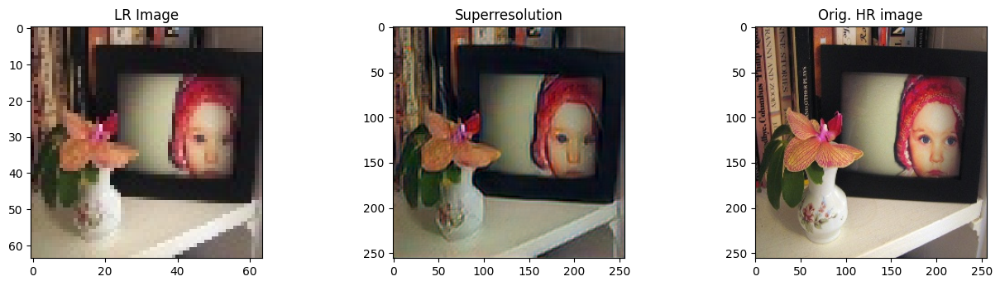

In [23]:
#Test - perform super resolution using saved generator model
from keras.models import load_model
from numpy.random import randint

generator = load_model('/content/drive/MyDrive/Colab Notebooks/SRGAN generator/gen_e_9.h5')


[X1, X2] = [lr_test, hr_test]
# select random example
ix = randint(0, len(X1), 1)
src_image, tar_image = X1[ix], X2[ix]

# generate image from source
gen_image = generator.predict(src_image)


# plot all three images

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('LR Image')
plt.imshow(src_image[0,:,:,:])
plt.subplot(232)
plt.title('Superresolution')
plt.imshow(gen_image[0,:,:,:])
plt.subplot(233)
plt.title('Orig. HR image')
plt.imshow(tar_image[0,:,:,:])

plt.show()

In [19]:
gen_img = generator.predict(img_lr)

1/1 [==============================] - 0s 26ms/step


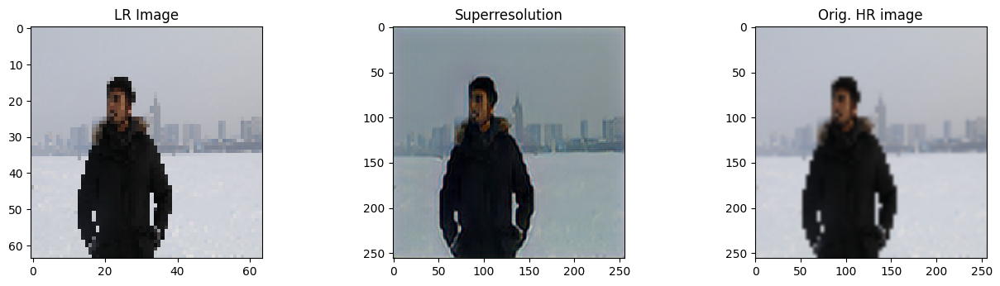

In [20]:
# plot all three images
plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('LR Image')
plt.imshow(img_lr[0,:,:,:])
plt.subplot(232)
plt.title('Superresolution')
plt.imshow(gen_img[0,:,:,:])
plt.subplot(233)
plt.title('Orig. HR image')
plt.imshow(img_hr[0,:,:,:])

plt.show()

In [ ]:
# training was done over 9 epochs over 12250 images and this is the result it took over 10 hours to train using a A100 GPU